In [1]:
from pathlib import Path
from copy import deepcopy

import NegativeClassOptimization.config as config
import NegativeClassOptimization.datasets as datasets
from NegativeClassOptimization.preprocessing import onehot_encode_df

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn import metrics
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, SubsetRandomSampler
from sklearn.preprocessing import StandardScaler
import torch.optim as optim
from tqdm.notebook import tqdm
from ipywidgets import FloatProgress
import math
import json
import glob
import re
from sklearn.model_selection import train_test_split

In [2]:
ONE_VS_ALL_PATH = Path('../data/full_data/1_vs_all')
PAIRWISE_HIGH_PATH = Path('../data/full_data/high_pairwise')
HIGH_LOW_PATH = Path('../data/full_data/high_low_concat')

In [3]:
def to_BinaryDataset(df):
    df["X"] = df['Slide_onehot']
    df["y"] = df['binder'].astype(int)
    df = datasets.BinaryDataset(df)
    return df

In [4]:
def dataset_preprosessing(df, scale = False):
    df = onehot_encode_df(df)

    #scale (why to scale one-hot?)
    if scale:
        arr_from_series = lambda s: np.stack(s, axis=0)

        onehot_stack = arr_from_series(df["Slide_onehot"])
        scaler = StandardScaler()
        df["Slide_onehot"] = scaler.fit_transform(onehot_stack).tolist()
        
    df = to_BinaryDataset(df)
    return df

In [5]:
def train_val_test_prep(df, scale = False):
    #df = onehot_encode_df(df)
    df_train = deepcopy(df[df['Train'] == True]).reset_index(drop=True)
    df_train, df_val = train_test_split(df_train, test_size=0.2, random_state=42)
    df_train, df_val = df_train.reset_index(drop=True), df_val.reset_index(drop=True)
    df_test = deepcopy(df[df['Train'] == False]).reset_index(drop=True)
    
    df_train = dataset_preprosessing(df_train, scale=scale)
    df_val = dataset_preprosessing(df_val, scale=scale)
    df_test = dataset_preprosessing(df_test, scale=scale)

    return df_train, df_val, df_test

In [6]:
class UnitNormLayer(nn.Module):
    def __init__(self):
        super(UnitNormLayer, self).__init__()
    def forward(self,x):
        norm = torch.norm(x, dim=0) #chamged dim=1
        return x / norm #torch.reshape(x, [-1,1])

In [7]:
 class SN10(nn.Module):
    """The simple neural network 10 (SN10) model from `Absolut!`.
    """

    def __init__(self, normalize=False):
        super(SN10, self).__init__()
        self.flatten = nn.Flatten()
        self.linear1 = nn.Linear(11*20, 10)
        nn.init.kaiming_normal_(self.linear1.weight)
        self.linear_relu_stack = nn.Sequential(
            self.linear1,
            nn.ReLU(),
            nn.Linear(10, 1),
        )
        self.normalize = normalize 
        if self.normalize:
            self.norm = UnitNormLayer()
        self.sigmoid = nn.Sigmoid()

    def forward_logits(self, x: torch.Tensor) -> torch.Tensor:
        x = self.flatten(x)
        logits = self.linear_relu_stack(x)
        return logits

    def forward(
        self, 
        x: torch.Tensor, 
        return_logits = False
        ):
        logits = self.forward_logits(x)
        if self.normalize:
            logits = self.norm(logits)
        expits = self.sigmoid(logits)
        if return_logits:
            return expits, logits
        else:
            return expits

In [8]:
def compute_binary_metrics(y_test_pred, y_test_true) -> dict:
    acc = metrics.accuracy_score(y_true=y_test_true, y_pred=y_test_pred)
    recall= metrics.recall_score(y_true=y_test_true, y_pred=y_test_pred)
    prec = metrics.precision_score(y_true=y_test_true, y_pred=y_test_pred)
    f1 = metrics.f1_score(y_true=y_test_true, y_pred=y_test_pred)
    return [acc, recall, prec, f1]


In [9]:
def test_loop(model, X, y, compute_merics = True):
    X = X.to(device)
    y = y.to(device)
    with torch.no_grad():
        y_pred, logits = model(X, return_logits = True)
        loss = loss_fn(y_pred, y).cpu().detach().numpy()
        performance = [loss]
    if compute_merics:
        y_pred = y_pred.cpu().detach().numpy().reshape(-1).round()
        y = y.cpu().detach().numpy()
        performance = performance + compute_binary_metrics(y_pred, y)
    return performance
            

## Skip

In [70]:
['./torch_models/SN10_1_vs_all/3VRL_vs_all_repl_5.pt', './torch_models/SN10_1_vs_all/3VRL_vs_all_repl_1.pt', './torch_models/SN10_1_vs_all/3VRL_vs_all_repl_4.pt', './torch_models/SN10_1_vs_all/3VRL_vs_all_repl_9.pt', './torch_models/SN10_1_vs_all/3VRL_vs_all_repl_10.pt', './torch_models/SN10_1_vs_all/3VRL_vs_all_repl_8.pt', './torch_models/SN10_1_vs_all/3VRL_vs_all_repl_3.pt', './torch_models/SN10_1_vs_all/3VRL_vs_all_repl_7.pt', './torch_models/SN10_1_vs_all/3VRL_vs_all_repl_6.pt', './torch_models/SN10_1_vs_all/3VRL_vs_all_repl_2.pt']

['./torch_models/SN10_1_vs_all/3VRL_vs_all_repl_5.pt',
 './torch_models/SN10_1_vs_all/3VRL_vs_all_repl_1.pt',
 './torch_models/SN10_1_vs_all/3VRL_vs_all_repl_4.pt',
 './torch_models/SN10_1_vs_all/3VRL_vs_all_repl_9.pt',
 './torch_models/SN10_1_vs_all/3VRL_vs_all_repl_10.pt',
 './torch_models/SN10_1_vs_all/3VRL_vs_all_repl_8.pt',
 './torch_models/SN10_1_vs_all/3VRL_vs_all_repl_3.pt',
 './torch_models/SN10_1_vs_all/3VRL_vs_all_repl_7.pt',
 './torch_models/SN10_1_vs_all/3VRL_vs_all_repl_6.pt',
 './torch_models/SN10_1_vs_all/3VRL_vs_all_repl_2.pt']

In [ ]:
['./torch_models/SN10_1_vs_all/3VRL_vs_all_repl_5.pt', './torch_models/SN10_1_vs_all/3VRL_vs_all_repl_1.pt', './torch_models/SN10_1_vs_all/3VRL_vs_all_repl_4.pt', './torch_models/SN10_1_vs_all/3VRL_vs_all_repl_9.pt', './torch_models/SN10_1_vs_all/3VRL_vs_all_repl_10.pt', './torch_models/SN10_1_vs_all/3VRL_vs_all_repl_8.pt', './torch_models/SN10_1_vs_all/3VRL_vs_all_repl_3.pt', './torch_models/SN10_1_vs_all/3VRL_vs_all_repl_7.pt', './torch_models/SN10_1_vs_all/3VRL_vs_all_repl_6.pt', './torch_models/SN10_1_vs_all/3VRL_vs_all_repl_2.pt']

In [52]:
df_high_pairwise = pd.read_csv(ONE_VS_ALL_PATH / '1ADQ_vs_all.tsv', sep = '\t')
train_one_all, val_one_all,  test_one_all = train_val_test_prep(df_high_pairwise, scale = False)

In [29]:
batch_size = 100
train_loader = DataLoader(train_one_all, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_one_all, batch_size=batch_size, shuffle=True)
test_loader = DataLoader(test_one_all, batch_size=batch_size, shuffle=True)

In [32]:
device = "mps" if torch.backends.mps.is_available() else "cpu"
baseline_model = SN10().to(device)

learning_rate = 0.002
momentum = 0
weight_decay = 0

optimizer = torch.optim.Adam(
            baseline_model.parameters(), 
            lr=learning_rate,
            weight_decay=weight_decay,
            )
loss_fn = nn.BCELoss()

epochs = 100
#losses = dict()
train_losses = []
val_losses = []
#for ealy stopping
#min_val_err = math.inf #move up
patience = 10
#patience_hit = 0
min_delta = 0.005
for epoch in tqdm(range(epochs), desc="Epochs"):
    #train
    running_loss = []
    for batch, (X, y) in enumerate(tqdm(train_loader, desc="Training", leave=False)):
        X = X.to(device)
        y = y.to(device)
        y_pred, logits = baseline_model(X, return_logits = True)
        loss = loss_fn(y_pred, y)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        running_loss.append(loss.cpu().detach().numpy())
    train_loss = np.mean(running_loss)
    train_losses.append(train_loss)
    
    #validation
    running_loss = []
    with torch.no_grad():
        validation_loss = []
        for batch, (X,y) in enumerate(tqdm(val_loader, desc="Validation", leave=False)):
            X = X.to(device)
            y = y.to(device)
            y_pred = baseline_model(X)
            running_loss.append(loss_fn(y_pred, y).cpu().detach().numpy())
        val_loss = np.mean(running_loss) 
        val_losses.append(val_loss)
    print(f"Epoch: {epoch+1}/{epochs} - Train loss: {train_loss}, Validation loss: {val_loss}") #save to log-file
    
    #alternative early stopping
    if len(val_losses) >= patience:
        last_losses = val_losses[-patience:]
        max_loss = max(last_losses)
        min_loss = min(last_losses)
        if min_loss + min_delta >= max_loss:
            print("Early stopping") #save-to log file
            #save train_losses and val_losses to log file
            break

        
"""

        min_loss = min(last_losses)
        mean_losses = sum(last_losses)/patience
        if min_loss+min_delta >= mean_losses:
            print("Early stopping")
            break"""
""" #early stopping 
    #pations should get back to zero when there is a new min
    min_winner = min(val_loss, min_val_err)
    if (min_winner + min_delta) >= min_val_err:
        patience_hit += 1
        if patience_hit == patience:
            print("Early stopping")
            break
    if min_val_err == min_winner:
        patience_hit = 0
    min_val_err = min_winner"""


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.5378758907318115, Validation loss: 0.4743111729621887


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.44383394718170166, Validation loss: 0.4338219463825226


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.40618646144866943, Validation loss: 0.4049253463745117


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.3749653995037079, Validation loss: 0.37771743535995483


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.3456709682941437, Validation loss: 0.3554469048976898


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.3180522620677948, Validation loss: 0.3269538879394531


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.29402217268943787, Validation loss: 0.3136712312698364


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.27487996220588684, Validation loss: 0.2955358028411865


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.26052790880203247, Validation loss: 0.28577467799186707


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.24810922145843506, Validation loss: 0.2776724398136139


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.23914562165737152, Validation loss: 0.2703225314617157


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.2312941700220108, Validation loss: 0.2634454071521759


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.22421975433826447, Validation loss: 0.26448383927345276


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.21816064417362213, Validation loss: 0.256384015083313


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.2130749374628067, Validation loss: 0.25551822781562805


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.20933964848518372, Validation loss: 0.25128674507141113


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.20494869351387024, Validation loss: 0.24914824962615967


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.2015489637851715, Validation loss: 0.2458668053150177


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.1982637494802475, Validation loss: 0.24504749476909637


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.19528304040431976, Validation loss: 0.24430537223815918


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.19264541566371918, Validation loss: 0.24477162957191467


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.18997615575790405, Validation loss: 0.24171826243400574


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.1883658617734909, Validation loss: 0.24272462725639343


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.1863493174314499, Validation loss: 0.24471738934516907


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.18455106019973755, Validation loss: 0.2395382523536682


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.18345291912555695, Validation loss: 0.24146439135074615


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.1810894012451172, Validation loss: 0.23868702352046967


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.18028751015663147, Validation loss: 0.2403622567653656


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.17892064154148102, Validation loss: 0.24059820175170898


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.17747841775417328, Validation loss: 0.2399866133928299


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.17611689865589142, Validation loss: 0.2416873276233673


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.17513707280158997, Validation loss: 0.23877570033073425


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.17410914599895477, Validation loss: 0.23798014223575592


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.17308112978935242, Validation loss: 0.23743988573551178
Early stopping


' #early stopping \n    #pations should get back to zero when there is a new min\n    min_winner = min(val_loss, min_val_err)\n    if (min_winner + min_delta) >= min_val_err:\n        patience_hit += 1\n        if patience_hit == patience:\n            print("Early stopping")\n            break\n    if min_val_err == min_winner:\n        patience_hit = 0\n    min_val_err = min_winner'

<AxesSubplot:>

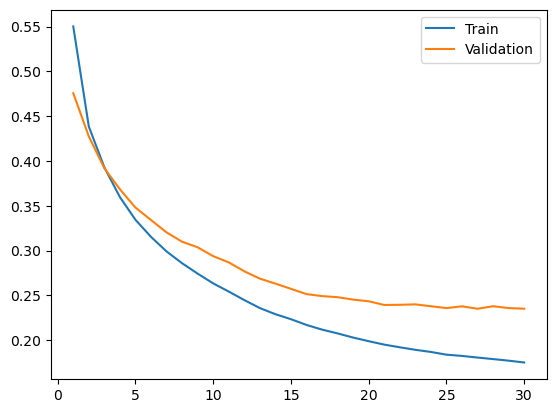

In [31]:
sns.lineplot(x = np.arange(1,len(train_losses)+1), y = train_losses, label = 'Train')
sns.lineplot(x = np.arange(1,len(val_losses)+1), y = val_losses, label = 'Validation')

# Continue

In [12]:
def train_SN10(train_loader, file_name, folder, epochs=200, learning_rate = 0.002, momentum = 0, weight_decay = 0, patience = 10, min_delta = 0.005):
    device = "mps" if torch.backends.mps.is_available() else "cpu"
    baseline_model = SN10().to(device)

    optimizer = torch.optim.Adam(
                baseline_model.parameters(), 
                lr=learning_rate,
                weight_decay=weight_decay,
                )
    loss_fn = nn.BCELoss()

    train_losses = []
    val_losses = []

    for epoch in tqdm(range(epochs), desc="Epochs"):
        #train
        running_loss = []
        for batch, (X, y) in enumerate(tqdm(train_loader, desc="Training", leave=False)):
            X = X.to(device)
            y = y.to(device)
            y_pred, logits = baseline_model(X, return_logits = True)
            loss = loss_fn(y_pred, y)

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            running_loss.append(loss.cpu().detach().numpy())
        train_loss = np.mean(running_loss)
        train_losses.append(float(train_loss))

        #validation
        running_loss = []
        with torch.no_grad():
            validation_loss = []
            for batch, (X,y) in enumerate(tqdm(val_loader, desc="Validation", leave=False)):
                X = X.to(device)
                y = y.to(device)
                y_pred = baseline_model(X)
                running_loss.append(loss_fn(y_pred, y).cpu().detach().numpy())
            val_loss = np.mean(running_loss) 
            val_losses.append(float(val_loss))
        print(f"Epoch: {epoch+1}/{epochs} - Train loss: {train_loss}, Validation loss: {val_loss}") #save to log-file
        with open(f'./logs/{file_name}.txt', 'a') as log:
            log.write(f"Epoch: {epoch+1}/{epochs} - Train loss: {train_loss}, Validation loss: {val_loss}\n")

        #alternative early stopping
        if len(val_losses) >= patience:
            last_losses = val_losses[-patience:]
            max_loss = max(last_losses)
            min_loss = min(last_losses)
            if min_loss + min_delta >= max_loss:
                print("Early stopping") #save-to log file
                #save train_losses and val_losses to log file
                #save the model
                break
                #print(f"Epoch: {epoch+1}/{epochs} - Train loss: {train_loss}, Validation loss: {val_loss}") #save to log-file

    with open(f'./logs/{file_name}_train_val_losses.json', 'w') as f:
        json.dump([train_losses, val_losses], f)
    torch.save(baseline_model.state_dict(), f'./torch_models/{folder}/{file_name}.pt')



In [13]:
high_looser_paths = glob.glob(str(Path(HIGH_LOW_PATH)) + "/[0-9A-Z]*_high_looser*")

In [14]:
replicates = 10
batch_size = 100
for dataset in tqdm(high_looser_paths, desc = 'Models'):
    file = dataset.split('/')[-1].strip('.tsv')
    df = pd.read_csv(dataset, sep='\t')
    train_one_all, val_one_all,  test_one_all = train_val_test_prep(df, scale = False)
    train_loader = DataLoader(train_one_all, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_one_all, batch_size=batch_size, shuffle=True)
    test_loader = DataLoader(test_one_all, batch_size=batch_size, shuffle=True)
    for i in range(1, replicates+1):
        train_SN10(train_loader, f'{file}_repl_{str(i)}', 'SN10_base_looser')

Models:   0%|          | 0/10 [00:00<?, ?it/s]

Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6257327795028687, Validation loss: 0.5511689782142639


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.502532422542572, Validation loss: 0.4659084379673004


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.4302690029144287, Validation loss: 0.4094619154930115


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.3801005482673645, Validation loss: 0.37158915400505066


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.3456028699874878, Validation loss: 0.346858948469162


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.3181227445602417, Validation loss: 0.32278069853782654


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.29425835609436035, Validation loss: 0.3035835325717926


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.2754058241844177, Validation loss: 0.28769636154174805


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.25964823365211487, Validation loss: 0.2754400372505188


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.24700234830379486, Validation loss: 0.26624295115470886


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.236114501953125, Validation loss: 0.25965023040771484


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.22737888991832733, Validation loss: 0.25552642345428467


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.21922336518764496, Validation loss: 0.24687065184116364


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.2135094702243805, Validation loss: 0.2491866946220398


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.20791876316070557, Validation loss: 0.23981395363807678


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.20149995386600494, Validation loss: 0.23883932828903198


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.1977171003818512, Validation loss: 0.23394545912742615


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.19359347224235535, Validation loss: 0.23221828043460846


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.19021300971508026, Validation loss: 0.2302393913269043


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.18618066608905792, Validation loss: 0.22875016927719116


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.18396703898906708, Validation loss: 0.22443394362926483


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.18009138107299805, Validation loss: 0.22242975234985352


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.17778466641902924, Validation loss: 0.22413071990013123


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.1756342202425003, Validation loss: 0.21996115148067474


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.1729135811328888, Validation loss: 0.2199336290359497


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.1709427535533905, Validation loss: 0.22238002717494965


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.16844817996025085, Validation loss: 0.2202042192220688


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.16671302914619446, Validation loss: 0.21876242756843567


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.16495466232299805, Validation loss: 0.22198064625263214


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.1630467027425766, Validation loss: 0.21803216636180878


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.16184455156326294, Validation loss: 0.21720802783966064


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.1612214297056198, Validation loss: 0.21709229052066803


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.1588393747806549, Validation loss: 0.2183907926082611


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.1573314517736435, Validation loss: 0.2192627191543579


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.15582667291164398, Validation loss: 0.2156483232975006


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.15488670766353607, Validation loss: 0.21650609374046326


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.15367722511291504, Validation loss: 0.21567538380622864


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.15303583443164825, Validation loss: 0.22028754651546478


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.15218420326709747, Validation loss: 0.22148321568965912


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.1509159952402115, Validation loss: 0.21759851276874542


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.14959996938705444, Validation loss: 0.21337035298347473


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.1491103321313858, Validation loss: 0.21752843260765076


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.14829984307289124, Validation loss: 0.2137972116470337


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/200 - Train loss: 0.14643102884292603, Validation loss: 0.21743746101856232


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/200 - Train loss: 0.14614823460578918, Validation loss: 0.21459423005580902


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/200 - Train loss: 0.14478856325149536, Validation loss: 0.21973590552806854


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/200 - Train loss: 0.1443052440881729, Validation loss: 0.21316079795360565


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/200 - Train loss: 0.14350831508636475, Validation loss: 0.21910978853702545


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/200 - Train loss: 0.14281530678272247, Validation loss: 0.2153671383857727


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/200 - Train loss: 0.1416429728269577, Validation loss: 0.21522192656993866


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/200 - Train loss: 0.1421215832233429, Validation loss: 0.2172088772058487


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/200 - Train loss: 0.13967837393283844, Validation loss: 0.21756859123706818


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/200 - Train loss: 0.13920867443084717, Validation loss: 0.2137792408466339


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/200 - Train loss: 0.13867850601673126, Validation loss: 0.21604973077774048


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/200 - Train loss: 0.1385313868522644, Validation loss: 0.21999534964561462


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/200 - Train loss: 0.1376664936542511, Validation loss: 0.222187340259552


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/200 - Train loss: 0.13768133521080017, Validation loss: 0.2152881771326065


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/200 - Train loss: 0.13623923063278198, Validation loss: 0.21779876947402954


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/200 - Train loss: 0.13560134172439575, Validation loss: 0.2182813435792923


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/200 - Train loss: 0.13450390100479126, Validation loss: 0.21584105491638184


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/200 - Train loss: 0.1330605298280716, Validation loss: 0.21807760000228882


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/200 - Train loss: 0.1338975727558136, Validation loss: 0.21732854843139648


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/200 - Train loss: 0.13283976912498474, Validation loss: 0.21953795850276947


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/200 - Train loss: 0.1320706605911255, Validation loss: 0.21947358548641205


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/200 - Train loss: 0.132645845413208, Validation loss: 0.2167550027370453


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/200 - Train loss: 0.13111478090286255, Validation loss: 0.2250204235315323


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/200 - Train loss: 0.13123787939548492, Validation loss: 0.2158852368593216


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/200 - Train loss: 0.13067224621772766, Validation loss: 0.21654370427131653


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/200 - Train loss: 0.1299542486667633, Validation loss: 0.22454094886779785


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/200 - Train loss: 0.12994931638240814, Validation loss: 0.21858638525009155


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/200 - Train loss: 0.12850138545036316, Validation loss: 0.21685250103473663


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/200 - Train loss: 0.12924157083034515, Validation loss: 0.22531461715698242


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/200 - Train loss: 0.12951381504535675, Validation loss: 0.2224775105714798


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/200 - Train loss: 0.12783735990524292, Validation loss: 0.2198958694934845


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/200 - Train loss: 0.12827236950397491, Validation loss: 0.22073180973529816


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/200 - Train loss: 0.12768638134002686, Validation loss: 0.22024625539779663


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/200 - Train loss: 0.12726637721061707, Validation loss: 0.22335712611675262


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/200 - Train loss: 0.12670159339904785, Validation loss: 0.22164808213710785


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/200 - Train loss: 0.12675273418426514, Validation loss: 0.22374339401721954


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/200 - Train loss: 0.12614981830120087, Validation loss: 0.22135233879089355


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/200 - Train loss: 0.12609641253948212, Validation loss: 0.22912153601646423


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/200 - Train loss: 0.12501458823680878, Validation loss: 0.22355078160762787


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/200 - Train loss: 0.12511296570301056, Validation loss: 0.22199295461177826


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/200 - Train loss: 0.12495655566453934, Validation loss: 0.223328098654747


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/200 - Train loss: 0.12479106336832047, Validation loss: 0.22743059694766998


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/200 - Train loss: 0.1242348700761795, Validation loss: 0.22441338002681732


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/200 - Train loss: 0.1238376796245575, Validation loss: 0.22589164972305298


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/200 - Train loss: 0.12392700463533401, Validation loss: 0.2241625040769577


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/200 - Train loss: 0.1231129989027977, Validation loss: 0.22448527812957764


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/200 - Train loss: 0.12268103659152985, Validation loss: 0.22684089839458466


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/200 - Train loss: 0.12250754982233047, Validation loss: 0.22530604898929596


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/200 - Train loss: 0.12193076312541962, Validation loss: 0.22519324719905853


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/200 - Train loss: 0.12328758835792542, Validation loss: 0.22359052300453186
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6266899108886719, Validation loss: 0.5625454187393188


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.5103850364685059, Validation loss: 0.4760533273220062


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.4340541660785675, Validation loss: 0.4119642674922943


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.37669119238853455, Validation loss: 0.36616137623786926


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.3357076048851013, Validation loss: 0.3333760201931


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.30731621384620667, Validation loss: 0.30984097719192505


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.28482872247695923, Validation loss: 0.2906104326248169


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.2684771716594696, Validation loss: 0.27596011757850647


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.25548645853996277, Validation loss: 0.26657477021217346


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.24395275115966797, Validation loss: 0.25958913564682007


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.234154611825943, Validation loss: 0.2524396777153015


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.22619803249835968, Validation loss: 0.24377043545246124


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.21922564506530762, Validation loss: 0.2397799789905548


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.21239465475082397, Validation loss: 0.23442688584327698


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.20590437948703766, Validation loss: 0.231138214468956


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.1998801976442337, Validation loss: 0.2289121001958847


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.1950642317533493, Validation loss: 0.22420409321784973


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.19046331942081451, Validation loss: 0.22219723463058472


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.18705715239048004, Validation loss: 0.21869808435440063


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.18207117915153503, Validation loss: 0.21730130910873413


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.1792992353439331, Validation loss: 0.21552056074142456


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.17605671286582947, Validation loss: 0.21528804302215576


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.1725127249956131, Validation loss: 0.21485252678394318


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.17000147700309753, Validation loss: 0.2158823013305664


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.1683695912361145, Validation loss: 0.21401043236255646


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.16626790165901184, Validation loss: 0.21748176217079163


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.16343767940998077, Validation loss: 0.2134905904531479


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.1617785394191742, Validation loss: 0.21124835312366486


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.16005949676036835, Validation loss: 0.20988717675209045


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.15855732560157776, Validation loss: 0.21089211106300354


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.15681962668895721, Validation loss: 0.2118295431137085


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.15483833849430084, Validation loss: 0.210439994931221


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.15430855751037598, Validation loss: 0.20937658846378326


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.15257810056209564, Validation loss: 0.21199288964271545


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.1508195400238037, Validation loss: 0.2114468365907669


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.15000860393047333, Validation loss: 0.21569086611270905


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.14904995262622833, Validation loss: 0.21363696455955505


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.14761176705360413, Validation loss: 0.20959268510341644


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.14704416692256927, Validation loss: 0.20950859785079956


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.14536407589912415, Validation loss: 0.21296653151512146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.14504605531692505, Validation loss: 0.2112276405096054


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.14379972219467163, Validation loss: 0.21238979697227478


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.1430835723876953, Validation loss: 0.2132297307252884


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/200 - Train loss: 0.14231958985328674, Validation loss: 0.2146296501159668


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/200 - Train loss: 0.14124847948551178, Validation loss: 0.21261663734912872


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/200 - Train loss: 0.14044538140296936, Validation loss: 0.21486270427703857


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/200 - Train loss: 0.13991737365722656, Validation loss: 0.2183724045753479


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/200 - Train loss: 0.1388862580060959, Validation loss: 0.21475081145763397


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/200 - Train loss: 0.1379658579826355, Validation loss: 0.21627061069011688


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/200 - Train loss: 0.1376492828130722, Validation loss: 0.21785837411880493


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/200 - Train loss: 0.13735027611255646, Validation loss: 0.2177269011735916


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/200 - Train loss: 0.13712309300899506, Validation loss: 0.2182224541902542


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/200 - Train loss: 0.13655558228492737, Validation loss: 0.2202075868844986


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/200 - Train loss: 0.13521288335323334, Validation loss: 0.22065432369709015


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/200 - Train loss: 0.13431218266487122, Validation loss: 0.21996049582958221


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/200 - Train loss: 0.13456493616104126, Validation loss: 0.21758462488651276


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/200 - Train loss: 0.13352862000465393, Validation loss: 0.21853533387184143


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/200 - Train loss: 0.13305169343948364, Validation loss: 0.22015663981437683
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6281155943870544, Validation loss: 0.5581321120262146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.511422336101532, Validation loss: 0.470899760723114


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.43324989080429077, Validation loss: 0.4081776738166809


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.37840765714645386, Validation loss: 0.36362165212631226


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.3399166762828827, Validation loss: 0.3358907699584961


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.3130739629268646, Validation loss: 0.31862616539001465


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.293865829706192, Validation loss: 0.30151432752609253


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.2784707844257355, Validation loss: 0.2928295433521271


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.2655193507671356, Validation loss: 0.28407299518585205


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.2538755536079407, Validation loss: 0.2729725241661072


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.24413762986660004, Validation loss: 0.266349732875824


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.23479752242565155, Validation loss: 0.25886204838752747


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.22658269107341766, Validation loss: 0.25308939814567566


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.21853958070278168, Validation loss: 0.24765722453594208


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.21122771501541138, Validation loss: 0.24392929673194885


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.20524989068508148, Validation loss: 0.24118061363697052


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.20009931921958923, Validation loss: 0.23742537200450897


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.19508160650730133, Validation loss: 0.2316601276397705


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.19065402448177338, Validation loss: 0.2304619550704956


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.18652541935443878, Validation loss: 0.2282864898443222


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.1822226196527481, Validation loss: 0.22764043509960175


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.1791529655456543, Validation loss: 0.22786347568035126


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.17554764449596405, Validation loss: 0.2250831425189972


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.17286193370819092, Validation loss: 0.22328321635723114


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.1699458211660385, Validation loss: 0.22387275099754333


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.16814632713794708, Validation loss: 0.22069256007671356


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.1656535267829895, Validation loss: 0.22030854225158691


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.16275471448898315, Validation loss: 0.22092203795909882


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.1603400856256485, Validation loss: 0.22091522812843323


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.15875855088233948, Validation loss: 0.2192498743534088


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.15673938393592834, Validation loss: 0.2211574912071228


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.1551293134689331, Validation loss: 0.21997374296188354


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.1532544493675232, Validation loss: 0.21949632465839386
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6202059388160706, Validation loss: 0.5508909225463867


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.503763735294342, Validation loss: 0.46971920132637024


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.42873382568359375, Validation loss: 0.4062041640281677


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.3735979497432709, Validation loss: 0.36489972472190857


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.3344901204109192, Validation loss: 0.33285045623779297


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.30641186237335205, Validation loss: 0.31747013330459595


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.2854015529155731, Validation loss: 0.2952713072299957


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.2670758366584778, Validation loss: 0.28373396396636963


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.25288137793540955, Validation loss: 0.27184924483299255


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.2402791529893875, Validation loss: 0.2625868618488312


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.23052681982517242, Validation loss: 0.2564142346382141


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.22061587870121002, Validation loss: 0.24880450963974


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.21304088830947876, Validation loss: 0.24389606714248657


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.2058689445257187, Validation loss: 0.23973144590854645


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.19986562430858612, Validation loss: 0.23519787192344666


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.19376662373542786, Validation loss: 0.2285871058702469


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.18851621448993683, Validation loss: 0.22738710045814514


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.18400676548480988, Validation loss: 0.2246895134449005


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.17984668910503387, Validation loss: 0.22048477828502655


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.17660216987133026, Validation loss: 0.2195698767900467


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.1729975789785385, Validation loss: 0.21747297048568726


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.17059014737606049, Validation loss: 0.22166651487350464


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.16691084206104279, Validation loss: 0.21719621121883392


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.1656544804573059, Validation loss: 0.21516229212284088


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.1635877639055252, Validation loss: 0.2128807157278061


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.16084299981594086, Validation loss: 0.21300721168518066


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.15867021679878235, Validation loss: 0.21446359157562256


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.1572713702917099, Validation loss: 0.2141830176115036


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.1552666276693344, Validation loss: 0.21367889642715454


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.15387819707393646, Validation loss: 0.21513041853904724


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.15223802626132965, Validation loss: 0.2150728702545166


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.150641068816185, Validation loss: 0.21261140704154968
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6304810047149658, Validation loss: 0.565087080001831


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.5172713398933411, Validation loss: 0.47895297408103943


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.4382382333278656, Validation loss: 0.41475772857666016


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.38215166330337524, Validation loss: 0.372844934463501


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.3438202440738678, Validation loss: 0.34237903356552124


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.31732913851737976, Validation loss: 0.32280510663986206


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.2979610860347748, Validation loss: 0.30822768807411194


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.28302282094955444, Validation loss: 0.2969760298728943


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.2697494924068451, Validation loss: 0.2915876507759094


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.2592726945877075, Validation loss: 0.2825303375720978


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.24941523373126984, Validation loss: 0.27348917722702026


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.23985223472118378, Validation loss: 0.2680482864379883


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.23110049962997437, Validation loss: 0.26145827770233154


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.22443367540836334, Validation loss: 0.25503239035606384


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.21768726408481598, Validation loss: 0.25094908475875854


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.2116844803094864, Validation loss: 0.246849924325943


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.2060437798500061, Validation loss: 0.24063058197498322


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.20098870992660522, Validation loss: 0.23845697939395905


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.19539232552051544, Validation loss: 0.2378837764263153


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.19120904803276062, Validation loss: 0.23697280883789062


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.18764781951904297, Validation loss: 0.23143357038497925


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.1838073581457138, Validation loss: 0.23338666558265686


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.17982707917690277, Validation loss: 0.2295723855495453


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.1776892989873886, Validation loss: 0.22749227285385132


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.17427484691143036, Validation loss: 0.22825086116790771


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.17201188206672668, Validation loss: 0.22512292861938477


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.1693577766418457, Validation loss: 0.22246935963630676


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.16742298007011414, Validation loss: 0.22535911202430725


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.16611003875732422, Validation loss: 0.22215577960014343


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.16342885792255402, Validation loss: 0.22754237055778503


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.16179081797599792, Validation loss: 0.2227560430765152


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.1601460725069046, Validation loss: 0.2222970575094223


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.15874361991882324, Validation loss: 0.2221069633960724


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.1571594476699829, Validation loss: 0.2204432338476181


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.1558792144060135, Validation loss: 0.22185707092285156


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.154762864112854, Validation loss: 0.22099165618419647


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.15355898439884186, Validation loss: 0.22044561803340912


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.15219151973724365, Validation loss: 0.22092129290103912


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.15113475918769836, Validation loss: 0.2244282364845276


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.15009503066539764, Validation loss: 0.220246821641922
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6182489395141602, Validation loss: 0.5507839322090149


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.5044714212417603, Validation loss: 0.47712481021881104


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.4433427155017853, Validation loss: 0.42671719193458557


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.39751997590065, Validation loss: 0.3935365378856659


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.3623519539833069, Validation loss: 0.3675728440284729


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.33444932103157043, Validation loss: 0.34079793095588684


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.3106667101383209, Validation loss: 0.3188767433166504


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.29035085439682007, Validation loss: 0.3018924295902252


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.2734606862068176, Validation loss: 0.2861664593219757


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.25937190651893616, Validation loss: 0.27434754371643066


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.24684251844882965, Validation loss: 0.2644783556461334


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.23548506200313568, Validation loss: 0.25855663418769836


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.22669927775859833, Validation loss: 0.25139516592025757


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.21896004676818848, Validation loss: 0.24577264487743378


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.2120925635099411, Validation loss: 0.23991325497627258


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.20633207261562347, Validation loss: 0.23821985721588135


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.20074675977230072, Validation loss: 0.23654413223266602


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.19611294567584991, Validation loss: 0.23127110302448273


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.1923522651195526, Validation loss: 0.22576700150966644


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.18846401572227478, Validation loss: 0.2270675003528595


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.18473322689533234, Validation loss: 0.22510693967342377


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.18164846301078796, Validation loss: 0.22591648995876312


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.17869509756565094, Validation loss: 0.22272062301635742


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.1761774867773056, Validation loss: 0.2245723009109497


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.17404073476791382, Validation loss: 0.22144454717636108


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.1718806028366089, Validation loss: 0.2211838960647583


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.16916334629058838, Validation loss: 0.22252397239208221


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.16802120208740234, Validation loss: 0.21798835694789886


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.16598325967788696, Validation loss: 0.21796636283397675


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.16494809091091156, Validation loss: 0.2194949835538864


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.16333143413066864, Validation loss: 0.22041980922222137


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.16200090944766998, Validation loss: 0.21543216705322266


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.16003507375717163, Validation loss: 0.21760477125644684


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.1588859260082245, Validation loss: 0.21715359389781952


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.15810146927833557, Validation loss: 0.22374489903450012


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.15661798417568207, Validation loss: 0.21534891426563263


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.15575802326202393, Validation loss: 0.21908295154571533


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.15429696440696716, Validation loss: 0.21684254705905914


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.1533508449792862, Validation loss: 0.2168775200843811


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.15248042345046997, Validation loss: 0.21729835867881775


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.15154479444026947, Validation loss: 0.2174266129732132


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.15030120313167572, Validation loss: 0.21774056553840637


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.14960165321826935, Validation loss: 0.2132950723171234


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/200 - Train loss: 0.1487317681312561, Validation loss: 0.2242177426815033


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/200 - Train loss: 0.14763976633548737, Validation loss: 0.21773208677768707


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/200 - Train loss: 0.1476084440946579, Validation loss: 0.21817252039909363


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/200 - Train loss: 0.14622832834720612, Validation loss: 0.21797196567058563


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/200 - Train loss: 0.146074116230011, Validation loss: 0.21618133783340454


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/200 - Train loss: 0.14549165964126587, Validation loss: 0.21886606514453888


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/200 - Train loss: 0.14416387677192688, Validation loss: 0.21652159094810486


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/200 - Train loss: 0.14327159523963928, Validation loss: 0.2167137712240219


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/200 - Train loss: 0.14285807311534882, Validation loss: 0.2187839299440384


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/200 - Train loss: 0.14196576178073883, Validation loss: 0.217969611287117


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/200 - Train loss: 0.14138099551200867, Validation loss: 0.2199362814426422
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6165772080421448, Validation loss: 0.5492586493492126


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.5003054141998291, Validation loss: 0.4646270275115967


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.4293440580368042, Validation loss: 0.4131089150905609


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.38080114126205444, Validation loss: 0.38109245896339417


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.3465278148651123, Validation loss: 0.34705987572669983


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.31926071643829346, Validation loss: 0.32288986444473267


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.29653236269950867, Validation loss: 0.30894070863723755


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.2787230610847473, Validation loss: 0.2955705523490906


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.26428136229515076, Validation loss: 0.2838229238986969


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.25312528014183044, Validation loss: 0.27556806802749634


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.24256494641304016, Validation loss: 0.2724788188934326


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.23418790102005005, Validation loss: 0.26332274079322815


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.22708693146705627, Validation loss: 0.25906163454055786


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.2204878330230713, Validation loss: 0.25169771909713745


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.2150718867778778, Validation loss: 0.2491331547498703


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.20908024907112122, Validation loss: 0.24375450611114502


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.20307429134845734, Validation loss: 0.24192865192890167


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.1988474577665329, Validation loss: 0.23625822365283966


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.19434067606925964, Validation loss: 0.23456864058971405


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.19004450738430023, Validation loss: 0.23202870786190033


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.18649733066558838, Validation loss: 0.2277272790670395


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.18316972255706787, Validation loss: 0.22980406880378723


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.17937524616718292, Validation loss: 0.22546398639678955


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.17693157494068146, Validation loss: 0.22216860949993134


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.17425760626792908, Validation loss: 0.2229018658399582


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.17154665291309357, Validation loss: 0.22666025161743164


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.16928274929523468, Validation loss: 0.2194254845380783


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.16715767979621887, Validation loss: 0.22297365963459015


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.1659277379512787, Validation loss: 0.2212946116924286


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.16347049176692963, Validation loss: 0.2210594117641449


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.1617603749036789, Validation loss: 0.22410854697227478


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.16038250923156738, Validation loss: 0.2199605405330658


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.15855155885219574, Validation loss: 0.2221316546201706


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.15763427317142487, Validation loss: 0.2194543331861496


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.1563575267791748, Validation loss: 0.21682846546173096


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.15475702285766602, Validation loss: 0.2209070324897766


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.1533447802066803, Validation loss: 0.22010570764541626


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.15184475481510162, Validation loss: 0.2195553481578827


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.1523044854402542, Validation loss: 0.2240913361310959


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.151048481464386, Validation loss: 0.2208525687456131


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.1498538702726364, Validation loss: 0.2228201925754547


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.14992600679397583, Validation loss: 0.2216910421848297


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.14764393866062164, Validation loss: 0.2233298122882843


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/200 - Train loss: 0.1475086808204651, Validation loss: 0.22229710221290588


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/200 - Train loss: 0.14587318897247314, Validation loss: 0.22620469331741333


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/200 - Train loss: 0.14552141726016998, Validation loss: 0.22618937492370605


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/200 - Train loss: 0.14409908652305603, Validation loss: 0.22629736363887787


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/200 - Train loss: 0.14414359629154205, Validation loss: 0.22537267208099365


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/200 - Train loss: 0.14370089769363403, Validation loss: 0.2232169210910797


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/200 - Train loss: 0.14260166883468628, Validation loss: 0.2277166247367859


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/200 - Train loss: 0.14193274080753326, Validation loss: 0.22701527178287506


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/200 - Train loss: 0.14144067466259003, Validation loss: 0.22486339509487152


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/200 - Train loss: 0.14053189754486084, Validation loss: 0.22478647530078888


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/200 - Train loss: 0.14018596708774567, Validation loss: 0.22458413243293762
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6241690516471863, Validation loss: 0.5564264059066772


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.5063212513923645, Validation loss: 0.46938422322273254


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.4307544529438019, Validation loss: 0.4081147611141205


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.3770601749420166, Validation loss: 0.3681485056877136


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.3404519557952881, Validation loss: 0.3403663635253906


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.3146142065525055, Validation loss: 0.32180482149124146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.2961810827255249, Validation loss: 0.3074010908603668


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.280112624168396, Validation loss: 0.296891987323761


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.26791298389434814, Validation loss: 0.28675854206085205


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.2561776638031006, Validation loss: 0.2769318222999573


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.24630814790725708, Validation loss: 0.2711229920387268


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.23787081241607666, Validation loss: 0.2655980587005615


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.2301226258277893, Validation loss: 0.2610101103782654


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.2244264930486679, Validation loss: 0.2597966194152832


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.2178080826997757, Validation loss: 0.25177833437919617


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.21183092892169952, Validation loss: 0.24921995401382446


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.2065718173980713, Validation loss: 0.2500883638858795


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.20225277543067932, Validation loss: 0.24281969666481018


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.19822938740253448, Validation loss: 0.24219800531864166


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.19459234178066254, Validation loss: 0.23605698347091675


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.1904839277267456, Validation loss: 0.23550647497177124


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.18687184154987335, Validation loss: 0.23414860665798187


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.1842668503522873, Validation loss: 0.234114408493042


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.18104048073291779, Validation loss: 0.23527516424655914


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.17987798154354095, Validation loss: 0.23074886202812195


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.17657789587974548, Validation loss: 0.22952920198440552


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.17443914711475372, Validation loss: 0.22987478971481323


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.1720457822084427, Validation loss: 0.22629797458648682


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.17039604485034943, Validation loss: 0.227270245552063


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.1685505211353302, Validation loss: 0.22654971480369568


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.1656317263841629, Validation loss: 0.22609663009643555


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.16425253450870514, Validation loss: 0.22558988630771637


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.16401486098766327, Validation loss: 0.22948089241981506


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.16202905774116516, Validation loss: 0.22861003875732422


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.16024883091449738, Validation loss: 0.22924529016017914
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6179695129394531, Validation loss: 0.5538374781608582


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.5030680298805237, Validation loss: 0.4647371172904968


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.4251782298088074, Validation loss: 0.40497326850891113


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.3707328736782074, Validation loss: 0.36037296056747437


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.3337579369544983, Validation loss: 0.33105146884918213


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.306883841753006, Validation loss: 0.3109021484851837


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.28669679164886475, Validation loss: 0.29267826676368713


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.27047911286354065, Validation loss: 0.28213977813720703


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.2574908137321472, Validation loss: 0.2694458067417145


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.2459537535905838, Validation loss: 0.259893536567688


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.23667782545089722, Validation loss: 0.2523192763328552


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.22755540907382965, Validation loss: 0.24733081459999084


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.2207457423210144, Validation loss: 0.24468958377838135


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.2131737470626831, Validation loss: 0.24445734918117523


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.2075008749961853, Validation loss: 0.23403139412403107


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.20250572264194489, Validation loss: 0.23183408379554749


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.19789020717144012, Validation loss: 0.22707964479923248


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.19285240769386292, Validation loss: 0.22488157451152802


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.1891709715127945, Validation loss: 0.22392024099826813


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.18655997514724731, Validation loss: 0.22644004225730896


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.18342337012290955, Validation loss: 0.22221454977989197


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.17986413836479187, Validation loss: 0.2197790890932083


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.17830400168895721, Validation loss: 0.21934227645397186


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.17556682229042053, Validation loss: 0.22029705345630646


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.17207613587379456, Validation loss: 0.21621370315551758


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.1703932285308838, Validation loss: 0.21680594980716705


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.1684333086013794, Validation loss: 0.21449479460716248


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.16673678159713745, Validation loss: 0.21691857278347015


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.16468758881092072, Validation loss: 0.2167048156261444


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.1631501317024231, Validation loss: 0.21491335332393646


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.16164128482341766, Validation loss: 0.21322788298130035


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.15945541858673096, Validation loss: 0.2136787325143814


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.15843959152698517, Validation loss: 0.21678096055984497


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.15763317048549652, Validation loss: 0.21081876754760742


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.155570387840271, Validation loss: 0.21234382688999176


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.15391820669174194, Validation loss: 0.21394498646259308


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.15360920131206512, Validation loss: 0.21436919271945953


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.15147605538368225, Validation loss: 0.21616853773593903


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.1516898274421692, Validation loss: 0.2134639322757721


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.15047046542167664, Validation loss: 0.21890239417552948


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.14942671358585358, Validation loss: 0.21210433542728424


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.14800697565078735, Validation loss: 0.2169857621192932


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.14754700660705566, Validation loss: 0.21046045422554016


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/200 - Train loss: 0.14672529697418213, Validation loss: 0.21282704174518585


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/200 - Train loss: 0.14578188955783844, Validation loss: 0.21205691993236542


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/200 - Train loss: 0.14455834031105042, Validation loss: 0.21476872265338898


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/200 - Train loss: 0.144053652882576, Validation loss: 0.21367502212524414


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/200 - Train loss: 0.14432042837142944, Validation loss: 0.21237534284591675


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/200 - Train loss: 0.1434260457754135, Validation loss: 0.21220140159130096


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/200 - Train loss: 0.14135774970054626, Validation loss: 0.2177163064479828


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/200 - Train loss: 0.14142543077468872, Validation loss: 0.2114405632019043


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/200 - Train loss: 0.14081759750843048, Validation loss: 0.2132321298122406


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/200 - Train loss: 0.14034207165241241, Validation loss: 0.21128897368907928


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/200 - Train loss: 0.1403670608997345, Validation loss: 0.21645383536815643


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/200 - Train loss: 0.13947992026805878, Validation loss: 0.21628078818321228


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/200 - Train loss: 0.13870647549629211, Validation loss: 0.21350112557411194


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/200 - Train loss: 0.13825686275959015, Validation loss: 0.2135518342256546


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/200 - Train loss: 0.13802380859851837, Validation loss: 0.213922917842865


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/200 - Train loss: 0.13792411983013153, Validation loss: 0.21685193479061127


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/200 - Train loss: 0.13752061128616333, Validation loss: 0.21508826315402985


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/200 - Train loss: 0.13641084730625153, Validation loss: 0.215617373585701


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/200 - Train loss: 0.13553369045257568, Validation loss: 0.218340203166008


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/200 - Train loss: 0.1359044313430786, Validation loss: 0.2144511491060257
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6230053901672363, Validation loss: 0.5536563992500305


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.504092276096344, Validation loss: 0.47329235076904297


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.4419592320919037, Validation loss: 0.4324091970920563


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.4041186273097992, Validation loss: 0.40539002418518066


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.37398964166641235, Validation loss: 0.37449169158935547


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.3481793701648712, Validation loss: 0.3529207110404968


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.32468345761299133, Validation loss: 0.3318970203399658


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.30594536662101746, Validation loss: 0.31662994623184204


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.28983280062675476, Validation loss: 0.3038245439529419


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.27666643261909485, Validation loss: 0.29433637857437134


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.2650896906852722, Validation loss: 0.28500092029571533


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.2554818391799927, Validation loss: 0.2753344476222992


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.24576310813426971, Validation loss: 0.2681851089000702


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.2386360615491867, Validation loss: 0.262507826089859


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.23141299188137054, Validation loss: 0.2578689754009247


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.2252131849527359, Validation loss: 0.25365546345710754


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.22066819667816162, Validation loss: 0.2503150999546051


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.21510516107082367, Validation loss: 0.24632541835308075


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.21081748604774475, Validation loss: 0.24337904155254364


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.20624712109565735, Validation loss: 0.2450280636548996


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.2028876543045044, Validation loss: 0.23638573288917542


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.19945122301578522, Validation loss: 0.23594215512275696


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.1961231529712677, Validation loss: 0.23235566914081573


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.1927718222141266, Validation loss: 0.23063533008098602


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.19081653654575348, Validation loss: 0.231922447681427


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.18770557641983032, Validation loss: 0.23113283514976501


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.18507054448127747, Validation loss: 0.22787801921367645


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.183542400598526, Validation loss: 0.2292659431695938


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.18187639117240906, Validation loss: 0.2313774824142456


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.17963716387748718, Validation loss: 0.22635644674301147


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.1776062548160553, Validation loss: 0.2256229966878891


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.17704254388809204, Validation loss: 0.22995153069496155


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.17454980313777924, Validation loss: 0.22480161488056183


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.1733357310295105, Validation loss: 0.22756390273571014


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.17225977778434753, Validation loss: 0.22477507591247559


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.17117983102798462, Validation loss: 0.2300523966550827


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.1701977252960205, Validation loss: 0.22374486923217773


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.16780956089496613, Validation loss: 0.22217878699302673


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.16718769073486328, Validation loss: 0.22547917068004608


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.16616302728652954, Validation loss: 0.2237691432237625


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.16531623899936676, Validation loss: 0.22667083144187927


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.16474919021129608, Validation loss: 0.2243158519268036


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.16305875778198242, Validation loss: 0.22555281221866608


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/200 - Train loss: 0.16247841715812683, Validation loss: 0.22708046436309814


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/200 - Train loss: 0.16200792789459229, Validation loss: 0.2272460013628006


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/200 - Train loss: 0.1611884981393814, Validation loss: 0.22305533289909363


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/200 - Train loss: 0.15968061983585358, Validation loss: 0.22140735387802124


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/200 - Train loss: 0.15949632227420807, Validation loss: 0.2216164618730545


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/200 - Train loss: 0.1583411693572998, Validation loss: 0.2229718714952469


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/200 - Train loss: 0.15803959965705872, Validation loss: 0.22251565754413605


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/200 - Train loss: 0.1556890308856964, Validation loss: 0.22468046844005585


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/200 - Train loss: 0.15490494668483734, Validation loss: 0.2243802845478058


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/200 - Train loss: 0.15451258420944214, Validation loss: 0.22509229183197021


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/200 - Train loss: 0.15333206951618195, Validation loss: 0.22371812164783478


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/200 - Train loss: 0.1536051630973816, Validation loss: 0.2250421941280365
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.5689332485198975, Validation loss: 0.4689394533634186


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.39055296778678894, Validation loss: 0.35758987069129944


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.31341877579689026, Validation loss: 0.30321577191352844


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.2700725197792053, Validation loss: 0.27015870809555054


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.23963429033756256, Validation loss: 0.2464723140001297


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.21670137345790863, Validation loss: 0.2281426638364792


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.1997366100549698, Validation loss: 0.21398483216762543


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.18649086356163025, Validation loss: 0.20246349275112152


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.1758897304534912, Validation loss: 0.19367986917495728


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.16639752686023712, Validation loss: 0.18798387050628662


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.1588401049375534, Validation loss: 0.18274784088134766


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.15297441184520721, Validation loss: 0.17901399731636047


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.14830780029296875, Validation loss: 0.17676189541816711


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.14371584355831146, Validation loss: 0.17423143982887268


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.14010410010814667, Validation loss: 0.17008690536022186


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.13658450543880463, Validation loss: 0.16946829855442047


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.1331253945827484, Validation loss: 0.1676504909992218


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.13028806447982788, Validation loss: 0.16589707136154175


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.12712515890598297, Validation loss: 0.16571210324764252


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.1254819631576538, Validation loss: 0.16538536548614502


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.12637653946876526, Validation loss: 0.16748718917369843


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.12387341260910034, Validation loss: 0.17190209031105042


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.12023348361253738, Validation loss: 0.1633891612291336


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.12438856810331345, Validation loss: 0.1656634658575058


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.11997189372777939, Validation loss: 0.16143368184566498


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.11775806546211243, Validation loss: 0.16436977684497833


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.1202259287238121, Validation loss: 0.16213805973529816


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.12279254198074341, Validation loss: 0.16300183534622192


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.1173173114657402, Validation loss: 0.16098178923130035


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.1179802343249321, Validation loss: 0.1622132807970047


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.11573809385299683, Validation loss: 0.162715882062912


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.11887922883033752, Validation loss: 0.16077148914337158
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.5740169882774353, Validation loss: 0.4733726978302002


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.39466652274131775, Validation loss: 0.36429503560066223


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.3239331543445587, Validation loss: 0.31923285126686096


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.2869352102279663, Validation loss: 0.28911325335502625


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.25704044103622437, Validation loss: 0.2623220682144165


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.2327038049697876, Validation loss: 0.24287793040275574


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.2124171406030655, Validation loss: 0.22490495443344116


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.19695623219013214, Validation loss: 0.21368178725242615


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.18407775461673737, Validation loss: 0.20196831226348877


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.17369508743286133, Validation loss: 0.19579635560512543


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.1663282960653305, Validation loss: 0.18914547562599182


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.15905924141407013, Validation loss: 0.18505994975566864


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.15353132784366608, Validation loss: 0.18166939914226532


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.14764347672462463, Validation loss: 0.17763687670230865


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.14362336695194244, Validation loss: 0.17205342650413513


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.13914772868156433, Validation loss: 0.1714918166399002


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.13507090508937836, Validation loss: 0.17042550444602966


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.132693812251091, Validation loss: 0.1676609218120575


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.12957213819026947, Validation loss: 0.16815240681171417


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.12684905529022217, Validation loss: 0.16656866669654846


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.12451507896184921, Validation loss: 0.1644381582736969


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.12223255634307861, Validation loss: 0.16570763289928436


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.12472875416278839, Validation loss: 0.16532659530639648


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.1219291016459465, Validation loss: 0.1661701202392578


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.12028735131025314, Validation loss: 0.1651110053062439


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.11837897449731827, Validation loss: 0.16335947811603546


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.11743394285440445, Validation loss: 0.16177071630954742


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.11530952900648117, Validation loss: 0.16455309092998505


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.11510565876960754, Validation loss: 0.16624319553375244
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.5854220390319824, Validation loss: 0.48618796467781067


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.40066733956336975, Validation loss: 0.36191675066947937


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.3267206847667694, Validation loss: 0.3224613666534424


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.29629644751548767, Validation loss: 0.3047233521938324


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.2755363881587982, Validation loss: 0.28474125266075134


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.25654137134552, Validation loss: 0.26889944076538086


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.2395506352186203, Validation loss: 0.25042229890823364


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.22428208589553833, Validation loss: 0.23979167640209198


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.208967924118042, Validation loss: 0.22666406631469727


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.19640927016735077, Validation loss: 0.21586699783802032


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.18517985939979553, Validation loss: 0.20891055464744568


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.1749468445777893, Validation loss: 0.1992127150297165


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.16658827662467957, Validation loss: 0.1926422268152237


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.15809902548789978, Validation loss: 0.1863100826740265


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.15142963826656342, Validation loss: 0.1847592145204544


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.14597712457180023, Validation loss: 0.18006017804145813


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.14076490700244904, Validation loss: 0.17674919962882996


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.13698185980319977, Validation loss: 0.17546382546424866


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.1328033208847046, Validation loss: 0.17177018523216248


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.1293787956237793, Validation loss: 0.16966958343982697


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.12697245180606842, Validation loss: 0.1707940250635147


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.12359630316495895, Validation loss: 0.17147013545036316


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.12119434773921967, Validation loss: 0.16768218576908112


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.11871027201414108, Validation loss: 0.16816695034503937


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.11662077158689499, Validation loss: 0.1650678813457489


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.11474020779132843, Validation loss: 0.16415166854858398


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.1124495193362236, Validation loss: 0.16450271010398865


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.1107606589794159, Validation loss: 0.1631566286087036


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.1099143698811531, Validation loss: 0.16591738164424896


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.1072385385632515, Validation loss: 0.16725501418113708


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.10643129050731659, Validation loss: 0.16592401266098022


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.10499284416437149, Validation loss: 0.16251085698604584


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.10401863604784012, Validation loss: 0.16808591783046722


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.10257023572921753, Validation loss: 0.1644526571035385


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.10213620960712433, Validation loss: 0.16519837081432343


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.10098656266927719, Validation loss: 0.1673220843076706


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.1000576913356781, Validation loss: 0.16487854719161987


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.09849940985441208, Validation loss: 0.17238807678222656


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.09859281778335571, Validation loss: 0.1669352501630783


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.09790021181106567, Validation loss: 0.16925713419914246


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.09712876379489899, Validation loss: 0.16816312074661255


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.09616763144731522, Validation loss: 0.16962850093841553


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.09518466144800186, Validation loss: 0.1694377064704895


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/200 - Train loss: 0.0951533243060112, Validation loss: 0.16880902647972107


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/200 - Train loss: 0.09444843232631683, Validation loss: 0.16891679167747498


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/200 - Train loss: 0.09388570487499237, Validation loss: 0.17029868066310883


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/200 - Train loss: 0.09378999471664429, Validation loss: 0.17069508135318756


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/200 - Train loss: 0.09257446974515915, Validation loss: 0.17553052306175232


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/200 - Train loss: 0.09277406334877014, Validation loss: 0.1714061051607132


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/200 - Train loss: 0.09239549934864044, Validation loss: 0.17053700983524323


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/200 - Train loss: 0.0918811783194542, Validation loss: 0.17319227755069733


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/200 - Train loss: 0.09071563929319382, Validation loss: 0.17358942329883575


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/200 - Train loss: 0.09019606560468674, Validation loss: 0.17250165343284607


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/200 - Train loss: 0.08977268636226654, Validation loss: 0.1738705188035965


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/200 - Train loss: 0.08936528861522675, Validation loss: 0.17273792624473572


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/200 - Train loss: 0.08949055522680283, Validation loss: 0.1731216460466385
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.5757901668548584, Validation loss: 0.47617948055267334


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.3956497013568878, Validation loss: 0.3635953366756439


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.3198356628417969, Validation loss: 0.3130311071872711


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.27558550238609314, Validation loss: 0.27423083782196045


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.24215659499168396, Validation loss: 0.24725325405597687


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.217773899435997, Validation loss: 0.22692304849624634


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.20038340985774994, Validation loss: 0.215116485953331


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.18554098904132843, Validation loss: 0.2021266371011734


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.1742730438709259, Validation loss: 0.19488686323165894


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.16556121408939362, Validation loss: 0.18835309147834778


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.15953609347343445, Validation loss: 0.18180252611637115


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.15281268954277039, Validation loss: 0.1778058558702469


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.14794646203517914, Validation loss: 0.17373423278331757


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.14304612576961517, Validation loss: 0.1704718917608261


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.1395614892244339, Validation loss: 0.16971507668495178


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.13658982515335083, Validation loss: 0.16766230762004852


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.13373436033725739, Validation loss: 0.1646740734577179


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.13332194089889526, Validation loss: 0.16799674928188324


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.12996722757816315, Validation loss: 0.1641375720500946


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.12799426913261414, Validation loss: 0.1630864441394806


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.12641935050487518, Validation loss: 0.16296961903572083


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.12729758024215698, Validation loss: 0.1611638218164444


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.12841130793094635, Validation loss: 0.1611359715461731


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.1262015402317047, Validation loss: 0.17383337020874023


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.12570181488990784, Validation loss: 0.16039779782295227


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.12375912815332413, Validation loss: 0.1585892140865326


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.12187650054693222, Validation loss: 0.17036078870296478


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.12046609818935394, Validation loss: 0.1736530065536499


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.12017081677913666, Validation loss: 0.17450818419456482


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.11940218508243561, Validation loss: 0.17265547811985016


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.11697835475206375, Validation loss: 0.17233765125274658


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.11664549261331558, Validation loss: 0.17149947583675385


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.11581841856241226, Validation loss: 0.17013263702392578


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.11382643133401871, Validation loss: 0.17083927989006042


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.11306986212730408, Validation loss: 0.169632688164711


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.11243318021297455, Validation loss: 0.17260895669460297
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.5792209506034851, Validation loss: 0.4816485345363617


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.3998851478099823, Validation loss: 0.3648221492767334


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.3277274966239929, Validation loss: 0.321289986371994


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.28888294100761414, Validation loss: 0.28665897250175476


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.25612422823905945, Validation loss: 0.2609750032424927


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.23335430026054382, Validation loss: 0.23722580075263977


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.2137441635131836, Validation loss: 0.22091202437877655


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.19972798228263855, Validation loss: 0.21228015422821045


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.1891350895166397, Validation loss: 0.20353400707244873


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.1838587075471878, Validation loss: 0.2107066512107849


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.1769455373287201, Validation loss: 0.20584459602832794


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.17138484120368958, Validation loss: 0.20057059824466705


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.1758784055709839, Validation loss: 0.1996510773897171


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.16752058267593384, Validation loss: 0.19726316630840302


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.1671977937221527, Validation loss: 0.19381669163703918


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.1632228046655655, Validation loss: 0.19167131185531616


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.16001911461353302, Validation loss: 0.19182482361793518


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.16023112833499908, Validation loss: 0.19359596073627472


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.15757887065410614, Validation loss: 0.18866278231143951


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.15544843673706055, Validation loss: 0.18687614798545837


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.1530516892671585, Validation loss: 0.18983463943004608


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.15141312777996063, Validation loss: 0.19878213107585907


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.15032540261745453, Validation loss: 0.20086993277072906


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.15066231787204742, Validation loss: 0.2000059187412262


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.14906622469425201, Validation loss: 0.19834350049495697


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.14758175611495972, Validation loss: 0.19915713369846344


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.14569973945617676, Validation loss: 0.19694478809833527


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.14555609226226807, Validation loss: 0.2075100839138031


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.14360831677913666, Validation loss: 0.19605883955955505


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.14251695573329926, Validation loss: 0.20928192138671875


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.14198479056358337, Validation loss: 0.23402360081672668


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.1407846063375473, Validation loss: 0.21934862434864044


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.1394372284412384, Validation loss: 0.2209741473197937


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.14246565103530884, Validation loss: 0.22230418026447296


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.13937225937843323, Validation loss: 0.22009789943695068


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.14006106555461884, Validation loss: 0.223067045211792


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.13888166844844818, Validation loss: 0.2224106341600418


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.13852766156196594, Validation loss: 0.22482922673225403


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.1383420079946518, Validation loss: 0.22144679725170135


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.1368163526058197, Validation loss: 0.2230265736579895


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.1375466287136078, Validation loss: 0.20914806425571442


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.13576562702655792, Validation loss: 0.211053729057312


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.1355130821466446, Validation loss: 0.2228301614522934


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/200 - Train loss: 0.13463112711906433, Validation loss: 0.23924818634986877


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/200 - Train loss: 0.13550317287445068, Validation loss: 0.22283096611499786


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/200 - Train loss: 0.1331547200679779, Validation loss: 0.23680570721626282


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/200 - Train loss: 0.13607080280780792, Validation loss: 0.23485194146633148


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/200 - Train loss: 0.13569805026054382, Validation loss: 0.24653522670269012


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/200 - Train loss: 0.13481207191944122, Validation loss: 0.23720788955688477


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/200 - Train loss: 0.13205912709236145, Validation loss: 0.24933472275733948


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/200 - Train loss: 0.13103275001049042, Validation loss: 0.22375664114952087


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/200 - Train loss: 0.13303571939468384, Validation loss: 0.22292418777942657


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/200 - Train loss: 0.1328984946012497, Validation loss: 0.2404230386018753


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/200 - Train loss: 0.13209964334964752, Validation loss: 0.24900294840335846


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/200 - Train loss: 0.13192731142044067, Validation loss: 0.23993638157844543


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/200 - Train loss: 0.1322137415409088, Validation loss: 0.23755939304828644


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/200 - Train loss: 0.13078241050243378, Validation loss: 0.21651716530323029


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/200 - Train loss: 0.13047240674495697, Validation loss: 0.2655848562717438


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/200 - Train loss: 0.12977470457553864, Validation loss: 0.23840594291687012


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/200 - Train loss: 0.1302109807729721, Validation loss: 0.23770464956760406


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/200 - Train loss: 0.12951363623142242, Validation loss: 0.2490990161895752


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/200 - Train loss: 0.12880587577819824, Validation loss: 0.24351905286312103


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/200 - Train loss: 0.12900933623313904, Validation loss: 0.25072917342185974


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/200 - Train loss: 0.12851369380950928, Validation loss: 0.24110746383666992


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/200 - Train loss: 0.12776605784893036, Validation loss: 0.26721319556236267


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/200 - Train loss: 0.1274067759513855, Validation loss: 0.24009694159030914


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/200 - Train loss: 0.12701374292373657, Validation loss: 0.26506441831588745


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/200 - Train loss: 0.12626010179519653, Validation loss: 0.2654029428958893


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/200 - Train loss: 0.12634819746017456, Validation loss: 0.26781395077705383


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/200 - Train loss: 0.12606236338615417, Validation loss: 0.26578202843666077


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/200 - Train loss: 0.125545471906662, Validation loss: 0.26818370819091797


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/200 - Train loss: 0.1256801038980484, Validation loss: 0.26983919739723206


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/200 - Train loss: 0.12528522312641144, Validation loss: 0.2674349844455719


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/200 - Train loss: 0.12530340254306793, Validation loss: 0.27108898758888245


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/200 - Train loss: 0.12460382282733917, Validation loss: 0.27240756154060364


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/200 - Train loss: 0.12441077828407288, Validation loss: 0.27017131447792053


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/200 - Train loss: 0.12809818983078003, Validation loss: 0.2791912257671356


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/200 - Train loss: 0.12347909063100815, Validation loss: 0.28202009201049805


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/200 - Train loss: 0.12328591197729111, Validation loss: 0.2723315954208374


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/200 - Train loss: 0.12342818081378937, Validation loss: 0.29037678241729736


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/200 - Train loss: 0.12278842180967331, Validation loss: 0.28450265526771545


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/200 - Train loss: 0.12551623582839966, Validation loss: 0.2907088100910187


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/200 - Train loss: 0.1286333054304123, Validation loss: 0.2857634127140045


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/200 - Train loss: 0.12521056830883026, Validation loss: 0.2877918779850006


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/200 - Train loss: 0.12174762785434723, Validation loss: 0.288297176361084


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/200 - Train loss: 0.1212909072637558, Validation loss: 0.28876975178718567


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/200 - Train loss: 0.12697573006153107, Validation loss: 0.2911710739135742


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/200 - Train loss: 0.12414778023958206, Validation loss: 0.2871481478214264


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/200 - Train loss: 0.12357334792613983, Validation loss: 0.2864725887775421


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/200 - Train loss: 0.12047787755727768, Validation loss: 0.28842830657958984


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/200 - Train loss: 0.12351617962121964, Validation loss: 0.28604239225387573


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/200 - Train loss: 0.12670296430587769, Validation loss: 0.28639689087867737


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/200 - Train loss: 0.12555064260959625, Validation loss: 0.2895825505256653


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/200 - Train loss: 0.12312505394220352, Validation loss: 0.29075825214385986


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/200 - Train loss: 0.1253742277622223, Validation loss: 0.2906018793582916


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/200 - Train loss: 0.12228407710790634, Validation loss: 0.2914140820503235


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/200 - Train loss: 0.12183238565921783, Validation loss: 0.29376736283302307


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/200 - Train loss: 0.12521310150623322, Validation loss: 0.29117146134376526


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/200 - Train loss: 0.12475652247667313, Validation loss: 0.29136067628860474


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/200 - Train loss: 0.12491163611412048, Validation loss: 0.29163262248039246


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/200 - Train loss: 0.12511667609214783, Validation loss: 0.2935754656791687


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/200 - Train loss: 0.12404276430606842, Validation loss: 0.3048972189426422


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/200 - Train loss: 0.12371449172496796, Validation loss: 0.2932828664779663


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/200 - Train loss: 0.12047547847032547, Validation loss: 0.2961036264896393


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/200 - Train loss: 0.12285494804382324, Validation loss: 0.29645290970802307


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/200 - Train loss: 0.1265166997909546, Validation loss: 0.29497677087783813


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/200 - Train loss: 0.12588895857334137, Validation loss: 0.2959086000919342


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/200 - Train loss: 0.12544621527194977, Validation loss: 0.29331010580062866


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/200 - Train loss: 0.12315637618303299, Validation loss: 0.2946411669254303


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/200 - Train loss: 0.11954110115766525, Validation loss: 0.29770132899284363


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/200 - Train loss: 0.12538781762123108, Validation loss: 0.2959013879299164


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/200 - Train loss: 0.12511780858039856, Validation loss: 0.2984035611152649


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/200 - Train loss: 0.12541957199573517, Validation loss: 0.2967873513698578


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/200 - Train loss: 0.1243065819144249, Validation loss: 0.29584217071533203


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/200 - Train loss: 0.12473078072071075, Validation loss: 0.2982443869113922


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/200 - Train loss: 0.1271950900554657, Validation loss: 0.2961997091770172


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/200 - Train loss: 0.12149965018033981, Validation loss: 0.29599738121032715


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/200 - Train loss: 0.12090426683425903, Validation loss: 0.29938721656799316
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.5791991353034973, Validation loss: 0.4779287278652191


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.3984370529651642, Validation loss: 0.3634985387325287


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.3256455957889557, Validation loss: 0.31759876012802124


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.28647753596305847, Validation loss: 0.28476518392562866


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.25393182039260864, Validation loss: 0.2568049430847168


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.22758734226226807, Validation loss: 0.23468217253684998


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.2075822651386261, Validation loss: 0.21932192146778107


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.19176796078681946, Validation loss: 0.20667913556098938


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.18101651966571808, Validation loss: 0.19739122688770294


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.17068073153495789, Validation loss: 0.19310832023620605


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.16408075392246246, Validation loss: 0.18325282633304596


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.15601488947868347, Validation loss: 0.1831161379814148


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.15401923656463623, Validation loss: 0.17772522568702698


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.14544545114040375, Validation loss: 0.17509062588214874


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.14552563428878784, Validation loss: 0.17355147004127502


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.14194256067276, Validation loss: 0.17013750970363617


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.13901355862617493, Validation loss: 0.16846074163913727


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.13516615331172943, Validation loss: 0.16821326315402985


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.1320027858018875, Validation loss: 0.1666126698255539


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.13289330899715424, Validation loss: 0.16790771484375


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.13068653643131256, Validation loss: 0.1667814552783966


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.12879136204719543, Validation loss: 0.16865496337413788


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.1294621378183365, Validation loss: 0.1670607477426529


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.1277145892381668, Validation loss: 0.16736890375614166


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.1270952820777893, Validation loss: 0.16984471678733826
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.5810142755508423, Validation loss: 0.482327401638031


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.3970247209072113, Validation loss: 0.36181068420410156


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.31964564323425293, Validation loss: 0.3080597519874573


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.2754860818386078, Validation loss: 0.2752041220664978


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.24298611283302307, Validation loss: 0.25099027156829834


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.21977005898952484, Validation loss: 0.2298867255449295


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.20295464992523193, Validation loss: 0.21495285630226135


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.19006599485874176, Validation loss: 0.20645393431186676


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.18010622262954712, Validation loss: 0.20090225338935852


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.17439517378807068, Validation loss: 0.19342443346977234


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.16799668967723846, Validation loss: 0.18891118466854095


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.16259276866912842, Validation loss: 0.18708211183547974


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.15666857361793518, Validation loss: 0.19072671234607697


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.15618610382080078, Validation loss: 0.1826731562614441


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.15259870886802673, Validation loss: 0.18154317140579224


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.151852548122406, Validation loss: 0.17606022953987122


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.14837174117565155, Validation loss: 0.1758371740579605


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.14572307467460632, Validation loss: 0.17372284829616547


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.14294244349002838, Validation loss: 0.1721004694700241


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.14056028425693512, Validation loss: 0.1706467568874359


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.13853251934051514, Validation loss: 0.17113840579986572


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.1369314193725586, Validation loss: 0.17375555634498596


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.13478457927703857, Validation loss: 0.17374825477600098


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.13270574808120728, Validation loss: 0.1677793562412262


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.13078594207763672, Validation loss: 0.17254583537578583


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.12988758087158203, Validation loss: 0.16847075521945953


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.13143257796764374, Validation loss: 0.16967715322971344


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.1269148290157318, Validation loss: 0.1679331511259079


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.12606678903102875, Validation loss: 0.16678449511528015


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.1271076500415802, Validation loss: 0.18095479905605316


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.12631258368492126, Validation loss: 0.1795446276664734


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.1259170025587082, Validation loss: 0.1793169379234314


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.12390697002410889, Validation loss: 0.17918513715267181


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.12606173753738403, Validation loss: 0.18153731524944305


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.12632444500923157, Validation loss: 0.19022637605667114


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.12507767975330353, Validation loss: 0.19078180193901062


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.12382642924785614, Validation loss: 0.18882238864898682


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.12245677411556244, Validation loss: 0.19342093169689178


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.12139812111854553, Validation loss: 0.17866967618465424


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.121185801923275, Validation loss: 0.2028559446334839


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.12003853172063828, Validation loss: 0.18980470299720764


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.12029029428958893, Validation loss: 0.19394616782665253


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.11916285008192062, Validation loss: 0.20188750326633453


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/200 - Train loss: 0.11814355850219727, Validation loss: 0.20423486828804016


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/200 - Train loss: 0.11779040098190308, Validation loss: 0.19370542466640472


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/200 - Train loss: 0.11676501482725143, Validation loss: 0.20426233112812042


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/200 - Train loss: 0.11591891199350357, Validation loss: 0.2025030553340912


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/200 - Train loss: 0.11650962382555008, Validation loss: 0.20270171761512756


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/200 - Train loss: 0.11491113156080246, Validation loss: 0.20578788220882416


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/200 - Train loss: 0.11478644609451294, Validation loss: 0.20641116797924042


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/200 - Train loss: 0.11394930630922318, Validation loss: 0.20174726843833923


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/200 - Train loss: 0.11341197788715363, Validation loss: 0.20439165830612183


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/200 - Train loss: 0.11304828524589539, Validation loss: 0.20476935803890228


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/200 - Train loss: 0.11230560392141342, Validation loss: 0.21747420728206635


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/200 - Train loss: 0.11217238008975983, Validation loss: 0.20567749440670013


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/200 - Train loss: 0.11131498962640762, Validation loss: 0.2054509073495865


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/200 - Train loss: 0.11172404885292053, Validation loss: 0.20777830481529236


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/200 - Train loss: 0.11028360575437546, Validation loss: 0.2155013084411621


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/200 - Train loss: 0.10963725298643112, Validation loss: 0.20518070459365845


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/200 - Train loss: 0.10973405092954636, Validation loss: 0.20997190475463867


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/200 - Train loss: 0.10948549956083298, Validation loss: 0.2178877890110016


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/200 - Train loss: 0.11149559915065765, Validation loss: 0.208078995347023


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/200 - Train loss: 0.10854380577802658, Validation loss: 0.22115793824195862


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/200 - Train loss: 0.11066845059394836, Validation loss: 0.221906378865242


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/200 - Train loss: 0.11086667329072952, Validation loss: 0.22280758619308472


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/200 - Train loss: 0.10679420083761215, Validation loss: 0.2329733818769455


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/200 - Train loss: 0.1100517138838768, Validation loss: 0.21150629222393036


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/200 - Train loss: 0.1100570410490036, Validation loss: 0.2218969762325287


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/200 - Train loss: 0.10912353545427322, Validation loss: 0.21297600865364075


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/200 - Train loss: 0.11017001420259476, Validation loss: 0.22113561630249023


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/200 - Train loss: 0.10839445143938065, Validation loss: 0.23572556674480438


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/200 - Train loss: 0.10810595750808716, Validation loss: 0.22289885580539703


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/200 - Train loss: 0.1077481210231781, Validation loss: 0.22228291630744934


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/200 - Train loss: 0.10743565112352371, Validation loss: 0.22390146553516388


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/200 - Train loss: 0.10742776840925217, Validation loss: 0.22349826991558075


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/200 - Train loss: 0.1076633408665657, Validation loss: 0.23257924616336823


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/200 - Train loss: 0.10656245797872543, Validation loss: 0.22297750413417816


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/200 - Train loss: 0.1068001314997673, Validation loss: 0.23614588379859924


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/200 - Train loss: 0.10642669349908829, Validation loss: 0.23820334672927856


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/200 - Train loss: 0.10592948645353317, Validation loss: 0.238568514585495


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/200 - Train loss: 0.10536684840917587, Validation loss: 0.2367045134305954


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/200 - Train loss: 0.10501725226640701, Validation loss: 0.24652481079101562


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/200 - Train loss: 0.10516592115163803, Validation loss: 0.23528093099594116


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/200 - Train loss: 0.10444863140583038, Validation loss: 0.2509377598762512


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/200 - Train loss: 0.10535205900669098, Validation loss: 0.24095089733600616


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/200 - Train loss: 0.10369328409433365, Validation loss: 0.23756057024002075


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/200 - Train loss: 0.10366032272577286, Validation loss: 0.22831973433494568


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/200 - Train loss: 0.10379824787378311, Validation loss: 0.23692089319229126


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/200 - Train loss: 0.10387958586215973, Validation loss: 0.24065086245536804


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/200 - Train loss: 0.10287200659513474, Validation loss: 0.23857763409614563


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/200 - Train loss: 0.10610083490610123, Validation loss: 0.2542590796947479


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/200 - Train loss: 0.10289432853460312, Validation loss: 0.2421092689037323


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/200 - Train loss: 0.10205905139446259, Validation loss: 0.23942439258098602


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/200 - Train loss: 0.10273698717355728, Validation loss: 0.24123314023017883


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/200 - Train loss: 0.10198353976011276, Validation loss: 0.22752408683300018


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/200 - Train loss: 0.10423824936151505, Validation loss: 0.2410067468881607


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/200 - Train loss: 0.10210774093866348, Validation loss: 0.2430548518896103


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/200 - Train loss: 0.10509441047906876, Validation loss: 0.2575165331363678


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/200 - Train loss: 0.10080647468566895, Validation loss: 0.25351011753082275


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/200 - Train loss: 0.1033824160695076, Validation loss: 0.255569189786911


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/200 - Train loss: 0.10031720250844955, Validation loss: 0.23131753504276276


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/200 - Train loss: 0.10004441440105438, Validation loss: 0.26000458002090454


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/200 - Train loss: 0.10314534604549408, Validation loss: 0.25356072187423706


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/200 - Train loss: 0.10062727332115173, Validation loss: 0.2563961148262024


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/200 - Train loss: 0.09947691112756729, Validation loss: 0.241703063249588


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/200 - Train loss: 0.10018154978752136, Validation loss: 0.2596322000026703


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/200 - Train loss: 0.10202278196811676, Validation loss: 0.2439737170934677


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/200 - Train loss: 0.10223926603794098, Validation loss: 0.26113519072532654


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/200 - Train loss: 0.09847559034824371, Validation loss: 0.25710928440093994


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/200 - Train loss: 0.101004458963871, Validation loss: 0.2589750289916992


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/200 - Train loss: 0.09825873374938965, Validation loss: 0.2596432864665985


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/200 - Train loss: 0.10128132253885269, Validation loss: 0.25630730390548706


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/200 - Train loss: 0.10139992088079453, Validation loss: 0.2556118369102478


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/200 - Train loss: 0.09839364141225815, Validation loss: 0.2662210762500763


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/200 - Train loss: 0.09924538433551788, Validation loss: 0.25890737771987915


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/200 - Train loss: 0.09791669994592667, Validation loss: 0.25631093978881836


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/200 - Train loss: 0.09674768894910812, Validation loss: 0.26088014245033264


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/200 - Train loss: 0.09669724851846695, Validation loss: 0.2466817945241928


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/200 - Train loss: 0.10070456564426422, Validation loss: 0.2596176564693451


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/200 - Train loss: 0.09950718283653259, Validation loss: 0.27112025022506714


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/200 - Train loss: 0.09675273299217224, Validation loss: 0.2567683756351471


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/200 - Train loss: 0.09661607444286346, Validation loss: 0.26354196667671204


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/200 - Train loss: 0.10003754496574402, Validation loss: 0.2589826285839081


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/200 - Train loss: 0.0962211936712265, Validation loss: 0.26301977038383484


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/200 - Train loss: 0.09889020025730133, Validation loss: 0.2617442309856415


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/200 - Train loss: 0.09937348961830139, Validation loss: 0.26031410694122314


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/200 - Train loss: 0.09860195964574814, Validation loss: 0.26416587829589844


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/200 - Train loss: 0.09863226860761642, Validation loss: 0.26477864384651184


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/200 - Train loss: 0.09844405949115753, Validation loss: 0.2736078202724457


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/200 - Train loss: 0.09791236370801926, Validation loss: 0.26462721824645996


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/200 - Train loss: 0.0979824960231781, Validation loss: 0.28095707297325134


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/200 - Train loss: 0.09830423444509506, Validation loss: 0.26599323749542236


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/200 - Train loss: 0.09755339473485947, Validation loss: 0.2649490237236023


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/200 - Train loss: 0.09712743759155273, Validation loss: 0.25406208634376526


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/200 - Train loss: 0.09761348366737366, Validation loss: 0.26954472064971924


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/200 - Train loss: 0.0970652773976326, Validation loss: 0.2670782506465912


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/200 - Train loss: 0.0967874825000763, Validation loss: 0.2638857662677765


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/200 - Train loss: 0.09703881293535233, Validation loss: 0.2698113024234772


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/200 - Train loss: 0.09700179845094681, Validation loss: 0.265061616897583


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/200 - Train loss: 0.09753037989139557, Validation loss: 0.26870661973953247


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/200 - Train loss: 0.09610501676797867, Validation loss: 0.26980865001678467


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/200 - Train loss: 0.09930677711963654, Validation loss: 0.26842331886291504


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/200 - Train loss: 0.09612687677145004, Validation loss: 0.26445481181144714


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/200 - Train loss: 0.09991049766540527, Validation loss: 0.26873645186424255


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/200 - Train loss: 0.09935274720191956, Validation loss: 0.26684924960136414


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 146/200 - Train loss: 0.09875377267599106, Validation loss: 0.26949211955070496


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 147/200 - Train loss: 0.09568459540605545, Validation loss: 0.2695613205432892


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 148/200 - Train loss: 0.09538037329912186, Validation loss: 0.2801066040992737


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 149/200 - Train loss: 0.09885938465595245, Validation loss: 0.27217385172843933


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 150/200 - Train loss: 0.09591531753540039, Validation loss: 0.27880656719207764


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 151/200 - Train loss: 0.09530699253082275, Validation loss: 0.2710093855857849


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 152/200 - Train loss: 0.09554989635944366, Validation loss: 0.27151286602020264


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 153/200 - Train loss: 0.09505382925271988, Validation loss: 0.2727154791355133


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 154/200 - Train loss: 0.09909418970346451, Validation loss: 0.27054068446159363


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 155/200 - Train loss: 0.09770228713750839, Validation loss: 0.2733590602874756


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 156/200 - Train loss: 0.094410739839077, Validation loss: 0.2731437087059021


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 157/200 - Train loss: 0.09435980767011642, Validation loss: 0.27352240681648254


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 158/200 - Train loss: 0.09474692493677139, Validation loss: 0.2715646028518677


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 159/200 - Train loss: 0.09797301143407822, Validation loss: 0.2737957835197449


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 160/200 - Train loss: 0.0935756266117096, Validation loss: 0.27351588010787964
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.5791325569152832, Validation loss: 0.4848719537258148


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.4034683108329773, Validation loss: 0.3667219579219818


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.32633349299430847, Validation loss: 0.31873857975006104


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.2842152416706085, Validation loss: 0.2816333770751953


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.24889406561851501, Validation loss: 0.25222915410995483


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.22134721279144287, Validation loss: 0.22847752273082733


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.2007208913564682, Validation loss: 0.2109885811805725


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.18421263992786407, Validation loss: 0.20081762969493866


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.17167194187641144, Validation loss: 0.1907748132944107


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.16168417036533356, Validation loss: 0.1849910318851471


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.15342582762241364, Validation loss: 0.17494216561317444


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.14692002534866333, Validation loss: 0.1725052297115326


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.14164121448993683, Validation loss: 0.16943934559822083


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.13704164326190948, Validation loss: 0.16861669719219208


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.13342365622520447, Validation loss: 0.16541554033756256


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.12868636846542358, Validation loss: 0.16195431351661682


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.125815287232399, Validation loss: 0.1587035208940506


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.12393098324537277, Validation loss: 0.16185730695724487


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.12113281339406967, Validation loss: 0.15655559301376343


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.12173156440258026, Validation loss: 0.15492595732212067


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.1197754442691803, Validation loss: 0.15631602704524994


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.11837010830640793, Validation loss: 0.1536213457584381


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.11582761257886887, Validation loss: 0.1533719152212143


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.11460050195455551, Validation loss: 0.15210002660751343


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.11232426017522812, Validation loss: 0.15520286560058594


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.11156577616930008, Validation loss: 0.15329685807228088


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.10979735106229782, Validation loss: 0.15106724202632904


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.109243243932724, Validation loss: 0.15101875364780426


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.1070488840341568, Validation loss: 0.1515919417142868


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.10641802102327347, Validation loss: 0.1522192507982254


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.10482829809188843, Validation loss: 0.15321926772594452
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.5821332931518555, Validation loss: 0.48861822485923767


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.40369439125061035, Validation loss: 0.3680816888809204


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.3303845226764679, Validation loss: 0.32422125339508057


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.293099582195282, Validation loss: 0.2980124056339264


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.2612152099609375, Validation loss: 0.2662397623062134


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.23375093936920166, Validation loss: 0.2406505048274994


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.21183834969997406, Validation loss: 0.22170208394527435


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.19431611895561218, Validation loss: 0.20972344279289246


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.18122385442256927, Validation loss: 0.20280103385448456


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.17083385586738586, Validation loss: 0.1923220306634903


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.16229210793972015, Validation loss: 0.1871955394744873


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.15594865381717682, Validation loss: 0.18206942081451416


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.14987343549728394, Validation loss: 0.18291175365447998


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.14459414780139923, Validation loss: 0.17696906626224518


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.14039361476898193, Validation loss: 0.17643679678440094


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.1368751972913742, Validation loss: 0.17462854087352753


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.1343902349472046, Validation loss: 0.1727313995361328


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.13041681051254272, Validation loss: 0.17089024186134338


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.12705294787883759, Validation loss: 0.16699372231960297


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.12482815980911255, Validation loss: 0.16893638670444489


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.12306268513202667, Validation loss: 0.1683112531900406


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.12098999321460724, Validation loss: 0.16915592551231384


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.11909715086221695, Validation loss: 0.16687574982643127


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.11758284270763397, Validation loss: 0.1670335978269577


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.1150897666811943, Validation loss: 0.16656559705734253


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.11469576507806778, Validation loss: 0.16656778752803802


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.11303959041833878, Validation loss: 0.17016343772411346
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.5894851684570312, Validation loss: 0.4896266758441925


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.4010891318321228, Validation loss: 0.3576832413673401


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.3138202428817749, Validation loss: 0.30542677640914917


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.270773321390152, Validation loss: 0.279545396566391


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.2455919235944748, Validation loss: 0.24925588071346283


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.22517408430576324, Validation loss: 0.2360248565673828


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.21006391942501068, Validation loss: 0.22296775877475739


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.20175126194953918, Validation loss: 0.21178528666496277


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.19251927733421326, Validation loss: 0.217400461435318


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.18573759496212006, Validation loss: 0.21219751238822937


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.18298348784446716, Validation loss: 0.21030202507972717


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.17822593450546265, Validation loss: 0.2038782238960266


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.18000714480876923, Validation loss: 0.20092718303203583


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.1764041781425476, Validation loss: 0.19656553864479065


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.1724311262369156, Validation loss: 0.19635428488254547


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.16931715607643127, Validation loss: 0.19538143277168274


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.16749528050422668, Validation loss: 0.19167910516262054


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.16562137007713318, Validation loss: 0.20227377116680145


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.16200387477874756, Validation loss: 0.18821342289447784


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.16351687908172607, Validation loss: 0.20222622156143188


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.16183671355247498, Validation loss: 0.2004661113023758


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.15943972766399384, Validation loss: 0.20239503681659698


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.15858478844165802, Validation loss: 0.20854449272155762


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.15695205330848694, Validation loss: 0.20857977867126465


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.15537171065807343, Validation loss: 0.21009159088134766


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.15327483415603638, Validation loss: 0.209867924451828


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.15560227632522583, Validation loss: 0.20862583816051483


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.15160344541072845, Validation loss: 0.21141710877418518


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.1526268571615219, Validation loss: 0.2196952849626541


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.1489308625459671, Validation loss: 0.22030134499073029


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.14759767055511475, Validation loss: 0.21736250817775726


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.15082791447639465, Validation loss: 0.22029562294483185


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.1462574154138565, Validation loss: 0.22073747217655182


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.14833056926727295, Validation loss: 0.20925258100032806


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.1472500115633011, Validation loss: 0.22241972386837006


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.14604389667510986, Validation loss: 0.2204575389623642


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.1459183692932129, Validation loss: 0.21982736885547638


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.14456452429294586, Validation loss: 0.22055020928382874


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.1429256647825241, Validation loss: 0.22139307856559753


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.14285169541835785, Validation loss: 0.21915873885154724


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.14239491522312164, Validation loss: 0.23027612268924713


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.1408887654542923, Validation loss: 0.22415857017040253


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.1410004198551178, Validation loss: 0.2275937795639038


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/200 - Train loss: 0.14115072786808014, Validation loss: 0.2200324386358261


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/200 - Train loss: 0.1389438360929489, Validation loss: 0.2186736762523651


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/200 - Train loss: 0.1416817456483841, Validation loss: 0.2208600491285324


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/200 - Train loss: 0.1374022662639618, Validation loss: 0.22119194269180298


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/200 - Train loss: 0.13988877832889557, Validation loss: 0.22024083137512207


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/200 - Train loss: 0.13948947191238403, Validation loss: 0.22386394441127777


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/200 - Train loss: 0.13985112309455872, Validation loss: 0.22075118124485016


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/200 - Train loss: 0.135944664478302, Validation loss: 0.2357616126537323


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/200 - Train loss: 0.13835442066192627, Validation loss: 0.23512975871562958


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/200 - Train loss: 0.1377135068178177, Validation loss: 0.22141310572624207


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/200 - Train loss: 0.13711132109165192, Validation loss: 0.23308508098125458


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/200 - Train loss: 0.13658805191516876, Validation loss: 0.23503565788269043


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/200 - Train loss: 0.13632290065288544, Validation loss: 0.23295298218727112


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/200 - Train loss: 0.13571421802043915, Validation loss: 0.2352098971605301


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/200 - Train loss: 0.1355409175157547, Validation loss: 0.22154314815998077


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/200 - Train loss: 0.13444779813289642, Validation loss: 0.22125090658664703


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/200 - Train loss: 0.13392426073551178, Validation loss: 0.23149995505809784


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/200 - Train loss: 0.13379471004009247, Validation loss: 0.23654326796531677


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/200 - Train loss: 0.13347889482975006, Validation loss: 0.23466762900352478


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/200 - Train loss: 0.13346141576766968, Validation loss: 0.23594960570335388


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/200 - Train loss: 0.13262727856636047, Validation loss: 0.24629344046115875


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/200 - Train loss: 0.1323837786912918, Validation loss: 0.23456650972366333


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/200 - Train loss: 0.13262708485126495, Validation loss: 0.25130948424339294


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/200 - Train loss: 0.1313502937555313, Validation loss: 0.23679426312446594


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/200 - Train loss: 0.131318137049675, Validation loss: 0.25006407499313354


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/200 - Train loss: 0.13028910756111145, Validation loss: 0.23776309192180634


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/200 - Train loss: 0.13032664358615875, Validation loss: 0.24623265862464905


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/200 - Train loss: 0.12957438826560974, Validation loss: 0.23832473158836365


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/200 - Train loss: 0.1292867213487625, Validation loss: 0.2468780279159546


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/200 - Train loss: 0.12952622771263123, Validation loss: 0.2501087188720703


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/200 - Train loss: 0.12898296117782593, Validation loss: 0.26055479049682617


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/200 - Train loss: 0.12840501964092255, Validation loss: 0.2397894710302353


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/200 - Train loss: 0.12860040366649628, Validation loss: 0.2470993995666504


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/200 - Train loss: 0.12705382704734802, Validation loss: 0.2381601184606552


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/200 - Train loss: 0.1275864690542221, Validation loss: 0.23729564249515533


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/200 - Train loss: 0.1277126520872116, Validation loss: 0.23721899092197418


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/200 - Train loss: 0.1274394690990448, Validation loss: 0.2490045577287674


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/200 - Train loss: 0.12626652419567108, Validation loss: 0.24784870445728302


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/200 - Train loss: 0.12674584984779358, Validation loss: 0.26326799392700195


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/200 - Train loss: 0.12668584287166595, Validation loss: 0.26192790269851685


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/200 - Train loss: 0.1259281486272812, Validation loss: 0.24989202618598938


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/200 - Train loss: 0.12510450184345245, Validation loss: 0.24692010879516602


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/200 - Train loss: 0.12492689490318298, Validation loss: 0.263441264629364


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/200 - Train loss: 0.12580695748329163, Validation loss: 0.2633396089076996


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/200 - Train loss: 0.12434803694486618, Validation loss: 0.2512665092945099


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/200 - Train loss: 0.12419820576906204, Validation loss: 0.24934843182563782


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/200 - Train loss: 0.12477440387010574, Validation loss: 0.2550378143787384


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/200 - Train loss: 0.12462314963340759, Validation loss: 0.2527488172054291


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/200 - Train loss: 0.12411735206842422, Validation loss: 0.2663627564907074


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/200 - Train loss: 0.1244186982512474, Validation loss: 0.268520325422287


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/200 - Train loss: 0.12470198422670364, Validation loss: 0.27306273579597473


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/200 - Train loss: 0.1228286474943161, Validation loss: 0.2646505832672119


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/200 - Train loss: 0.12242813408374786, Validation loss: 0.2649257481098175


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/200 - Train loss: 0.12790779769420624, Validation loss: 0.2538096010684967


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/200 - Train loss: 0.12151621282100677, Validation loss: 0.2535722553730011


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/200 - Train loss: 0.12176663428544998, Validation loss: 0.26860836148262024


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/200 - Train loss: 0.1214127317070961, Validation loss: 0.24659638106822968


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/200 - Train loss: 0.12124843150377274, Validation loss: 0.2695252299308777


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/200 - Train loss: 0.12062574923038483, Validation loss: 0.27128198742866516


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/200 - Train loss: 0.12699168920516968, Validation loss: 0.28342682123184204


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/200 - Train loss: 0.12134622782468796, Validation loss: 0.252589613199234


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/200 - Train loss: 0.1202155202627182, Validation loss: 0.26503056287765503


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/200 - Train loss: 0.1209079846739769, Validation loss: 0.26738405227661133


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/200 - Train loss: 0.12044824659824371, Validation loss: 0.2665789723396301


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/200 - Train loss: 0.12346549332141876, Validation loss: 0.26838600635528564


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/200 - Train loss: 0.12050778418779373, Validation loss: 0.27040427923202515


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/200 - Train loss: 0.11939361691474915, Validation loss: 0.2695220410823822


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/200 - Train loss: 0.12010973691940308, Validation loss: 0.26707392930984497


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/200 - Train loss: 0.12037985026836395, Validation loss: 0.25766587257385254


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/200 - Train loss: 0.11955784261226654, Validation loss: 0.2666832506656647


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/200 - Train loss: 0.11908169835805893, Validation loss: 0.27144986391067505


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/200 - Train loss: 0.11882767826318741, Validation loss: 0.2558137774467468


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/200 - Train loss: 0.11909276992082596, Validation loss: 0.25614747405052185


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/200 - Train loss: 0.11802977323532104, Validation loss: 0.27061358094215393


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/200 - Train loss: 0.11848732829093933, Validation loss: 0.2704090178012848


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/200 - Train loss: 0.11818458884954453, Validation loss: 0.2790903151035309


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/200 - Train loss: 0.11940199136734009, Validation loss: 0.2692949175834656


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/200 - Train loss: 0.1186821386218071, Validation loss: 0.2712657153606415


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/200 - Train loss: 0.11828790605068207, Validation loss: 0.2632668614387512


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/200 - Train loss: 0.11705179512500763, Validation loss: 0.27225571870803833


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/200 - Train loss: 0.11770538240671158, Validation loss: 0.2749427258968353


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/200 - Train loss: 0.11829603463411331, Validation loss: 0.27351632714271545


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/200 - Train loss: 0.11771970987319946, Validation loss: 0.270401269197464


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/200 - Train loss: 0.1177903488278389, Validation loss: 0.27552124857902527


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/200 - Train loss: 0.11763308197259903, Validation loss: 0.27602604031562805


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/200 - Train loss: 0.11709419637918472, Validation loss: 0.27374497056007385


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/200 - Train loss: 0.11743830144405365, Validation loss: 0.2748313248157501


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/200 - Train loss: 0.11645635217428207, Validation loss: 0.27622535824775696


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/200 - Train loss: 0.11929179728031158, Validation loss: 0.26212677359580994


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/200 - Train loss: 0.11662717163562775, Validation loss: 0.2725849747657776


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/200 - Train loss: 0.11611374467611313, Validation loss: 0.27463486790657043


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/200 - Train loss: 0.11530082672834396, Validation loss: 0.2779347002506256


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/200 - Train loss: 0.11894869804382324, Validation loss: 0.277871698141098


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/200 - Train loss: 0.11655900627374649, Validation loss: 0.27346694469451904


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/200 - Train loss: 0.11609036475419998, Validation loss: 0.2735402584075928


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/200 - Train loss: 0.11637376248836517, Validation loss: 0.27433711290359497


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/200 - Train loss: 0.11510005593299866, Validation loss: 0.2763289213180542


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/200 - Train loss: 0.11532740294933319, Validation loss: 0.270871639251709


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/200 - Train loss: 0.11856656521558762, Validation loss: 0.2859915494918823


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/200 - Train loss: 0.11841142177581787, Validation loss: 0.2763713300228119


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/200 - Train loss: 0.11483484506607056, Validation loss: 0.27535688877105713


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/200 - Train loss: 0.11769797652959824, Validation loss: 0.27416667342185974


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 146/200 - Train loss: 0.11479142308235168, Validation loss: 0.2731286287307739


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 147/200 - Train loss: 0.11690796166658401, Validation loss: 0.26455309987068176


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 148/200 - Train loss: 0.11787644773721695, Validation loss: 0.27967458963394165


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 149/200 - Train loss: 0.11481588333845139, Validation loss: 0.27448946237564087


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 150/200 - Train loss: 0.11375387758016586, Validation loss: 0.2786579430103302


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 151/200 - Train loss: 0.1169886663556099, Validation loss: 0.26580625772476196


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 152/200 - Train loss: 0.11427070945501328, Validation loss: 0.29893916845321655


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 153/200 - Train loss: 0.11458585411310196, Validation loss: 0.2838512063026428


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 154/200 - Train loss: 0.11733964085578918, Validation loss: 0.27632656693458557


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 155/200 - Train loss: 0.11426498740911484, Validation loss: 0.2649365961551666


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 156/200 - Train loss: 0.11388319730758667, Validation loss: 0.2759886384010315


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 157/200 - Train loss: 0.11360494047403336, Validation loss: 0.2801112234592438


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 158/200 - Train loss: 0.11353537440299988, Validation loss: 0.2643611431121826


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 159/200 - Train loss: 0.11636865884065628, Validation loss: 0.2778985798358917


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 160/200 - Train loss: 0.11278285086154938, Validation loss: 0.2646971046924591


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 161/200 - Train loss: 0.11321301013231277, Validation loss: 0.27854496240615845


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 162/200 - Train loss: 0.11612588167190552, Validation loss: 0.2766464054584503


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 163/200 - Train loss: 0.11206993460655212, Validation loss: 0.2700224816799164


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 164/200 - Train loss: 0.1160966232419014, Validation loss: 0.2676447033882141


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 165/200 - Train loss: 0.11247903853654861, Validation loss: 0.2920171618461609


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 166/200 - Train loss: 0.11217135190963745, Validation loss: 0.2796648144721985


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 167/200 - Train loss: 0.11617864668369293, Validation loss: 0.26674404740333557


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 168/200 - Train loss: 0.1133565604686737, Validation loss: 0.2711925804615021


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 169/200 - Train loss: 0.11549396812915802, Validation loss: 0.2918955087661743


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 170/200 - Train loss: 0.11497689038515091, Validation loss: 0.27010369300842285


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 171/200 - Train loss: 0.11508418619632721, Validation loss: 0.2948712110519409


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 172/200 - Train loss: 0.11474728584289551, Validation loss: 0.274300754070282


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 173/200 - Train loss: 0.11518562585115433, Validation loss: 0.26993051171302795


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 174/200 - Train loss: 0.111717090010643, Validation loss: 0.2812654376029968


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 175/200 - Train loss: 0.11518798768520355, Validation loss: 0.26727014780044556


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 176/200 - Train loss: 0.11120948940515518, Validation loss: 0.2672162652015686


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 177/200 - Train loss: 0.11462780833244324, Validation loss: 0.2684227228164673


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 178/200 - Train loss: 0.11520979553461075, Validation loss: 0.26595157384872437


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 179/200 - Train loss: 0.11431462317705154, Validation loss: 0.2934626638889313


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 180/200 - Train loss: 0.11381787061691284, Validation loss: 0.2888326644897461


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 181/200 - Train loss: 0.11741205304861069, Validation loss: 0.2699609398841858


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 182/200 - Train loss: 0.11116886883974075, Validation loss: 0.2679431140422821


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 183/200 - Train loss: 0.11370537430047989, Validation loss: 0.2884312570095062


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 184/200 - Train loss: 0.11105415225028992, Validation loss: 0.27059122920036316


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 185/200 - Train loss: 0.11350937932729721, Validation loss: 0.2806285321712494


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 186/200 - Train loss: 0.11676033586263657, Validation loss: 0.27165788412094116


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 187/200 - Train loss: 0.11381786316633224, Validation loss: 0.272811621427536


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 188/200 - Train loss: 0.11269243061542511, Validation loss: 0.2856615483760834


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 189/200 - Train loss: 0.11327225714921951, Validation loss: 0.27700138092041016


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 190/200 - Train loss: 0.11326999962329865, Validation loss: 0.28756988048553467


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 191/200 - Train loss: 0.11292210221290588, Validation loss: 0.28587010502815247


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 192/200 - Train loss: 0.11307255923748016, Validation loss: 0.2854042947292328


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 193/200 - Train loss: 0.11332116276025772, Validation loss: 0.2714744210243225


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 194/200 - Train loss: 0.11311091482639313, Validation loss: 0.2724628448486328


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 195/200 - Train loss: 0.11312665790319443, Validation loss: 0.28398630023002625


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 196/200 - Train loss: 0.112854965031147, Validation loss: 0.28617650270462036


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 197/200 - Train loss: 0.11007369309663773, Validation loss: 0.2976521849632263


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 198/200 - Train loss: 0.11250868439674377, Validation loss: 0.2872580885887146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 199/200 - Train loss: 0.11344777792692184, Validation loss: 0.2724025547504425


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 200/200 - Train loss: 0.11314572393894196, Validation loss: 0.2743622064590454


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.5960775017738342, Validation loss: 0.537234902381897


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.5054144859313965, Validation loss: 0.4798602759838104


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.45026522874832153, Validation loss: 0.43615102767944336


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.40915447473526, Validation loss: 0.4036581814289093


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.37865743041038513, Validation loss: 0.3727606534957886


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.3540916442871094, Validation loss: 0.3530450463294983


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.33401602506637573, Validation loss: 0.33699148893356323


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.31875935196876526, Validation loss: 0.32485783100128174


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.30621543526649475, Validation loss: 0.31444939970970154


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.29484322667121887, Validation loss: 0.3043578267097473


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.2858266234397888, Validation loss: 0.29717540740966797


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.27712053060531616, Validation loss: 0.2916366457939148


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.2698708176612854, Validation loss: 0.29222750663757324


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.26376762986183167, Validation loss: 0.28248053789138794


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.2586052119731903, Validation loss: 0.2803170382976532


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.2533091902732849, Validation loss: 0.2740609645843506


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.24790310859680176, Validation loss: 0.27115246653556824


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.2436886876821518, Validation loss: 0.2664591670036316


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.23944677412509918, Validation loss: 0.26555532217025757


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.2350717931985855, Validation loss: 0.26320648193359375


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.23194120824337006, Validation loss: 0.2613069415092468


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.22873122990131378, Validation loss: 0.2575184404850006


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.22496411204338074, Validation loss: 0.2606585621833801


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.222708597779274, Validation loss: 0.2555871903896332


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.2191888988018036, Validation loss: 0.25155365467071533


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.21663764119148254, Validation loss: 0.2513920068740845


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.21386080980300903, Validation loss: 0.25044143199920654


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.21114298701286316, Validation loss: 0.24842068552970886


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.20947489142417908, Validation loss: 0.24623212218284607


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.20625999569892883, Validation loss: 0.24582478404045105


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.20408305525779724, Validation loss: 0.2435704916715622


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.20207400619983673, Validation loss: 0.24291223287582397


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.19985246658325195, Validation loss: 0.24180865287780762


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.1978771686553955, Validation loss: 0.23967739939689636


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.19606050848960876, Validation loss: 0.23883987963199615


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.19399715960025787, Validation loss: 0.23709151148796082


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.19175149500370026, Validation loss: 0.24030572175979614


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.1898883730173111, Validation loss: 0.23717010021209717


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.1881365329027176, Validation loss: 0.23629003763198853


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.18689322471618652, Validation loss: 0.23426517844200134


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.18513846397399902, Validation loss: 0.2333623617887497


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.18362495303153992, Validation loss: 0.23217324912548065


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.18205080926418304, Validation loss: 0.23317763209342957


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/200 - Train loss: 0.18101410567760468, Validation loss: 0.23630546033382416


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/200 - Train loss: 0.1805836707353592, Validation loss: 0.23108799755573273


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/200 - Train loss: 0.17830654978752136, Validation loss: 0.23370972275733948


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/200 - Train loss: 0.17727605998516083, Validation loss: 0.23278462886810303


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/200 - Train loss: 0.17598634958267212, Validation loss: 0.22884564101696014


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/200 - Train loss: 0.1744619607925415, Validation loss: 0.23192305862903595


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/200 - Train loss: 0.17324164509773254, Validation loss: 0.231904536485672


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/200 - Train loss: 0.17240887880325317, Validation loss: 0.23123343288898468


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/200 - Train loss: 0.17113567888736725, Validation loss: 0.23357148468494415


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/200 - Train loss: 0.17070889472961426, Validation loss: 0.2325810194015503


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/200 - Train loss: 0.16954919695854187, Validation loss: 0.24253486096858978


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/200 - Train loss: 0.16817684471607208, Validation loss: 0.24427084624767303


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/200 - Train loss: 0.1673242449760437, Validation loss: 0.24228696525096893


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/200 - Train loss: 0.16604392230510712, Validation loss: 0.24583382904529572


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/200 - Train loss: 0.16577894985675812, Validation loss: 0.24211883544921875


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/200 - Train loss: 0.16408374905586243, Validation loss: 0.2424488067626953


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/200 - Train loss: 0.1630965918302536, Validation loss: 0.2414923906326294


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/200 - Train loss: 0.16313403844833374, Validation loss: 0.23848621547222137


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/200 - Train loss: 0.1623639166355133, Validation loss: 0.2417445182800293


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/200 - Train loss: 0.16181856393814087, Validation loss: 0.24176113307476044


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/200 - Train loss: 0.16067321598529816, Validation loss: 0.24026000499725342


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/200 - Train loss: 0.16023926436901093, Validation loss: 0.24360617995262146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/200 - Train loss: 0.15988478064537048, Validation loss: 0.2417050302028656


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/200 - Train loss: 0.15985020995140076, Validation loss: 0.24107103049755096


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/200 - Train loss: 0.15897820889949799, Validation loss: 0.24272114038467407


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/200 - Train loss: 0.1576092541217804, Validation loss: 0.23917557299137115


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/200 - Train loss: 0.157126322388649, Validation loss: 0.24319659173488617


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/200 - Train loss: 0.15669572353363037, Validation loss: 0.2437649816274643
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.603441596031189, Validation loss: 0.5436481833457947


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.5151472091674805, Validation loss: 0.48875072598457336


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.4600771963596344, Validation loss: 0.44392767548561096


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.4184662103652954, Validation loss: 0.4068504869937897


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.38513457775115967, Validation loss: 0.3821861147880554


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.35955488681793213, Validation loss: 0.35921841859817505


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.3380674123764038, Validation loss: 0.34323418140411377


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.3196825385093689, Validation loss: 0.32956910133361816


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.30313634872436523, Validation loss: 0.315414160490036


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.2896076440811157, Validation loss: 0.3075171113014221


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.2773030698299408, Validation loss: 0.29657110571861267


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.2676331698894501, Validation loss: 0.28755858540534973


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.2576906979084015, Validation loss: 0.2803007960319519


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.2503708302974701, Validation loss: 0.2739032506942749


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.24408699572086334, Validation loss: 0.26926571130752563


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.23744706809520721, Validation loss: 0.2697761654853821


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.23149697482585907, Validation loss: 0.25941190123558044


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.22564686834812164, Validation loss: 0.2540301978588104


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.22054533660411835, Validation loss: 0.25262346863746643


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.2162603884935379, Validation loss: 0.2480495572090149


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.212459534406662, Validation loss: 0.24595028162002563


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.208306223154068, Validation loss: 0.24270875751972198


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.2041197270154953, Validation loss: 0.24008607864379883


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.20129862427711487, Validation loss: 0.23902375996112823


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.19721850752830505, Validation loss: 0.2389189451932907


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.19578395783901215, Validation loss: 0.23490452766418457


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.19294878840446472, Validation loss: 0.23430898785591125


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.18981972336769104, Validation loss: 0.2330983728170395


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.1882692128419876, Validation loss: 0.23058786988258362


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.18567539751529694, Validation loss: 0.2302107959985733


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.1829737424850464, Validation loss: 0.22848676145076752


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.18138551712036133, Validation loss: 0.22706709802150726


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.17985838651657104, Validation loss: 0.22875897586345673


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.17791184782981873, Validation loss: 0.22696122527122498


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.1765134185552597, Validation loss: 0.22797778248786926


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.17507947981357574, Validation loss: 0.2267943173646927


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.1742267608642578, Validation loss: 0.22539779543876648


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.1728031039237976, Validation loss: 0.22787924110889435


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.17095084488391876, Validation loss: 0.22728285193443298
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6069270968437195, Validation loss: 0.5419257879257202


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.5153370499610901, Validation loss: 0.4899650812149048


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.4637833535671234, Validation loss: 0.44499140977859497


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.42387405037879944, Validation loss: 0.41361498832702637


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.391207754611969, Validation loss: 0.38226449489593506


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.3635269105434418, Validation loss: 0.3618403971195221


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.3416355848312378, Validation loss: 0.3412915766239166


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.3233829438686371, Validation loss: 0.3300875425338745


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.3090798556804657, Validation loss: 0.3156411647796631


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.29626208543777466, Validation loss: 0.3127274513244629


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.2848678231239319, Validation loss: 0.3016584515571594


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.2759903371334076, Validation loss: 0.29218634963035583


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.26770445704460144, Validation loss: 0.28600531816482544


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.2602693736553192, Validation loss: 0.28046172857284546


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.25335589051246643, Validation loss: 0.276263028383255


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.24700772762298584, Validation loss: 0.27134624123573303


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.24153529107570648, Validation loss: 0.26805922389030457


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.23724371194839478, Validation loss: 0.2654196619987488


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.23335175216197968, Validation loss: 0.26363539695739746


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.22925612330436707, Validation loss: 0.25985994935035706


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.22527384757995605, Validation loss: 0.26588672399520874


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.2223694622516632, Validation loss: 0.25565996766090393


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.21829360723495483, Validation loss: 0.2577928304672241


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.21536821126937866, Validation loss: 0.25279688835144043


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.2118372768163681, Validation loss: 0.25414490699768066


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.2092990130186081, Validation loss: 0.2485317587852478


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.20540207624435425, Validation loss: 0.25001370906829834


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.20339038968086243, Validation loss: 0.24644838273525238


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.20114658772945404, Validation loss: 0.2427482008934021


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.1978304535150528, Validation loss: 0.24414286017417908


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.19561488926410675, Validation loss: 0.2437911033630371


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.19345064461231232, Validation loss: 0.2418513298034668


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.19075912237167358, Validation loss: 0.24213208258152008


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.1891050785779953, Validation loss: 0.23949454724788666


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.18753448128700256, Validation loss: 0.23793502151966095


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.18528026342391968, Validation loss: 0.23601694405078888


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.18349826335906982, Validation loss: 0.236053466796875


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.1816997230052948, Validation loss: 0.240656778216362


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.180549755692482, Validation loss: 0.2345372885465622


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.17862196266651154, Validation loss: 0.2336030751466751


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.17748774588108063, Validation loss: 0.2349565178155899


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.1760942041873932, Validation loss: 0.23555946350097656


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.17501726746559143, Validation loss: 0.23317405581474304


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/200 - Train loss: 0.1736517697572708, Validation loss: 0.2363341748714447


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/200 - Train loss: 0.17261546850204468, Validation loss: 0.2355511486530304


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/200 - Train loss: 0.1715097427368164, Validation loss: 0.23608113825321198


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/200 - Train loss: 0.17132005095481873, Validation loss: 0.2336454540491104


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/200 - Train loss: 0.16946643590927124, Validation loss: 0.23591448366641998
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6099503040313721, Validation loss: 0.5518990159034729


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.5247442722320557, Validation loss: 0.49566030502319336


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.46638455986976624, Validation loss: 0.44986340403556824


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.420028954744339, Validation loss: 0.4098718762397766


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.3864060342311859, Validation loss: 0.3796323835849762


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.36002475023269653, Validation loss: 0.35951265692710876


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.3405414819717407, Validation loss: 0.3425033986568451


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.3232390284538269, Validation loss: 0.3286389410495758


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.30709108710289, Validation loss: 0.314286470413208


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.29288449883461, Validation loss: 0.3037203550338745


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.28116899728775024, Validation loss: 0.2933458089828491


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.2709459066390991, Validation loss: 0.2820601761341095


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.2616654336452484, Validation loss: 0.27761706709861755


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.2543201446533203, Validation loss: 0.2699999213218689


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.2461625039577484, Validation loss: 0.2641049027442932


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.24078907072544098, Validation loss: 0.26078447699546814


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.2350645512342453, Validation loss: 0.25710582733154297


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.2292865812778473, Validation loss: 0.2540836036205292


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.22495776414871216, Validation loss: 0.25071507692337036


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.220010906457901, Validation loss: 0.2460150569677353


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.21621188521385193, Validation loss: 0.2456294298171997


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.21167469024658203, Validation loss: 0.24245817959308624


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.20910117030143738, Validation loss: 0.24132947623729706


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.20606353878974915, Validation loss: 0.2385040521621704


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.20277704298496246, Validation loss: 0.23885735869407654


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.2005738914012909, Validation loss: 0.2363869696855545


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.1978238970041275, Validation loss: 0.2358473390340805


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.19541077315807343, Validation loss: 0.23561856150627136


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.19269299507141113, Validation loss: 0.23528820276260376


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.19074097275733948, Validation loss: 0.2343895435333252


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.18898609280586243, Validation loss: 0.23527012765407562


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.1870012730360031, Validation loss: 0.2333691567182541


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.18571139872074127, Validation loss: 0.23279762268066406


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.1834292858839035, Validation loss: 0.23407228291034698


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.1823812872171402, Validation loss: 0.23259249329566956
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.5967705845832825, Validation loss: 0.5345408916473389


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.5043980479240417, Validation loss: 0.482499897480011


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.45482316613197327, Validation loss: 0.44244250655174255


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.418814480304718, Validation loss: 0.4054196774959564


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.3865986764431, Validation loss: 0.3789329528808594


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.3619498908519745, Validation loss: 0.35792362689971924


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.34059154987335205, Validation loss: 0.3380415439605713


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.3235139846801758, Validation loss: 0.3275911808013916


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.3098559081554413, Validation loss: 0.3140445649623871


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.2987947165966034, Validation loss: 0.3055863082408905


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.28741389513015747, Validation loss: 0.3004637360572815


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.2795970141887665, Validation loss: 0.2925834655761719


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.2723272144794464, Validation loss: 0.28718647360801697


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.2657091021537781, Validation loss: 0.2829887568950653


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.25945955514907837, Validation loss: 0.2792036831378937


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.2540789842605591, Validation loss: 0.27518460154533386


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.24963900446891785, Validation loss: 0.2738242447376251


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.24563348293304443, Validation loss: 0.27185240387916565


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.24101224541664124, Validation loss: 0.26607897877693176


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.23720881342887878, Validation loss: 0.2623426914215088


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.23280183970928192, Validation loss: 0.26019933819770813


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.22910176217556, Validation loss: 0.25892603397369385


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.22522544860839844, Validation loss: 0.2551727294921875


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.22097568213939667, Validation loss: 0.251753032207489


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.21754175424575806, Validation loss: 0.2541370391845703


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.2133481651544571, Validation loss: 0.25064441561698914


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.21021650731563568, Validation loss: 0.2469291388988495


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.20754191279411316, Validation loss: 0.2435484677553177


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.2042980194091797, Validation loss: 0.24102963507175446


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.20242829620838165, Validation loss: 0.24288251996040344


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.19905942678451538, Validation loss: 0.23636488616466522


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.19623392820358276, Validation loss: 0.23729543387889862


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.1941090226173401, Validation loss: 0.2363392412662506


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.19147415459156036, Validation loss: 0.23598212003707886


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.19025957584381104, Validation loss: 0.2342371940612793


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.18748340010643005, Validation loss: 0.23377855122089386


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.18652686476707458, Validation loss: 0.2309810370206833


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.18472547829151154, Validation loss: 0.23077848553657532


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.18282262980937958, Validation loss: 0.2322789877653122


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.18189863860607147, Validation loss: 0.23041902482509613


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.17962303757667542, Validation loss: 0.22999368607997894


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.1782425493001938, Validation loss: 0.23128633201122284


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.17658723890781403, Validation loss: 0.24231518805027008


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/200 - Train loss: 0.1757543683052063, Validation loss: 0.24302737414836884


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/200 - Train loss: 0.1748606115579605, Validation loss: 0.2433675080537796


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/200 - Train loss: 0.1739901453256607, Validation loss: 0.22694525122642517


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/200 - Train loss: 0.17290647327899933, Validation loss: 0.24210351705551147


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/200 - Train loss: 0.17174124717712402, Validation loss: 0.23897096514701843


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/200 - Train loss: 0.17012067139148712, Validation loss: 0.23969918489456177


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/200 - Train loss: 0.16960255801677704, Validation loss: 0.24063731729984283


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/200 - Train loss: 0.16885749995708466, Validation loss: 0.24062170088291168


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/200 - Train loss: 0.1679724156856537, Validation loss: 0.24259860813617706


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/200 - Train loss: 0.16693569719791412, Validation loss: 0.23970293998718262


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/200 - Train loss: 0.1668056696653366, Validation loss: 0.23935751616954803


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/200 - Train loss: 0.16517722606658936, Validation loss: 0.24169740080833435


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/200 - Train loss: 0.16463075578212738, Validation loss: 0.24482057988643646


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/200 - Train loss: 0.16363738477230072, Validation loss: 0.24260246753692627


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/200 - Train loss: 0.16327010095119476, Validation loss: 0.24141007661819458


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/200 - Train loss: 0.1630561649799347, Validation loss: 0.2420891523361206


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/200 - Train loss: 0.16228395700454712, Validation loss: 0.24532879889011383


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/200 - Train loss: 0.16096416115760803, Validation loss: 0.24425984919071198


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/200 - Train loss: 0.16091692447662354, Validation loss: 0.2439759075641632


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/200 - Train loss: 0.1598609834909439, Validation loss: 0.24275320768356323


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/200 - Train loss: 0.15927539765834808, Validation loss: 0.2440429925918579
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6002018451690674, Validation loss: 0.5383803844451904


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.5059228539466858, Validation loss: 0.4791088402271271


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.45305386185646057, Validation loss: 0.4370742738246918


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.4149200916290283, Validation loss: 0.4065034091472626


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.3876754343509674, Validation loss: 0.3833713233470917


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.36479803919792175, Validation loss: 0.3634800612926483


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.3452438414096832, Validation loss: 0.34765321016311646


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.3274150490760803, Validation loss: 0.3297271430492401


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.31141483783721924, Validation loss: 0.3196879029273987


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.29969826340675354, Validation loss: 0.3071037232875824


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.2890702784061432, Validation loss: 0.29720741510391235


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.2788454294204712, Validation loss: 0.2901831269264221


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.26953867077827454, Validation loss: 0.2864258587360382


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.26131024956703186, Validation loss: 0.2769920527935028


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.2542571425437927, Validation loss: 0.27243471145629883


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.24763672053813934, Validation loss: 0.2677597105503082


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.24082672595977783, Validation loss: 0.2616913616657257


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.23529404401779175, Validation loss: 0.2589421570301056


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.23060035705566406, Validation loss: 0.2527726888656616


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.22573907673358917, Validation loss: 0.25123295187950134


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.2216096669435501, Validation loss: 0.24981410801410675


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.21734066307544708, Validation loss: 0.24274353682994843


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.21376319229602814, Validation loss: 0.24471120536327362


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.20970170199871063, Validation loss: 0.23909012973308563


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.20621097087860107, Validation loss: 0.2367953658103943


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.20407800376415253, Validation loss: 0.23557975888252258


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.20076212286949158, Validation loss: 0.23294274508953094


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.19750571250915527, Validation loss: 0.2316780537366867


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.19567635655403137, Validation loss: 0.228021502494812


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.1926344931125641, Validation loss: 0.2287401258945465


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.19100208580493927, Validation loss: 0.22642967104911804


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.18815532326698303, Validation loss: 0.22772954404354095


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.18661436438560486, Validation loss: 0.22672316431999207


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.1844628006219864, Validation loss: 0.22277669608592987


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.1822039932012558, Validation loss: 0.22590340673923492


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.1797657608985901, Validation loss: 0.2211591601371765


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.17852534353733063, Validation loss: 0.2192482352256775


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.17695346474647522, Validation loss: 0.2198805809020996


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.1757824420928955, Validation loss: 0.21882067620754242


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.17350733280181885, Validation loss: 0.2153177112340927


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.172043114900589, Validation loss: 0.22374382615089417


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.1711319535970688, Validation loss: 0.21596096456050873


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.16863495111465454, Validation loss: 0.2163403332233429


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/200 - Train loss: 0.16772592067718506, Validation loss: 0.21544149518013


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/200 - Train loss: 0.16692784428596497, Validation loss: 0.2158268541097641


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/200 - Train loss: 0.16659203171730042, Validation loss: 0.21704073250293732


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/200 - Train loss: 0.16463714838027954, Validation loss: 0.21220429241657257


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/200 - Train loss: 0.1636754274368286, Validation loss: 0.2114926427602768


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/200 - Train loss: 0.16277094185352325, Validation loss: 0.21318396925926208


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/200 - Train loss: 0.16164681315422058, Validation loss: 0.21156340837478638


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/200 - Train loss: 0.16055652499198914, Validation loss: 0.21406146883964539


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/200 - Train loss: 0.1595384031534195, Validation loss: 0.2149810642004013


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/200 - Train loss: 0.15839070081710815, Validation loss: 0.21220192313194275


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/200 - Train loss: 0.1577744036912918, Validation loss: 0.22768718004226685


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/200 - Train loss: 0.15717540681362152, Validation loss: 0.21275612711906433


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/200 - Train loss: 0.1562143713235855, Validation loss: 0.22097136080265045


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/200 - Train loss: 0.15577885508537292, Validation loss: 0.22349363565444946


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/200 - Train loss: 0.1544043868780136, Validation loss: 0.22191360592842102


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/200 - Train loss: 0.1536310762166977, Validation loss: 0.22280363738536835


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/200 - Train loss: 0.15273410081863403, Validation loss: 0.22122158110141754


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/200 - Train loss: 0.15150004625320435, Validation loss: 0.2244531363248825


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/200 - Train loss: 0.15064208209514618, Validation loss: 0.2231225073337555


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/200 - Train loss: 0.15090009570121765, Validation loss: 0.2244056910276413


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/200 - Train loss: 0.15045474469661713, Validation loss: 0.2217697948217392


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/200 - Train loss: 0.14944660663604736, Validation loss: 0.2249024659395218
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.5993711352348328, Validation loss: 0.5378804802894592


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.5094817876815796, Validation loss: 0.4839420020580292


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.4588918685913086, Validation loss: 0.44309961795806885


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.42359963059425354, Validation loss: 0.4161125719547272


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.3992067575454712, Validation loss: 0.40237101912498474


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.37911614775657654, Validation loss: 0.37739241123199463


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.3603370487689972, Validation loss: 0.36251646280288696


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.34355008602142334, Validation loss: 0.34684646129608154


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.32845932245254517, Validation loss: 0.3343520164489746


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.3187006413936615, Validation loss: 0.32224544882774353


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.3061070740222931, Validation loss: 0.31183335185050964


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.29587048292160034, Validation loss: 0.30352386832237244


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.28490516543388367, Validation loss: 0.29891228675842285


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.2757517397403717, Validation loss: 0.28696209192276


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.2675735056400299, Validation loss: 0.28401076793670654


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.2603831887245178, Validation loss: 0.277319997549057


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.25356432795524597, Validation loss: 0.2727496027946472


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.24825595319271088, Validation loss: 0.2794634699821472


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.24313241243362427, Validation loss: 0.2635665833950043


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.23859618604183197, Validation loss: 0.26126208901405334


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.23426680266857147, Validation loss: 0.2585456073284149


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.23041951656341553, Validation loss: 0.25764644145965576


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.2234864979982376, Validation loss: 0.2644149363040924


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.22011318802833557, Validation loss: 0.2644708752632141


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.21760587394237518, Validation loss: 0.2512567341327667


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.21466097235679626, Validation loss: 0.2645549178123474


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.2125675082206726, Validation loss: 0.26023027300834656


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.20833410322666168, Validation loss: 0.26048001646995544


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.20644672214984894, Validation loss: 0.25954586267471313


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.20503219962120056, Validation loss: 0.260912150144577


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.20303010940551758, Validation loss: 0.2590028941631317


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.20077529549598694, Validation loss: 0.25965967774391174


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.19951818883419037, Validation loss: 0.2599726617336273


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.1974753737449646, Validation loss: 0.2703145146369934


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.19593341648578644, Validation loss: 0.27218011021614075


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.19490060210227966, Validation loss: 0.2696665823459625


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.19677872955799103, Validation loss: 0.2632994055747986


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.19183585047721863, Validation loss: 0.26964256167411804


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.1941026747226715, Validation loss: 0.2683541178703308


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.18901216983795166, Validation loss: 0.2594327926635742


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.18807120621204376, Validation loss: 0.25848063826560974


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.18679356575012207, Validation loss: 0.2688193619251251


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.18849751353263855, Validation loss: 0.27292972803115845


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/200 - Train loss: 0.19062107801437378, Validation loss: 0.2631961405277252


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/200 - Train loss: 0.18694961071014404, Validation loss: 0.26948603987693787


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/200 - Train loss: 0.18239432573318481, Validation loss: 0.2578984498977661


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/200 - Train loss: 0.18250858783721924, Validation loss: 0.2576676607131958


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/200 - Train loss: 0.18107949197292328, Validation loss: 0.26999548077583313


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/200 - Train loss: 0.18617680668830872, Validation loss: 0.26922670006752014


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/200 - Train loss: 0.18525932729244232, Validation loss: 0.26952841877937317


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/200 - Train loss: 0.18437987565994263, Validation loss: 0.27179548144340515


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/200 - Train loss: 0.1849060356616974, Validation loss: 0.25798043608665466


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/200 - Train loss: 0.18312886357307434, Validation loss: 0.26921284198760986


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/200 - Train loss: 0.18223269283771515, Validation loss: 0.2682199478149414


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/200 - Train loss: 0.1823907047510147, Validation loss: 0.26920652389526367


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/200 - Train loss: 0.17864365875720978, Validation loss: 0.2576458752155304


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/200 - Train loss: 0.18077664077281952, Validation loss: 0.25581344962120056


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/200 - Train loss: 0.1763882040977478, Validation loss: 0.25829896330833435


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/200 - Train loss: 0.17916245758533478, Validation loss: 0.27489134669303894


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/200 - Train loss: 0.17886103689670563, Validation loss: 0.2697168290615082


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/200 - Train loss: 0.17892134189605713, Validation loss: 0.27278652787208557


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/200 - Train loss: 0.17508989572525024, Validation loss: 0.2609550654888153


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/200 - Train loss: 0.17426557838916779, Validation loss: 0.26951247453689575


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/200 - Train loss: 0.1767907589673996, Validation loss: 0.27474915981292725


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/200 - Train loss: 0.17621168494224548, Validation loss: 0.27010947465896606


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/200 - Train loss: 0.17314447462558746, Validation loss: 0.2727283239364624


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/200 - Train loss: 0.17238017916679382, Validation loss: 0.2719816267490387


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/200 - Train loss: 0.17524577677249908, Validation loss: 0.2716135084629059


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/200 - Train loss: 0.1712101250886917, Validation loss: 0.27211329340934753


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/200 - Train loss: 0.1714785397052765, Validation loss: 0.2734132707118988


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/200 - Train loss: 0.17108815908432007, Validation loss: 0.27505892515182495


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/200 - Train loss: 0.17030343413352966, Validation loss: 0.27353614568710327


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/200 - Train loss: 0.170042023062706, Validation loss: 0.271785169839859
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6059824824333191, Validation loss: 0.5428569912910461


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.5100043416023254, Validation loss: 0.4832126200199127


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.4534194767475128, Validation loss: 0.43623340129852295


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.409565269947052, Validation loss: 0.4024297595024109


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.3794562518596649, Validation loss: 0.3760067820549011


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.3564167618751526, Validation loss: 0.35862696170806885


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.3383537530899048, Validation loss: 0.3439210057258606


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.32494422793388367, Validation loss: 0.3333357274532318


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.311656653881073, Validation loss: 0.3259470462799072


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.29836636781692505, Validation loss: 0.31232890486717224


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.2867053151130676, Validation loss: 0.3028477132320404


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.2755173444747925, Validation loss: 0.29347464442253113


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.2660878598690033, Validation loss: 0.2868024706840515


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.257851779460907, Validation loss: 0.2782937288284302


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.24913540482521057, Validation loss: 0.27425214648246765


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.24272488057613373, Validation loss: 0.2674095630645752


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.23589318990707397, Validation loss: 0.26614677906036377


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.22978661954402924, Validation loss: 0.2574109733104706


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.22392849624156952, Validation loss: 0.25323382019996643


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.21884340047836304, Validation loss: 0.25277388095855713


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.21381868422031403, Validation loss: 0.24742604792118073


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.20942337810993195, Validation loss: 0.24559321999549866


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.20588907599449158, Validation loss: 0.24231454730033875


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.2018645703792572, Validation loss: 0.24294480681419373


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.19890452921390533, Validation loss: 0.23818333446979523


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.1958986520767212, Validation loss: 0.23773093521595


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.192514568567276, Validation loss: 0.23466837406158447


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.18951405584812164, Validation loss: 0.23425975441932678


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.18698981404304504, Validation loss: 0.2355203777551651


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.1840747892856598, Validation loss: 0.23094728589057922


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.1818566471338272, Validation loss: 0.23135797679424286


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.1797575056552887, Validation loss: 0.23053964972496033


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.17785298824310303, Validation loss: 0.22825534641742706


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.17523106932640076, Validation loss: 0.22677075862884521


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.17412956058979034, Validation loss: 0.2252652943134308


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.17200878262519836, Validation loss: 0.22666756808757782


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.17040996253490448, Validation loss: 0.23053228855133057


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.16816416382789612, Validation loss: 0.2300107181072235


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.16780975461006165, Validation loss: 0.2273378074169159


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.16678792238235474, Validation loss: 0.22749251127243042


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.16448739171028137, Validation loss: 0.2265574336051941


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.1640777885913849, Validation loss: 0.2289896011352539


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.16239650547504425, Validation loss: 0.22661641240119934


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/200 - Train loss: 0.1604943871498108, Validation loss: 0.2236499935388565


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/200 - Train loss: 0.1602388471364975, Validation loss: 0.22636041045188904


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/200 - Train loss: 0.1592717170715332, Validation loss: 0.2243516892194748


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/200 - Train loss: 0.15767976641654968, Validation loss: 0.22636981308460236


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/200 - Train loss: 0.15748174488544464, Validation loss: 0.22661034762859344


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/200 - Train loss: 0.15648412704467773, Validation loss: 0.22759193181991577


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/200 - Train loss: 0.1557537466287613, Validation loss: 0.22556450963020325


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/200 - Train loss: 0.15391646325588226, Validation loss: 0.2258942574262619


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/200 - Train loss: 0.1536463350057602, Validation loss: 0.2265613079071045
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6061446070671082, Validation loss: 0.5475541353225708


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.5221675038337708, Validation loss: 0.492424339056015


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.4674101769924164, Validation loss: 0.45001402497291565


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.422611802816391, Validation loss: 0.41078776121139526


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.3886173963546753, Validation loss: 0.3815663456916809


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.36177435517311096, Validation loss: 0.35969600081443787


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.34041914343833923, Validation loss: 0.3413134813308716


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.3226363956928253, Validation loss: 0.332841157913208


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.30781790614128113, Validation loss: 0.3189345896244049


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.2955544888973236, Validation loss: 0.30865299701690674


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.28432685136795044, Validation loss: 0.29953864216804504


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.274261474609375, Validation loss: 0.29332736134529114


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.26382869482040405, Validation loss: 0.2847450077533722


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.2565533220767975, Validation loss: 0.27922797203063965


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.24868150055408478, Validation loss: 0.27652958035469055


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.24140779674053192, Validation loss: 0.2706531584262848


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.2361585646867752, Validation loss: 0.26667460799217224


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.23010841012001038, Validation loss: 0.26160308718681335


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.22472859919071198, Validation loss: 0.25947490334510803


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.22005775570869446, Validation loss: 0.2580888867378235


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.21536865830421448, Validation loss: 0.2534923851490021


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.2112368792295456, Validation loss: 0.25199195742607117


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.20738700032234192, Validation loss: 0.24724239110946655


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.20312248170375824, Validation loss: 0.24602751433849335


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.1991700530052185, Validation loss: 0.24540357291698456


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.1962193101644516, Validation loss: 0.24148377776145935


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.19285309314727783, Validation loss: 0.2398672252893448


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.1889665424823761, Validation loss: 0.23813897371292114


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.18753622472286224, Validation loss: 0.23729285597801208


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.18386615812778473, Validation loss: 0.2329302728176117


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.18185476958751678, Validation loss: 0.23443517088890076


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.17969542741775513, Validation loss: 0.2309855818748474


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.17845290899276733, Validation loss: 0.23185132443904877


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.17516829073429108, Validation loss: 0.2307908833026886


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.17346788942813873, Validation loss: 0.2295752763748169


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.17183122038841248, Validation loss: 0.22780606150627136


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.1694965362548828, Validation loss: 0.22893989086151123


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.16838686168193817, Validation loss: 0.22691020369529724


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.16667626798152924, Validation loss: 0.22742456197738647


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.16518881916999817, Validation loss: 0.23064570128917694


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.16374817490577698, Validation loss: 0.22586578130722046


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.1618628203868866, Validation loss: 0.22799117863178253


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.16183914244174957, Validation loss: 0.22467999160289764


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/200 - Train loss: 0.16001009941101074, Validation loss: 0.22691240906715393


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/200 - Train loss: 0.15898007154464722, Validation loss: 0.22764410078525543


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/200 - Train loss: 0.15707911550998688, Validation loss: 0.2282387614250183


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/200 - Train loss: 0.15662464499473572, Validation loss: 0.2287687212228775


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/200 - Train loss: 0.1553129255771637, Validation loss: 0.2291180044412613


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/200 - Train loss: 0.15390153229236603, Validation loss: 0.22700069844722748


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/200 - Train loss: 0.15265347063541412, Validation loss: 0.2278294712305069
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.600849449634552, Validation loss: 0.5366494655609131


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.5064153075218201, Validation loss: 0.4794425368309021


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.45326459407806396, Validation loss: 0.44035640358924866


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.41751188039779663, Validation loss: 0.41073212027549744


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.390552818775177, Validation loss: 0.3869572579860687


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.36810463666915894, Validation loss: 0.36912813782691956


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.35055437684059143, Validation loss: 0.35474133491516113


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.33442384004592896, Validation loss: 0.3432019352912903


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.3212142586708069, Validation loss: 0.3315371870994568


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.3092208504676819, Validation loss: 0.32197144627571106


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.299005925655365, Validation loss: 0.31409552693367004


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.2890557646751404, Validation loss: 0.30594655871391296


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.28148308396339417, Validation loss: 0.2981850802898407


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.2734014391899109, Validation loss: 0.29722681641578674


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.2669070363044739, Validation loss: 0.29041481018066406


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.261193186044693, Validation loss: 0.2842286229133606


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.25588318705558777, Validation loss: 0.2795872986316681


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.25061485171318054, Validation loss: 0.2781723737716675


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.24648021161556244, Validation loss: 0.2727035582065582


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.24165411293506622, Validation loss: 0.27226075530052185


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.23691536486148834, Validation loss: 0.27031081914901733


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.23405450582504272, Validation loss: 0.26517564058303833


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.2303687036037445, Validation loss: 0.2639563977718353


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.22689548134803772, Validation loss: 0.2627207636833191


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.22362785041332245, Validation loss: 0.2582818567752838


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.2209049016237259, Validation loss: 0.25739219784736633


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.21892540156841278, Validation loss: 0.25496962666511536


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.21603445708751678, Validation loss: 0.2576986849308014


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.21351787447929382, Validation loss: 0.25500378012657166


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.21152538061141968, Validation loss: 0.25221583247184753


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.20900920033454895, Validation loss: 0.251070499420166


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.20787478983402252, Validation loss: 0.25112879276275635


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.20583085715770721, Validation loss: 0.25329113006591797


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.20394256711006165, Validation loss: 0.2520415782928467


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.20222170650959015, Validation loss: 0.2500188946723938


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.20151889324188232, Validation loss: 0.25030040740966797


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.19931219518184662, Validation loss: 0.2517476975917816


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.19796542823314667, Validation loss: 0.2501891255378723
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.5881737470626831, Validation loss: 0.49408185482025146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.42418235540390015, Validation loss: 0.39747244119644165


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.35116705298423767, Validation loss: 0.3413965702056885


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.31023022532463074, Validation loss: 0.3113756477832794


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.2830810546875, Validation loss: 0.2888984978199005


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.26257532835006714, Validation loss: 0.273851603269577


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.24692951142787933, Validation loss: 0.2658875584602356


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.2351745367050171, Validation loss: 0.2536363899707794


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.2253553569316864, Validation loss: 0.250929057598114


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.21712066233158112, Validation loss: 0.2443992793560028


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.21010148525238037, Validation loss: 0.2367200404405594


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.20471777021884918, Validation loss: 0.2369103580713272


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.19810642302036285, Validation loss: 0.23093067109584808


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.19291506707668304, Validation loss: 0.22611628472805023


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.18805569410324097, Validation loss: 0.22612705826759338


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.1834109127521515, Validation loss: 0.22162042558193207


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.1802699863910675, Validation loss: 0.2229371815919876


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.1763908565044403, Validation loss: 0.22193372249603271


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.17358297109603882, Validation loss: 0.2178068310022354


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.17066092789173126, Validation loss: 0.21920378506183624


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.16774840652942657, Validation loss: 0.2169836461544037


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.16534072160720825, Validation loss: 0.21634550392627716


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.16355866193771362, Validation loss: 0.21569649875164032


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.16116543114185333, Validation loss: 0.21687079966068268


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.1597573608160019, Validation loss: 0.21417471766471863


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.1572159379720688, Validation loss: 0.21453255414962769


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.15600748360157013, Validation loss: 0.21442653238773346


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.1540515124797821, Validation loss: 0.2135087549686432


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.15259085595607758, Validation loss: 0.2167540043592453


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.15141673386096954, Validation loss: 0.21649986505508423
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.5776104927062988, Validation loss: 0.49283063411712646


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.42303481698036194, Validation loss: 0.3872901499271393


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.344779908657074, Validation loss: 0.3329302966594696


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.30260705947875977, Validation loss: 0.29960963129997253


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.2759270668029785, Validation loss: 0.2811855375766754


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.25693970918655396, Validation loss: 0.268439918756485


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.24188338220119476, Validation loss: 0.25760942697525024


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.2300974577665329, Validation loss: 0.24596139788627625


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.2194732427597046, Validation loss: 0.2385285645723343


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.21177782118320465, Validation loss: 0.23427894711494446


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.2053864598274231, Validation loss: 0.22818784415721893


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.19821685552597046, Validation loss: 0.22908854484558105


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.1935475915670395, Validation loss: 0.2238972932100296


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.18997059762477875, Validation loss: 0.22319358587265015


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.18423420190811157, Validation loss: 0.21997402608394623


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.1810421198606491, Validation loss: 0.21914204955101013


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.17642086744308472, Validation loss: 0.2240627408027649


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.17359913885593414, Validation loss: 0.21807387471199036


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.17014378309249878, Validation loss: 0.21375758945941925


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.16738344728946686, Validation loss: 0.21653200685977936


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.16488665342330933, Validation loss: 0.2132759541273117


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.16109634935855865, Validation loss: 0.21433044970035553


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.1597546935081482, Validation loss: 0.21604067087173462


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.15756233036518097, Validation loss: 0.2133726328611374


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.15558220446109772, Validation loss: 0.21218077838420868


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.15356242656707764, Validation loss: 0.2153559774160385


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.15162751078605652, Validation loss: 0.2123854160308838


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.15017682313919067, Validation loss: 0.21433711051940918
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.5834323763847351, Validation loss: 0.4948122799396515


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.4313053786754608, Validation loss: 0.40903621912002563


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.36383578181266785, Validation loss: 0.35396188497543335


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.3191104531288147, Validation loss: 0.3198716938495636


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.28886234760284424, Validation loss: 0.29024454951286316


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.2661166191101074, Validation loss: 0.2726820111274719


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.24869102239608765, Validation loss: 0.2584593594074249


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.2348191738128662, Validation loss: 0.24823600053787231


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.22370485961437225, Validation loss: 0.24226680397987366


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.21420468389987946, Validation loss: 0.23478934168815613


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.20692691206932068, Validation loss: 0.23187388479709625


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.20010274648666382, Validation loss: 0.22827669978141785


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.19450275599956512, Validation loss: 0.22496747970581055


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.1888069361448288, Validation loss: 0.22199077904224396


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.18459206819534302, Validation loss: 0.22298318147659302


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.18096929788589478, Validation loss: 0.22000321745872498


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.17738857865333557, Validation loss: 0.21824897825717926


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.1731020212173462, Validation loss: 0.21702705323696136


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.17019303143024445, Validation loss: 0.21764910221099854


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.1671450287103653, Validation loss: 0.21429704129695892


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.16431640088558197, Validation loss: 0.2170196771621704


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.16247572004795074, Validation loss: 0.21380500495433807


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.16021867096424103, Validation loss: 0.21720264852046967


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.1572512686252594, Validation loss: 0.21373991668224335


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.1563977301120758, Validation loss: 0.2127152979373932


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.15480659902095795, Validation loss: 0.21632607281208038


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.1533288061618805, Validation loss: 0.21236495673656464


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.15153861045837402, Validation loss: 0.21308279037475586


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.14981146156787872, Validation loss: 0.2153184413909912
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.5763775706291199, Validation loss: 0.4952084720134735


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.4280416965484619, Validation loss: 0.3989051878452301


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.35403621196746826, Validation loss: 0.3455491364002228


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.3108508884906769, Validation loss: 0.3141995072364807


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.2828357219696045, Validation loss: 0.29531049728393555


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.2631685435771942, Validation loss: 0.28014031052589417


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.24916546046733856, Validation loss: 0.2673374116420746


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.2375989854335785, Validation loss: 0.2597024440765381


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.2282716929912567, Validation loss: 0.2520533502101898


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.22015467286109924, Validation loss: 0.24853363633155823


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.21343855559825897, Validation loss: 0.24142223596572876


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.20696477591991425, Validation loss: 0.2389296144247055


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.20095045864582062, Validation loss: 0.23422503471374512


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.1960926204919815, Validation loss: 0.23165446519851685


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.1919150948524475, Validation loss: 0.22648875415325165


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.18795686960220337, Validation loss: 0.22557413578033447


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.18452829122543335, Validation loss: 0.22316581010818481


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.18116319179534912, Validation loss: 0.22183045744895935


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.17766861617565155, Validation loss: 0.22492562234401703


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.1748715043067932, Validation loss: 0.22050271928310394


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.17310786247253418, Validation loss: 0.2195815145969391


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.16976509988307953, Validation loss: 0.2194029837846756


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.16810591518878937, Validation loss: 0.2191302329301834


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.16572794318199158, Validation loss: 0.21802358329296112


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.16435213387012482, Validation loss: 0.2182987928390503


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.16263100504875183, Validation loss: 0.2174949198961258


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.1604105532169342, Validation loss: 0.21701154112815857


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.1595230996608734, Validation loss: 0.21387450397014618


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.1569250226020813, Validation loss: 0.22006744146347046


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.15528766810894012, Validation loss: 0.21928270161151886


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.15437181293964386, Validation loss: 0.21885885298252106


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.15304896235466003, Validation loss: 0.21898804605007172


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.15168510377407074, Validation loss: 0.2196776419878006


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.1508306860923767, Validation loss: 0.21972191333770752


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.14891491830348969, Validation loss: 0.21796618402004242


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.14870040118694305, Validation loss: 0.21957895159721375


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.14758506417274475, Validation loss: 0.21938683092594147


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.1465427279472351, Validation loss: 0.21984393894672394
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.5846185088157654, Validation loss: 0.49975696206092834


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.4282967746257782, Validation loss: 0.3962843120098114


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.3508249521255493, Validation loss: 0.34070274233818054


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.3065766990184784, Validation loss: 0.3059472441673279


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.277861088514328, Validation loss: 0.281716912984848


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.2574644982814789, Validation loss: 0.2670881152153015


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.24173244833946228, Validation loss: 0.25867247581481934


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.22976884245872498, Validation loss: 0.24617059528827667


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.21962971985340118, Validation loss: 0.2366299033164978


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.2105075567960739, Validation loss: 0.23185735940933228


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.20347143709659576, Validation loss: 0.22598275542259216


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.19689995050430298, Validation loss: 0.22449226677417755


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.19194358587265015, Validation loss: 0.22095143795013428


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.18634480237960815, Validation loss: 0.22332079708576202


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.18210746347904205, Validation loss: 0.2135796844959259


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.17838311195373535, Validation loss: 0.21449686586856842


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.17453746497631073, Validation loss: 0.21178379654884338


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.17136521637439728, Validation loss: 0.21523858606815338


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.16809077560901642, Validation loss: 0.21036742627620697


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.1653754562139511, Validation loss: 0.21298955380916595


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.16328513622283936, Validation loss: 0.21195578575134277


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.15992556512355804, Validation loss: 0.21298402547836304


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.1583274006843567, Validation loss: 0.21148626506328583


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.15636982023715973, Validation loss: 0.21316324174404144
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.5928765535354614, Validation loss: 0.504992663860321


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.4364692270755768, Validation loss: 0.4033621847629547


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.36161503195762634, Validation loss: 0.35669586062431335


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.32311877608299255, Validation loss: 0.32815906405448914


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.29574912786483765, Validation loss: 0.305781751871109


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.2767549753189087, Validation loss: 0.29390889406204224


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.2597861588001251, Validation loss: 0.2753039002418518


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.24647760391235352, Validation loss: 0.26303791999816895


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.236111119389534, Validation loss: 0.2549611032009125


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.22685769200325012, Validation loss: 0.250736802816391


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.21985368430614471, Validation loss: 0.24275563657283783


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.21303188800811768, Validation loss: 0.24035024642944336


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.20765350759029388, Validation loss: 0.2351686805486679


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.20260493457317352, Validation loss: 0.2294691950082779


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.19732631742954254, Validation loss: 0.22575831413269043


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.1933656483888626, Validation loss: 0.22281092405319214


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.18908768892288208, Validation loss: 0.22472918033599854


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.1855521947145462, Validation loss: 0.2215120792388916


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.1822241246700287, Validation loss: 0.21570809185504913


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.1794833391904831, Validation loss: 0.21748031675815582


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.1764139086008072, Validation loss: 0.21899481117725372


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.17304885387420654, Validation loss: 0.21833601593971252


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.17045146226882935, Validation loss: 0.21275588870048523


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.167513906955719, Validation loss: 0.21115651726722717


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.16581182181835175, Validation loss: 0.2102658599615097


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.16398434340953827, Validation loss: 0.20993946492671967


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.16220685839653015, Validation loss: 0.21063260734081268


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.15976299345493317, Validation loss: 0.20913678407669067


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.1577422022819519, Validation loss: 0.21071991324424744


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.15713925659656525, Validation loss: 0.2096056491136551


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.15448391437530518, Validation loss: 0.20957276225090027


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.1538698822259903, Validation loss: 0.20739515125751495


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.15176105499267578, Validation loss: 0.20929305255413055
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.5698652267456055, Validation loss: 0.4843210279941559


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.41772159934043884, Validation loss: 0.3897128105163574


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.3487494885921478, Validation loss: 0.34317976236343384


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.30810782313346863, Validation loss: 0.3077208697795868


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.28147226572036743, Validation loss: 0.2890036702156067


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.26154765486717224, Validation loss: 0.27382391691207886


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.2465762048959732, Validation loss: 0.2636909484863281


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.2349720597267151, Validation loss: 0.2511982321739197


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.22477807104587555, Validation loss: 0.24365796148777008


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.21648666262626648, Validation loss: 0.23806613683700562


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.20823395252227783, Validation loss: 0.23407618701457977


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.20195452868938446, Validation loss: 0.2288638949394226


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.1962648630142212, Validation loss: 0.22678545117378235


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.1906616985797882, Validation loss: 0.2239784449338913


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.18585632741451263, Validation loss: 0.2220730185508728


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.18153810501098633, Validation loss: 0.21943718194961548


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.17847703397274017, Validation loss: 0.21554455161094666


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.1750757247209549, Validation loss: 0.22045843303203583


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.172022745013237, Validation loss: 0.21756258606910706


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.16950245201587677, Validation loss: 0.21604149043560028


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.1668110340833664, Validation loss: 0.22005164623260498


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.16479530930519104, Validation loss: 0.21385721862316132


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.1626647412776947, Validation loss: 0.22011807560920715


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.16100558638572693, Validation loss: 0.21586386859416962


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.15916238725185394, Validation loss: 0.21747653186321259


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.15769396722316742, Validation loss: 0.21763332188129425


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.1557532250881195, Validation loss: 0.21675783395767212


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.15495987236499786, Validation loss: 0.21639688313007355


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.15281566977500916, Validation loss: 0.21605336666107178


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.15193386375904083, Validation loss: 0.2160017043352127


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.15060193836688995, Validation loss: 0.2152995467185974


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.14950600266456604, Validation loss: 0.21837589144706726
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.5880281925201416, Validation loss: 0.4919503331184387


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.42421913146972656, Validation loss: 0.39268362522125244


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.3509014844894409, Validation loss: 0.3435611128807068


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.31150999665260315, Validation loss: 0.3119331896305084


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.2852799892425537, Validation loss: 0.2953818142414093


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.2665717601776123, Validation loss: 0.2757985293865204


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.2512262165546417, Validation loss: 0.2714841961860657


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.23933324217796326, Validation loss: 0.2573436498641968


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.22926729917526245, Validation loss: 0.25016117095947266


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.22005364298820496, Validation loss: 0.245198592543602


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.21216796338558197, Validation loss: 0.23869091272354126


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.20610882341861725, Validation loss: 0.23336158692836761


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.20053204894065857, Validation loss: 0.23229916393756866


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.19517481327056885, Validation loss: 0.2292357087135315


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.19114728271961212, Validation loss: 0.22485893964767456


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.18739518523216248, Validation loss: 0.22650688886642456


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.18326620757579803, Validation loss: 0.2241314947605133


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.1803838610649109, Validation loss: 0.2226691097021103


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.17775124311447144, Validation loss: 0.21928414702415466


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.17421531677246094, Validation loss: 0.22091618180274963


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.17209728062152863, Validation loss: 0.21772241592407227


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.16947875916957855, Validation loss: 0.21807639300823212


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.1676245927810669, Validation loss: 0.2213580310344696


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.1656924933195114, Validation loss: 0.21774210035800934


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.16353516280651093, Validation loss: 0.21921886503696442


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.161121666431427, Validation loss: 0.21800003945827484


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.1605236679315567, Validation loss: 0.21678830683231354


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.15883634984493256, Validation loss: 0.2144833654165268


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.15636713802814484, Validation loss: 0.21831952035427094


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.15560738742351532, Validation loss: 0.21643631160259247


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.15418092906475067, Validation loss: 0.2160467803478241


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.1528904289007187, Validation loss: 0.2178516983985901


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.15214918553829193, Validation loss: 0.21703730523586273
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.5820083618164062, Validation loss: 0.49586740136146545


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.4294268786907196, Validation loss: 0.4062168598175049


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.3650253415107727, Validation loss: 0.36271801590919495


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.32677170634269714, Validation loss: 0.32790642976760864


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.29505637288093567, Validation loss: 0.30130091309547424


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.27134421467781067, Validation loss: 0.279349148273468


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.2521791160106659, Validation loss: 0.26552456617355347


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.2384309321641922, Validation loss: 0.2558009624481201


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.22710898518562317, Validation loss: 0.2504923343658447


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.2179962694644928, Validation loss: 0.24224574863910675


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.21053417026996613, Validation loss: 0.23832392692565918


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.2037641704082489, Validation loss: 0.2353009730577469


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.19761264324188232, Validation loss: 0.23282021284103394


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.19289875030517578, Validation loss: 0.22928370535373688


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.18863648176193237, Validation loss: 0.22761176526546478


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.18398912250995636, Validation loss: 0.22605256736278534


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.18064111471176147, Validation loss: 0.22477379441261292


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.17821289598941803, Validation loss: 0.23010528087615967


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.174736887216568, Validation loss: 0.22540706396102905


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.17251871526241302, Validation loss: 0.22505304217338562


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.17001834511756897, Validation loss: 0.22151607275009155


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.16779206693172455, Validation loss: 0.22397322952747345


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.16545890271663666, Validation loss: 0.22220583260059357


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.16367237269878387, Validation loss: 0.22758765518665314


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.16251516342163086, Validation loss: 0.2203758805990219


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.16004471480846405, Validation loss: 0.22546271979808807


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.1595568209886551, Validation loss: 0.22360001504421234


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.1573944389820099, Validation loss: 0.22205202281475067


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.15649479627609253, Validation loss: 0.22238099575042725


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.15433509647846222, Validation loss: 0.22232520580291748


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.15338265895843506, Validation loss: 0.22389309108257294


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.15201638638973236, Validation loss: 0.22481100261211395


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.1514178216457367, Validation loss: 0.22162780165672302


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.1504238396883011, Validation loss: 0.22560709714889526


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.1495422124862671, Validation loss: 0.22776658833026886


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.14823052287101746, Validation loss: 0.22608470916748047


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.14774592220783234, Validation loss: 0.22561204433441162


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.14692869782447815, Validation loss: 0.22530622780323029


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.14598530530929565, Validation loss: 0.2274717390537262


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.14489209651947021, Validation loss: 0.227128803730011


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.14433713257312775, Validation loss: 0.23102723062038422


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.14331498742103577, Validation loss: 0.22879838943481445


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.1433042287826538, Validation loss: 0.23002766072750092


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/200 - Train loss: 0.1424814611673355, Validation loss: 0.2294272631406784


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/200 - Train loss: 0.14186306297779083, Validation loss: 0.23215016722679138


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/200 - Train loss: 0.1416236311197281, Validation loss: 0.22890149056911469


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/200 - Train loss: 0.14043322205543518, Validation loss: 0.23208114504814148


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/200 - Train loss: 0.14003244042396545, Validation loss: 0.23064680397510529


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/200 - Train loss: 0.13981275260448456, Validation loss: 0.22776567935943604


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/200 - Train loss: 0.13908934593200684, Validation loss: 0.23625096678733826


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/200 - Train loss: 0.13901720941066742, Validation loss: 0.23267106711864471


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/200 - Train loss: 0.13821421563625336, Validation loss: 0.23540571331977844


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/200 - Train loss: 0.13782310485839844, Validation loss: 0.23420754075050354


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/200 - Train loss: 0.13739241659641266, Validation loss: 0.2333863526582718


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/200 - Train loss: 0.13690324127674103, Validation loss: 0.22944967448711395


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/200 - Train loss: 0.13552215695381165, Validation loss: 0.23207946121692657


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/200 - Train loss: 0.1357300877571106, Validation loss: 0.2344416230916977


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/200 - Train loss: 0.13509748876094818, Validation loss: 0.23523938655853271


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/200 - Train loss: 0.13478270173072815, Validation loss: 0.23341631889343262


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/200 - Train loss: 0.13454829156398773, Validation loss: 0.23635637760162354


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/200 - Train loss: 0.13379597663879395, Validation loss: 0.23553867638111115


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/200 - Train loss: 0.13438300788402557, Validation loss: 0.23963789641857147


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/200 - Train loss: 0.13367070257663727, Validation loss: 0.23282064497470856


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/200 - Train loss: 0.13304832577705383, Validation loss: 0.23607555031776428


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/200 - Train loss: 0.13209328055381775, Validation loss: 0.23860453069210052


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/200 - Train loss: 0.13298314809799194, Validation loss: 0.23574118316173553


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/200 - Train loss: 0.13168580830097198, Validation loss: 0.2364201694726944


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/200 - Train loss: 0.13143296539783478, Validation loss: 0.2376980483531952


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/200 - Train loss: 0.13079187273979187, Validation loss: 0.23822875320911407


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/200 - Train loss: 0.13057446479797363, Validation loss: 0.2371702939271927


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/200 - Train loss: 0.13100214302539825, Validation loss: 0.2365182787179947


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/200 - Train loss: 0.13062699139118195, Validation loss: 0.2402513176202774


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/200 - Train loss: 0.12993302941322327, Validation loss: 0.24161891639232635


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/200 - Train loss: 0.12929950654506683, Validation loss: 0.23761484026908875


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/200 - Train loss: 0.12871134281158447, Validation loss: 0.24066346883773804


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/200 - Train loss: 0.12839560210704803, Validation loss: 0.24160951375961304


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/200 - Train loss: 0.12828245759010315, Validation loss: 0.2422821819782257


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/200 - Train loss: 0.12800921499729156, Validation loss: 0.24281153082847595


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/200 - Train loss: 0.12830513715744019, Validation loss: 0.24041470885276794


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/200 - Train loss: 0.12765741348266602, Validation loss: 0.2391909658908844


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/200 - Train loss: 0.12636926770210266, Validation loss: 0.24246710538864136


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/200 - Train loss: 0.1273634135723114, Validation loss: 0.2425008863210678


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/200 - Train loss: 0.12678855657577515, Validation loss: 0.2458806186914444


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/200 - Train loss: 0.12646332383155823, Validation loss: 0.24321617186069489


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/200 - Train loss: 0.12535782158374786, Validation loss: 0.24430565536022186


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/200 - Train loss: 0.12602156400680542, Validation loss: 0.24438415467739105


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/200 - Train loss: 0.1253637671470642, Validation loss: 0.24437041580677032


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/200 - Train loss: 0.12563207745552063, Validation loss: 0.24158300459384918


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/200 - Train loss: 0.12452422827482224, Validation loss: 0.24787814915180206


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/200 - Train loss: 0.12522737681865692, Validation loss: 0.24365797638893127


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/200 - Train loss: 0.12458883225917816, Validation loss: 0.24536466598510742


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/200 - Train loss: 0.12424993515014648, Validation loss: 0.24632973968982697


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/200 - Train loss: 0.12396825850009918, Validation loss: 0.24693724513053894


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/200 - Train loss: 0.12363146990537643, Validation loss: 0.24643652141094208


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/200 - Train loss: 0.1231919601559639, Validation loss: 0.2483140081167221


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/200 - Train loss: 0.12293433398008347, Validation loss: 0.2593355178833008


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/200 - Train loss: 0.12383400648832321, Validation loss: 0.24778608977794647


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/200 - Train loss: 0.12284831702709198, Validation loss: 0.2525160014629364


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/200 - Train loss: 0.12287131696939468, Validation loss: 0.2532464563846588


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/200 - Train loss: 0.12216059118509293, Validation loss: 0.24924325942993164


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/200 - Train loss: 0.12230546772480011, Validation loss: 0.2523580491542816


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/200 - Train loss: 0.12204589694738388, Validation loss: 0.2515197694301605


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/200 - Train loss: 0.12190433591604233, Validation loss: 0.25618329644203186


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/200 - Train loss: 0.12125660479068756, Validation loss: 0.24988047778606415


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/200 - Train loss: 0.12081712484359741, Validation loss: 0.251351535320282


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/200 - Train loss: 0.1216803640127182, Validation loss: 0.25366857647895813


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/200 - Train loss: 0.121429443359375, Validation loss: 0.253269761800766


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/200 - Train loss: 0.12113972008228302, Validation loss: 0.25363561511039734


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/200 - Train loss: 0.12044433504343033, Validation loss: 0.25354284048080444


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/200 - Train loss: 0.12072543054819107, Validation loss: 0.25372326374053955


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/200 - Train loss: 0.1201637014746666, Validation loss: 0.2561960220336914


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/200 - Train loss: 0.12054017186164856, Validation loss: 0.2532980740070343


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/200 - Train loss: 0.1203417032957077, Validation loss: 0.2621954083442688


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/200 - Train loss: 0.11985071003437042, Validation loss: 0.2601880729198456


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/200 - Train loss: 0.11920768022537231, Validation loss: 0.25773122906684875


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/200 - Train loss: 0.1203678771853447, Validation loss: 0.2582536041736603


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/200 - Train loss: 0.11900587379932404, Validation loss: 0.2557459771633148


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/200 - Train loss: 0.11973315477371216, Validation loss: 0.2563314139842987


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/200 - Train loss: 0.1197584792971611, Validation loss: 0.2592357099056244


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/200 - Train loss: 0.11942366510629654, Validation loss: 0.26625171303749084


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/200 - Train loss: 0.11839030683040619, Validation loss: 0.26053526997566223


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/200 - Train loss: 0.11844518780708313, Validation loss: 0.25883692502975464


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/200 - Train loss: 0.11821363866329193, Validation loss: 0.2624330520629883


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/200 - Train loss: 0.11809878051280975, Validation loss: 0.2627306282520294


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/200 - Train loss: 0.11861838400363922, Validation loss: 0.26201218366622925


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/200 - Train loss: 0.11760396510362625, Validation loss: 0.2601596713066101


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/200 - Train loss: 0.11771790683269501, Validation loss: 0.25937530398368835


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/200 - Train loss: 0.1172344833612442, Validation loss: 0.26093196868896484


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/200 - Train loss: 0.11694960296154022, Validation loss: 0.2651512622833252


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/200 - Train loss: 0.11717375367879868, Validation loss: 0.2639463543891907


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/200 - Train loss: 0.11783353984355927, Validation loss: 0.2628713846206665


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/200 - Train loss: 0.11662106961011887, Validation loss: 0.26261794567108154


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/200 - Train loss: 0.11675549298524857, Validation loss: 0.2634223401546478


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/200 - Train loss: 0.1162722259759903, Validation loss: 0.26905205845832825


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/200 - Train loss: 0.11682095378637314, Validation loss: 0.26628822088241577


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/200 - Train loss: 0.11719207465648651, Validation loss: 0.2652137279510498


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/200 - Train loss: 0.1160515546798706, Validation loss: 0.27120545506477356


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/200 - Train loss: 0.11707988381385803, Validation loss: 0.2684484124183655


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/200 - Train loss: 0.11559800803661346, Validation loss: 0.2673134207725525


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/200 - Train loss: 0.1160520538687706, Validation loss: 0.267691969871521


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/200 - Train loss: 0.1169145479798317, Validation loss: 0.2684304118156433


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/200 - Train loss: 0.11538522690534592, Validation loss: 0.2673603594303131


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/200 - Train loss: 0.11678602546453476, Validation loss: 0.2683534324169159


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/200 - Train loss: 0.11516851931810379, Validation loss: 0.26841607689857483


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/200 - Train loss: 0.11496295034885406, Validation loss: 0.27105697989463806


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 146/200 - Train loss: 0.11593471467494965, Validation loss: 0.2746316194534302


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 147/200 - Train loss: 0.11550214141607285, Validation loss: 0.2702547013759613


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 148/200 - Train loss: 0.1143869012594223, Validation loss: 0.2704262137413025


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 149/200 - Train loss: 0.11501622200012207, Validation loss: 0.271348237991333


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 150/200 - Train loss: 0.11480211466550827, Validation loss: 0.2719377279281616


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 151/200 - Train loss: 0.11562814563512802, Validation loss: 0.26960787177085876


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 152/200 - Train loss: 0.11433319747447968, Validation loss: 0.2754650413990021


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 153/200 - Train loss: 0.1148035004734993, Validation loss: 0.27175024151802063


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 154/200 - Train loss: 0.1138358861207962, Validation loss: 0.2761244475841522


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 155/200 - Train loss: 0.11420915275812149, Validation loss: 0.2749796211719513


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 156/200 - Train loss: 0.11382656544446945, Validation loss: 0.27893197536468506


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 157/200 - Train loss: 0.11412055045366287, Validation loss: 0.28382518887519836


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 158/200 - Train loss: 0.11405275017023087, Validation loss: 0.2758546769618988


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 159/200 - Train loss: 0.11380178481340408, Validation loss: 0.27889004349708557


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 160/200 - Train loss: 0.11363324522972107, Validation loss: 0.27659764885902405


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 161/200 - Train loss: 0.11311967670917511, Validation loss: 0.2794198989868164


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 162/200 - Train loss: 0.11427024006843567, Validation loss: 0.2781805992126465


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 163/200 - Train loss: 0.11433698982000351, Validation loss: 0.2772212624549866


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 164/200 - Train loss: 0.11407379060983658, Validation loss: 0.28127485513687134


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 165/200 - Train loss: 0.11292745918035507, Validation loss: 0.2790927588939667


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 166/200 - Train loss: 0.11330270767211914, Validation loss: 0.28532740473747253


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 167/200 - Train loss: 0.113058902323246, Validation loss: 0.28267401456832886


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 168/200 - Train loss: 0.11262429505586624, Validation loss: 0.2858448326587677


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 169/200 - Train loss: 0.11287383735179901, Validation loss: 0.28016987442970276


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 170/200 - Train loss: 0.11291645467281342, Validation loss: 0.2830747663974762


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 171/200 - Train loss: 0.11236352473497391, Validation loss: 0.2829132676124573


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 172/200 - Train loss: 0.11285941302776337, Validation loss: 0.28554317355155945


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 173/200 - Train loss: 0.1128702461719513, Validation loss: 0.28470414876937866


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 174/200 - Train loss: 0.11220996081829071, Validation loss: 0.2875881791114807


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 175/200 - Train loss: 0.11231274902820587, Validation loss: 0.2870791256427765


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 176/200 - Train loss: 0.11207824945449829, Validation loss: 0.2858772277832031


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 177/200 - Train loss: 0.11227688938379288, Validation loss: 0.284755140542984


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 178/200 - Train loss: 0.1114397719502449, Validation loss: 0.28206831216812134


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 179/200 - Train loss: 0.11226487904787064, Validation loss: 0.28489363193511963


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 180/200 - Train loss: 0.1119391992688179, Validation loss: 0.28409847617149353


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 181/200 - Train loss: 0.11291753500699997, Validation loss: 0.2874373495578766


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 182/200 - Train loss: 0.11178944259881973, Validation loss: 0.2836167514324188


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 183/200 - Train loss: 0.11101436614990234, Validation loss: 0.2919114828109741


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 184/200 - Train loss: 0.11102283000946045, Validation loss: 0.2864289879798889


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 185/200 - Train loss: 0.11165130883455276, Validation loss: 0.28529709577560425


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 186/200 - Train loss: 0.11207769811153412, Validation loss: 0.2881667912006378


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 187/200 - Train loss: 0.11051451414823532, Validation loss: 0.2924085259437561


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 188/200 - Train loss: 0.1108093410730362, Validation loss: 0.290138840675354


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 189/200 - Train loss: 0.11075471341609955, Validation loss: 0.28741681575775146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 190/200 - Train loss: 0.11127413809299469, Validation loss: 0.2911384403705597


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 191/200 - Train loss: 0.11117144674062729, Validation loss: 0.28864923119544983


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 192/200 - Train loss: 0.11105801910161972, Validation loss: 0.29287126660346985


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 193/200 - Train loss: 0.10959386825561523, Validation loss: 0.29579058289527893


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 194/200 - Train loss: 0.11107472330331802, Validation loss: 0.2942684590816498


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 195/200 - Train loss: 0.11108903586864471, Validation loss: 0.2917096018791199


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 196/200 - Train loss: 0.11021231859922409, Validation loss: 0.29208606481552124


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 197/200 - Train loss: 0.11041823029518127, Validation loss: 0.29053500294685364


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 198/200 - Train loss: 0.11080390959978104, Validation loss: 0.2913312613964081


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 199/200 - Train loss: 0.11065082997083664, Validation loss: 0.2923072278499603


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 200/200 - Train loss: 0.10992241650819778, Validation loss: 0.29543420672416687


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.5783771276473999, Validation loss: 0.4842606782913208


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.419548898935318, Validation loss: 0.39292240142822266


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.3535955250263214, Validation loss: 0.3480263650417328


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.3146028220653534, Validation loss: 0.3149026930332184


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.2859627902507782, Validation loss: 0.29487404227256775


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.2653924822807312, Validation loss: 0.27778947353363037


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.24910639226436615, Validation loss: 0.2643551528453827


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.2365998923778534, Validation loss: 0.25485289096832275


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.22538308799266815, Validation loss: 0.25140827894210815


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.21693159639835358, Validation loss: 0.24175912141799927


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.20831423997879028, Validation loss: 0.23612701892852783


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.20210009813308716, Validation loss: 0.23468686640262604


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.1968287229537964, Validation loss: 0.2299654185771942


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.19190356135368347, Validation loss: 0.22588999569416046


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.18760015070438385, Validation loss: 0.2269648164510727


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.18324069678783417, Validation loss: 0.22494928538799286


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.17986387014389038, Validation loss: 0.22379940748214722


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.17698153853416443, Validation loss: 0.2243027240037918


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.17430488765239716, Validation loss: 0.22166018187999725


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.17138078808784485, Validation loss: 0.2228250950574875


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.16901591420173645, Validation loss: 0.22063525021076202


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.1676006019115448, Validation loss: 0.21966950595378876


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.16514892876148224, Validation loss: 0.22094620764255524


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.16331736743450165, Validation loss: 0.22042253613471985


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.1618557721376419, Validation loss: 0.22128373384475708


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.15978404879570007, Validation loss: 0.22186975181102753
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6101080179214478, Validation loss: 0.5305079221725464


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.4700426161289215, Validation loss: 0.41354939341545105


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.3748307526111603, Validation loss: 0.3395247161388397


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.31335505843162537, Validation loss: 0.2898542284965515


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.2725870609283447, Validation loss: 0.2584943473339081


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.24488048255443573, Validation loss: 0.2368697226047516


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.22585856914520264, Validation loss: 0.21924251317977905


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.21077600121498108, Validation loss: 0.2088288813829422


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.19820429384708405, Validation loss: 0.1988842487335205


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.18838994204998016, Validation loss: 0.19064149260520935


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.1810702681541443, Validation loss: 0.18303440511226654


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.17358067631721497, Validation loss: 0.180463969707489


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.16658128798007965, Validation loss: 0.17314402759075165


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.1604272574186325, Validation loss: 0.1708308607339859


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.15506653487682343, Validation loss: 0.1688106209039688


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.15067382156848907, Validation loss: 0.16443558037281036


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.14587485790252686, Validation loss: 0.16340970993041992


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.14123164117336273, Validation loss: 0.16335992515087128


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.13832403719425201, Validation loss: 0.1595575213432312


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.13491028547286987, Validation loss: 0.15954941511154175


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.1316792219877243, Validation loss: 0.15334442257881165


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.1285339742898941, Validation loss: 0.15381784737110138


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.12636567652225494, Validation loss: 0.15099231898784637


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.12445057183504105, Validation loss: 0.15119346976280212


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.12201550602912903, Validation loss: 0.147513285279274


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.11943916976451874, Validation loss: 0.14894041419029236


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.11851876229047775, Validation loss: 0.1490212380886078


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.11582093685865402, Validation loss: 0.1493837982416153


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.11494950950145721, Validation loss: 0.15501941740512848


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.11243482679128647, Validation loss: 0.14714235067367554


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.11158578097820282, Validation loss: 0.1469012051820755


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.11015543341636658, Validation loss: 0.14736749231815338


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.10871029645204544, Validation loss: 0.14857088029384613


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.10798605531454086, Validation loss: 0.14748603105545044


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.10678615421056747, Validation loss: 0.14725489914417267


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.10486642271280289, Validation loss: 0.14990946650505066


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.10432710498571396, Validation loss: 0.15146787464618683


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.10295151174068451, Validation loss: 0.1502470225095749


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.10287626832723618, Validation loss: 0.14946748316287994
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6133521199226379, Validation loss: 0.527628481388092


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.46659746766090393, Validation loss: 0.4045652747154236


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.3642094135284424, Validation loss: 0.32784754037857056


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.2994416654109955, Validation loss: 0.2796027660369873


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.26117968559265137, Validation loss: 0.24970293045043945


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.23598329722881317, Validation loss: 0.22849081456661224


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.21737980842590332, Validation loss: 0.2148783653974533


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.20475667715072632, Validation loss: 0.20516380667686462


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.19390146434307098, Validation loss: 0.19945038855075836


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.18509529531002045, Validation loss: 0.1887279897928238


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.17775554955005646, Validation loss: 0.18363751471042633


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.17044273018836975, Validation loss: 0.18092985451221466


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.16571785509586334, Validation loss: 0.17532359063625336


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.16050955653190613, Validation loss: 0.17059391736984253


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.1556873321533203, Validation loss: 0.1693076193332672


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.15135420858860016, Validation loss: 0.16514529287815094


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.1476002186536789, Validation loss: 0.16481128334999084


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.14452111721038818, Validation loss: 0.16366207599639893


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.14103282988071442, Validation loss: 0.16099338233470917


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.13892336189746857, Validation loss: 0.15628668665885925


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.13582661747932434, Validation loss: 0.15686315298080444


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.13319136202335358, Validation loss: 0.1532207578420639


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.13080355525016785, Validation loss: 0.15468181669712067


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.12879467010498047, Validation loss: 0.15508180856704712


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.1267162561416626, Validation loss: 0.15318801999092102


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.12451410293579102, Validation loss: 0.15707100927829742


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.1228611096739769, Validation loss: 0.15162821114063263


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.12098351120948792, Validation loss: 0.1526794731616974


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.11959724873304367, Validation loss: 0.1538461148738861


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.11835532635450363, Validation loss: 0.15351514518260956


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.11723467707633972, Validation loss: 0.15164035558700562


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.11547330766916275, Validation loss: 0.1509162038564682


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.11354214698076248, Validation loss: 0.15406249463558197


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.11253030598163605, Validation loss: 0.15150050818920135


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.11184466630220413, Validation loss: 0.14963293075561523


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.1101827621459961, Validation loss: 0.15645749866962433


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.11049550771713257, Validation loss: 0.1531068980693817


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.10917789489030838, Validation loss: 0.15313339233398438


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.10773417353630066, Validation loss: 0.1531425267457962


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.10622972249984741, Validation loss: 0.1539342701435089


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.10666119307279587, Validation loss: 0.15406514704227448


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.10535748302936554, Validation loss: 0.1503174602985382


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.10372227430343628, Validation loss: 0.1526467353105545


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/200 - Train loss: 0.10388609766960144, Validation loss: 0.1533048152923584


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/200 - Train loss: 0.10275328159332275, Validation loss: 0.1530389040708542


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/200 - Train loss: 0.10233582556247711, Validation loss: 0.15748530626296997


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/200 - Train loss: 0.10214083641767502, Validation loss: 0.15586061775684357


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/200 - Train loss: 0.10072360187768936, Validation loss: 0.15518200397491455


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/200 - Train loss: 0.09989248216152191, Validation loss: 0.15486380457878113


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/200 - Train loss: 0.09926150739192963, Validation loss: 0.15533402562141418


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/200 - Train loss: 0.09935322403907776, Validation loss: 0.15500903129577637


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/200 - Train loss: 0.09770442545413971, Validation loss: 0.1577993631362915


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/200 - Train loss: 0.09820261597633362, Validation loss: 0.15635819733142853
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.603576123714447, Validation loss: 0.5199162364006042


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.4686969518661499, Validation loss: 0.41530659794807434


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.3835206627845764, Validation loss: 0.3513980209827423


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.3279102146625519, Validation loss: 0.3018217086791992


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.28877443075180054, Validation loss: 0.27004721760749817


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.25985121726989746, Validation loss: 0.24716024100780487


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.23889149725437164, Validation loss: 0.23106107115745544


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.2229507714509964, Validation loss: 0.21712839603424072


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.20911578834056854, Validation loss: 0.20916317403316498


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.19894132018089294, Validation loss: 0.19862520694732666


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.1890789270401001, Validation loss: 0.19116303324699402


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.18169964849948883, Validation loss: 0.1834775060415268


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.17402108013629913, Validation loss: 0.17995460331439972


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.1684396117925644, Validation loss: 0.1768805980682373


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.16289474070072174, Validation loss: 0.17469742894172668


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.15669764578342438, Validation loss: 0.17168942093849182


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.1521213948726654, Validation loss: 0.1661825180053711


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.1474626213312149, Validation loss: 0.1649104803800583


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.1431974172592163, Validation loss: 0.16019919514656067


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.14007484912872314, Validation loss: 0.1596255600452423


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.13622328639030457, Validation loss: 0.15729527175426483


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.13337311148643494, Validation loss: 0.15488174557685852


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.130711168050766, Validation loss: 0.15599778294563293


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.12803518772125244, Validation loss: 0.1542043536901474


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.12492922693490982, Validation loss: 0.155599907040596


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.12332439422607422, Validation loss: 0.15178440511226654


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.12088886648416519, Validation loss: 0.1522996574640274


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.1192537471652031, Validation loss: 0.15077710151672363


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.11750685423612595, Validation loss: 0.14893415570259094


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.11569822579622269, Validation loss: 0.15154637396335602


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.11383786797523499, Validation loss: 0.15093211829662323


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.11183401197195053, Validation loss: 0.14969278872013092


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.11117197573184967, Validation loss: 0.15025447309017181


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.10882242023944855, Validation loss: 0.1497470885515213


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.10824164748191833, Validation loss: 0.15251915156841278
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6154708862304688, Validation loss: 0.5277461409568787


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.46840137243270874, Validation loss: 0.40537428855895996


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.3687118887901306, Validation loss: 0.33010274171829224


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.30590277910232544, Validation loss: 0.28305813670158386


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.26683133840560913, Validation loss: 0.25300925970077515


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.24064868688583374, Validation loss: 0.23451954126358032


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.22248734533786774, Validation loss: 0.2187938690185547


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.20729532837867737, Validation loss: 0.20442689955234528


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.19539381563663483, Validation loss: 0.19619391858577728


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.1852891594171524, Validation loss: 0.187622532248497


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.1763947606086731, Validation loss: 0.18581116199493408


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.1689230054616928, Validation loss: 0.17998424172401428


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.16308410465717316, Validation loss: 0.1754363477230072


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.1578557789325714, Validation loss: 0.1760212928056717


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.15282024443149567, Validation loss: 0.1698022186756134


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.14788758754730225, Validation loss: 0.16359829902648926


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.14394398033618927, Validation loss: 0.1633046567440033


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.139858677983284, Validation loss: 0.16019432246685028


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.1363265961408615, Validation loss: 0.15990212559700012


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.1335313618183136, Validation loss: 0.15712927281856537


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.13044100999832153, Validation loss: 0.15483713150024414


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.12806731462478638, Validation loss: 0.15484993159770966


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.1245124414563179, Validation loss: 0.15622758865356445


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.12278865277767181, Validation loss: 0.15464305877685547


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.12171810865402222, Validation loss: 0.15236951410770416


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.11886321753263474, Validation loss: 0.1529259979724884


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.11700769513845444, Validation loss: 0.15376898646354675


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.11523671448230743, Validation loss: 0.15087871253490448


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.11333132535219193, Validation loss: 0.15253229439258575


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.11226629465818405, Validation loss: 0.1552380621433258


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.11061281710863113, Validation loss: 0.15162089467048645


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.1089295744895935, Validation loss: 0.15374897420406342


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.10818259418010712, Validation loss: 0.15184538066387177
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6170769333839417, Validation loss: 0.532161295413971


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.47459977865219116, Validation loss: 0.4209425449371338


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.37786608934402466, Validation loss: 0.34317049384117126


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.3140833079814911, Validation loss: 0.292119562625885


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.2733957767486572, Validation loss: 0.2604314684867859


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.245891273021698, Validation loss: 0.2394898384809494


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.2262544184923172, Validation loss: 0.21934354305267334


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.21003061532974243, Validation loss: 0.2066500186920166


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.19812753796577454, Validation loss: 0.19860203564167023


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.18768297135829926, Validation loss: 0.18951542675495148


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.17939136922359467, Validation loss: 0.1826474666595459


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.17164579033851624, Validation loss: 0.17698299884796143


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.16491538286209106, Validation loss: 0.17282915115356445


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.1588740348815918, Validation loss: 0.16848857700824738


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.15322043001651764, Validation loss: 0.16539061069488525


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.14872536063194275, Validation loss: 0.16347965598106384


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.1446509063243866, Validation loss: 0.16016559302806854


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.14065352082252502, Validation loss: 0.15606839954853058


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.136474147439003, Validation loss: 0.15728673338890076


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.13420821726322174, Validation loss: 0.1619650423526764


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.13075564801692963, Validation loss: 0.15855874121189117


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.12816378474235535, Validation loss: 0.152897909283638


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.12551464140415192, Validation loss: 0.15788502991199493


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.12362318485975266, Validation loss: 0.14979936182498932


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.120741106569767, Validation loss: 0.15295928716659546


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.11920399218797684, Validation loss: 0.1474953144788742


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.11738185584545135, Validation loss: 0.14913830161094666


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.11575309187173843, Validation loss: 0.14907680451869965


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.11417147517204285, Validation loss: 0.14941567182540894


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.11329086124897003, Validation loss: 0.14818555116653442


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.11175098270177841, Validation loss: 0.14730504155158997


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.10948429256677628, Validation loss: 0.14843936264514923


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.10838635265827179, Validation loss: 0.14719556272029877


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.10766186565160751, Validation loss: 0.1514757126569748


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.10689552873373032, Validation loss: 0.14728188514709473
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.61684650182724, Validation loss: 0.5333604216575623


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.4727660119533539, Validation loss: 0.4115639626979828


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.3803143799304962, Validation loss: 0.34339797496795654


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.32585370540618896, Validation loss: 0.3021140396595001


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.28957808017730713, Validation loss: 0.27373358607292175


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.2617102563381195, Validation loss: 0.2524484694004059


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.24008356034755707, Validation loss: 0.23390094935894012


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.22300323843955994, Validation loss: 0.21885952353477478


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.2099096179008484, Validation loss: 0.20907948911190033


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.1988913118839264, Validation loss: 0.2022695392370224


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.19017215073108673, Validation loss: 0.19877758622169495


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.1819610893726349, Validation loss: 0.18907205760478973


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.17468470335006714, Validation loss: 0.18599018454551697


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.16835598647594452, Validation loss: 0.17917944490909576


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.16245368123054504, Validation loss: 0.17619606852531433


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.15678051114082336, Validation loss: 0.1708444207906723


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.1527881622314453, Validation loss: 0.1705450564622879


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.14862149953842163, Validation loss: 0.1688421070575714


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.1446658968925476, Validation loss: 0.16256044805049896


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.1416177898645401, Validation loss: 0.16185635328292847


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.13751204311847687, Validation loss: 0.16113699972629547


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.13399441540241241, Validation loss: 0.156920924782753


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.13149669766426086, Validation loss: 0.15461032092571259


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.12957900762557983, Validation loss: 0.1529320776462555


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.125745952129364, Validation loss: 0.15406662225723267


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.1238001212477684, Validation loss: 0.1526658982038498


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.12180347740650177, Validation loss: 0.15076030790805817


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.11924540996551514, Validation loss: 0.15422198176383972


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.11704476177692413, Validation loss: 0.14940527081489563


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.11561359465122223, Validation loss: 0.1482442021369934


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.1136230081319809, Validation loss: 0.14959163963794708


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.11214250326156616, Validation loss: 0.14837586879730225


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.11064794659614563, Validation loss: 0.1497366577386856


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.10920961201190948, Validation loss: 0.14753596484661102


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.10768508911132812, Validation loss: 0.15014609694480896


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.10666074603796005, Validation loss: 0.14754876494407654


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.10507269203662872, Validation loss: 0.14788444340229034


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.10440820455551147, Validation loss: 0.14807114005088806
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6078778505325317, Validation loss: 0.5278424620628357


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.46997886896133423, Validation loss: 0.42009979486465454


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.3869030773639679, Validation loss: 0.35525965690612793


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.33408746123313904, Validation loss: 0.3122175931930542


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.2985152304172516, Validation loss: 0.28470736742019653


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.2720893323421478, Validation loss: 0.26634180545806885


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.2516624331474304, Validation loss: 0.2474302500486374


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.23565886914730072, Validation loss: 0.23479817807674408


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.221712127327919, Validation loss: 0.21997027099132538


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.20993313193321228, Validation loss: 0.21384495496749878


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.19946545362472534, Validation loss: 0.20662513375282288


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.18987992405891418, Validation loss: 0.196990504860878


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.1828407198190689, Validation loss: 0.19024787843227386


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.17530424892902374, Validation loss: 0.18802393972873688


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.16952934861183167, Validation loss: 0.1840270310640335


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.1633542776107788, Validation loss: 0.1794397085905075


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.15845192968845367, Validation loss: 0.17457249760627747


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.15388478338718414, Validation loss: 0.17704032361507416


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.14967159926891327, Validation loss: 0.17060327529907227


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.14611555635929108, Validation loss: 0.1686791181564331


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.14219661056995392, Validation loss: 0.16695375740528107


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.13938863575458527, Validation loss: 0.1627659797668457


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.13616405427455902, Validation loss: 0.16297702491283417


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.13323622941970825, Validation loss: 0.16253331303596497


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.13099156320095062, Validation loss: 0.16044490039348602


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.12912660837173462, Validation loss: 0.16038401424884796


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.1263028383255005, Validation loss: 0.15672706067562103


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.1234997808933258, Validation loss: 0.1573411077260971


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.12238921970129013, Validation loss: 0.15570010244846344


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.12047124654054642, Validation loss: 0.15463140606880188


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.11868413537740707, Validation loss: 0.15242910385131836


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.11606989055871964, Validation loss: 0.15312354266643524


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.11556141078472137, Validation loss: 0.1509605050086975


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.11358431726694107, Validation loss: 0.15252098441123962


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.11260613054037094, Validation loss: 0.14988815784454346


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.11122667044401169, Validation loss: 0.14997275173664093


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.11038149893283844, Validation loss: 0.16152945160865784


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.10922738164663315, Validation loss: 0.1502106487751007


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.10852627456188202, Validation loss: 0.149775430560112


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.10688692331314087, Validation loss: 0.14843706786632538


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.1059417724609375, Validation loss: 0.15049633383750916


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.10400371253490448, Validation loss: 0.14886237680912018


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.1031576618552208, Validation loss: 0.15153896808624268


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/200 - Train loss: 0.10268747061491013, Validation loss: 0.1486123502254486


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/200 - Train loss: 0.10142747312784195, Validation loss: 0.15254895389080048


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/200 - Train loss: 0.10117540508508682, Validation loss: 0.14879123866558075


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/200 - Train loss: 0.10027031600475311, Validation loss: 0.151445671916008
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6149806976318359, Validation loss: 0.5363552570343018


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.47802868485450745, Validation loss: 0.4174012541770935


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.3778783082962036, Validation loss: 0.341799259185791


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.31198397278785706, Validation loss: 0.28758493065834045


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.26960140466690063, Validation loss: 0.2553466856479645


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.24161110818386078, Validation loss: 0.23220492899417877


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.22087620198726654, Validation loss: 0.21829767525196075


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.20654311776161194, Validation loss: 0.2029489129781723


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.1938001960515976, Validation loss: 0.19453617930412292


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.18396931886672974, Validation loss: 0.187163844704628


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.17564880847930908, Validation loss: 0.18045027554035187


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.1688707321882248, Validation loss: 0.17358966171741486


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.16308507323265076, Validation loss: 0.1687784343957901


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.1577269285917282, Validation loss: 0.16692031919956207


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.1525433361530304, Validation loss: 0.16099366545677185


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.14822210371494293, Validation loss: 0.1601184904575348


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.1440102756023407, Validation loss: 0.15465609729290009


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.14017193019390106, Validation loss: 0.15573206543922424


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.13727253675460815, Validation loss: 0.15247929096221924


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.13370531797409058, Validation loss: 0.15107634663581848


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.13069316744804382, Validation loss: 0.1542501449584961


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.1287643015384674, Validation loss: 0.1510426551103592


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.12655040621757507, Validation loss: 0.14850270748138428


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.1232815533876419, Validation loss: 0.1470010131597519


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.12167884409427643, Validation loss: 0.14697428047657013


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.11975444108247757, Validation loss: 0.14566254615783691


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.11676588654518127, Validation loss: 0.14730975031852722


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.11503688246011734, Validation loss: 0.14738866686820984


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.11431128531694412, Validation loss: 0.14464259147644043


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.11196478456258774, Validation loss: 0.14777116477489471


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.11081718653440475, Validation loss: 0.14317844808101654


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.10929830372333527, Validation loss: 0.14414633810520172


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.10745712369680405, Validation loss: 0.14468950033187866
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6105319857597351, Validation loss: 0.5240201354026794


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.4632394313812256, Validation loss: 0.40493547916412354


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.3686025142669678, Validation loss: 0.3339204788208008


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.3102370798587799, Validation loss: 0.2911123037338257


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.2729451060295105, Validation loss: 0.25954511761665344


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.2471240758895874, Validation loss: 0.2399691939353943


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.2277103066444397, Validation loss: 0.22286733984947205


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.21365749835968018, Validation loss: 0.21062323451042175


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.20155693590641022, Validation loss: 0.20032739639282227


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.19164849817752838, Validation loss: 0.19259151816368103


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.18381871283054352, Validation loss: 0.1874237358570099


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.17680791020393372, Validation loss: 0.18081746995449066


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.1705298125743866, Validation loss: 0.177728533744812


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.16447508335113525, Validation loss: 0.17436166107654572


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.1605384200811386, Validation loss: 0.17457735538482666


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.15527407824993134, Validation loss: 0.16820842027664185


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.15127182006835938, Validation loss: 0.16636915504932404


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.14763011038303375, Validation loss: 0.16768702864646912


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.14406196773052216, Validation loss: 0.16566438972949982


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.1419013887643814, Validation loss: 0.16372880339622498


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.1388469934463501, Validation loss: 0.16424259543418884


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.13663579523563385, Validation loss: 0.15882843732833862


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.13449984788894653, Validation loss: 0.15672530233860016


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.13162276148796082, Validation loss: 0.15794408321380615


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.13006310164928436, Validation loss: 0.15433524549007416


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.1275460571050644, Validation loss: 0.1587836891412735


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.12605568766593933, Validation loss: 0.1570349484682083


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.1248013824224472, Validation loss: 0.15419527888298035


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.1235256940126419, Validation loss: 0.15587195754051208


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.12095321714878082, Validation loss: 0.15641318261623383


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.12035801261663437, Validation loss: 0.15383997559547424
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6106870174407959, Validation loss: 0.5246044993400574


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.4693918824195862, Validation loss: 0.41650453209877014


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.3856278359889984, Validation loss: 0.3509926199913025


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.32984188199043274, Validation loss: 0.3098941147327423


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.28841641545295715, Validation loss: 0.27402597665786743


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.26093754172325134, Validation loss: 0.2500092685222626


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.2409900426864624, Validation loss: 0.23373477160930634


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.2256745845079422, Validation loss: 0.22249896824359894


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.21330711245536804, Validation loss: 0.21057556569576263


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.2034398317337036, Validation loss: 0.20334887504577637


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.19518254697322845, Validation loss: 0.19918490946292877


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.18817347288131714, Validation loss: 0.1933729350566864


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.18094703555107117, Validation loss: 0.1889209747314453


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.17409604787826538, Validation loss: 0.18283957242965698


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.16901162266731262, Validation loss: 0.18304148316383362


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.16410595178604126, Validation loss: 0.17558887600898743


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.15999537706375122, Validation loss: 0.17359177768230438


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.15539400279521942, Validation loss: 0.16968923807144165


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.15156127512454987, Validation loss: 0.16978825628757477


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.14780576527118683, Validation loss: 0.16648586094379425


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.14501920342445374, Validation loss: 0.16659078001976013


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.1416257619857788, Validation loss: 0.16647055745124817


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.1389000415802002, Validation loss: 0.16148854792118073


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.136167973279953, Validation loss: 0.15841349959373474


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.13422657549381256, Validation loss: 0.1665368676185608


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.13149753212928772, Validation loss: 0.15689896047115326


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.1295139044523239, Validation loss: 0.15714216232299805


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.12744642794132233, Validation loss: 0.15777243673801422


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.12567071616649628, Validation loss: 0.15480919182300568


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.12326175719499588, Validation loss: 0.1569339483976364


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.12150806933641434, Validation loss: 0.1544189304113388


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.12085146456956863, Validation loss: 0.15223613381385803


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.11857811361551285, Validation loss: 0.15264444053173065


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.11730042845010757, Validation loss: 0.15053172409534454


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.11596817523241043, Validation loss: 0.15230099856853485


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.11341594159603119, Validation loss: 0.1514773666858673


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.11234346032142639, Validation loss: 0.153573140501976


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.11162005364894867, Validation loss: 0.15058906376361847


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.11111903935670853, Validation loss: 0.15136279165744781


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.10916033387184143, Validation loss: 0.1527911126613617
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6339571475982666, Validation loss: 0.5615546107292175


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.5201113224029541, Validation loss: 0.48745137453079224


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.4639444649219513, Validation loss: 0.44278451800346375


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.42472368478775024, Validation loss: 0.413168728351593


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.39518049359321594, Validation loss: 0.39346617460250854


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.37419140338897705, Validation loss: 0.3766876459121704


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.35644757747650146, Validation loss: 0.36320823431015015


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.34290575981140137, Validation loss: 0.3592008948326111


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.3323574662208557, Validation loss: 0.34754815697669983


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.3231024146080017, Validation loss: 0.3435452878475189


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.31560489535331726, Validation loss: 0.33777421712875366


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.30906498432159424, Validation loss: 0.33311927318573


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.3024238646030426, Validation loss: 0.3305692970752716


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.2971284091472626, Validation loss: 0.33156853914260864


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.2915944457054138, Validation loss: 0.33130064606666565


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.2864345610141754, Validation loss: 0.32199275493621826


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.2818675637245178, Validation loss: 0.3207445740699768


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.27638110518455505, Validation loss: 0.31758055090904236


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.27084919810295105, Validation loss: 0.317217081785202


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.2660740613937378, Validation loss: 0.31123557686805725


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.2622966766357422, Validation loss: 0.31040504574775696


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.25850772857666016, Validation loss: 0.3059060573577881


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.25399214029312134, Validation loss: 0.30517715215682983


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.2514454126358032, Validation loss: 0.30272427201271057


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.2483023852109909, Validation loss: 0.30173608660697937


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.2454081028699875, Validation loss: 0.3040742576122284


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.2427666187286377, Validation loss: 0.3048110604286194


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.24057461321353912, Validation loss: 0.29877969622612


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.23891960084438324, Validation loss: 0.29898977279663086


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.23666410148143768, Validation loss: 0.2973896265029907


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.23401838541030884, Validation loss: 0.29873135685920715


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.23338691890239716, Validation loss: 0.2989538013935089


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.23120447993278503, Validation loss: 0.29859617352485657


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.22960998117923737, Validation loss: 0.30024540424346924


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.2294488400220871, Validation loss: 0.2964906394481659


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.2285451740026474, Validation loss: 0.30082806944847107


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.22628140449523926, Validation loss: 0.2986379563808441
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6351298689842224, Validation loss: 0.557443380355835


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.510599672794342, Validation loss: 0.47557520866394043


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.45115596055984497, Validation loss: 0.4303227663040161


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.4100571274757385, Validation loss: 0.400532603263855


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.3817094564437866, Validation loss: 0.3764123022556305


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.36020469665527344, Validation loss: 0.3598574101924896


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.3443048298358917, Validation loss: 0.3466801941394806


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.3303011953830719, Validation loss: 0.3415609300136566


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.3174407184123993, Validation loss: 0.3311339020729065


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.3073125183582306, Validation loss: 0.3226046562194824


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.29908883571624756, Validation loss: 0.3188536465167999


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.2902277708053589, Validation loss: 0.312127023935318


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.28243669867515564, Validation loss: 0.3101457953453064


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.2756296694278717, Validation loss: 0.30774804949760437


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.26967981457710266, Validation loss: 0.30242720246315


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.2641320526599884, Validation loss: 0.29708385467529297


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.2590677738189697, Validation loss: 0.29774343967437744


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.254024475812912, Validation loss: 0.2921527922153473


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.24953940510749817, Validation loss: 0.2858763337135315


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.24547219276428223, Validation loss: 0.28223055601119995


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.24226489663124084, Validation loss: 0.28346529603004456


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.23897893726825714, Validation loss: 0.2826787233352661


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.23531579971313477, Validation loss: 0.2816079258918762


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.23223252594470978, Validation loss: 0.2838844656944275


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.22938312590122223, Validation loss: 0.27606597542762756


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.2268347144126892, Validation loss: 0.2773922383785248


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.22450926899909973, Validation loss: 0.2763223350048065


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.22341981530189514, Validation loss: 0.2784040868282318


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.2206261157989502, Validation loss: 0.27716636657714844


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.2193371206521988, Validation loss: 0.2772105038166046


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.2169199436903, Validation loss: 0.2749771177768707


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.21587270498275757, Validation loss: 0.2781509459018707


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.21484416723251343, Validation loss: 0.28021296858787537


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.2123306542634964, Validation loss: 0.27835479378700256


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.21042999625205994, Validation loss: 0.27473706007003784


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.21046386659145355, Validation loss: 0.277545690536499


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.2087274193763733, Validation loss: 0.2745347023010254


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.2069457769393921, Validation loss: 0.27484187483787537


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.20665982365608215, Validation loss: 0.2767285704612732


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.20605410635471344, Validation loss: 0.27781563997268677


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.20382465422153473, Validation loss: 0.2762511670589447


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.20321287214756012, Validation loss: 0.27377137541770935


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.20248185098171234, Validation loss: 0.27640655636787415
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6301236152648926, Validation loss: 0.5553839802742004


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.5133599042892456, Validation loss: 0.4799796938896179


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.4581204950809479, Validation loss: 0.4432646632194519


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.4245106875896454, Validation loss: 0.415473073720932


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.39686766266822815, Validation loss: 0.39364051818847656


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.3730182647705078, Validation loss: 0.37813401222229004


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.3539726734161377, Validation loss: 0.3656463623046875


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.3383541703224182, Validation loss: 0.35226431488990784


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.3259684443473816, Validation loss: 0.3450077176094055


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.3165569007396698, Validation loss: 0.33588147163391113


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.30721333622932434, Validation loss: 0.33247315883636475


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.29991668462753296, Validation loss: 0.32833388447761536


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.29336655139923096, Validation loss: 0.3244698941707611


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.2885875701904297, Validation loss: 0.32164791226387024


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.28291627764701843, Validation loss: 0.3174643814563751


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.2787211537361145, Validation loss: 0.3161563277244568


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.2746140658855438, Validation loss: 0.3183578848838806


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.27121955156326294, Validation loss: 0.3125792443752289


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.2672656178474426, Validation loss: 0.3189438581466675


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.2636989653110504, Validation loss: 0.31182682514190674


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.2618354856967926, Validation loss: 0.3119044303894043


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.2588462829589844, Validation loss: 0.3086225688457489


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.255109965801239, Validation loss: 0.30879324674606323


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.25308123230934143, Validation loss: 0.30832040309906006


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.2514285445213318, Validation loss: 0.31088924407958984


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.24843905866146088, Validation loss: 0.30493003129959106


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.2464134693145752, Validation loss: 0.30604615807533264


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.24448002874851227, Validation loss: 0.30704644322395325


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.2434968650341034, Validation loss: 0.30494892597198486


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.24183371663093567, Validation loss: 0.30419063568115234


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.24024148285388947, Validation loss: 0.30260464549064636


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.23854675889015198, Validation loss: 0.3054262101650238


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.23771417140960693, Validation loss: 0.3112240135669708


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.2364215850830078, Validation loss: 0.3034372329711914


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.2347714751958847, Validation loss: 0.305350661277771


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.23421120643615723, Validation loss: 0.30406564474105835


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.2327193170785904, Validation loss: 0.3055017590522766


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.23194342851638794, Validation loss: 0.3065418303012848


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.2313653975725174, Validation loss: 0.30495673418045044


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.23019234836101532, Validation loss: 0.3032984435558319


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.2290317863225937, Validation loss: 0.30234330892562866


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.22788944840431213, Validation loss: 0.3026191294193268


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.22715722024440765, Validation loss: 0.3036552667617798
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6244529485702515, Validation loss: 0.5521765351295471


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.5086930990219116, Validation loss: 0.4790317714214325


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.4594506025314331, Validation loss: 0.4510967433452606


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.43252983689308167, Validation loss: 0.42723146080970764


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.4122466444969177, Validation loss: 0.4100797772407532


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.39650508761405945, Validation loss: 0.39819926023483276


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.380820631980896, Validation loss: 0.38508301973342896


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.36295285820961, Validation loss: 0.36975419521331787


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.34642255306243896, Validation loss: 0.36182767152786255


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.33289238810539246, Validation loss: 0.3503718972206116


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.3224157691001892, Validation loss: 0.34202998876571655


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.31259259581565857, Validation loss: 0.3390049934387207


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.3042106628417969, Validation loss: 0.33190831542015076


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.29848331212997437, Validation loss: 0.3289829194545746


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.29193416237831116, Validation loss: 0.3261837363243103


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.2876838743686676, Validation loss: 0.32344508171081543


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.283013254404068, Validation loss: 0.3168497085571289


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.27893197536468506, Validation loss: 0.3150409758090973


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.27636030316352844, Validation loss: 0.31402909755706787


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.27224472165107727, Validation loss: 0.312153697013855


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.26905113458633423, Validation loss: 0.3111986815929413


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.26667967438697815, Validation loss: 0.3150315284729004


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.2637162208557129, Validation loss: 0.3095073997974396


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.2601913809776306, Validation loss: 0.3101636469364166


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.2581481635570526, Validation loss: 0.30985626578330994


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.25659143924713135, Validation loss: 0.3051500618457794


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.2554547190666199, Validation loss: 0.30936214327812195


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.25276607275009155, Validation loss: 0.30600854754447937


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.2511517107486725, Validation loss: 0.30980220437049866


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.2501281499862671, Validation loss: 0.3057044446468353


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.24853409826755524, Validation loss: 0.3071215748786926


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.24622975289821625, Validation loss: 0.31033724546432495


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.2446703314781189, Validation loss: 0.30717694759368896


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.24354170262813568, Validation loss: 0.3043273091316223


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.24132731556892395, Validation loss: 0.3029671311378479


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.2400270700454712, Validation loss: 0.30512872338294983


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.2391570806503296, Validation loss: 0.30484622716903687


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.23811182379722595, Validation loss: 0.30546003580093384


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.23599478602409363, Validation loss: 0.30419397354125977


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.2347736656665802, Validation loss: 0.3057059049606323


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.23356550931930542, Validation loss: 0.30600282549858093


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.2333591878414154, Validation loss: 0.30520185828208923
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6233609914779663, Validation loss: 0.5502042174339294


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.5096588730812073, Validation loss: 0.4790521562099457


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.4553370177745819, Validation loss: 0.4368598163127899


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.41750770807266235, Validation loss: 0.41081175208091736


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.38608846068382263, Validation loss: 0.3831804394721985


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.3619440495967865, Validation loss: 0.3638531565666199


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.34186074137687683, Validation loss: 0.35203322768211365


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.3271384537220001, Validation loss: 0.342603862285614


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.31450551748275757, Validation loss: 0.331936776638031


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.303911030292511, Validation loss: 0.3278743326663971


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.296341210603714, Validation loss: 0.31952983140945435


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.28789499402046204, Validation loss: 0.3184344470500946


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.2815766930580139, Validation loss: 0.3154337704181671


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.27638012170791626, Validation loss: 0.3113100528717041


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.2708095908164978, Validation loss: 0.31180405616760254


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.26688113808631897, Validation loss: 0.3078225553035736


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.26302361488342285, Validation loss: 0.30575788021087646


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.2595778703689575, Validation loss: 0.3064851760864258


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.25707054138183594, Validation loss: 0.3098828196525574


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.2539351284503937, Validation loss: 0.3064708709716797


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.25180885195732117, Validation loss: 0.3060852289199829


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.2493458092212677, Validation loss: 0.3030480444431305


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.24736692011356354, Validation loss: 0.30893874168395996


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.24460604786872864, Validation loss: 0.3056451678276062


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.2431558221578598, Validation loss: 0.3047374486923218


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.24128487706184387, Validation loss: 0.30394306778907776


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.23965798318386078, Validation loss: 0.3052210211753845


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.2379934936761856, Validation loss: 0.30878615379333496


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.23628340661525726, Validation loss: 0.3007373511791229


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.2343755066394806, Validation loss: 0.30487459897994995


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.23365262150764465, Validation loss: 0.305649071931839


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.2323787659406662, Validation loss: 0.3068804442882538


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.2309657633304596, Validation loss: 0.301620215177536


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.22968757152557373, Validation loss: 0.30263954401016235


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.22837771475315094, Validation loss: 0.30261436104774475


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.22738654911518097, Validation loss: 0.302726149559021


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.22654643654823303, Validation loss: 0.3036957383155823


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.22466100752353668, Validation loss: 0.3040875196456909


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.22545532882213593, Validation loss: 0.3030586540699005


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.22326408326625824, Validation loss: 0.30573171377182007


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.22314010560512543, Validation loss: 0.30401596426963806


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.22258052229881287, Validation loss: 0.30418235063552856
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6277028322219849, Validation loss: 0.5526308417320251


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.5101085305213928, Validation loss: 0.4788316786289215


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.4582159221172333, Validation loss: 0.44319361448287964


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.4231870472431183, Validation loss: 0.41766542196273804


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.3941373825073242, Validation loss: 0.3895270824432373


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.3715115487575531, Validation loss: 0.368645042181015


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.35390159487724304, Validation loss: 0.35841313004493713


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.3394448161125183, Validation loss: 0.3479860723018646


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.32805106043815613, Validation loss: 0.3425999581813812


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.3170442283153534, Validation loss: 0.33393895626068115


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.30727800726890564, Validation loss: 0.32576021552085876


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.29845136404037476, Validation loss: 0.3228948414325714


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.28986674547195435, Validation loss: 0.31436699628829956


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.2830697000026703, Validation loss: 0.3092684745788574


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.27640435099601746, Validation loss: 0.30741482973098755


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.270830899477005, Validation loss: 0.30135416984558105


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.2651086747646332, Validation loss: 0.2999257743358612


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.26041099429130554, Validation loss: 0.30080512166023254


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.25633129477500916, Validation loss: 0.29718494415283203


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.2528993785381317, Validation loss: 0.2966105341911316


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.24826493859291077, Validation loss: 0.29499417543411255


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.2457810789346695, Validation loss: 0.29461023211479187


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.24338892102241516, Validation loss: 0.29293403029441833


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.2403501272201538, Validation loss: 0.29004737734794617


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.23849834501743317, Validation loss: 0.2880082428455353


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.23538623750209808, Validation loss: 0.28993719816207886


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.23358343541622162, Validation loss: 0.28633177280426025


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.2317121922969818, Validation loss: 0.28859567642211914


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.23000209033489227, Validation loss: 0.2879621386528015


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.22830602526664734, Validation loss: 0.2905103266239166


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.2267695665359497, Validation loss: 0.29036378860473633


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.22559919953346252, Validation loss: 0.290021687746048


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.2245587557554245, Validation loss: 0.28913894295692444
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6481006145477295, Validation loss: 0.5772303938865662


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.528015673160553, Validation loss: 0.4916025698184967


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.47121232748031616, Validation loss: 0.45516520738601685


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.4376375377178192, Validation loss: 0.4266166388988495


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.4128911793231964, Validation loss: 0.4026772379875183


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.3926953077316284, Validation loss: 0.3909841775894165


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.37813523411750793, Validation loss: 0.3790549635887146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.36541658639907837, Validation loss: 0.37160855531692505


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.3559590280056, Validation loss: 0.3640348017215729


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.3480277359485626, Validation loss: 0.3565296530723572


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.34178322553634644, Validation loss: 0.35383084416389465


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.3362429141998291, Validation loss: 0.3502369821071625


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.3318294584751129, Validation loss: 0.34978559613227844


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.32775241136550903, Validation loss: 0.34590017795562744


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.3230755925178528, Validation loss: 0.34534525871276855


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.3207847774028778, Validation loss: 0.3428581655025482


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.31795695424079895, Validation loss: 0.3434927463531494


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.3147986829280853, Validation loss: 0.33874639868736267


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.31336709856987, Validation loss: 0.33828189969062805


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.31048527359962463, Validation loss: 0.34027770161628723


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.308364599943161, Validation loss: 0.343010276556015


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.3076430857181549, Validation loss: 0.3344621956348419


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.30450400710105896, Validation loss: 0.33821338415145874


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.303363561630249, Validation loss: 0.33540165424346924


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.301154762506485, Validation loss: 0.33307796716690063


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.2986527681350708, Validation loss: 0.3317088484764099


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.2980016767978668, Validation loss: 0.3322862684726715


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.29643505811691284, Validation loss: 0.3330046236515045


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.29513922333717346, Validation loss: 0.3312501311302185


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.29359832406044006, Validation loss: 0.3318372070789337


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.2914320230484009, Validation loss: 0.3319515585899353


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.290394127368927, Validation loss: 0.33539700508117676


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.2894492447376251, Validation loss: 0.3349461853504181
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6309584975242615, Validation loss: 0.5620454549789429


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.5180714726448059, Validation loss: 0.487019419670105


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.464842826128006, Validation loss: 0.4480954110622406


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.42727240920066833, Validation loss: 0.412921279668808


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.39842090010643005, Validation loss: 0.3936378061771393


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.3751123249530792, Validation loss: 0.3741510510444641


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.35602495074272156, Validation loss: 0.3614914119243622


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.3402639329433441, Validation loss: 0.3516087830066681


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.32735690474510193, Validation loss: 0.3397122919559479


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.3166694939136505, Validation loss: 0.33324915170669556


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.3077700734138489, Validation loss: 0.3297659754753113


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.2991657853126526, Validation loss: 0.3242892324924469


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.2920413315296173, Validation loss: 0.3178253471851349


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.28598693013191223, Validation loss: 0.3138459622859955


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.2802582085132599, Validation loss: 0.3117371201515198


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.2746346592903137, Validation loss: 0.3084867298603058


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.26937738060951233, Validation loss: 0.3088536262512207


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.26446273922920227, Validation loss: 0.3035964369773865


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.2609787583351135, Validation loss: 0.3003919720649719


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.256872296333313, Validation loss: 0.29947182536125183


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.2538575232028961, Validation loss: 0.29629725217819214


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.2503722012042999, Validation loss: 0.2956843972206116


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.24805714190006256, Validation loss: 0.2935258746147156


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.24372264742851257, Validation loss: 0.2909887731075287


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.24140875041484833, Validation loss: 0.29102569818496704


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.23836442828178406, Validation loss: 0.29119446873664856


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.23652221262454987, Validation loss: 0.28921204805374146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.2340366691350937, Validation loss: 0.28461095690727234


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.23159311711788177, Validation loss: 0.28645819425582886


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.2294258177280426, Validation loss: 0.28422877192497253


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.22832819819450378, Validation loss: 0.28379207849502563


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.22640511393547058, Validation loss: 0.2843899726867676


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.22388990223407745, Validation loss: 0.2839745879173279


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.222800150513649, Validation loss: 0.284433513879776


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.22037985920906067, Validation loss: 0.28214725852012634


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.21888194978237152, Validation loss: 0.28286030888557434


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.21815693378448486, Validation loss: 0.2790708839893341


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.2169332057237625, Validation loss: 0.2816932201385498


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.21549342572689056, Validation loss: 0.2855110466480255


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.21365337073802948, Validation loss: 0.2819801867008209


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.2130843549966812, Validation loss: 0.284047931432724


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.21227103471755981, Validation loss: 0.28370535373687744


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.21034181118011475, Validation loss: 0.28027620911598206


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/200 - Train loss: 0.2092294842004776, Validation loss: 0.2795180082321167


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/200 - Train loss: 0.20981808006763458, Validation loss: 0.2822200059890747


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/200 - Train loss: 0.20798076689243317, Validation loss: 0.28105637431144714


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/200 - Train loss: 0.20686717331409454, Validation loss: 0.28902944922447205


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/200 - Train loss: 0.2066209614276886, Validation loss: 0.2811541259288788


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/200 - Train loss: 0.20576125383377075, Validation loss: 0.2776537835597992


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/200 - Train loss: 0.2047371119260788, Validation loss: 0.28108400106430054


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/200 - Train loss: 0.20392437279224396, Validation loss: 0.2833981513977051


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/200 - Train loss: 0.2022637128829956, Validation loss: 0.2847793996334076


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/200 - Train loss: 0.20266193151474, Validation loss: 0.28036510944366455


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/200 - Train loss: 0.20149144530296326, Validation loss: 0.28051695227622986


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/200 - Train loss: 0.2007170468568802, Validation loss: 0.2814294695854187


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/200 - Train loss: 0.19950538873672485, Validation loss: 0.2828056812286377


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/200 - Train loss: 0.1992100477218628, Validation loss: 0.2817070484161377


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/200 - Train loss: 0.19924820959568024, Validation loss: 0.2821563184261322


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/200 - Train loss: 0.1975877732038498, Validation loss: 0.2910575866699219


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/200 - Train loss: 0.1972171664237976, Validation loss: 0.2842039167881012


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/200 - Train loss: 0.19716224074363708, Validation loss: 0.28112149238586426


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/200 - Train loss: 0.1956951767206192, Validation loss: 0.2827398478984833


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/200 - Train loss: 0.1961078941822052, Validation loss: 0.28290122747421265


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/200 - Train loss: 0.19557370245456696, Validation loss: 0.2791512608528137


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/200 - Train loss: 0.19457349181175232, Validation loss: 0.2866309881210327


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/200 - Train loss: 0.1946592777967453, Validation loss: 0.2827144265174866


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/200 - Train loss: 0.19293664395809174, Validation loss: 0.2847693860530853


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/200 - Train loss: 0.19321271777153015, Validation loss: 0.28045526146888733


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/200 - Train loss: 0.1920003741979599, Validation loss: 0.28351444005966187


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/200 - Train loss: 0.19129160046577454, Validation loss: 0.2836023271083832


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/200 - Train loss: 0.1914513260126114, Validation loss: 0.28279733657836914


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/200 - Train loss: 0.19134832918643951, Validation loss: 0.2882736325263977


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/200 - Train loss: 0.19104543328285217, Validation loss: 0.2811580002307892


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/200 - Train loss: 0.1898273229598999, Validation loss: 0.2833611071109772


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/200 - Train loss: 0.1893511414527893, Validation loss: 0.28309133648872375


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/200 - Train loss: 0.18927493691444397, Validation loss: 0.2823151648044586


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/200 - Train loss: 0.18802352249622345, Validation loss: 0.28195151686668396


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/200 - Train loss: 0.18805551528930664, Validation loss: 0.2835545837879181


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/200 - Train loss: 0.18765510618686676, Validation loss: 0.28457459807395935


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/200 - Train loss: 0.18697509169578552, Validation loss: 0.2848719656467438


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/200 - Train loss: 0.18775063753128052, Validation loss: 0.28296396136283875


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/200 - Train loss: 0.18618294596672058, Validation loss: 0.2806379199028015
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6354631781578064, Validation loss: 0.5646589994430542


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.5123888254165649, Validation loss: 0.47491514682769775


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.44874992966651917, Validation loss: 0.43150776624679565


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.4138355553150177, Validation loss: 0.4096754491329193


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.39070940017700195, Validation loss: 0.39875438809394836


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.37400826811790466, Validation loss: 0.3823493421077728


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.3589856028556824, Validation loss: 0.3736908435821533


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.34764280915260315, Validation loss: 0.3660123348236084


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.3366899788379669, Validation loss: 0.3583641052246094


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.3287712037563324, Validation loss: 0.35318633913993835


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.31951621174812317, Validation loss: 0.34915101528167725


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.3129516839981079, Validation loss: 0.34355679154396057


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.30604088306427, Validation loss: 0.3358747363090515


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.30045899748802185, Validation loss: 0.33600053191185


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.2948015034198761, Validation loss: 0.33210039138793945


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.2910193204879761, Validation loss: 0.3327009975910187


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.286642849445343, Validation loss: 0.33051154017448425


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.28246381878852844, Validation loss: 0.33281466364860535


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.2798924148082733, Validation loss: 0.3250998258590698


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.27593931555747986, Validation loss: 0.3243457078933716


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.2735445499420166, Validation loss: 0.3265281021595001


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.2705490291118622, Validation loss: 0.32435256242752075


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.2684616446495056, Validation loss: 0.322227418422699


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.2648518979549408, Validation loss: 0.3222927451133728


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.26361528038978577, Validation loss: 0.32154354453086853


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.26168927550315857, Validation loss: 0.318280428647995


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.25940415263175964, Validation loss: 0.3213461935520172


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.2563900649547577, Validation loss: 0.32099029421806335


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.25575244426727295, Validation loss: 0.31800204515457153


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.2534548044204712, Validation loss: 0.322815865278244


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.25210344791412354, Validation loss: 0.3212376534938812


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.25135499238967896, Validation loss: 0.32070326805114746
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6217593550682068, Validation loss: 0.5490164756774902


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.5038937926292419, Validation loss: 0.4714663326740265


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.44902291893959045, Validation loss: 0.4344838857650757


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.4152434170246124, Validation loss: 0.4102133512496948


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.390103816986084, Validation loss: 0.39021041989326477


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.3682980537414551, Validation loss: 0.37341877818107605


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.3500075340270996, Validation loss: 0.3569154739379883


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.333604633808136, Validation loss: 0.3474770188331604


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.3202389180660248, Validation loss: 0.3390074074268341


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.3092271387577057, Validation loss: 0.3316953182220459


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.30060797929763794, Validation loss: 0.326160728931427


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.2936732769012451, Validation loss: 0.3205881118774414


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.2871253490447998, Validation loss: 0.32271602749824524


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.28302210569381714, Validation loss: 0.31220707297325134


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.277354896068573, Validation loss: 0.31316807866096497


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.27465739846229553, Validation loss: 0.3108289837837219


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.27077776193618774, Validation loss: 0.31343260407447815


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.26769864559173584, Validation loss: 0.30801886320114136


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.26483339071273804, Validation loss: 0.306978702545166


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.2623753249645233, Validation loss: 0.3064088225364685


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.26076820492744446, Validation loss: 0.3080959916114807


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.25777220726013184, Validation loss: 0.3059537708759308


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.25564277172088623, Validation loss: 0.30353718996047974


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.2545057237148285, Validation loss: 0.30549702048301697


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.2515595853328705, Validation loss: 0.30385035276412964


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.2501204311847687, Validation loss: 0.3020763695240021


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.24805425107479095, Validation loss: 0.30300846695899963


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.24744167923927307, Validation loss: 0.30213475227355957


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.24563515186309814, Validation loss: 0.3045809268951416


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.2446477711200714, Validation loss: 0.30717340111732483


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.2435193955898285, Validation loss: 0.30416399240493774


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.24167302250862122, Validation loss: 0.3022891879081726


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.24096760153770447, Validation loss: 0.3040899336338043


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.23952603340148926, Validation loss: 0.3036003112792969


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.23882509768009186, Validation loss: 0.3041417598724365


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.23706908524036407, Validation loss: 0.31018656492233276


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.23673437535762787, Validation loss: 0.306350439786911


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.2349979430437088, Validation loss: 0.306180864572525


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.2343708872795105, Validation loss: 0.3018749952316284


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.23398293554782867, Validation loss: 0.30845892429351807


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.23277395963668823, Validation loss: 0.30275803804397583


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.23120065033435822, Validation loss: 0.3050656318664551


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.2307652086019516, Validation loss: 0.3040463626384735


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/200 - Train loss: 0.23018911480903625, Validation loss: 0.30577510595321655


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/200 - Train loss: 0.22912350296974182, Validation loss: 0.3061675429344177


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/200 - Train loss: 0.22842878103256226, Validation loss: 0.30285707116127014


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/200 - Train loss: 0.22799870371818542, Validation loss: 0.30683860182762146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/200 - Train loss: 0.2267577350139618, Validation loss: 0.30853569507598877


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/200 - Train loss: 0.22634772956371307, Validation loss: 0.30580031871795654


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/200 - Train loss: 0.2259058803319931, Validation loss: 0.30848750472068787


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/200 - Train loss: 0.22513347864151, Validation loss: 0.31083250045776367


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/200 - Train loss: 0.22391235828399658, Validation loss: 0.3088734745979309


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/200 - Train loss: 0.22271330654621124, Validation loss: 0.30621573328971863


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/200 - Train loss: 0.22301171720027924, Validation loss: 0.3071344792842865


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/200 - Train loss: 0.22223009169101715, Validation loss: 0.30815786123275757


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/200 - Train loss: 0.22129026055335999, Validation loss: 0.3081916570663452


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/200 - Train loss: 0.22077196836471558, Validation loss: 0.3079749345779419


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/200 - Train loss: 0.22006019949913025, Validation loss: 0.3115672171115875


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/200 - Train loss: 0.21932852268218994, Validation loss: 0.31370028853416443


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/200 - Train loss: 0.2187754362821579, Validation loss: 0.3087790310382843


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/200 - Train loss: 0.2187008410692215, Validation loss: 0.3072318136692047


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/200 - Train loss: 0.21896733343601227, Validation loss: 0.3114551901817322


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/200 - Train loss: 0.21744054555892944, Validation loss: 0.307765394449234


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/200 - Train loss: 0.21752265095710754, Validation loss: 0.30833491683006287


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/200 - Train loss: 0.21662220358848572, Validation loss: 0.30854716897010803


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/200 - Train loss: 0.21597470343112946, Validation loss: 0.3077356219291687


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/200 - Train loss: 0.2154829055070877, Validation loss: 0.31032198667526245


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/200 - Train loss: 0.21482999622821808, Validation loss: 0.3145250678062439


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/200 - Train loss: 0.213931605219841, Validation loss: 0.3110799193382263


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/200 - Train loss: 0.21407565474510193, Validation loss: 0.31097590923309326


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/200 - Train loss: 0.21403755247592926, Validation loss: 0.3096342384815216


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/200 - Train loss: 0.21267667412757874, Validation loss: 0.3092750012874603


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/200 - Train loss: 0.21298819780349731, Validation loss: 0.31583425402641296


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/200 - Train loss: 0.21112622320652008, Validation loss: 0.3108036518096924


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/200 - Train loss: 0.2120591104030609, Validation loss: 0.31051093339920044


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/200 - Train loss: 0.21179234981536865, Validation loss: 0.31294429302215576


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/200 - Train loss: 0.21165618300437927, Validation loss: 0.31179141998291016


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/200 - Train loss: 0.2107834368944168, Validation loss: 0.31240519881248474


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/200 - Train loss: 0.21063309907913208, Validation loss: 0.31428027153015137


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/200 - Train loss: 0.2104606181383133, Validation loss: 0.31442704796791077


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/200 - Train loss: 0.2099851369857788, Validation loss: 0.313300758600235


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/200 - Train loss: 0.2089737057685852, Validation loss: 0.3129273056983948


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/200 - Train loss: 0.20945490896701813, Validation loss: 0.3137923777103424
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6357651352882385, Validation loss: 0.5727568864822388


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.5221481323242188, Validation loss: 0.48180389404296875


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.44591790437698364, Validation loss: 0.42557305097579956


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.4051903784275055, Validation loss: 0.4006823003292084


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.38108715415000916, Validation loss: 0.38395559787750244


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.36462435126304626, Validation loss: 0.3732732832431793


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.35164499282836914, Validation loss: 0.362089067697525


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.33922284841537476, Validation loss: 0.35520610213279724


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.33067864179611206, Validation loss: 0.35152173042297363


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.3230023682117462, Validation loss: 0.3479154407978058


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.3151210844516754, Validation loss: 0.3412885367870331


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.3086927831172943, Validation loss: 0.3402025103569031


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.3020590841770172, Validation loss: 0.33665162324905396


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.29671359062194824, Validation loss: 0.34165874123573303


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.2923925817012787, Validation loss: 0.32987120747566223


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.2875644266605377, Validation loss: 0.33247965574264526


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.2839592397212982, Validation loss: 0.32799842953681946


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.28110697865486145, Validation loss: 0.32641544938087463


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.2775576412677765, Validation loss: 0.32376018166542053


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.27430233359336853, Validation loss: 0.3246632218360901


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.2715601921081543, Validation loss: 0.3253050148487091


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.26960289478302, Validation loss: 0.3248198628425598


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.2673276662826538, Validation loss: 0.32347795367240906


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.26521554589271545, Validation loss: 0.32522159814834595


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.2631310522556305, Validation loss: 0.3235537111759186


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.26109960675239563, Validation loss: 0.32562097907066345
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.639456033706665, Validation loss: 0.5770638585090637


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.5272049903869629, Validation loss: 0.48507407307624817


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.46232694387435913, Validation loss: 0.4430473744869232


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.42912381887435913, Validation loss: 0.417750746011734


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.40776416659355164, Validation loss: 0.40618205070495605


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.3927433490753174, Validation loss: 0.3976885974407196


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.3821864426136017, Validation loss: 0.38773268461227417


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.372212678194046, Validation loss: 0.3832423686981201


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.3627353608608246, Validation loss: 0.37686896324157715


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.35545745491981506, Validation loss: 0.3721860647201538


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.3474610447883606, Validation loss: 0.3663560152053833


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.34039607644081116, Validation loss: 0.3629792332649231


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.3331531286239624, Validation loss: 0.36068832874298096


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.32686662673950195, Validation loss: 0.35461878776550293


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.3210153579711914, Validation loss: 0.3498293459415436


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.3159319758415222, Validation loss: 0.3502364158630371


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.31053686141967773, Validation loss: 0.34479889273643494


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.3058364987373352, Validation loss: 0.3414986729621887


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.3007305860519409, Validation loss: 0.3416115343570709


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.2968694567680359, Validation loss: 0.33788931369781494


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.2929724156856537, Validation loss: 0.3346050977706909


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.2904871702194214, Validation loss: 0.3400219678878784


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.2871318459510803, Validation loss: 0.33419620990753174


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.2843785583972931, Validation loss: 0.3341752886772156


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.2808467745780945, Validation loss: 0.3316028118133545


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.2788393199443817, Validation loss: 0.33111315965652466


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.27540409564971924, Validation loss: 0.328537255525589


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.27312368154525757, Validation loss: 0.3277475833892822


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.2699948847293854, Validation loss: 0.32962194085121155


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.2676697373390198, Validation loss: 0.32647591829299927


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.2660661041736603, Validation loss: 0.32607755064964294


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.26338571310043335, Validation loss: 0.323984295129776


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.2618377208709717, Validation loss: 0.320812463760376


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.2588878273963928, Validation loss: 0.31833329796791077


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.2575407326221466, Validation loss: 0.3202269673347473


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.25548845529556274, Validation loss: 0.3197973370552063


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.2538294792175293, Validation loss: 0.31753140687942505


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.251765638589859, Validation loss: 0.3161414563655853


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.2500303387641907, Validation loss: 0.31444209814071655


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.24915719032287598, Validation loss: 0.31741535663604736


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.24802488088607788, Validation loss: 0.3146498203277588


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.24621015787124634, Validation loss: 0.31584033370018005


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.2449440211057663, Validation loss: 0.31332170963287354


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/200 - Train loss: 0.24382978677749634, Validation loss: 0.3144376873970032


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/200 - Train loss: 0.24211673438549042, Validation loss: 0.31264635920524597


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/200 - Train loss: 0.24042105674743652, Validation loss: 0.3149625360965729
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6342284679412842, Validation loss: 0.5771651268005371


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.530049741268158, Validation loss: 0.49081090092658997


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.4592910408973694, Validation loss: 0.4402933716773987


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.4209171533584595, Validation loss: 0.42171645164489746


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.3992438316345215, Validation loss: 0.40157023072242737


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.38439226150512695, Validation loss: 0.3921680748462677


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.37255793809890747, Validation loss: 0.3850758373737335


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.3621683120727539, Validation loss: 0.3783821165561676


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.35462263226509094, Validation loss: 0.3755395710468292


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.3477823734283447, Validation loss: 0.36792415380477905


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.34067878127098083, Validation loss: 0.3635300397872925


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.3336825370788574, Validation loss: 0.36308878660202026


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.3280765116214752, Validation loss: 0.35503914952278137


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.3218309283256531, Validation loss: 0.3527430593967438


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.3168904781341553, Validation loss: 0.3493891656398773


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.31221991777420044, Validation loss: 0.3464840352535248


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.30664119124412537, Validation loss: 0.3425028920173645


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.30227717757225037, Validation loss: 0.3392846882343292


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.29784008860588074, Validation loss: 0.3398689329624176


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.2943377196788788, Validation loss: 0.33723098039627075


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.2909005880355835, Validation loss: 0.3315623700618744


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.2867489755153656, Validation loss: 0.32578104734420776


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.2839294970035553, Validation loss: 0.32594195008277893


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.2809649109840393, Validation loss: 0.3224819302558899


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.27798840403556824, Validation loss: 0.32311564683914185


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.2750265598297119, Validation loss: 0.3202705979347229


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.2723178267478943, Validation loss: 0.3180157244205475


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.27056509256362915, Validation loss: 0.3204067349433899


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.2680568993091583, Validation loss: 0.3188055157661438


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.2662089467048645, Validation loss: 0.3158112168312073


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.26339274644851685, Validation loss: 0.3162829577922821


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.2618546783924103, Validation loss: 0.3133070170879364


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.2600782811641693, Validation loss: 0.31522005796432495


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.2582699954509735, Validation loss: 0.313197523355484


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.2564789950847626, Validation loss: 0.31876370310783386


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.25498056411743164, Validation loss: 0.31433984637260437


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.2538663148880005, Validation loss: 0.3158000707626343


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.2522624433040619, Validation loss: 0.31218060851097107


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.25069814920425415, Validation loss: 0.31234270334243774


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.24946527183055878, Validation loss: 0.3123437762260437


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.24782195687294006, Validation loss: 0.3128187954425812


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.24642716348171234, Validation loss: 0.3107302486896515


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.2468377947807312, Validation loss: 0.3140687942504883


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/200 - Train loss: 0.24486954510211945, Validation loss: 0.31541934609413147


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/200 - Train loss: 0.24374286830425262, Validation loss: 0.31222647428512573


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/200 - Train loss: 0.24299712479114532, Validation loss: 0.31111156940460205


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/200 - Train loss: 0.2407834678888321, Validation loss: 0.3109903335571289
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6341512203216553, Validation loss: 0.5727335214614868


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.5306622982025146, Validation loss: 0.4903387427330017


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.46636730432510376, Validation loss: 0.4407728314399719


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.4242243766784668, Validation loss: 0.4147719144821167


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.39590826630592346, Validation loss: 0.39249444007873535


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.37433215975761414, Validation loss: 0.3823623061180115


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.35740992426872253, Validation loss: 0.3705172538757324


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.3445276618003845, Validation loss: 0.36030086874961853


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.33412593603134155, Validation loss: 0.3548826277256012


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.32388609647750854, Validation loss: 0.34937188029289246


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.3165593445301056, Validation loss: 0.34708449244499207


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.30962640047073364, Validation loss: 0.33937570452690125


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.30324122309684753, Validation loss: 0.33645114302635193


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.29787036776542664, Validation loss: 0.3315643072128296


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.29315420985221863, Validation loss: 0.3315694034099579


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.2892268896102905, Validation loss: 0.32918882369995117


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.2852188050746918, Validation loss: 0.3239119052886963


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.28215286135673523, Validation loss: 0.323062926530838


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.27942708134651184, Validation loss: 0.3233944773674011


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.2764821946620941, Validation loss: 0.3193102478981018


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.2739490866661072, Validation loss: 0.32088804244995117


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.2713487446308136, Validation loss: 0.3190210163593292


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.2692676782608032, Validation loss: 0.3183633089065552


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.26663586497306824, Validation loss: 0.3164800703525543


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.26460546255111694, Validation loss: 0.3154701888561249


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.26298850774765015, Validation loss: 0.3149779438972473


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.26110395789146423, Validation loss: 0.3174463212490082


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.2589680254459381, Validation loss: 0.3178585171699524


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.25676867365837097, Validation loss: 0.3150345981121063


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.256926029920578, Validation loss: 0.3158054053783417


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.25454196333885193, Validation loss: 0.31598854064941406
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6402564644813538, Validation loss: 0.5855579376220703


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.5349369645118713, Validation loss: 0.4911140203475952


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.4605722427368164, Validation loss: 0.4409424066543579


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.4174515902996063, Validation loss: 0.4112824499607086


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.39353451132774353, Validation loss: 0.40146714448928833


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.3781784474849701, Validation loss: 0.3890784680843353


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.367348849773407, Validation loss: 0.3809370696544647


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.3586939871311188, Validation loss: 0.37462708353996277


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.34995222091674805, Validation loss: 0.3708018958568573


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.34185004234313965, Validation loss: 0.3685716688632965


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.3353027403354645, Validation loss: 0.3630296587944031


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.32951784133911133, Validation loss: 0.36167430877685547


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.3255799114704132, Validation loss: 0.35536128282546997


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.3214840292930603, Validation loss: 0.354977548122406


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.31738927960395813, Validation loss: 0.3519430160522461


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.3138912320137024, Validation loss: 0.3498254716396332


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.3098834753036499, Validation loss: 0.3540137708187103


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.30695006251335144, Validation loss: 0.3496794104576111


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.3040194511413574, Validation loss: 0.3498276472091675


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.3011961281299591, Validation loss: 0.34681910276412964


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.2981449067592621, Validation loss: 0.34495943784713745


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.2960456311702728, Validation loss: 0.34165289998054504


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.29292920231819153, Validation loss: 0.34662479162216187


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.2914083003997803, Validation loss: 0.34348446130752563


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.28874069452285767, Validation loss: 0.34408244490623474


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.2870323956012726, Validation loss: 0.3396123945713043


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.28407686948776245, Validation loss: 0.33917245268821716


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.28219348192214966, Validation loss: 0.3410704433917999


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.28001299500465393, Validation loss: 0.33873334527015686


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.2787136137485504, Validation loss: 0.3389751613140106


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.2769206762313843, Validation loss: 0.33651596307754517


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.27487483620643616, Validation loss: 0.3378280997276306


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.27358120679855347, Validation loss: 0.3350045084953308


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.27215680480003357, Validation loss: 0.33410122990608215


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.2700026035308838, Validation loss: 0.3372550308704376


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.2681286036968231, Validation loss: 0.33653268218040466


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.26802927255630493, Validation loss: 0.33296695351600647


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.26739147305488586, Validation loss: 0.3334886431694031


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.2647341787815094, Validation loss: 0.332381933927536


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.2638918161392212, Validation loss: 0.3317318260669708


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.2629958391189575, Validation loss: 0.332076758146286


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.2617984414100647, Validation loss: 0.3358217179775238


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.26002684235572815, Validation loss: 0.33442994952201843


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/200 - Train loss: 0.2592582106590271, Validation loss: 0.3312506377696991


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/200 - Train loss: 0.25807034969329834, Validation loss: 0.33016932010650635


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/200 - Train loss: 0.25693342089653015, Validation loss: 0.33270010352134705


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/200 - Train loss: 0.25624746084213257, Validation loss: 0.33395126461982727


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/200 - Train loss: 0.2544289231300354, Validation loss: 0.3324139714241028


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/200 - Train loss: 0.25258129835128784, Validation loss: 0.3274787962436676


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/200 - Train loss: 0.2526281177997589, Validation loss: 0.3265819549560547


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/200 - Train loss: 0.25123053789138794, Validation loss: 0.3322921395301819


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/200 - Train loss: 0.25039178133010864, Validation loss: 0.33470407128334045


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/200 - Train loss: 0.24962130188941956, Validation loss: 0.32736343145370483


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/200 - Train loss: 0.24871836602687836, Validation loss: 0.32843253016471863


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/200 - Train loss: 0.2477889209985733, Validation loss: 0.3271482288837433


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/200 - Train loss: 0.24733950197696686, Validation loss: 0.3311340808868408


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/200 - Train loss: 0.2471679151058197, Validation loss: 0.32804596424102783


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/200 - Train loss: 0.24550692737102509, Validation loss: 0.32922592759132385


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/200 - Train loss: 0.2451903223991394, Validation loss: 0.3292504847049713


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/200 - Train loss: 0.245195671916008, Validation loss: 0.32880932092666626


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/200 - Train loss: 0.2432607263326645, Validation loss: 0.32760319113731384


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/200 - Train loss: 0.24327215552330017, Validation loss: 0.3267536163330078
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6391591429710388, Validation loss: 0.5827509760856628


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.5284581184387207, Validation loss: 0.48196008801460266


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.45147132873535156, Validation loss: 0.4298134744167328


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.4083155691623688, Validation loss: 0.4027412533760071


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.38187548518180847, Validation loss: 0.38933297991752625


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.36409756541252136, Validation loss: 0.3765696883201599


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.35147517919540405, Validation loss: 0.36829057335853577


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.3414420485496521, Validation loss: 0.35944801568984985


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.3318926990032196, Validation loss: 0.3563486933708191


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.3238115906715393, Validation loss: 0.3509752154350281


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.31688618659973145, Validation loss: 0.34311607480049133


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.31124377250671387, Validation loss: 0.34393319487571716


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.3060853183269501, Validation loss: 0.33856260776519775


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.30019301176071167, Validation loss: 0.3361751437187195


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.2958034574985504, Validation loss: 0.33708620071411133


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.29221972823143005, Validation loss: 0.33141934871673584


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.2889668941497803, Validation loss: 0.3305163085460663


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.2857566475868225, Validation loss: 0.33082592487335205


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.2838769555091858, Validation loss: 0.3295597732067108


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.281398743391037, Validation loss: 0.3294347822666168


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.2779613137245178, Validation loss: 0.32785549759864807


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.2760828733444214, Validation loss: 0.3267323076725006


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.27399057149887085, Validation loss: 0.32674381136894226


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.27185994386672974, Validation loss: 0.3254658579826355


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.2701393961906433, Validation loss: 0.3242729604244232


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.2684575915336609, Validation loss: 0.32404419779777527


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.2664526104927063, Validation loss: 0.3246043622493744


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.26595890522003174, Validation loss: 0.3250037133693695


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.26396822929382324, Validation loss: 0.322497695684433


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.26215049624443054, Validation loss: 0.321751207113266


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.2615308165550232, Validation loss: 0.3227217197418213
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6353634595870972, Validation loss: 0.5704548954963684


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.5159390568733215, Validation loss: 0.48103657364845276


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.44328340888023376, Validation loss: 0.4249303936958313


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.4050736129283905, Validation loss: 0.3990323543548584


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.3818117380142212, Validation loss: 0.3852638602256775


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.36592262983322144, Validation loss: 0.37565624713897705


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.3536420464515686, Validation loss: 0.36598464846611023


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.34362852573394775, Validation loss: 0.3588741421699524


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.33542224764823914, Validation loss: 0.3569055497646332


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.32862773537635803, Validation loss: 0.35106927156448364


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.32190030813217163, Validation loss: 0.3457062840461731


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.3169698119163513, Validation loss: 0.34304383397102356


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.3118543028831482, Validation loss: 0.3425084948539734


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.30670562386512756, Validation loss: 0.3356637954711914


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.3028201162815094, Validation loss: 0.33368468284606934


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.2992765009403229, Validation loss: 0.3310430645942688


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.2958994507789612, Validation loss: 0.3361060619354248


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.29244476556777954, Validation loss: 0.3313795030117035


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.2898930013179779, Validation loss: 0.32582783699035645


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.28702330589294434, Validation loss: 0.32846933603286743


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.28543582558631897, Validation loss: 0.32722926139831543


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.28256991505622864, Validation loss: 0.32492515444755554


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.28111645579338074, Validation loss: 0.32511967420578003


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.27834388613700867, Validation loss: 0.32359132170677185


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.27627095580101013, Validation loss: 0.3240547478199005


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.274892121553421, Validation loss: 0.3232523500919342


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.27363720536231995, Validation loss: 0.32431599497795105


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.272193044424057, Validation loss: 0.32074838876724243


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.2702527642250061, Validation loss: 0.3239230215549469


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.2691693902015686, Validation loss: 0.32296839356422424


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.2683742046356201, Validation loss: 0.3206496238708496
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6350203156471252, Validation loss: 0.5701843500137329


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.5230624079704285, Validation loss: 0.48302459716796875


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.45767250657081604, Validation loss: 0.44412335753440857


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.4197661280632019, Validation loss: 0.4116387367248535


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.3938419818878174, Validation loss: 0.394800066947937


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.3727373480796814, Validation loss: 0.37774360179901123


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.35656771063804626, Validation loss: 0.36551633477211


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.34368419647216797, Validation loss: 0.35709893703460693


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.33121898770332336, Validation loss: 0.3493460714817047


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.32317522168159485, Validation loss: 0.34241464734077454


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.31424200534820557, Validation loss: 0.3405039310455322


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.3073137402534485, Validation loss: 0.33465611934661865


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.30172228813171387, Validation loss: 0.32919788360595703


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.29572975635528564, Validation loss: 0.3282318413257599


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.29010728001594543, Validation loss: 0.3224376440048218


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.28676989674568176, Validation loss: 0.32540982961654663


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.28277140855789185, Validation loss: 0.3212611973285675


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.27947378158569336, Validation loss: 0.3193666338920593


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.2758234739303589, Validation loss: 0.31892067193984985


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.27273714542388916, Validation loss: 0.32020050287246704


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.2699962258338928, Validation loss: 0.3167244493961334


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.2669468820095062, Validation loss: 0.31516996026039124


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.26394131779670715, Validation loss: 0.3133144974708557


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.26102930307388306, Validation loss: 0.3155522346496582


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.25920525193214417, Validation loss: 0.3109995424747467


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.2564379870891571, Validation loss: 0.31790709495544434


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.25487253069877625, Validation loss: 0.3118520677089691


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.2528440058231354, Validation loss: 0.3127472996711731


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.25135812163352966, Validation loss: 0.3107798099517822


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.249516099691391, Validation loss: 0.3112328052520752


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.2480228841304779, Validation loss: 0.3120322525501251


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.24639976024627686, Validation loss: 0.31325364112854004


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.24527454376220703, Validation loss: 0.3144412636756897


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.24471524357795715, Validation loss: 0.3101401627063751


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.24243614077568054, Validation loss: 0.3146671652793884


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.2417643815279007, Validation loss: 0.3111146092414856
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6349180936813354, Validation loss: 0.573793888092041


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.5315560698509216, Validation loss: 0.4935297667980194


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.4742663502693176, Validation loss: 0.45739126205444336


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.4400392770767212, Validation loss: 0.429726243019104


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.4126857817173004, Validation loss: 0.410640150308609


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.39346209168434143, Validation loss: 0.3958391845226288


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.3777335286140442, Validation loss: 0.38164305686950684


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.3644440770149231, Validation loss: 0.3772600591182709


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.3535270690917969, Validation loss: 0.3677959442138672


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.34400784969329834, Validation loss: 0.36134183406829834


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.3358438014984131, Validation loss: 0.3531934916973114


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.32812148332595825, Validation loss: 0.3507305085659027


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.322556734085083, Validation loss: 0.3460766077041626


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.3169994652271271, Validation loss: 0.3421171307563782


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.3122974932193756, Validation loss: 0.3443659842014313


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.30780935287475586, Validation loss: 0.3421252965927124


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.3039572834968567, Validation loss: 0.3380622863769531


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.30120375752449036, Validation loss: 0.3336891829967499


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.29739561676979065, Validation loss: 0.33286577463150024


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.29453662037849426, Validation loss: 0.33370569348335266


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.29153358936309814, Validation loss: 0.3277953565120697


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.28861749172210693, Validation loss: 0.3280332684516907


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.2861452102661133, Validation loss: 0.32492852210998535


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.2833598852157593, Validation loss: 0.3268539011478424


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.2808621823787689, Validation loss: 0.32524624466896057


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.27852267026901245, Validation loss: 0.32963621616363525


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.2761336863040924, Validation loss: 0.3272000551223755


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.27406370639801025, Validation loss: 0.32315024733543396


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.27144402265548706, Validation loss: 0.32231462001800537


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.2685191035270691, Validation loss: 0.32157832384109497


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.26739946007728577, Validation loss: 0.3185308873653412


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.26423585414886475, Validation loss: 0.3166360855102539


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.26115086674690247, Validation loss: 0.3212909698486328


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.2597814202308655, Validation loss: 0.3161328434944153


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.25803327560424805, Validation loss: 0.31961318850517273


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.25594276189804077, Validation loss: 0.3161717653274536


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.25455477833747864, Validation loss: 0.3185341954231262


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.25364992022514343, Validation loss: 0.3157224655151367


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.2521056830883026, Validation loss: 0.31512102484703064


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.2491736114025116, Validation loss: 0.3167266547679901


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.24839019775390625, Validation loss: 0.31563714146614075


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.24662087857723236, Validation loss: 0.31745645403862


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.24547840654850006, Validation loss: 0.31626003980636597
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6332550644874573, Validation loss: 0.5709239840507507


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.5184757709503174, Validation loss: 0.4788030982017517


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.4484965205192566, Validation loss: 0.43148547410964966


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.4096834361553192, Validation loss: 0.40551114082336426


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.38683971762657166, Validation loss: 0.39279258251190186


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.3707769215106964, Validation loss: 0.3800176680088043


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.3570338785648346, Validation loss: 0.3673790395259857


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.3459327220916748, Validation loss: 0.35824692249298096


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.3352876603603363, Validation loss: 0.3503870964050293


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.32618147134780884, Validation loss: 0.3466492295265198


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.3177606165409088, Validation loss: 0.3424204885959625


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.31089603900909424, Validation loss: 0.3373792767524719


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.3044428527355194, Validation loss: 0.33561304211616516


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.2996229827404022, Validation loss: 0.3352612257003784


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.2941385805606842, Validation loss: 0.3305406868457794


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.2898363471031189, Validation loss: 0.32916849851608276


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.28545960783958435, Validation loss: 0.32801151275634766


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.28158193826675415, Validation loss: 0.3297257721424103


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.27921754121780396, Validation loss: 0.3246391713619232


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.2759893238544464, Validation loss: 0.3284330368041992


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.2738117277622223, Validation loss: 0.3249613344669342


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.27106332778930664, Validation loss: 0.3228175640106201


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.2684067189693451, Validation loss: 0.32656753063201904


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.2661729156970978, Validation loss: 0.325784295797348


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.26440513134002686, Validation loss: 0.32548531889915466


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.2632696330547333, Validation loss: 0.32458198070526123


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.2609665095806122, Validation loss: 0.3244864046573639


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.2593073546886444, Validation loss: 0.32900047302246094


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.25816288590431213, Validation loss: 0.3275543451309204


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.256197988986969, Validation loss: 0.32659777998924255


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.2553867995738983, Validation loss: 0.3235468864440918


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.25403302907943726, Validation loss: 0.3276302218437195


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.2531830668449402, Validation loss: 0.3245700001716614


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.2518732249736786, Validation loss: 0.3250747621059418


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.2508920133113861, Validation loss: 0.32371917366981506


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.24993641674518585, Validation loss: 0.3247435986995697


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.24908940494060516, Validation loss: 0.32490113377571106


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.24856628477573395, Validation loss: 0.32419222593307495
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6329708099365234, Validation loss: 0.5965091586112976


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.5759716033935547, Validation loss: 0.5726746320724487


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.5476199388504028, Validation loss: 0.5467089414596558


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.517304003238678, Validation loss: 0.5221813917160034


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.48845380544662476, Validation loss: 0.49830329418182373


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.46315574645996094, Validation loss: 0.47720077633857727


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.4422784447669983, Validation loss: 0.46432748436927795


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.4253981113433838, Validation loss: 0.45336171984672546


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.4125022292137146, Validation loss: 0.44028574228286743


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.3992322087287903, Validation loss: 0.43360888957977295


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.38870513439178467, Validation loss: 0.4258009195327759


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.37867793440818787, Validation loss: 0.41694876551628113


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.36985069513320923, Validation loss: 0.416487455368042


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.3621617555618286, Validation loss: 0.40699881315231323


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.3551197052001953, Validation loss: 0.40615445375442505


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.34863340854644775, Validation loss: 0.39735206961631775


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.34308362007141113, Validation loss: 0.3971886932849884


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.3378157317638397, Validation loss: 0.3945983052253723


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.33260059356689453, Validation loss: 0.38787052035331726


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.32801249623298645, Validation loss: 0.3861313462257385


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.32310542464256287, Validation loss: 0.38594257831573486


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.31951963901519775, Validation loss: 0.38516417145729065


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.316266268491745, Validation loss: 0.38583555817604065


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.31271710991859436, Validation loss: 0.38240769505500793


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.3098042905330658, Validation loss: 0.37891173362731934


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.3074255585670471, Validation loss: 0.3771933317184448


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.30419349670410156, Validation loss: 0.3782813251018524


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.3022285997867584, Validation loss: 0.3742193281650543


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.30005449056625366, Validation loss: 0.37422776222229004


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.2977719306945801, Validation loss: 0.37114813923835754


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.2960405945777893, Validation loss: 0.36972910165786743


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.29402315616607666, Validation loss: 0.36923667788505554


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.2923624515533447, Validation loss: 0.37178799510002136


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.29092538356781006, Validation loss: 0.3687037229537964


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.2890085279941559, Validation loss: 0.3675098419189453


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.288031667470932, Validation loss: 0.37224748730659485


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.2867436110973358, Validation loss: 0.3724275231361389


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.2855868637561798, Validation loss: 0.3708242177963257


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.28337809443473816, Validation loss: 0.3660610020160675


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.2825908064842224, Validation loss: 0.370304137468338


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.2814919650554657, Validation loss: 0.3672065734863281


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.2804000973701477, Validation loss: 0.3702138066291809


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.2796560525894165, Validation loss: 0.3687087893486023


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/200 - Train loss: 0.27821415662765503, Validation loss: 0.3717087209224701


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/200 - Train loss: 0.27767276763916016, Validation loss: 0.3666744828224182


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/200 - Train loss: 0.27647146582603455, Validation loss: 0.36505287885665894


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/200 - Train loss: 0.2758413553237915, Validation loss: 0.36390185356140137


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/200 - Train loss: 0.27459073066711426, Validation loss: 0.36465075612068176


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/200 - Train loss: 0.27513277530670166, Validation loss: 0.3704378008842468


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/200 - Train loss: 0.2730392813682556, Validation loss: 0.36388206481933594


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/200 - Train loss: 0.2720210552215576, Validation loss: 0.3637721538543701


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/200 - Train loss: 0.27163296937942505, Validation loss: 0.3636748790740967


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/200 - Train loss: 0.2703537940979004, Validation loss: 0.3629554510116577


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/200 - Train loss: 0.27002817392349243, Validation loss: 0.3637596368789673


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/200 - Train loss: 0.26905933022499084, Validation loss: 0.36159640550613403


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/200 - Train loss: 0.2692870497703552, Validation loss: 0.3730431795120239


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/200 - Train loss: 0.26841971278190613, Validation loss: 0.36598142981529236


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/200 - Train loss: 0.2670971751213074, Validation loss: 0.36424896121025085


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/200 - Train loss: 0.2669562101364136, Validation loss: 0.36502036452293396


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/200 - Train loss: 0.26693785190582275, Validation loss: 0.36812037229537964


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/200 - Train loss: 0.2656411826610565, Validation loss: 0.3648434579372406


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/200 - Train loss: 0.26464325189590454, Validation loss: 0.36532554030418396


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/200 - Train loss: 0.2641662359237671, Validation loss: 0.36194512248039246


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/200 - Train loss: 0.26382219791412354, Validation loss: 0.36143627762794495


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/200 - Train loss: 0.26285094022750854, Validation loss: 0.36555638909339905


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/200 - Train loss: 0.26263487339019775, Validation loss: 0.36405980587005615


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/200 - Train loss: 0.26216864585876465, Validation loss: 0.36228564381599426


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/200 - Train loss: 0.2621306777000427, Validation loss: 0.36137521266937256


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/200 - Train loss: 0.2619604468345642, Validation loss: 0.3621932566165924


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/200 - Train loss: 0.2611323297023773, Validation loss: 0.36216869950294495
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6330199241638184, Validation loss: 0.5921854376792908


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.5666805505752563, Validation loss: 0.5585501790046692


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.5331230163574219, Validation loss: 0.5304005146026611


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.5041933655738831, Validation loss: 0.5118305683135986


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.47824108600616455, Validation loss: 0.48711803555488586


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.45620763301849365, Validation loss: 0.4716337323188782


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.43720105290412903, Validation loss: 0.4570043087005615


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.42141497135162354, Validation loss: 0.44492796063423157


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.40734925866127014, Validation loss: 0.43947336077690125


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.3953757584095001, Validation loss: 0.4269457161426544


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.384972482919693, Validation loss: 0.42157095670700073


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.37688374519348145, Validation loss: 0.41705039143562317


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.36840173602104187, Validation loss: 0.4110218584537506


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.361253947019577, Validation loss: 0.40446150302886963


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.3552045226097107, Validation loss: 0.4020054340362549


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.34939104318618774, Validation loss: 0.39818596839904785


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.34378334879875183, Validation loss: 0.3980376124382019


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.3393254578113556, Validation loss: 0.3938528299331665


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.3353554904460907, Validation loss: 0.39003491401672363


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.33130356669425964, Validation loss: 0.39300069212913513


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.3278842568397522, Validation loss: 0.38555315136909485


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.32457613945007324, Validation loss: 0.38614407181739807


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.3221698999404907, Validation loss: 0.3828076720237732


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.3197803795337677, Validation loss: 0.3839568495750427


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.3167722523212433, Validation loss: 0.3805966377258301


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.31417208909988403, Validation loss: 0.37931475043296814


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.31204622983932495, Validation loss: 0.3784061372280121


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.3100956380367279, Validation loss: 0.37955936789512634


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.3082916736602783, Validation loss: 0.37424150109291077


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.30647921562194824, Validation loss: 0.37401989102363586


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.30426687002182007, Validation loss: 0.37737417221069336


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.30295026302337646, Validation loss: 0.3737405836582184


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.3014180064201355, Validation loss: 0.3741326928138733


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.2996487617492676, Validation loss: 0.3752278685569763


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.29876092076301575, Validation loss: 0.3737216293811798


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.2967841625213623, Validation loss: 0.37143459916114807


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.2948184609413147, Validation loss: 0.37486401200294495


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.2936207056045532, Validation loss: 0.37013643980026245


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.2925005257129669, Validation loss: 0.3730613589286804


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.2919970750808716, Validation loss: 0.3660605549812317


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.29002293944358826, Validation loss: 0.36962440609931946


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.2889191210269928, Validation loss: 0.36707401275634766


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.2885221838951111, Validation loss: 0.3700371980667114


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/200 - Train loss: 0.2869225740432739, Validation loss: 0.36530300974845886


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/200 - Train loss: 0.2850645184516907, Validation loss: 0.3650972545146942


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/200 - Train loss: 0.28457534313201904, Validation loss: 0.36548829078674316


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/200 - Train loss: 0.28285667300224304, Validation loss: 0.36526402831077576


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/200 - Train loss: 0.2825104594230652, Validation loss: 0.36983591318130493


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/200 - Train loss: 0.28088346123695374, Validation loss: 0.36169448494911194


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/200 - Train loss: 0.2794729471206665, Validation loss: 0.3678322434425354


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/200 - Train loss: 0.2786693274974823, Validation loss: 0.36617472767829895


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/200 - Train loss: 0.27843111753463745, Validation loss: 0.36417943239212036


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/200 - Train loss: 0.2770949900150299, Validation loss: 0.3626071512699127


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/200 - Train loss: 0.2763272821903229, Validation loss: 0.3613100051879883


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/200 - Train loss: 0.2752847671508789, Validation loss: 0.3623339831829071


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/200 - Train loss: 0.27376532554626465, Validation loss: 0.36375686526298523


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/200 - Train loss: 0.27278465032577515, Validation loss: 0.36174431443214417


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/200 - Train loss: 0.27210748195648193, Validation loss: 0.36053159832954407


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/200 - Train loss: 0.271781325340271, Validation loss: 0.36042800545692444


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/200 - Train loss: 0.270445853471756, Validation loss: 0.35835662484169006


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/200 - Train loss: 0.2688857913017273, Validation loss: 0.3589403033256531


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/200 - Train loss: 0.26861345767974854, Validation loss: 0.35753172636032104


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/200 - Train loss: 0.26823607087135315, Validation loss: 0.3560991883277893


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/200 - Train loss: 0.2672325074672699, Validation loss: 0.35599952936172485


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/200 - Train loss: 0.26652541756629944, Validation loss: 0.3605424761772156


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/200 - Train loss: 0.2655419111251831, Validation loss: 0.3544760048389435


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/200 - Train loss: 0.264373779296875, Validation loss: 0.3545364737510681


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/200 - Train loss: 0.2643861472606659, Validation loss: 0.3538478910923004


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/200 - Train loss: 0.2633238434791565, Validation loss: 0.35753390192985535


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/200 - Train loss: 0.2632581889629364, Validation loss: 0.3559841513633728


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/200 - Train loss: 0.26201337575912476, Validation loss: 0.3522408604621887


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/200 - Train loss: 0.2616139054298401, Validation loss: 0.35848191380500793


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/200 - Train loss: 0.2608928382396698, Validation loss: 0.3528549373149872


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/200 - Train loss: 0.2602834701538086, Validation loss: 0.3549165725708008


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/200 - Train loss: 0.25993597507476807, Validation loss: 0.3533326983451843


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/200 - Train loss: 0.25964412093162537, Validation loss: 0.3592120409011841


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/200 - Train loss: 0.25871753692626953, Validation loss: 0.3578055799007416


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/200 - Train loss: 0.25835442543029785, Validation loss: 0.3558847904205322


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/200 - Train loss: 0.2580973207950592, Validation loss: 0.35634368658065796


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/200 - Train loss: 0.2570057213306427, Validation loss: 0.35954898595809937


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/200 - Train loss: 0.257202684879303, Validation loss: 0.3595590591430664


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/200 - Train loss: 0.25676968693733215, Validation loss: 0.3548602759838104


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/200 - Train loss: 0.25600332021713257, Validation loss: 0.3579874038696289


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/200 - Train loss: 0.25600484013557434, Validation loss: 0.3575833737850189


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/200 - Train loss: 0.2554250955581665, Validation loss: 0.35693633556365967
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6327000260353088, Validation loss: 0.5967868566513062


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.5743659734725952, Validation loss: 0.5645542144775391


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.5397599935531616, Validation loss: 0.5376192927360535


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.5127321481704712, Validation loss: 0.5196375250816345


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.49123623967170715, Validation loss: 0.5004528760910034


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.4719269275665283, Validation loss: 0.4882366359233856


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.4569728970527649, Validation loss: 0.4775243103504181


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.4435006380081177, Validation loss: 0.4629080891609192


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.4313978850841522, Validation loss: 0.45779791474342346


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.420654296875, Validation loss: 0.44923749566078186


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.4110755920410156, Validation loss: 0.44483882188796997


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.4022088050842285, Validation loss: 0.4393136203289032


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.39429971575737, Validation loss: 0.43047070503234863


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.3867698013782501, Validation loss: 0.42937105894088745


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.3796997666358948, Validation loss: 0.4264972507953644


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.37233608961105347, Validation loss: 0.4205101728439331


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.36619803309440613, Validation loss: 0.4155479073524475


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.36111098527908325, Validation loss: 0.40978050231933594


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.3546696901321411, Validation loss: 0.4074266850948334


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.35059475898742676, Validation loss: 0.4016783535480499


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.3455917239189148, Validation loss: 0.4028871953487396


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.3404727876186371, Validation loss: 0.3933231234550476


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.33621370792388916, Validation loss: 0.3940570056438446


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.3330279588699341, Validation loss: 0.3894575536251068


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.3290466070175171, Validation loss: 0.3888688385486603


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.32574179768562317, Validation loss: 0.38636428117752075


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.32138118147850037, Validation loss: 0.3852331042289734


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.3185848295688629, Validation loss: 0.37983646988868713


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.31504249572753906, Validation loss: 0.37898650765419006


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.3122928738594055, Validation loss: 0.37550169229507446


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.30889442563056946, Validation loss: 0.37246930599212646


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.3062727153301239, Validation loss: 0.3695778548717499


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.30402737855911255, Validation loss: 0.3716547191143036


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.3012482821941376, Validation loss: 0.3697716295719147


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.29868096113204956, Validation loss: 0.36534154415130615


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.29630520939826965, Validation loss: 0.36677393317222595


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.2940869927406311, Validation loss: 0.3695226013660431


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.2918950915336609, Validation loss: 0.3613629639148712


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.28970983624458313, Validation loss: 0.36140429973602295


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.2880127727985382, Validation loss: 0.3581877052783966


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.28737327456474304, Validation loss: 0.3570449650287628


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.2856590747833252, Validation loss: 0.35761815309524536


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.2832852303981781, Validation loss: 0.35216376185417175


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/200 - Train loss: 0.28206774592399597, Validation loss: 0.3547626733779907


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/200 - Train loss: 0.28049466013908386, Validation loss: 0.3553670048713684


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/200 - Train loss: 0.2794046998023987, Validation loss: 0.3528013825416565


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/200 - Train loss: 0.2779807448387146, Validation loss: 0.3539634943008423


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/200 - Train loss: 0.27733781933784485, Validation loss: 0.3482452630996704


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/200 - Train loss: 0.27613207697868347, Validation loss: 0.35180988907814026


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/200 - Train loss: 0.27537107467651367, Validation loss: 0.3539247214794159


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/200 - Train loss: 0.27362173795700073, Validation loss: 0.3509693443775177


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/200 - Train loss: 0.2732601761817932, Validation loss: 0.35148945450782776


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/200 - Train loss: 0.27194246649742126, Validation loss: 0.352414071559906


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/200 - Train loss: 0.2713908851146698, Validation loss: 0.3521614074707031


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/200 - Train loss: 0.2711852490901947, Validation loss: 0.34943729639053345


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/200 - Train loss: 0.2691325843334198, Validation loss: 0.3530057966709137


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/200 - Train loss: 0.26882806420326233, Validation loss: 0.35509830713272095


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/200 - Train loss: 0.2682238221168518, Validation loss: 0.3550310432910919


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/200 - Train loss: 0.26812484860420227, Validation loss: 0.3487290143966675


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/200 - Train loss: 0.2669691741466522, Validation loss: 0.35415440797805786


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/200 - Train loss: 0.2664000988006592, Validation loss: 0.34656640887260437


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/200 - Train loss: 0.26658540964126587, Validation loss: 0.34915095567703247


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/200 - Train loss: 0.2651982605457306, Validation loss: 0.3501761853694916


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/200 - Train loss: 0.2647802233695984, Validation loss: 0.34952297806739807


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/200 - Train loss: 0.2641104459762573, Validation loss: 0.3520522713661194


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/200 - Train loss: 0.26453372836112976, Validation loss: 0.3505919575691223


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/200 - Train loss: 0.26254400610923767, Validation loss: 0.35104918479919434


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/200 - Train loss: 0.26475757360458374, Validation loss: 0.3469175398349762


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/200 - Train loss: 0.2628285884857178, Validation loss: 0.3507218062877655


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/200 - Train loss: 0.26170000433921814, Validation loss: 0.350245863199234


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/200 - Train loss: 0.26168960332870483, Validation loss: 0.3510509431362152


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/200 - Train loss: 0.26175615191459656, Validation loss: 0.3521605432033539


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/200 - Train loss: 0.26102668046951294, Validation loss: 0.34972459077835083


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/200 - Train loss: 0.26000621914863586, Validation loss: 0.35198765993118286


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/200 - Train loss: 0.2608402669429779, Validation loss: 0.35244935750961304


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/200 - Train loss: 0.2606554627418518, Validation loss: 0.3487783372402191


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/200 - Train loss: 0.2599685788154602, Validation loss: 0.3524039387702942


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/200 - Train loss: 0.25986894965171814, Validation loss: 0.3532804548740387
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6280298233032227, Validation loss: 0.5953227281570435


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.569390058517456, Validation loss: 0.5584315657615662


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.5350584983825684, Validation loss: 0.5343754887580872


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.5048968195915222, Validation loss: 0.5061858296394348


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.47829678654670715, Validation loss: 0.4876343011856079


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.4560701847076416, Validation loss: 0.46710488200187683


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.43710359930992126, Validation loss: 0.4548540413379669


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.42138999700546265, Validation loss: 0.4447266459465027


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.4070677161216736, Validation loss: 0.4363037347793579


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.3954947292804718, Validation loss: 0.4235643446445465


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.3850572407245636, Validation loss: 0.4156085252761841


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.3747904598712921, Validation loss: 0.4104214012622833


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.3662487864494324, Validation loss: 0.40949639678001404


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.35933947563171387, Validation loss: 0.39874473214149475


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.35222986340522766, Validation loss: 0.39567995071411133


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.3464156687259674, Validation loss: 0.39238908886909485


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.34062403440475464, Validation loss: 0.3907431364059448


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.33531999588012695, Validation loss: 0.3901105225086212


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.33191415667533875, Validation loss: 0.38394004106521606


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.3281956911087036, Validation loss: 0.382514625787735


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.3236998915672302, Validation loss: 0.3817468583583832


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.31994274258613586, Validation loss: 0.37678903341293335


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.31727832555770874, Validation loss: 0.3733491897583008


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.31350740790367126, Validation loss: 0.3721464276313782


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.31054437160491943, Validation loss: 0.37106412649154663


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.30835169553756714, Validation loss: 0.36943376064300537


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.30577898025512695, Validation loss: 0.3718084394931793


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.30330565571784973, Validation loss: 0.3686489462852478


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.30128243565559387, Validation loss: 0.36975616216659546


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.2999281883239746, Validation loss: 0.3719981908798218


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.2969416379928589, Validation loss: 0.36760538816452026


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.2951149046421051, Validation loss: 0.36635515093803406


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.29355502128601074, Validation loss: 0.3675948679447174


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.2930021584033966, Validation loss: 0.36656472086906433


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.29152825474739075, Validation loss: 0.3671855926513672


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.2907879054546356, Validation loss: 0.3706703186035156


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.28895166516304016, Validation loss: 0.3640274107456207


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.28774580359458923, Validation loss: 0.3650059998035431


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.28671994805336, Validation loss: 0.3637462854385376


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.2851541340351105, Validation loss: 0.36455366015434265


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.28427958488464355, Validation loss: 0.3657104969024658


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.28389596939086914, Validation loss: 0.37344518303871155


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.2836012840270996, Validation loss: 0.3666744828224182


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/200 - Train loss: 0.28223028779029846, Validation loss: 0.3629158139228821


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/200 - Train loss: 0.28111732006073, Validation loss: 0.36439716815948486


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/200 - Train loss: 0.2801953852176666, Validation loss: 0.36125698685646057


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/200 - Train loss: 0.2799296975135803, Validation loss: 0.36364561319351196


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/200 - Train loss: 0.2786337435245514, Validation loss: 0.36249908804893494


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/200 - Train loss: 0.2784052789211273, Validation loss: 0.3657376170158386


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/200 - Train loss: 0.2775292694568634, Validation loss: 0.36423367261886597


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/200 - Train loss: 0.27700096368789673, Validation loss: 0.36307382583618164


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/200 - Train loss: 0.27619078755378723, Validation loss: 0.3688414692878723


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/200 - Train loss: 0.2753552496433258, Validation loss: 0.3658617436885834


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/200 - Train loss: 0.2749202251434326, Validation loss: 0.3635961413383484


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/200 - Train loss: 0.2755844295024872, Validation loss: 0.36277639865875244


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/200 - Train loss: 0.2738851010799408, Validation loss: 0.36445853114128113


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/200 - Train loss: 0.2737441956996918, Validation loss: 0.36699581146240234


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/200 - Train loss: 0.27265289425849915, Validation loss: 0.365016371011734


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/200 - Train loss: 0.2733350694179535, Validation loss: 0.3611985445022583


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/200 - Train loss: 0.27257341146469116, Validation loss: 0.3671044409275055


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/200 - Train loss: 0.2717469334602356, Validation loss: 0.36356934905052185


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/200 - Train loss: 0.2713548243045807, Validation loss: 0.36195850372314453


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/200 - Train loss: 0.2702275514602661, Validation loss: 0.3649417757987976


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/200 - Train loss: 0.27051421999931335, Validation loss: 0.3669912815093994


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/200 - Train loss: 0.270457923412323, Validation loss: 0.369723379611969


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/200 - Train loss: 0.26979130506515503, Validation loss: 0.3633207380771637


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/200 - Train loss: 0.2689889073371887, Validation loss: 0.36492136120796204


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/200 - Train loss: 0.26897773146629333, Validation loss: 0.3647650182247162


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/200 - Train loss: 0.268923819065094, Validation loss: 0.36272868514060974


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/200 - Train loss: 0.2684946060180664, Validation loss: 0.3634139895439148


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/200 - Train loss: 0.2686324119567871, Validation loss: 0.36270007491111755


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/200 - Train loss: 0.26765817403793335, Validation loss: 0.3661872148513794


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/200 - Train loss: 0.26756104826927185, Validation loss: 0.36389386653900146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/200 - Train loss: 0.267388254404068, Validation loss: 0.36296695470809937


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/200 - Train loss: 0.26695185899734497, Validation loss: 0.36415812373161316
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6436062455177307, Validation loss: 0.6007586121559143


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.5700873732566833, Validation loss: 0.5567563772201538


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.5311523675918579, Validation loss: 0.5286083817481995


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.5029028058052063, Validation loss: 0.5070387125015259


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.47960492968559265, Validation loss: 0.49263542890548706


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.46171414852142334, Validation loss: 0.476676881313324


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.4465739130973816, Validation loss: 0.46592000126838684


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.43388062715530396, Validation loss: 0.45813992619514465


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.42298823595046997, Validation loss: 0.452229380607605


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.4135027527809143, Validation loss: 0.44676199555397034


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.4053380787372589, Validation loss: 0.44162487983703613


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.3978683650493622, Validation loss: 0.43632957339286804


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.3920843303203583, Validation loss: 0.43263891339302063


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.3867184817790985, Validation loss: 0.4330669641494751


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.38135701417922974, Validation loss: 0.42746925354003906


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.37709441781044006, Validation loss: 0.4270443916320801


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.37159067392349243, Validation loss: 0.4245580732822418


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.3682464063167572, Validation loss: 0.42332521080970764


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.36432310938835144, Validation loss: 0.42253169417381287


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.3609348237514496, Validation loss: 0.41738829016685486


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.3583752512931824, Validation loss: 0.4179392457008362


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.3554106056690216, Validation loss: 0.4231826364994049


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.35281234979629517, Validation loss: 0.41696596145629883


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.35029497742652893, Validation loss: 0.41564878821372986


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.3472532033920288, Validation loss: 0.4164113402366638


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.3457167148590088, Validation loss: 0.4127848148345947


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.3434048593044281, Validation loss: 0.4144253730773926


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.3425983190536499, Validation loss: 0.41054457426071167


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.34049949049949646, Validation loss: 0.4113816022872925


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.3381727337837219, Validation loss: 0.41127416491508484


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.3370121121406555, Validation loss: 0.4100201427936554


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.33573392033576965, Validation loss: 0.40958723425865173


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.3341188132762909, Validation loss: 0.4100218713283539


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.33283883333206177, Validation loss: 0.4093700051307678


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.3305315673351288, Validation loss: 0.41087135672569275


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.33086952567100525, Validation loss: 0.4099056124687195


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.32945945858955383, Validation loss: 0.4093070924282074
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6319076418876648, Validation loss: 0.5919085144996643


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.5680128931999207, Validation loss: 0.5565294027328491


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.5330013632774353, Validation loss: 0.529299259185791


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.500556230545044, Validation loss: 0.49933966994285583


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.4706829786300659, Validation loss: 0.47766533493995667


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.444712370634079, Validation loss: 0.45653969049453735


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.42424458265304565, Validation loss: 0.4433262348175049


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.4073186218738556, Validation loss: 0.4306927025318146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.39280205965042114, Validation loss: 0.4271756708621979


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.381805419921875, Validation loss: 0.4151918292045593


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.37276118993759155, Validation loss: 0.40741539001464844


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.36297786235809326, Validation loss: 0.4020753502845764


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.35541197657585144, Validation loss: 0.39687591791152954


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.3500630259513855, Validation loss: 0.39466172456741333


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.34444206953048706, Validation loss: 0.39118897914886475


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.33954840898513794, Validation loss: 0.38919562101364136


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.33490654826164246, Validation loss: 0.3855847716331482


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.3308027386665344, Validation loss: 0.38625186681747437


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.3271876573562622, Validation loss: 0.3858933448791504


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.32416588068008423, Validation loss: 0.38404303789138794


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.32295045256614685, Validation loss: 0.380830317735672


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.3194870352745056, Validation loss: 0.3845501244068146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.31678444147109985, Validation loss: 0.380861759185791


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.3145916759967804, Validation loss: 0.3820662498474121


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.313323050737381, Validation loss: 0.3810476064682007


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.31027141213417053, Validation loss: 0.3806980550289154


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.30954211950302124, Validation loss: 0.37952327728271484


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.3071690797805786, Validation loss: 0.3792473375797272


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.30577442049980164, Validation loss: 0.3782825171947479


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.3050098717212677, Validation loss: 0.38040488958358765


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.3033088147640228, Validation loss: 0.383659690618515


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.3022378981113434, Validation loss: 0.3813208043575287


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.300999253988266, Validation loss: 0.3794848918914795


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.30001765489578247, Validation loss: 0.38470202684402466


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.29916438460350037, Validation loss: 0.3810614347457886


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.29882434010505676, Validation loss: 0.37987685203552246


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.29729196429252625, Validation loss: 0.3797960877418518


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.29664793610572815, Validation loss: 0.3834143280982971


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.2961409091949463, Validation loss: 0.38188567757606506


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.29498234391212463, Validation loss: 0.3820737898349762


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.2944636642932892, Validation loss: 0.3833666741847992


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.29340049624443054, Validation loss: 0.382087379693985


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.29351043701171875, Validation loss: 0.381632924079895
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6326537728309631, Validation loss: 0.5954083204269409


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.5718556046485901, Validation loss: 0.5620630979537964


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.536236584186554, Validation loss: 0.5343281030654907


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.5037471055984497, Validation loss: 0.5029277801513672


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.4750491678714752, Validation loss: 0.4820669889450073


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.4512798488140106, Validation loss: 0.46348902583122253


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.43199029564857483, Validation loss: 0.44877031445503235


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.41642799973487854, Validation loss: 0.43623629212379456


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.403596967458725, Validation loss: 0.432686448097229


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.39115244150161743, Validation loss: 0.42194193601608276


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.3810269832611084, Validation loss: 0.4136718809604645


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.3720809519290924, Validation loss: 0.4090713858604431


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.3637300729751587, Validation loss: 0.4015628397464752


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.35658204555511475, Validation loss: 0.39957788586616516


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.35061824321746826, Validation loss: 0.39494016766548157


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.3456278443336487, Validation loss: 0.392773300409317


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.34048283100128174, Validation loss: 0.39377468824386597


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.336035817861557, Validation loss: 0.38921964168548584


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.332164466381073, Validation loss: 0.38648509979248047


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.32874128222465515, Validation loss: 0.38474008440971375


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.3254322111606598, Validation loss: 0.3830285966396332


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.32271918654441833, Validation loss: 0.38191282749176025


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.3197706341743469, Validation loss: 0.3809686601161957


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.3173961937427521, Validation loss: 0.3781903386116028


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.3145206570625305, Validation loss: 0.37910816073417664


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.3131977319717407, Validation loss: 0.3799159824848175


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.30974531173706055, Validation loss: 0.37751731276512146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.3084447681903839, Validation loss: 0.3736891448497772


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.30582907795906067, Validation loss: 0.3785583972930908


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.30451443791389465, Validation loss: 0.37268194556236267


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.3032602071762085, Validation loss: 0.3701687753200531


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.30073443055152893, Validation loss: 0.37241896986961365


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.2992149889469147, Validation loss: 0.37152302265167236


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.2977341413497925, Validation loss: 0.37268415093421936


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.2958138883113861, Validation loss: 0.36835184693336487


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.2943750023841858, Validation loss: 0.36647292971611023


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.29274436831474304, Validation loss: 0.3670613169670105


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.2917235195636749, Validation loss: 0.3679962158203125


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.2894468605518341, Validation loss: 0.3670843541622162


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.28868424892425537, Validation loss: 0.36379170417785645


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.286813884973526, Validation loss: 0.37236931920051575


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.2850427031517029, Validation loss: 0.3655279874801636


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.284136027097702, Validation loss: 0.36398845911026


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/200 - Train loss: 0.2832954525947571, Validation loss: 0.3621757924556732


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/200 - Train loss: 0.28113266825675964, Validation loss: 0.36778220534324646


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/200 - Train loss: 0.280888170003891, Validation loss: 0.36689552664756775


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/200 - Train loss: 0.27929067611694336, Validation loss: 0.36154115200042725


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/200 - Train loss: 0.2784237265586853, Validation loss: 0.3624468147754669


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/200 - Train loss: 0.27700722217559814, Validation loss: 0.3623732030391693


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/200 - Train loss: 0.27673831582069397, Validation loss: 0.3627895414829254


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/200 - Train loss: 0.27644598484039307, Validation loss: 0.361122190952301


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/200 - Train loss: 0.2754479944705963, Validation loss: 0.3592270612716675


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/200 - Train loss: 0.2740933895111084, Validation loss: 0.35991013050079346


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/200 - Train loss: 0.27383238077163696, Validation loss: 0.3577696979045868


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/200 - Train loss: 0.27340736985206604, Validation loss: 0.35839036107063293


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/200 - Train loss: 0.27233436703681946, Validation loss: 0.36443546414375305


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/200 - Train loss: 0.2719562351703644, Validation loss: 0.36048734188079834


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/200 - Train loss: 0.2709270417690277, Validation loss: 0.3583909869194031


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/200 - Train loss: 0.2701202929019928, Validation loss: 0.3590015769004822


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/200 - Train loss: 0.2699193060398102, Validation loss: 0.35852259397506714


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/200 - Train loss: 0.26966020464897156, Validation loss: 0.365840345621109


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/200 - Train loss: 0.2689896821975708, Validation loss: 0.3599662780761719


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/200 - Train loss: 0.2682240903377533, Validation loss: 0.3582424819469452


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/200 - Train loss: 0.26737353205680847, Validation loss: 0.3596120774745941


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/200 - Train loss: 0.26726818084716797, Validation loss: 0.3619723618030548


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/200 - Train loss: 0.2665584683418274, Validation loss: 0.36060771346092224


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/200 - Train loss: 0.2660277783870697, Validation loss: 0.3559504449367523


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/200 - Train loss: 0.2663120627403259, Validation loss: 0.36129170656204224


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/200 - Train loss: 0.2654545307159424, Validation loss: 0.35549408197402954


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/200 - Train loss: 0.2646685838699341, Validation loss: 0.3633871078491211


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/200 - Train loss: 0.26489588618278503, Validation loss: 0.35542839765548706


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/200 - Train loss: 0.2640722692012787, Validation loss: 0.35843050479888916


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/200 - Train loss: 0.2638776898384094, Validation loss: 0.36063870787620544


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/200 - Train loss: 0.262980580329895, Validation loss: 0.35961025953292847


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/200 - Train loss: 0.2624875009059906, Validation loss: 0.361954927444458


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/200 - Train loss: 0.2624918818473816, Validation loss: 0.3554913401603699


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/200 - Train loss: 0.2618221342563629, Validation loss: 0.3561888337135315


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/200 - Train loss: 0.26094958186149597, Validation loss: 0.35763147473335266


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/200 - Train loss: 0.2608242928981781, Validation loss: 0.3583650588989258


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/200 - Train loss: 0.260356068611145, Validation loss: 0.35911449790000916


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/200 - Train loss: 0.2604016065597534, Validation loss: 0.36254578828811646


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/200 - Train loss: 0.2597366273403168, Validation loss: 0.3587157726287842


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/200 - Train loss: 0.25967806577682495, Validation loss: 0.35783064365386963


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/200 - Train loss: 0.26025891304016113, Validation loss: 0.35920169949531555


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/200 - Train loss: 0.259865403175354, Validation loss: 0.35907548666000366


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/200 - Train loss: 0.25829777121543884, Validation loss: 0.3615785539150238


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/200 - Train loss: 0.2585977613925934, Validation loss: 0.36203286051750183
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6290687918663025, Validation loss: 0.5943599939346313


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.5717875361442566, Validation loss: 0.5687273144721985


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.5443509817123413, Validation loss: 0.5470614433288574


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.5199267864227295, Validation loss: 0.5242641568183899


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.4949162006378174, Validation loss: 0.5043663382530212


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.4723009169101715, Validation loss: 0.4853994846343994


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.45055100321769714, Validation loss: 0.4731527268886566


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.43182462453842163, Validation loss: 0.4541165232658386


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.41574957966804504, Validation loss: 0.44175297021865845


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.4006184935569763, Validation loss: 0.4295883774757385


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.38806718587875366, Validation loss: 0.42438289523124695


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.3769691288471222, Validation loss: 0.41463035345077515


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.36810818314552307, Validation loss: 0.40851399302482605


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.3593601882457733, Validation loss: 0.40707096457481384


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.35169699788093567, Validation loss: 0.4029333293437958


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.3452954590320587, Validation loss: 0.3968220353126526


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.3406703472137451, Validation loss: 0.3946800231933594


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.3353152871131897, Validation loss: 0.39231181144714355


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.33200740814208984, Validation loss: 0.3907789885997772


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.3272424638271332, Validation loss: 0.3911755681037903


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.3246190845966339, Validation loss: 0.38475969433784485


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.3217821419239044, Validation loss: 0.38469597697257996


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.31963932514190674, Validation loss: 0.3842705190181732


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.31709393858909607, Validation loss: 0.3845139443874359


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.3148876428604126, Validation loss: 0.3800565302371979


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.3132205903530121, Validation loss: 0.38128724694252014


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.3109124004840851, Validation loss: 0.3799540102481842


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.30929383635520935, Validation loss: 0.3810845911502838


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.30759960412979126, Validation loss: 0.3816379904747009


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.30635806918144226, Validation loss: 0.3801277279853821
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6369271278381348, Validation loss: 0.5934012532234192


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.5697705149650574, Validation loss: 0.5592874884605408


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.5350005626678467, Validation loss: 0.5333120226860046


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.5041009783744812, Validation loss: 0.5054635405540466


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.47754207253456116, Validation loss: 0.48632335662841797


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.45447486639022827, Validation loss: 0.4673689007759094


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.43583565950393677, Validation loss: 0.45726510882377625


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.41986605525016785, Validation loss: 0.43941614031791687


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.40557751059532166, Validation loss: 0.4288541376590729


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.39346206188201904, Validation loss: 0.41876906156539917


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.3821665346622467, Validation loss: 0.4122229218482971


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.3730499744415283, Validation loss: 0.4017387330532074


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.36439359188079834, Validation loss: 0.39846745133399963


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.3561508059501648, Validation loss: 0.39088934659957886


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.34885668754577637, Validation loss: 0.3828375041484833


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.3420199751853943, Validation loss: 0.38326239585876465


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.33643031120300293, Validation loss: 0.3774357736110687


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.33159905672073364, Validation loss: 0.37426361441612244


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.3262253701686859, Validation loss: 0.37275782227516174


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.3221115171909332, Validation loss: 0.3654390573501587


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.3179844915866852, Validation loss: 0.3672676384449005


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.3150123357772827, Validation loss: 0.3614484667778015


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.31254804134368896, Validation loss: 0.36004728078842163


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.30847954750061035, Validation loss: 0.35997822880744934


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.30580732226371765, Validation loss: 0.3552343547344208


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.3027522563934326, Validation loss: 0.35384395718574524


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.2999004125595093, Validation loss: 0.35515737533569336


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.2983280122280121, Validation loss: 0.3509598970413208


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.2964332401752472, Validation loss: 0.3512003421783447


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.2940440773963928, Validation loss: 0.3486512005329132


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.2916802763938904, Validation loss: 0.3490650951862335


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.2900327444076538, Validation loss: 0.3459623456001282


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.2887474298477173, Validation loss: 0.35191279649734497


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.2870980501174927, Validation loss: 0.3470580577850342


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.28622493147850037, Validation loss: 0.34683215618133545


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.28372669219970703, Validation loss: 0.35054823756217957


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.28354305028915405, Validation loss: 0.3502637445926666


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.282307893037796, Validation loss: 0.34541618824005127


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.28112268447875977, Validation loss: 0.3450535833835602


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.2791557312011719, Validation loss: 0.3459562063217163


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.2793566584587097, Validation loss: 0.34621867537498474


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.27769750356674194, Validation loss: 0.34333646297454834


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.2771039605140686, Validation loss: 0.34208032488822937


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/200 - Train loss: 0.2761719524860382, Validation loss: 0.34556010365486145


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/200 - Train loss: 0.2748109996318817, Validation loss: 0.34198108315467834


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/200 - Train loss: 0.27422934770584106, Validation loss: 0.3460234999656677


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/200 - Train loss: 0.27370867133140564, Validation loss: 0.34281259775161743
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6302112340927124, Validation loss: 0.5937095880508423


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.569740891456604, Validation loss: 0.5641127228736877


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.5421684384346008, Validation loss: 0.5428012013435364


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.5200926065444946, Validation loss: 0.5243402719497681


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.5006308555603027, Validation loss: 0.5092760920524597


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.48117953538894653, Validation loss: 0.5015285611152649


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.4636472463607788, Validation loss: 0.4843336343765259


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.44708552956581116, Validation loss: 0.4667420983314514


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.4315420389175415, Validation loss: 0.453814297914505


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.4171377122402191, Validation loss: 0.4428740441799164


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.40338629484176636, Validation loss: 0.43265751004219055


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.3904028534889221, Validation loss: 0.4218680262565613


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.378767728805542, Validation loss: 0.4197700619697571


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.3690599203109741, Validation loss: 0.40732622146606445


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.3594207167625427, Validation loss: 0.40219464898109436


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.3514336347579956, Validation loss: 0.39560574293136597


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.34414854645729065, Validation loss: 0.3934224247932434


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.33771994709968567, Validation loss: 0.38738662004470825


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.33232420682907104, Validation loss: 0.3844701647758484


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.32762929797172546, Validation loss: 0.3839389383792877


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.3233719766139984, Validation loss: 0.3794443607330322


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.318001925945282, Validation loss: 0.3774901330471039


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.31483739614486694, Validation loss: 0.3751567304134369


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.31156042218208313, Validation loss: 0.37121883034706116


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.30829712748527527, Validation loss: 0.3709634840488434


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.305489718914032, Validation loss: 0.3719119727611542


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.30263078212738037, Validation loss: 0.3662952184677124


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.3011014759540558, Validation loss: 0.36481064558029175


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.2987994849681854, Validation loss: 0.36547285318374634


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.29690536856651306, Validation loss: 0.3657914698123932


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.2945496141910553, Validation loss: 0.3642469048500061


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.2933638095855713, Validation loss: 0.3638405203819275


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.2914312183856964, Validation loss: 0.36182692646980286


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.2893771231174469, Validation loss: 0.36087700724601746


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.2882208824157715, Validation loss: 0.36223092675209045


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.2875223755836487, Validation loss: 0.3625212609767914


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.28610295057296753, Validation loss: 0.35823991894721985


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.2851279079914093, Validation loss: 0.35664835572242737


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.2838215231895447, Validation loss: 0.359301894903183


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.28230908513069153, Validation loss: 0.3618908226490021


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.28105783462524414, Validation loss: 0.363158255815506


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.2806410789489746, Validation loss: 0.35954686999320984


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.2797101140022278, Validation loss: 0.3585563600063324


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/200 - Train loss: 0.2791203260421753, Validation loss: 0.36103391647338867


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/200 - Train loss: 0.2784668505191803, Validation loss: 0.3584934175014496


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/200 - Train loss: 0.27687668800354004, Validation loss: 0.3608839809894562


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/200 - Train loss: 0.2773035168647766, Validation loss: 0.3590000569820404


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/200 - Train loss: 0.27669379115104675, Validation loss: 0.3643077611923218


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/200 - Train loss: 0.27605023980140686, Validation loss: 0.36093124747276306


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/200 - Train loss: 0.2749907374382019, Validation loss: 0.35739076137542725


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/200 - Train loss: 0.27458325028419495, Validation loss: 0.3614664673805237


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/200 - Train loss: 0.2736038565635681, Validation loss: 0.35886257886886597


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/200 - Train loss: 0.2733572721481323, Validation loss: 0.3614412248134613


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/200 - Train loss: 0.2731715738773346, Validation loss: 0.35937201976776123


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/200 - Train loss: 0.2725095748901367, Validation loss: 0.3615227937698364


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/200 - Train loss: 0.2716238796710968, Validation loss: 0.36052724719047546


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/200 - Train loss: 0.27083632349967957, Validation loss: 0.3641301989555359


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/200 - Train loss: 0.27071401476860046, Validation loss: 0.36144378781318665


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/200 - Train loss: 0.27065131068229675, Validation loss: 0.3625207841396332


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/200 - Train loss: 0.27015167474746704, Validation loss: 0.3615994155406952


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/200 - Train loss: 0.2697294354438782, Validation loss: 0.36123043298721313


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/200 - Train loss: 0.26893284916877747, Validation loss: 0.36252307891845703
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6207666397094727, Validation loss: 0.5475918650627136


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.49688687920570374, Validation loss: 0.46715784072875977


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.4355788230895996, Validation loss: 0.4228750467300415


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.3950140178203583, Validation loss: 0.39012518525123596


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.36834073066711426, Validation loss: 0.37078550457954407


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.34790459275245667, Validation loss: 0.3558691740036011


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.3314058482646942, Validation loss: 0.34349510073661804


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.3174174726009369, Validation loss: 0.33421623706817627


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.3057851195335388, Validation loss: 0.3241111636161804


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.2957897186279297, Validation loss: 0.31597572565078735


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.28694531321525574, Validation loss: 0.3118493854999542


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.2793058454990387, Validation loss: 0.3082437813282013


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.2724836468696594, Validation loss: 0.3047264516353607


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.26734840869903564, Validation loss: 0.30233317613601685


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.2615702450275421, Validation loss: 0.29615548253059387


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.25658369064331055, Validation loss: 0.29667338728904724


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.2522941827774048, Validation loss: 0.29850682616233826


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.2493680715560913, Validation loss: 0.29459789395332336


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.245439812541008, Validation loss: 0.29573193192481995


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.24310895800590515, Validation loss: 0.29317933320999146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.2392389476299286, Validation loss: 0.29050716757774353


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.23694884777069092, Validation loss: 0.2906036078929901


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.23413413763046265, Validation loss: 0.28832653164863586


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.23201268911361694, Validation loss: 0.28809019923210144


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.2299077808856964, Validation loss: 0.2869565486907959


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.22656495869159698, Validation loss: 0.28969806432724


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.2256944477558136, Validation loss: 0.2868732810020447


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.2223331332206726, Validation loss: 0.28380587697029114


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.22058317065238953, Validation loss: 0.28485357761383057


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.21943290531635284, Validation loss: 0.2821224331855774


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.21701863408088684, Validation loss: 0.27905774116516113


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.21649561822414398, Validation loss: 0.28168049454689026


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.21418049931526184, Validation loss: 0.28350207209587097


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.21370311081409454, Validation loss: 0.2804783284664154


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.21198463439941406, Validation loss: 0.28238576650619507


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.21035687625408173, Validation loss: 0.28663673996925354


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.20928475260734558, Validation loss: 0.2818836271762848


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.20930151641368866, Validation loss: 0.2798958122730255


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.20767147839069366, Validation loss: 0.2800911068916321


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.20646162331104279, Validation loss: 0.28094401955604553


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.2052696794271469, Validation loss: 0.28470438718795776


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.2046515941619873, Validation loss: 0.2813590466976166


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.20340602099895477, Validation loss: 0.27975139021873474


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/200 - Train loss: 0.20128396153450012, Validation loss: 0.2830190062522888


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/200 - Train loss: 0.201375350356102, Validation loss: 0.2760448753833771


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/200 - Train loss: 0.20062270760536194, Validation loss: 0.2733069658279419


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/200 - Train loss: 0.1991954892873764, Validation loss: 0.27658748626708984


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/200 - Train loss: 0.19890327751636505, Validation loss: 0.27951011061668396


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/200 - Train loss: 0.19752155244350433, Validation loss: 0.27994298934936523


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/200 - Train loss: 0.1974973976612091, Validation loss: 0.2797321379184723


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/200 - Train loss: 0.19593840837478638, Validation loss: 0.27648836374282837


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/200 - Train loss: 0.1958639770746231, Validation loss: 0.27250275015830994


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/200 - Train loss: 0.19512112438678741, Validation loss: 0.276670902967453


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/200 - Train loss: 0.19504818320274353, Validation loss: 0.27412715554237366


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/200 - Train loss: 0.19383271038532257, Validation loss: 0.27588269114494324


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/200 - Train loss: 0.19369195401668549, Validation loss: 0.2750855088233948


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/200 - Train loss: 0.1925908625125885, Validation loss: 0.27574071288108826


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/200 - Train loss: 0.19257771968841553, Validation loss: 0.2764241695404053


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/200 - Train loss: 0.19191093742847443, Validation loss: 0.27503082156181335


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/200 - Train loss: 0.19154542684555054, Validation loss: 0.2806021273136139


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/200 - Train loss: 0.19082306325435638, Validation loss: 0.27424708008766174


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/200 - Train loss: 0.19020050764083862, Validation loss: 0.27421772480010986


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/200 - Train loss: 0.1895764321088791, Validation loss: 0.2762181758880615


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/200 - Train loss: 0.1896701157093048, Validation loss: 0.27370089292526245


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/200 - Train loss: 0.18862056732177734, Validation loss: 0.27475622296333313


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/200 - Train loss: 0.18773600459098816, Validation loss: 0.274719774723053


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/200 - Train loss: 0.18812528252601624, Validation loss: 0.27613160014152527


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/200 - Train loss: 0.18796484172344208, Validation loss: 0.27098047733306885


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/200 - Train loss: 0.18709026277065277, Validation loss: 0.2752438485622406


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/200 - Train loss: 0.18665680289268494, Validation loss: 0.2745125889778137


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/200 - Train loss: 0.18642695248126984, Validation loss: 0.27216944098472595


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/200 - Train loss: 0.18602803349494934, Validation loss: 0.2745877802371979


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/200 - Train loss: 0.18627938628196716, Validation loss: 0.277510404586792


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/200 - Train loss: 0.1857074797153473, Validation loss: 0.27190127968788147


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/200 - Train loss: 0.18448108434677124, Validation loss: 0.27524903416633606


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/200 - Train loss: 0.18450795114040375, Validation loss: 0.27857401967048645


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/200 - Train loss: 0.1842809021472931, Validation loss: 0.27299797534942627


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/200 - Train loss: 0.183694988489151, Validation loss: 0.27421069145202637


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/200 - Train loss: 0.18362951278686523, Validation loss: 0.2732018232345581


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/200 - Train loss: 0.18292400240898132, Validation loss: 0.2711789011955261


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/200 - Train loss: 0.18288171291351318, Validation loss: 0.2697550654411316


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/200 - Train loss: 0.18267065286636353, Validation loss: 0.2731526792049408


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/200 - Train loss: 0.18229138851165771, Validation loss: 0.27729833126068115


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/200 - Train loss: 0.18182437121868134, Validation loss: 0.27411094307899475


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/200 - Train loss: 0.18170660734176636, Validation loss: 0.2728404104709625


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/200 - Train loss: 0.18271586298942566, Validation loss: 0.2733035683631897


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/200 - Train loss: 0.18165242671966553, Validation loss: 0.2748434543609619


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/200 - Train loss: 0.18108797073364258, Validation loss: 0.27545997500419617


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/200 - Train loss: 0.1806967854499817, Validation loss: 0.2761439085006714


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/200 - Train loss: 0.18021084368228912, Validation loss: 0.2719138562679291


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/200 - Train loss: 0.18074819445610046, Validation loss: 0.2744735777378082


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/200 - Train loss: 0.1800583302974701, Validation loss: 0.27898988127708435


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/200 - Train loss: 0.1804431676864624, Validation loss: 0.27707719802856445


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/200 - Train loss: 0.18016068637371063, Validation loss: 0.2725429832935333


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/200 - Train loss: 0.17938338220119476, Validation loss: 0.27624890208244324


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/200 - Train loss: 0.17962810397148132, Validation loss: 0.2739132344722748


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/200 - Train loss: 0.17863114178180695, Validation loss: 0.2720976173877716


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/200 - Train loss: 0.17868772149085999, Validation loss: 0.27327385544776917


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/200 - Train loss: 0.17955699563026428, Validation loss: 0.2755153477191925


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/200 - Train loss: 0.17883893847465515, Validation loss: 0.2714155614376068


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/200 - Train loss: 0.17813943326473236, Validation loss: 0.2715398967266083


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/200 - Train loss: 0.17861004173755646, Validation loss: 0.2758978009223938


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/200 - Train loss: 0.17856884002685547, Validation loss: 0.27340075373649597
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6156526803970337, Validation loss: 0.547268271446228


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.5078384876251221, Validation loss: 0.4871568977832794


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.45501208305358887, Validation loss: 0.44519132375717163


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.4140329957008362, Validation loss: 0.4083798825740814


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.3796274662017822, Validation loss: 0.3775693476200104


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.3486744165420532, Validation loss: 0.3513995110988617


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.3240222632884979, Validation loss: 0.33114081621170044


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.30349820852279663, Validation loss: 0.31426677107810974


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.285475492477417, Validation loss: 0.30133581161499023


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.27062687277793884, Validation loss: 0.28879278898239136


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.2578877806663513, Validation loss: 0.2834855914115906


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.24833129346370697, Validation loss: 0.27398982644081116


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.23941677808761597, Validation loss: 0.2703325152397156


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.232626274228096, Validation loss: 0.26336634159088135


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.2253040075302124, Validation loss: 0.26543381810188293


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.2197635918855667, Validation loss: 0.2568296492099762


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.21450717747211456, Validation loss: 0.2553422749042511


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.21058452129364014, Validation loss: 0.25619298219680786


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.2069110870361328, Validation loss: 0.2498382031917572


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.20283327996730804, Validation loss: 0.24818851053714752


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.19937995076179504, Validation loss: 0.2461427003145218


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.1967809796333313, Validation loss: 0.2435503900051117


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.19310158491134644, Validation loss: 0.24779394268989563


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.19106784462928772, Validation loss: 0.24547334015369415


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.18861298263072968, Validation loss: 0.24067774415016174


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.18695856630802155, Validation loss: 0.24384072422981262


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.18469208478927612, Validation loss: 0.24272553622722626


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.18268907070159912, Validation loss: 0.24124345183372498


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.1815452128648758, Validation loss: 0.24105019867420197


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.18001694977283478, Validation loss: 0.23983626067638397


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.17796151340007782, Validation loss: 0.24324500560760498


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.17700444161891937, Validation loss: 0.24445295333862305


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.17522694170475006, Validation loss: 0.2440905123949051


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.1744018793106079, Validation loss: 0.24169360101222992
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6108359694480896, Validation loss: 0.5416053533554077


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.49832242727279663, Validation loss: 0.47950008511543274


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.44602665305137634, Validation loss: 0.43962571024894714


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.41454246640205383, Validation loss: 0.4142288863658905


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.387828528881073, Validation loss: 0.3944457471370697


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.36686819791793823, Validation loss: 0.3750155568122864


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.34943950176239014, Validation loss: 0.36068853735923767


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.3327252268791199, Validation loss: 0.3453683853149414


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.31829211115837097, Validation loss: 0.33052629232406616


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.30389177799224854, Validation loss: 0.3183635175228119


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.29008302092552185, Validation loss: 0.30537816882133484


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.27866142988204956, Validation loss: 0.29578152298927307


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.26759201288223267, Validation loss: 0.2900853157043457


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.2584554851055145, Validation loss: 0.2804360091686249


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.25044554471969604, Validation loss: 0.2753094732761383


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.24398864805698395, Validation loss: 0.26989415287971497


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.23825658857822418, Validation loss: 0.2730633318424225


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.2326994240283966, Validation loss: 0.2646787762641907


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.2279205322265625, Validation loss: 0.2580333948135376


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.223992720246315, Validation loss: 0.26080459356307983


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.22015172243118286, Validation loss: 0.25882160663604736


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.21626146137714386, Validation loss: 0.25407469272613525


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.21442864835262299, Validation loss: 0.2532769739627838


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.2101912647485733, Validation loss: 0.24959664046764374


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.20842452347278595, Validation loss: 0.24692001938819885


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.20589807629585266, Validation loss: 0.24955733120441437


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.20316486060619354, Validation loss: 0.24742378294467926


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.2007289081811905, Validation loss: 0.24648146331310272


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.1990690976381302, Validation loss: 0.24385491013526917


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.19730301201343536, Validation loss: 0.24468792974948883


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.19516046345233917, Validation loss: 0.24237008392810822


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.1936272382736206, Validation loss: 0.24363702535629272


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.1923104077577591, Validation loss: 0.24019651114940643


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.18987706303596497, Validation loss: 0.23823055624961853


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.18754541873931885, Validation loss: 0.24139437079429626


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.18671150505542755, Validation loss: 0.24037784337997437


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.1852630376815796, Validation loss: 0.2408289909362793


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.1842799335718155, Validation loss: 0.23951873183250427


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.18277348577976227, Validation loss: 0.23833662271499634


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.18187865614891052, Validation loss: 0.24212297797203064


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.1802070289850235, Validation loss: 0.24129530787467957


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.1788424700498581, Validation loss: 0.23596401512622833


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.17795412242412567, Validation loss: 0.23959551751613617


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/200 - Train loss: 0.1773378700017929, Validation loss: 0.23602883517742157


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/200 - Train loss: 0.17585639655590057, Validation loss: 0.2358981966972351


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/200 - Train loss: 0.17491669952869415, Validation loss: 0.23389868438243866


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/200 - Train loss: 0.17399147152900696, Validation loss: 0.23762008547782898


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/200 - Train loss: 0.1729213148355484, Validation loss: 0.23831014335155487


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/200 - Train loss: 0.17193478345870972, Validation loss: 0.23987874388694763


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/200 - Train loss: 0.17089903354644775, Validation loss: 0.2416718304157257


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/200 - Train loss: 0.17017632722854614, Validation loss: 0.2358136922121048


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/200 - Train loss: 0.16980823874473572, Validation loss: 0.23981653153896332


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/200 - Train loss: 0.1691429167985916, Validation loss: 0.23436225950717926


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/200 - Train loss: 0.16761870682239532, Validation loss: 0.23884424567222595


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/200 - Train loss: 0.16754178702831268, Validation loss: 0.23774558305740356


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/200 - Train loss: 0.16720043122768402, Validation loss: 0.2383909374475479


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/200 - Train loss: 0.1661035120487213, Validation loss: 0.23591090738773346


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/200 - Train loss: 0.16514115035533905, Validation loss: 0.2409505397081375


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/200 - Train loss: 0.16437982022762299, Validation loss: 0.2427639663219452


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/200 - Train loss: 0.16461032629013062, Validation loss: 0.23781253397464752


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/200 - Train loss: 0.16355788707733154, Validation loss: 0.2391834259033203


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/200 - Train loss: 0.16226695477962494, Validation loss: 0.23980151116847992


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/200 - Train loss: 0.16273654997348785, Validation loss: 0.24005557596683502


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/200 - Train loss: 0.1618805229663849, Validation loss: 0.2398897260427475


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/200 - Train loss: 0.16114811599254608, Validation loss: 0.23878155648708344


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/200 - Train loss: 0.16173982620239258, Validation loss: 0.24192075431346893


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/200 - Train loss: 0.16027739644050598, Validation loss: 0.24283337593078613


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/200 - Train loss: 0.1602395623922348, Validation loss: 0.24209348857402802


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/200 - Train loss: 0.15945832431316376, Validation loss: 0.2383493334054947


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/200 - Train loss: 0.1600879728794098, Validation loss: 0.2442319244146347


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/200 - Train loss: 0.15909428894519806, Validation loss: 0.24223822355270386


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/200 - Train loss: 0.15954437851905823, Validation loss: 0.24744993448257446


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/200 - Train loss: 0.15732300281524658, Validation loss: 0.24158892035484314


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/200 - Train loss: 0.15757954120635986, Validation loss: 0.24904745817184448


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/200 - Train loss: 0.15767276287078857, Validation loss: 0.2413461059331894


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/200 - Train loss: 0.15626877546310425, Validation loss: 0.24387401342391968


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/200 - Train loss: 0.15633614361286163, Validation loss: 0.2425689697265625


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/200 - Train loss: 0.1562333106994629, Validation loss: 0.24692098796367645


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/200 - Train loss: 0.1559913009405136, Validation loss: 0.24528005719184875


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/200 - Train loss: 0.15626393258571625, Validation loss: 0.24490121006965637


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/200 - Train loss: 0.15629012882709503, Validation loss: 0.2476484328508377


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/200 - Train loss: 0.1551850289106369, Validation loss: 0.247173473238945


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/200 - Train loss: 0.15413427352905273, Validation loss: 0.25009098649024963


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/200 - Train loss: 0.15477849543094635, Validation loss: 0.2494020313024521


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/200 - Train loss: 0.15411995351314545, Validation loss: 0.24851378798484802


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/200 - Train loss: 0.15346986055374146, Validation loss: 0.24865567684173584


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/200 - Train loss: 0.1544177532196045, Validation loss: 0.24835939705371857


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/200 - Train loss: 0.15350688993930817, Validation loss: 0.24643480777740479


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/200 - Train loss: 0.15320943295955658, Validation loss: 0.25052782893180847


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/200 - Train loss: 0.15257011353969574, Validation loss: 0.25098466873168945
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6175976395606995, Validation loss: 0.5476940274238586


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.5030495524406433, Validation loss: 0.48157545924186707


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.44792672991752625, Validation loss: 0.43492573499679565


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.4065767526626587, Validation loss: 0.39929747581481934


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.3738222122192383, Validation loss: 0.37244459986686707


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.3452106714248657, Validation loss: 0.34871241450309753


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.32152387499809265, Validation loss: 0.3268597722053528


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.2985021471977234, Validation loss: 0.30628088116645813


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.28139442205429077, Validation loss: 0.2883824110031128


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.2656826376914978, Validation loss: 0.2776395380496979


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.2536531984806061, Validation loss: 0.2702386677265167


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.24398401379585266, Validation loss: 0.26264306902885437


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.2352105677127838, Validation loss: 0.26143214106559753


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.2277604192495346, Validation loss: 0.2530851364135742


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.22120250761508942, Validation loss: 0.24811042845249176


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.2159278243780136, Validation loss: 0.24664044380187988


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.21085074543952942, Validation loss: 0.24322208762168884


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.2064855694770813, Validation loss: 0.23739737272262573


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.20317308604717255, Validation loss: 0.23600749671459198


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.20003844797611237, Validation loss: 0.23359879851341248


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.19681446254253387, Validation loss: 0.2329241931438446


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.19329224526882172, Validation loss: 0.23267798125743866


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.1914994716644287, Validation loss: 0.23476307094097137


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.18935006856918335, Validation loss: 0.23061203956604004


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.18640142679214478, Validation loss: 0.2278861552476883


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.18414156138896942, Validation loss: 0.2270883470773697


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.18205860257148743, Validation loss: 0.231153666973114


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.1806960552930832, Validation loss: 0.22532260417938232


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.1781793087720871, Validation loss: 0.22507575154304504


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.17727874219417572, Validation loss: 0.22963720560073853


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.17491008341312408, Validation loss: 0.2243071347475052


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.17397980391979218, Validation loss: 0.2274394929409027


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.17230047285556793, Validation loss: 0.22610577940940857


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.17034046351909637, Validation loss: 0.22889026999473572


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.17002394795417786, Validation loss: 0.2261379361152649


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.1681486964225769, Validation loss: 0.22902724146842957


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.1675526648759842, Validation loss: 0.22754575312137604


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.1667403131723404, Validation loss: 0.22903107106685638


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.16560371220111847, Validation loss: 0.2310069501399994


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.16416633129119873, Validation loss: 0.2298935353755951


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.16360363364219666, Validation loss: 0.23371030390262604


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.16275683045387268, Validation loss: 0.23180224001407623


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.1612929403781891, Validation loss: 0.23046037554740906


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/200 - Train loss: 0.16052933037281036, Validation loss: 0.23113998770713806


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/200 - Train loss: 0.1599917858839035, Validation loss: 0.23003020882606506


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/200 - Train loss: 0.15863268077373505, Validation loss: 0.2326420545578003


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/200 - Train loss: 0.15861229598522186, Validation loss: 0.23233358561992645
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6215015649795532, Validation loss: 0.5455223917961121


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.4941164255142212, Validation loss: 0.460078626871109


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.4225710332393646, Validation loss: 0.40591344237327576


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.37562450766563416, Validation loss: 0.3670271635055542


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.3438296616077423, Validation loss: 0.3436562716960907


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.3229123651981354, Validation loss: 0.3321337103843689


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.30687007308006287, Validation loss: 0.31312382221221924


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.2948181927204132, Validation loss: 0.3040007948875427


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.28478875756263733, Validation loss: 0.29953643679618835


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.2765141427516937, Validation loss: 0.29203805327415466


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.26955312490463257, Validation loss: 0.2867431342601776


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.2634030282497406, Validation loss: 0.2812349498271942


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.2585713267326355, Validation loss: 0.28100794553756714


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.25402018427848816, Validation loss: 0.27722853422164917


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.24947620928287506, Validation loss: 0.2736876904964447


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.24533087015151978, Validation loss: 0.27589529752731323


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.2415464073419571, Validation loss: 0.2694528102874756


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.23752935230731964, Validation loss: 0.26518020033836365


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.23483826220035553, Validation loss: 0.26331275701522827


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.23157665133476257, Validation loss: 0.26165181398391724


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.2279118299484253, Validation loss: 0.2595134675502777


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.22422301769256592, Validation loss: 0.2551942467689514


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.22199970483779907, Validation loss: 0.2545945942401886


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.2183375060558319, Validation loss: 0.25125882029533386


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.21397912502288818, Validation loss: 0.25110119581222534


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.21102258563041687, Validation loss: 0.25061145424842834


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.20786432921886444, Validation loss: 0.24312207102775574


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.2051994800567627, Validation loss: 0.24458707869052887


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.2028478980064392, Validation loss: 0.2460739016532898


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.20028573274612427, Validation loss: 0.2416934072971344


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.19824887812137604, Validation loss: 0.241594597697258


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.19502566754817963, Validation loss: 0.24178405106067657


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.19309495389461517, Validation loss: 0.24370168149471283


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.19190183281898499, Validation loss: 0.2365831881761551


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.1893180012702942, Validation loss: 0.2396286427974701


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.18792888522148132, Validation loss: 0.2361210286617279


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.18579807877540588, Validation loss: 0.2363436073064804


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.18453072011470795, Validation loss: 0.23481951653957367


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.18327859044075012, Validation loss: 0.2323685586452484


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.18132518231868744, Validation loss: 0.23583906888961792


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.18011726438999176, Validation loss: 0.2337186485528946


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.17894834280014038, Validation loss: 0.23165719211101532


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.1783088892698288, Validation loss: 0.2340415120124817


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/200 - Train loss: 0.17567862570285797, Validation loss: 0.23196469247341156


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/200 - Train loss: 0.1748780459165573, Validation loss: 0.2334376871585846
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6160642504692078, Validation loss: 0.5424898266792297


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.49758008122444153, Validation loss: 0.471409410238266


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.43658602237701416, Validation loss: 0.42129769921302795


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.3910279870033264, Validation loss: 0.3898320198059082


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.3576316833496094, Validation loss: 0.3580602705478668


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.3305826783180237, Validation loss: 0.3366820216178894


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.309786319732666, Validation loss: 0.31540149450302124


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.2900228500366211, Validation loss: 0.29834043979644775


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.2731916904449463, Validation loss: 0.2859368920326233


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.25920870900154114, Validation loss: 0.2730215787887573


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.24754472076892853, Validation loss: 0.26179730892181396


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.237003892660141, Validation loss: 0.2586933970451355


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.2285308539867401, Validation loss: 0.25179213285446167


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.22159041464328766, Validation loss: 0.2477388232946396


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.21533040702342987, Validation loss: 0.24372905492782593


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.20995363593101501, Validation loss: 0.244142085313797


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.2057504504919052, Validation loss: 0.2384330928325653


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.20243626832962036, Validation loss: 0.2387651950120926


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.1983356773853302, Validation loss: 0.23451417684555054


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.19488877058029175, Validation loss: 0.23209530115127563


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.19223476946353912, Validation loss: 0.23140420019626617


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.1896476298570633, Validation loss: 0.2304011732339859


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.18654558062553406, Validation loss: 0.22941693663597107


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.18471713364124298, Validation loss: 0.23001182079315186


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.18196836113929749, Validation loss: 0.22728130221366882


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.17969633638858795, Validation loss: 0.22712868452072144


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.17875558137893677, Validation loss: 0.22813938558101654


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.1761486828327179, Validation loss: 0.22976341843605042


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.17516738176345825, Validation loss: 0.22718271613121033
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6246214509010315, Validation loss: 0.5517062544822693


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.5077322125434875, Validation loss: 0.4854293465614319


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.453237384557724, Validation loss: 0.44299671053886414


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.41711077094078064, Validation loss: 0.41329634189605713


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.38933053612709045, Validation loss: 0.38984522223472595


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.36475494503974915, Validation loss: 0.3699251115322113


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.3447645604610443, Validation loss: 0.35502955317497253


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.3272787034511566, Validation loss: 0.3429841995239258


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.31395289301872253, Validation loss: 0.32955795526504517


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.3029220998287201, Validation loss: 0.3223177492618561


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.2938651740550995, Validation loss: 0.31557896733283997


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.2862689793109894, Validation loss: 0.3127664625644684


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.2788820266723633, Validation loss: 0.30940887331962585


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.2736813426017761, Validation loss: 0.30296146869659424


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.2688332200050354, Validation loss: 0.30191680788993835


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.2630729675292969, Validation loss: 0.29750269651412964


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.25921574234962463, Validation loss: 0.29675984382629395


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.2551082968711853, Validation loss: 0.29275524616241455


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.25177472829818726, Validation loss: 0.2924308478832245


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.24783200025558472, Validation loss: 0.2936612367630005


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.24487942457199097, Validation loss: 0.29146310687065125


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.24241873621940613, Validation loss: 0.2871508002281189


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.2390304058790207, Validation loss: 0.2889421880245209


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.23669449985027313, Validation loss: 0.2855041027069092


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.2349778562784195, Validation loss: 0.2842084765434265


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.23230460286140442, Validation loss: 0.2865055799484253


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.23017466068267822, Validation loss: 0.28135350346565247


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.22894062101840973, Validation loss: 0.28459131717681885


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.22692517936229706, Validation loss: 0.2796659469604492


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.22506414353847504, Validation loss: 0.2818576991558075


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.2235805094242096, Validation loss: 0.28007397055625916


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.22134211659431458, Validation loss: 0.2849728763103485


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.2209480255842209, Validation loss: 0.28031349182128906


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.21884959936141968, Validation loss: 0.2819367051124573


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.21847566962242126, Validation loss: 0.2781984210014343


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.21709999442100525, Validation loss: 0.2819197177886963


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.2157255858182907, Validation loss: 0.2815643548965454


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.21492095291614532, Validation loss: 0.2802990674972534


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.2138071209192276, Validation loss: 0.28334668278694153


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.21268922090530396, Validation loss: 0.2799500823020935


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.21147572994232178, Validation loss: 0.279834508895874


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.2110324651002884, Validation loss: 0.28073346614837646


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.210096076130867, Validation loss: 0.27719369530677795


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/200 - Train loss: 0.20852822065353394, Validation loss: 0.279849112033844


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/200 - Train loss: 0.20841291546821594, Validation loss: 0.2807694375514984


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/200 - Train loss: 0.20816835761070251, Validation loss: 0.27791139483451843


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/200 - Train loss: 0.20682331919670105, Validation loss: 0.2818688750267029


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/200 - Train loss: 0.20568476617336273, Validation loss: 0.2850238084793091


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/200 - Train loss: 0.206231489777565, Validation loss: 0.27870142459869385


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/200 - Train loss: 0.20516648888587952, Validation loss: 0.2796340882778168


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/200 - Train loss: 0.20535486936569214, Validation loss: 0.283069372177124


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/200 - Train loss: 0.20373836159706116, Validation loss: 0.283254474401474


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/200 - Train loss: 0.20311744511127472, Validation loss: 0.28036630153656006


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/200 - Train loss: 0.20308688282966614, Validation loss: 0.27968940138816833


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/200 - Train loss: 0.20224054157733917, Validation loss: 0.2832818031311035


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/200 - Train loss: 0.20220983028411865, Validation loss: 0.27975988388061523


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/200 - Train loss: 0.20077459514141083, Validation loss: 0.28298866748809814


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/200 - Train loss: 0.20065860450267792, Validation loss: 0.27872830629348755
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6148324012756348, Validation loss: 0.5448892712593079


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.4993358254432678, Validation loss: 0.47732245922088623


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.4459936022758484, Validation loss: 0.4351993799209595


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.40756380558013916, Validation loss: 0.4020971953868866


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.37619641423225403, Validation loss: 0.37714263796806335


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.3498855233192444, Validation loss: 0.35048848390579224


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.32575172185897827, Validation loss: 0.33113062381744385


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.3068236708641052, Validation loss: 0.3169591426849365


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.28817060589790344, Validation loss: 0.2993057072162628


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.2738601267337799, Validation loss: 0.2851041853427887


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.2610339820384979, Validation loss: 0.27371159195899963


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.2510428726673126, Validation loss: 0.26633796095848083


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.24230404198169708, Validation loss: 0.2583252787590027


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.23483462631702423, Validation loss: 0.2555077075958252


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.22824782133102417, Validation loss: 0.2514626979827881


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.22284501791000366, Validation loss: 0.24509307742118835


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.2182377427816391, Validation loss: 0.2449697107076645


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.21430131793022156, Validation loss: 0.24222305417060852


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.21041396260261536, Validation loss: 0.24275821447372437


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.2073758840560913, Validation loss: 0.23869653046131134


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.204142764210701, Validation loss: 0.23757585883140564


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.2009391188621521, Validation loss: 0.24085979163646698


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.19956834614276886, Validation loss: 0.24142242968082428


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.19667789340019226, Validation loss: 0.23786722123622894


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.19502681493759155, Validation loss: 0.24008993804454803


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.19261983036994934, Validation loss: 0.23901069164276123


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.1914682537317276, Validation loss: 0.23443739116191864


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.18917737901210785, Validation loss: 0.2369176596403122


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.1877608299255371, Validation loss: 0.2346912920475006


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.185784250497818, Validation loss: 0.23138739168643951


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.18412278592586517, Validation loss: 0.23359282314777374


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.1826816201210022, Validation loss: 0.2353743463754654


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.1808992624282837, Validation loss: 0.23540933430194855


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.18072578310966492, Validation loss: 0.23421083390712738


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.17942972481250763, Validation loss: 0.23242519795894623


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.1778847724199295, Validation loss: 0.23582836985588074


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.17679837346076965, Validation loss: 0.23131363093852997


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.1762353479862213, Validation loss: 0.23561546206474304
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6217662692070007, Validation loss: 0.5516725778579712


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.5108122229576111, Validation loss: 0.48702472448349


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.4460403621196747, Validation loss: 0.4279232621192932


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.3961826264858246, Validation loss: 0.3883827328681946


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.3625982701778412, Validation loss: 0.359965056180954


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.33710306882858276, Validation loss: 0.34293729066848755


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.31676873564720154, Validation loss: 0.3245631158351898


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.3007945716381073, Validation loss: 0.3124636113643646


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.2866775095462799, Validation loss: 0.3048609793186188


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.2756466865539551, Validation loss: 0.29342538118362427


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.2653155028820038, Validation loss: 0.2884142994880676


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.2565872371196747, Validation loss: 0.2837985157966614


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.24924157559871674, Validation loss: 0.2767618000507355


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.2415391057729721, Validation loss: 0.2749447822570801


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.2361069619655609, Validation loss: 0.27004125714302063


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.22905267775058746, Validation loss: 0.2678869962692261


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.2239246368408203, Validation loss: 0.2636726498603821


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.21954989433288574, Validation loss: 0.26288509368896484


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.2157461941242218, Validation loss: 0.2619549632072449


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.2116377204656601, Validation loss: 0.26191502809524536


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.20879459381103516, Validation loss: 0.2631680369377136


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.2057902067899704, Validation loss: 0.258149653673172


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.20250920951366425, Validation loss: 0.25422659516334534


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.20035354793071747, Validation loss: 0.2589377462863922


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.19796647131443024, Validation loss: 0.25300127267837524


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.19587509334087372, Validation loss: 0.25587818026542664


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.19461330771446228, Validation loss: 0.25569695234298706


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.19325123727321625, Validation loss: 0.2524559795856476


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.19129244983196259, Validation loss: 0.2568552792072296


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.18884511291980743, Validation loss: 0.2519284188747406


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.18707360327243805, Validation loss: 0.2571560740470886


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.18658779561519623, Validation loss: 0.2581266462802887


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.18427829444408417, Validation loss: 0.2598532438278198


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.18296955525875092, Validation loss: 0.26012834906578064


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.1813969612121582, Validation loss: 0.2564927935600281


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.18083225190639496, Validation loss: 0.25693824887275696


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.17929469048976898, Validation loss: 0.26182445883750916


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.1787397712469101, Validation loss: 0.25629863142967224


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.1775275319814682, Validation loss: 0.2550725042819977


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.1764916181564331, Validation loss: 0.25894173979759216


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.17516961693763733, Validation loss: 0.26009634137153625


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.17489974200725555, Validation loss: 0.25850409269332886


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.1742802858352661, Validation loss: 0.25756019353866577


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/200 - Train loss: 0.17287766933441162, Validation loss: 0.25990378856658936


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/200 - Train loss: 0.17214663326740265, Validation loss: 0.2613174021244049


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/200 - Train loss: 0.17149598896503448, Validation loss: 0.26728883385658264


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/200 - Train loss: 0.17025145888328552, Validation loss: 0.25848841667175293


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/200 - Train loss: 0.16958239674568176, Validation loss: 0.2631036639213562


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/200 - Train loss: 0.1684868484735489, Validation loss: 0.2603584825992584


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/200 - Train loss: 0.16856107115745544, Validation loss: 0.2604427635669708


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/200 - Train loss: 0.16877326369285583, Validation loss: 0.26004767417907715


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/200 - Train loss: 0.1669020652770996, Validation loss: 0.26284876465797424


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/200 - Train loss: 0.16682101786136627, Validation loss: 0.26403310894966125


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/200 - Train loss: 0.16668902337551117, Validation loss: 0.2627444565296173


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/200 - Train loss: 0.16581635177135468, Validation loss: 0.2637356221675873


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/200 - Train loss: 0.16579437255859375, Validation loss: 0.2660517990589142


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/200 - Train loss: 0.16466763615608215, Validation loss: 0.26201680302619934


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/200 - Train loss: 0.16380728781223297, Validation loss: 0.2684616148471832


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/200 - Train loss: 0.1640637069940567, Validation loss: 0.2642892003059387


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/200 - Train loss: 0.16321894526481628, Validation loss: 0.26772135496139526


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/200 - Train loss: 0.16237060725688934, Validation loss: 0.26841461658477783


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/200 - Train loss: 0.1616368442773819, Validation loss: 0.26737916469573975


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/200 - Train loss: 0.1618645340204239, Validation loss: 0.2674790024757385


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/200 - Train loss: 0.1620672643184662, Validation loss: 0.2636665999889374


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/200 - Train loss: 0.16169187426567078, Validation loss: 0.27043741941452026


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/200 - Train loss: 0.16050522029399872, Validation loss: 0.26974719762802124


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/200 - Train loss: 0.16064675152301788, Validation loss: 0.269235759973526


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/200 - Train loss: 0.16023683547973633, Validation loss: 0.2668333947658539


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/200 - Train loss: 0.15952421724796295, Validation loss: 0.2702544033527374


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/200 - Train loss: 0.15907979011535645, Validation loss: 0.26790952682495117


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/200 - Train loss: 0.15964241325855255, Validation loss: 0.2675517201423645


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/200 - Train loss: 0.1577320545911789, Validation loss: 0.27133017778396606


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/200 - Train loss: 0.15831312537193298, Validation loss: 0.267951101064682


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/200 - Train loss: 0.15747866034507751, Validation loss: 0.269956111907959
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6228152513504028, Validation loss: 0.5540343523025513


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.5129525065422058, Validation loss: 0.48895567655563354


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.45847856998443604, Validation loss: 0.4445545971393585


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.41799962520599365, Validation loss: 0.4156319797039032


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.38802823424339294, Validation loss: 0.38557156920433044


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.3605867922306061, Validation loss: 0.3610740005970001


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.33451950550079346, Validation loss: 0.33900225162506104


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.3106832504272461, Validation loss: 0.31805548071861267


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.289266973733902, Validation loss: 0.2993137836456299


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.27105385065078735, Validation loss: 0.2847577929496765


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.25682926177978516, Validation loss: 0.2719787657260895


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.24543195962905884, Validation loss: 0.26223260164260864


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.2360517978668213, Validation loss: 0.2563517987728119


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.22660990059375763, Validation loss: 0.25438976287841797


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.22018395364284515, Validation loss: 0.24650603532791138


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.2145027369260788, Validation loss: 0.24421396851539612


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.20916657149791718, Validation loss: 0.2404457926750183


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.20474594831466675, Validation loss: 0.2382126897573471


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.2008390873670578, Validation loss: 0.234958678483963


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.19647808372974396, Validation loss: 0.2325294315814972


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.19237066805362701, Validation loss: 0.23474670946598053


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.1904717981815338, Validation loss: 0.23181600868701935


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.18752315640449524, Validation loss: 0.2358091026544571


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.185115784406662, Validation loss: 0.23053278028964996


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.18244770169258118, Validation loss: 0.2283436357975006


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.18059028685092926, Validation loss: 0.2321838140487671


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.17871324717998505, Validation loss: 0.23026418685913086


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.17629817128181458, Validation loss: 0.22934649884700775


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.1749228537082672, Validation loss: 0.22801992297172546


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.17303024232387543, Validation loss: 0.23209118843078613


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.1715153455734253, Validation loss: 0.22876909375190735


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.16924777626991272, Validation loss: 0.22671258449554443


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.16800230741500854, Validation loss: 0.23110096156597137


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.16705936193466187, Validation loss: 0.22882859408855438


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.1655968576669693, Validation loss: 0.2306274026632309


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.16481289267539978, Validation loss: 0.23022787272930145


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.16347886621952057, Validation loss: 0.2268841564655304


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.16207174956798553, Validation loss: 0.22774191200733185


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.1609792709350586, Validation loss: 0.22850923240184784


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.1601746678352356, Validation loss: 0.2295949012041092
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6055055260658264, Validation loss: 0.49648362398147583


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.43039175868034363, Validation loss: 0.3753370940685272


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.33868280053138733, Validation loss: 0.2943626940250397


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.26932746171951294, Validation loss: 0.24128438532352448


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.22342456877231598, Validation loss: 0.2082785964012146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.19366365671157837, Validation loss: 0.18786725401878357


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.17224356532096863, Validation loss: 0.16593103110790253


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.15629829466342926, Validation loss: 0.15289129316806793


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.14298976957798004, Validation loss: 0.142049178481102


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.13244298100471497, Validation loss: 0.1355661302804947


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.12374483793973923, Validation loss: 0.12893839180469513


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.11683861166238785, Validation loss: 0.12366165965795517


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.10994049161672592, Validation loss: 0.11704818159341812


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.10706093907356262, Validation loss: 0.11395171284675598


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.10189804434776306, Validation loss: 0.10872555524110794


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.09809146076440811, Validation loss: 0.10372719168663025


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.09346750378608704, Validation loss: 0.10342123359441757


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.0902496725320816, Validation loss: 0.10053332895040512


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.08612801879644394, Validation loss: 0.09827084839344025


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.08372633159160614, Validation loss: 0.09285615384578705


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.0806385800242424, Validation loss: 0.09236551076173782


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.07814063876867294, Validation loss: 0.09210436046123505


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.07600200176239014, Validation loss: 0.08730971813201904


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.07343115657567978, Validation loss: 0.08972807228565216


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.07165241241455078, Validation loss: 0.08686011284589767


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.06923774629831314, Validation loss: 0.08442292362451553


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.0677976980805397, Validation loss: 0.0846664309501648


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.06634116172790527, Validation loss: 0.08311644196510315


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.06450897455215454, Validation loss: 0.08480191230773926


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.06331904232501984, Validation loss: 0.08072343468666077


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.062496066093444824, Validation loss: 0.08124203979969025


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.061058662831783295, Validation loss: 0.08002012968063354


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.05855177342891693, Validation loss: 0.08225522190332413


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.05814243108034134, Validation loss: 0.07722008228302002


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.05643836408853531, Validation loss: 0.0780298113822937


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.05534583702683449, Validation loss: 0.07835251092910767


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.05417390912771225, Validation loss: 0.07713282108306885


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.05373001471161842, Validation loss: 0.07713064551353455


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.05299115180969238, Validation loss: 0.07551782578229904


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.05180174484848976, Validation loss: 0.07877183705568314


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.05190703272819519, Validation loss: 0.07615847885608673


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.0501728281378746, Validation loss: 0.07456843554973602


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.04932738095521927, Validation loss: 0.07358422875404358


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/200 - Train loss: 0.048642367124557495, Validation loss: 0.07375393807888031


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/200 - Train loss: 0.04787590354681015, Validation loss: 0.07418318837881088


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/200 - Train loss: 0.04739046469330788, Validation loss: 0.07444307208061218


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/200 - Train loss: 0.046942371875047684, Validation loss: 0.07383913546800613


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/200 - Train loss: 0.045164335519075394, Validation loss: 0.0761447548866272


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/200 - Train loss: 0.04565250128507614, Validation loss: 0.0728675052523613


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/200 - Train loss: 0.04473031312227249, Validation loss: 0.07387397438287735
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6053615212440491, Validation loss: 0.48898524045944214


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.4115869700908661, Validation loss: 0.34192925691604614


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.3071608245372772, Validation loss: 0.27043038606643677


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.2478267252445221, Validation loss: 0.22387653589248657


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.20954842865467072, Validation loss: 0.19668170809745789


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.18121486902236938, Validation loss: 0.1735694408416748


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.1616641879081726, Validation loss: 0.15940828621387482


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.14588570594787598, Validation loss: 0.1461097002029419


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.1340925246477127, Validation loss: 0.13844992220401764


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.12412693351507187, Validation loss: 0.12768831849098206


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.11637537181377411, Validation loss: 0.12172393500804901


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.10958824306726456, Validation loss: 0.12048117071390152


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.1039295569062233, Validation loss: 0.11183033883571625


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.09962251037359238, Validation loss: 0.10849200934171677


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.0946449562907219, Validation loss: 0.10708900541067123


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.0909939557313919, Validation loss: 0.10296162962913513


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.08640871196985245, Validation loss: 0.09976962953805923


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.08348986506462097, Validation loss: 0.09770768880844116


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.08087053149938583, Validation loss: 0.09373430907726288


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.07815663516521454, Validation loss: 0.09516070783138275


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.07674934715032578, Validation loss: 0.09174379706382751


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.07388383150100708, Validation loss: 0.08891903609037399


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.0719032809138298, Validation loss: 0.10056599229574203


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.06945311278104782, Validation loss: 0.09837440401315689


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.068495973944664, Validation loss: 0.10317730903625488


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.06654857844114304, Validation loss: 0.10042911767959595


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.06556494534015656, Validation loss: 0.09721045196056366


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.0643095001578331, Validation loss: 0.10002242028713226


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.06305835396051407, Validation loss: 0.09643750637769699


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.061620067805051804, Validation loss: 0.09383199363946915


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.05954974889755249, Validation loss: 0.09615643322467804


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.05880837142467499, Validation loss: 0.09613319486379623


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.057523250579833984, Validation loss: 0.09753960371017456


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.05722473934292793, Validation loss: 0.09068039059638977


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.056181810796260834, Validation loss: 0.09350723773241043


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.05457056313753128, Validation loss: 0.0921161100268364


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.054850656539201736, Validation loss: 0.09285347163677216


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.053114570677280426, Validation loss: 0.0916997641324997


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.05245787277817726, Validation loss: 0.09056639671325684


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.05206259340047836, Validation loss: 0.09197120368480682


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.05133296549320221, Validation loss: 0.0941123515367508


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.050711844116449356, Validation loss: 0.09140387922525406


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.05031104013323784, Validation loss: 0.08974525332450867
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6066451668739319, Validation loss: 0.48780563473701477


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.42293551564216614, Validation loss: 0.3666170537471771


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.34493619203567505, Validation loss: 0.3156494200229645


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.2981257140636444, Validation loss: 0.27442026138305664


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.255746066570282, Validation loss: 0.23384349048137665


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.21760109066963196, Validation loss: 0.20409873127937317


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.18932470679283142, Validation loss: 0.18147003650665283


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.16804954409599304, Validation loss: 0.16384147107601166


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.15181200206279755, Validation loss: 0.15090017020702362


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.13881365954875946, Validation loss: 0.14235363900661469


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.12908883392810822, Validation loss: 0.13307704031467438


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.12063179910182953, Validation loss: 0.13086439669132233


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.11398907750844955, Validation loss: 0.12113994359970093


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.10711901634931564, Validation loss: 0.1182776615023613


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.10226000845432281, Validation loss: 0.11433777213096619


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.09740650653839111, Validation loss: 0.10907413065433502


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.09320773184299469, Validation loss: 0.10806954652070999


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.09276796877384186, Validation loss: 0.10468399524688721


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.08890636265277863, Validation loss: 0.10240700840950012


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.0865023136138916, Validation loss: 0.09922657161951065


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.08381590247154236, Validation loss: 0.0979863628745079


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.08036874234676361, Validation loss: 0.09543147683143616


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.07820010185241699, Validation loss: 0.09642793983221054


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.07622724771499634, Validation loss: 0.09526053816080093


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.07462304085493088, Validation loss: 0.0919136255979538


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.07211317867040634, Validation loss: 0.0920356884598732


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.0700761154294014, Validation loss: 0.09203191101551056


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.06852439045906067, Validation loss: 0.08728863298892975


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.06727518141269684, Validation loss: 0.09023046493530273


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.06510172039270401, Validation loss: 0.0892840102314949


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.06440935283899307, Validation loss: 0.0879645124077797


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.06284675002098083, Validation loss: 0.08723405003547668


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.061462193727493286, Validation loss: 0.0867452323436737


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.06035427376627922, Validation loss: 0.08723848313093185


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.05875394493341446, Validation loss: 0.08781541138887405


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.057870421558618546, Validation loss: 0.08561353385448456


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.05721968784928322, Validation loss: 0.08532969653606415
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6126322746276855, Validation loss: 0.5003227591514587


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.42833438515663147, Validation loss: 0.3661533296108246


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.34067782759666443, Validation loss: 0.3093876242637634


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.2957026958465576, Validation loss: 0.27707117795944214


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.2635045051574707, Validation loss: 0.2522423565387726


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.2399732619524002, Validation loss: 0.23271417617797852


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.22205683588981628, Validation loss: 0.220033660531044


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.20774637162685394, Validation loss: 0.2073902189731598


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.19811299443244934, Validation loss: 0.19707760214805603


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.18934600055217743, Validation loss: 0.19689270853996277


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.181613028049469, Validation loss: 0.19028006494045258


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.1763978749513626, Validation loss: 0.18432392179965973


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.17061279714107513, Validation loss: 0.17913700640201569


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.16570954024791718, Validation loss: 0.17396199703216553


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.1614234745502472, Validation loss: 0.17644667625427246


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.1573566198348999, Validation loss: 0.17431971430778503


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.1535353660583496, Validation loss: 0.16957154870033264


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.1508808434009552, Validation loss: 0.1698070615530014


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.14757658541202545, Validation loss: 0.1681249886751175


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.14423206448554993, Validation loss: 0.16692905128002167


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.14174172282218933, Validation loss: 0.16463902592658997


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.13933752477169037, Validation loss: 0.16015410423278809


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.13692039251327515, Validation loss: 0.16207098960876465


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.13414232432842255, Validation loss: 0.16239230334758759


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.132345050573349, Validation loss: 0.15987735986709595


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.13021092116832733, Validation loss: 0.15915460884571075


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.12855583429336548, Validation loss: 0.15972936153411865


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.1272713541984558, Validation loss: 0.15587754547595978


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.12609833478927612, Validation loss: 0.15585081279277802


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.12462488561868668, Validation loss: 0.1589684635400772


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.1230037584900856, Validation loss: 0.15556105971336365


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.122127465903759, Validation loss: 0.16001756489276886


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.12113817781209946, Validation loss: 0.1602819412946701


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.11931353807449341, Validation loss: 0.15773282945156097
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.5959445834159851, Validation loss: 0.4791710376739502


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.4214135706424713, Validation loss: 0.3774561583995819


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.3482224643230438, Validation loss: 0.31693127751350403


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.29584765434265137, Validation loss: 0.26884496212005615


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.2512550950050354, Validation loss: 0.2302175909280777


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.21383851766586304, Validation loss: 0.20070050656795502


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.18440261483192444, Validation loss: 0.180185928940773


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.16205213963985443, Validation loss: 0.16309916973114014


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.14580343663692474, Validation loss: 0.14386892318725586


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.13178308308124542, Validation loss: 0.13693606853485107


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.12191865593194962, Validation loss: 0.12499796599149704


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.11297304928302765, Validation loss: 0.12091602385044098


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.1056881844997406, Validation loss: 0.11289103329181671


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.09932146966457367, Validation loss: 0.10800270736217499


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.0948026031255722, Validation loss: 0.10103127360343933


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.08953806012868881, Validation loss: 0.10136758536100388


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.08589708060026169, Validation loss: 0.09744510054588318


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.08214596658945084, Validation loss: 0.09285317361354828


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.07844310253858566, Validation loss: 0.08933643251657486


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.07851601392030716, Validation loss: 0.08957401663064957


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.07609498500823975, Validation loss: 0.08651786297559738


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.07347232103347778, Validation loss: 0.08575959503650665


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.07118494808673859, Validation loss: 0.08384542912244797


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.06908852607011795, Validation loss: 0.08175414800643921


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.0669090673327446, Validation loss: 0.08088929951190948


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.06568541377782822, Validation loss: 0.0772971585392952


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.06335453689098358, Validation loss: 0.07764647901058197


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.06203459948301315, Validation loss: 0.07836256176233292


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.06045623868703842, Validation loss: 0.07658681273460388


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.05885970965027809, Validation loss: 0.07514499872922897


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.05745697021484375, Validation loss: 0.08046909421682358


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.056485407054424286, Validation loss: 0.07595862448215485


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.05560407415032387, Validation loss: 0.07584810256958008


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.05417880043387413, Validation loss: 0.07565198093652725


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.0535404197871685, Validation loss: 0.07325014472007751


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.05237134173512459, Validation loss: 0.07459455728530884


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.051759425550699234, Validation loss: 0.07051713019609451


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.05040503293275833, Validation loss: 0.07293961942195892


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.04903949797153473, Validation loss: 0.07479444891214371


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.048363495618104935, Validation loss: 0.0727347806096077


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.048018068075180054, Validation loss: 0.07365454733371735


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.0472530834376812, Validation loss: 0.07133231312036514


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.04616636782884598, Validation loss: 0.07233632355928421


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/200 - Train loss: 0.04631900414824486, Validation loss: 0.07089713960886002
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.5882388353347778, Validation loss: 0.4829389154911041


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.4231589138507843, Validation loss: 0.37261030077934265


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.3525815010070801, Validation loss: 0.32674968242645264


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.3135516345500946, Validation loss: 0.29372167587280273


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.28205713629722595, Validation loss: 0.26313477754592896


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.24810771644115448, Validation loss: 0.23157180845737457


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.21721066534519196, Validation loss: 0.20373758673667908


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.1913960725069046, Validation loss: 0.18310575187206268


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.17083720862865448, Validation loss: 0.16649071872234344


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.1540760099887848, Validation loss: 0.15653978288173676


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.14091946184635162, Validation loss: 0.14731323719024658


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.1304900348186493, Validation loss: 0.13728654384613037


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.12190651893615723, Validation loss: 0.12930072844028473


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.11412525922060013, Validation loss: 0.12224142253398895


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.10740857571363449, Validation loss: 0.11775548756122589


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.10161346197128296, Validation loss: 0.11421946436166763


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.09604226797819138, Validation loss: 0.11007418483495712


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.09213776886463165, Validation loss: 0.1051989197731018


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.08751680701971054, Validation loss: 0.10226165503263474


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.08405033499002457, Validation loss: 0.10002455860376358


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.07990410178899765, Validation loss: 0.09679526090621948


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.07738673686981201, Validation loss: 0.0952858254313469


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.07406352460384369, Validation loss: 0.09295621514320374


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.07155207544565201, Validation loss: 0.08999166637659073


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.06956206262111664, Validation loss: 0.09101063013076782


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.06721231341362, Validation loss: 0.08999691903591156


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.06612122803926468, Validation loss: 0.08810080587863922


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.0637453943490982, Validation loss: 0.08796355873346329


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.06096566095948219, Validation loss: 0.08562137931585312


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.06309743970632553, Validation loss: 0.08525176346302032


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.06045610457658768, Validation loss: 0.08364441990852356


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.05942217633128166, Validation loss: 0.08561617881059647


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.057737719267606735, Validation loss: 0.08242549002170563


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.05735190585255623, Validation loss: 0.08315058797597885


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.055953554809093475, Validation loss: 0.08163567632436752


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.05459621548652649, Validation loss: 0.08045726269483566


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.05352459102869034, Validation loss: 0.0826515331864357


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.05230015888810158, Validation loss: 0.0789666473865509


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.050943005830049515, Validation loss: 0.07993769645690918


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.05080542713403702, Validation loss: 0.08151347935199738


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.04893188923597336, Validation loss: 0.07930320501327515


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.04855523630976677, Validation loss: 0.08149032294750214
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6062030792236328, Validation loss: 0.4953570067882538


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.42862170934677124, Validation loss: 0.3685409724712372


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.3392147719860077, Validation loss: 0.304638534784317


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.27850446105003357, Validation loss: 0.25134366750717163


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.23027528822422028, Validation loss: 0.21201664209365845


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.1956034153699875, Validation loss: 0.18472272157669067


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.170419842004776, Validation loss: 0.16458937525749207


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.15140189230442047, Validation loss: 0.1481282114982605


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.1375357061624527, Validation loss: 0.13871067762374878


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.1266312301158905, Validation loss: 0.12916545569896698


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.11806990206241608, Validation loss: 0.1210610643029213


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.11011811345815659, Validation loss: 0.11309334635734558


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.10432810336351395, Validation loss: 0.11166953295469284


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.09880376607179642, Validation loss: 0.10589778423309326


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.09407775849103928, Validation loss: 0.10441910475492477


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.08959009498357773, Validation loss: 0.10060355067253113


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.08896303921937943, Validation loss: 0.09572580456733704


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.0849781259894371, Validation loss: 0.0928676500916481


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.08206548541784286, Validation loss: 0.09135706722736359


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.07959521561861038, Validation loss: 0.08957172930240631


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.07728181034326553, Validation loss: 0.08711263537406921


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.07397598773241043, Validation loss: 0.08673954755067825


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.07201549410820007, Validation loss: 0.08496182411909103


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.07011207938194275, Validation loss: 0.08222872018814087


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.0683295801281929, Validation loss: 0.07944245636463165


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.066177137196064, Validation loss: 0.08197864145040512


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.06485181301832199, Validation loss: 0.07724878937005997


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.06288409233093262, Validation loss: 0.07827593386173248


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.06138318032026291, Validation loss: 0.07535067200660706


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.059793103486299515, Validation loss: 0.0740446001291275


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.05880410596728325, Validation loss: 0.07391204684972763


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.05739438161253929, Validation loss: 0.07448024302721024


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.05617504194378853, Validation loss: 0.07132281363010406


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.055485110729932785, Validation loss: 0.07116077840328217


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.05390699580311775, Validation loss: 0.07156899571418762


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.05317595228552818, Validation loss: 0.07012057304382324


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.051349591463804245, Validation loss: 0.06948288530111313


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.05112237483263016, Validation loss: 0.07101485878229141


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.050630345940589905, Validation loss: 0.07246463745832443
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.6008533239364624, Validation loss: 0.4935644268989563


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.42623913288116455, Validation loss: 0.3689700663089752


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.3427996337413788, Validation loss: 0.3116608262062073


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.2909667193889618, Validation loss: 0.27192726731300354


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.255450963973999, Validation loss: 0.24323628842830658


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.2309134155511856, Validation loss: 0.22231857478618622


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.2181950807571411, Validation loss: 0.20893017947673798


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.21072709560394287, Validation loss: 0.20226243138313293


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.2012770175933838, Validation loss: 0.1978052407503128


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.1954001486301422, Validation loss: 0.2069171667098999


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.18480640649795532, Validation loss: 0.20724229514598846


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.18090413510799408, Validation loss: 0.18835625052452087


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.1828576922416687, Validation loss: 0.20788852870464325


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.1716044545173645, Validation loss: 0.20396161079406738


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.1757826954126358, Validation loss: 0.20414601266384125


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.17523112893104553, Validation loss: 0.21036778390407562


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.17599572241306305, Validation loss: 0.19595587253570557


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.17223012447357178, Validation loss: 0.19709676504135132


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.17555303871631622, Validation loss: 0.19414566457271576


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.16951271891593933, Validation loss: 0.1890239119529724


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.17005765438079834, Validation loss: 0.20248296856880188


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.17995603382587433, Validation loss: 0.18396614491939545


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.1775592565536499, Validation loss: 0.18272927403450012


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.17579500377178192, Validation loss: 0.19305302202701569


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.17659489810466766, Validation loss: 0.2064451426267624


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.17492029070854187, Validation loss: 0.20548319816589355


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.1762532740831375, Validation loss: 0.2030726671218872


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.1770942211151123, Validation loss: 0.19885188341140747


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.17876745760440826, Validation loss: 0.19812652468681335


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.17353540658950806, Validation loss: 0.19792671501636505


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.17824773490428925, Validation loss: 0.1977645605802536


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.17636241018772125, Validation loss: 0.1948476880788803


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.1751207560300827, Validation loss: 0.20608371496200562


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.1743767261505127, Validation loss: 0.2077748328447342


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.17914487421512604, Validation loss: 0.20561546087265015


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.1743057519197464, Validation loss: 0.20601624250411987


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.17704099416732788, Validation loss: 0.20276722311973572


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.17528414726257324, Validation loss: 0.20276036858558655


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.17445756494998932, Validation loss: 0.21362952888011932


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.17367348074913025, Validation loss: 0.20290496945381165


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.17756041884422302, Validation loss: 0.2036655992269516


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.1723496913909912, Validation loss: 0.20332753658294678


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.17087306082248688, Validation loss: 0.2169710248708725


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/200 - Train loss: 0.169793963432312, Validation loss: 0.2034442275762558


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/200 - Train loss: 0.16910047829151154, Validation loss: 0.2025107443332672


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/200 - Train loss: 0.171395406126976, Validation loss: 0.20067597925662994


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/200 - Train loss: 0.17116694152355194, Validation loss: 0.19955196976661682


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/200 - Train loss: 0.16972129046916962, Validation loss: 0.20192039012908936


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/200 - Train loss: 0.1692398637533188, Validation loss: 0.20045873522758484


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/200 - Train loss: 0.1690008044242859, Validation loss: 0.20131412148475647


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/200 - Train loss: 0.16779732704162598, Validation loss: 0.2253257930278778


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/200 - Train loss: 0.1730053573846817, Validation loss: 0.19980525970458984


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/200 - Train loss: 0.16936837136745453, Validation loss: 0.21758051216602325


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/200 - Train loss: 0.1713864505290985, Validation loss: 0.19859027862548828


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/200 - Train loss: 0.17089499533176422, Validation loss: 0.22464992105960846


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/200 - Train loss: 0.17038366198539734, Validation loss: 0.21308128535747528


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/200 - Train loss: 0.16973139345645905, Validation loss: 0.1993643343448639


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/200 - Train loss: 0.16862432658672333, Validation loss: 0.20988819003105164


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/200 - Train loss: 0.17128664255142212, Validation loss: 0.21589376032352448


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/200 - Train loss: 0.17086142301559448, Validation loss: 0.22253605723381042


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/200 - Train loss: 0.17031250894069672, Validation loss: 0.21099095046520233


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/200 - Train loss: 0.17865204811096191, Validation loss: 0.23467302322387695


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/200 - Train loss: 0.17637363076210022, Validation loss: 0.24767768383026123


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/200 - Train loss: 0.18416178226470947, Validation loss: 0.2470080554485321


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/200 - Train loss: 0.1771860122680664, Validation loss: 0.24714210629463196


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/200 - Train loss: 0.1770632416009903, Validation loss: 0.245335653424263


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/200 - Train loss: 0.17605175077915192, Validation loss: 0.24658940732479095


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/200 - Train loss: 0.178938090801239, Validation loss: 0.2580485939979553


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/200 - Train loss: 0.1787152886390686, Validation loss: 0.24897530674934387


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/200 - Train loss: 0.17700819671154022, Validation loss: 0.24971263110637665


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/200 - Train loss: 0.17763738334178925, Validation loss: 0.24718980491161346


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/200 - Train loss: 0.1803203970193863, Validation loss: 0.24667006731033325


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/200 - Train loss: 0.17369835078716278, Validation loss: 0.2459915578365326


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/200 - Train loss: 0.17716588079929352, Validation loss: 0.2470165193080902


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/200 - Train loss: 0.1780901849269867, Validation loss: 0.2481401413679123


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/200 - Train loss: 0.1755760759115219, Validation loss: 0.248933345079422


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/200 - Train loss: 0.17852303385734558, Validation loss: 0.256935715675354


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/200 - Train loss: 0.1771382987499237, Validation loss: 0.24600139260292053


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/200 - Train loss: 0.17707328498363495, Validation loss: 0.25981149077415466


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/200 - Train loss: 0.1768549382686615, Validation loss: 0.24837280809879303


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/200 - Train loss: 0.17688290774822235, Validation loss: 0.2473437786102295


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/200 - Train loss: 0.17922429740428925, Validation loss: 0.24733877182006836


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/200 - Train loss: 0.1787499189376831, Validation loss: 0.25550130009651184


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/200 - Train loss: 0.18163366615772247, Validation loss: 0.2514135241508484


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/200 - Train loss: 0.1779365986585617, Validation loss: 0.24594296514987946


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/200 - Train loss: 0.17706696689128876, Validation loss: 0.2483728677034378


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/200 - Train loss: 0.1834268718957901, Validation loss: 0.24800574779510498


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/200 - Train loss: 0.17680449783802032, Validation loss: 0.2557695209980011


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/200 - Train loss: 0.17733098566532135, Validation loss: 0.24769628047943115


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/200 - Train loss: 0.1766493022441864, Validation loss: 0.24882175028324127


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/200 - Train loss: 0.1842566430568695, Validation loss: 0.2471098154783249


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/200 - Train loss: 0.1755913496017456, Validation loss: 0.2496010810136795


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/200 - Train loss: 0.17828761041164398, Validation loss: 0.2487284392118454


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/200 - Train loss: 0.1814722865819931, Validation loss: 0.24984633922576904


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/200 - Train loss: 0.1796993762254715, Validation loss: 0.24974894523620605


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/200 - Train loss: 0.18009184300899506, Validation loss: 0.24941302835941315


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/200 - Train loss: 0.18279948830604553, Validation loss: 0.25727665424346924


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/200 - Train loss: 0.17608819901943207, Validation loss: 0.24929705262184143


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/200 - Train loss: 0.176493838429451, Validation loss: 0.25913289189338684


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/200 - Train loss: 0.18223272264003754, Validation loss: 0.24977852404117584


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/200 - Train loss: 0.17919813096523285, Validation loss: 0.2481127232313156


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/200 - Train loss: 0.17914263904094696, Validation loss: 0.24968023598194122


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/200 - Train loss: 0.17584861814975739, Validation loss: 0.24991559982299805


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/200 - Train loss: 0.17819197475910187, Validation loss: 0.2600169777870178


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/200 - Train loss: 0.17789874970912933, Validation loss: 0.25159478187561035


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/200 - Train loss: 0.17769747972488403, Validation loss: 0.2510201036930084


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/200 - Train loss: 0.17754106223583221, Validation loss: 0.25429046154022217


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/200 - Train loss: 0.17979539930820465, Validation loss: 0.252046138048172


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/200 - Train loss: 0.17736724019050598, Validation loss: 0.25350818037986755


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/200 - Train loss: 0.17665772140026093, Validation loss: 0.25074303150177


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/200 - Train loss: 0.17948095500469208, Validation loss: 0.2530863583087921


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/200 - Train loss: 0.17642663419246674, Validation loss: 0.2524862289428711


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/200 - Train loss: 0.17897410690784454, Validation loss: 0.26053792238235474


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/200 - Train loss: 0.17852535843849182, Validation loss: 0.2529546618461609


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/200 - Train loss: 0.17875394225120544, Validation loss: 0.2518739700317383


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/200 - Train loss: 0.1746060699224472, Validation loss: 0.25257059931755066


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/200 - Train loss: 0.1744917780160904, Validation loss: 0.25628530979156494


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/200 - Train loss: 0.17463518679141998, Validation loss: 0.25164374709129333


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/200 - Train loss: 0.1771358847618103, Validation loss: 0.25502854585647583


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/200 - Train loss: 0.17696025967597961, Validation loss: 0.2532061040401459


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/200 - Train loss: 0.17738939821720123, Validation loss: 0.25297683477401733


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/200 - Train loss: 0.17361950874328613, Validation loss: 0.26315370202064514


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/200 - Train loss: 0.17980004847049713, Validation loss: 0.25478535890579224


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/200 - Train loss: 0.1763853281736374, Validation loss: 0.2534765303134918


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/200 - Train loss: 0.17655310034751892, Validation loss: 0.25285035371780396


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/200 - Train loss: 0.17845246195793152, Validation loss: 0.2569110691547394


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/200 - Train loss: 0.17844268679618835, Validation loss: 0.25567418336868286


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/200 - Train loss: 0.1784697026014328, Validation loss: 0.2575090527534485


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/200 - Train loss: 0.17515982687473297, Validation loss: 0.25872018933296204


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/200 - Train loss: 0.1748361587524414, Validation loss: 0.2550082504749298


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/200 - Train loss: 0.17479044198989868, Validation loss: 0.25622642040252686


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/200 - Train loss: 0.17799966037273407, Validation loss: 0.25690409541130066


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/200 - Train loss: 0.17706263065338135, Validation loss: 0.2536312937736511


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/200 - Train loss: 0.17754916846752167, Validation loss: 0.2586502134799957


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/200 - Train loss: 0.17678508162498474, Validation loss: 0.26866528391838074


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/200 - Train loss: 0.17701010406017303, Validation loss: 0.25825852155685425


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/200 - Train loss: 0.17670762538909912, Validation loss: 0.2573171555995941


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/200 - Train loss: 0.17596936225891113, Validation loss: 0.25511234998703003


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/200 - Train loss: 0.17594771087169647, Validation loss: 0.25602543354034424


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/200 - Train loss: 0.1761113852262497, Validation loss: 0.2565075755119324


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/200 - Train loss: 0.17670492827892303, Validation loss: 0.25896596908569336


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/200 - Train loss: 0.17615525424480438, Validation loss: 0.2589268684387207


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/200 - Train loss: 0.17535674571990967, Validation loss: 0.2606188654899597


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/200 - Train loss: 0.1754884272813797, Validation loss: 0.25899237394332886


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/200 - Train loss: 0.17486369609832764, Validation loss: 0.2581849992275238


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 146/200 - Train loss: 0.17494210600852966, Validation loss: 0.2606301009654999


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 147/200 - Train loss: 0.1748659461736679, Validation loss: 0.2602787911891937


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 148/200 - Train loss: 0.17430917918682098, Validation loss: 0.2715115547180176


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 149/200 - Train loss: 0.1803823560476303, Validation loss: 0.27401554584503174


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 150/200 - Train loss: 0.17440319061279297, Validation loss: 0.2704545855522156


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 151/200 - Train loss: 0.17413751780986786, Validation loss: 0.26182594895362854


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 152/200 - Train loss: 0.17479151487350464, Validation loss: 0.25824519991874695


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 153/200 - Train loss: 0.1742064654827118, Validation loss: 0.2744769752025604


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 154/200 - Train loss: 0.17351612448692322, Validation loss: 0.27419987320899963


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 155/200 - Train loss: 0.17365825176239014, Validation loss: 0.26183319091796875


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 156/200 - Train loss: 0.17279674112796783, Validation loss: 0.2646438479423523


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 157/200 - Train loss: 0.1733100563287735, Validation loss: 0.26282408833503723


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 158/200 - Train loss: 0.17285969853401184, Validation loss: 0.26414477825164795


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 159/200 - Train loss: 0.17275592684745789, Validation loss: 0.274245947599411


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 160/200 - Train loss: 0.17273849248886108, Validation loss: 0.2614681124687195


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 161/200 - Train loss: 0.17303553223609924, Validation loss: 0.2636597156524658


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 162/200 - Train loss: 0.17254985868930817, Validation loss: 0.26594191789627075


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 163/200 - Train loss: 0.1721673309803009, Validation loss: 0.2619704604148865


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 164/200 - Train loss: 0.17218630015850067, Validation loss: 0.26420992612838745


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 165/200 - Train loss: 0.17186221480369568, Validation loss: 0.2665645182132721


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 166/200 - Train loss: 0.1714780181646347, Validation loss: 0.272255539894104


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 167/200 - Train loss: 0.171456441283226, Validation loss: 0.2645406723022461


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 168/200 - Train loss: 0.1717664897441864, Validation loss: 0.28086647391319275


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 169/200 - Train loss: 0.17224131524562836, Validation loss: 0.27719777822494507


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 170/200 - Train loss: 0.17383204400539398, Validation loss: 0.2677335739135742


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 171/200 - Train loss: 0.17143428325653076, Validation loss: 0.2888719439506531


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 172/200 - Train loss: 0.1680309921503067, Validation loss: 0.2794545292854309


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 173/200 - Train loss: 0.1671840101480484, Validation loss: 0.27843835949897766


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 174/200 - Train loss: 0.1674410104751587, Validation loss: 0.279826819896698


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 175/200 - Train loss: 0.1678665429353714, Validation loss: 0.2809821665287018


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 176/200 - Train loss: 0.16735616326332092, Validation loss: 0.2808965742588043


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 177/200 - Train loss: 0.1726914495229721, Validation loss: 0.2795580327510834


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 178/200 - Train loss: 0.16730041801929474, Validation loss: 0.27945271134376526


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 179/200 - Train loss: 0.1668231189250946, Validation loss: 0.26990145444869995


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 180/200 - Train loss: 0.16707409918308258, Validation loss: 0.2678079605102539


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 181/200 - Train loss: 0.1673714965581894, Validation loss: 0.28577184677124023


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 182/200 - Train loss: 0.16612878441810608, Validation loss: 0.28475940227508545


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 183/200 - Train loss: 0.16663497686386108, Validation loss: 0.29195505380630493


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 184/200 - Train loss: 0.16639554500579834, Validation loss: 0.28309211134910583


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 185/200 - Train loss: 0.16600370407104492, Validation loss: 0.28304463624954224


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 186/200 - Train loss: 0.16574673354625702, Validation loss: 0.28039851784706116


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 187/200 - Train loss: 0.1661471426486969, Validation loss: 0.28034472465515137


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 188/200 - Train loss: 0.16510634124279022, Validation loss: 0.28413835167884827


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 189/200 - Train loss: 0.1657259613275528, Validation loss: 0.2835630774497986


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 190/200 - Train loss: 0.16523659229278564, Validation loss: 0.288239985704422


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 191/200 - Train loss: 0.16540002822875977, Validation loss: 0.29541492462158203


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 192/200 - Train loss: 0.16614046692848206, Validation loss: 0.28287047147750854


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 193/200 - Train loss: 0.16537097096443176, Validation loss: 0.2851451635360718


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 194/200 - Train loss: 0.16495339572429657, Validation loss: 0.2875790297985077


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 195/200 - Train loss: 0.16997258365154266, Validation loss: 0.28832095861434937


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 196/200 - Train loss: 0.1654711365699768, Validation loss: 0.2857171297073364


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 197/200 - Train loss: 0.16426195204257965, Validation loss: 0.2957475483417511


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 198/200 - Train loss: 0.1646176129579544, Validation loss: 0.28461456298828125


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 199/200 - Train loss: 0.16439254581928253, Validation loss: 0.29856565594673157


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 200/200 - Train loss: 0.16939899325370789, Validation loss: 0.31366783380508423


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.5974207520484924, Validation loss: 0.4912881851196289


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.42644941806793213, Validation loss: 0.36841270327568054


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.33307456970214844, Validation loss: 0.2948995530605316


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.268771767616272, Validation loss: 0.2446567416191101


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.222835972905159, Validation loss: 0.20670782029628754


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.19062653183937073, Validation loss: 0.18265067040920258


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.1679081916809082, Validation loss: 0.16311076283454895


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.15064777433872223, Validation loss: 0.1497134566307068


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.13722456991672516, Validation loss: 0.13670086860656738


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.12595553696155548, Validation loss: 0.12770308554172516


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.11800320446491241, Validation loss: 0.12254710495471954


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.11004096269607544, Validation loss: 0.11627869307994843


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.10331548005342484, Validation loss: 0.11211766302585602


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.09784160554409027, Validation loss: 0.10495427995920181


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.09322627633810043, Validation loss: 0.10083823651075363


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.08804843574762344, Validation loss: 0.09734421968460083


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.08453306555747986, Validation loss: 0.09455470740795135


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.0808739960193634, Validation loss: 0.09166768193244934


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.07742083817720413, Validation loss: 0.09031064808368683


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.07506837695837021, Validation loss: 0.09006447345018387


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.07239104807376862, Validation loss: 0.08589470386505127


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.07011356204748154, Validation loss: 0.08448997139930725


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.0677667111158371, Validation loss: 0.08088580518960953


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.0660238265991211, Validation loss: 0.08163341134786606


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.06398364901542664, Validation loss: 0.08117961883544922


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.06169669330120087, Validation loss: 0.07943633943796158


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.06084892153739929, Validation loss: 0.07827749103307724


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.059205736964941025, Validation loss: 0.07482296973466873


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.05801248550415039, Validation loss: 0.07448124885559082


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.056161317974328995, Validation loss: 0.07654069364070892


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.0546422004699707, Validation loss: 0.07238706946372986


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.05686362460255623, Validation loss: 0.07299768179655075


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.05571247264742851, Validation loss: 0.07388082146644592


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.05372992902994156, Validation loss: 0.07380654662847519


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.05380326882004738, Validation loss: 0.07139722257852554


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.05217253044247627, Validation loss: 0.07224904000759125


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.05192005634307861, Validation loss: 0.07124129682779312


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.05077482759952545, Validation loss: 0.07247516512870789


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.049564193934202194, Validation loss: 0.06869178265333176


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.04902040585875511, Validation loss: 0.06875549256801605


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.04811569303274155, Validation loss: 0.06889045238494873


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.0475136861205101, Validation loss: 0.0672568827867508


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.0468546487390995, Validation loss: 0.06953002512454987


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/200 - Train loss: 0.045555613934993744, Validation loss: 0.0679519921541214


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/200 - Train loss: 0.046041663736104965, Validation loss: 0.07090508937835693


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/200 - Train loss: 0.044168319553136826, Validation loss: 0.06796354055404663


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/200 - Train loss: 0.04377446696162224, Validation loss: 0.06692193448543549


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/200 - Train loss: 0.043612413108348846, Validation loss: 0.06837766617536545
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.5906021595001221, Validation loss: 0.47716236114501953


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.4223572313785553, Validation loss: 0.37230828404426575


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.35246074199676514, Validation loss: 0.3264288008213043


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.3162720203399658, Validation loss: 0.29736730456352234


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.28398996591567993, Validation loss: 0.2715233862400055


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.2502756714820862, Validation loss: 0.23510991036891937


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.2155662626028061, Validation loss: 0.20376068353652954


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.1863083690404892, Validation loss: 0.1812039315700531


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.1637253612279892, Validation loss: 0.1638229787349701


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.14573024213314056, Validation loss: 0.14815697073936462


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.13228847086429596, Validation loss: 0.1347314417362213


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.12103146314620972, Validation loss: 0.12532906234264374


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.1120184138417244, Validation loss: 0.11986735463142395


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.10469433665275574, Validation loss: 0.11235958337783813


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.09810508042573929, Validation loss: 0.10864271968603134


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.09289407730102539, Validation loss: 0.10579217970371246


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.0887068584561348, Validation loss: 0.10096298158168793


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.08325467258691788, Validation loss: 0.0982213094830513


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.08011403679847717, Validation loss: 0.09673600643873215


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.07655198872089386, Validation loss: 0.09297493100166321


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.0743313729763031, Validation loss: 0.09585868567228317


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.07173293828964233, Validation loss: 0.09100624918937683


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.06835849583148956, Validation loss: 0.09000096470117569


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.06934525817632675, Validation loss: 0.0889163464307785


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.068140909075737, Validation loss: 0.08572400361299515


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.06614656001329422, Validation loss: 0.08498911559581757


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.06409750878810883, Validation loss: 0.08680927753448486


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.06238558143377304, Validation loss: 0.08501532673835754


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.06128254160284996, Validation loss: 0.08298654854297638


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.05942162126302719, Validation loss: 0.08152804523706436


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.058654312044382095, Validation loss: 0.08246054500341415


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.056881166994571686, Validation loss: 0.08145751804113388


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.0564124695956707, Validation loss: 0.08534716069698334


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.05431361496448517, Validation loss: 0.07980059832334518


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.05388321727514267, Validation loss: 0.08108915388584137


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.052485398948192596, Validation loss: 0.0784553736448288


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.052670806646347046, Validation loss: 0.07862371951341629


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.050737109035253525, Validation loss: 0.07953061908483505


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.050715409219264984, Validation loss: 0.07619583606719971


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.04872129112482071, Validation loss: 0.0778360441327095


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.04881523177027702, Validation loss: 0.07938571274280548


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.047791142016649246, Validation loss: 0.07720392197370529


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.048097603023052216, Validation loss: 0.07928954809904099
Early stopping


In [15]:
high_95low_paths = glob.glob(str(Path(HIGH_LOW_PATH)) + "/[0-9A-Z]*_high_95*")

In [16]:
replicates = 10
batch_size = 100
for dataset in tqdm(high_95low_paths, desc = 'Models'):
    file = dataset.split('/')[-1].strip('.tsv')
    df = pd.read_csv(dataset, sep='\t')
    train_one_all, val_one_all,  test_one_all = train_val_test_prep(df, scale = False)
    train_loader = DataLoader(train_one_all, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_one_all, batch_size=batch_size, shuffle=True)
    test_loader = DataLoader(test_one_all, batch_size=batch_size, shuffle=True)
    for i in range(1, replicates+1):
        train_SN10(train_loader, f'{file}_repl_{str(i)}', 'SN10_base_95low')

Models:   0%|          | 0/10 [00:00<?, ?it/s]

Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.30370816588401794, Validation loss: 0.10412591695785522


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.07927122712135315, Validation loss: 0.06516261398792267


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.058263253420591354, Validation loss: 0.05540215224027634


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.05125153437256813, Validation loss: 0.052213218063116074


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.04854370653629303, Validation loss: 0.06103570759296417


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.04625335708260536, Validation loss: 0.07275363057851791


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.045527178794145584, Validation loss: 0.07075285911560059


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.04737953096628189, Validation loss: 0.07038073241710663


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.04745063930749893, Validation loss: 0.08330246061086655


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.05242634564638138, Validation loss: 0.08176735788583755


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.05238048732280731, Validation loss: 0.08118715137243271


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.05179578438401222, Validation loss: 0.0811045691370964


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.05144983530044556, Validation loss: 0.08070189505815506


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.05441411957144737, Validation loss: 0.080857053399086


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.053429074585437775, Validation loss: 0.08056746423244476


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.052764732390642166, Validation loss: 0.07939643412828445


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.051450036466121674, Validation loss: 0.07847669720649719


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.05031704902648926, Validation loss: 0.07691579312086105


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.04597215726971626, Validation loss: 0.07610058039426804


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.05068395659327507, Validation loss: 0.0617147721350193


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.04667212814092636, Validation loss: 0.06109200417995453


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.04241187497973442, Validation loss: 0.06048594415187836


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.041872959583997726, Validation loss: 0.059346456080675125


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.04066840931773186, Validation loss: 0.05907098948955536


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.04065593704581261, Validation loss: 0.05965769290924072


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.03913493454456329, Validation loss: 0.033799853175878525


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.04179494082927704, Validation loss: 0.045730624347925186


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.041328106075525284, Validation loss: 0.03421252965927124


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.04079161584377289, Validation loss: 0.03420669212937355


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.040430616587400436, Validation loss: 0.03284124284982681


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.04534054547548294, Validation loss: 0.03344898298382759


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.039224810898303986, Validation loss: 0.03232285752892494


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.03918812796473503, Validation loss: 0.03280317783355713


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.03868246078491211, Validation loss: 0.03286757692694664


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.03853731229901314, Validation loss: 0.032473836094141006


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.03771654888987541, Validation loss: 0.03223298862576485


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.037510257214307785, Validation loss: 0.032257914543151855
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.303605854511261, Validation loss: 0.10632534325122833


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.08087966591119766, Validation loss: 0.06565111875534058


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.059164829552173615, Validation loss: 0.055568382143974304


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.051561128348112106, Validation loss: 0.05079643800854683


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.04751846194267273, Validation loss: 0.04817286878824234


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.045107461512088776, Validation loss: 0.04566361382603645


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.0434538796544075, Validation loss: 0.04481381177902222


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.04210573434829712, Validation loss: 0.043605461716651917


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.041206300258636475, Validation loss: 0.043283119797706604


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.0397174134850502, Validation loss: 0.04295476898550987


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.03869865462183952, Validation loss: 0.04078521952033043


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.037297602742910385, Validation loss: 0.03981915861368179


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.036443378776311874, Validation loss: 0.03932218998670578


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.034836478531360626, Validation loss: 0.03839072957634926


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.03364159166812897, Validation loss: 0.03780149295926094


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.03244496509432793, Validation loss: 0.037075601518154144


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.031100904569029808, Validation loss: 0.03614195063710213


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.02987569570541382, Validation loss: 0.03538291156291962


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.02888222597539425, Validation loss: 0.03520820289850235


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.027419686317443848, Validation loss: 0.03526389226317406


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.026173800230026245, Validation loss: 0.0348515510559082
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.3024809956550598, Validation loss: 0.10369359701871872


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.07862357795238495, Validation loss: 0.06249644607305527


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.05659344792366028, Validation loss: 0.05277754366397858


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.0487789548933506, Validation loss: 0.047069620341062546


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.04421005770564079, Validation loss: 0.04359592869877815


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.04106825217604637, Validation loss: 0.04188525676727295


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.03918294236063957, Validation loss: 0.040853727608919144


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.03725789859890938, Validation loss: 0.03906754031777382


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.035543568432331085, Validation loss: 0.03811940178275108


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.03449741750955582, Validation loss: 0.03745817393064499


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.0324186272919178, Validation loss: 0.03537321090698242


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.03103988617658615, Validation loss: 0.033554889261722565


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.029241707175970078, Validation loss: 0.03364631533622742


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.028311412781476974, Validation loss: 0.033494044095277786


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.026486389338970184, Validation loss: 0.031052744016051292


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.025125736370682716, Validation loss: 0.03134086728096008


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.02400956302881241, Validation loss: 0.03057858906686306


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.022857625037431717, Validation loss: 0.0303045604377985


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.02191375568509102, Validation loss: 0.030284715816378593


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.021267591044306755, Validation loss: 0.029321731999516487


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.02036234736442566, Validation loss: 0.028808604925870895
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.3232446014881134, Validation loss: 0.10649828612804413


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.08040744066238403, Validation loss: 0.06488534808158875


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.05813387408852577, Validation loss: 0.05380215868353844


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.05022534355521202, Validation loss: 0.04948486387729645


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.04599245265126228, Validation loss: 0.04602846875786781


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.043245818465948105, Validation loss: 0.044601865112781525


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.041398245841264725, Validation loss: 0.04234941303730011


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.039884913712739944, Validation loss: 0.04138357192277908


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.038676392287015915, Validation loss: 0.04029165208339691


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.0372486338019371, Validation loss: 0.039539042860269547


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.03603079542517662, Validation loss: 0.039109308272600174


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.035488199442625046, Validation loss: 0.037725575268268585


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.033915892243385315, Validation loss: 0.036751337349414825


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.03246688470244408, Validation loss: 0.036862246692180634


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.031126605346798897, Validation loss: 0.03438551351428032


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.029389003291726112, Validation loss: 0.034240879118442535


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.028412951156497, Validation loss: 0.03376943990588188


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.026475952938199043, Validation loss: 0.03234250470995903


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.02516481839120388, Validation loss: 0.032026469707489014


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.02401558868587017, Validation loss: 0.03216075152158737


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.022893760353326797, Validation loss: 0.030621007084846497


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.02182626537978649, Validation loss: 0.03057950548827648


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.020846370607614517, Validation loss: 0.029526911675930023


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.020109498873353004, Validation loss: 0.0296473428606987
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.2996809482574463, Validation loss: 0.10573849827051163


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.08036134392023087, Validation loss: 0.06504162400960922


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.05876670032739639, Validation loss: 0.05488560348749161


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.051450926810503006, Validation loss: 0.05055258050560951


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.04702477902173996, Validation loss: 0.04724724963307381


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.04441387951374054, Validation loss: 0.04835803061723709


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.0425880067050457, Validation loss: 0.04450042173266411


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.04096190631389618, Validation loss: 0.043501339852809906


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.03984236344695091, Validation loss: 0.04249338060617447


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.038245897740125656, Validation loss: 0.04109885171055794


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.03708580508828163, Validation loss: 0.040122438222169876


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.035858117043972015, Validation loss: 0.04137835279107094


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.03574572131037712, Validation loss: 0.037911154329776764


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.03372098505496979, Validation loss: 0.03860752657055855


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.03240181878209114, Validation loss: 0.03699491545557976


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.031011102721095085, Validation loss: 0.03486429527401924


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.029887119308114052, Validation loss: 0.03499339520931244


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.02808154933154583, Validation loss: 0.03307405114173889


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.026496099308133125, Validation loss: 0.03246189281344414


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.025300972163677216, Validation loss: 0.03196316584944725


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.024049190804362297, Validation loss: 0.030306048691272736


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.022796539589762688, Validation loss: 0.03035076893866062


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.02169289067387581, Validation loss: 0.029747426509857178


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.02069663256406784, Validation loss: 0.029060035943984985


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.019664017483592033, Validation loss: 0.03071320615708828


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.018976442515850067, Validation loss: 0.02795097418129444


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.018246378749608994, Validation loss: 0.027680831030011177


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.01729898899793625, Validation loss: 0.02817065455019474
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.29700711369514465, Validation loss: 0.10352248698472977


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.07808766514062881, Validation loss: 0.06272448599338531


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.05612971633672714, Validation loss: 0.0518132708966732


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.04806475713849068, Validation loss: 0.04743102565407753


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.04353701323270798, Validation loss: 0.04347033426165581


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.04055056348443031, Validation loss: 0.0415128655731678


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.03857867792248726, Validation loss: 0.03965272754430771


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.036556392908096313, Validation loss: 0.039057374000549316


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.03507614880800247, Validation loss: 0.038003504276275635


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.03310779109597206, Validation loss: 0.036958884447813034


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.031468138098716736, Validation loss: 0.035662125796079636


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.029506145045161247, Validation loss: 0.03413480892777443


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.02772958017885685, Validation loss: 0.03394955396652222


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.02643006481230259, Validation loss: 0.03209138661623001


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.02490977756679058, Validation loss: 0.031201345846056938


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.02393442951142788, Validation loss: 0.03080221265554428


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.022505665197968483, Validation loss: 0.030717384070158005


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.021311772987246513, Validation loss: 0.030205201357603073


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.020288361236453056, Validation loss: 0.0300540030002594


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.019427986815571785, Validation loss: 0.03024902194738388


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.01836315356194973, Validation loss: 0.03041752614080906
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.3199107348918915, Validation loss: 0.10510096698999405


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.07768043875694275, Validation loss: 0.0627744197845459


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.055610693991184235, Validation loss: 0.05181542783975601


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.047497205436229706, Validation loss: 0.045969583094120026


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.04324328526854515, Validation loss: 0.04521774873137474


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.04076758772134781, Validation loss: 0.04130357503890991


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.03840763866901398, Validation loss: 0.04064209386706352


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.03703802451491356, Validation loss: 0.03848971426486969


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.034960318356752396, Validation loss: 0.03821779787540436


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.033056460320949554, Validation loss: 0.035856056958436966


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.03139590844511986, Validation loss: 0.0359700508415699


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.02991378866136074, Validation loss: 0.03387347608804703


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.02803354151546955, Validation loss: 0.03348679840564728


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.026600230485200882, Validation loss: 0.03208306431770325


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.025535978376865387, Validation loss: 0.03165368363261223


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.02390052191913128, Validation loss: 0.03404122218489647


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.022959191352128983, Validation loss: 0.03128104284405708


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.021963534876704216, Validation loss: 0.03066045045852661


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.020906910300254822, Validation loss: 0.030663086101412773


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.019989553838968277, Validation loss: 0.030314335599541664


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.019256632775068283, Validation loss: 0.030726755037903786
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.3026016652584076, Validation loss: 0.10472223162651062


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.07907221466302872, Validation loss: 0.06440974026918411


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.05705519765615463, Validation loss: 0.052601415663957596


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.048819612711668015, Validation loss: 0.04846098646521568


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.04447082057595253, Validation loss: 0.04514937847852707


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.042017821222543716, Validation loss: 0.04280548915266991


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.03943793103098869, Validation loss: 0.0410226434469223


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.03786991536617279, Validation loss: 0.04065302014350891


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.036772627383470535, Validation loss: 0.038890957832336426


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.035318925976753235, Validation loss: 0.038589294999837875


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.03410837799310684, Validation loss: 0.03728722035884857


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.03294239938259125, Validation loss: 0.0370713509619236


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.031644657254219055, Validation loss: 0.0362417995929718


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.030590342357754707, Validation loss: 0.03561074659228325


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.02889358624815941, Validation loss: 0.034871604293584824


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.027997680008411407, Validation loss: 0.03387383744120598


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.026858534663915634, Validation loss: 0.03341871127486229


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.025448191910982132, Validation loss: 0.032869331538677216


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.024546178057789803, Validation loss: 0.033535998314619064


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.023324554786086082, Validation loss: 0.03189593553543091


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.022171687334775925, Validation loss: 0.03170611709356308


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.02133251167833805, Validation loss: 0.03259933739900589
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.3138594627380371, Validation loss: 0.10950809717178345


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.0809607207775116, Validation loss: 0.06609807163476944


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.05876699090003967, Validation loss: 0.05632825568318367


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.051703810691833496, Validation loss: 0.0644960030913353


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.04822045564651489, Validation loss: 0.07357626408338547


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.04648461565375328, Validation loss: 0.07201848179101944


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.045404307544231415, Validation loss: 0.07146300375461578


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.04457049071788788, Validation loss: 0.0721578449010849


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.05021819472312927, Validation loss: 0.0820288136601448


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.04962090775370598, Validation loss: 0.06967281550168991


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.052295565605163574, Validation loss: 0.08176325261592865


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.0517745278775692, Validation loss: 0.09030880779027939


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.05122826620936394, Validation loss: 0.08184317499399185


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.05072697252035141, Validation loss: 0.08024239540100098


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.05000397562980652, Validation loss: 0.07866150140762329


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.05138223245739937, Validation loss: 0.06598426401615143


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.05028754472732544, Validation loss: 0.07668665051460266


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.05215143412351608, Validation loss: 0.07593922317028046


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.0477660596370697, Validation loss: 0.06209871172904968


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.04960213229060173, Validation loss: 0.07360310107469559


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.048814501613378525, Validation loss: 0.062226198613643646


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.047974761575460434, Validation loss: 0.059650786221027374


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.044274721294641495, Validation loss: 0.06003764644265175


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.04664412513375282, Validation loss: 0.05891614034771919


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.04601912200450897, Validation loss: 0.058642033487558365


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.045621488243341446, Validation loss: 0.05820313096046448


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.04530620947480202, Validation loss: 0.05910257622599602


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.04434513300657272, Validation loss: 0.05968450382351875


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.044118914753198624, Validation loss: 0.05811084434390068


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.04434767737984657, Validation loss: 0.05844641476869583
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.2880934178829193, Validation loss: 0.10348058491945267


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.07811730355024338, Validation loss: 0.06194458156824112


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.056280385702848434, Validation loss: 0.05158817768096924


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.04782159999012947, Validation loss: 0.04692794755101204


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.04357863590121269, Validation loss: 0.04331071302294731


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.040857475250959396, Validation loss: 0.041625380516052246


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.0386987179517746, Validation loss: 0.03985743597149849


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.03709815815091133, Validation loss: 0.038613852113485336


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.03546350449323654, Validation loss: 0.03769724816083908


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.03407876566052437, Validation loss: 0.03690234571695328


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.03293034806847572, Validation loss: 0.035994160920381546


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.03096223995089531, Validation loss: 0.03394355997443199


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.029263319447636604, Validation loss: 0.03289005160331726


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.027768593281507492, Validation loss: 0.03147045895457268


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.02594536915421486, Validation loss: 0.0314810536801815


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.024477340281009674, Validation loss: 0.030166400596499443


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.023212432861328125, Validation loss: 0.029397951439023018


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.02196183055639267, Validation loss: 0.02918017841875553


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.02077881246805191, Validation loss: 0.028686538338661194


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.019887251779437065, Validation loss: 0.02861548401415348


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.018929816782474518, Validation loss: 0.028400927782058716


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.01786573976278305, Validation loss: 0.028239691630005836
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.271505743265152, Validation loss: 0.07838673889636993


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.05471281707286835, Validation loss: 0.043125297874212265


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.03520195186138153, Validation loss: 0.033581092953681946


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.028050890192389488, Validation loss: 0.0295083150267601


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.024303609505295753, Validation loss: 0.027491843327879906


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.022109469398856163, Validation loss: 0.02620646357536316


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.020541181787848473, Validation loss: 0.025813616812229156


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.019206872209906578, Validation loss: 0.02537587471306324


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.018337475135922432, Validation loss: 0.023881632834672928


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.017233984544873238, Validation loss: 0.02517458237707615


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.0171620212495327, Validation loss: 0.024050453677773476


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.015826024115085602, Validation loss: 0.022843943908810616


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.015268346294760704, Validation loss: 0.02299705520272255


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.014505992643535137, Validation loss: 0.022068822756409645


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.01368677243590355, Validation loss: 0.02212691493332386
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.27511104941368103, Validation loss: 0.07739968597888947


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.054131221026182175, Validation loss: 0.04250571131706238


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.034834496676921844, Validation loss: 0.03269817307591438


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.02780185081064701, Validation loss: 0.02929176762700081


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.024107251316308975, Validation loss: 0.02657841332256794


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.021520953625440598, Validation loss: 0.025163713842630386


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.019810065627098083, Validation loss: 0.024735067039728165


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.01848069205880165, Validation loss: 0.024250293150544167


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.017345190048217773, Validation loss: 0.02349427156150341


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.016025319695472717, Validation loss: 0.022846704348921776


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.015227925963699818, Validation loss: 0.02221495285630226


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.014506159350275993, Validation loss: 0.021733030676841736


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.013702496886253357, Validation loss: 0.022185448557138443


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.01292348001152277, Validation loss: 0.02202833630144596
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.28430861234664917, Validation loss: 0.08130167424678802


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.05538017302751541, Validation loss: 0.042605817317962646


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.03487786650657654, Validation loss: 0.03297101706266403


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.027789779007434845, Validation loss: 0.02928994782269001


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.02423335239291191, Validation loss: 0.027792608365416527


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.021803218871355057, Validation loss: 0.026011478155851364


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.020435776561498642, Validation loss: 0.025665951892733574


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.01950705051422119, Validation loss: 0.0258310716599226


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.018349409103393555, Validation loss: 0.02518591471016407


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.01790713146328926, Validation loss: 0.025296904146671295


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.017345741391181946, Validation loss: 0.025190386921167374


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.016682947054505348, Validation loss: 0.02597864344716072


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.016054844483733177, Validation loss: 0.025268208235502243
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.28057312965393066, Validation loss: 0.07927640527486801


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.054347146302461624, Validation loss: 0.04232087731361389


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.034661419689655304, Validation loss: 0.03319411724805832


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.02756810560822487, Validation loss: 0.029423128813505173


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.023958871141076088, Validation loss: 0.027126822620630264


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.021936705335974693, Validation loss: 0.026450064033269882


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.02052646316587925, Validation loss: 0.02568114921450615


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.019537586718797684, Validation loss: 0.025541281327605247


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.018431270495057106, Validation loss: 0.02546108141541481


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.01776469498872757, Validation loss: 0.026115652173757553


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.017023107036948204, Validation loss: 0.025926344096660614


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.016531817615032196, Validation loss: 0.025389205664396286


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.015732072293758392, Validation loss: 0.02555771730840206
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.26945963501930237, Validation loss: 0.07840315252542496


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.055153362452983856, Validation loss: 0.042657773941755295


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.03506607189774513, Validation loss: 0.03211509808897972


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.02745303139090538, Validation loss: 0.02876121550798416


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.02364197000861168, Validation loss: 0.027499893680214882


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.021201765164732933, Validation loss: 0.024685172364115715


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.01924857497215271, Validation loss: 0.02396722137928009


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.018017685040831566, Validation loss: 0.023755710572004318


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.01693342812359333, Validation loss: 0.023402946069836617


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.015988478437066078, Validation loss: 0.0227638129144907


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.015087585896253586, Validation loss: 0.022459860891103745


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.01470034010708332, Validation loss: 0.02277596853673458


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.014114530757069588, Validation loss: 0.02229953743517399


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.013605329208076, Validation loss: 0.022247955203056335


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.013072851113975048, Validation loss: 0.022154584527015686
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.27283960580825806, Validation loss: 0.08049207180738449


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.05571611598134041, Validation loss: 0.04379279166460037


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.03556369990110397, Validation loss: 0.033429138362407684


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.02791404351592064, Validation loss: 0.02879590541124344


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.023843586444854736, Validation loss: 0.026527877897024155


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.021106285974383354, Validation loss: 0.02459317445755005


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.01913159154355526, Validation loss: 0.02361699938774109


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.01774393953382969, Validation loss: 0.023281201720237732


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.01662989892065525, Validation loss: 0.02209133841097355


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.015402059070765972, Validation loss: 0.021941160783171654


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.014641234651207924, Validation loss: 0.02096264623105526


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.013909559696912766, Validation loss: 0.02106909081339836


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.013053369708359241, Validation loss: 0.020980633795261383


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.012275977991521358, Validation loss: 0.019602153450250626


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.01167420856654644, Validation loss: 0.019648520275950432
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.2692623436450958, Validation loss: 0.08024393767118454


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.055689822882413864, Validation loss: 0.0436873659491539


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.03553240746259689, Validation loss: 0.03361290693283081


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.0282354187220335, Validation loss: 0.02981162816286087


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.024463923647999763, Validation loss: 0.02777652069926262


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.022270798683166504, Validation loss: 0.027000827714800835


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.020674055442214012, Validation loss: 0.02694297954440117


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.019713714718818665, Validation loss: 0.02589809149503708


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.018965652212500572, Validation loss: 0.026524964720010757


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.018431417644023895, Validation loss: 0.026812352240085602


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.017820563167333603, Validation loss: 0.026708921417593956


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.01767260953783989, Validation loss: 0.026015805080533028


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.01686224900186062, Validation loss: 0.027030982077121735
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.28109118342399597, Validation loss: 0.078983373939991


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.05475323647260666, Validation loss: 0.04306749626994133


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.035202767699956894, Validation loss: 0.034480273723602295


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.028005613014101982, Validation loss: 0.030338801443576813


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.024627329781651497, Validation loss: 0.0281039010733366


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.022103501483798027, Validation loss: 0.02718256041407585


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.020686857402324677, Validation loss: 0.026228249073028564


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.01982044242322445, Validation loss: 0.026486841961741447


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.018911825492978096, Validation loss: 0.026065506041049957


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.018049005419015884, Validation loss: 0.026229742914438248


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.01736297644674778, Validation loss: 0.026841601356863976


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.016955839470028877, Validation loss: 0.026792651042342186


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.016367698088288307, Validation loss: 0.026403028517961502
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.29669052362442017, Validation loss: 0.07700419425964355


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.05270504578948021, Validation loss: 0.0413224883377552


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.03389054536819458, Validation loss: 0.032705243676900864


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.027337754145264626, Validation loss: 0.02918645553290844


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.024109333753585815, Validation loss: 0.027796166017651558


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.021811125800013542, Validation loss: 0.027256645262241364


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.020404944196343422, Validation loss: 0.026650547981262207


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.019661223515868187, Validation loss: 0.026082497090101242


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.01885543018579483, Validation loss: 0.02623089961707592


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.018083197996020317, Validation loss: 0.02605639584362507


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.01763157546520233, Validation loss: 0.026799751445651054


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.017070353031158447, Validation loss: 0.027231624349951744


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.016750717535614967, Validation loss: 0.02660469524562359
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.2634962201118469, Validation loss: 0.07740967720746994


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.053861960768699646, Validation loss: 0.04273870587348938


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.03467634692788124, Validation loss: 0.03303731977939606


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.027491431683301926, Validation loss: 0.028361378237605095


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.02377311885356903, Validation loss: 0.02595875971019268


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.0213925763964653, Validation loss: 0.02520347200334072


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.019453957676887512, Validation loss: 0.024044964462518692


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.01788480021059513, Validation loss: 0.022719889879226685


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.016548434272408485, Validation loss: 0.022233668714761734


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.015671128407120705, Validation loss: 0.021622803062200546


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.014507086016237736, Validation loss: 0.02104271575808525


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.01354285143315792, Validation loss: 0.021218890324234962


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.012713934294879436, Validation loss: 0.02078518643975258


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.012080399319529533, Validation loss: 0.01911802962422371


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.0112893246114254, Validation loss: 0.02023346908390522


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.010418477468192577, Validation loss: 0.019774923101067543
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.3247889280319214, Validation loss: 0.14305275678634644


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.11638626456260681, Validation loss: 0.10529275238513947


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.09729155898094177, Validation loss: 0.09528126567602158


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.08955320715904236, Validation loss: 0.09027253091335297


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.08433839678764343, Validation loss: 0.08556844294071198


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.07913269102573395, Validation loss: 0.0830472856760025


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.07512330263853073, Validation loss: 0.07834778726100922


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.07053039222955704, Validation loss: 0.07571379095315933


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.0663711428642273, Validation loss: 0.07297085225582123


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.06290385872125626, Validation loss: 0.0706709772348404


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.05944491922855377, Validation loss: 0.06869282573461533


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.05633137375116348, Validation loss: 0.06568774580955505


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.0532333180308342, Validation loss: 0.06388333439826965


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.05063941329717636, Validation loss: 0.0618407279253006


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.04808041825890541, Validation loss: 0.059972867369651794


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.045766204595565796, Validation loss: 0.05971232056617737


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.04337479546666145, Validation loss: 0.0575176477432251


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.0417168028652668, Validation loss: 0.05703171715140343


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.03998720273375511, Validation loss: 0.05557359755039215


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.038132939487695694, Validation loss: 0.05425854027271271


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.03651321306824684, Validation loss: 0.054558973759412766


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.03488637134432793, Validation loss: 0.053928691893815994


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.03364600986242294, Validation loss: 0.05274633318185806


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.032416701316833496, Validation loss: 0.05361684039235115


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.030977148562669754, Validation loss: 0.0520203597843647


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.029889769852161407, Validation loss: 0.05313679948449135


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.02855493128299713, Validation loss: 0.052525099366903305


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.0276297889649868, Validation loss: 0.05217331647872925
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.3247448205947876, Validation loss: 0.14181096851825714


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.11671734601259232, Validation loss: 0.10619273036718369


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.09887626022100449, Validation loss: 0.10024287551641464


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.09330853819847107, Validation loss: 0.09520279616117477


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.08876567333936691, Validation loss: 0.09121530503034592


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.08508487790822983, Validation loss: 0.09060078114271164


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.0807582288980484, Validation loss: 0.08554214239120483


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.07666294276714325, Validation loss: 0.08169125765562057


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.07237008959054947, Validation loss: 0.07809104770421982


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.06824970990419388, Validation loss: 0.07506635040044785


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.0650472342967987, Validation loss: 0.07262594252824783


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.06171474978327751, Validation loss: 0.0702623575925827


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.05815624073147774, Validation loss: 0.06676055490970612


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.055207982659339905, Validation loss: 0.06499458104372025


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.05210480839014053, Validation loss: 0.06229689344763756


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.04951613396406174, Validation loss: 0.05902073532342911


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.04699578881263733, Validation loss: 0.057531941682100296


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.044470131397247314, Validation loss: 0.057203084230422974


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.042551714926958084, Validation loss: 0.05427340418100357


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.040475379675626755, Validation loss: 0.05337092652916908


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.03830011561512947, Validation loss: 0.05257030576467514


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.03654623031616211, Validation loss: 0.050922710448503494


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.03501606360077858, Validation loss: 0.0504344142973423


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.033353693783283234, Validation loss: 0.049148425459861755


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.031632278114557266, Validation loss: 0.049040623009204865


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.030373597517609596, Validation loss: 0.04944624379277229


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.028917020186781883, Validation loss: 0.04815838858485222


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.028238827362656593, Validation loss: 0.04655876383185387


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.026506995782256126, Validation loss: 0.04722734913229942


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.025501806288957596, Validation loss: 0.04726613312959671


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.024598263204097748, Validation loss: 0.04808304086327553
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.3160463571548462, Validation loss: 0.14179126918315887


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.11383470892906189, Validation loss: 0.10293126106262207


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.09328921139240265, Validation loss: 0.09232789278030396


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.08410915732383728, Validation loss: 0.08545254170894623


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.07735683023929596, Validation loss: 0.07997926324605942


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.07174133509397507, Validation loss: 0.07538200169801712


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.06684749573469162, Validation loss: 0.07173151522874832


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.06250282377004623, Validation loss: 0.06841325759887695


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.05863308161497116, Validation loss: 0.06620020419359207


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.05470307916402817, Validation loss: 0.06496778130531311


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.0514703094959259, Validation loss: 0.062370169907808304


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.0483267642557621, Validation loss: 0.059084512293338776


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.04572324454784393, Validation loss: 0.05852024257183075


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.043418947607278824, Validation loss: 0.05770185962319374


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.041410163044929504, Validation loss: 0.055148523300886154


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.03928997740149498, Validation loss: 0.05377400293946266


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.03761722892522812, Validation loss: 0.05266830325126648


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.035781122744083405, Validation loss: 0.052996985614299774


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.03454049676656723, Validation loss: 0.05176260322332382


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.032858479768037796, Validation loss: 0.05084789916872978


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.03173261508345604, Validation loss: 0.05290674790740013


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.03033745102584362, Validation loss: 0.050434935837984085


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.029341284185647964, Validation loss: 0.05116584151983261


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.028287243098020554, Validation loss: 0.05078212544322014
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.32801952958106995, Validation loss: 0.1413363218307495


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.11580123752355576, Validation loss: 0.10801427811384201


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.09795627743005753, Validation loss: 0.09746284037828445


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.09122705459594727, Validation loss: 0.0917019322514534


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.08577422052621841, Validation loss: 0.08826438337564468


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.08032974600791931, Validation loss: 0.08390256762504578


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.0757252499461174, Validation loss: 0.07966768741607666


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.07133358716964722, Validation loss: 0.07737071067094803


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.06719066202640533, Validation loss: 0.0759381502866745


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.06336960941553116, Validation loss: 0.07241133600473404


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.059909917414188385, Validation loss: 0.06936255097389221


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.056704990565776825, Validation loss: 0.06755342334508896


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.054107535630464554, Validation loss: 0.06457242369651794


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.05159803852438927, Validation loss: 0.0644659474492073


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.0490637943148613, Validation loss: 0.06340388208627701


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.047060590237379074, Validation loss: 0.06353163719177246


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.04480608552694321, Validation loss: 0.06092310696840286


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.04321661591529846, Validation loss: 0.05929797515273094


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.04116562753915787, Validation loss: 0.05804198607802391


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.03955693542957306, Validation loss: 0.06029505655169487


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.038291290402412415, Validation loss: 0.057768575847148895


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.03670554235577583, Validation loss: 0.05796760320663452


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.03545653074979782, Validation loss: 0.05746148154139519


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.034145791083574295, Validation loss: 0.05646691471338272


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.03302156552672386, Validation loss: 0.057268813252449036


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.032174836844205856, Validation loss: 0.056394316256046295
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.3223266899585724, Validation loss: 0.1387641876935959


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.11435312777757645, Validation loss: 0.1032157614827156


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.09595640748739243, Validation loss: 0.09412920475006104


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.08807224780321121, Validation loss: 0.08774963021278381


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.0819467157125473, Validation loss: 0.08469557762145996


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.07682632654905319, Validation loss: 0.07978224009275436


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.07214954495429993, Validation loss: 0.07835759222507477


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.06820477545261383, Validation loss: 0.07323496788740158


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.06425516307353973, Validation loss: 0.071597620844841


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.06058165058493614, Validation loss: 0.06968954205513


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.057301316410303116, Validation loss: 0.06784508377313614


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.05413846671581268, Validation loss: 0.06495833396911621


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.05145679786801338, Validation loss: 0.0628858432173729


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.04903855919837952, Validation loss: 0.06106949597597122


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.04650174081325531, Validation loss: 0.061179257929325104


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.044164545834064484, Validation loss: 0.05881232023239136


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.04216247424483299, Validation loss: 0.05896618589758873


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.040199052542448044, Validation loss: 0.05711089447140694


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.03807765617966652, Validation loss: 0.05730044096708298


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.036934614181518555, Validation loss: 0.055703647434711456


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.03484074026346207, Validation loss: 0.055943261831998825


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.03317383676767349, Validation loss: 0.05589385703206062


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.03180766850709915, Validation loss: 0.056675270199775696


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.03080366738140583, Validation loss: 0.0547749288380146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.029449913650751114, Validation loss: 0.055550333112478256
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.3306173086166382, Validation loss: 0.14242808520793915


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.11687244474887848, Validation loss: 0.10830526798963547


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.09872622042894363, Validation loss: 0.09841237962245941


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.09304704517126083, Validation loss: 0.09413634240627289


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.08901508897542953, Validation loss: 0.09223198145627975


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.08544841408729553, Validation loss: 0.08802159130573273


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.08097666501998901, Validation loss: 0.08646939694881439


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.07690389454364777, Validation loss: 0.08488427847623825


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.07283544540405273, Validation loss: 0.07822345197200775


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.0684061348438263, Validation loss: 0.07588878273963928


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.06448174268007278, Validation loss: 0.0718640461564064


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.06072918325662613, Validation loss: 0.0686190128326416


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.058012980967760086, Validation loss: 0.06655417382717133


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.054604463279247284, Validation loss: 0.06462638080120087


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.05175570026040077, Validation loss: 0.06239723786711693


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.0494028739631176, Validation loss: 0.061866775155067444


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.046990543603897095, Validation loss: 0.05892939493060112


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.044808272272348404, Validation loss: 0.05757686495780945


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.04275374487042427, Validation loss: 0.0561419241130352


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.04076716676354408, Validation loss: 0.0546828992664814


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.03908335044980049, Validation loss: 0.05310854688286781


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.03724145516753197, Validation loss: 0.052486617118120193


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.03579162806272507, Validation loss: 0.051502812653779984


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.03419231250882149, Validation loss: 0.05224786698818207


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.032837871462106705, Validation loss: 0.0512574166059494


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.031433265656232834, Validation loss: 0.04968617111444473


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.030308671295642853, Validation loss: 0.04987514764070511


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.0290375929325819, Validation loss: 0.04945352301001549


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.027954384684562683, Validation loss: 0.050411880016326904


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.02685907855629921, Validation loss: 0.048721328377723694
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.3248341977596283, Validation loss: 0.14089174568653107


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.11605733633041382, Validation loss: 0.10671324282884598


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.098427914083004, Validation loss: 0.09917925298213959


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.09226507693529129, Validation loss: 0.09488576650619507


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.08917473256587982, Validation loss: 0.09241626411676407


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.08585057407617569, Validation loss: 0.08929269760847092


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.08236628770828247, Validation loss: 0.08561578392982483


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.07875113934278488, Validation loss: 0.08336488902568817


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.07463610917329788, Validation loss: 0.07978089153766632


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.06991531699895859, Validation loss: 0.07672718912363052


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.06612600386142731, Validation loss: 0.07379347085952759


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.06250286847352982, Validation loss: 0.07196775823831558


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.05934679135680199, Validation loss: 0.06780149787664413


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.056270163506269455, Validation loss: 0.06720712780952454


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.05297984182834625, Validation loss: 0.06265291571617126


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.050380028784275055, Validation loss: 0.06165400147438049


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.047964248806238174, Validation loss: 0.05987788736820221


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.045245878398418427, Validation loss: 0.05798350274562836


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.043484654277563095, Validation loss: 0.0558914914727211


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.04110166057944298, Validation loss: 0.05516553297638893


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.03939826786518097, Validation loss: 0.054987162351608276


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.03766041249036789, Validation loss: 0.05382635444402695


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.03587723523378372, Validation loss: 0.053849030286073685


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.03493165969848633, Validation loss: 0.05079824849963188


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.033133525401353836, Validation loss: 0.049192070960998535


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.031759921461343765, Validation loss: 0.04966089129447937


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.03035646677017212, Validation loss: 0.047873787581920624


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.029318518936634064, Validation loss: 0.046476393938064575


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.028299793601036072, Validation loss: 0.04724094644188881


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.02728883922100067, Validation loss: 0.04740787297487259


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.026177173480391502, Validation loss: 0.04542272537946701


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.0252209659665823, Validation loss: 0.04594628885388374


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.02441863715648651, Validation loss: 0.046220771968364716


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.02343105338513851, Validation loss: 0.0470019094645977
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.33378657698631287, Validation loss: 0.1437227874994278


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.11776794493198395, Validation loss: 0.1070033386349678


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.09960518032312393, Validation loss: 0.10071960091590881


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.09501393884420395, Validation loss: 0.09710872918367386


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.09232104569673538, Validation loss: 0.09506740421056747


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.08951280266046524, Validation loss: 0.09328310191631317


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.0878894031047821, Validation loss: 0.09296063333749771


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.08593249320983887, Validation loss: 0.09141826629638672


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.08406852185726166, Validation loss: 0.08907721936702728


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.08251792192459106, Validation loss: 0.08822454512119293


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.08122559636831284, Validation loss: 0.08616793900728226


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.07856382429599762, Validation loss: 0.085745669901371


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.07727297395467758, Validation loss: 0.08644815534353256


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.07582075893878937, Validation loss: 0.08497188240289688


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.07462376356124878, Validation loss: 0.08363679051399231


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.07373574376106262, Validation loss: 0.08389773219823837


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.07244671136140823, Validation loss: 0.08283473551273346


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.07125408947467804, Validation loss: 0.08259658515453339


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.07020967453718185, Validation loss: 0.0808500424027443


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.06869028508663177, Validation loss: 0.08059520274400711


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.06783328205347061, Validation loss: 0.08139839768409729


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.0663175955414772, Validation loss: 0.07875221222639084


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.06515602767467499, Validation loss: 0.07985043525695801


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.06362468749284744, Validation loss: 0.08188285678625107


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.06288854777812958, Validation loss: 0.07744644582271576


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.06167566403746605, Validation loss: 0.0781092569231987


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.060477640479803085, Validation loss: 0.07740350067615509


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.05928446725010872, Validation loss: 0.07443603128194809


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.05859432741999626, Validation loss: 0.07639040052890778


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.0575273223221302, Validation loss: 0.07763736695051193


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.056287918239831924, Validation loss: 0.0729849711060524


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.055032387375831604, Validation loss: 0.07229521870613098


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.05427074059844017, Validation loss: 0.07227694988250732


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.05338814854621887, Validation loss: 0.07084060460329056


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.05259113758802414, Validation loss: 0.07279723882675171


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.05167609825730324, Validation loss: 0.07185593992471695


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.050964318215847015, Validation loss: 0.0706469938158989


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.05059029161930084, Validation loss: 0.07025666534900665


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.04950672760605812, Validation loss: 0.07158204168081284


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.04823315888643265, Validation loss: 0.07282711565494537
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.3445190489292145, Validation loss: 0.14185433089733124


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.11539993435144424, Validation loss: 0.10686519742012024


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.09722243994474411, Validation loss: 0.09656335413455963


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.08919735997915268, Validation loss: 0.0903564915060997


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.08376672863960266, Validation loss: 0.08690083771944046


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.07886924594640732, Validation loss: 0.08430862426757812


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.07448887079954147, Validation loss: 0.07938285171985626


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.07080302387475967, Validation loss: 0.07625944167375565


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.06677301228046417, Validation loss: 0.07409614324569702


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.06297267228364944, Validation loss: 0.07076383382081985


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.05955929681658745, Validation loss: 0.06860951334238052


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.056337982416152954, Validation loss: 0.06770920753479004


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.05305645614862442, Validation loss: 0.06450524181127548


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.050195056945085526, Validation loss: 0.06355249136686325


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.04726323112845421, Validation loss: 0.061239831149578094


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.04470379278063774, Validation loss: 0.0579727403819561


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.04207238927483559, Validation loss: 0.055825263261795044


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.03966861963272095, Validation loss: 0.05522241070866585


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.03773829713463783, Validation loss: 0.05422494187951088


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.03582296147942543, Validation loss: 0.05319651588797569


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.033975113183259964, Validation loss: 0.051255468279123306


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.032618142664432526, Validation loss: 0.051960356533527374


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.030951274558901787, Validation loss: 0.05128202959895134


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.02989278919994831, Validation loss: 0.05057729408144951


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.028611280024051666, Validation loss: 0.0495687760412693


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.027103256434202194, Validation loss: 0.049255453050136566


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.02615620568394661, Validation loss: 0.049621473997831345


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.0251283198595047, Validation loss: 0.04793829470872879


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.02403065375983715, Validation loss: 0.04861096292734146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.023074783384799957, Validation loss: 0.04921739175915718
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.33188289403915405, Validation loss: 0.13544012606143951


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.10979405790567398, Validation loss: 0.09832838177680969


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.08955840766429901, Validation loss: 0.08731196820735931


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.08067795634269714, Validation loss: 0.08065923303365707


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.07480468600988388, Validation loss: 0.0772269070148468


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.07024269551038742, Validation loss: 0.07467580586671829


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.06539160758256912, Validation loss: 0.07066197693347931


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.0616651214659214, Validation loss: 0.06873559206724167


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.05796718969941139, Validation loss: 0.06619474291801453


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.05460240691900253, Validation loss: 0.06447114795446396


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.05144762992858887, Validation loss: 0.06347455829381943


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.04909149929881096, Validation loss: 0.06156180426478386


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.0461297333240509, Validation loss: 0.06016106531023979


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.043881211429834366, Validation loss: 0.058748356997966766


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.04190603271126747, Validation loss: 0.058177608996629715


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.03990277275443077, Validation loss: 0.05767187103629112


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.0382365919649601, Validation loss: 0.0568741150200367


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.03639751672744751, Validation loss: 0.05654456466436386


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.03496498987078667, Validation loss: 0.0554470457136631


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.03376562148332596, Validation loss: 0.05614074319601059


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.03242211788892746, Validation loss: 0.055641304701566696


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.031031092628836632, Validation loss: 0.0559704527258873
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.3006287217140198, Validation loss: 0.09554924815893173


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.07451654970645905, Validation loss: 0.05769689381122589


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.05575279891490936, Validation loss: 0.049442533403635025


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.0487218052148819, Validation loss: 0.044268716126680374


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.04383276402950287, Validation loss: 0.040207140147686005


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.04001553729176521, Validation loss: 0.037358131259679794


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.03633422031998634, Validation loss: 0.03341129049658775


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.03248443081974983, Validation loss: 0.032033246010541916


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.02932438999414444, Validation loss: 0.02852223441004753


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.027067191898822784, Validation loss: 0.02759941667318344


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.024644114077091217, Validation loss: 0.02506476454436779


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.02268902212381363, Validation loss: 0.023908842355012894


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.020954428240656853, Validation loss: 0.023376788944005966


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.019576838240027428, Validation loss: 0.02251318469643593


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.018191320821642876, Validation loss: 0.021757034584879875


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.016913603991270065, Validation loss: 0.021240415051579475


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.015767792239785194, Validation loss: 0.02027185820043087


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.015019666403532028, Validation loss: 0.0204806849360466


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.014112318865954876, Validation loss: 0.02037002518773079


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.013269777409732342, Validation loss: 0.019886823371052742


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.012347601354122162, Validation loss: 0.020206620916724205
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.27904999256134033, Validation loss: 0.09447989612817764


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.07585062831640244, Validation loss: 0.0599384643137455


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.05733998864889145, Validation loss: 0.050850171595811844


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.05072024464607239, Validation loss: 0.04495934396982193


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.04594925418496132, Validation loss: 0.04148770868778229


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.042039573192596436, Validation loss: 0.038981854915618896


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.038171593099832535, Validation loss: 0.035314999520778656


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.03487127274274826, Validation loss: 0.03264566883444786


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.032116904854774475, Validation loss: 0.031324077397584915


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.029342707246541977, Validation loss: 0.029133517295122147


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.02707429975271225, Validation loss: 0.026183534413576126


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.025297194719314575, Validation loss: 0.025439279153943062


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.023599665611982346, Validation loss: 0.025312423706054688


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.022394325584173203, Validation loss: 0.02358933538198471


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.0208270326256752, Validation loss: 0.022599106654524803


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.019543860107660294, Validation loss: 0.022119030356407166


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.018250226974487305, Validation loss: 0.021356457844376564


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.017256708815693855, Validation loss: 0.020985597744584084


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.01640891842544079, Validation loss: 0.020206570625305176


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.015392431989312172, Validation loss: 0.020334770902991295


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.014622953720390797, Validation loss: 0.020694108679890633


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.013808033429086208, Validation loss: 0.019631484523415565


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.013097355142235756, Validation loss: 0.019740000367164612
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.29761528968811035, Validation loss: 0.09668566286563873


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.07599525153636932, Validation loss: 0.05871923267841339


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.05653791502118111, Validation loss: 0.04944537952542305


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.048757269978523254, Validation loss: 0.044606972485780716


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.043672602623701096, Validation loss: 0.04031083360314369


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.03931482136249542, Validation loss: 0.0359162837266922


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.035502735525369644, Validation loss: 0.03355958312749863


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.031910061836242676, Validation loss: 0.029615312814712524


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.028762778267264366, Validation loss: 0.026975883170962334


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.02599489688873291, Validation loss: 0.02565152756869793


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.023468025028705597, Validation loss: 0.023918941617012024


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.021702533587813377, Validation loss: 0.022401055321097374


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.01975136809051037, Validation loss: 0.021714283153414726


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.018304912373423576, Validation loss: 0.020777281373739243


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.017064770683646202, Validation loss: 0.020288286730647087


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.015574660152196884, Validation loss: 0.019202234223484993


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.014470136724412441, Validation loss: 0.019419075921177864


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.013471484184265137, Validation loss: 0.01938694529235363


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.01265915296971798, Validation loss: 0.01877555623650551


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.011773473583161831, Validation loss: 0.020341187715530396


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.011059390380978584, Validation loss: 0.019281616434454918
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.2993772327899933, Validation loss: 0.10036527365446091


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.07962767034769058, Validation loss: 0.06450550258159637


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.06068987026810646, Validation loss: 0.053671322762966156


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.054361116141080856, Validation loss: 0.049752894788980484


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.05197777599096298, Validation loss: 0.04937278479337692


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.05057219788432121, Validation loss: 0.047850970178842545


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.04938419535756111, Validation loss: 0.048536382615566254


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.04892969876527786, Validation loss: 0.047496575862169266


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.04843122139573097, Validation loss: 0.047365639358758926


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.048125240951776505, Validation loss: 0.04766324162483215


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.04798626899719238, Validation loss: 0.047634925693273544


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.047691330313682556, Validation loss: 0.04724708944559097


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.04797414690256119, Validation loss: 0.04641187563538551
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.29522886872291565, Validation loss: 0.09323886781930923


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.07565049827098846, Validation loss: 0.05926612392067909


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.05844934657216072, Validation loss: 0.0515625923871994


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.05121391639113426, Validation loss: 0.04683585837483406


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.04685971885919571, Validation loss: 0.043488241732120514


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.04306384176015854, Validation loss: 0.03989121690392494


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.04005572944879532, Validation loss: 0.037984345108270645


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.037279460579156876, Validation loss: 0.0361655056476593


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.03468041867017746, Validation loss: 0.033543337136507034


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.032360706478357315, Validation loss: 0.030914217233657837


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.03050236403942108, Validation loss: 0.02939153090119362


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.029007060453295708, Validation loss: 0.027886206284165382


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.02739032916724682, Validation loss: 0.02658006362617016


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.02594291977584362, Validation loss: 0.0251702181994915


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.02421896532177925, Validation loss: 0.02374902181327343


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.02295156568288803, Validation loss: 0.022819509729743004


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.021736692637205124, Validation loss: 0.02223057486116886


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.02096351608633995, Validation loss: 0.021648425608873367


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.019569793716073036, Validation loss: 0.02266147918999195


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.018419263884425163, Validation loss: 0.020877249538898468


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.01762573979794979, Validation loss: 0.02115558460354805


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.01657246984541416, Validation loss: 0.019993558526039124


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.0157722607254982, Validation loss: 0.021530648693442345


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.014942252077162266, Validation loss: 0.020594587549567223
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.316130667924881, Validation loss: 0.1021319106221199


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.07867735624313354, Validation loss: 0.061248309910297394


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.05692955106496811, Validation loss: 0.04909936338663101


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.04833986610174179, Validation loss: 0.044022392481565475


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.04278412461280823, Validation loss: 0.038563620299100876


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.03754260018467903, Validation loss: 0.03509211912751198


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.03360138460993767, Validation loss: 0.03171779215335846


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.02999126724898815, Validation loss: 0.029344098642468452


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.02762536332011223, Validation loss: 0.026909800246357918


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.024938547983765602, Validation loss: 0.026440532878041267


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.022977406159043312, Validation loss: 0.025643978267908096


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.021521711722016335, Validation loss: 0.023904815316200256


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.01998075097799301, Validation loss: 0.023192448541522026


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.01869971491396427, Validation loss: 0.022445015609264374


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.01754937507212162, Validation loss: 0.02273392677307129


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.016529744490981102, Validation loss: 0.022053498774766922


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.015439116396009922, Validation loss: 0.021318450570106506


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.01469849981367588, Validation loss: 0.021755101159214973


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.013689828105270863, Validation loss: 0.021072635427117348


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.012947915121912956, Validation loss: 0.022542651742696762
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.29888224601745605, Validation loss: 0.09863083064556122


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.07791293412446976, Validation loss: 0.06241163983941078


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.06034115329384804, Validation loss: 0.05326714366674423


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.05382130667567253, Validation loss: 0.05021500214934349


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.050905268639326096, Validation loss: 0.048917755484580994


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.04892989993095398, Validation loss: 0.046501271426677704


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.047197405248880386, Validation loss: 0.04537279158830643


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.045569419860839844, Validation loss: 0.043650172650814056


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.04281007871031761, Validation loss: 0.040757764130830765


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.04087585210800171, Validation loss: 0.03946134075522423


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.038405027240514755, Validation loss: 0.037014856934547424


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.035883579403162, Validation loss: 0.03399546444416046


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.03355828672647476, Validation loss: 0.03285335376858711


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.031296901404857635, Validation loss: 0.030701104551553726


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.02912753075361252, Validation loss: 0.028928548097610474


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.027431953698396683, Validation loss: 0.02611692249774933


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.0250551700592041, Validation loss: 0.025410575792193413


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.023213660344481468, Validation loss: 0.02502436377108097


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.021022336557507515, Validation loss: 0.021880637854337692


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.019089743494987488, Validation loss: 0.02002357877790928


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.017008142545819283, Validation loss: 0.018520496785640717


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.015479961410164833, Validation loss: 0.017540110275149345


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.014070963487029076, Validation loss: 0.015594646334648132


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.01264681201428175, Validation loss: 0.015192603692412376


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.011704379692673683, Validation loss: 0.013877990655601025


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.010096861980855465, Validation loss: 0.013428890146315098


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.00920113641768694, Validation loss: 0.012937799096107483


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.008236603811383247, Validation loss: 0.011836904101073742


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.007431363221257925, Validation loss: 0.011719493195414543


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.006705809384584427, Validation loss: 0.01156076043844223


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.006055117584764957, Validation loss: 0.011376596987247467


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.005499796010553837, Validation loss: 0.010536305606365204


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.0050948490388691425, Validation loss: 0.010951482690870762
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.2799566388130188, Validation loss: 0.09587375074625015


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.07669343799352646, Validation loss: 0.060896459966897964


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.05871393531560898, Validation loss: 0.05209628492593765


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.05257222428917885, Validation loss: 0.0477670393884182


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.04824138432741165, Validation loss: 0.0448358915746212


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.04533400759100914, Validation loss: 0.0425739623606205


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.04243316501379013, Validation loss: 0.04047871381044388


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.039710819721221924, Validation loss: 0.03840167447924614


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.03708970174193382, Validation loss: 0.03551153838634491


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.034246668219566345, Validation loss: 0.033167850226163864


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.031589146703481674, Validation loss: 0.032777443528175354


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.029608335345983505, Validation loss: 0.029744379222393036


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.027381131425499916, Validation loss: 0.02841825596988201


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.0256727896630764, Validation loss: 0.02692381851375103


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.023669758811593056, Validation loss: 0.02631869539618492


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.02227834053337574, Validation loss: 0.024645373225212097


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.020933890715241432, Validation loss: 0.024667900055646896


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.01958380453288555, Validation loss: 0.022939756512641907


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.018329482525587082, Validation loss: 0.022284789010882378


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.01710471138358116, Validation loss: 0.02175353653728962


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.016267135739326477, Validation loss: 0.021149469539523125


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.015589977614581585, Validation loss: 0.02089957520365715


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.014389848336577415, Validation loss: 0.02174302004277706


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.013422636315226555, Validation loss: 0.019321946427226067


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.012555191293358803, Validation loss: 0.019388679414987564


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.011732691898941994, Validation loss: 0.01859188638627529


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.010856591165065765, Validation loss: 0.018189851194620132
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.28527677059173584, Validation loss: 0.09629283100366592


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.07683347165584564, Validation loss: 0.060244470834732056


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.05788875371217728, Validation loss: 0.0496717244386673


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.04979019612073898, Validation loss: 0.044422220438718796


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.044981177896261215, Validation loss: 0.04205703362822533


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.04094361886382103, Validation loss: 0.03760012239217758


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.037751324474811554, Validation loss: 0.035261135548353195


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.034426428377628326, Validation loss: 0.03190429508686066


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.031540632247924805, Validation loss: 0.029904773458838463


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.028929146006703377, Validation loss: 0.027737678959965706


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.02711009606719017, Validation loss: 0.025929981842637062


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.024801164865493774, Validation loss: 0.025908997282385826


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.02319382317364216, Validation loss: 0.02396896667778492


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.021499231457710266, Validation loss: 0.02386532723903656


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.02016553096473217, Validation loss: 0.022418363019824028


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.018909117206931114, Validation loss: 0.021946925669908524


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.01783166639506817, Validation loss: 0.021042384207248688


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.016854489222168922, Validation loss: 0.02109002135694027


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.015967678278684616, Validation loss: 0.020918969064950943


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.01520885806530714, Validation loss: 0.02081887423992157


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.014339113608002663, Validation loss: 0.02020217292010784


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.01355744805186987, Validation loss: 0.02044454775750637
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.2931317687034607, Validation loss: 0.09953264892101288


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.07908453047275543, Validation loss: 0.06262115389108658


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.05973808839917183, Validation loss: 0.052633970975875854


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.05291825160384178, Validation loss: 0.04827269911766052


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.04802422225475311, Validation loss: 0.04440180957317352


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.044607676565647125, Validation loss: 0.041540805250406265


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.041474949568510056, Validation loss: 0.0387880764901638


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.0387788787484169, Validation loss: 0.03747609630227089


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.03606005385518074, Validation loss: 0.034817174077034


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.03332742676138878, Validation loss: 0.032382357865571976


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.03077467903494835, Validation loss: 0.03028949163854122


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.028398120775818825, Validation loss: 0.02827848121523857


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.026326216757297516, Validation loss: 0.02678721956908703


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.024483472108840942, Validation loss: 0.025747504085302353


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.022941937670111656, Validation loss: 0.024669036269187927


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.02171505056321621, Validation loss: 0.023830527439713478


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.020107505843043327, Validation loss: 0.02242884784936905


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.019231542944908142, Validation loss: 0.02185140922665596


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.01808757521212101, Validation loss: 0.021001623943448067


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.01701669581234455, Validation loss: 0.02041054330766201


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.015964321792125702, Validation loss: 0.0202331505715847


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.015082492493093014, Validation loss: 0.019790418446063995


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.013908588327467442, Validation loss: 0.018724525347352028


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.013361623510718346, Validation loss: 0.018867362290620804


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.012215163558721542, Validation loss: 0.018123647198081017


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.011419943533837795, Validation loss: 0.017329016700387


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.010952676646411419, Validation loss: 0.01618039794266224


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.009916323237121105, Validation loss: 0.016401274129748344
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.3458405137062073, Validation loss: 0.14660561084747314


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.11537476629018784, Validation loss: 0.1051422581076622


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.09279382973909378, Validation loss: 0.09267010539770126


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.08285893499851227, Validation loss: 0.08658754825592041


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.07597973942756653, Validation loss: 0.0806407555937767


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.07121772319078445, Validation loss: 0.07629182934761047


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.06774263828992844, Validation loss: 0.07401774078607559


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.06518152356147766, Validation loss: 0.07393188774585724


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.06272567063570023, Validation loss: 0.07264171540737152


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.06048840656876564, Validation loss: 0.07047411054372787


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.058568377047777176, Validation loss: 0.06920196115970612


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.05680891498923302, Validation loss: 0.06762959808111191


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.05503266677260399, Validation loss: 0.06684477627277374


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.052491966634988785, Validation loss: 0.06430892646312714


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.0500430166721344, Validation loss: 0.06260031461715698


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.04828996956348419, Validation loss: 0.06075550988316536


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.045711446553468704, Validation loss: 0.06073978543281555


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.04385308176279068, Validation loss: 0.0583755187690258


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.042251843959093094, Validation loss: 0.056635212153196335


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.03983336687088013, Validation loss: 0.056601714342832565


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.038138218224048615, Validation loss: 0.05502237007021904


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.036291398108005524, Validation loss: 0.05269573628902435


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.034984443336725235, Validation loss: 0.05208708718419075


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.032887768000364304, Validation loss: 0.050984758883714676


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.03148169815540314, Validation loss: 0.05039233714342117


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.029998842626810074, Validation loss: 0.05034729093313217


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.028866441920399666, Validation loss: 0.04848839342594147


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.027390209957957268, Validation loss: 0.049413058906793594


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.026060938835144043, Validation loss: 0.04931596294045448


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.025247367098927498, Validation loss: 0.048264287412166595


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.02401767298579216, Validation loss: 0.05058739706873894
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.3630676865577698, Validation loss: 0.1519806832075119


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.12004266679286957, Validation loss: 0.10952502489089966


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.09702449291944504, Validation loss: 0.0970909595489502


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.08649715781211853, Validation loss: 0.08960338681936264


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.07962683588266373, Validation loss: 0.08405078947544098


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.07388120889663696, Validation loss: 0.07932262122631073


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.06971388310194016, Validation loss: 0.07678728550672531


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.06670890003442764, Validation loss: 0.07574812322854996


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.06370054930448532, Validation loss: 0.0732542872428894


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.061654262244701385, Validation loss: 0.07103756070137024


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.059079963713884354, Validation loss: 0.06834373623132706


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.05647449195384979, Validation loss: 0.06600546091794968


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.054011229425668716, Validation loss: 0.06457769870758057


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.05213448032736778, Validation loss: 0.06189093366265297


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.05014282092452049, Validation loss: 0.0629662349820137


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.047924112528562546, Validation loss: 0.05962261185050011


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.046428047120571136, Validation loss: 0.05732858180999756


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.04441080987453461, Validation loss: 0.05591500550508499


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.04303715378046036, Validation loss: 0.054294683039188385


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.04151604697108269, Validation loss: 0.053658436983823776


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.04032152518630028, Validation loss: 0.05298621207475662


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.038856141269207, Validation loss: 0.051425330340862274


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.03804965317249298, Validation loss: 0.05080461874604225


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.036690790206193924, Validation loss: 0.05009841546416283


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.03544905036687851, Validation loss: 0.05058315396308899


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.03480544313788414, Validation loss: 0.04944922775030136


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.03401130810379982, Validation loss: 0.050851088017225266


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.03330877795815468, Validation loss: 0.049034327268600464


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.032344382256269455, Validation loss: 0.05090625584125519
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.32695144414901733, Validation loss: 0.14520449936389923


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.11820755153894424, Validation loss: 0.10960792005062103


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.09870108217000961, Validation loss: 0.09860040992498398


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.08928720653057098, Validation loss: 0.090455062687397


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.08156993240118027, Validation loss: 0.08383689075708389


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.07485675066709518, Validation loss: 0.07864372432231903


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.0686325803399086, Validation loss: 0.0737537145614624


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.06395851075649261, Validation loss: 0.06909184157848358


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.05971190705895424, Validation loss: 0.06754197180271149


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.056453268975019455, Validation loss: 0.06505729258060455


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.053056731820106506, Validation loss: 0.06255345046520233


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.050250619649887085, Validation loss: 0.06094915419816971


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.047286514192819595, Validation loss: 0.060621634125709534


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.04475553333759308, Validation loss: 0.0579870343208313


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.042352356016635895, Validation loss: 0.05684443190693855


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.03991473838686943, Validation loss: 0.055442605167627335


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.03798788785934448, Validation loss: 0.054992008954286575


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.03604733198881149, Validation loss: 0.05388665944337845


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.03414361551403999, Validation loss: 0.05377748981118202


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.03275228291749954, Validation loss: 0.05195551738142967


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.0311783105134964, Validation loss: 0.05266762152314186


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.02994842454791069, Validation loss: 0.05017406865954399


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.028798293322324753, Validation loss: 0.050429828464984894


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.02759392373263836, Validation loss: 0.05072595551609993


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.026493726298213005, Validation loss: 0.049334634095430374


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.025774456560611725, Validation loss: 0.04911746084690094


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.02483087033033371, Validation loss: 0.04885660484433174


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.023698704317212105, Validation loss: 0.04936809092760086
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.3298948109149933, Validation loss: 0.1446615755558014


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.11474955081939697, Validation loss: 0.10505178570747375


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.09326031059026718, Validation loss: 0.09512291103601456


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.08370775729417801, Validation loss: 0.08729587495326996


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.07664911448955536, Validation loss: 0.08216170221567154


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.07109066098928452, Validation loss: 0.07787143439054489


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.06624642759561539, Validation loss: 0.07270205765962601


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.062431175261735916, Validation loss: 0.07011570036411285


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.058940354734659195, Validation loss: 0.06603506952524185


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.05560135468840599, Validation loss: 0.06656480580568314


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.05313867703080177, Validation loss: 0.062237076461315155


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.05071430653333664, Validation loss: 0.06100437790155411


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.04829391464591026, Validation loss: 0.05877866595983505


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.04611534997820854, Validation loss: 0.05931597948074341


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.044158607721328735, Validation loss: 0.05814465880393982


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.04270419105887413, Validation loss: 0.05705753713846207


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.04093286767601967, Validation loss: 0.05803665891289711


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.03996993973851204, Validation loss: 0.056007180362939835


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.03870967775583267, Validation loss: 0.055937524884939194


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.037480033934116364, Validation loss: 0.05450640618801117


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.036900196224451065, Validation loss: 0.05529629439115524


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.03554358705878258, Validation loss: 0.05700590834021568
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.3254244029521942, Validation loss: 0.14117057621479034


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.11615236103534698, Validation loss: 0.10748527199029922


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.09713830053806305, Validation loss: 0.09789031744003296


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.08812840282917023, Validation loss: 0.0894259363412857


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.08027948439121246, Validation loss: 0.08310569077730179


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.07266800105571747, Validation loss: 0.07764158397912979


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.06649600714445114, Validation loss: 0.07175341248512268


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.06168726086616516, Validation loss: 0.06923254579305649


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.05761460214853287, Validation loss: 0.06716485321521759


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.05434804782271385, Validation loss: 0.06486481428146362


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.051409922540187836, Validation loss: 0.0627136304974556


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.04885029047727585, Validation loss: 0.06129550188779831


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.04655490443110466, Validation loss: 0.06124765798449516


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.04429351165890694, Validation loss: 0.059324126690626144


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.04220253974199295, Validation loss: 0.060167424380779266


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.04038308560848236, Validation loss: 0.05967376008629799


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.038973368704319, Validation loss: 0.05953052639961243


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.03716301545500755, Validation loss: 0.058210648596286774


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.0360097736120224, Validation loss: 0.05865038186311722


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.0344291552901268, Validation loss: 0.05918439105153084
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.3249395191669464, Validation loss: 0.14651158452033997


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.11872126162052155, Validation loss: 0.11094585806131363


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.10024970024824142, Validation loss: 0.10106062889099121


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.09175706654787064, Validation loss: 0.09478671103715897


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.0853433683514595, Validation loss: 0.08992104232311249


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.0793127566576004, Validation loss: 0.08418779820203781


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.07275048643350601, Validation loss: 0.07776236534118652


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.06735210120677948, Validation loss: 0.07328694313764572


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.06217239424586296, Validation loss: 0.06919944286346436


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.058063846081495285, Validation loss: 0.06647457927465439


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.05464169755578041, Validation loss: 0.0645720586180687


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.051818035542964935, Validation loss: 0.061166439205408096


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.04858672618865967, Validation loss: 0.06070597842335701


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.045579783618450165, Validation loss: 0.058126699179410934


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.042667731642723083, Validation loss: 0.05649926885962486


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.03999864682555199, Validation loss: 0.055198512971401215


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.03772999718785286, Validation loss: 0.0543101541697979


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.0355130136013031, Validation loss: 0.05323299393057823


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.03396480530500412, Validation loss: 0.051492609083652496


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.03193924203515053, Validation loss: 0.052218589931726456


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.03060520440340042, Validation loss: 0.050703249871730804


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.02912721037864685, Validation loss: 0.05032726749777794


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.02842657081782818, Validation loss: 0.04992865025997162


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.027040516957640648, Validation loss: 0.049511682242155075


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.025699200108647346, Validation loss: 0.04941096901893616


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.025020979344844818, Validation loss: 0.04896446689963341


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.02406018227338791, Validation loss: 0.04994725063443184
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.32694196701049805, Validation loss: 0.14684292674064636


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.11749639362096786, Validation loss: 0.10684187710285187


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.09493815898895264, Validation loss: 0.09522227197885513


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.08463230729103088, Validation loss: 0.08742642402648926


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.07708333432674408, Validation loss: 0.08092202991247177


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.07062248885631561, Validation loss: 0.07483004033565521


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.06549128890037537, Validation loss: 0.07130509614944458


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.06052596867084503, Validation loss: 0.066252700984478


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.0562976635992527, Validation loss: 0.06332463026046753


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.05256630480289459, Validation loss: 0.06080472469329834


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.04942437261343002, Validation loss: 0.05894240736961365


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.046471819281578064, Validation loss: 0.05651464685797691


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.04415262117981911, Validation loss: 0.05449182912707329


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.04212499409914017, Validation loss: 0.053968556225299835


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.04012289643287659, Validation loss: 0.05356549471616745


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.03796574845910072, Validation loss: 0.05224524810910225


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.03645627200603485, Validation loss: 0.05182550475001335


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.03468921035528183, Validation loss: 0.050838958472013474


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.03287160396575928, Validation loss: 0.05123963579535484


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.031753841787576675, Validation loss: 0.04922548681497574


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.030253874137997627, Validation loss: 0.05029519647359848


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.029225356876850128, Validation loss: 0.05261103808879852


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.028092099353671074, Validation loss: 0.0504879429936409
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.32837536931037903, Validation loss: 0.1474120020866394


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.11756056547164917, Validation loss: 0.1069117933511734


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.0947960838675499, Validation loss: 0.0946604534983635


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.08450886607170105, Validation loss: 0.08914177119731903


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.07765237987041473, Validation loss: 0.08318687975406647


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.07308001071214676, Validation loss: 0.08128281682729721


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.0691910982131958, Validation loss: 0.07679177075624466


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.06673117727041245, Validation loss: 0.07382366061210632


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.06401198357343674, Validation loss: 0.0723685547709465


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.061570364981889725, Validation loss: 0.0715784877538681


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.059365637600421906, Validation loss: 0.06856189668178558


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.05697666481137276, Validation loss: 0.06942886114120483


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.05532969534397125, Validation loss: 0.06668732315301895


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.05318678542971611, Validation loss: 0.06447447836399078


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.05115216225385666, Validation loss: 0.06264638155698776


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.04941847547888756, Validation loss: 0.06165017932653427


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.047939468175172806, Validation loss: 0.060009196400642395


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.04593813046813011, Validation loss: 0.059163231402635574


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.04437486082315445, Validation loss: 0.05863817036151886


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.04276249185204506, Validation loss: 0.058421432971954346


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.041830867528915405, Validation loss: 0.05684022232890129


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.04047928750514984, Validation loss: 0.057015128433704376


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.039419207721948624, Validation loss: 0.05582598224282265


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.03830955922603607, Validation loss: 0.05592658370733261


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.03713975474238396, Validation loss: 0.05699554458260536


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.036667563021183014, Validation loss: 0.05580667778849602
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.33124467730522156, Validation loss: 0.14688684046268463


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.11989863961935043, Validation loss: 0.1127253845334053


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.10114061087369919, Validation loss: 0.10204941034317017


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.09325283765792847, Validation loss: 0.09610866010189056


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.08690358698368073, Validation loss: 0.09160908311605453


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.07992241531610489, Validation loss: 0.08430701494216919


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.0729270949959755, Validation loss: 0.07733805477619171


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.06584057956933975, Validation loss: 0.07187723368406296


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.06026741862297058, Validation loss: 0.0674794390797615


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.05543936789035797, Validation loss: 0.06291712075471878


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.05098092555999756, Validation loss: 0.05969548597931862


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.04760296642780304, Validation loss: 0.05764247477054596


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.04466232657432556, Validation loss: 0.05523183196783066


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.04154322296380997, Validation loss: 0.05326235294342041


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.03905099257826805, Validation loss: 0.05374927818775177


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.03704383596777916, Validation loss: 0.05201903358101845


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.035105638206005096, Validation loss: 0.05003834143280983


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.03305894508957863, Validation loss: 0.049779344350099564


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.03145270049571991, Validation loss: 0.049377597868442535


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.02970239892601967, Validation loss: 0.048925068229436874


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.02815958298742771, Validation loss: 0.04789112135767937


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.02694072388112545, Validation loss: 0.04769919440150261


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.025890236720442772, Validation loss: 0.04663626849651337


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.024656083434820175, Validation loss: 0.0479254424571991


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.023744599893689156, Validation loss: 0.048367299139499664


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.022821640595793724, Validation loss: 0.047089897096157074
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.3369866609573364, Validation loss: 0.14705035090446472


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.11547324061393738, Validation loss: 0.10497036576271057


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.09157267957925797, Validation loss: 0.0923750102519989


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.08161226660013199, Validation loss: 0.08543563634157181


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.07555421441793442, Validation loss: 0.08182501792907715


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.07147093117237091, Validation loss: 0.07761926203966141


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.06852060556411743, Validation loss: 0.07553565502166748


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.06606600433588028, Validation loss: 0.07434840500354767


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.06415712833404541, Validation loss: 0.07322192192077637


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.0626249685883522, Validation loss: 0.0717829242348671


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.06108977645635605, Validation loss: 0.07219178974628448


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.060154836624860764, Validation loss: 0.07061351835727692


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.059116002172231674, Validation loss: 0.06986632198095322


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.058156710118055344, Validation loss: 0.06955424696207047


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.05715329945087433, Validation loss: 0.0696321651339531


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.05598974972963333, Validation loss: 0.06940425932407379


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.05520728603005409, Validation loss: 0.06687633693218231


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.054138410836458206, Validation loss: 0.06818851083517075


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.052858736366033554, Validation loss: 0.06619905680418015


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.051517222076654434, Validation loss: 0.0644446313381195


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.05106602609157562, Validation loss: 0.06510978937149048


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.04953394830226898, Validation loss: 0.06379210948944092


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.048467084765434265, Validation loss: 0.06307801604270935


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.04731350764632225, Validation loss: 0.06323972344398499


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.046338144689798355, Validation loss: 0.06160715967416763


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.04536126181483269, Validation loss: 0.06093418598175049


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.04416985437273979, Validation loss: 0.059976935386657715


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.04291252791881561, Validation loss: 0.059862200170755386


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.042258452624082565, Validation loss: 0.058430928736925125


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.04103321582078934, Validation loss: 0.0580245740711689


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.03979376703500748, Validation loss: 0.056336402893066406


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.03902481123805046, Validation loss: 0.05546867847442627


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.03800620511174202, Validation loss: 0.05512068048119545


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.03706656023859978, Validation loss: 0.056558966636657715


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.03642439469695091, Validation loss: 0.054709646850824356


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.0354929119348526, Validation loss: 0.054415155202150345


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.035052262246608734, Validation loss: 0.054276127368211746


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.03440728783607483, Validation loss: 0.05493564531207085
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.34808993339538574, Validation loss: 0.1694340705871582


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.1492382436990738, Validation loss: 0.135649636387825


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.13116738200187683, Validation loss: 0.13048692047595978


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.12354531139135361, Validation loss: 0.12222283333539963


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.11772993952035904, Validation loss: 0.11563429236412048


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.11126145720481873, Validation loss: 0.11078879982233047


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.1046593189239502, Validation loss: 0.10533713549375534


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.09778682142496109, Validation loss: 0.09992904216051102


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.09178599715232849, Validation loss: 0.09486628323793411


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.0861956775188446, Validation loss: 0.09160729497671127


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.08111229538917542, Validation loss: 0.0869850143790245


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.0764002874493599, Validation loss: 0.08423885703086853


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.07286712527275085, Validation loss: 0.08118229359388351


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.0691906288266182, Validation loss: 0.08162184804677963


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.06595179438591003, Validation loss: 0.07859140634536743


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.06276176124811172, Validation loss: 0.07623340934515


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.0595221221446991, Validation loss: 0.07584784924983978


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.05731946602463722, Validation loss: 0.07352185994386673


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.05472816154360771, Validation loss: 0.0733237937092781


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.052495114505290985, Validation loss: 0.07395052164793015


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.050295762717723846, Validation loss: 0.07126716524362564


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.048890288919210434, Validation loss: 0.07161259651184082


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.04691207781434059, Validation loss: 0.07084471732378006


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.045091256499290466, Validation loss: 0.0715119019150734


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.043637897819280624, Validation loss: 0.06999099999666214


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.04214368015527725, Validation loss: 0.06969697773456573


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.04128004238009453, Validation loss: 0.07061684876680374
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.3728107511997223, Validation loss: 0.17525739967823029


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.15262526273727417, Validation loss: 0.13984350860118866


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.1344047635793686, Validation loss: 0.13139982521533966


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.12779255211353302, Validation loss: 0.12825040519237518


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.12340681254863739, Validation loss: 0.12270160019397736


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.11924216896295547, Validation loss: 0.12003926187753677


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.1145811453461647, Validation loss: 0.11540830135345459


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.11089601367712021, Validation loss: 0.11156581342220306


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.10642560571432114, Validation loss: 0.10679259896278381


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.10288528352975845, Validation loss: 0.10424024611711502


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.09974638372659683, Validation loss: 0.10228586941957474


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.09712863713502884, Validation loss: 0.09781147539615631


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.09500642865896225, Validation loss: 0.0978601947426796


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.09265503287315369, Validation loss: 0.09439614415168762


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.09061618894338608, Validation loss: 0.09385710209608078


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.08859653770923615, Validation loss: 0.0937393382191658


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.08775709569454193, Validation loss: 0.09039819240570068


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.08554067462682724, Validation loss: 0.09035085141658783


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.0839250311255455, Validation loss: 0.08768267929553986


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.08279342949390411, Validation loss: 0.08723711967468262


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.08149512857198715, Validation loss: 0.08853910863399506


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.07966741174459457, Validation loss: 0.08543248474597931


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.07807953655719757, Validation loss: 0.08484379202127457


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.07663430273532867, Validation loss: 0.08430727571249008


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.0754125788807869, Validation loss: 0.08305631577968597


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.07405593991279602, Validation loss: 0.08380232751369476


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.07347182929515839, Validation loss: 0.08112629503011703


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.07221893221139908, Validation loss: 0.08112303167581558


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.07070526480674744, Validation loss: 0.08188489079475403


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.06958069652318954, Validation loss: 0.07994601130485535


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.06880129873752594, Validation loss: 0.08009866625070572


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.06797205656766891, Validation loss: 0.07939757406711578


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.06726107746362686, Validation loss: 0.07891286164522171


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.06610739976167679, Validation loss: 0.0783928632736206


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.0652528777718544, Validation loss: 0.07776880264282227


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.06477240473031998, Validation loss: 0.07826396077871323
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.35828912258148193, Validation loss: 0.1716589480638504


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.15158355236053467, Validation loss: 0.13860425353050232


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.13399174809455872, Validation loss: 0.1301356703042984


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.12835662066936493, Validation loss: 0.13042882084846497


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.12379591166973114, Validation loss: 0.12178853899240494


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.11817557364702225, Validation loss: 0.1187133640050888


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.11092093586921692, Validation loss: 0.10821220278739929


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.10315929353237152, Validation loss: 0.10117549449205399


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.0969843789935112, Validation loss: 0.09563177824020386


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.09060226380825043, Validation loss: 0.09073306620121002


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.0847557857632637, Validation loss: 0.08651813864707947


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.07996077090501785, Validation loss: 0.08159256726503372


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.07536967843770981, Validation loss: 0.07777149975299835


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.07082211226224899, Validation loss: 0.07407540827989578


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.06698848307132721, Validation loss: 0.07212661951780319


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.0637577474117279, Validation loss: 0.06939512491226196


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.06073401868343353, Validation loss: 0.06903021782636642


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.05802338942885399, Validation loss: 0.06682848185300827


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.055366165935993195, Validation loss: 0.06617096066474915


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.052968092262744904, Validation loss: 0.06590576469898224


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.050456441938877106, Validation loss: 0.06379391998052597


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.04908594861626625, Validation loss: 0.06403590738773346


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.046750541776418686, Validation loss: 0.06399273127317429


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.04546049237251282, Validation loss: 0.06135394424200058


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.04345683753490448, Validation loss: 0.06102936342358589


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.042445212602615356, Validation loss: 0.06165069714188576


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.04066739231348038, Validation loss: 0.06196700781583786


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.03947901725769043, Validation loss: 0.06139535456895828


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.038708511739969254, Validation loss: 0.06059245020151138


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.03719295933842659, Validation loss: 0.0604679137468338
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.36069414019584656, Validation loss: 0.17187482118606567


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.15071308612823486, Validation loss: 0.13728675246238708


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.13190318644046783, Validation loss: 0.12708772718906403


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.12279816716909409, Validation loss: 0.12045835703611374


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.11620529741048813, Validation loss: 0.11462195217609406


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.10960787534713745, Validation loss: 0.111380435526371


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.10453490167856216, Validation loss: 0.1072254627943039


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.09919819235801697, Validation loss: 0.10357159376144409


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.0950997844338417, Validation loss: 0.0996042937040329


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.09056245535612106, Validation loss: 0.0964716449379921


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.0868767723441124, Validation loss: 0.09423189610242844


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.08259608596563339, Validation loss: 0.09188227355480194


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.07910938560962677, Validation loss: 0.08928287774324417


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.07573957741260529, Validation loss: 0.08787118643522263


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.07263194769620895, Validation loss: 0.08650507032871246


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.07000811398029327, Validation loss: 0.08516603708267212


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.06758798658847809, Validation loss: 0.08428344875574112


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.06474128365516663, Validation loss: 0.08290185779333115


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.062109459191560745, Validation loss: 0.08239887654781342


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.05944374203681946, Validation loss: 0.07905296981334686


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.05696343630552292, Validation loss: 0.07779565453529358


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.054664451628923416, Validation loss: 0.07627121359109879


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.05237637087702751, Validation loss: 0.07493507862091064


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.04989577457308769, Validation loss: 0.07310741394758224


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.04790964722633362, Validation loss: 0.07380251586437225


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.045780930668115616, Validation loss: 0.07249952852725983


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.0442584827542305, Validation loss: 0.07166220992803574


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.04259522259235382, Validation loss: 0.0700603500008583


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.041604142636060715, Validation loss: 0.07074081897735596


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.03998560830950737, Validation loss: 0.06950676441192627


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.03852429986000061, Validation loss: 0.07004961371421814


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.0371449813246727, Validation loss: 0.07020459324121475


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.03647787123918533, Validation loss: 0.06828421354293823


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.03518206626176834, Validation loss: 0.07086164504289627


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.034177716821432114, Validation loss: 0.06816651672124863
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.34064340591430664, Validation loss: 0.16670501232147217


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.14764437079429626, Validation loss: 0.13488458096981049


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.1285303384065628, Validation loss: 0.1241171583533287


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.1201469674706459, Validation loss: 0.11803284287452698


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.11301255971193314, Validation loss: 0.11282877624034882


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.10780948400497437, Validation loss: 0.10741348564624786


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.10271037369966507, Validation loss: 0.10471110045909882


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.09741146862506866, Validation loss: 0.09972861409187317


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.0927191749215126, Validation loss: 0.09689678251743317


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.08808682858943939, Validation loss: 0.09463381767272949


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.08398807793855667, Validation loss: 0.09097513556480408


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.07999897003173828, Validation loss: 0.08950593322515488


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.07605928927659988, Validation loss: 0.08742717653512955


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.07301853597164154, Validation loss: 0.08444993942975998


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.06971970200538635, Validation loss: 0.08440817147493362


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.06687255948781967, Validation loss: 0.0833549052476883


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.06365367025136948, Validation loss: 0.07941853255033493


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.060954928398132324, Validation loss: 0.07812848687171936


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.05794486403465271, Validation loss: 0.0761982873082161


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.055343225598335266, Validation loss: 0.07465086132287979


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.052983224391937256, Validation loss: 0.07386884838342667


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.050799962133169174, Validation loss: 0.07289808988571167


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.048998232930898666, Validation loss: 0.07240119576454163


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.046780064702034, Validation loss: 0.07155798375606537


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.04498117044568062, Validation loss: 0.0707734078168869


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.043337833136320114, Validation loss: 0.07068677991628647


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.042036838829517365, Validation loss: 0.07032284140586853


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.0409994013607502, Validation loss: 0.06942778080701828


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.038628362119197845, Validation loss: 0.06983616948127747


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.037854067981243134, Validation loss: 0.06926525384187698
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.35674044489860535, Validation loss: 0.16774022579193115


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.14660020172595978, Validation loss: 0.13333763182163239


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.12730439007282257, Validation loss: 0.12165369838476181


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.1181383728981018, Validation loss: 0.11719030886888504


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.11169208586215973, Validation loss: 0.1113559678196907


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.1054677665233612, Validation loss: 0.10754578560590744


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.10068272054195404, Validation loss: 0.10195299237966537


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.0954110398888588, Validation loss: 0.09899967908859253


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.09025172889232635, Validation loss: 0.0947360247373581


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.08632665127515793, Validation loss: 0.09178662300109863


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.08224806934595108, Validation loss: 0.09098272770643234


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.07801063358783722, Validation loss: 0.08949936926364899


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.07499391585588455, Validation loss: 0.0860227644443512


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.0720941424369812, Validation loss: 0.08480117470026016


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.0697149857878685, Validation loss: 0.08383412659168243


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.06699583679437637, Validation loss: 0.08274614810943604


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.06441554427146912, Validation loss: 0.08319585025310516


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.06239217519760132, Validation loss: 0.08009761571884155


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.060250189155340195, Validation loss: 0.08154967427253723


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.058467067778110504, Validation loss: 0.08077684044837952


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.056527335196733475, Validation loss: 0.08021220564842224


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.05478561669588089, Validation loss: 0.07988367229700089


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.05354594439268112, Validation loss: 0.08005417138338089
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.3438888192176819, Validation loss: 0.1690213680267334


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.14918231964111328, Validation loss: 0.13526660203933716


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.12966613471508026, Validation loss: 0.12759049236774445


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.12012942135334015, Validation loss: 0.11803653091192245


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.1127789318561554, Validation loss: 0.11016552895307541


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.10599742829799652, Validation loss: 0.10382306575775146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.09894541651010513, Validation loss: 0.09838145971298218


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.0929194763302803, Validation loss: 0.09282773733139038


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.08724503964185715, Validation loss: 0.08896587789058685


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.08233712613582611, Validation loss: 0.0847945362329483


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.07792200893163681, Validation loss: 0.08140608668327332


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.0738815888762474, Validation loss: 0.07900869101285934


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.07059790939092636, Validation loss: 0.07570061832666397


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.06720854341983795, Validation loss: 0.07561417669057846


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.0642881914973259, Validation loss: 0.07345470041036606


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.06170526519417763, Validation loss: 0.07075845450162888


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.05908425152301788, Validation loss: 0.07014699280261993


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.0566195473074913, Validation loss: 0.0689569041132927


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.05439140275120735, Validation loss: 0.06750152260065079


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.052468568086624146, Validation loss: 0.06733880192041397


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.0507044717669487, Validation loss: 0.06669341772794724


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.04943392425775528, Validation loss: 0.06605051457881927


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.04774652048945427, Validation loss: 0.06682763248682022


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.046125467866659164, Validation loss: 0.0658327117562294


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.04459669813513756, Validation loss: 0.06503862142562866


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.04344654083251953, Validation loss: 0.06464168429374695


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.04210997372865677, Validation loss: 0.06517806649208069
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.35688841342926025, Validation loss: 0.17239609360694885


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.15104803442955017, Validation loss: 0.1390983611345291


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.13457253575325012, Validation loss: 0.13309413194656372


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.12906135618686676, Validation loss: 0.13007517158985138


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.1259700357913971, Validation loss: 0.1270442008972168


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.12112738937139511, Validation loss: 0.11989399790763855


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.11482558399438858, Validation loss: 0.11341411620378494


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.10878737270832062, Validation loss: 0.10723716020584106


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.10225483775138855, Validation loss: 0.10167822986841202


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.09606778621673584, Validation loss: 0.09585320949554443


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.08996129781007767, Validation loss: 0.09204281866550446


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.08477570116519928, Validation loss: 0.08787241578102112


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.08013017475605011, Validation loss: 0.08265350759029388


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.0759977474808693, Validation loss: 0.07929594069719315


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.07249285280704498, Validation loss: 0.07914016395807266


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.06925196200609207, Validation loss: 0.07665999233722687


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.06607767939567566, Validation loss: 0.07385513931512833


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.06327871978282928, Validation loss: 0.07366478443145752


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.061225906014442444, Validation loss: 0.0716521218419075


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.05880361422896385, Validation loss: 0.07071308046579361


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.056829556822776794, Validation loss: 0.06963928788900375


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.05447796732187271, Validation loss: 0.07005275040864944


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.05288244038820267, Validation loss: 0.06885626167058945


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.05124847590923309, Validation loss: 0.06735865026712418


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.04931608587503433, Validation loss: 0.0667128786444664


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.04769376665353775, Validation loss: 0.0651218518614769


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.045743428170681, Validation loss: 0.06528148800134659


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.04431776702404022, Validation loss: 0.06522886455059052


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.042712632566690445, Validation loss: 0.0634746178984642


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.0416438914835453, Validation loss: 0.06337982416152954


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.04017851501703262, Validation loss: 0.0638083815574646


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.03886311873793602, Validation loss: 0.06179715692996979


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.03777362033724785, Validation loss: 0.06269759684801102


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.03674745559692383, Validation loss: 0.062227945774793625
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.38237032294273376, Validation loss: 0.17606280744075775


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.15311215817928314, Validation loss: 0.14164261519908905


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.13482651114463806, Validation loss: 0.13278158009052277


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.12880896031856537, Validation loss: 0.1275150328874588


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.12442465871572495, Validation loss: 0.12256135791540146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.12057150900363922, Validation loss: 0.12118551135063171


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.11607053130865097, Validation loss: 0.1152612492442131


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.11259783804416656, Validation loss: 0.1118863970041275


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.10873224586248398, Validation loss: 0.10873854905366898


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.10567719489336014, Validation loss: 0.10486849397420883


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.10341483354568481, Validation loss: 0.10361232608556747


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.10056918114423752, Validation loss: 0.10065075010061264


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.09896683692932129, Validation loss: 0.10023670643568039


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.09678170084953308, Validation loss: 0.09797906130552292


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.09467217326164246, Validation loss: 0.09632613509893417


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.09249939769506454, Validation loss: 0.09571433067321777


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.09078442305326462, Validation loss: 0.09278365969657898


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.08871150761842728, Validation loss: 0.09177945554256439


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.08728665113449097, Validation loss: 0.09032652527093887


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.0847846046090126, Validation loss: 0.08925420790910721


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.08305668085813522, Validation loss: 0.08843564242124557


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.08110252767801285, Validation loss: 0.08534401655197144


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.07956364005804062, Validation loss: 0.08515147864818573


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.07761645317077637, Validation loss: 0.08267315477132797


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.07563913613557816, Validation loss: 0.0807257816195488


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.07395008206367493, Validation loss: 0.08314976841211319


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.07216859608888626, Validation loss: 0.07926993817090988


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.07047128677368164, Validation loss: 0.07823451608419418


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.06828219443559647, Validation loss: 0.07627055048942566


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.06687919050455093, Validation loss: 0.0755111426115036


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.06527238339185715, Validation loss: 0.07470305263996124


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.06357304006814957, Validation loss: 0.07311205565929413


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.06175445392727852, Validation loss: 0.07257358729839325


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.06026056408882141, Validation loss: 0.07332296669483185


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.0587574765086174, Validation loss: 0.07126391679048538


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.057317107915878296, Validation loss: 0.07068368047475815


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.05622681975364685, Validation loss: 0.06928955763578415


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.0545506477355957, Validation loss: 0.06795771420001984


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.05370297655463219, Validation loss: 0.06917048245668411


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.052304547280073166, Validation loss: 0.06763524562120438


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.05137921869754791, Validation loss: 0.06595116853713989


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.049585986882448196, Validation loss: 0.0659768208861351


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/200 - Train loss: 0.04859931766986847, Validation loss: 0.06742344796657562


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/200 - Train loss: 0.04770982265472412, Validation loss: 0.06602019816637039


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/200 - Train loss: 0.04634074121713638, Validation loss: 0.064840167760849


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/200 - Train loss: 0.04537251591682434, Validation loss: 0.06439019739627838
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.3471167981624603, Validation loss: 0.17091025412082672


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.15128843486309052, Validation loss: 0.1376277655363083


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.13348349928855896, Validation loss: 0.13106359541416168


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.12566861510276794, Validation loss: 0.12422078102827072


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.11899763345718384, Validation loss: 0.11726250499486923


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.11184074729681015, Validation loss: 0.10892367362976074


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.10365818440914154, Validation loss: 0.10351599752902985


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.09678176790475845, Validation loss: 0.09951778501272202


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.09046630561351776, Validation loss: 0.09096276760101318


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.08490530401468277, Validation loss: 0.08647042512893677


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.08008445799350739, Validation loss: 0.08276373147964478


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.07591512799263, Validation loss: 0.08089286834001541


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.07224104553461075, Validation loss: 0.07743348181247711


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.06876083463430405, Validation loss: 0.07690080255270004


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.06609634310007095, Validation loss: 0.0737094134092331


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.06320219486951828, Validation loss: 0.07265354692935944


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.06067891791462898, Validation loss: 0.07672999054193497


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.05871089547872543, Validation loss: 0.07059679925441742


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.05672319605946541, Validation loss: 0.06913294643163681


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.05465968698263168, Validation loss: 0.06776678562164307


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.05302984640002251, Validation loss: 0.06778526306152344


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.0514264814555645, Validation loss: 0.06683436781167984


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.04983790963888168, Validation loss: 0.06656128168106079


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.04801543802022934, Validation loss: 0.06689157336950302


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.047297924757003784, Validation loss: 0.0661211907863617


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.04568725451827049, Validation loss: 0.0658412054181099


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.04488372057676315, Validation loss: 0.06484252214431763


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.04337465390563011, Validation loss: 0.06531430780887604
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.3803069591522217, Validation loss: 0.18120360374450684


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.1543354094028473, Validation loss: 0.14295151829719543


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.1342984288930893, Validation loss: 0.1334700733423233


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.12305788695812225, Validation loss: 0.12314162403345108


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.1126331314444542, Validation loss: 0.11531686782836914


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.10296163707971573, Validation loss: 0.10561797022819519


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.09527747333049774, Validation loss: 0.09942933171987534


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.0883471742272377, Validation loss: 0.09335621446371078


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.08281384408473969, Validation loss: 0.08937227725982666


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.07802601158618927, Validation loss: 0.08670593053102493


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.07384206354618073, Validation loss: 0.08408710360527039


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.06992736458778381, Validation loss: 0.08205769956111908


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.06669451296329498, Validation loss: 0.07971557229757309


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.0640445202589035, Validation loss: 0.07864072918891907


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.06067303568124771, Validation loss: 0.07659436762332916


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.05846664309501648, Validation loss: 0.07550720870494843


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.05623064935207367, Validation loss: 0.07392275333404541


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.053559981286525726, Validation loss: 0.0730542242527008


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.05164792761206627, Validation loss: 0.07170543819665909


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.049647003412246704, Validation loss: 0.07077441364526749


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.047821465879678726, Validation loss: 0.07010190188884735


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.04634906351566315, Validation loss: 0.07004395127296448


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.044804736971855164, Validation loss: 0.07029549032449722


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.0432220883667469, Validation loss: 0.06976380199193954


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.04233081638813019, Validation loss: 0.07081988453865051


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.04066432639956474, Validation loss: 0.07087468355894089
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.3436533510684967, Validation loss: 0.18273229897022247


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.15760034322738647, Validation loss: 0.14899617433547974


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.1387687474489212, Validation loss: 0.13865967094898224


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.1292041689157486, Validation loss: 0.12843561172485352


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.12079578638076782, Validation loss: 0.12282788753509521


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.11341383308172226, Validation loss: 0.11277025192975998


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.10566593706607819, Validation loss: 0.10551957041025162


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.0966801717877388, Validation loss: 0.0980597585439682


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.08805978298187256, Validation loss: 0.09091667830944061


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.0807797834277153, Validation loss: 0.0867127999663353


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.07443586736917496, Validation loss: 0.08128194510936737


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.06934430450201035, Validation loss: 0.07972448319196701


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.06477360427379608, Validation loss: 0.07542064785957336


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.06103282421827316, Validation loss: 0.07309721410274506


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.05785368010401726, Validation loss: 0.07128451764583588


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.05461954325437546, Validation loss: 0.06974463164806366


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.052003104239702225, Validation loss: 0.06827724725008011


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.04968366026878357, Validation loss: 0.06636884063482285


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.047298118472099304, Validation loss: 0.06564856320619583


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.04550471901893616, Validation loss: 0.06559349596500397


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.04385695606470108, Validation loss: 0.06570445001125336


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.042226728051900864, Validation loss: 0.06496768444776535


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.040927059948444366, Validation loss: 0.06415010243654251


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.039426885545253754, Validation loss: 0.06606993824243546


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.03787492960691452, Validation loss: 0.06551922112703323


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.03681553900241852, Validation loss: 0.06549082696437836
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.3491417467594147, Validation loss: 0.1801174134016037


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.15500834584236145, Validation loss: 0.14513170719146729


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.13486267626285553, Validation loss: 0.1342037469148636


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.1238478347659111, Validation loss: 0.1255386471748352


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.11367277055978775, Validation loss: 0.11526153236627579


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.104255311191082, Validation loss: 0.10833314806222916


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.09614929556846619, Validation loss: 0.10141821950674057


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.08972074836492538, Validation loss: 0.09539353102445602


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.08392690122127533, Validation loss: 0.09119336307048798


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.07911091297864914, Validation loss: 0.08758702129125595


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.07526565343141556, Validation loss: 0.08569914847612381


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.07102823257446289, Validation loss: 0.08373941481113434


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.06769990175962448, Validation loss: 0.08160996437072754


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.06431406736373901, Validation loss: 0.07948809862136841


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.06180618330836296, Validation loss: 0.07692356407642365


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.05937855690717697, Validation loss: 0.07571502774953842


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.057141732424497604, Validation loss: 0.07481036335229874


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.055490363389253616, Validation loss: 0.07513050734996796


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.054142192006111145, Validation loss: 0.07455869764089584


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.052169471979141235, Validation loss: 0.07602915912866592


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.05092521756887436, Validation loss: 0.07401255518198013


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.049197204411029816, Validation loss: 0.07523898035287857


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.04853515699505806, Validation loss: 0.07338225841522217


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.046803150326013565, Validation loss: 0.07380618900060654
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.35350149869918823, Validation loss: 0.1778528392314911


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.15388832986354828, Validation loss: 0.14573818445205688


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.1353958696126938, Validation loss: 0.13437429070472717


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.12599237263202667, Validation loss: 0.1273457407951355


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.11735054850578308, Validation loss: 0.11812391132116318


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.10821683704853058, Validation loss: 0.11187107115983963


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.09963763505220413, Validation loss: 0.10199037194252014


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.09122299402952194, Validation loss: 0.09622438251972198


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.08484974503517151, Validation loss: 0.09238161146640778


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.07987438887357712, Validation loss: 0.08971492201089859


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.07513046264648438, Validation loss: 0.0862407237291336


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.07137767225503922, Validation loss: 0.08238005638122559


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.06785339117050171, Validation loss: 0.08161259442567825


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.06462423503398895, Validation loss: 0.08014283329248428


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.06181396543979645, Validation loss: 0.0784173384308815


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.059389371424913406, Validation loss: 0.07686194777488708


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.05681460723280907, Validation loss: 0.0761033371090889


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.05454587563872337, Validation loss: 0.07492280006408691


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.052741970866918564, Validation loss: 0.07360968738794327


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.05097999423742294, Validation loss: 0.07565715163946152


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.049266915768384933, Validation loss: 0.07308047264814377


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.047499801963567734, Validation loss: 0.07281391322612762


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.046043697744607925, Validation loss: 0.07222829014062881


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.044536516070365906, Validation loss: 0.0726543515920639


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.0433005690574646, Validation loss: 0.07223852723836899
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.34867164492607117, Validation loss: 0.18024438619613647


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.1575699746608734, Validation loss: 0.1496027112007141


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.14060886204242706, Validation loss: 0.1402329057455063


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.13246771693229675, Validation loss: 0.13672806322574615


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.12520600855350494, Validation loss: 0.1269240379333496


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.11746043711900711, Validation loss: 0.1207142174243927


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.11055535823106766, Validation loss: 0.11398939788341522


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.10251409560441971, Validation loss: 0.10657324641942978


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.09532546997070312, Validation loss: 0.09991663694381714


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.08949346095323563, Validation loss: 0.09583867341279984


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.08372050523757935, Validation loss: 0.09039757400751114


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.07868510484695435, Validation loss: 0.0870896652340889


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.07476069033145905, Validation loss: 0.08472340553998947


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.07116682827472687, Validation loss: 0.08262555301189423


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.0677618682384491, Validation loss: 0.08134976029396057


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.06553573906421661, Validation loss: 0.07871752977371216


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.06240145489573479, Validation loss: 0.07792330533266068


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.06049667298793793, Validation loss: 0.07723627984523773


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.05904390662908554, Validation loss: 0.07717062532901764


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.056131426244974136, Validation loss: 0.07759317755699158


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.05507523939013481, Validation loss: 0.07576409727334976


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.05315130576491356, Validation loss: 0.07620926201343536


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.05187173932790756, Validation loss: 0.07535038143396378


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.050344593822956085, Validation loss: 0.07634789496660233


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.049537915736436844, Validation loss: 0.07548660784959793
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.3553314208984375, Validation loss: 0.1816205084323883


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.15742303431034088, Validation loss: 0.14721070230007172


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.1366288661956787, Validation loss: 0.13534310460090637


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.12676078081130981, Validation loss: 0.12671002745628357


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.11737307161092758, Validation loss: 0.11671289056539536


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.1077185571193695, Validation loss: 0.10972338914871216


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.09937509894371033, Validation loss: 0.10056642442941666


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.09176751226186752, Validation loss: 0.09626264870166779


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.0852818563580513, Validation loss: 0.09120531380176544


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.07963521778583527, Validation loss: 0.0878090187907219


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.07510226219892502, Validation loss: 0.08372161537408829


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.07095785439014435, Validation loss: 0.08042144775390625


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.06735490262508392, Validation loss: 0.07824128866195679


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.06447766721248627, Validation loss: 0.07681890577077866


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.061718180775642395, Validation loss: 0.0765719786286354


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.05923301726579666, Validation loss: 0.0742657259106636


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.05680401250720024, Validation loss: 0.07469892501831055


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.054963819682598114, Validation loss: 0.07409404963254929


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.05319872871041298, Validation loss: 0.07280683517456055


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.05158660188317299, Validation loss: 0.07171183824539185


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.04978591203689575, Validation loss: 0.07129579782485962


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.04899086058139801, Validation loss: 0.0721159428358078


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.04752198979258537, Validation loss: 0.07188296318054199


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.04598790407180786, Validation loss: 0.07131201773881912


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.04491209611296654, Validation loss: 0.07126156240701675
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.3400872051715851, Validation loss: 0.17987386882305145


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.15716585516929626, Validation loss: 0.15041646361351013


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.13952946662902832, Validation loss: 0.13950978219509125


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.13334746658802032, Validation loss: 0.13478615880012512


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.1287374645471573, Validation loss: 0.12874990701675415


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.12320810556411743, Validation loss: 0.12462767958641052


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.11742758750915527, Validation loss: 0.11838686466217041


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.11150844395160675, Validation loss: 0.11275111883878708


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.10365773737430573, Validation loss: 0.10476216673851013


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.09492798894643784, Validation loss: 0.09691231697797775


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.08761504292488098, Validation loss: 0.09318364411592484


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.08097566664218903, Validation loss: 0.08716651797294617


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.07607016712427139, Validation loss: 0.08446573466062546


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.07199782133102417, Validation loss: 0.07887311279773712


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.06760028004646301, Validation loss: 0.07831120491027832


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.06494373828172684, Validation loss: 0.07707610726356506


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.06200535222887993, Validation loss: 0.07533840835094452


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.05977432429790497, Validation loss: 0.07325391471385956


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.05789859965443611, Validation loss: 0.07198958843946457


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.05579579621553421, Validation loss: 0.07246213406324387


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.05418064445257187, Validation loss: 0.07112662494182587


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.05262019857764244, Validation loss: 0.07350745797157288


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.05087880790233612, Validation loss: 0.07067637145519257


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.04922540485858917, Validation loss: 0.06982383131980896


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.048122260719537735, Validation loss: 0.06987814605236053


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.04702096804976463, Validation loss: 0.07191086560487747


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.045656073838472366, Validation loss: 0.06925808638334274
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.3524581789970398, Validation loss: 0.18108411133289337


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.15835680067539215, Validation loss: 0.14911237359046936


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.13967035710811615, Validation loss: 0.1382594108581543


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.1314128190279007, Validation loss: 0.1305251568555832


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.12315142899751663, Validation loss: 0.12407787889242172


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.11705046147108078, Validation loss: 0.1195441260933876


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.11028633266687393, Validation loss: 0.11100322753190994


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.10243094712495804, Validation loss: 0.10648250579833984


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.09487693756818771, Validation loss: 0.0974743589758873


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.08857078105211258, Validation loss: 0.09386313706636429


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.0826529711484909, Validation loss: 0.08869810402393341


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.07685855776071548, Validation loss: 0.08630289882421494


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.07248411327600479, Validation loss: 0.08250346034765244


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.06871301680803299, Validation loss: 0.08251947909593582


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.06580768525600433, Validation loss: 0.07900441437959671


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.06287139654159546, Validation loss: 0.07960405945777893


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.06078513339161873, Validation loss: 0.07745401561260223


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.05805566906929016, Validation loss: 0.07687512785196304


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.05661424994468689, Validation loss: 0.0763273686170578


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.05405784025788307, Validation loss: 0.07537592947483063


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.052506886422634125, Validation loss: 0.07390587776899338


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.05034920573234558, Validation loss: 0.07470261305570602


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.04889214411377907, Validation loss: 0.07394400238990784


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.04678480327129364, Validation loss: 0.07307805120944977


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.046033382415771484, Validation loss: 0.0724933072924614


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.04467358440160751, Validation loss: 0.07333105057477951
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.36875972151756287, Validation loss: 0.18447163701057434


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.15442600846290588, Validation loss: 0.14242833852767944


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.13239017128944397, Validation loss: 0.13038787245750427


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.12045515328645706, Validation loss: 0.11914799362421036


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.10875126719474792, Validation loss: 0.10977448523044586


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.0979609489440918, Validation loss: 0.10118644684553146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.08935923874378204, Validation loss: 0.09404411166906357


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.08264384418725967, Validation loss: 0.09004869312047958


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.07644492387771606, Validation loss: 0.08529789745807648


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.07088776677846909, Validation loss: 0.08182208985090256


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.06659283488988876, Validation loss: 0.07738666981458664


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.06318046152591705, Validation loss: 0.07689202576875687


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.05950197950005531, Validation loss: 0.07443905621767044


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.05665193125605583, Validation loss: 0.07282393425703049


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.05396478250622749, Validation loss: 0.07202384620904922


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.05158491060137749, Validation loss: 0.07234453409910202


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.04937475547194481, Validation loss: 0.07085420191287994


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.04752492159605026, Validation loss: 0.07189566642045975


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.04579342529177666, Validation loss: 0.07066704332828522


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.044358085840940475, Validation loss: 0.06970702856779099


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.0427500456571579, Validation loss: 0.06995387375354767


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.041197940707206726, Validation loss: 0.0721609815955162
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.3467390537261963, Validation loss: 0.17953749001026154


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.15658433735370636, Validation loss: 0.1495925486087799


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.13827598094940186, Validation loss: 0.13970312476158142


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.1292501538991928, Validation loss: 0.13190335035324097


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.1199619397521019, Validation loss: 0.1215643435716629


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.1101774200797081, Validation loss: 0.11098890006542206


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.10030355304479599, Validation loss: 0.10342700779438019


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.09167757630348206, Validation loss: 0.09627270698547363


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.08479959517717361, Validation loss: 0.09075190126895905


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.07856674492359161, Validation loss: 0.08647742867469788


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.07400944828987122, Validation loss: 0.08532800525426865


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.0696617066860199, Validation loss: 0.08095011115074158


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.06554990261793137, Validation loss: 0.07962063699960709


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.06289423257112503, Validation loss: 0.08040471374988556


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.06010151281952858, Validation loss: 0.07850074768066406


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.05780218541622162, Validation loss: 0.0759369358420372


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.05553092435002327, Validation loss: 0.07692182064056396


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.05371598154306412, Validation loss: 0.07673878967761993


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.051996175199747086, Validation loss: 0.07587699592113495


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.05049147829413414, Validation loss: 0.07682862132787704


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.04918639734387398, Validation loss: 0.07582881301641464


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.04773792624473572, Validation loss: 0.07539191097021103


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.04616314172744751, Validation loss: 0.07782383263111115


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.04508747532963753, Validation loss: 0.07663004100322723
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.33052539825439453, Validation loss: 0.13967828452587128


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.11776112020015717, Validation loss: 0.10318217426538467


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.09872186928987503, Validation loss: 0.0946183130145073


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.0917353481054306, Validation loss: 0.09220181405544281


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.08775012195110321, Validation loss: 0.08850504457950592


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.08405911922454834, Validation loss: 0.08397523313760757


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.07981212437152863, Validation loss: 0.08111019432544708


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.07458571344614029, Validation loss: 0.07755543291568756


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.07019241154193878, Validation loss: 0.0728202685713768


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.06640133261680603, Validation loss: 0.06986348330974579


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.062242984771728516, Validation loss: 0.06798090785741806


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.05883362516760826, Validation loss: 0.06456312537193298


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.056046731770038605, Validation loss: 0.06174851953983307


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.05327136814594269, Validation loss: 0.0597892627120018


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.05134411156177521, Validation loss: 0.05879183113574982


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.048767976462841034, Validation loss: 0.0582801029086113


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.04680576175451279, Validation loss: 0.055160943418741226


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.04477165639400482, Validation loss: 0.052942823618650436


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.04233821481466293, Validation loss: 0.05104426294565201


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.04015156254172325, Validation loss: 0.04876435920596123


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.03804954141378403, Validation loss: 0.048086345195770264


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.03580787405371666, Validation loss: 0.047692690044641495


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.034140802919864655, Validation loss: 0.0454205647110939


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.03184451907873154, Validation loss: 0.04498211666941643


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.029993262141942978, Validation loss: 0.043760575354099274


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.02827249839901924, Validation loss: 0.04275374859571457


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.026779143139719963, Validation loss: 0.04115661233663559


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.025642137974500656, Validation loss: 0.04043639823794365


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.02420348860323429, Validation loss: 0.04048854485154152


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.02327744849026203, Validation loss: 0.039891332387924194


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.0219948198646307, Validation loss: 0.03896738961338997


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.021169714629650116, Validation loss: 0.04051961004734039


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.020466409623622894, Validation loss: 0.038798753172159195


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.019534364342689514, Validation loss: 0.03890104964375496
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.33330345153808594, Validation loss: 0.13678503036499023


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.11409509181976318, Validation loss: 0.09904389083385468


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.09297757595777512, Validation loss: 0.08946296572685242


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.08234769105911255, Validation loss: 0.08087187260389328


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.0746101588010788, Validation loss: 0.0769212543964386


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.06776349991559982, Validation loss: 0.07073516398668289


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.06171298027038574, Validation loss: 0.06742596626281738


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.05679892376065254, Validation loss: 0.06345181167125702


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.052538495510816574, Validation loss: 0.061324670910835266


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.04866549000144005, Validation loss: 0.057501450181007385


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.04570694640278816, Validation loss: 0.056742653250694275


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.043079402297735214, Validation loss: 0.05411306023597717


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.040243495255708694, Validation loss: 0.05306560546159744


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.03832221031188965, Validation loss: 0.0524337962269783


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.03595829755067825, Validation loss: 0.050679195672273636


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.034401826560497284, Validation loss: 0.050827622413635254


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.03253424912691116, Validation loss: 0.048458635807037354


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.0304369255900383, Validation loss: 0.047189973294734955


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.028988506644964218, Validation loss: 0.04749983921647072


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.027557821944355965, Validation loss: 0.046792127192020416


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.026141541078686714, Validation loss: 0.045533549040555954


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.0251629538834095, Validation loss: 0.045653872191905975


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.02368292026221752, Validation loss: 0.0452161580324173


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.022862983867526054, Validation loss: 0.04415101557970047


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.02176026441156864, Validation loss: 0.04458360746502876


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.02080651745200157, Validation loss: 0.04423027113080025
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.33500128984451294, Validation loss: 0.1457568258047104


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.11636040359735489, Validation loss: 0.09795606136322021


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.08683791011571884, Validation loss: 0.07916456460952759


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.0719364583492279, Validation loss: 0.0698511153459549


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.06229336932301521, Validation loss: 0.06118675693869591


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.05514441803097725, Validation loss: 0.05647525191307068


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.04986037686467171, Validation loss: 0.052884746342897415


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.045931626111269, Validation loss: 0.04976608604192734


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.04285559803247452, Validation loss: 0.04764679819345474


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.039927445352077484, Validation loss: 0.04561113938689232


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.03776191547513008, Validation loss: 0.044788334518671036


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.03524554893374443, Validation loss: 0.04322255402803421


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.03323912248015404, Validation loss: 0.042808253318071365


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.03165426850318909, Validation loss: 0.040549930185079575


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.03015993908047676, Validation loss: 0.03963431715965271


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.028488310053944588, Validation loss: 0.039405662566423416


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.027262603864073753, Validation loss: 0.039840783923864365


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.025970246642827988, Validation loss: 0.03781195729970932


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.02479436621069908, Validation loss: 0.0377877876162529


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.023662438616156578, Validation loss: 0.037982262670993805


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.022830817848443985, Validation loss: 0.039239294826984406


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.02197168953716755, Validation loss: 0.03704787418246269


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.021110758185386658, Validation loss: 0.037278447300195694
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.3430497646331787, Validation loss: 0.13792362809181213


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.11499053239822388, Validation loss: 0.10390808433294296


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.09419198334217072, Validation loss: 0.08985710144042969


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.08456490188837051, Validation loss: 0.08423170447349548


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.0778445154428482, Validation loss: 0.07812616974115372


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.07088318467140198, Validation loss: 0.07414251565933228


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.06513036042451859, Validation loss: 0.06991283595561981


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.05994710698723793, Validation loss: 0.06572844833135605


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.055469609797000885, Validation loss: 0.06202435865998268


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.05104677006602287, Validation loss: 0.05947476625442505


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.047651637345552444, Validation loss: 0.056820109486579895


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.04420758783817291, Validation loss: 0.05451298877596855


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.041445571929216385, Validation loss: 0.05249521881341934


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.03879496455192566, Validation loss: 0.051809992641210556


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.03638754412531853, Validation loss: 0.050547536462545395


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.034647222608327866, Validation loss: 0.048194028437137604


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.03272781893610954, Validation loss: 0.04798233136534691


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.03088691271841526, Validation loss: 0.046310558915138245


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.02978692762553692, Validation loss: 0.04641888290643692


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.02819630317389965, Validation loss: 0.04568816348910332


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.02678903378546238, Validation loss: 0.04459301754832268


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.025849604979157448, Validation loss: 0.044580839574337006


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.025016214698553085, Validation loss: 0.04467364773154259


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.023701976984739304, Validation loss: 0.044346459209918976


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.022808562964200974, Validation loss: 0.04521477222442627
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.3455328643321991, Validation loss: 0.14249825477600098


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.11872658133506775, Validation loss: 0.10438405722379684


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.10049320757389069, Validation loss: 0.09781790524721146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.09472517669200897, Validation loss: 0.09399615973234177


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.09209051728248596, Validation loss: 0.09259545058012009


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.09126395732164383, Validation loss: 0.09306109696626663


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.0897241160273552, Validation loss: 0.09040544927120209


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.08748599141836166, Validation loss: 0.08710615336894989


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.08209522813558578, Validation loss: 0.08175620436668396


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.07369963079690933, Validation loss: 0.07323012501001358


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.06590895354747772, Validation loss: 0.06621246039867401


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.05860978737473488, Validation loss: 0.060236234217882156


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.05299188196659088, Validation loss: 0.055937331169843674


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.048838868737220764, Validation loss: 0.05235840752720833


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.0451568067073822, Validation loss: 0.049267128109931946


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.0422024130821228, Validation loss: 0.04737744480371475


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.040304142981767654, Validation loss: 0.046301715075969696


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.038297105580568314, Validation loss: 0.04592127352952957


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.03683321550488472, Validation loss: 0.04396432638168335


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.03556624799966812, Validation loss: 0.041875388473272324


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.0345352366566658, Validation loss: 0.041436467319726944


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.0333838164806366, Validation loss: 0.03998405113816261


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.032373588532209396, Validation loss: 0.03897411376237869


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.031471557915210724, Validation loss: 0.03811320662498474


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.030553672462701797, Validation loss: 0.03922535851597786


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.029585931450128555, Validation loss: 0.03740571066737175


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.02886137180030346, Validation loss: 0.036125101149082184


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.028047313913702965, Validation loss: 0.035842057317495346


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.027344588190317154, Validation loss: 0.03451123833656311


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.02658355049788952, Validation loss: 0.03437291458249092


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.025798801332712173, Validation loss: 0.03452973812818527


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.024890566244721413, Validation loss: 0.03339467570185661


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.024365030229091644, Validation loss: 0.03340528905391693


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.023529278114438057, Validation loss: 0.03200392425060272


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.023003725335001945, Validation loss: 0.03192700073122978


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.022289050742983818, Validation loss: 0.03487587720155716
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.3381650149822235, Validation loss: 0.14124970138072968


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.11732146143913269, Validation loss: 0.10283684730529785


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.09618078172206879, Validation loss: 0.09158875048160553


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.08709438890218735, Validation loss: 0.08562900871038437


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.08081574738025665, Validation loss: 0.07990869134664536


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.07444366812705994, Validation loss: 0.07562051713466644


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.0684487372636795, Validation loss: 0.07154598087072372


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.06374944746494293, Validation loss: 0.06775031238794327


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.0591006800532341, Validation loss: 0.06476917862892151


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.055314138531684875, Validation loss: 0.06137941777706146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.0520830973982811, Validation loss: 0.05948465317487717


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.04910048842430115, Validation loss: 0.05667722597718239


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.0466085821390152, Validation loss: 0.05486131086945534


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.044101692736148834, Validation loss: 0.05370203033089638


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.04182244464755058, Validation loss: 0.05177731439471245


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.04014185816049576, Validation loss: 0.050961934030056


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.03779415413737297, Validation loss: 0.04920090734958649


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.03554517403244972, Validation loss: 0.048767298460006714


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.034001484513282776, Validation loss: 0.046512626111507416


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.03247290849685669, Validation loss: 0.04689114913344383


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.03068159706890583, Validation loss: 0.04635676369071007


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.02932077646255493, Validation loss: 0.04494710639119148


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.02831641398370266, Validation loss: 0.045750509947538376


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.02692309021949768, Validation loss: 0.04497342184185982


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.02548944391310215, Validation loss: 0.04452352225780487


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.024928348138928413, Validation loss: 0.04309149831533432


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.023802416399121284, Validation loss: 0.043820224702358246


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.02266431599855423, Validation loss: 0.044966038316488266
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.3443813920021057, Validation loss: 0.14260657131671906


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.11901398003101349, Validation loss: 0.10320784151554108


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.10042371600866318, Validation loss: 0.09890789538621902


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.09453445672988892, Validation loss: 0.09517315775156021


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.09215175360441208, Validation loss: 0.09309807419776917


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.09135228395462036, Validation loss: 0.09203027933835983


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.09075676649808884, Validation loss: 0.09232326596975327


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.09021951258182526, Validation loss: 0.09141471236944199


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.08932299166917801, Validation loss: 0.09253425151109695


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.08979959785938263, Validation loss: 0.09039454907178879


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.08897455036640167, Validation loss: 0.09120512008666992


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.08854108303785324, Validation loss: 0.09318870306015015


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.08881476521492004, Validation loss: 0.09182362258434296
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.32754355669021606, Validation loss: 0.13838361203670502


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.11640823632478714, Validation loss: 0.10103694349527359


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.09546428918838501, Validation loss: 0.09201505780220032


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.08664098381996155, Validation loss: 0.08396700769662857


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.07935818284749985, Validation loss: 0.07910469174385071


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.07272081077098846, Validation loss: 0.07290476560592651


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.06656067073345184, Validation loss: 0.06869116425514221


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.0610102079808712, Validation loss: 0.06476546823978424


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.056237027049064636, Validation loss: 0.06140730530023575


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.05234329774975777, Validation loss: 0.05818435549736023


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.04880352318286896, Validation loss: 0.05774069204926491


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.04568115621805191, Validation loss: 0.05424453318119049


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.042892634868621826, Validation loss: 0.05182340741157532


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.04019346833229065, Validation loss: 0.05068838596343994


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.0379539430141449, Validation loss: 0.05007901415228844


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.03591194003820419, Validation loss: 0.04811269789934158


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.03412214294075966, Validation loss: 0.04819458723068237


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.03217078000307083, Validation loss: 0.04664454981684685


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.030704820528626442, Validation loss: 0.04600493982434273


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.02947118505835533, Validation loss: 0.045277807861566544


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.028075963258743286, Validation loss: 0.045556750148534775


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.026669420301914215, Validation loss: 0.0449899286031723


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.02577032893896103, Validation loss: 0.045958176255226135


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.024904219433665276, Validation loss: 0.04468482360243797


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.023874638602137566, Validation loss: 0.04418953135609627
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.31920257210731506, Validation loss: 0.13763493299484253


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.11561882495880127, Validation loss: 0.1018032506108284


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.09623359143733978, Validation loss: 0.09184834361076355


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.0869213417172432, Validation loss: 0.0841435045003891


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.0800042450428009, Validation loss: 0.08015977591276169


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.07359275966882706, Validation loss: 0.07527247071266174


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.06736647337675095, Validation loss: 0.06941933184862137


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.06197529286146164, Validation loss: 0.06631447374820709


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.05751017853617668, Validation loss: 0.0640648901462555


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.05273488163948059, Validation loss: 0.060005251318216324


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.04980538785457611, Validation loss: 0.057490333914756775


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.04657863453030586, Validation loss: 0.05641757324337959


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.043507903814315796, Validation loss: 0.0544644296169281


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.0408111996948719, Validation loss: 0.05308053269982338


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.03859594091773033, Validation loss: 0.05271020904183388


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.03630534186959267, Validation loss: 0.050165340304374695


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.034425653517246246, Validation loss: 0.04819963127374649


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.032551154494285583, Validation loss: 0.04800959303975105


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.030703794211149216, Validation loss: 0.04647554084658623


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.02944839745759964, Validation loss: 0.04632054269313812


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.02756711095571518, Validation loss: 0.044075023382902145


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.02627020701766014, Validation loss: 0.04452336207032204


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.025318363681435585, Validation loss: 0.04417543113231659


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.024395864456892014, Validation loss: 0.04386012256145477


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.023348014801740646, Validation loss: 0.044195037335157394


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.022101454436779022, Validation loss: 0.042960479855537415


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.02119596302509308, Validation loss: 0.042494919151067734


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.020469050854444504, Validation loss: 0.04451253265142441
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.3118850290775299, Validation loss: 0.13455209136009216


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.11550717800855637, Validation loss: 0.10199587047100067


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.09686864912509918, Validation loss: 0.09274691343307495


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.08903761208057404, Validation loss: 0.0875706672668457


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.08305088430643082, Validation loss: 0.08358956128358841


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.07752186059951782, Validation loss: 0.07907915860414505


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.07221388071775436, Validation loss: 0.07403361797332764


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.06801009923219681, Validation loss: 0.07125674188137054


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.062437597662210464, Validation loss: 0.06722461432218552


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.05853060632944107, Validation loss: 0.06405041366815567


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.05474187806248665, Validation loss: 0.06180775165557861


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.05167895182967186, Validation loss: 0.060178447514772415


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.048797961324453354, Validation loss: 0.0576406866312027


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.04640810936689377, Validation loss: 0.05680471286177635


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.0443519726395607, Validation loss: 0.05641600117087364


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.04213639721274376, Validation loss: 0.05391312763094902


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.03984279930591583, Validation loss: 0.05208375304937363


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.03800640627741814, Validation loss: 0.051077257841825485


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.03613338991999626, Validation loss: 0.05014193430542946


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.03419405221939087, Validation loss: 0.0500066913664341


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.03240354731678963, Validation loss: 0.04786699265241623


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.03079943172633648, Validation loss: 0.04802687466144562


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.02938344143331051, Validation loss: 0.046461764723062515


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.02800729312002659, Validation loss: 0.045989565551280975


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.02684159390628338, Validation loss: 0.045163750648498535


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.025645555928349495, Validation loss: 0.04457976669073105


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.024435224011540413, Validation loss: 0.044989973306655884


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.023361966013908386, Validation loss: 0.04277407005429268


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.02238832786679268, Validation loss: 0.04214433580636978


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.02122109942138195, Validation loss: 0.041557516902685165


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.020546244457364082, Validation loss: 0.04198823869228363


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.01977905072271824, Validation loss: 0.0427178218960762
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.37741270661354065, Validation loss: 0.20841898024082184


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.17850033938884735, Validation loss: 0.16608966886997223


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.15103565156459808, Validation loss: 0.1494200974702835


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.13689099252223969, Validation loss: 0.13884015381336212


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.12874819338321686, Validation loss: 0.13186533749103546


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.12191134691238403, Validation loss: 0.12579239904880524


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.117068812251091, Validation loss: 0.12283530831336975


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.11292647570371628, Validation loss: 0.11794095486402512


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.10911241173744202, Validation loss: 0.11428805440664291


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.10536452382802963, Validation loss: 0.11097890138626099


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.1014689952135086, Validation loss: 0.10988440364599228


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.09812362492084503, Validation loss: 0.1049683690071106


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.09425206482410431, Validation loss: 0.10264818370342255


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.09044025838375092, Validation loss: 0.10101941972970963


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.0870504081249237, Validation loss: 0.0954233780503273


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.08313825726509094, Validation loss: 0.09272784739732742


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.07980316132307053, Validation loss: 0.09160138666629791


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.0762895941734314, Validation loss: 0.08639923483133316


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.0729595497250557, Validation loss: 0.08373602479696274


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.06994406878948212, Validation loss: 0.0826760083436966


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.06788568943738937, Validation loss: 0.08079355210065842


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.06546640396118164, Validation loss: 0.07960294187068939


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.06370043754577637, Validation loss: 0.07773226499557495


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.06121145933866501, Validation loss: 0.0773303285241127


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.05961524322628975, Validation loss: 0.07756941020488739


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.05815913528203964, Validation loss: 0.07544617354869843


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.056677933782339096, Validation loss: 0.0734223797917366


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.055005963891744614, Validation loss: 0.07338710874319077


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.05371598154306412, Validation loss: 0.07205402851104736


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.05240536853671074, Validation loss: 0.07375124096870422


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.051508333534002304, Validation loss: 0.07149884849786758


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.0507434643805027, Validation loss: 0.0725235641002655


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.04944711923599243, Validation loss: 0.07190646976232529


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.048795923590660095, Validation loss: 0.07226940989494324


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.047855764627456665, Validation loss: 0.07097912579774857
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.385268896818161, Validation loss: 0.20852340757846832


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.1809871345758438, Validation loss: 0.1758640557527542


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.16019630432128906, Validation loss: 0.15977390110492706


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.14253394305706024, Validation loss: 0.14505022764205933


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.12861205637454987, Validation loss: 0.1361512392759323


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.11704674363136292, Validation loss: 0.12603232264518738


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.10819986462593079, Validation loss: 0.11874166876077652


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.10118281096220016, Validation loss: 0.1113075390458107


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.09480210393667221, Validation loss: 0.10635696351528168


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.08950702846050262, Validation loss: 0.10105566680431366


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.08491531014442444, Validation loss: 0.09744368493556976


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.08136139065027237, Validation loss: 0.09328502416610718


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.07712814956903458, Validation loss: 0.09152505546808243


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.0737985223531723, Validation loss: 0.08887351304292679


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.07061118632555008, Validation loss: 0.08751211315393448


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.06750158220529556, Validation loss: 0.0843801200389862


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.06500905752182007, Validation loss: 0.0825968086719513


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.06248676776885986, Validation loss: 0.08153411000967026


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.06032831221818924, Validation loss: 0.0803518146276474


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.05811090022325516, Validation loss: 0.07957924157381058


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.056437306106090546, Validation loss: 0.07904278486967087


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.05416744574904442, Validation loss: 0.07768628746271133


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.052791304886341095, Validation loss: 0.0764966607093811


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.051087863743305206, Validation loss: 0.07702842354774475


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.049456771463155746, Validation loss: 0.07556753605604172


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.04848094657063484, Validation loss: 0.07725388556718826


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.04664505645632744, Validation loss: 0.07645595818758011


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.04608577862381935, Validation loss: 0.07486259192228317


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.044626738876104355, Validation loss: 0.07500551640987396
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.36373797059059143, Validation loss: 0.2035462111234665


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.1731467843055725, Validation loss: 0.16069404780864716


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.14474418759346008, Validation loss: 0.1401522010564804


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.12897729873657227, Validation loss: 0.12792836129665375


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.11879924684762955, Validation loss: 0.11724560707807541


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.10956785827875137, Validation loss: 0.1120038628578186


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.10277727991342545, Validation loss: 0.10447510331869125


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.0964680165052414, Validation loss: 0.10092271864414215


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.09070239216089249, Validation loss: 0.09678657352924347


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.08572957664728165, Validation loss: 0.09326688945293427


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.08079708367586136, Validation loss: 0.09032632410526276


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.07655991613864899, Validation loss: 0.08745565265417099


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.07309975475072861, Validation loss: 0.08405732363462448


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.06971245259046555, Validation loss: 0.08187451213598251


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.06633096933364868, Validation loss: 0.08193039894104004


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.0640702098608017, Validation loss: 0.07908973842859268


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.061555203050374985, Validation loss: 0.07680341601371765


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.05982298403978348, Validation loss: 0.07782718539237976


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.05786376819014549, Validation loss: 0.07573936134576797


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.05576840415596962, Validation loss: 0.07455945014953613


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.054135967046022415, Validation loss: 0.0759090930223465


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.05291862040758133, Validation loss: 0.0744277834892273


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.05126196891069412, Validation loss: 0.07360652834177017


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.04995828866958618, Validation loss: 0.07317604869604111


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.048208508640527725, Validation loss: 0.07491958886384964


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.04711532220244408, Validation loss: 0.07369857281446457
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.37084710597991943, Validation loss: 0.2111121118068695


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.18375281989574432, Validation loss: 0.17535072565078735


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.1608833521604538, Validation loss: 0.16036412119865417


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.1458529233932495, Validation loss: 0.1466178596019745


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.13261541724205017, Validation loss: 0.13468004763126373


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.1206316277384758, Validation loss: 0.12459785491228104


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.11029752343893051, Validation loss: 0.11619457602500916


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.10236918926239014, Validation loss: 0.11020153760910034


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.09496842324733734, Validation loss: 0.10351580381393433


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.08848602324724197, Validation loss: 0.09837093949317932


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.08329115062952042, Validation loss: 0.09467433393001556


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.07869412750005722, Validation loss: 0.08960064500570297


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.07430893182754517, Validation loss: 0.08823471516370773


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.07060778886079788, Validation loss: 0.0856299176812172


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.06709475815296173, Validation loss: 0.08465085923671722


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.06392163783311844, Validation loss: 0.0835375115275383


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.06105208024382591, Validation loss: 0.0818488746881485


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.058608219027519226, Validation loss: 0.08039263635873795


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.05576935037970543, Validation loss: 0.07937432825565338


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.05385793000459671, Validation loss: 0.07882179319858551


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.05147271603345871, Validation loss: 0.07739423215389252


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.049909163266420364, Validation loss: 0.0777219608426094


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.04767008125782013, Validation loss: 0.07629760354757309


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.04591404274106026, Validation loss: 0.07775584608316422


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.04400930926203728, Validation loss: 0.07786129415035248


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.04260459169745445, Validation loss: 0.07773127406835556


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.0415293425321579, Validation loss: 0.0780429020524025
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.35770922899246216, Validation loss: 0.20185977220535278


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.17265549302101135, Validation loss: 0.16079206764698029


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.14559508860111237, Validation loss: 0.14338469505310059


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.13064607977867126, Validation loss: 0.13211418688297272


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.11969079822301865, Validation loss: 0.12519200146198273


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.11180943995714188, Validation loss: 0.11690568178892136


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.10447905212640762, Validation loss: 0.11055787652730942


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.09885390102863312, Validation loss: 0.10430792719125748


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.09311362355947495, Validation loss: 0.10221665352582932


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.088079072535038, Validation loss: 0.09794884920120239


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.08346956968307495, Validation loss: 0.09579914063215256


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.07923176139593124, Validation loss: 0.0896529108285904


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.07445653527975082, Validation loss: 0.08780473470687866


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.0704798474907875, Validation loss: 0.08498599380254745


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.06715089827775955, Validation loss: 0.08287744224071503


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.06394648551940918, Validation loss: 0.08128920942544937


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.06091243401169777, Validation loss: 0.07875456660985947


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.057941362261772156, Validation loss: 0.08003923296928406


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.05547758564352989, Validation loss: 0.07611100375652313


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.053434547036886215, Validation loss: 0.07792221009731293


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.05179142206907272, Validation loss: 0.07559758424758911


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.0492054708302021, Validation loss: 0.07493221759796143


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.047295402735471725, Validation loss: 0.07474120706319809


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.04590269550681114, Validation loss: 0.07393459230661392


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.04423822835087776, Validation loss: 0.07496919482946396


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.042779482901096344, Validation loss: 0.07240309566259384


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.04170721024274826, Validation loss: 0.0733439028263092


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.04058798775076866, Validation loss: 0.07280805706977844


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.03935173898935318, Validation loss: 0.07394778728485107


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.03784496709704399, Validation loss: 0.07417166978120804
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.36787015199661255, Validation loss: 0.20389443635940552


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.17647215723991394, Validation loss: 0.16687871515750885


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.1515558660030365, Validation loss: 0.1501646488904953


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.13441641628742218, Validation loss: 0.136338472366333


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.12087967246770859, Validation loss: 0.12564441561698914


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.1102520078420639, Validation loss: 0.11577404290437698


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.10230832546949387, Validation loss: 0.11013571918010712


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.09573504328727722, Validation loss: 0.10553708672523499


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.0896395668387413, Validation loss: 0.10268668085336685


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.0852593332529068, Validation loss: 0.09695638716220856


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.08089040219783783, Validation loss: 0.09473737329244614


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.07712163776159286, Validation loss: 0.09331418573856354


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.07320579141378403, Validation loss: 0.09037436544895172


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.0698201134800911, Validation loss: 0.08654174953699112


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.06641785800457001, Validation loss: 0.08668657392263412


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.06357535719871521, Validation loss: 0.08419092744588852


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.06055149435997009, Validation loss: 0.08358407020568848


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.05770580470561981, Validation loss: 0.08091744035482407


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.055133920162916183, Validation loss: 0.08100445568561554


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.052736796438694, Validation loss: 0.0793306827545166


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.05087009817361832, Validation loss: 0.079193614423275


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.04910426214337349, Validation loss: 0.07945902645587921


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.04687728360295296, Validation loss: 0.07816310226917267


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.04501790553331375, Validation loss: 0.08058417588472366


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.043709639459848404, Validation loss: 0.07870589196681976


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.042048629373311996, Validation loss: 0.07831963896751404


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.04057895392179489, Validation loss: 0.07655497640371323
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.37696585059165955, Validation loss: 0.2065138816833496


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.18061912059783936, Validation loss: 0.17469023168087006


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.16143400967121124, Validation loss: 0.16354528069496155


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.14977073669433594, Validation loss: 0.15564247965812683


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.13799794018268585, Validation loss: 0.1433427333831787


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.1260962188243866, Validation loss: 0.13164599239826202


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.1149086207151413, Validation loss: 0.1222582682967186


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.10565633326768875, Validation loss: 0.1143130287528038


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.09807417541742325, Validation loss: 0.10676717758178711


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.09164541214704514, Validation loss: 0.10193776339292526


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.08601751178503036, Validation loss: 0.09939474612474442


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.08151743561029434, Validation loss: 0.09688986837863922


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.07771119475364685, Validation loss: 0.09195687621831894


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.07437418401241302, Validation loss: 0.09066957235336304


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.07116836309432983, Validation loss: 0.08907400071620941


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.06879626214504242, Validation loss: 0.08698662370443344


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.06643907725811005, Validation loss: 0.08514446765184402


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.06383799761533737, Validation loss: 0.08403986692428589


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.06175151467323303, Validation loss: 0.08442504703998566


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.05940677225589752, Validation loss: 0.08448853343725204


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.0574311688542366, Validation loss: 0.08384274691343307


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.055830005556344986, Validation loss: 0.08143586665391922


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.05413997545838356, Validation loss: 0.0817352682352066


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.05259149894118309, Validation loss: 0.08206714689731598


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.051099326461553574, Validation loss: 0.08289802819490433


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.0496772862970829, Validation loss: 0.08298077434301376
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.39467495679855347, Validation loss: 0.20762847363948822


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.17214688658714294, Validation loss: 0.15413282811641693


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.13882888853549957, Validation loss: 0.13715212047100067


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.12382592260837555, Validation loss: 0.12500543892383575


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.11571649461984634, Validation loss: 0.11776918917894363


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.11041104048490524, Validation loss: 0.11315172165632248


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.10524064302444458, Validation loss: 0.10974401235580444


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.10141757130622864, Validation loss: 0.10670692473649979


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.09800902009010315, Validation loss: 0.10511326789855957


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.09537620842456818, Validation loss: 0.10436038672924042


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.0917438343167305, Validation loss: 0.09971549361944199


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.08895738422870636, Validation loss: 0.09699396044015884


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.08618813008069992, Validation loss: 0.09406299889087677


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.08350983262062073, Validation loss: 0.09101174771785736


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.0799165591597557, Validation loss: 0.09009948372840881


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.07783946394920349, Validation loss: 0.08722235262393951


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.07527386397123337, Validation loss: 0.0863739624619484


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.07305516302585602, Validation loss: 0.08288633078336716


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.0711190402507782, Validation loss: 0.08147318661212921


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.06904178857803345, Validation loss: 0.0808052346110344


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.06721676886081696, Validation loss: 0.079214908182621


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.06532810628414154, Validation loss: 0.08196266740560532


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.0634959489107132, Validation loss: 0.07660304754972458


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.06192551925778389, Validation loss: 0.07538904994726181


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.060729578137397766, Validation loss: 0.07307511568069458


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.05923920497298241, Validation loss: 0.07277412712574005


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.05709395557641983, Validation loss: 0.07260878384113312


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/200 - Train loss: 0.05659359320998192, Validation loss: 0.07258570939302444


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/200 - Train loss: 0.05508723482489586, Validation loss: 0.0707772970199585


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/200 - Train loss: 0.05385129153728485, Validation loss: 0.06942813843488693


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/200 - Train loss: 0.05335752293467522, Validation loss: 0.06940430402755737


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/200 - Train loss: 0.05147279053926468, Validation loss: 0.07334811985492706


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/200 - Train loss: 0.05071377009153366, Validation loss: 0.0687737762928009


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/200 - Train loss: 0.04982631281018257, Validation loss: 0.06796109676361084


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/200 - Train loss: 0.0487077534198761, Validation loss: 0.06662292778491974


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/200 - Train loss: 0.04793441668152809, Validation loss: 0.06764289736747742


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/200 - Train loss: 0.04734119400382042, Validation loss: 0.06728493422269821


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/200 - Train loss: 0.04634442925453186, Validation loss: 0.06546270102262497


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/200 - Train loss: 0.04540129750967026, Validation loss: 0.06690637767314911


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/200 - Train loss: 0.04440464451909065, Validation loss: 0.06708229333162308


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/200 - Train loss: 0.0437934473156929, Validation loss: 0.06925615668296814


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/200 - Train loss: 0.04360247030854225, Validation loss: 0.0654059648513794
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.44737303256988525, Validation loss: 0.30095475912094116


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.2559504508972168, Validation loss: 0.22397752106189728


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.20249581336975098, Validation loss: 0.18940268456935883


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.17240092158317566, Validation loss: 0.16777056455612183


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.15005992352962494, Validation loss: 0.14946718513965607


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.13270984590053558, Validation loss: 0.13644075393676758


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.1192179024219513, Validation loss: 0.12409403920173645


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.10778652876615524, Validation loss: 0.1154022142291069


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.09864671528339386, Validation loss: 0.1088186725974083


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.09062416106462479, Validation loss: 0.10321339219808578


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.08403409272432327, Validation loss: 0.0987793430685997


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.07851899415254593, Validation loss: 0.09413992613554001


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.07372741401195526, Validation loss: 0.0908362865447998


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.06940770894289017, Validation loss: 0.08839999884366989


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.06525799632072449, Validation loss: 0.08640751242637634


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.0622730478644371, Validation loss: 0.08443417400121689


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.05954485014081001, Validation loss: 0.08238286525011063


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.05641354247927666, Validation loss: 0.08051268011331558


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.054121945053339005, Validation loss: 0.08016534149646759


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.051654428243637085, Validation loss: 0.0806344747543335


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.04988923668861389, Validation loss: 0.0787520781159401


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.048182517290115356, Validation loss: 0.0799708142876625


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.04642757773399353, Validation loss: 0.0773722380399704


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.044689249247312546, Validation loss: 0.07766671478748322


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.04359126836061478, Validation loss: 0.07780823111534119


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.04185528680682182, Validation loss: 0.07880109548568726


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/200 - Train loss: 0.04077034071087837, Validation loss: 0.0778525099158287
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.3777872622013092, Validation loss: 0.20948703587055206


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.18235357105731964, Validation loss: 0.17417070269584656


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.1593162566423416, Validation loss: 0.15802575647830963


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.14154304563999176, Validation loss: 0.14118537306785583


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.12445306777954102, Validation loss: 0.12658661603927612


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.1120901107788086, Validation loss: 0.11641235649585724


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.10303999483585358, Validation loss: 0.11008584499359131


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.09731081873178482, Validation loss: 0.1055358424782753


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.09121447056531906, Validation loss: 0.10210497677326202


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.08614099770784378, Validation loss: 0.09819970279932022


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.08147557824850082, Validation loss: 0.09452813118696213


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.07719388604164124, Validation loss: 0.09146145731210709


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.07313193380832672, Validation loss: 0.08903919905424118


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.06953459978103638, Validation loss: 0.08730311691761017


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.06586737930774689, Validation loss: 0.0847589373588562


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.06297899037599564, Validation loss: 0.0833773985505104


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/200 - Train loss: 0.05984058603644371, Validation loss: 0.08153164386749268


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/200 - Train loss: 0.056867171078920364, Validation loss: 0.08181433379650116


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/200 - Train loss: 0.054762400686740875, Validation loss: 0.07924516499042511


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/200 - Train loss: 0.0519118569791317, Validation loss: 0.0784534364938736


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/200 - Train loss: 0.05040788650512695, Validation loss: 0.07972995936870575


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/200 - Train loss: 0.048346471041440964, Validation loss: 0.07979452610015869


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/200 - Train loss: 0.04658111184835434, Validation loss: 0.0780392661690712


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/200 - Train loss: 0.04536176845431328, Validation loss: 0.07762353122234344


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/200 - Train loss: 0.04364684224128723, Validation loss: 0.07877364009618759


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/200 - Train loss: 0.042292334139347076, Validation loss: 0.0790259838104248
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.26886242628097534, Validation loss: 0.0783051997423172


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.05896826833486557, Validation loss: 0.04075802490115166


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.039139021188020706, Validation loss: 0.029862217605113983


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.03204132243990898, Validation loss: 0.025789709761738777


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.0283610038459301, Validation loss: 0.023143313825130463


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.02635851316154003, Validation loss: 0.020674291998147964


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.024770770221948624, Validation loss: 0.01988690160214901


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.023673951625823975, Validation loss: 0.019437789916992188


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.022935770452022552, Validation loss: 0.020237579941749573


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.02224295772612095, Validation loss: 0.018656184896826744


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.02147773839533329, Validation loss: 0.018052825704216957


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.02110542729496956, Validation loss: 0.018299195915460587


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.02009200118482113, Validation loss: 0.01790306717157364


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.01979566365480423, Validation loss: 0.017373599112033844


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.01897677406668663, Validation loss: 0.01707199588418007
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.2782030701637268, Validation loss: 0.07922382652759552


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.05993925780057907, Validation loss: 0.04040221497416496


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.03976931422948837, Validation loss: 0.030332468450069427


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.03215838968753815, Validation loss: 0.025744449347257614


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.028623685240745544, Validation loss: 0.022533591836690903


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.026227837428450584, Validation loss: 0.021747244521975517


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.024563616141676903, Validation loss: 0.0199013389647007


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.02333911880850792, Validation loss: 0.0190037339925766


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.022559765726327896, Validation loss: 0.01901286654174328


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.021846594288945198, Validation loss: 0.01866881549358368


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.021327629685401917, Validation loss: 0.01815812662243843


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.020281704142689705, Validation loss: 0.017870033159852028


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.01967519149184227, Validation loss: 0.017835499718785286


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.018776079639792442, Validation loss: 0.017450803890824318


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.018227191641926765, Validation loss: 0.01891983300447464
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.252318412065506, Validation loss: 0.07592999935150146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.05800831690430641, Validation loss: 0.039760421961545944


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.03898176923394203, Validation loss: 0.03144471347332001


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.031842559576034546, Validation loss: 0.025003919377923012


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.02796018496155739, Validation loss: 0.022295428439974785


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.025726020336151123, Validation loss: 0.021895652636885643


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.024244869127869606, Validation loss: 0.01985364779829979


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.022781137377023697, Validation loss: 0.020369241014122963


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.02196076326072216, Validation loss: 0.017843252047896385


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.020817004144191742, Validation loss: 0.018787968903779984


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.02030351758003235, Validation loss: 0.0169103741645813


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.019231045618653297, Validation loss: 0.01877545192837715


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.0189413633197546, Validation loss: 0.016890982165932655


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.017618773505091667, Validation loss: 0.016521461308002472


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.016690993681550026, Validation loss: 0.017016233876347542


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/200 - Train loss: 0.016101116314530373, Validation loss: 0.016964491456747055
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.28872621059417725, Validation loss: 0.07896313816308975


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.060298338532447815, Validation loss: 0.04130874574184418


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.03997638449072838, Validation loss: 0.030742943286895752


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.03264886513352394, Validation loss: 0.025538049638271332


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.02905873768031597, Validation loss: 0.02282024547457695


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.026777613908052444, Validation loss: 0.02166493982076645


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.025752289220690727, Validation loss: 0.020766649395227432


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.02431045100092888, Validation loss: 0.020114701241254807


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.023648584261536598, Validation loss: 0.019451677799224854


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.023103276267647743, Validation loss: 0.019172757863998413


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.022550532594323158, Validation loss: 0.01890876144170761


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.02237776108086109, Validation loss: 0.019030844792723656


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.02175065129995346, Validation loss: 0.018842341378331184


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.021583274006843567, Validation loss: 0.018230648711323738
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.27004772424697876, Validation loss: 0.07611598074436188


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.05810215324163437, Validation loss: 0.03961245343089104


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.038914214819669724, Validation loss: 0.029372166842222214


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.03192726895213127, Validation loss: 0.02464728057384491


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.028395745903253555, Validation loss: 0.022709980607032776


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.026133183389902115, Validation loss: 0.022062836214900017


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.025021761655807495, Validation loss: 0.020009715110063553


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.023721924051642418, Validation loss: 0.019811933860182762


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.023011185228824615, Validation loss: 0.019012534990906715


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.022527649998664856, Validation loss: 0.018402310088276863


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.022334039211273193, Validation loss: 0.017800716683268547


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.02121417224407196, Validation loss: 0.018139565363526344


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.02110392227768898, Validation loss: 0.017216330394148827


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.020420152693986893, Validation loss: 0.017980853095650673


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.02007170394062996, Validation loss: 0.01710783876478672
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.27503108978271484, Validation loss: 0.07613760232925415


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.057441383600234985, Validation loss: 0.0392896793782711


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.03814128413796425, Validation loss: 0.02932572364807129


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.03097515180706978, Validation loss: 0.025029368698596954


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.027633195742964745, Validation loss: 0.022230543196201324


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.02512941136956215, Validation loss: 0.021115463227033615


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.02386588044464588, Validation loss: 0.01973792165517807


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.02261698804795742, Validation loss: 0.01922686956822872


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.021702194586396217, Validation loss: 0.018300291150808334


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.02072957716882229, Validation loss: 0.018007487058639526


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.020062241703271866, Validation loss: 0.017980460077524185


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.018983105197548866, Validation loss: 0.01848331093788147


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.018235445022583008, Validation loss: 0.017059361562132835


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.017441190779209137, Validation loss: 0.017351806163787842


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/200 - Train loss: 0.016694800928235054, Validation loss: 0.01694098860025406
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.2809138298034668, Validation loss: 0.07813845574855804


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.058710381388664246, Validation loss: 0.03980029374361038


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.038880523294210434, Validation loss: 0.029323315247893333


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.031944211572408676, Validation loss: 0.025330830365419388


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.02836068719625473, Validation loss: 0.02311033383011818


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.026301605626940727, Validation loss: 0.022771701216697693


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.02508583851158619, Validation loss: 0.020266689360141754


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.023906316608190536, Validation loss: 0.020225325599312782


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.02332901395857334, Validation loss: 0.019500352442264557


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.022857902571558952, Validation loss: 0.019552256911993027


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.022468646988272667, Validation loss: 0.020221395418047905


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.022126812487840652, Validation loss: 0.01903173141181469


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.02178083173930645, Validation loss: 0.018657434731721878


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.021489504724740982, Validation loss: 0.019135119393467903
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.2673977315425873, Validation loss: 0.07615341991186142


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.05859030410647392, Validation loss: 0.040122441947460175


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.03922904282808304, Validation loss: 0.029515011236071587


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.032373227179050446, Validation loss: 0.025328567251563072


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.028572801500558853, Validation loss: 0.022497009485960007


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.026902349665760994, Validation loss: 0.021372733637690544


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.02535790577530861, Validation loss: 0.020367003977298737


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.02428370900452137, Validation loss: 0.01991891860961914


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.02344413474202156, Validation loss: 0.018994471058249474


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.023027656599879265, Validation loss: 0.019758300855755806


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.022635567933321, Validation loss: 0.018491556867957115


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.02240125834941864, Validation loss: 0.018274608999490738


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.022057361900806427, Validation loss: 0.01840660162270069


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.021695995703339577, Validation loss: 0.017717767506837845
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.27363792061805725, Validation loss: 0.07924742251634598


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.05886797979474068, Validation loss: 0.040388453751802444


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.03918157517910004, Validation loss: 0.02947283908724785


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.03199756518006325, Validation loss: 0.02541567012667656


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.028490202501416206, Validation loss: 0.022324109449982643


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.026365509256720543, Validation loss: 0.021374430507421494


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.02504914626479149, Validation loss: 0.020950647071003914


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.023954380303621292, Validation loss: 0.019642040133476257


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.02360430918633938, Validation loss: 0.02072286233305931


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.02311689965426922, Validation loss: 0.020190222188830376


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.023015817627310753, Validation loss: 0.018474040552973747


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.022197064012289047, Validation loss: 0.019105833023786545


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.02223946340382099, Validation loss: 0.018615564331412315


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.022167934104800224, Validation loss: 0.01848437450826168
Early stopping


Epochs:   0%|          | 0/200 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/200 - Train loss: 0.2634405493736267, Validation loss: 0.07725143432617188


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/200 - Train loss: 0.05910560488700867, Validation loss: 0.04091550409793854


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/200 - Train loss: 0.039145577698946, Validation loss: 0.029951738193631172


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/200 - Train loss: 0.03196021169424057, Validation loss: 0.025071565061807632


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/200 - Train loss: 0.02854178473353386, Validation loss: 0.02239910140633583


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/200 - Train loss: 0.02619517594575882, Validation loss: 0.021056493744254112


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/200 - Train loss: 0.024849221110343933, Validation loss: 0.020342765375971794


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/200 - Train loss: 0.02374194748699665, Validation loss: 0.01939261332154274


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/200 - Train loss: 0.023097718134522438, Validation loss: 0.018943382427096367


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/200 - Train loss: 0.022047309204936028, Validation loss: 0.020408539101481438


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/200 - Train loss: 0.02164370007812977, Validation loss: 0.017971178516745567


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/200 - Train loss: 0.021172169595956802, Validation loss: 0.018027476966381073


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/200 - Train loss: 0.02068270742893219, Validation loss: 0.017865408211946487


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/200 - Train loss: 0.020091848447918892, Validation loss: 0.018718795850872993
Early stopping


In [72]:
one_vs_all_paths = glob.glob(str(Path(ONE_VS_ALL_PATH)) + "/[0-9A-Z]*")

In [73]:
#open 1_vs all_dir, iterate
#read ag name
#prepare dataset
#train model 10 times -> save "ag_rep'

In [74]:
antigens = ['3VRL', '1NSN', '3RAJ', '5E94', '1H0D', '1WEJ', '1ADQ', '1FBI','2YPV', '1OB1']  

def antigens_from_path(folder_name):
    """Find antigens name in the file name, where every word separated with'_'. Antigen list is a global variable."""
    name_parts = folder_name.split('_')
    ags = [name_part for name_part in name_parts if name_part in antigens]
    return ags


In [ ]:
replicates = 10
batch_size = 100
for dataset in tqdm(one_vs_all_paths, desc = 'Models'):
    file = dataset.split('/')[-1].strip('.tsv')
    df = pd.read_csv(dataset, sep='\t')
    train_one_all, val_one_all,  test_one_all = train_val_test_prep(df, scale = False)
    train_batch = train_one_all.__len__()
    train_loader = DataLoader(train_one_all, batch_size=train_batch, shuffle=True)
    val_loader = DataLoader(val_one_all, batch_size=batch_size, shuffle=True)
    test_loader = DataLoader(test_one_all, batch_size=batch_size, shuffle=True)
    for i in range(1, replicates+1):
        train_SN10(train_loader, f'{file}_wd0.001_HEinit_repl_{str(i)}', epochs=300, weight_decay = 0.001)

Models:   0%|          | 0/10 [00:00<?, ?it/s]

Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.6916376948356628, Validation loss: 0.6879740357398987


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.6878546476364136, Validation loss: 0.6847289204597473


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.6841141581535339, Validation loss: 0.6810657978057861


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6804170608520508, Validation loss: 0.6774978041648865


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6767581701278687, Validation loss: 0.6742925047874451


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6731280088424683, Validation loss: 0.6708354353904724


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6695151329040527, Validation loss: 0.6673462986946106


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6659037470817566, Validation loss: 0.6640269160270691


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6622871160507202, Validation loss: 0.660651445388794


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6586562395095825, Validation loss: 0.657095730304718


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6550029516220093, Validation loss: 0.6536251306533813


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6513267755508423, Validation loss: 0.6500554084777832


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6476141214370728, Validation loss: 0.6465388536453247


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6438624262809753, Validation loss: 0.6428582668304443


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6400671005249023, Validation loss: 0.6391202211380005


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6362259387969971, Validation loss: 0.6353759169578552


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6323363780975342, Validation loss: 0.6318334341049194


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.628393828868866, Validation loss: 0.6279077529907227


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6243976950645447, Validation loss: 0.6239306926727295


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6203487515449524, Validation loss: 0.6199137568473816


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.616248607635498, Validation loss: 0.6156471967697144


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6120999455451965, Validation loss: 0.611868143081665


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6079050898551941, Validation loss: 0.6075479388237


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.603667140007019, Validation loss: 0.6033077239990234


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.5993912816047668, Validation loss: 0.5990670919418335


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.5950801372528076, Validation loss: 0.5947504043579102


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.5907374024391174, Validation loss: 0.590416669845581


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.5863654017448425, Validation loss: 0.5865201950073242


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.5819680690765381, Validation loss: 0.5818591713905334


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.5775551795959473, Validation loss: 0.5774745941162109


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.5731325149536133, Validation loss: 0.5729125142097473


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.5687088370323181, Validation loss: 0.5685524344444275


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.5642879605293274, Validation loss: 0.5638747215270996


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.55987149477005, Validation loss: 0.5596323013305664


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.5554660558700562, Validation loss: 0.5554943680763245


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.5510784387588501, Validation loss: 0.5511991381645203


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.5467149019241333, Validation loss: 0.5470646023750305


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.5423781871795654, Validation loss: 0.5421149134635925


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.5380724668502808, Validation loss: 0.5377506017684937


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.5338008999824524, Validation loss: 0.5337482690811157


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.5295702219009399, Validation loss: 0.5295802354812622


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.5253847241401672, Validation loss: 0.5258418917655945


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.5212480425834656, Validation loss: 0.5214228630065918


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.5171616673469543, Validation loss: 0.5173839330673218


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.5131281018257141, Validation loss: 0.5133111476898193


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.509148359298706, Validation loss: 0.5089095830917358


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.5052251815795898, Validation loss: 0.5049883127212524


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.5013599991798401, Validation loss: 0.5013167858123779


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.49755483865737915, Validation loss: 0.4977587163448334


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.49381181597709656, Validation loss: 0.493813157081604


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.4901330769062042, Validation loss: 0.4895332455635071


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.48652055859565735, Validation loss: 0.4862237870693207


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.48297402262687683, Validation loss: 0.4826982915401459


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.479495108127594, Validation loss: 0.47988149523735046


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.47608378529548645, Validation loss: 0.4759160578250885


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.47274065017700195, Validation loss: 0.4727540910243988


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.4694668650627136, Validation loss: 0.46916553378105164


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.4662630259990692, Validation loss: 0.4664349853992462


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.46312838792800903, Validation loss: 0.46269431710243225


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.4600629508495331, Validation loss: 0.4599057734012604


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.45706707239151, Validation loss: 0.45745882391929626


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.4541410803794861, Validation loss: 0.45405247807502747


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.4512844681739807, Validation loss: 0.45135220885276794


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.44849690794944763, Validation loss: 0.4488667845726013


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.44577720761299133, Validation loss: 0.44562995433807373


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.4431244432926178, Validation loss: 0.4426819682121277


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.44053828716278076, Validation loss: 0.44013041257858276


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.4380170404911041, Validation loss: 0.43757951259613037


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.4355602562427521, Validation loss: 0.43469902873039246


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.4331669807434082, Validation loss: 0.4325273334980011


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.43083634972572327, Validation loss: 0.4301624894142151


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.4285666346549988, Validation loss: 0.42852145433425903


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.4263574182987213, Validation loss: 0.42577850818634033


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.4242072105407715, Validation loss: 0.42391127347946167


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.422114759683609, Validation loss: 0.42172306776046753


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.42007976770401, Validation loss: 0.41954854130744934


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.4180993437767029, Validation loss: 0.4169060289859772


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.4161718189716339, Validation loss: 0.4150938093662262


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.4142957925796509, Validation loss: 0.41387706995010376


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.4124706983566284, Validation loss: 0.4114382565021515


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.4106949269771576, Validation loss: 0.4104521870613098


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.408966988325119, Validation loss: 0.4077867567539215


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.40728601813316345, Validation loss: 0.40616121888160706


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.4056504964828491, Validation loss: 0.4050680696964264


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.4040597379207611, Validation loss: 0.4034710228443146


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.40251198410987854, Validation loss: 0.4012880027294159


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.4010060429573059, Validation loss: 0.39961734414100647


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.39954128861427307, Validation loss: 0.3979812562465668


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.3981150984764099, Validation loss: 0.39601096510887146


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.39672788977622986, Validation loss: 0.3948596715927124


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.39537811279296875, Validation loss: 0.39397791028022766


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.394063800573349, Validation loss: 0.39223116636276245


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.39278367161750793, Validation loss: 0.3911612927913666


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.39153653383255005, Validation loss: 0.3895551562309265


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.39032110571861267, Validation loss: 0.3884386718273163


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.38913628458976746, Validation loss: 0.38816532492637634


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.38798174262046814, Validation loss: 0.3866696357727051


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.3868562877178192, Validation loss: 0.3841409981250763


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.3857582211494446, Validation loss: 0.383976012468338


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.3846858739852905, Validation loss: 0.382591187953949


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.38363924622535706, Validation loss: 0.3812955915927887


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.38261619210243225, Validation loss: 0.38143080472946167


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.3816162943840027, Validation loss: 0.3793274164199829


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.3806387186050415, Validation loss: 0.37908726930618286


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.3796820342540741, Validation loss: 0.3776456415653229


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.3787457346916199, Validation loss: 0.3767506778240204


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.3778291642665863, Validation loss: 0.375243604183197


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.3769318461418152, Validation loss: 0.37501174211502075


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.3760530650615692, Validation loss: 0.3743003308773041


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.3751915395259857, Validation loss: 0.37290292978286743


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.3743464946746826, Validation loss: 0.37248969078063965


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.3735171854496002, Validation loss: 0.371284157037735


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.37270238995552063, Validation loss: 0.3709537088871002


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.3719015419483185, Validation loss: 0.3696502149105072


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.37111493945121765, Validation loss: 0.36874401569366455


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.370342493057251, Validation loss: 0.3676702380180359


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.3695827126502991, Validation loss: 0.36728617548942566


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.3688349425792694, Validation loss: 0.36645179986953735


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.36809787154197693, Validation loss: 0.36563095450401306


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.36737170815467834, Validation loss: 0.36487382650375366


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.36665573716163635, Validation loss: 0.36440107226371765


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.3659488260746002, Validation loss: 0.36366912722587585


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.3652520775794983, Validation loss: 0.36241018772125244


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.36456581950187683, Validation loss: 0.3620881736278534


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.36388903856277466, Validation loss: 0.3611185848712921


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.36322203278541565, Validation loss: 0.3602529466152191


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.3625653088092804, Validation loss: 0.3597688376903534


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.36191752552986145, Validation loss: 0.35944029688835144


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.3612785041332245, Validation loss: 0.3588102459907532


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.3606474697589874, Validation loss: 0.3578415513038635


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.36002427339553833, Validation loss: 0.3569936752319336


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.359408438205719, Validation loss: 0.35727402567863464


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.3588000237941742, Validation loss: 0.3556521236896515


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.358198344707489, Validation loss: 0.3545127511024475


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.3576027452945709, Validation loss: 0.3548363745212555


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.3570128381252289, Validation loss: 0.3540484607219696


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/300 - Train loss: 0.35642901062965393, Validation loss: 0.3536214828491211


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/300 - Train loss: 0.3558511734008789, Validation loss: 0.35313206911087036


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/300 - Train loss: 0.35527774691581726, Validation loss: 0.35207051038742065


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/300 - Train loss: 0.35470932722091675, Validation loss: 0.3520022928714752


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/300 - Train loss: 0.3541463613510132, Validation loss: 0.3512248694896698


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/300 - Train loss: 0.3535880148410797, Validation loss: 0.3499986529350281


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/300 - Train loss: 0.353034108877182, Validation loss: 0.34961819648742676


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/300 - Train loss: 0.35248321294784546, Validation loss: 0.3490409851074219


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/300 - Train loss: 0.35193589329719543, Validation loss: 0.3490169644355774


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 146/300 - Train loss: 0.35139214992523193, Validation loss: 0.3479214012622833


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 147/300 - Train loss: 0.35085251927375793, Validation loss: 0.3476690649986267


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 148/300 - Train loss: 0.3503169119358063, Validation loss: 0.3467724621295929


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 149/300 - Train loss: 0.3497847020626068, Validation loss: 0.347339391708374


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 150/300 - Train loss: 0.34925565123558044, Validation loss: 0.3459727168083191


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 151/300 - Train loss: 0.3487297594547272, Validation loss: 0.346278578042984
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.7038686871528625, Validation loss: 0.6985677480697632


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.7004920840263367, Validation loss: 0.6953182220458984


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.6971625685691833, Validation loss: 0.6921840906143188


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6938702464103699, Validation loss: 0.6890482306480408


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6906055212020874, Validation loss: 0.6859596371650696


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6873599290847778, Validation loss: 0.6828351020812988


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6841245293617249, Validation loss: 0.6797472238540649


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6808944940567017, Validation loss: 0.6767395734786987


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6776614785194397, Validation loss: 0.673606812953949


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6744218468666077, Validation loss: 0.6704401969909668


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6711640954017639, Validation loss: 0.6674071550369263


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6678803563117981, Validation loss: 0.6641788482666016


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6645658016204834, Validation loss: 0.6609107255935669


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6612162590026855, Validation loss: 0.6575832366943359


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6578271985054016, Validation loss: 0.6544051170349121


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6543997526168823, Validation loss: 0.6508975625038147


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6509305238723755, Validation loss: 0.6477213501930237


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6474197506904602, Validation loss: 0.6441239714622498


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6438689827919006, Validation loss: 0.6407546401023865


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.640276312828064, Validation loss: 0.6371839046478271


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6366453766822815, Validation loss: 0.6335111856460571


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6329735517501831, Validation loss: 0.6300432682037354


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6292608380317688, Validation loss: 0.6264443397521973


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6255123615264893, Validation loss: 0.6227948665618896


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6217289566993713, Validation loss: 0.6190977692604065


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.6179088354110718, Validation loss: 0.615246593952179


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.6140562891960144, Validation loss: 0.6116122603416443


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.6101711988449097, Validation loss: 0.6078792810440063


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.606253981590271, Validation loss: 0.6037317514419556


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.602307140827179, Validation loss: 0.5998580455780029


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.5983312726020813, Validation loss: 0.5960993766784668


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.5943273305892944, Validation loss: 0.5918930768966675


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.5902979969978333, Validation loss: 0.5879573822021484


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.5862445831298828, Validation loss: 0.5838350653648376


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.5821732878684998, Validation loss: 0.5799114108085632


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.5780802369117737, Validation loss: 0.575886070728302


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.5739733576774597, Validation loss: 0.5721051096916199


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.5698593854904175, Validation loss: 0.5677521824836731


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.5657396912574768, Validation loss: 0.5636502504348755


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.5616176128387451, Validation loss: 0.5596394538879395


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.5575001835823059, Validation loss: 0.5552874803543091


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.5533912181854248, Validation loss: 0.5515689849853516


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.5492935180664062, Validation loss: 0.5471439957618713


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.5452109575271606, Validation loss: 0.5433082580566406


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.541146457195282, Validation loss: 0.5396810173988342


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.537103533744812, Validation loss: 0.5355876684188843


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.5330842733383179, Validation loss: 0.5317432284355164


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.5290923714637756, Validation loss: 0.5276188254356384


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.5251293182373047, Validation loss: 0.5237557888031006


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.5211998820304871, Validation loss: 0.519624650478363


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.5173048377037048, Validation loss: 0.5162922143936157


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.5134484767913818, Validation loss: 0.5119563937187195


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.5096347332000732, Validation loss: 0.5084593296051025


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.5058652758598328, Validation loss: 0.5045888423919678


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.5021425485610962, Validation loss: 0.5009185075759888


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.4984686076641083, Validation loss: 0.49700674414634705


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.4948461651802063, Validation loss: 0.4938613772392273


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.49127671122550964, Validation loss: 0.49006110429763794


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.48776376247406006, Validation loss: 0.4868854582309723


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.48430660367012024, Validation loss: 0.4829629957675934


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.48090794682502747, Validation loss: 0.4795960783958435


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.47757017612457275, Validation loss: 0.4767546057701111


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.4742928147315979, Validation loss: 0.4735223948955536


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.47107642889022827, Validation loss: 0.47012627124786377


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.46792250871658325, Validation loss: 0.46735936403274536


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.46483150124549866, Validation loss: 0.4642546772956848


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.4618026614189148, Validation loss: 0.4605790376663208


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.4588375985622406, Validation loss: 0.4583607614040375


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.45593565702438354, Validation loss: 0.45551788806915283


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.45309731364250183, Validation loss: 0.45288023352622986


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.45032328367233276, Validation loss: 0.4494405686855316


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.447612464427948, Validation loss: 0.4467029273509979


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.44496414065361023, Validation loss: 0.4442119002342224


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.44237834215164185, Validation loss: 0.44188418984413147


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.43985387682914734, Validation loss: 0.4392293691635132


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.43739014863967896, Validation loss: 0.4370233416557312


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.4349869191646576, Validation loss: 0.4341581463813782


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.4326419234275818, Validation loss: 0.4325505793094635


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.43035465478897095, Validation loss: 0.4303407669067383


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.42812448740005493, Validation loss: 0.42716196179389954


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.4259498715400696, Validation loss: 0.4254228472709656


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.42382827401161194, Validation loss: 0.42342302203178406


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.4217579662799835, Validation loss: 0.4212074279785156


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.4197368025779724, Validation loss: 0.419117271900177


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.41776400804519653, Validation loss: 0.41751325130462646


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.4158395826816559, Validation loss: 0.4152087867259979


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.41396185755729675, Validation loss: 0.4130273759365082


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.4121294915676117, Validation loss: 0.41108250617980957


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.4103398621082306, Validation loss: 0.4095419943332672


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.40859168767929077, Validation loss: 0.4079384207725525


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.40688472986221313, Validation loss: 0.4057633578777313


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.40521693229675293, Validation loss: 0.4043395221233368


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.40358662605285645, Validation loss: 0.4025263488292694


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.401993066072464, Validation loss: 0.40048113465309143


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.40043628215789795, Validation loss: 0.3995457887649536


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.39891478419303894, Validation loss: 0.3978200852870941


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.39742690324783325, Validation loss: 0.3964437246322632


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.3959704637527466, Validation loss: 0.3951979875564575


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.3945452868938446, Validation loss: 0.39336398243904114


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.39315155148506165, Validation loss: 0.3923080265522003


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.39178767800331116, Validation loss: 0.3909761607646942


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.39045315980911255, Validation loss: 0.3898392617702484


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.3891478180885315, Validation loss: 0.38830676674842834


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.3878718912601471, Validation loss: 0.3871538043022156


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.38662436604499817, Validation loss: 0.3858998119831085


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.3854030966758728, Validation loss: 0.3843398094177246


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.3842064142227173, Validation loss: 0.3834230303764343


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.38303467631340027, Validation loss: 0.3818033039569855


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.38188642263412476, Validation loss: 0.380730539560318


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.38075971603393555, Validation loss: 0.3800210654735565


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.37965500354766846, Validation loss: 0.3783160150051117


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.37857210636138916, Validation loss: 0.3768584728240967


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.37751075625419617, Validation loss: 0.3759564757347107


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.3764699101448059, Validation loss: 0.37468332052230835


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.37544912099838257, Validation loss: 0.3742639422416687


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.3744490444660187, Validation loss: 0.37290623784065247


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.3734695017337799, Validation loss: 0.37237870693206787


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.37251004576683044, Validation loss: 0.3707655072212219


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.3715684413909912, Validation loss: 0.3707728087902069


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.37064504623413086, Validation loss: 0.3683214783668518


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.36973994970321655, Validation loss: 0.3678431510925293


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.3688514232635498, Validation loss: 0.36773672699928284


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.36797982454299927, Validation loss: 0.36596742272377014


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.3671242296695709, Validation loss: 0.365709125995636


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.36628326773643494, Validation loss: 0.3647473454475403


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.3654569983482361, Validation loss: 0.36394059658050537


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.36464595794677734, Validation loss: 0.36258256435394287


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.36384955048561096, Validation loss: 0.36171188950538635


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.36306682229042053, Validation loss: 0.3611486256122589


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.3622972071170807, Validation loss: 0.3600066602230072


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.36154040694236755, Validation loss: 0.35959377884864807


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.3607964813709259, Validation loss: 0.35839158296585083


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.3600645959377289, Validation loss: 0.3576011657714844


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.359345018863678, Validation loss: 0.35789334774017334


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.3586372137069702, Validation loss: 0.3566167652606964


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.357940137386322, Validation loss: 0.35547488927841187


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/300 - Train loss: 0.35725316405296326, Validation loss: 0.3558056354522705


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/300 - Train loss: 0.3565755784511566, Validation loss: 0.35461533069610596


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/300 - Train loss: 0.355908066034317, Validation loss: 0.3538404703140259


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/300 - Train loss: 0.35525035858154297, Validation loss: 0.3530559539794922


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/300 - Train loss: 0.35460034012794495, Validation loss: 0.35215604305267334


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/300 - Train loss: 0.35395872592926025, Validation loss: 0.35134172439575195


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/300 - Train loss: 0.3533262014389038, Validation loss: 0.35136231780052185


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/300 - Train loss: 0.3527030944824219, Validation loss: 0.35069847106933594


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/300 - Train loss: 0.35208696126937866, Validation loss: 0.350115031003952


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 146/300 - Train loss: 0.35147786140441895, Validation loss: 0.34949997067451477


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 147/300 - Train loss: 0.3508758544921875, Validation loss: 0.34863436222076416


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 148/300 - Train loss: 0.35028135776519775, Validation loss: 0.34832027554512024


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 149/300 - Train loss: 0.349694162607193, Validation loss: 0.34751826524734497


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 150/300 - Train loss: 0.34911373257637024, Validation loss: 0.34638890624046326


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 151/300 - Train loss: 0.34854042530059814, Validation loss: 0.34641504287719727
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.6948980689048767, Validation loss: 0.6935626268386841


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.692624032497406, Validation loss: 0.691479504108429


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.690390944480896, Validation loss: 0.689211368560791


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6881833672523499, Validation loss: 0.6872059106826782


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6859896779060364, Validation loss: 0.6851117610931396


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6837947368621826, Validation loss: 0.682930052280426


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6815851926803589, Validation loss: 0.6806781888008118


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6793480515480042, Validation loss: 0.6784313321113586


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6770685315132141, Validation loss: 0.6762890219688416


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6747303605079651, Validation loss: 0.6738907098770142


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6723222136497498, Validation loss: 0.6714276075363159


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6698331832885742, Validation loss: 0.6688970923423767


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6672547459602356, Validation loss: 0.6663804054260254


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6645800471305847, Validation loss: 0.6636814475059509


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6617987155914307, Validation loss: 0.6609737873077393


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6589081883430481, Validation loss: 0.6580565571784973


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6559012532234192, Validation loss: 0.6548760533332825


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6527788043022156, Validation loss: 0.6518378257751465


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.649535059928894, Validation loss: 0.648556113243103


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6461691856384277, Validation loss: 0.6451575756072998


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.642686128616333, Validation loss: 0.6415677070617676


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6390904188156128, Validation loss: 0.6378999948501587


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6353803277015686, Validation loss: 0.6343178153038025


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6315658688545227, Validation loss: 0.6304333806037903


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6276423931121826, Validation loss: 0.6266276240348816


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.6236166954040527, Validation loss: 0.6223227381706238


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.6194999814033508, Validation loss: 0.6183840036392212


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.6153032779693604, Validation loss: 0.6140218377113342


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.6110285520553589, Validation loss: 0.6097625494003296


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.6066864132881165, Validation loss: 0.6056491732597351


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.6022798418998718, Validation loss: 0.6010816097259521


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.5978196263313293, Validation loss: 0.5964722037315369


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.5933139324188232, Validation loss: 0.5924345850944519


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.5887727737426758, Validation loss: 0.5876380801200867


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.5842007994651794, Validation loss: 0.5831016898155212


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.5796009302139282, Validation loss: 0.5781224370002747


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.5749881863594055, Validation loss: 0.5739487409591675


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.5703660845756531, Validation loss: 0.5691773891448975


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.5657420754432678, Validation loss: 0.5646482110023499


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.5611225366592407, Validation loss: 0.5597678422927856


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.556512713432312, Validation loss: 0.5551944971084595


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.5519168972969055, Validation loss: 0.5506904125213623


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.5473417639732361, Validation loss: 0.5463289618492126


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.5427900552749634, Validation loss: 0.5416090488433838


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.5382700562477112, Validation loss: 0.537111759185791


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.5337851643562317, Validation loss: 0.5326236486434937


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.5293407440185547, Validation loss: 0.5281756520271301


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.5249391794204712, Validation loss: 0.5233778357505798


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.5205842852592468, Validation loss: 0.5195414423942566


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.5162819027900696, Validation loss: 0.5150846242904663


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.5120359063148499, Validation loss: 0.5105581283569336


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.5078487992286682, Validation loss: 0.5063958168029785


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.5037248134613037, Validation loss: 0.5021548271179199


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.49966686964035034, Validation loss: 0.49821963906288147


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.4956764578819275, Validation loss: 0.49456003308296204


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.4917563796043396, Validation loss: 0.49029573798179626


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.4879077672958374, Validation loss: 0.4860297441482544


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.4841329753398895, Validation loss: 0.4832508862018585


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.4804338812828064, Validation loss: 0.4789336323738098


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.47681158781051636, Validation loss: 0.4752412736415863


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.4732676148414612, Validation loss: 0.4718938171863556


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.46980294585227966, Validation loss: 0.4680950939655304


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.4664188325405121, Validation loss: 0.4650230407714844


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.4631161093711853, Validation loss: 0.4615359902381897


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.45989519357681274, Validation loss: 0.4583290219306946


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.45675474405288696, Validation loss: 0.4553464949131012


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.45369330048561096, Validation loss: 0.45232611894607544


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.45071178674697876, Validation loss: 0.44951850175857544


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.4478110671043396, Validation loss: 0.4466378688812256


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.4449893832206726, Validation loss: 0.4435725510120392


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.4422464072704315, Validation loss: 0.44094517827033997


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.43958181142807007, Validation loss: 0.4381454288959503


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.4369935095310211, Validation loss: 0.4355278015136719


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.4344800114631653, Validation loss: 0.4326232671737671


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.43203985691070557, Validation loss: 0.4305334687232971


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.4296715259552002, Validation loss: 0.427946537733078


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.42737388610839844, Validation loss: 0.4258338212966919


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.42514583468437195, Validation loss: 0.42380598187446594


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.42298540472984314, Validation loss: 0.42158469557762146


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.4208909571170807, Validation loss: 0.4193095564842224


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.4188607931137085, Validation loss: 0.41697216033935547


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.4168921709060669, Validation loss: 0.4150325655937195


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.41498303413391113, Validation loss: 0.4135366380214691


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.41313064098358154, Validation loss: 0.4113590717315674


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.41133421659469604, Validation loss: 0.409768283367157


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.4095920920372009, Validation loss: 0.4078575074672699


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.40790241956710815, Validation loss: 0.40610161423683167


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.406263530254364, Validation loss: 0.4046393036842346


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.40467268228530884, Validation loss: 0.40318629145622253


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.4031280279159546, Validation loss: 0.40172675251960754


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.40162795782089233, Validation loss: 0.40014949440956116


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.40017032623291016, Validation loss: 0.39942675828933716


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.39875292778015137, Validation loss: 0.39692890644073486


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.3973745107650757, Validation loss: 0.39579376578330994


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.3960335850715637, Validation loss: 0.39437350630760193


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.39472779631614685, Validation loss: 0.3928985893726349


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.3934553861618042, Validation loss: 0.3914380371570587


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.39221638441085815, Validation loss: 0.3905421197414398


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.3910087049007416, Validation loss: 0.3896554112434387


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.3898308575153351, Validation loss: 0.3880358338356018


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.38868170976638794, Validation loss: 0.3871387541294098


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.3875595033168793, Validation loss: 0.3862871527671814


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.3864629864692688, Validation loss: 0.3844947814941406


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.3853910565376282, Validation loss: 0.3832447826862335


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.38434338569641113, Validation loss: 0.38264894485473633


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.3833184540271759, Validation loss: 0.3814214766025543


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.38231438398361206, Validation loss: 0.3804018795490265


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.3813307583332062, Validation loss: 0.3797348737716675


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.3803670406341553, Validation loss: 0.3785373866558075


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.37942269444465637, Validation loss: 0.3772940933704376


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.3784964978694916, Validation loss: 0.37607258558273315


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.37758684158325195, Validation loss: 0.3756003677845001


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.37669500708580017, Validation loss: 0.37426963448524475


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.3758183717727661, Validation loss: 0.3731793463230133


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.3749578595161438, Validation loss: 0.3730798363685608


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.3741128444671631, Validation loss: 0.371985524892807


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.37328314781188965, Validation loss: 0.3717050850391388


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.37246862053871155, Validation loss: 0.370140016078949


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.3716675341129303, Validation loss: 0.3689561188220978


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.3708796203136444, Validation loss: 0.3688139021396637


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.37010398507118225, Validation loss: 0.36754176020622253


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.36934101581573486, Validation loss: 0.3671269714832306


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.3685908317565918, Validation loss: 0.3657205104827881


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.367853045463562, Validation loss: 0.3651728332042694


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.3671259582042694, Validation loss: 0.3646496534347534


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.3664100766181946, Validation loss: 0.36403849720954895


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.3657037913799286, Validation loss: 0.3633972704410553


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.3650071322917938, Validation loss: 0.3623690903186798


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.3643209636211395, Validation loss: 0.36203479766845703


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.36364394426345825, Validation loss: 0.36102494597435


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.36297571659088135, Validation loss: 0.35996511578559875


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.36231672763824463, Validation loss: 0.3600603938102722


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.36166638135910034, Validation loss: 0.35917577147483826


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.36102375388145447, Validation loss: 0.35829371213912964


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.36038830876350403, Validation loss: 0.35820719599723816


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.35975998640060425, Validation loss: 0.3570043444633484


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/300 - Train loss: 0.3591386675834656, Validation loss: 0.3570074439048767


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/300 - Train loss: 0.3585246205329895, Validation loss: 0.3557630777359009


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/300 - Train loss: 0.3579176366329193, Validation loss: 0.3550247550010681


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/300 - Train loss: 0.35731738805770874, Validation loss: 0.3545103073120117


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/300 - Train loss: 0.35672280192375183, Validation loss: 0.35397741198539734


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/300 - Train loss: 0.35613471269607544, Validation loss: 0.3538375794887543


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/300 - Train loss: 0.3555533289909363, Validation loss: 0.352388858795166


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/300 - Train loss: 0.3549778461456299, Validation loss: 0.35224297642707825


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/300 - Train loss: 0.3544081151485443, Validation loss: 0.3514624536037445


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 146/300 - Train loss: 0.3538445830345154, Validation loss: 0.35166817903518677


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 147/300 - Train loss: 0.3532877266407013, Validation loss: 0.35064128041267395


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 148/300 - Train loss: 0.3527372181415558, Validation loss: 0.3500659167766571
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.7075569033622742, Validation loss: 0.7038467526435852


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.7048614621162415, Validation loss: 0.7012128829956055


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.7021888494491577, Validation loss: 0.6986674666404724


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.699508011341095, Validation loss: 0.6960043907165527


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.696800708770752, Validation loss: 0.6932385563850403


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6940429210662842, Validation loss: 0.6906126141548157


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6912178993225098, Validation loss: 0.6876294612884521


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.688308835029602, Validation loss: 0.6848572492599487


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6853068470954895, Validation loss: 0.681765615940094


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6822040677070618, Validation loss: 0.678867757320404


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6789946556091309, Validation loss: 0.6755953431129456


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6756739616394043, Validation loss: 0.6722555756568909


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6722460389137268, Validation loss: 0.668982207775116


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6687096953392029, Validation loss: 0.6656160950660706


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6650726795196533, Validation loss: 0.6620168685913086


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6613386869430542, Validation loss: 0.658216118812561


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6575127243995667, Validation loss: 0.6545563340187073


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6535969376564026, Validation loss: 0.6506512761116028


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6496012806892395, Validation loss: 0.6467186212539673


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6455305814743042, Validation loss: 0.6427656412124634


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6413896679878235, Validation loss: 0.6387255191802979


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6371779441833496, Validation loss: 0.6344291567802429


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6329030394554138, Validation loss: 0.6304284334182739


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6285629868507385, Validation loss: 0.6262714266777039


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6241693496704102, Validation loss: 0.6220122575759888


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.6197208166122437, Validation loss: 0.6176506876945496


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.6152234077453613, Validation loss: 0.613183319568634


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.6106810569763184, Validation loss: 0.6087145805358887


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.6061000823974609, Validation loss: 0.6041843891143799


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.6014869809150696, Validation loss: 0.5998052954673767


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.5968475341796875, Validation loss: 0.5951975584030151


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.5921896696090698, Validation loss: 0.5904676914215088


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.5875176787376404, Validation loss: 0.5857366919517517


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.5828374028205872, Validation loss: 0.581219494342804


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.578159511089325, Validation loss: 0.5766666531562805


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.5734934210777283, Validation loss: 0.5718992352485657


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.5688415169715881, Validation loss: 0.5676482319831848


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.5642092823982239, Validation loss: 0.5627387166023254


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.5596020817756653, Validation loss: 0.5582488775253296


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.5550267696380615, Validation loss: 0.55385422706604


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.5504926443099976, Validation loss: 0.5489627718925476


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.546002209186554, Validation loss: 0.5446228384971619


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.541560709476471, Validation loss: 0.5401872992515564


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.5371687412261963, Validation loss: 0.5360813140869141


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.5328280925750732, Validation loss: 0.5313956141471863


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.5285388827323914, Validation loss: 0.5274472236633301


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.5243048667907715, Validation loss: 0.5225832462310791


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.5201317071914673, Validation loss: 0.5192705392837524


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.516018807888031, Validation loss: 0.5152337551116943


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.5119673609733582, Validation loss: 0.5107409954071045


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.5079779624938965, Validation loss: 0.5072378516197205


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.504051923751831, Validation loss: 0.5032435059547424


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.5001925826072693, Validation loss: 0.4994829297065735


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.4963993430137634, Validation loss: 0.49532997608184814


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.4926731586456299, Validation loss: 0.49206840991973877


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.4890156686306, Validation loss: 0.48790714144706726


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.4854280948638916, Validation loss: 0.4843086004257202


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.48191091418266296, Validation loss: 0.4808403253555298


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.4784642457962036, Validation loss: 0.477308452129364


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.4750884771347046, Validation loss: 0.47405269742012024


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.47178322076797485, Validation loss: 0.47061246633529663


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.4685492217540741, Validation loss: 0.4676626920700073


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.46538692712783813, Validation loss: 0.46450573205947876


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.46229520440101624, Validation loss: 0.4613334834575653


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.45927339792251587, Validation loss: 0.45823171734809875


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.45632120966911316, Validation loss: 0.4554615616798401


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.45343852043151855, Validation loss: 0.4521269202232361


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.4506250321865082, Validation loss: 0.4489959478378296


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.44787973165512085, Validation loss: 0.4464958906173706


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.4452017843723297, Validation loss: 0.4439088702201843


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.4425903260707855, Validation loss: 0.4415198862552643


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.4400445222854614, Validation loss: 0.4391257166862488


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.43756407499313354, Validation loss: 0.4365701675415039


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.4351479411125183, Validation loss: 0.43433594703674316


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.4327947497367859, Validation loss: 0.43121179938316345


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.43050268292427063, Validation loss: 0.42920929193496704


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.42826953530311584, Validation loss: 0.42685917019844055


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.4260943531990051, Validation loss: 0.4247128367424011


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.4239753186702728, Validation loss: 0.422908216714859


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.42191174626350403, Validation loss: 0.42004185914993286


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.4199022650718689, Validation loss: 0.4183627963066101


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.41794559359550476, Validation loss: 0.416873961687088


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.4160411059856415, Validation loss: 0.41441115736961365


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.4141864478588104, Validation loss: 0.41216766834259033


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.412379652261734, Validation loss: 0.41028892993927


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.4106188416481018, Validation loss: 0.4093307554721832


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.40890318155288696, Validation loss: 0.40761515498161316


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.40723076462745667, Validation loss: 0.4061024487018585


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.40560027956962585, Validation loss: 0.40397801995277405


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.4040104150772095, Validation loss: 0.40255048871040344


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.4024602770805359, Validation loss: 0.40063244104385376


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.4009495973587036, Validation loss: 0.39886873960494995


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.39947643876075745, Validation loss: 0.39725130796432495


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.39803844690322876, Validation loss: 0.3968641757965088


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.3966350257396698, Validation loss: 0.39527758955955505


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.395263135433197, Validation loss: 0.392720490694046


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.3939230144023895, Validation loss: 0.3920340836048126


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.39261242747306824, Validation loss: 0.39030882716178894


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.3913300931453705, Validation loss: 0.3891606330871582


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.3900759220123291, Validation loss: 0.3875455856323242


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.3888489007949829, Validation loss: 0.38678714632987976


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.3876491189002991, Validation loss: 0.3861013352870941


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.3864750266075134, Validation loss: 0.38427358865737915


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.3853248059749603, Validation loss: 0.38293686509132385


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.3841981589794159, Validation loss: 0.3817279636859894


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.38309401273727417, Validation loss: 0.38135749101638794


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.38201141357421875, Validation loss: 0.3792532980442047


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.3809501826763153, Validation loss: 0.37810561060905457


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.3799094259738922, Validation loss: 0.3767516613006592


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.3788881003856659, Validation loss: 0.37605729699134827


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.37788477540016174, Validation loss: 0.3755059540271759


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.37690073251724243, Validation loss: 0.3740672171115875


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.37593570351600647, Validation loss: 0.3730647563934326


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.37498775124549866, Validation loss: 0.37193191051483154


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.3740571141242981, Validation loss: 0.3713262677192688


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.37314340472221375, Validation loss: 0.3707387149333954


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.37224477529525757, Validation loss: 0.36944666504859924


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.37136128544807434, Validation loss: 0.36849164962768555


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.37049177289009094, Validation loss: 0.3678300082683563


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.3696369528770447, Validation loss: 0.36755606532096863


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.3687970042228699, Validation loss: 0.3660404682159424


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.36797061562538147, Validation loss: 0.3647850751876831


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.36715659499168396, Validation loss: 0.3640401065349579


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.366354763507843, Validation loss: 0.36290696263313293


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.3655642569065094, Validation loss: 0.36230501532554626


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.364785760641098, Validation loss: 0.3610195815563202


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.3640178442001343, Validation loss: 0.3607151508331299


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.3632611036300659, Validation loss: 0.3602350354194641


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.3625144958496094, Validation loss: 0.3598122000694275


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.3617774546146393, Validation loss: 0.3587525486946106


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.36105066537857056, Validation loss: 0.3573553264141083


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.36033371090888977, Validation loss: 0.3568654954433441


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.3596242070198059, Validation loss: 0.3561442196369171


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.3589226007461548, Validation loss: 0.355885773897171


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.35822951793670654, Validation loss: 0.3545916974544525


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.3575434684753418, Validation loss: 0.35431575775146484


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/300 - Train loss: 0.35686546564102173, Validation loss: 0.3537532687187195


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/300 - Train loss: 0.35619619488716125, Validation loss: 0.3535741865634918


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/300 - Train loss: 0.3555346131324768, Validation loss: 0.3530617356300354


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/300 - Train loss: 0.3548806607723236, Validation loss: 0.3518577516078949


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/300 - Train loss: 0.3542342782020569, Validation loss: 0.35079020261764526


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/300 - Train loss: 0.3535950481891632, Validation loss: 0.35095643997192383


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/300 - Train loss: 0.35296207666397095, Validation loss: 0.3500005304813385


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/300 - Train loss: 0.3523346483707428, Validation loss: 0.34901753067970276


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/300 - Train loss: 0.351715624332428, Validation loss: 0.34787726402282715


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 146/300 - Train loss: 0.35110369324684143, Validation loss: 0.34762638807296753


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 147/300 - Train loss: 0.35049837827682495, Validation loss: 0.346888929605484


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 148/300 - Train loss: 0.3498998284339905, Validation loss: 0.3461342751979828


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 149/300 - Train loss: 0.3493073284626007, Validation loss: 0.3451746106147766


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 150/300 - Train loss: 0.3487206697463989, Validation loss: 0.3448500633239746


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 151/300 - Train loss: 0.3481404483318329, Validation loss: 0.3444807827472687


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 152/300 - Train loss: 0.34756606817245483, Validation loss: 0.34368571639060974


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 153/300 - Train loss: 0.3469984233379364, Validation loss: 0.3428525924682617


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 154/300 - Train loss: 0.346437007188797, Validation loss: 0.3428550958633423


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 155/300 - Train loss: 0.3458809554576874, Validation loss: 0.3419190049171448


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 156/300 - Train loss: 0.34533020853996277, Validation loss: 0.34152525663375854


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 157/300 - Train loss: 0.3447844386100769, Validation loss: 0.3417661190032959
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.6906970739364624, Validation loss: 0.6875020265579224


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.6876125335693359, Validation loss: 0.6845602989196777


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.684556782245636, Validation loss: 0.6817331314086914


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6815284490585327, Validation loss: 0.6786353588104248


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6785175800323486, Validation loss: 0.6757625937461853


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.675512433052063, Validation loss: 0.6729033589363098


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6725051403045654, Validation loss: 0.6700153946876526


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6694863438606262, Validation loss: 0.6671176552772522


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6664469838142395, Validation loss: 0.6641202569007874


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6633827090263367, Validation loss: 0.6609829068183899


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6602905988693237, Validation loss: 0.6580463647842407


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6571704149246216, Validation loss: 0.6548773050308228


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6540172100067139, Validation loss: 0.651844322681427


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6508265733718872, Validation loss: 0.648686408996582


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6475942134857178, Validation loss: 0.6454808712005615


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.644319474697113, Validation loss: 0.6422256827354431


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6409987211227417, Validation loss: 0.6389812231063843


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6376348733901978, Validation loss: 0.6356258988380432


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6342241764068604, Validation loss: 0.6321728229522705


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6307704448699951, Validation loss: 0.6288129687309265


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6272699236869812, Validation loss: 0.6253272294998169


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6237236261367798, Validation loss: 0.6219577789306641


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6201284527778625, Validation loss: 0.6182307600975037


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6164857745170593, Validation loss: 0.6145442128181458


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6127997636795044, Validation loss: 0.6108399629592896


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.6090681552886963, Validation loss: 0.6073709726333618


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.6052954196929932, Validation loss: 0.6032661199569702


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.6014830470085144, Validation loss: 0.5997939109802246


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.5976360440254211, Validation loss: 0.595885694026947


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.5937567949295044, Validation loss: 0.5918079614639282


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.5898481607437134, Validation loss: 0.5879850387573242


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.5859145522117615, Validation loss: 0.5843319296836853


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.5819599628448486, Validation loss: 0.5800950527191162


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.577986478805542, Validation loss: 0.5763715505599976


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.5740028023719788, Validation loss: 0.572172999382019


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.570014238357544, Validation loss: 0.5681976675987244


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.5660234093666077, Validation loss: 0.5642188787460327


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.5620319247245789, Validation loss: 0.5601806044578552


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.5580416321754456, Validation loss: 0.5559423565864563


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.5540559887886047, Validation loss: 0.5526434183120728


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.5500810146331787, Validation loss: 0.5485732555389404


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.546116828918457, Validation loss: 0.5443549752235413


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.5421653985977173, Validation loss: 0.5406554341316223


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.5382331013679504, Validation loss: 0.5364672541618347


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.5343226790428162, Validation loss: 0.532534658908844


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.5304378867149353, Validation loss: 0.5288546085357666


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.5265832543373108, Validation loss: 0.5248198509216309


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.5227642059326172, Validation loss: 0.5210293531417847


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.5189830660820007, Validation loss: 0.5169842839241028


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.5152412056922913, Validation loss: 0.5137254595756531


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.5115411877632141, Validation loss: 0.5099332928657532


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.5078849792480469, Validation loss: 0.5061204433441162


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.5042744874954224, Validation loss: 0.502499520778656


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.5007121562957764, Validation loss: 0.4988856017589569


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.4972030520439148, Validation loss: 0.4955137372016907


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.4937487840652466, Validation loss: 0.49242445826530457


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.4903509020805359, Validation loss: 0.4887804687023163


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.4870125353336334, Validation loss: 0.48541879653930664


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.48373517394065857, Validation loss: 0.4820440411567688


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.4805188775062561, Validation loss: 0.4785837233066559


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.4773642420768738, Validation loss: 0.4756583571434021


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.4742727279663086, Validation loss: 0.47228488326072693


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.4712448716163635, Validation loss: 0.4698484241962433


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.4682822525501251, Validation loss: 0.46637365221977234


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.4653860628604889, Validation loss: 0.4636123478412628


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.46255648136138916, Validation loss: 0.46090489625930786


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.45979413390159607, Validation loss: 0.4577626585960388


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.45709773898124695, Validation loss: 0.45532751083374023


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.45446667075157166, Validation loss: 0.4524734616279602


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.4519023895263672, Validation loss: 0.4498651623725891


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.44940510392189026, Validation loss: 0.44714051485061646


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.4469738304615021, Validation loss: 0.4453595280647278


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.444608211517334, Validation loss: 0.44306501746177673


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.4423067271709442, Validation loss: 0.44044187664985657


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.44006815552711487, Validation loss: 0.43768519163131714


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.4378913342952728, Validation loss: 0.4354255199432373


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.43577566742897034, Validation loss: 0.43375247716903687


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.4337204694747925, Validation loss: 0.43175867199897766


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.43172362446784973, Validation loss: 0.4300045073032379


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.4297850430011749, Validation loss: 0.4275144636631012


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.4279029667377472, Validation loss: 0.4253886342048645


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.42607662081718445, Validation loss: 0.42365437746047974


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.42430436611175537, Validation loss: 0.42206326127052307


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.4225855767726898, Validation loss: 0.42071667313575745


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.4209185838699341, Validation loss: 0.41922029852867126


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.41930171847343445, Validation loss: 0.4169236123561859


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.417733758687973, Validation loss: 0.41526177525520325


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.4162135422229767, Validation loss: 0.41451436281204224


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.41473981738090515, Validation loss: 0.41221797466278076


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.4133109450340271, Validation loss: 0.41007041931152344


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.41192498803138733, Validation loss: 0.4096068739891052


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.41058090329170227, Validation loss: 0.40858668088912964


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.4092775881290436, Validation loss: 0.406916081905365


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.40801334381103516, Validation loss: 0.40582019090652466


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.40678703784942627, Validation loss: 0.40388375520706177


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.4055975675582886, Validation loss: 0.4026819169521332


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.40444353222846985, Validation loss: 0.4021013379096985


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.4033236503601074, Validation loss: 0.4006498157978058


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.4022361636161804, Validation loss: 0.3988714814186096


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.4011800289154053, Validation loss: 0.39802664518356323


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.400153785943985, Validation loss: 0.39744648337364197


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.3991560935974121, Validation loss: 0.39631035923957825


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.3981857895851135, Validation loss: 0.3949905335903168


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.3972413241863251, Validation loss: 0.3951082229614258


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.3963225781917572, Validation loss: 0.39350950717926025


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.39542776346206665, Validation loss: 0.3925890624523163


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.3945558965206146, Validation loss: 0.3914611041545868


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.39370661973953247, Validation loss: 0.3903651535511017


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.3928784132003784, Validation loss: 0.3896152377128601


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.39207011461257935, Validation loss: 0.3896652162075043


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.3912810683250427, Validation loss: 0.3881179392337799


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.3905104696750641, Validation loss: 0.3868621587753296


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.38975757360458374, Validation loss: 0.38634738326072693


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.3890221118927002, Validation loss: 0.3855607807636261


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.3883028030395508, Validation loss: 0.384919673204422


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.38759827613830566, Validation loss: 0.3842725455760956


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.3869076073169708, Validation loss: 0.3836492598056793


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.3862302005290985, Validation loss: 0.38299664855003357


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.3855654299259186, Validation loss: 0.38172653317451477


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.3849121332168579, Validation loss: 0.3814373016357422


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.38427016139030457, Validation loss: 0.3810974061489105


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.3836381733417511, Validation loss: 0.3799329698085785


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.3830167353153229, Validation loss: 0.3798165023326874


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.38240569829940796, Validation loss: 0.378742516040802


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.3818032741546631, Validation loss: 0.3789313733577728


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.3812088370323181, Validation loss: 0.377419650554657


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.3806225657463074, Validation loss: 0.3768000900745392


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.38004469871520996, Validation loss: 0.3764669895172119


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.3794735074043274, Validation loss: 0.3757752478122711


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.37890949845314026, Validation loss: 0.37561142444610596


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.37835198640823364, Validation loss: 0.3746318221092224


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.3778018653392792, Validation loss: 0.37444007396698


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.3772575259208679, Validation loss: 0.37344789505004883


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.3767179548740387, Validation loss: 0.3738718628883362


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.3761827349662781, Validation loss: 0.37293657660484314
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.6917391419410706, Validation loss: 0.689691424369812


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.6901103854179382, Validation loss: 0.6881332397460938


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.6884729862213135, Validation loss: 0.6865828037261963


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6868154406547546, Validation loss: 0.6849308609962463


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6851263046264648, Validation loss: 0.6833354830741882


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6833982467651367, Validation loss: 0.681721031665802


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6816251873970032, Validation loss: 0.679989218711853


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6798009276390076, Validation loss: 0.6781591773033142


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6779173612594604, Validation loss: 0.6762703657150269


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6759660840034485, Validation loss: 0.6743114590644836


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6739400625228882, Validation loss: 0.672412633895874


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6718322038650513, Validation loss: 0.6702640652656555


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6696400046348572, Validation loss: 0.6681787371635437


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6673635244369507, Validation loss: 0.6658294796943665


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6649994850158691, Validation loss: 0.6634395122528076


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6625443696975708, Validation loss: 0.6609945893287659


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6599933505058289, Validation loss: 0.6584601402282715


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6573445796966553, Validation loss: 0.6557737588882446


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6545964479446411, Validation loss: 0.6530248522758484


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6517517566680908, Validation loss: 0.6502994298934937


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6488099694252014, Validation loss: 0.647240400314331


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6457715034484863, Validation loss: 0.6441961526870728


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6426390409469604, Validation loss: 0.6410626173019409


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6394146680831909, Validation loss: 0.6377361416816711


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6360971331596375, Validation loss: 0.6344030499458313


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.6326932907104492, Validation loss: 0.6310576796531677


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.6292068362236023, Validation loss: 0.6275712251663208


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.625640869140625, Validation loss: 0.6240367293357849


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.6220000982284546, Validation loss: 0.6203540563583374


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.6182859539985657, Validation loss: 0.6166301965713501


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.6145039796829224, Validation loss: 0.6126367449760437


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.6106613278388977, Validation loss: 0.608814537525177


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.6067627668380737, Validation loss: 0.604978621006012


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.6028171181678772, Validation loss: 0.6011701226234436


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.5988287925720215, Validation loss: 0.5969274044036865


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.5948024988174438, Validation loss: 0.5930497050285339


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.5907430648803711, Validation loss: 0.58896803855896


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.5866533517837524, Validation loss: 0.5847082734107971


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.5825412273406982, Validation loss: 0.5805255770683289


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.5784120559692383, Validation loss: 0.5766973495483398


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.5742713212966919, Validation loss: 0.5726746916770935


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.5701261758804321, Validation loss: 0.5687155723571777


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.5659826397895813, Validation loss: 0.5643894672393799


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.5618466138839722, Validation loss: 0.5600937604904175


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.5577222108840942, Validation loss: 0.5564724206924438


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.5536141395568848, Validation loss: 0.5521594882011414


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.5495255589485168, Validation loss: 0.5481082797050476


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.54546058177948, Validation loss: 0.5438022613525391


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.5414217710494995, Validation loss: 0.5401368737220764


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.5374132394790649, Validation loss: 0.5357866287231445


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.5334398746490479, Validation loss: 0.5322661399841309


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.5295050740242004, Validation loss: 0.5279972553253174


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.5256130695343018, Validation loss: 0.5241604447364807


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.5217655301094055, Validation loss: 0.5203142166137695


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.5179644227027893, Validation loss: 0.5167802572250366


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.5142125487327576, Validation loss: 0.5127794146537781


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.5105139017105103, Validation loss: 0.5090411305427551


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.5068698525428772, Validation loss: 0.5060325860977173


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.5032817721366882, Validation loss: 0.5019794702529907


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.4997505843639374, Validation loss: 0.49863147735595703


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.4962790310382843, Validation loss: 0.49516505002975464


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.492867112159729, Validation loss: 0.4919300973415375


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.48951682448387146, Validation loss: 0.48818013072013855


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.48622944951057434, Validation loss: 0.4849521219730377


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.48300498723983765, Validation loss: 0.48191478848457336


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.4798441529273987, Validation loss: 0.4785940647125244


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.4767475724220276, Validation loss: 0.47558310627937317


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.47371596097946167, Validation loss: 0.47242018580436707


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.4707498252391815, Validation loss: 0.4698053002357483


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.4678492546081543, Validation loss: 0.46648168563842773


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.4650144577026367, Validation loss: 0.4636717736721039


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.4622451663017273, Validation loss: 0.46113571524620056


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.45954063534736633, Validation loss: 0.4586668014526367


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.4568999111652374, Validation loss: 0.4556829035282135


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.4543229043483734, Validation loss: 0.4536941945552826


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.4518090784549713, Validation loss: 0.45065486431121826


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.4493577778339386, Validation loss: 0.44833528995513916


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.44696763157844543, Validation loss: 0.4460352063179016


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.4446375072002411, Validation loss: 0.4435192346572876


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.4423666000366211, Validation loss: 0.44175592064857483


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.44015371799468994, Validation loss: 0.43868663907051086


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.43799731135368347, Validation loss: 0.4372440278530121


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.4358953833580017, Validation loss: 0.4346834719181061


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.4338468909263611, Validation loss: 0.4330712556838989


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.4318503439426422, Validation loss: 0.4306407868862152


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.42990437150001526, Validation loss: 0.4291327893733978


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.42800840735435486, Validation loss: 0.4267381727695465


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.42615920305252075, Validation loss: 0.4253385365009308


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.42435553669929504, Validation loss: 0.42312827706336975


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.4225950837135315, Validation loss: 0.4210282266139984


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.4208759069442749, Validation loss: 0.419635146856308


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.4191961884498596, Validation loss: 0.4184704124927521


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.4175543785095215, Validation loss: 0.41635608673095703


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.41595008969306946, Validation loss: 0.4154722988605499


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.4143820106983185, Validation loss: 0.4129519760608673


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.4128490388393402, Validation loss: 0.4117170572280884


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.41134944558143616, Validation loss: 0.4107714593410492


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.40988218784332275, Validation loss: 0.4081316590309143


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.4084450304508209, Validation loss: 0.406968355178833


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.4070374071598053, Validation loss: 0.40555819869041443


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.4056582748889923, Validation loss: 0.4038526713848114


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.4043063521385193, Validation loss: 0.4028139114379883


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.40297967195510864, Validation loss: 0.4011220633983612


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.40167713165283203, Validation loss: 0.40004801750183105


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.4004001021385193, Validation loss: 0.3985125720500946


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.3991484045982361, Validation loss: 0.39798682928085327


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.3979199528694153, Validation loss: 0.3961857557296753


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.3967148959636688, Validation loss: 0.3945736289024353


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.3955315947532654, Validation loss: 0.39363574981689453


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.3943690061569214, Validation loss: 0.3925199806690216


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.39322829246520996, Validation loss: 0.3917974531650543


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.39210930466651917, Validation loss: 0.3901606500148773


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.3910113573074341, Validation loss: 0.3886469006538391


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.3899341821670532, Validation loss: 0.38776451349258423


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.38887718319892883, Validation loss: 0.38685742020606995


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.3878394663333893, Validation loss: 0.3856836259365082


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.38682180643081665, Validation loss: 0.3841914236545563


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.38582462072372437, Validation loss: 0.38433703780174255


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.3848458528518677, Validation loss: 0.3832024037837982


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.38388592004776, Validation loss: 0.3817133903503418


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.3829437792301178, Validation loss: 0.38097667694091797


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.38201966881752014, Validation loss: 0.37907788157463074


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.38111424446105957, Validation loss: 0.3790569007396698


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.3802267909049988, Validation loss: 0.37817150354385376


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.3793572187423706, Validation loss: 0.37642037868499756


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.3785040080547333, Validation loss: 0.37648627161979675


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.37766578793525696, Validation loss: 0.37522774934768677


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.3768428862094879, Validation loss: 0.37382325530052185


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.3760344088077545, Validation loss: 0.37383824586868286


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.3752402067184448, Validation loss: 0.37189245223999023


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.37445956468582153, Validation loss: 0.3716484606266022


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.37369176745414734, Validation loss: 0.37052032351493835


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.3729364275932312, Validation loss: 0.3696419596672058


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.37219247221946716, Validation loss: 0.36898618936538696


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.3714607357978821, Validation loss: 0.36853113770484924


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.3707405924797058, Validation loss: 0.3675556778907776


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/300 - Train loss: 0.3700321614742279, Validation loss: 0.36646443605422974


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/300 - Train loss: 0.36933472752571106, Validation loss: 0.36639904975891113


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/300 - Train loss: 0.36864739656448364, Validation loss: 0.3651244044303894


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/300 - Train loss: 0.3679698407649994, Validation loss: 0.36459535360336304


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/300 - Train loss: 0.3673020899295807, Validation loss: 0.3640911281108856


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/300 - Train loss: 0.36664333939552307, Validation loss: 0.3634631931781769


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/300 - Train loss: 0.3659936785697937, Validation loss: 0.3622446060180664


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/300 - Train loss: 0.3653517961502075, Validation loss: 0.36223384737968445


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/300 - Train loss: 0.3647167980670929, Validation loss: 0.3614446222782135


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 146/300 - Train loss: 0.36409059166908264, Validation loss: 0.360323429107666


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 147/300 - Train loss: 0.36347267031669617, Validation loss: 0.35965603590011597


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 148/300 - Train loss: 0.3628634512424469, Validation loss: 0.35993972420692444


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 149/300 - Train loss: 0.3622618317604065, Validation loss: 0.35912129282951355


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 150/300 - Train loss: 0.36166709661483765, Validation loss: 0.35842886567115784


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 151/300 - Train loss: 0.36107853055000305, Validation loss: 0.35822415351867676


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 152/300 - Train loss: 0.36049675941467285, Validation loss: 0.3570146858692169


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 153/300 - Train loss: 0.35992181301116943, Validation loss: 0.3562561571598053


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 154/300 - Train loss: 0.35935214161872864, Validation loss: 0.35636791586875916


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 155/300 - Train loss: 0.35878801345825195, Validation loss: 0.3551925718784332


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 156/300 - Train loss: 0.35822826623916626, Validation loss: 0.35425466299057007


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 157/300 - Train loss: 0.35767361521720886, Validation loss: 0.35407575964927673


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 158/300 - Train loss: 0.35712429881095886, Validation loss: 0.35370150208473206


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 159/300 - Train loss: 0.35657939314842224, Validation loss: 0.3534944951534271
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.6973894834518433, Validation loss: 0.6936160922050476


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.694155752658844, Validation loss: 0.690396249294281


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.6909413933753967, Validation loss: 0.6873621940612793


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6877380013465881, Validation loss: 0.6842180490493774


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6845347285270691, Validation loss: 0.6812154650688171


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.681317150592804, Validation loss: 0.6780775189399719


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6780712008476257, Validation loss: 0.6749878525733948


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6747841835021973, Validation loss: 0.6715959310531616


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6714426279067993, Validation loss: 0.6685158610343933


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6680309772491455, Validation loss: 0.6649149060249329


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6645431518554688, Validation loss: 0.6616252660751343


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6609655022621155, Validation loss: 0.6580603718757629


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6572986841201782, Validation loss: 0.6544007658958435


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6535370349884033, Validation loss: 0.6506748199462891


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6496737599372864, Validation loss: 0.6467956304550171


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6457071304321289, Validation loss: 0.6428570747375488


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6416348218917847, Validation loss: 0.6387467384338379


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6374651789665222, Validation loss: 0.6345201730728149


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6332008838653564, Validation loss: 0.6305438280105591


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6288411617279053, Validation loss: 0.6262298226356506


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.624399721622467, Validation loss: 0.6216522455215454


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6198818683624268, Validation loss: 0.6174260377883911


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6152998208999634, Validation loss: 0.6126673817634583


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6106573939323425, Validation loss: 0.608281135559082


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6059578657150269, Validation loss: 0.6037921905517578


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.6012119650840759, Validation loss: 0.5989921689033508


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.5964237451553345, Validation loss: 0.5942811965942383


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.5916076302528381, Validation loss: 0.5892505645751953


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.5867692828178406, Validation loss: 0.5847185254096985


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.5819190740585327, Validation loss: 0.5801499485969543


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.577063798904419, Validation loss: 0.5752643942832947


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.5722121000289917, Validation loss: 0.5705822110176086


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.5673704743385315, Validation loss: 0.5655820965766907


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.5625460743904114, Validation loss: 0.5608360171318054


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.5577467679977417, Validation loss: 0.5563610196113586


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.5529775619506836, Validation loss: 0.5514653325080872


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.5482454299926758, Validation loss: 0.5470136404037476


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.5435592532157898, Validation loss: 0.5421591401100159


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.5389228463172913, Validation loss: 0.537372350692749


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.5343393087387085, Validation loss: 0.5330731272697449


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.5298093557357788, Validation loss: 0.5283825993537903


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.5253381729125977, Validation loss: 0.5239090919494629


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.5209327340126038, Validation loss: 0.519761323928833


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.5165938138961792, Validation loss: 0.5155751705169678


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.5123193860054016, Validation loss: 0.511429488658905


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.5081102252006531, Validation loss: 0.507020115852356


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.5039699077606201, Validation loss: 0.503009021282196


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.49990296363830566, Validation loss: 0.4988138973712921


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.49591124057769775, Validation loss: 0.49479106068611145


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.4919947385787964, Validation loss: 0.4908418655395508


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.4881521165370941, Validation loss: 0.4870995283126831


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.48438555002212524, Validation loss: 0.4828931391239166


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.48069825768470764, Validation loss: 0.4798138439655304


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.47709032893180847, Validation loss: 0.4759334623813629


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.473566472530365, Validation loss: 0.4725083112716675


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.47012725472450256, Validation loss: 0.46863627433776855


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.4667728841304779, Validation loss: 0.4654039144515991


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.46350255608558655, Validation loss: 0.4622916281223297


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.4603155255317688, Validation loss: 0.45879945158958435


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.45720937848091125, Validation loss: 0.4554916024208069


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.4541836380958557, Validation loss: 0.4520043432712555


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.4512380063533783, Validation loss: 0.4496752917766571


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.4483705461025238, Validation loss: 0.4466211199760437


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.44557881355285645, Validation loss: 0.44387272000312805


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.4428628087043762, Validation loss: 0.44096776843070984


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.44022074341773987, Validation loss: 0.4385251998901367


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.437650203704834, Validation loss: 0.43625587224960327


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.4351498484611511, Validation loss: 0.43336328864097595


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.43271705508232117, Validation loss: 0.4309946894645691


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.4303513467311859, Validation loss: 0.427795946598053


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.42805030941963196, Validation loss: 0.42618700861930847


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.4258107542991638, Validation loss: 0.4238376021385193


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.4236331582069397, Validation loss: 0.4220777451992035


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.4215135872364044, Validation loss: 0.41984280943870544


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.4194522202014923, Validation loss: 0.41685882210731506


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.41744616627693176, Validation loss: 0.4156717360019684


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.41549432277679443, Validation loss: 0.41331732273101807


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.4135950803756714, Validation loss: 0.4117353558540344


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.41174715757369995, Validation loss: 0.4096485674381256


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.40994831919670105, Validation loss: 0.40834903717041016


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.4081973135471344, Validation loss: 0.40591520071029663


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.4064911901950836, Validation loss: 0.4043215811252594


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.4048292338848114, Validation loss: 0.40220022201538086


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.4032091200351715, Validation loss: 0.40169984102249146


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.40162840485572815, Validation loss: 0.3988349437713623


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.400086373090744, Validation loss: 0.39897382259368896


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.3985816538333893, Validation loss: 0.39666619896888733


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.3971123695373535, Validation loss: 0.39541444182395935


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.3956776261329651, Validation loss: 0.39333510398864746


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.3942767083644867, Validation loss: 0.39232462644577026


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.3929084539413452, Validation loss: 0.3904113471508026


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.39157164096832275, Validation loss: 0.3892402648925781


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.39026471972465515, Validation loss: 0.3874717056751251


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.3889862596988678, Validation loss: 0.38690733909606934


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.3877350389957428, Validation loss: 0.38536134362220764


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.38651180267333984, Validation loss: 0.3844495117664337


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.3853163421154022, Validation loss: 0.3827853202819824


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.38414841890335083, Validation loss: 0.38215047121047974


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.38300636410713196, Validation loss: 0.3802665174007416


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.3818897604942322, Validation loss: 0.3798457384109497


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.38079532980918884, Validation loss: 0.37847039103507996


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.3797242343425751, Validation loss: 0.3773554563522339


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.37867453694343567, Validation loss: 0.3770265579223633


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.37764692306518555, Validation loss: 0.37562045454978943


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.37663984298706055, Validation loss: 0.3742857277393341


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.3756529688835144, Validation loss: 0.3735721707344055


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.3746844530105591, Validation loss: 0.3718027174472809


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.37373387813568115, Validation loss: 0.3711281418800354


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.37280040979385376, Validation loss: 0.37006184458732605


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.37188413739204407, Validation loss: 0.3696940839290619


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.37098363041877747, Validation loss: 0.36897340416908264


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.37009918689727783, Validation loss: 0.3671714663505554


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.3692300319671631, Validation loss: 0.3668873608112335


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.36837655305862427, Validation loss: 0.3659769594669342


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.36753833293914795, Validation loss: 0.36485451459884644


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.3667140305042267, Validation loss: 0.36452049016952515


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.36590391397476196, Validation loss: 0.36379146575927734


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.36510640382766724, Validation loss: 0.3630986213684082


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.36432287096977234, Validation loss: 0.36225971579551697


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.36355262994766235, Validation loss: 0.36223533749580383


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.3627947270870209, Validation loss: 0.3603919446468353


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.3620474636554718, Validation loss: 0.3596448004245758


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.3613111972808838, Validation loss: 0.35906878113746643


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.36058536171913147, Validation loss: 0.35794275999069214


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.3598689138889313, Validation loss: 0.3575826585292816


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.3591623604297638, Validation loss: 0.35737624764442444


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.35846465826034546, Validation loss: 0.356248140335083


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.35777610540390015, Validation loss: 0.3550351560115814


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.35709628462791443, Validation loss: 0.3547225296497345


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.3564251661300659, Validation loss: 0.35424038767814636


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.35576125979423523, Validation loss: 0.35364437103271484


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.3551051914691925, Validation loss: 0.3531600832939148


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.3544568717479706, Validation loss: 0.3523382544517517


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.35381603240966797, Validation loss: 0.35157060623168945


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.3531821370124817, Validation loss: 0.3510837256908417


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.35255545377731323, Validation loss: 0.3504461944103241


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/300 - Train loss: 0.3519359230995178, Validation loss: 0.3499841094017029


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/300 - Train loss: 0.35132381319999695, Validation loss: 0.34961703419685364


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/300 - Train loss: 0.35071834921836853, Validation loss: 0.3483012318611145


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/300 - Train loss: 0.3501197397708893, Validation loss: 0.34847116470336914


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/300 - Train loss: 0.3495282828807831, Validation loss: 0.34747183322906494


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/300 - Train loss: 0.348943293094635, Validation loss: 0.3469352424144745


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/300 - Train loss: 0.3483644425868988, Validation loss: 0.34581026434898376


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/300 - Train loss: 0.3477923572063446, Validation loss: 0.3461882472038269


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/300 - Train loss: 0.34722641110420227, Validation loss: 0.34535348415374756


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 146/300 - Train loss: 0.3466668725013733, Validation loss: 0.3446243107318878


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 147/300 - Train loss: 0.346113383769989, Validation loss: 0.34452345967292786


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 148/300 - Train loss: 0.34556567668914795, Validation loss: 0.34382113814353943
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.6973665952682495, Validation loss: 0.6952036619186401


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.6941425204277039, Validation loss: 0.6922367215156555


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.6909984946250916, Validation loss: 0.6891741156578064


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6879185438156128, Validation loss: 0.6863399744033813


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6848776936531067, Validation loss: 0.6832517981529236


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.681859016418457, Validation loss: 0.6803737878799438


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6788514852523804, Validation loss: 0.6774270534515381


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6758382320404053, Validation loss: 0.674554169178009


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6728094816207886, Validation loss: 0.671597421169281


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6697573661804199, Validation loss: 0.6684411764144897


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6666732430458069, Validation loss: 0.6655188202857971


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6635501384735107, Validation loss: 0.6624393463134766


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6603797674179077, Validation loss: 0.6594696640968323


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6571641564369202, Validation loss: 0.656308650970459


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6539039015769958, Validation loss: 0.6529909372329712


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6505980491638184, Validation loss: 0.6495640873908997


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.647250771522522, Validation loss: 0.6465087532997131


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6438633799552917, Validation loss: 0.642857551574707


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6404420733451843, Validation loss: 0.6396355032920837


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.636995792388916, Validation loss: 0.6361482739448547


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6335228085517883, Validation loss: 0.632912814617157


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6300286650657654, Validation loss: 0.629248857498169


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6265174746513367, Validation loss: 0.6260539889335632


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.622994065284729, Validation loss: 0.6226154565811157


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6194638013839722, Validation loss: 0.619208037853241


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.6159274578094482, Validation loss: 0.6157081127166748


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.612387478351593, Validation loss: 0.612261176109314


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.608843982219696, Validation loss: 0.6085024476051331


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.60529625415802, Validation loss: 0.6052648425102234


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.6017473936080933, Validation loss: 0.6015651226043701


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.5981979966163635, Validation loss: 0.5980363488197327


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.5946495532989502, Validation loss: 0.594666063785553


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.591102123260498, Validation loss: 0.5909559726715088


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.5875585079193115, Validation loss: 0.5875965356826782


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.5840176343917847, Validation loss: 0.5840311646461487


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.5804784297943115, Validation loss: 0.5803502202033997


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.5769407749176025, Validation loss: 0.5769362449645996


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.5734062790870667, Validation loss: 0.5735895037651062


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.5698755979537964, Validation loss: 0.5697546005249023


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.5663477182388306, Validation loss: 0.5663287043571472


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.5628216862678528, Validation loss: 0.5629019141197205


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.5592981576919556, Validation loss: 0.5595143437385559


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.5557776689529419, Validation loss: 0.5558541417121887


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.5522624254226685, Validation loss: 0.5525662899017334


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.5487526655197144, Validation loss: 0.5487192869186401


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.5452460646629333, Validation loss: 0.5453548431396484


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.5417432188987732, Validation loss: 0.5417690277099609


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.5382458567619324, Validation loss: 0.5382668375968933


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.5347528457641602, Validation loss: 0.5347873568534851


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.5312675833702087, Validation loss: 0.530860185623169


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.5277932286262512, Validation loss: 0.5278141498565674


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.5243313908576965, Validation loss: 0.5244159698486328


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.5208795070648193, Validation loss: 0.5208432674407959


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.5174378752708435, Validation loss: 0.5172604918479919


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.5140071511268616, Validation loss: 0.5137913823127747


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.5105903744697571, Validation loss: 0.5103915929794312


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.5071871876716614, Validation loss: 0.5068966150283813


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.503800094127655, Validation loss: 0.5037034749984741


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.5004297494888306, Validation loss: 0.5003669857978821


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.4970778524875641, Validation loss: 0.49679669737815857


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.4937437176704407, Validation loss: 0.49331343173980713


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.49042779207229614, Validation loss: 0.4902944564819336


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.4871319830417633, Validation loss: 0.4868338108062744


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.48385605216026306, Validation loss: 0.48349761962890625


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.4806024432182312, Validation loss: 0.4801429510116577


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.4773723781108856, Validation loss: 0.4766870439052582


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.4741656184196472, Validation loss: 0.4738215506076813


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.4709842801094055, Validation loss: 0.47026580572128296


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.4678303599357605, Validation loss: 0.4671451151371002


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.4647059738636017, Validation loss: 0.46413344144821167


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.4616125226020813, Validation loss: 0.4610742926597595


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.4585510492324829, Validation loss: 0.4580659568309784


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.45552265644073486, Validation loss: 0.4548017382621765


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.45253023505210876, Validation loss: 0.4517742991447449


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.4495796859264374, Validation loss: 0.4486527740955353


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.44666942954063416, Validation loss: 0.44561767578125


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.4438023865222931, Validation loss: 0.44320666790008545


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.44098228216171265, Validation loss: 0.4397169053554535


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.4382106363773346, Validation loss: 0.43751585483551025


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.4354868531227112, Validation loss: 0.43443551659584045


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.4328136742115021, Validation loss: 0.4317619502544403


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.4301915764808655, Validation loss: 0.42880088090896606


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.4276212751865387, Validation loss: 0.42654094099998474


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.42510345578193665, Validation loss: 0.4241236448287964


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.4226364493370056, Validation loss: 0.42137768864631653


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.42021965980529785, Validation loss: 0.4189545810222626


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.41785264015197754, Validation loss: 0.4163133502006531


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.415535032749176, Validation loss: 0.414241224527359


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.4132653474807739, Validation loss: 0.41186192631721497


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.411044716835022, Validation loss: 0.4094672203063965


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.40887296199798584, Validation loss: 0.4073428809642792


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.406749427318573, Validation loss: 0.40585947036743164


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.4046729803085327, Validation loss: 0.4037002921104431


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.4026437997817993, Validation loss: 0.40153685212135315


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.4006613492965698, Validation loss: 0.39959317445755005


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.39872440695762634, Validation loss: 0.3975387513637543


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.3968321979045868, Validation loss: 0.3953956961631775


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.39498430490493774, Validation loss: 0.39417019486427307


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.39317938685417175, Validation loss: 0.3917499780654907


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.3914166986942291, Validation loss: 0.3896125853061676


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.38969534635543823, Validation loss: 0.3881780803203583


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.3880143165588379, Validation loss: 0.3866356611251831


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.3863722085952759, Validation loss: 0.3845643401145935


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.3847687542438507, Validation loss: 0.3835371136665344


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.3832026422023773, Validation loss: 0.38157176971435547


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.3816729784011841, Validation loss: 0.38028818368911743


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.3801800608634949, Validation loss: 0.37861165404319763


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.37872180342674255, Validation loss: 0.3770427405834198


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.37729763984680176, Validation loss: 0.37579041719436646


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.375906765460968, Validation loss: 0.37433716654777527


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.3745485842227936, Validation loss: 0.3728667199611664


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.3732217252254486, Validation loss: 0.3717274069786072


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.37192508578300476, Validation loss: 0.3707437515258789


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.3706582188606262, Validation loss: 0.36924976110458374


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.36942005157470703, Validation loss: 0.3678589165210724


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.3682094216346741, Validation loss: 0.36595943570137024


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.3670256435871124, Validation loss: 0.3652935028076172


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.3658677339553833, Validation loss: 0.3642500638961792


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.3647352159023285, Validation loss: 0.36343082785606384


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.3636270761489868, Validation loss: 0.362382709980011


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.3625428080558777, Validation loss: 0.36144694685935974


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.3614812195301056, Validation loss: 0.35997095704078674


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.360441654920578, Validation loss: 0.3591260015964508


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.3594233989715576, Validation loss: 0.35769835114479065


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.3584257662296295, Validation loss: 0.35758987069129944


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.35744884610176086, Validation loss: 0.3559466600418091


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.3564923107624054, Validation loss: 0.3548208177089691


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.35555499792099, Validation loss: 0.3545010983943939


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.3546363413333893, Validation loss: 0.35334932804107666


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.3537358045578003, Validation loss: 0.35232141613960266


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.3528522551059723, Validation loss: 0.35080352425575256


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.351985365152359, Validation loss: 0.34986254572868347


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.3511343002319336, Validation loss: 0.34932926297187805


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.3502984046936035, Validation loss: 0.34849023818969727


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.34947726130485535, Validation loss: 0.3472616970539093


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.3486703336238861, Validation loss: 0.346769243478775


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/300 - Train loss: 0.3478770852088928, Validation loss: 0.34674447774887085


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/300 - Train loss: 0.3470972776412964, Validation loss: 0.3455004394054413


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/300 - Train loss: 0.34633100032806396, Validation loss: 0.34484589099884033


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/300 - Train loss: 0.3455772399902344, Validation loss: 0.3438030183315277


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/300 - Train loss: 0.3448359966278076, Validation loss: 0.3431752622127533


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/300 - Train loss: 0.3441069424152374, Validation loss: 0.3427891731262207


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/300 - Train loss: 0.3433893620967865, Validation loss: 0.3420247733592987


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/300 - Train loss: 0.34268298745155334, Validation loss: 0.34090855717658997


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/300 - Train loss: 0.34198716282844543, Validation loss: 0.34016153216362


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 146/300 - Train loss: 0.34130212664604187, Validation loss: 0.33927008509635925


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 147/300 - Train loss: 0.34062761068344116, Validation loss: 0.3387269973754883


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 148/300 - Train loss: 0.33996284008026123, Validation loss: 0.3383823335170746


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 149/300 - Train loss: 0.33930790424346924, Validation loss: 0.33740460872650146


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 150/300 - Train loss: 0.3386615216732025, Validation loss: 0.3361663520336151


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 151/300 - Train loss: 0.3380230963230133, Validation loss: 0.3360635042190552


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 152/300 - Train loss: 0.33739301562309265, Validation loss: 0.3360725939273834


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 153/300 - Train loss: 0.3367711901664734, Validation loss: 0.3351048231124878


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 154/300 - Train loss: 0.3361572027206421, Validation loss: 0.334372878074646


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 155/300 - Train loss: 0.33555081486701965, Validation loss: 0.3336796462535858


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 156/300 - Train loss: 0.33495232462882996, Validation loss: 0.3332544267177582


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 157/300 - Train loss: 0.3343605697154999, Validation loss: 0.33268675208091736


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 158/300 - Train loss: 0.3337748646736145, Validation loss: 0.3317360579967499


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 159/300 - Train loss: 0.3331962525844574, Validation loss: 0.3317163288593292
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.6857647895812988, Validation loss: 0.6843769550323486


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.6827912926673889, Validation loss: 0.6814404129981995


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.6798069477081299, Validation loss: 0.6784786581993103


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.676788866519928, Validation loss: 0.6755028367042542


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.673726499080658, Validation loss: 0.6724518537521362


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6706085205078125, Validation loss: 0.6693684458732605


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.667432963848114, Validation loss: 0.666215181350708


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6641988158226013, Validation loss: 0.6629571914672852


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6609024405479431, Validation loss: 0.6597121953964233


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.65753573179245, Validation loss: 0.6562975645065308


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6540989279747009, Validation loss: 0.6528449058532715


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6505888104438782, Validation loss: 0.6493678689002991


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6470020413398743, Validation loss: 0.6459493637084961


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6433422565460205, Validation loss: 0.6422483325004578


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6396117210388184, Validation loss: 0.6382483839988708


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6358122229576111, Validation loss: 0.6347026824951172


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6319513916969299, Validation loss: 0.6307454705238342


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6280323266983032, Validation loss: 0.6268711090087891


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6240577101707458, Validation loss: 0.6228313446044922


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6200336217880249, Validation loss: 0.6187344789505005


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6159647107124329, Validation loss: 0.6147997379302979


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6118534803390503, Validation loss: 0.6106445789337158


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6077013611793518, Validation loss: 0.6064899563789368


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6035140752792358, Validation loss: 0.6023548245429993


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.5992957353591919, Validation loss: 0.5981655716896057


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.5950540900230408, Validation loss: 0.5939304232597351


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.5907926559448242, Validation loss: 0.5896444320678711


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.5865162014961243, Validation loss: 0.5853786468505859


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.5822299122810364, Validation loss: 0.5807751417160034


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.57793790102005, Validation loss: 0.5767900943756104


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.5736446380615234, Validation loss: 0.5724776387214661


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.5693534016609192, Validation loss: 0.5681292414665222


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.5650699734687805, Validation loss: 0.5637543201446533


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.5607941150665283, Validation loss: 0.5596351027488708


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.5565340518951416, Validation loss: 0.5551959276199341


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.5522915720939636, Validation loss: 0.5511474013328552


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.54807448387146, Validation loss: 0.5467463135719299


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.5438843965530396, Validation loss: 0.5425910949707031


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.5397244691848755, Validation loss: 0.5386470556259155


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.5356028079986572, Validation loss: 0.5341985821723938


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.5315209627151489, Validation loss: 0.5302112698554993


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.5274782776832581, Validation loss: 0.5260025858879089


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.5234789848327637, Validation loss: 0.5223249793052673


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.5195284485816956, Validation loss: 0.5181541442871094


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.5156282782554626, Validation loss: 0.5142504572868347


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.5117805600166321, Validation loss: 0.5106995701789856


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.5079882144927979, Validation loss: 0.5068256855010986


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.5042541027069092, Validation loss: 0.5031047463417053


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.5005792379379272, Validation loss: 0.4992973208427429


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.49696382880210876, Validation loss: 0.4956218898296356


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.49341335892677307, Validation loss: 0.4921494126319885


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.48993027210235596, Validation loss: 0.4885043203830719


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.4865137040615082, Validation loss: 0.4855780601501465


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.48316508531570435, Validation loss: 0.48204824328422546


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.47988516092300415, Validation loss: 0.4786248207092285


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.47667407989501953, Validation loss: 0.4755805730819702


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.4735334813594818, Validation loss: 0.47251057624816895


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.4704647958278656, Validation loss: 0.4698156416416168


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.46746817231178284, Validation loss: 0.4669541120529175


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.4645440876483917, Validation loss: 0.4636339545249939


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.46169260144233704, Validation loss: 0.4608507752418518


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.45891380310058594, Validation loss: 0.4578103721141815


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.4562062621116638, Validation loss: 0.45523202419281006


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.4535703659057617, Validation loss: 0.4525972604751587


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.4510057270526886, Validation loss: 0.4503362476825714


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.448511004447937, Validation loss: 0.4479777216911316


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.44608554244041443, Validation loss: 0.4449765086174011


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.4437282085418701, Validation loss: 0.4422658085823059


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.4414377808570862, Validation loss: 0.44023481011390686


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.43921372294425964, Validation loss: 0.43828055262565613


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.4370543658733368, Validation loss: 0.43631288409233093


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.43495914340019226, Validation loss: 0.43408364057540894


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.432926207780838, Validation loss: 0.43222326040267944


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.4309546649456024, Validation loss: 0.43032222986221313


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.4290434718132019, Validation loss: 0.428119033575058


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.42719119787216187, Validation loss: 0.42616838216781616


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.42539605498313904, Validation loss: 0.42409729957580566


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.42365607619285583, Validation loss: 0.4226304888725281


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.42197033762931824, Validation loss: 0.42046645283699036


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.42033690214157104, Validation loss: 0.41956233978271484


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.4187544584274292, Validation loss: 0.41814038157463074


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.4172219932079315, Validation loss: 0.4167633652687073


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.4157385528087616, Validation loss: 0.415266752243042


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.41430240869522095, Validation loss: 0.4130226671695709


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.4129121005535126, Validation loss: 0.41242632269859314


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.41156628727912903, Validation loss: 0.410478413105011


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.41026371717453003, Validation loss: 0.4083765745162964


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.4090031385421753, Validation loss: 0.4077704846858978


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.40778279304504395, Validation loss: 0.40690964460372925


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.4066009521484375, Validation loss: 0.4053042232990265


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.40545743703842163, Validation loss: 0.4040295481681824


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.4043506979942322, Validation loss: 0.40310338139533997


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.4032796025276184, Validation loss: 0.40215930342674255


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.4022423326969147, Validation loss: 0.4005439281463623


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.40123772621154785, Validation loss: 0.39982691407203674


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.4002642333507538, Validation loss: 0.399410605430603


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.39932137727737427, Validation loss: 0.39793258905410767


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.3984076678752899, Validation loss: 0.39650413393974304


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.3975217342376709, Validation loss: 0.3964260518550873


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.39666271209716797, Validation loss: 0.3947421610355377


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.39583009481430054, Validation loss: 0.3939509689807892


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.39502203464508057, Validation loss: 0.39362627267837524


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.39423760771751404, Validation loss: 0.39322155714035034


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.3934754729270935, Validation loss: 0.39262381196022034


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.39273494482040405, Validation loss: 0.3913334012031555


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.3920154571533203, Validation loss: 0.39081886410713196


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.39131656289100647, Validation loss: 0.3897949755191803


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.39063721895217896, Validation loss: 0.38958868384361267


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.3899767994880676, Validation loss: 0.387721985578537


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.38933417201042175, Validation loss: 0.3874730169773102


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.38870853185653687, Validation loss: 0.38707324862480164


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.3880995213985443, Validation loss: 0.38641178607940674


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.3875059485435486, Validation loss: 0.3863391876220703


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.38692694902420044, Validation loss: 0.38511553406715393


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.38636231422424316, Validation loss: 0.3849729895591736


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.3858111798763275, Validation loss: 0.38398852944374084


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.3852732479572296, Validation loss: 0.38383644819259644


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.3847479820251465, Validation loss: 0.38307690620422363
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.7067325711250305, Validation loss: 0.7021148800849915


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.7036523818969727, Validation loss: 0.6994023323059082


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.7007269263267517, Validation loss: 0.6967746615409851


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6979400515556335, Validation loss: 0.6941314935684204


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6952817440032959, Validation loss: 0.6915274262428284


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6927366256713867, Validation loss: 0.6892140507698059


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6902859807014465, Validation loss: 0.6870258450508118


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6879098415374756, Validation loss: 0.6848971843719482


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6855853199958801, Validation loss: 0.6824792623519897


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6832914352416992, Validation loss: 0.6804060339927673


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6810120344161987, Validation loss: 0.6779894232749939


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6787300109863281, Validation loss: 0.6757743954658508


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6764281392097473, Validation loss: 0.6736453771591187


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6740933060646057, Validation loss: 0.6714492440223694


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6717159152030945, Validation loss: 0.6691631078720093


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6692782044410706, Validation loss: 0.6666286587715149


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6667686104774475, Validation loss: 0.6641445755958557


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.66417396068573, Validation loss: 0.6616029143333435


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6614913940429688, Validation loss: 0.6588207483291626


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6587115526199341, Validation loss: 0.655988335609436


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6558237075805664, Validation loss: 0.6532415151596069


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6528258323669434, Validation loss: 0.6500488519668579


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6497166156768799, Validation loss: 0.6471461057662964


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6464954018592834, Validation loss: 0.643761396408081


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6431578397750854, Validation loss: 0.6405465006828308


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.6397049427032471, Validation loss: 0.6369605660438538


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.636143147945404, Validation loss: 0.6333847641944885


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.6324702501296997, Validation loss: 0.6296709775924683


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.6286891102790833, Validation loss: 0.6259391903877258


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.6248083710670471, Validation loss: 0.6220002174377441


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.6208319664001465, Validation loss: 0.6179876923561096


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.616766631603241, Validation loss: 0.6139867901802063


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.6126174926757812, Validation loss: 0.6096917390823364


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.6083888411521912, Validation loss: 0.6053968071937561


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.6040779948234558, Validation loss: 0.6014025807380676


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.5996966361999512, Validation loss: 0.5970643758773804


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.595259964466095, Validation loss: 0.5924349427223206


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.5907720327377319, Validation loss: 0.5880417823791504


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.5862340331077576, Validation loss: 0.583311915397644


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.5816541910171509, Validation loss: 0.578942596912384


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.5770441293716431, Validation loss: 0.5743318796157837


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.5724107027053833, Validation loss: 0.5695680975914001


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.5677574872970581, Validation loss: 0.5654073357582092


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.5630938410758972, Validation loss: 0.5602765679359436


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.5584219694137573, Validation loss: 0.5557063817977905


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.5537468194961548, Validation loss: 0.5512318015098572


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.5490763783454895, Validation loss: 0.5463227033615112


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.5444155335426331, Validation loss: 0.541722297668457


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.5397740602493286, Validation loss: 0.5370833873748779


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.5351545810699463, Validation loss: 0.5324130058288574


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.5305631756782532, Validation loss: 0.5282159447669983


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.5260104537010193, Validation loss: 0.5236707925796509


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.5214976668357849, Validation loss: 0.5192792415618896


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.5170332789421082, Validation loss: 0.5144813656806946


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.5126209855079651, Validation loss: 0.5102792978286743


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.5082616209983826, Validation loss: 0.505921483039856


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.5039631128311157, Validation loss: 0.5020269155502319


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.4997275769710541, Validation loss: 0.4974287152290344


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.4955626130104065, Validation loss: 0.49356886744499207


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.49147653579711914, Validation loss: 0.4892929792404175


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.4874732196331024, Validation loss: 0.48523202538490295


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.4835575520992279, Validation loss: 0.4819844663143158


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.4797322154045105, Validation loss: 0.4773556888103485


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.47600090503692627, Validation loss: 0.47355154156684875


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.472362756729126, Validation loss: 0.4703788161277771


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.46881887316703796, Validation loss: 0.46678096055984497


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.46537116169929504, Validation loss: 0.4634280204772949


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.462019145488739, Validation loss: 0.46008002758026123


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.4587608873844147, Validation loss: 0.4569776654243469


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.45559588074684143, Validation loss: 0.45341405272483826


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.4525238871574402, Validation loss: 0.45042628049850464


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.449543297290802, Validation loss: 0.4475633203983307


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.44665271043777466, Validation loss: 0.44519075751304626


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.4438510835170746, Validation loss: 0.44192856550216675


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.4411375820636749, Validation loss: 0.4392571747303009


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.4385092556476593, Validation loss: 0.437264084815979


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.4359651803970337, Validation loss: 0.43459567427635193


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.433503121137619, Validation loss: 0.43195557594299316


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.4311203062534332, Validation loss: 0.4298678934574127


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.42881491780281067, Validation loss: 0.42730021476745605


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.42658576369285583, Validation loss: 0.4246702492237091


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.42443087697029114, Validation loss: 0.42260265350341797


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.4223487377166748, Validation loss: 0.4212948977947235


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.4203376770019531, Validation loss: 0.4186718165874481


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.4183947443962097, Validation loss: 0.41683799028396606


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.4165179431438446, Validation loss: 0.4149104058742523


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.4147050976753235, Validation loss: 0.4131479263305664


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.41295403242111206, Validation loss: 0.4117134213447571


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.4112622141838074, Validation loss: 0.4087725281715393


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.409627228975296, Validation loss: 0.4079338610172272


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.408047080039978, Validation loss: 0.40663856267929077


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.40651994943618774, Validation loss: 0.4044610857963562


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.40504351258277893, Validation loss: 0.40357884764671326


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.4036155343055725, Validation loss: 0.4018027186393738


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.40223318338394165, Validation loss: 0.4007314443588257


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.40089336037635803, Validation loss: 0.39891374111175537


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.39959561824798584, Validation loss: 0.3971863389015198


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.3983383774757385, Validation loss: 0.3963775038719177


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.39711982011795044, Validation loss: 0.39525800943374634


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.39593803882598877, Validation loss: 0.39372238516807556


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.39479124546051025, Validation loss: 0.3928978443145752


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.39367806911468506, Validation loss: 0.3916959762573242


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.39259737730026245, Validation loss: 0.3906759023666382


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.3915480971336365, Validation loss: 0.3894789516925812


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.39052772521972656, Validation loss: 0.3886423110961914


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.3895358145236969, Validation loss: 0.38742122054100037


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.3885708749294281, Validation loss: 0.38653892278671265


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.38763144612312317, Validation loss: 0.38598713278770447


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.3867165446281433, Validation loss: 0.38438278436660767


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.38582491874694824, Validation loss: 0.38384050130844116


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.38495495915412903, Validation loss: 0.38324815034866333


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.3841060996055603, Validation loss: 0.38239219784736633


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.3832769989967346, Validation loss: 0.38121309876441956


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.38246747851371765, Validation loss: 0.38087883591651917


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.3816770017147064, Validation loss: 0.37957969307899475


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.3809051513671875, Validation loss: 0.3787284195423126


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.38015061616897583, Validation loss: 0.37781351804733276


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.3794117867946625, Validation loss: 0.3767581582069397


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.3786872923374176, Validation loss: 0.37672823667526245


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.37797680497169495, Validation loss: 0.3756532669067383


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.37727972865104675, Validation loss: 0.3745780289173126


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.37659525871276855, Validation loss: 0.37405163049697876


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.3759223222732544, Validation loss: 0.37335363030433655


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.3752608299255371, Validation loss: 0.3727349638938904


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.37460991740226746, Validation loss: 0.37229132652282715


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.37397000193595886, Validation loss: 0.37145084142684937


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.37334153056144714, Validation loss: 0.3712488114833832


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.37272417545318604, Validation loss: 0.37008824944496155


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.3721177279949188, Validation loss: 0.36954382061958313


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.37152132391929626, Validation loss: 0.3695286214351654


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.37093499302864075, Validation loss: 0.36815959215164185


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.37035760283470154, Validation loss: 0.36767780780792236


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.3697890341281891, Validation loss: 0.36678168177604675


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.3692284822463989, Validation loss: 0.3665151596069336


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.36867600679397583, Validation loss: 0.3659687638282776


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.36813095211982727, Validation loss: 0.3652763366699219


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/300 - Train loss: 0.36759302020072937, Validation loss: 0.36525869369506836
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.6936832070350647, Validation loss: 0.6918303370475769


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.6922289729118347, Validation loss: 0.6904786825180054


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.690816342830658, Validation loss: 0.6891245245933533


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6894314885139465, Validation loss: 0.687730073928833


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6880595684051514, Validation loss: 0.686381995677948


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6866831183433533, Validation loss: 0.6850045323371887


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6852930188179016, Validation loss: 0.6836615204811096


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6838791966438293, Validation loss: 0.6822315454483032


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6824312210083008, Validation loss: 0.680666446685791


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6809384822845459, Validation loss: 0.6792154908180237


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.67939293384552, Validation loss: 0.6775006651878357


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.677788496017456, Validation loss: 0.6758496761322021


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6761233806610107, Validation loss: 0.6741268038749695


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6743904948234558, Validation loss: 0.6723732948303223


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6725918650627136, Validation loss: 0.67047119140625


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6707273125648499, Validation loss: 0.6685949563980103


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6687957048416138, Validation loss: 0.6665799617767334


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6668049693107605, Validation loss: 0.6646124720573425


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6647555828094482, Validation loss: 0.6624817848205566


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6626477241516113, Validation loss: 0.6604453325271606


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6604852676391602, Validation loss: 0.6582274436950684


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.658273458480835, Validation loss: 0.6559088230133057


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6560149192810059, Validation loss: 0.6536640524864197


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6537110209465027, Validation loss: 0.6515292525291443


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6513658165931702, Validation loss: 0.6490232944488525


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.6489810347557068, Validation loss: 0.6468397378921509


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.6465571522712708, Validation loss: 0.6442691683769226


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.6440953612327576, Validation loss: 0.6418429017066956


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.6415991187095642, Validation loss: 0.6393113732337952


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.6390674114227295, Validation loss: 0.6367075443267822


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.6365051865577698, Validation loss: 0.6342917680740356


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.633915901184082, Validation loss: 0.6315403580665588


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.6313018798828125, Validation loss: 0.6295250058174133


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.6286652088165283, Validation loss: 0.6266013383865356


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.6260061264038086, Validation loss: 0.6240915060043335


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.6233263611793518, Validation loss: 0.6212301254272461


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.6206285357475281, Validation loss: 0.6187076568603516


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.6179175972938538, Validation loss: 0.6159900426864624


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.6151940822601318, Validation loss: 0.613186240196228


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.6124570369720459, Validation loss: 0.6105266809463501


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.6097121238708496, Validation loss: 0.6079391837120056


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.6069624423980713, Validation loss: 0.6050484776496887


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.6042088866233826, Validation loss: 0.6026891469955444


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.6014518737792969, Validation loss: 0.5997896194458008


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.5986961126327515, Validation loss: 0.5971804261207581


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.5959471464157104, Validation loss: 0.59450763463974


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.5932067632675171, Validation loss: 0.591621994972229


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.5904760360717773, Validation loss: 0.5890737175941467


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.5877586603164673, Validation loss: 0.5866823196411133


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.5850577354431152, Validation loss: 0.5841569304466248


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.5823765993118286, Validation loss: 0.5813538432121277


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.5797174572944641, Validation loss: 0.5789171457290649


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.5770848989486694, Validation loss: 0.5766886472702026


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.5744801163673401, Validation loss: 0.5740534067153931


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.5719044804573059, Validation loss: 0.5717178583145142


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.5693601965904236, Validation loss: 0.5691599249839783


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.5668480396270752, Validation loss: 0.5668491125106812


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.5643708109855652, Validation loss: 0.5644742846488953


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.5619326829910278, Validation loss: 0.5624188780784607


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.5595343112945557, Validation loss: 0.5599236488342285


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.5571780800819397, Validation loss: 0.5580637454986572


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.5548643469810486, Validation loss: 0.5556702613830566


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.5525938272476196, Validation loss: 0.5538884997367859


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.5503685474395752, Validation loss: 0.5518578886985779


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.5481889843940735, Validation loss: 0.5493379831314087


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.5460551381111145, Validation loss: 0.5475436449050903


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.5439680218696594, Validation loss: 0.5459513068199158


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.5419290065765381, Validation loss: 0.5438672304153442


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.5399375557899475, Validation loss: 0.542422890663147


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.537994384765625, Validation loss: 0.5401462316513062


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.536098837852478, Validation loss: 0.5384839177131653


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.5342506766319275, Validation loss: 0.5373080968856812


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.5324492454528809, Validation loss: 0.5351157784461975


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.5306942462921143, Validation loss: 0.5338609218597412


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.5289867520332336, Validation loss: 0.5320608615875244


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.527325451374054, Validation loss: 0.5307942032814026


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.5257103443145752, Validation loss: 0.5297254323959351


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.5241402983665466, Validation loss: 0.5280050039291382


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.5226136445999146, Validation loss: 0.5266059041023254


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.5211313962936401, Validation loss: 0.5251743197441101


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.519692599773407, Validation loss: 0.5236557722091675


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.5182957649230957, Validation loss: 0.5226788520812988


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.5169404149055481, Validation loss: 0.521680474281311


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.5156242847442627, Validation loss: 0.5200121402740479


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.5143457651138306, Validation loss: 0.5201555490493774


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.5131040215492249, Validation loss: 0.517896831035614


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.5118978023529053, Validation loss: 0.5172743797302246


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.5107252597808838, Validation loss: 0.515933096408844


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.5095852613449097, Validation loss: 0.5153988003730774


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.5084765553474426, Validation loss: 0.514141321182251


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.5073977708816528, Validation loss: 0.5126080513000488


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.5063488483428955, Validation loss: 0.512142539024353


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.505328357219696, Validation loss: 0.5113422274589539


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.5043337941169739, Validation loss: 0.5101069808006287


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.5033642053604126, Validation loss: 0.5094166398048401


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.502417802810669, Validation loss: 0.5084560513496399


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.5014930963516235, Validation loss: 0.5077798962593079


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.5005900263786316, Validation loss: 0.5069774389266968


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.49970686435699463, Validation loss: 0.5054935812950134


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.49884140491485596, Validation loss: 0.5057650208473206


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.4979928731918335, Validation loss: 0.504712700843811


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.4971590042114258, Validation loss: 0.504048764705658


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.4963395595550537, Validation loss: 0.5025594830513


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.4955344498157501, Validation loss: 0.502593994140625


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.4947407841682434, Validation loss: 0.5014626383781433


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.4939592480659485, Validation loss: 0.5009083151817322


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.49318984150886536, Validation loss: 0.4998314380645752


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.49243083596229553, Validation loss: 0.49915486574172974


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.49168235063552856, Validation loss: 0.4988884925842285


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.4909425675868988, Validation loss: 0.4980725944042206


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.4902094304561615, Validation loss: 0.496811181306839


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.48948341608047485, Validation loss: 0.49651432037353516


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.48876458406448364, Validation loss: 0.4959852695465088


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.4880511462688446, Validation loss: 0.49539774656295776


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.4873422384262085, Validation loss: 0.4948015511035919


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.48663726449012756, Validation loss: 0.494083970785141


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.4859382212162018, Validation loss: 0.493344247341156


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.4852459132671356, Validation loss: 0.49287816882133484


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.4845570921897888, Validation loss: 0.49193093180656433


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.4838710129261017, Validation loss: 0.49148598313331604


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.48318687081336975, Validation loss: 0.4905380606651306


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.48250526189804077, Validation loss: 0.48999637365341187


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.4818279445171356, Validation loss: 0.48952504992485046


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.4811539351940155, Validation loss: 0.4888317883014679


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.4804821312427521, Validation loss: 0.48790380358695984


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.4798114597797394, Validation loss: 0.4871765971183777


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.47914400696754456, Validation loss: 0.4874206781387329


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.4784797430038452, Validation loss: 0.48657310009002686


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.4778193235397339, Validation loss: 0.48525410890579224


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.4771624207496643, Validation loss: 0.48525333404541016


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.4765079617500305, Validation loss: 0.48362815380096436


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.4758564531803131, Validation loss: 0.48354288935661316


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.4752075672149658, Validation loss: 0.4826819896697998


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.47456124424934387, Validation loss: 0.48266124725341797


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.473919540643692, Validation loss: 0.48193204402923584


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.47328075766563416, Validation loss: 0.481178343296051


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/300 - Train loss: 0.47264543175697327, Validation loss: 0.4808124005794525


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/300 - Train loss: 0.4720110595226288, Validation loss: 0.4799838960170746


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/300 - Train loss: 0.4713778495788574, Validation loss: 0.4793136715888977


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/300 - Train loss: 0.47074609994888306, Validation loss: 0.4792574942111969
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.7000231742858887, Validation loss: 0.6982095241546631


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.6982717514038086, Validation loss: 0.6964925527572632


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.6965777277946472, Validation loss: 0.6948964595794678


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6949323415756226, Validation loss: 0.6932854056358337


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.693328320980072, Validation loss: 0.6917218565940857


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6917544603347778, Validation loss: 0.6902503967285156


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6901984810829163, Validation loss: 0.6886354088783264


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6886477470397949, Validation loss: 0.6871258616447449


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6870911121368408, Validation loss: 0.6856132745742798


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.685521125793457, Validation loss: 0.6840171813964844


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6839300394058228, Validation loss: 0.6824280023574829


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6823092103004456, Validation loss: 0.6808918118476868


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6806548237800598, Validation loss: 0.6791459918022156


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6789584159851074, Validation loss: 0.6774341464042664


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6772148609161377, Validation loss: 0.6757938861846924


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6754194498062134, Validation loss: 0.6738932728767395


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6735701560974121, Validation loss: 0.6721393465995789


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6716654300689697, Validation loss: 0.6701667308807373


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6697012186050415, Validation loss: 0.6681943535804749


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6676756143569946, Validation loss: 0.6661704182624817


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6655860543251038, Validation loss: 0.6641995310783386


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6634349822998047, Validation loss: 0.6619343757629395


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6612231135368347, Validation loss: 0.6598864793777466


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6589500308036804, Validation loss: 0.6575979590415955


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6566169261932373, Validation loss: 0.6552966833114624


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.6542248129844666, Validation loss: 0.6529849767684937


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.6517744660377502, Validation loss: 0.6505591869354248


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.6492707133293152, Validation loss: 0.6480505466461182


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.6467161774635315, Validation loss: 0.6454901099205017


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.6441100239753723, Validation loss: 0.643074631690979


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.6414573192596436, Validation loss: 0.6403272747993469


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.6387588977813721, Validation loss: 0.6377894282341003


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.6360194087028503, Validation loss: 0.6350719332695007


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.6332433223724365, Validation loss: 0.6325681209564209


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.6304340958595276, Validation loss: 0.6295453310012817


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.6275966167449951, Validation loss: 0.6269541382789612


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.6247355937957764, Validation loss: 0.6242172718048096


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.6218527555465698, Validation loss: 0.621250569820404


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.6189526915550232, Validation loss: 0.6183918118476868


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.6160406470298767, Validation loss: 0.6155425310134888


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.6131197214126587, Validation loss: 0.6127397418022156


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.6101933717727661, Validation loss: 0.610123336315155


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.6072651147842407, Validation loss: 0.6073747873306274


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.6043397188186646, Validation loss: 0.6043071150779724


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.6014220714569092, Validation loss: 0.6016070246696472


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.5985150933265686, Validation loss: 0.5987359285354614


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.5956229567527771, Validation loss: 0.5961719155311584


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.5927498936653137, Validation loss: 0.5934634804725647


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.5898987054824829, Validation loss: 0.5903759598731995


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.5870735049247742, Validation loss: 0.5881769061088562


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.5842759609222412, Validation loss: 0.5855121612548828


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.5815098285675049, Validation loss: 0.5828630328178406


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.5787758231163025, Validation loss: 0.5803311467170715


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.5760775208473206, Validation loss: 0.5776985287666321


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.5734166502952576, Validation loss: 0.5751137137413025


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.5707966089248657, Validation loss: 0.5729246735572815


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.5682190656661987, Validation loss: 0.5705989599227905


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.5656854510307312, Validation loss: 0.5680466294288635


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.563197135925293, Validation loss: 0.5655381083488464


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.5607543587684631, Validation loss: 0.5631603598594666


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.5583584308624268, Validation loss: 0.5610333681106567


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.5560089945793152, Validation loss: 0.558971643447876


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.5537064671516418, Validation loss: 0.5565971732139587


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.551452100276947, Validation loss: 0.5549785494804382


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.5492457151412964, Validation loss: 0.5526446104049683


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.5470864176750183, Validation loss: 0.551074206829071


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.5449749231338501, Validation loss: 0.5486794710159302


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.5429113507270813, Validation loss: 0.5468177199363708


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.5408955216407776, Validation loss: 0.5448068976402283


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.5389271378517151, Validation loss: 0.5431503057479858


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.5370047092437744, Validation loss: 0.5412291288375854


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.5351276993751526, Validation loss: 0.5397035479545593


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.5332947969436646, Validation loss: 0.5384290814399719


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.5315044522285461, Validation loss: 0.5361359715461731


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.5297574996948242, Validation loss: 0.534585177898407


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.5280511975288391, Validation loss: 0.5325350165367126


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.526383101940155, Validation loss: 0.5315234661102295


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.5247541666030884, Validation loss: 0.5296469330787659


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.5231624245643616, Validation loss: 0.5279870629310608


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.5216053128242493, Validation loss: 0.5267933011054993


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.5200818181037903, Validation loss: 0.5254731178283691


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.5185905694961548, Validation loss: 0.5239737629890442


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.517131507396698, Validation loss: 0.522480845451355


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.5157032012939453, Validation loss: 0.5206466913223267


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.5143032073974609, Validation loss: 0.5202352404594421


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.5129307508468628, Validation loss: 0.5189884305000305


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.5115863680839539, Validation loss: 0.5174224972724915


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.5102678537368774, Validation loss: 0.5161231756210327


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.5089743137359619, Validation loss: 0.5152885317802429


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.5077036619186401, Validation loss: 0.5136618614196777


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.5064539313316345, Validation loss: 0.5126644372940063


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.5052247047424316, Validation loss: 0.5116927623748779


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.5040132403373718, Validation loss: 0.5101518034934998


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.5028207898139954, Validation loss: 0.5094810724258423


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.5016475915908813, Validation loss: 0.5076397061347961


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.5004923939704895, Validation loss: 0.5070333480834961


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.4993540346622467, Validation loss: 0.5062395930290222


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.49823233485221863, Validation loss: 0.5053228735923767


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.4971245527267456, Validation loss: 0.503299355506897


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.4960322380065918, Validation loss: 0.5026692748069763


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.4949542284011841, Validation loss: 0.5020712614059448


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.4938909709453583, Validation loss: 0.5005883574485779


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.4928417503833771, Validation loss: 0.4999564290046692


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.49180731177330017, Validation loss: 0.4988495707511902


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.49078723788261414, Validation loss: 0.4978811740875244


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.4897777736186981, Validation loss: 0.4969823956489563


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.48878079652786255, Validation loss: 0.49581411480903625


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.4877963960170746, Validation loss: 0.49479085206985474


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.4868226647377014, Validation loss: 0.49380868673324585


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.48586156964302063, Validation loss: 0.4933274984359741


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.48491063714027405, Validation loss: 0.4923694431781769


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.48396968841552734, Validation loss: 0.4909849166870117


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.4830375909805298, Validation loss: 0.49025920033454895


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.4821140468120575, Validation loss: 0.49000516533851624


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.48119935393333435, Validation loss: 0.4890584945678711


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.48029276728630066, Validation loss: 0.48790740966796875


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.4793935716152191, Validation loss: 0.4873061776161194


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.4785015285015106, Validation loss: 0.48591697216033936


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.4776161015033722, Validation loss: 0.4852967858314514


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.47673743963241577, Validation loss: 0.4850318431854248


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.4758674204349518, Validation loss: 0.483731210231781


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.47500333189964294, Validation loss: 0.48307812213897705


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.47414538264274597, Validation loss: 0.4818117320537567


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.4732941687107086, Validation loss: 0.48201823234558105


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.4724496006965637, Validation loss: 0.4805980622768402


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.47161027789115906, Validation loss: 0.4800756573677063


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.47077545523643494, Validation loss: 0.4787478744983673


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.4699479043483734, Validation loss: 0.4779244661331177


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.4691271185874939, Validation loss: 0.47760137915611267


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.4683130383491516, Validation loss: 0.4767593741416931


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.46750539541244507, Validation loss: 0.476462721824646


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.46670418977737427, Validation loss: 0.47523802518844604


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.46590864658355713, Validation loss: 0.4742075502872467


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.4651188850402832, Validation loss: 0.47315502166748047


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.4643363654613495, Validation loss: 0.4733179211616516


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.4635584056377411, Validation loss: 0.4721027910709381


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/300 - Train loss: 0.4627854526042938, Validation loss: 0.47144362330436707


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/300 - Train loss: 0.4620180130004883, Validation loss: 0.47061687707901


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/300 - Train loss: 0.46125638484954834, Validation loss: 0.47031402587890625


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/300 - Train loss: 0.46050122380256653, Validation loss: 0.46921825408935547


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/300 - Train loss: 0.4597524404525757, Validation loss: 0.46855759620666504


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/300 - Train loss: 0.45901015400886536, Validation loss: 0.4681790769100189


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/300 - Train loss: 0.4582735002040863, Validation loss: 0.4672005772590637


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/300 - Train loss: 0.4575433135032654, Validation loss: 0.4671674072742462


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/300 - Train loss: 0.45681971311569214, Validation loss: 0.46650442481040955


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 146/300 - Train loss: 0.4561024606227875, Validation loss: 0.4657955467700958


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 147/300 - Train loss: 0.45539072155952454, Validation loss: 0.4643784761428833


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 148/300 - Train loss: 0.45468443632125854, Validation loss: 0.46380874514579773


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 149/300 - Train loss: 0.45398324728012085, Validation loss: 0.463932603597641


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 150/300 - Train loss: 0.4532870948314667, Validation loss: 0.46290287375450134


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 151/300 - Train loss: 0.45259636640548706, Validation loss: 0.4623098075389862


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 152/300 - Train loss: 0.45191118121147156, Validation loss: 0.46184423565864563


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 153/300 - Train loss: 0.45123112201690674, Validation loss: 0.46193405985832214


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 154/300 - Train loss: 0.45055606961250305, Validation loss: 0.46041885018348694


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 155/300 - Train loss: 0.44988489151000977, Validation loss: 0.45973658561706543


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 156/300 - Train loss: 0.449219673871994, Validation loss: 0.45866402983665466


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 157/300 - Train loss: 0.4485592246055603, Validation loss: 0.4588797390460968


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 158/300 - Train loss: 0.4479047656059265, Validation loss: 0.4575713574886322


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 159/300 - Train loss: 0.44725409150123596, Validation loss: 0.4572294354438782


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 160/300 - Train loss: 0.4466075003147125, Validation loss: 0.4567455053329468


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 161/300 - Train loss: 0.4459647238254547, Validation loss: 0.45644262433052063


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 162/300 - Train loss: 0.4453262388706207, Validation loss: 0.4558402895927429


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 163/300 - Train loss: 0.44469180703163147, Validation loss: 0.4551261365413666


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 164/300 - Train loss: 0.4440612494945526, Validation loss: 0.45482170581817627
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.6964399814605713, Validation loss: 0.6938063502311707


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.6954025030136108, Validation loss: 0.6928502917289734


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.6943779587745667, Validation loss: 0.6919329166412354


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6933619379997253, Validation loss: 0.69089674949646


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6923489570617676, Validation loss: 0.6899610757827759


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6913302540779114, Validation loss: 0.6890323162078857


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6902971267700195, Validation loss: 0.6880657076835632


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6892457604408264, Validation loss: 0.6870439648628235


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6881710886955261, Validation loss: 0.6859630942344666


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6870667338371277, Validation loss: 0.684821605682373


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6859294772148132, Validation loss: 0.6837098598480225


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6847513318061829, Validation loss: 0.6825108528137207


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6835260987281799, Validation loss: 0.6812187433242798


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.682249128818512, Validation loss: 0.6799110770225525


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6809159517288208, Validation loss: 0.6785808801651001


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6795257925987244, Validation loss: 0.6771100163459778


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6780703067779541, Validation loss: 0.675656259059906


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6765478253364563, Validation loss: 0.6740723252296448


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6749606728553772, Validation loss: 0.6724642515182495


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.673302173614502, Validation loss: 0.6708469390869141


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6715703010559082, Validation loss: 0.6689622402191162


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6697628498077393, Validation loss: 0.6672056317329407


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6678793430328369, Validation loss: 0.6652815937995911


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6659156680107117, Validation loss: 0.6633571982383728


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6638708710670471, Validation loss: 0.6613912582397461


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.6617469787597656, Validation loss: 0.6591615676879883


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.6595458984375, Validation loss: 0.6569591760635376


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.6572707295417786, Validation loss: 0.6546639204025269


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.6549240350723267, Validation loss: 0.652479887008667


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.6525073647499084, Validation loss: 0.6500722169876099


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.6500213742256165, Validation loss: 0.647689938545227


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.6474676132202148, Validation loss: 0.6452332139015198


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.6448495984077454, Validation loss: 0.6426067352294922


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.6421719193458557, Validation loss: 0.6399141550064087


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.639438807964325, Validation loss: 0.6373942494392395


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.6366602182388306, Validation loss: 0.6344851851463318


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.6338380575180054, Validation loss: 0.632187008857727


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.6309760808944702, Validation loss: 0.629080593585968


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.6280804872512817, Validation loss: 0.6264769434928894


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.6251541376113892, Validation loss: 0.6233628988265991


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.6221996545791626, Validation loss: 0.6207561492919922


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.6192238926887512, Validation loss: 0.6177220940589905


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.6162315011024475, Validation loss: 0.6148622035980225


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.6132272481918335, Validation loss: 0.6120758056640625


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.6102163791656494, Validation loss: 0.6094096899032593


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.607204020023346, Validation loss: 0.6064544320106506


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.6041966080665588, Validation loss: 0.603635847568512


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.6011984348297119, Validation loss: 0.6006196737289429


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.5982127785682678, Validation loss: 0.5980497598648071


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.5952427983283997, Validation loss: 0.5949912071228027


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.5922937989234924, Validation loss: 0.5920729637145996


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.5893680453300476, Validation loss: 0.5899018049240112


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.5864712595939636, Validation loss: 0.5865094065666199


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.5836053490638733, Validation loss: 0.5840269327163696


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.5807738304138184, Validation loss: 0.5814145803451538


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.5779798030853271, Validation loss: 0.5788649916648865


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.5752267837524414, Validation loss: 0.5763756632804871


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.5725164413452148, Validation loss: 0.5738521814346313


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.5698513388633728, Validation loss: 0.5715768337249756


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.5672345161437988, Validation loss: 0.5691667795181274


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.5646677613258362, Validation loss: 0.5666480660438538


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.5621519088745117, Validation loss: 0.5645195245742798


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.5596880912780762, Validation loss: 0.5615156292915344


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.5572776794433594, Validation loss: 0.5594238042831421


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.5549220442771912, Validation loss: 0.5571011900901794


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.5526222586631775, Validation loss: 0.5552835464477539


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.5503798723220825, Validation loss: 0.5534773468971252


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.5481942892074585, Validation loss: 0.5514446496963501


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.5460667014122009, Validation loss: 0.5495398044586182


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.5439973473548889, Validation loss: 0.5477343201637268


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.5419850945472717, Validation loss: 0.5455635190010071


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.54002845287323, Validation loss: 0.5435388684272766


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.5381284356117249, Validation loss: 0.5420475006103516


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.5362839698791504, Validation loss: 0.5402905344963074


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.5344938039779663, Validation loss: 0.5386545062065125


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.5327569842338562, Validation loss: 0.5371373295783997


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.5310726761817932, Validation loss: 0.535900890827179


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.5294404625892639, Validation loss: 0.5337136387825012


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.5278584957122803, Validation loss: 0.532881498336792


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.5263251662254333, Validation loss: 0.5309680104255676


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.5248394012451172, Validation loss: 0.5298694372177124


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.5233995318412781, Validation loss: 0.5289994478225708


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.5220047235488892, Validation loss: 0.5269124507904053


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.5206540822982788, Validation loss: 0.5258664488792419


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.5193454623222351, Validation loss: 0.5247735977172852


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.5180764198303223, Validation loss: 0.5234631299972534


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.516845166683197, Validation loss: 0.5228971838951111


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.5156506896018982, Validation loss: 0.5217024087905884


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.5144906640052795, Validation loss: 0.5203254818916321


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.5133649706840515, Validation loss: 0.5194153189659119


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.5122719407081604, Validation loss: 0.5182744860649109


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.5112102627754211, Validation loss: 0.516867458820343


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.5101787447929382, Validation loss: 0.5168864727020264


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.5091761946678162, Validation loss: 0.5157017707824707


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.5082012414932251, Validation loss: 0.5144800543785095


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.5072528123855591, Validation loss: 0.5143057703971863


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.5063294172286987, Validation loss: 0.5130152106285095


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.505431056022644, Validation loss: 0.5123856067657471


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.5045546889305115, Validation loss: 0.5120331048965454


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.503699779510498, Validation loss: 0.5108992457389832


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.5028650164604187, Validation loss: 0.5099064111709595


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.5020507574081421, Validation loss: 0.50942063331604


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.5012562274932861, Validation loss: 0.5085157155990601


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.500479519367218, Validation loss: 0.5074668526649475


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.49971896409988403, Validation loss: 0.5077545046806335


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.49897506833076477, Validation loss: 0.5063906311988831


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.49824628233909607, Validation loss: 0.5053145289421082


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.4975321590900421, Validation loss: 0.5050703883171082


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.4968305826187134, Validation loss: 0.5050230622291565


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.4961416721343994, Validation loss: 0.5036812424659729


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.49546387791633606, Validation loss: 0.50326007604599


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.49479570984840393, Validation loss: 0.5034623146057129


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.49413710832595825, Validation loss: 0.5019733309745789


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.49348804354667664, Validation loss: 0.5010975003242493


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.4928467869758606, Validation loss: 0.5008105635643005


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.49221423268318176, Validation loss: 0.5006117820739746
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.696421205997467, Validation loss: 0.6943203210830688


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.6951978802680969, Validation loss: 0.6932675838470459


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.693956196308136, Validation loss: 0.6920498013496399


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6926896572113037, Validation loss: 0.6908900737762451


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6913964152336121, Validation loss: 0.6897537112236023


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6900724768638611, Validation loss: 0.6884424090385437


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6887159943580627, Validation loss: 0.6872194409370422


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6873281002044678, Validation loss: 0.685867965221405


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6859070658683777, Validation loss: 0.6845672130584717


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6844505667686462, Validation loss: 0.6832915544509888


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6829622387886047, Validation loss: 0.6818463206291199


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6814369559288025, Validation loss: 0.6804165244102478


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6798775792121887, Validation loss: 0.678942859172821


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.678286075592041, Validation loss: 0.6775175929069519


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6766633987426758, Validation loss: 0.676058828830719


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6750133037567139, Validation loss: 0.6744861006736755


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.67332923412323, Validation loss: 0.6728782653808594


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.671615719795227, Validation loss: 0.6712397336959839


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6698697805404663, Validation loss: 0.6696228981018066


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6680960655212402, Validation loss: 0.6679809093475342


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6662933826446533, Validation loss: 0.666270911693573


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6644608974456787, Validation loss: 0.6645746827125549


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6625975966453552, Validation loss: 0.6627950072288513


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6607031226158142, Validation loss: 0.6611034274101257


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6587780714035034, Validation loss: 0.6591726541519165


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.6568195223808289, Validation loss: 0.6573091745376587


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.6548289656639099, Validation loss: 0.6556151509284973


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.6528070569038391, Validation loss: 0.6536322832107544


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.6507545709609985, Validation loss: 0.6516069173812866


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.6486675143241882, Validation loss: 0.6495411992073059


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.6465466022491455, Validation loss: 0.6475352644920349


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.6443902254104614, Validation loss: 0.6456829309463501


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.6421971917152405, Validation loss: 0.6436210870742798


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.6399662494659424, Validation loss: 0.6414285898208618


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.6377010345458984, Validation loss: 0.6392516493797302


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.6354060173034668, Validation loss: 0.6372219324111938


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.6330865621566772, Validation loss: 0.6349433064460754


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.6307429075241089, Validation loss: 0.6326977014541626


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.6283776760101318, Validation loss: 0.6306114196777344


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.6259923577308655, Validation loss: 0.6280811429023743


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.6235867738723755, Validation loss: 0.6257426738739014


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.6211622357368469, Validation loss: 0.6236813068389893


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.6187195777893066, Validation loss: 0.621313750743866


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.6162639260292053, Validation loss: 0.6190740466117859


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.6137956380844116, Validation loss: 0.6167010068893433


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.611315906047821, Validation loss: 0.614052414894104


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.6088262796401978, Validation loss: 0.6117143630981445


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.6063312292098999, Validation loss: 0.6093788743019104


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.6038301587104797, Validation loss: 0.6068546175956726


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.6013267040252686, Validation loss: 0.604546308517456


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.5988232493400574, Validation loss: 0.6024508476257324


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.5963178277015686, Validation loss: 0.5998800992965698


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.5938136577606201, Validation loss: 0.5973652005195618


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.5913140773773193, Validation loss: 0.5952125787734985


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.5888214111328125, Validation loss: 0.5925570130348206


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.5863368511199951, Validation loss: 0.5903629064559937


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.5838623642921448, Validation loss: 0.5880072116851807


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.5813984870910645, Validation loss: 0.5857347249984741


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.5789462924003601, Validation loss: 0.5834611058235168


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.5765074491500854, Validation loss: 0.5814288258552551


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.5740841627120972, Validation loss: 0.5790650844573975


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.5716772079467773, Validation loss: 0.5770313739776611


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.5692893862724304, Validation loss: 0.5745311379432678


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.566920816898346, Validation loss: 0.5720664858818054


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.5645754337310791, Validation loss: 0.5699650049209595


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.5622546076774597, Validation loss: 0.5674839019775391


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.5599578619003296, Validation loss: 0.5657529234886169


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.5576860904693604, Validation loss: 0.5629150867462158


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.5554412603378296, Validation loss: 0.5608857870101929


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.5532225370407104, Validation loss: 0.559116780757904


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.551032543182373, Validation loss: 0.5567049384117126


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.5488711595535278, Validation loss: 0.5544998049736023


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.5467386841773987, Validation loss: 0.5527260303497314


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.5446344017982483, Validation loss: 0.5508559346199036


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.5425601601600647, Validation loss: 0.5487075448036194


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.5405168533325195, Validation loss: 0.5465796589851379


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.5385050177574158, Validation loss: 0.5454055070877075


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.5365243554115295, Validation loss: 0.5427640676498413


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.5345755815505981, Validation loss: 0.5410728454589844


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.5326586961746216, Validation loss: 0.539353609085083


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.5307744741439819, Validation loss: 0.5381572246551514


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.5289214253425598, Validation loss: 0.5355867743492126


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.5271016359329224, Validation loss: 0.5340495705604553


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.5253148078918457, Validation loss: 0.5323374271392822


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.5235602259635925, Validation loss: 0.5301605463027954


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.5218372344970703, Validation loss: 0.5286462306976318


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.5201460123062134, Validation loss: 0.52735435962677


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.5184860229492188, Validation loss: 0.5257042646408081


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.5168565511703491, Validation loss: 0.5238612294197083


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.5152568817138672, Validation loss: 0.5232542753219604


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.5136868357658386, Validation loss: 0.5215635895729065


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.5121456980705261, Validation loss: 0.5199825167655945


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.5106323957443237, Validation loss: 0.5179444551467896


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.5091466903686523, Validation loss: 0.5169577598571777


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.507687509059906, Validation loss: 0.515612006187439


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.5062543749809265, Validation loss: 0.5144433379173279


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.5048465132713318, Validation loss: 0.5131713151931763


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.5034639835357666, Validation loss: 0.5121088624000549


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.5021053552627563, Validation loss: 0.5108112096786499


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.5007694363594055, Validation loss: 0.5096739530563354


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.4994557797908783, Validation loss: 0.5080280303955078


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.4981640577316284, Validation loss: 0.5069095492362976


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.4968937635421753, Validation loss: 0.5051916837692261


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.49564412236213684, Validation loss: 0.5040650367736816


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.49441418051719666, Validation loss: 0.503244161605835


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.4932030439376831, Validation loss: 0.5016669631004333


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.49201130867004395, Validation loss: 0.5010019540786743


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.49083882570266724, Validation loss: 0.4992816150188446


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.4896851181983948, Validation loss: 0.4985124468803406


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.4885488450527191, Validation loss: 0.49826204776763916


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.48742908239364624, Validation loss: 0.49667036533355713


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.48632529377937317, Validation loss: 0.49548014998435974


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.4852364957332611, Validation loss: 0.49421820044517517


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.4841634929180145, Validation loss: 0.4940883219242096


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.4831051826477051, Validation loss: 0.49267080426216125


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.48206159472465515, Validation loss: 0.491879940032959


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.4810328185558319, Validation loss: 0.4907824695110321


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.48001742362976074, Validation loss: 0.48960062861442566


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.4790150225162506, Validation loss: 0.4891833961009979


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.4780248999595642, Validation loss: 0.4882850646972656


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.47704723477363586, Validation loss: 0.4867096543312073


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.47608163952827454, Validation loss: 0.48587849736213684


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.4751281142234802, Validation loss: 0.48523518443107605


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.4741859436035156, Validation loss: 0.4848158359527588


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.47325530648231506, Validation loss: 0.48344478011131287


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.4723358452320099, Validation loss: 0.48242148756980896


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.47142747044563293, Validation loss: 0.48202261328697205


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.4705277681350708, Validation loss: 0.48067569732666016


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.46963679790496826, Validation loss: 0.480130672454834


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.46875491738319397, Validation loss: 0.4792388677597046


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.4678831398487091, Validation loss: 0.47867220640182495


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.4670206904411316, Validation loss: 0.4780668318271637


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.46616628766059875, Validation loss: 0.4767393469810486


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.4653204083442688, Validation loss: 0.47643789649009705


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.46448248624801636, Validation loss: 0.4759586751461029


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.4636510908603668, Validation loss: 0.4743899405002594


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/300 - Train loss: 0.4628266990184784, Validation loss: 0.4739481508731842


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/300 - Train loss: 0.46200868487358093, Validation loss: 0.4729823172092438


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/300 - Train loss: 0.4611964225769043, Validation loss: 0.4726214110851288


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/300 - Train loss: 0.4603891968727112, Validation loss: 0.4717711806297302


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/300 - Train loss: 0.45958712697029114, Validation loss: 0.4709484875202179


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/300 - Train loss: 0.4587894678115845, Validation loss: 0.4705874025821686


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/300 - Train loss: 0.4579960107803345, Validation loss: 0.46964284777641296


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/300 - Train loss: 0.457206666469574, Validation loss: 0.46892204880714417


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/300 - Train loss: 0.45642074942588806, Validation loss: 0.46809443831443787


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 146/300 - Train loss: 0.45563939213752747, Validation loss: 0.46758031845092773


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 147/300 - Train loss: 0.45486021041870117, Validation loss: 0.46652427315711975


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 148/300 - Train loss: 0.45408377051353455, Validation loss: 0.46572068333625793


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 149/300 - Train loss: 0.4533105194568634, Validation loss: 0.4651808738708496


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 150/300 - Train loss: 0.45253974199295044, Validation loss: 0.4643620550632477


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 151/300 - Train loss: 0.4517725706100464, Validation loss: 0.4637831449508667


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 152/300 - Train loss: 0.45100870728492737, Validation loss: 0.4636605679988861


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 153/300 - Train loss: 0.4502471387386322, Validation loss: 0.4628693759441376


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 154/300 - Train loss: 0.44948771595954895, Validation loss: 0.46209096908569336


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 155/300 - Train loss: 0.4487312436103821, Validation loss: 0.4612639546394348


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 156/300 - Train loss: 0.44797730445861816, Validation loss: 0.4601481556892395


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 157/300 - Train loss: 0.44722697138786316, Validation loss: 0.4602155387401581


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 158/300 - Train loss: 0.4464804530143738, Validation loss: 0.45900291204452515


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 159/300 - Train loss: 0.4457376301288605, Validation loss: 0.4582338035106659


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 160/300 - Train loss: 0.44499707221984863, Validation loss: 0.45778512954711914


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 161/300 - Train loss: 0.44425827264785767, Validation loss: 0.45693492889404297


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 162/300 - Train loss: 0.44352102279663086, Validation loss: 0.4559275805950165


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 163/300 - Train loss: 0.44278550148010254, Validation loss: 0.4565517008304596


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 164/300 - Train loss: 0.4420529007911682, Validation loss: 0.45511046051979065


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 165/300 - Train loss: 0.4413222372531891, Validation loss: 0.45444247126579285


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 166/300 - Train loss: 0.4405937194824219, Validation loss: 0.4532802700996399


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 167/300 - Train loss: 0.43986666202545166, Validation loss: 0.45302465558052063


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 168/300 - Train loss: 0.4391411542892456, Validation loss: 0.45270150899887085


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 169/300 - Train loss: 0.4384174048900604, Validation loss: 0.4519525170326233


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 170/300 - Train loss: 0.4376967251300812, Validation loss: 0.45062172412872314


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 171/300 - Train loss: 0.4369794726371765, Validation loss: 0.4505597949028015


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 172/300 - Train loss: 0.43626368045806885, Validation loss: 0.4498235285282135


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 173/300 - Train loss: 0.4355488717556, Validation loss: 0.4490842819213867


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 174/300 - Train loss: 0.4348351061344147, Validation loss: 0.44796353578567505


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 175/300 - Train loss: 0.4341215193271637, Validation loss: 0.44747141003608704


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 176/300 - Train loss: 0.4334104061126709, Validation loss: 0.44662585854530334


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 177/300 - Train loss: 0.4327007532119751, Validation loss: 0.44648030400276184


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 178/300 - Train loss: 0.4319942891597748, Validation loss: 0.4464891850948334


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 179/300 - Train loss: 0.4312913119792938, Validation loss: 0.4450453221797943


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 180/300 - Train loss: 0.43059027194976807, Validation loss: 0.4442392885684967


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 181/300 - Train loss: 0.4298919141292572, Validation loss: 0.4434407651424408


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 182/300 - Train loss: 0.4291958808898926, Validation loss: 0.4425355792045593


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 183/300 - Train loss: 0.4285028576850891, Validation loss: 0.44189849495887756


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 184/300 - Train loss: 0.4278128147125244, Validation loss: 0.44173336029052734


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 185/300 - Train loss: 0.42712581157684326, Validation loss: 0.4409104883670807


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 186/300 - Train loss: 0.4264414608478546, Validation loss: 0.44078943133354187


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 187/300 - Train loss: 0.4257597327232361, Validation loss: 0.43974941968917847


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 188/300 - Train loss: 0.4250800907611847, Validation loss: 0.4389243423938751


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 189/300 - Train loss: 0.42440342903137207, Validation loss: 0.43915417790412903


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 190/300 - Train loss: 0.4237293303012848, Validation loss: 0.4381648898124695


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 191/300 - Train loss: 0.42305776476860046, Validation loss: 0.43717893958091736


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 192/300 - Train loss: 0.4223901331424713, Validation loss: 0.43691715598106384
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.69693922996521, Validation loss: 0.6933243870735168


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.6944945454597473, Validation loss: 0.6910679936408997


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.6920962333679199, Validation loss: 0.6889238357543945


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6897397637367249, Validation loss: 0.6866335272789001


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6874182820320129, Validation loss: 0.6846091747283936


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6851233839988708, Validation loss: 0.6824615597724915


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.682843029499054, Validation loss: 0.6804138422012329


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6805681586265564, Validation loss: 0.6783306002616882


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6782875061035156, Validation loss: 0.6761462092399597


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6759908199310303, Validation loss: 0.6738043427467346


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6736636757850647, Validation loss: 0.6716337203979492


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6712989211082458, Validation loss: 0.6693425178527832


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6688892245292664, Validation loss: 0.6667842268943787


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6664320230484009, Validation loss: 0.664531409740448


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6639225482940674, Validation loss: 0.6622040271759033


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6613627076148987, Validation loss: 0.6595821380615234


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6587481498718262, Validation loss: 0.656834602355957


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6560806035995483, Validation loss: 0.6543224453926086


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6533597707748413, Validation loss: 0.6517351865768433


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6505872011184692, Validation loss: 0.6489658951759338


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6477668881416321, Validation loss: 0.6461372375488281


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6449015140533447, Validation loss: 0.6432830691337585


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6419906616210938, Validation loss: 0.6405949592590332


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6390353441238403, Validation loss: 0.6373658180236816


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6360462307929993, Validation loss: 0.6346388459205627


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.6330297589302063, Validation loss: 0.631649911403656


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.6299877762794495, Validation loss: 0.6287906765937805


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.6269270777702332, Validation loss: 0.6257169842720032


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.623853862285614, Validation loss: 0.6227237582206726


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.6207727193832397, Validation loss: 0.619657576084137


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.6176903247833252, Validation loss: 0.6166191101074219


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.6146112084388733, Validation loss: 0.6133806705474854


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.6115393042564392, Validation loss: 0.6106170415878296


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.6084815263748169, Validation loss: 0.6076570749282837


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.6054450273513794, Validation loss: 0.6045717597007751


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.6024326682090759, Validation loss: 0.6015933752059937


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.5994489192962646, Validation loss: 0.5989212989807129


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.5964975357055664, Validation loss: 0.5962695479393005


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.5935760140419006, Validation loss: 0.592985987663269


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.5906869173049927, Validation loss: 0.5906162261962891


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.587836503982544, Validation loss: 0.5877091288566589


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.5850256085395813, Validation loss: 0.5851395130157471


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.5822541117668152, Validation loss: 0.5821332931518555


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.5795246958732605, Validation loss: 0.5797079205513


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.5768387913703918, Validation loss: 0.5778332352638245


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.5741973519325256, Validation loss: 0.5746307373046875


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.5716007947921753, Validation loss: 0.5723949074745178


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.5690521597862244, Validation loss: 0.5697460770606995


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.5665528774261475, Validation loss: 0.5676289200782776


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.5641024708747864, Validation loss: 0.5655012726783752


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.5616997480392456, Validation loss: 0.5633928775787354


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.5593457818031311, Validation loss: 0.5606046915054321


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.5570414662361145, Validation loss: 0.5586658120155334


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.5547866821289062, Validation loss: 0.556713342666626


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.5525813698768616, Validation loss: 0.5545104742050171


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.5504236221313477, Validation loss: 0.5528681874275208


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.5483149886131287, Validation loss: 0.5504195094108582


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.5462542176246643, Validation loss: 0.5488138198852539


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.544241189956665, Validation loss: 0.5475905537605286


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.5422768592834473, Validation loss: 0.5450428128242493


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.5403607487678528, Validation loss: 0.5429745316505432


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.5384916663169861, Validation loss: 0.5416666865348816


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.536668062210083, Validation loss: 0.5394776463508606


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.5348898768424988, Validation loss: 0.5380820035934448


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.5331568717956543, Validation loss: 0.5367348790168762


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.5314681529998779, Validation loss: 0.5351222157478333


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.5298212766647339, Validation loss: 0.5336377024650574


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.5282158255577087, Validation loss: 0.531971275806427


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.5266504883766174, Validation loss: 0.5307593941688538


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.5251238346099854, Validation loss: 0.5291428565979004


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.5236344337463379, Validation loss: 0.5280933976173401


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.5221819877624512, Validation loss: 0.5264552235603333


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.5207662582397461, Validation loss: 0.525513231754303


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.5193861126899719, Validation loss: 0.5242140293121338


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.5180399417877197, Validation loss: 0.5227329134941101


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.5167268514633179, Validation loss: 0.5216894149780273


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.5154464840888977, Validation loss: 0.5214382410049438


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.5141960978507996, Validation loss: 0.5193297266960144


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.51297527551651, Validation loss: 0.5182933807373047


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.5117826461791992, Validation loss: 0.5178377032279968


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.5106165409088135, Validation loss: 0.5160828232765198


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.509476363658905, Validation loss: 0.515317976474762


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.5083616971969604, Validation loss: 0.5140454769134521


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.5072707533836365, Validation loss: 0.5138451457023621


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.5062032341957092, Validation loss: 0.5122681856155396


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.5051581263542175, Validation loss: 0.5111399292945862


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.5041348934173584, Validation loss: 0.5103633403778076


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.5031318664550781, Validation loss: 0.5091894865036011


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.5021489262580872, Validation loss: 0.5087918043136597


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.501184344291687, Validation loss: 0.5078590512275696


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.5002390146255493, Validation loss: 0.5064619779586792


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.49931201338768005, Validation loss: 0.5061969757080078


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.4984014630317688, Validation loss: 0.5051231384277344


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.49750450253486633, Validation loss: 0.5046679973602295


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.4966214597225189, Validation loss: 0.5031453967094421


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.49575233459472656, Validation loss: 0.5024935007095337


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.4948963224887848, Validation loss: 0.501193642616272


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.4940530061721802, Validation loss: 0.5007044672966003


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.4932229518890381, Validation loss: 0.4996328353881836


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.4924035668373108, Validation loss: 0.49876537919044495


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.49159541726112366, Validation loss: 0.4990900456905365


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.4907991290092468, Validation loss: 0.4977813959121704


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.4900136888027191, Validation loss: 0.4970247149467468


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.4892372786998749, Validation loss: 0.4959152936935425


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.48847097158432007, Validation loss: 0.49523958563804626


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.48771369457244873, Validation loss: 0.49539583921432495


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.48696285486221313, Validation loss: 0.4939519762992859


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.4862193763256073, Validation loss: 0.49405327439308167


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.4854861795902252, Validation loss: 0.49207499623298645


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.48476237058639526, Validation loss: 0.4924514889717102


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.48404547572135925, Validation loss: 0.49153149127960205


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.4833337962627411, Validation loss: 0.4903770089149475


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.4826306402683258, Validation loss: 0.49007856845855713


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.481936514377594, Validation loss: 0.48924121260643005


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.48124927282333374, Validation loss: 0.48857957124710083


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.48056963086128235, Validation loss: 0.4880681335926056


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.47989553213119507, Validation loss: 0.4878270924091339


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.4792283773422241, Validation loss: 0.4864771068096161


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.47856655716896057, Validation loss: 0.48671820759773254


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.4779101312160492, Validation loss: 0.4851488769054413


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.4772580862045288, Validation loss: 0.4850824773311615


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.4766106903553009, Validation loss: 0.48353859782218933


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.47596922516822815, Validation loss: 0.4835371971130371


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.47533488273620605, Validation loss: 0.48350414633750916


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.4747064709663391, Validation loss: 0.4824000895023346


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.4740825593471527, Validation loss: 0.48142215609550476


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.473461389541626, Validation loss: 0.4813097417354584


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.47284597158432007, Validation loss: 0.480941504240036


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.4722340703010559, Validation loss: 0.47986072301864624


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.4716258943080902, Validation loss: 0.47883450984954834


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.47102227807044983, Validation loss: 0.47874772548675537
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.7095491886138916, Validation loss: 0.7094335556030273


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.7063741087913513, Validation loss: 0.7065344452857971


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.7034014463424683, Validation loss: 0.7036234736442566


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.7006140947341919, Validation loss: 0.7010239958763123


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6979951858520508, Validation loss: 0.6984941363334656


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6955323815345764, Validation loss: 0.6961170434951782


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6932068467140198, Validation loss: 0.6938015818595886


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6909928917884827, Validation loss: 0.6917354464530945


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6888766288757324, Validation loss: 0.689754068851471


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6868467926979065, Validation loss: 0.6876744031906128


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6848780512809753, Validation loss: 0.6856919527053833


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6829505562782288, Validation loss: 0.6837061047554016


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.681049644947052, Validation loss: 0.6817494034767151


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.679160475730896, Validation loss: 0.6799871325492859


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6772680282592773, Validation loss: 0.6780201196670532


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6753589510917664, Validation loss: 0.6760730743408203


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6734189391136169, Validation loss: 0.6741902828216553


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6714367270469666, Validation loss: 0.672171413898468


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6694081425666809, Validation loss: 0.6701322793960571


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6673260927200317, Validation loss: 0.6679507493972778


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6651836633682251, Validation loss: 0.665867805480957


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.662976086139679, Validation loss: 0.6636343598365784


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6606948375701904, Validation loss: 0.6613489985466003


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6583426594734192, Validation loss: 0.6590136289596558


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6559167504310608, Validation loss: 0.6567569971084595


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.6534194350242615, Validation loss: 0.6540675163269043


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.6508563160896301, Validation loss: 0.6518493890762329


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.6482304930686951, Validation loss: 0.6490770578384399


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.6455422639846802, Validation loss: 0.6465581655502319


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.6427920460700989, Validation loss: 0.6439443230628967


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.6399853229522705, Validation loss: 0.6410811543464661


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.6371266841888428, Validation loss: 0.6382234692573547


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.6342207789421082, Validation loss: 0.6353596448898315


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.6312724351882935, Validation loss: 0.6323912143707275


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.6282941699028015, Validation loss: 0.6296630501747131


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.6252923607826233, Validation loss: 0.6268659830093384


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.622267484664917, Validation loss: 0.6237008571624756


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.6192271113395691, Validation loss: 0.6210953593254089


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.6161752343177795, Validation loss: 0.6180482506752014


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.6131128668785095, Validation loss: 0.6150279641151428


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.6100437641143799, Validation loss: 0.6120940446853638


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.606972873210907, Validation loss: 0.6090677976608276


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.6039077639579773, Validation loss: 0.6061744093894958


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.6008509993553162, Validation loss: 0.6031644940376282


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.597806453704834, Validation loss: 0.6001778841018677


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.5947762131690979, Validation loss: 0.5976597666740417


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.5917647480964661, Validation loss: 0.5944294333457947


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.5887767672538757, Validation loss: 0.5914902687072754


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.5858140587806702, Validation loss: 0.5885446071624756


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.5828821063041687, Validation loss: 0.585736095905304


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.5799858570098877, Validation loss: 0.5828609466552734


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.5771246552467346, Validation loss: 0.5802770853042603


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.574303388595581, Validation loss: 0.5776280164718628


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.5715266466140747, Validation loss: 0.5748586058616638


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.5687974691390991, Validation loss: 0.5724536776542664


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.5661146640777588, Validation loss: 0.5699455738067627


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.5634806752204895, Validation loss: 0.5671570301055908


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.5608987212181091, Validation loss: 0.5647560954093933


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.5583707690238953, Validation loss: 0.561915397644043


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.5558949112892151, Validation loss: 0.5598461031913757


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.5534717440605164, Validation loss: 0.5579325556755066


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.551101803779602, Validation loss: 0.5555366277694702


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.5487862825393677, Validation loss: 0.5533204078674316


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.546523928642273, Validation loss: 0.5507754683494568


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.544315755367279, Validation loss: 0.5485959649085999


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.5421595573425293, Validation loss: 0.5470529198646545


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.5400557518005371, Validation loss: 0.5446730256080627


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.5380028486251831, Validation loss: 0.5430075526237488


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.53600013256073, Validation loss: 0.5411377549171448


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.5340481996536255, Validation loss: 0.5390764474868774


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.5321452021598816, Validation loss: 0.5370941758155823


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.5302899479866028, Validation loss: 0.5351687669754028


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.5284808278083801, Validation loss: 0.5335638523101807


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.5267163515090942, Validation loss: 0.5321083068847656


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.5249972343444824, Validation loss: 0.5304743051528931


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.5233224034309387, Validation loss: 0.5292801856994629


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.5216906070709229, Validation loss: 0.5276538729667664


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.5201009511947632, Validation loss: 0.5260538458824158


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.5185509324073792, Validation loss: 0.5247147679328918


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.5170390009880066, Validation loss: 0.523082971572876


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.5155633091926575, Validation loss: 0.5214521884918213


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.5141231417655945, Validation loss: 0.5204992294311523


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.5127190351486206, Validation loss: 0.5190495252609253


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.5113502740859985, Validation loss: 0.5174456238746643


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.5100154876708984, Validation loss: 0.5171288251876831


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.5087133646011353, Validation loss: 0.5150644779205322


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.5074414610862732, Validation loss: 0.5141355991363525


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.5061976909637451, Validation loss: 0.5130958557128906


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.5049813389778137, Validation loss: 0.5121932029724121


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.5037915110588074, Validation loss: 0.5102524161338806


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.5026276111602783, Validation loss: 0.5102407932281494


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.5014878511428833, Validation loss: 0.50838702917099


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.5003703832626343, Validation loss: 0.5078705549240112


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.4992748200893402, Validation loss: 0.5063119530677795


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.4981997311115265, Validation loss: 0.5059137344360352


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.4971444308757782, Validation loss: 0.5044271945953369


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.4961091876029968, Validation loss: 0.5038279294967651


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.49509188532829285, Validation loss: 0.5026813745498657


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.494090735912323, Validation loss: 0.5020187497138977


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.4931061267852783, Validation loss: 0.5007224678993225


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.49213680624961853, Validation loss: 0.5000287294387817


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.4911821484565735, Validation loss: 0.4993281662464142


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.49024149775505066, Validation loss: 0.49847787618637085


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.48931509256362915, Validation loss: 0.49715545773506165


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.48840221762657166, Validation loss: 0.4963749349117279


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.4875018894672394, Validation loss: 0.49572157859802246


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.48661306500434875, Validation loss: 0.4947729706764221


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.4857359826564789, Validation loss: 0.4942946434020996


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.48487088084220886, Validation loss: 0.49394282698631287


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.4840163588523865, Validation loss: 0.4923582673072815


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.48317214846611023, Validation loss: 0.4914230704307556


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.48233744502067566, Validation loss: 0.49106720089912415


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.4815112352371216, Validation loss: 0.49104729294776917


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.4806923568248749, Validation loss: 0.4887988269329071


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.4798820912837982, Validation loss: 0.4881109595298767


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.47908082604408264, Validation loss: 0.4877031743526459


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.4782872796058655, Validation loss: 0.48671430349349976


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.47750189900398254, Validation loss: 0.4862240254878998


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.4767235219478607, Validation loss: 0.48558393120765686


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.4759516417980194, Validation loss: 0.48497524857521057


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.47518715262413025, Validation loss: 0.48423248529434204


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.4744277894496918, Validation loss: 0.4839877188205719


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.4736735224723816, Validation loss: 0.4826880693435669


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.4729241728782654, Validation loss: 0.48201584815979004


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.47217944264411926, Validation loss: 0.4811835289001465


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.47143951058387756, Validation loss: 0.4806993007659912


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.4707033038139343, Validation loss: 0.4800087809562683


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.46997129917144775, Validation loss: 0.4791862368583679


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.46924442052841187, Validation loss: 0.4779491126537323


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.4685228168964386, Validation loss: 0.4771938621997833


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.4678060710430145, Validation loss: 0.4773927628993988


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.4670933485031128, Validation loss: 0.4768388271331787


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.4663831293582916, Validation loss: 0.4758168160915375


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.4656764566898346, Validation loss: 0.47520989179611206


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.46497461199760437, Validation loss: 0.47439515590667725


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.4642748534679413, Validation loss: 0.47430258989334106


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/300 - Train loss: 0.4635801315307617, Validation loss: 0.4728679955005646


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/300 - Train loss: 0.462889701128006, Validation loss: 0.4721251130104065


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/300 - Train loss: 0.4622010290622711, Validation loss: 0.471193790435791


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/300 - Train loss: 0.4615144729614258, Validation loss: 0.4713611304759979


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/300 - Train loss: 0.4608304500579834, Validation loss: 0.4708257019519806


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/300 - Train loss: 0.4601486027240753, Validation loss: 0.47001591324806213


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/300 - Train loss: 0.4594689905643463, Validation loss: 0.46869412064552307


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/300 - Train loss: 0.45879095792770386, Validation loss: 0.4690532386302948


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/300 - Train loss: 0.45811569690704346, Validation loss: 0.46745356917381287


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 146/300 - Train loss: 0.4574422240257263, Validation loss: 0.4671476185321808


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 147/300 - Train loss: 0.45677098631858826, Validation loss: 0.4672080874443054
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.7023695111274719, Validation loss: 0.7009831070899963


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.7000933885574341, Validation loss: 0.6989367604255676


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.6979213356971741, Validation loss: 0.6969098448753357


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6958420276641846, Validation loss: 0.6950780749320984


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6938436031341553, Validation loss: 0.6931427717208862


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6919101476669312, Validation loss: 0.6913737654685974


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6900262236595154, Validation loss: 0.6895793080329895


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.688179612159729, Validation loss: 0.6877713799476624


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6863585710525513, Validation loss: 0.6861546039581299


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.684546709060669, Validation loss: 0.6843794584274292


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6827304363250732, Validation loss: 0.6825539469718933


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.680895984172821, Validation loss: 0.680938720703125


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.679035484790802, Validation loss: 0.6788904666900635


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.677143931388855, Validation loss: 0.6772016286849976


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6752145886421204, Validation loss: 0.6752829551696777


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6732420921325684, Validation loss: 0.6733097434043884


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6712167859077454, Validation loss: 0.6712542772293091


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.669131875038147, Validation loss: 0.6692586541175842


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6669877171516418, Validation loss: 0.6671780347824097


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6647803783416748, Validation loss: 0.6648377776145935


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6625077724456787, Validation loss: 0.6627135276794434


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6601640582084656, Validation loss: 0.660385251045227


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6577525734901428, Validation loss: 0.6579718589782715


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6552675366401672, Validation loss: 0.6553608775138855


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6527099609375, Validation loss: 0.6531192660331726


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.6500784158706665, Validation loss: 0.650481104850769


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.6473796367645264, Validation loss: 0.6476980447769165


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.644611656665802, Validation loss: 0.6449479460716248


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.6417754888534546, Validation loss: 0.6420080661773682


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.6388805508613586, Validation loss: 0.6391919255256653


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.6359291076660156, Validation loss: 0.6361576318740845


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.632927417755127, Validation loss: 0.6335017085075378


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.6298691630363464, Validation loss: 0.6304636597633362


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.62676602602005, Validation loss: 0.6272570490837097


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.6236226558685303, Validation loss: 0.624168336391449


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.6204423904418945, Validation loss: 0.6212750673294067


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.6172264218330383, Validation loss: 0.6179901361465454


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.6139893531799316, Validation loss: 0.6146208047866821


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.6107445359230042, Validation loss: 0.6117203831672668


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.6074995994567871, Validation loss: 0.6085159778594971


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.6042554378509521, Validation loss: 0.605457067489624


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.6010192036628723, Validation loss: 0.6025024652481079


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.5977978706359863, Validation loss: 0.5990499258041382


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.5945962071418762, Validation loss: 0.5962364077568054


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.5914137363433838, Validation loss: 0.5932255983352661


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.5882551670074463, Validation loss: 0.5901728868484497


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.5851258039474487, Validation loss: 0.5869361162185669


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.5820267200469971, Validation loss: 0.5843935608863831


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.578963577747345, Validation loss: 0.5812761187553406


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.5759410858154297, Validation loss: 0.5785390734672546


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.5729634165763855, Validation loss: 0.5758098363876343


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.5700361728668213, Validation loss: 0.5727978348731995


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.5671635866165161, Validation loss: 0.5702760815620422


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.5643492341041565, Validation loss: 0.5678427219390869


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.561595618724823, Validation loss: 0.5646533966064453


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.5589026212692261, Validation loss: 0.5621404647827148


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.5562705993652344, Validation loss: 0.5597797632217407


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.553702175617218, Validation loss: 0.55752032995224


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.5511988401412964, Validation loss: 0.5548884272575378


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.5487597584724426, Validation loss: 0.5529714226722717


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.546385645866394, Validation loss: 0.5508682131767273


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.5440770983695984, Validation loss: 0.5487388968467712


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.5418347716331482, Validation loss: 0.5465908646583557


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.5396588444709778, Validation loss: 0.5445300936698914


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.5375489592552185, Validation loss: 0.5422691106796265


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.535504937171936, Validation loss: 0.5404810905456543


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.5335239768028259, Validation loss: 0.5384124517440796


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.5316052436828613, Validation loss: 0.5369861721992493


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.5297474265098572, Validation loss: 0.5354681611061096


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.5279483795166016, Validation loss: 0.5332837700843811


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.5262072682380676, Validation loss: 0.5321996808052063


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.5245203971862793, Validation loss: 0.5303335785865784


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.5228865742683411, Validation loss: 0.5290201306343079


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.5213034749031067, Validation loss: 0.5270549654960632


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.5197702050209045, Validation loss: 0.5260981321334839


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.5182843804359436, Validation loss: 0.524815559387207


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.5168441534042358, Validation loss: 0.5234665274620056


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.5154450535774231, Validation loss: 0.5218154191970825


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.5140844583511353, Validation loss: 0.5210872292518616


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.5127615332603455, Validation loss: 0.5196391940116882


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.5114755034446716, Validation loss: 0.5189937353134155


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.5102251768112183, Validation loss: 0.5174379944801331


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.5090096592903137, Validation loss: 0.5163120031356812


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.5078238844871521, Validation loss: 0.515534520149231


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.5066670179367065, Validation loss: 0.5142351388931274


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.5055378675460815, Validation loss: 0.5137938857078552


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.5044332146644592, Validation loss: 0.5117864012718201


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.5033504962921143, Validation loss: 0.5113131999969482


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.5022901892662048, Validation loss: 0.510201632976532


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.5012505054473877, Validation loss: 0.5091328024864197


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.5002299547195435, Validation loss: 0.5084726810455322


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.4992276728153229, Validation loss: 0.5073521733283997


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.49824222922325134, Validation loss: 0.5061204433441162


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.49727338552474976, Validation loss: 0.5055325031280518


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.4963197410106659, Validation loss: 0.504901647567749


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.4953802824020386, Validation loss: 0.5038866400718689


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.4944542646408081, Validation loss: 0.5031483769416809


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.49353787302970886, Validation loss: 0.5019519329071045


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.49263107776641846, Validation loss: 0.5015172958374023


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.49173346161842346, Validation loss: 0.5007744431495667


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.4908480942249298, Validation loss: 0.4992995858192444


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.48997247219085693, Validation loss: 0.4983324706554413


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.4891054332256317, Validation loss: 0.49810850620269775


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.4882467985153198, Validation loss: 0.4964783191680908


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.487393856048584, Validation loss: 0.49577927589416504


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.48654747009277344, Validation loss: 0.49581360816955566


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.4857107102870941, Validation loss: 0.4946293532848358


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.48488152027130127, Validation loss: 0.49343761801719666


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.48405900597572327, Validation loss: 0.4936385154724121


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.4832436740398407, Validation loss: 0.49177125096321106


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.4824342429637909, Validation loss: 0.49141985177993774


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.481629341840744, Validation loss: 0.49091893434524536


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.48083046078681946, Validation loss: 0.48972657322883606


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.4800399839878082, Validation loss: 0.4890963137149811


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.4792569577693939, Validation loss: 0.4886649250984192


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.47848036885261536, Validation loss: 0.4874778389930725


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.47770798206329346, Validation loss: 0.4867000877857208


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.4769400954246521, Validation loss: 0.48603031039237976


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.4761771559715271, Validation loss: 0.485391765832901


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.4754185378551483, Validation loss: 0.48446130752563477


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.47466355562210083, Validation loss: 0.4840735197067261


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.4739118814468384, Validation loss: 0.48370620608329773


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.4731658697128296, Validation loss: 0.4821566045284271


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.47242459654808044, Validation loss: 0.4824604094028473


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.4716891646385193, Validation loss: 0.4806858003139496


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.47095784544944763, Validation loss: 0.4804421067237854


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.4702308773994446, Validation loss: 0.47961342334747314


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.4695059657096863, Validation loss: 0.4787902235984802


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.4687845706939697, Validation loss: 0.47805967926979065


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.46806758642196655, Validation loss: 0.4779050052165985


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.46735337376594543, Validation loss: 0.4765958786010742


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.4666409194469452, Validation loss: 0.47572845220565796


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.4659312069416046, Validation loss: 0.47549837827682495


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.4652245044708252, Validation loss: 0.4748663902282715


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.4645189344882965, Validation loss: 0.47442832589149475


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.463816374540329, Validation loss: 0.47318190336227417


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/300 - Train loss: 0.4631146490573883, Validation loss: 0.47269725799560547


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/300 - Train loss: 0.46241509914398193, Validation loss: 0.472096711397171


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/300 - Train loss: 0.46171751618385315, Validation loss: 0.47171810269355774


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/300 - Train loss: 0.4610235393047333, Validation loss: 0.4706585109233856


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/300 - Train loss: 0.4603313207626343, Validation loss: 0.46989667415618896


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/300 - Train loss: 0.45963987708091736, Validation loss: 0.4695988595485687


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/300 - Train loss: 0.45895013213157654, Validation loss: 0.46907684206962585


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/300 - Train loss: 0.4582625925540924, Validation loss: 0.4680270850658417


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/300 - Train loss: 0.45757704973220825, Validation loss: 0.4678816795349121


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 146/300 - Train loss: 0.4568937122821808, Validation loss: 0.4669259190559387


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 147/300 - Train loss: 0.45621365308761597, Validation loss: 0.4662775695323944


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 148/300 - Train loss: 0.4555373787879944, Validation loss: 0.4654257893562317


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 149/300 - Train loss: 0.45486289262771606, Validation loss: 0.4653136134147644


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 150/300 - Train loss: 0.4541907012462616, Validation loss: 0.46474283933639526


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 151/300 - Train loss: 0.45352065563201904, Validation loss: 0.46336278319358826


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 152/300 - Train loss: 0.45285269618034363, Validation loss: 0.4630656838417053


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 153/300 - Train loss: 0.45218613743782043, Validation loss: 0.4619198441505432


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 154/300 - Train loss: 0.4515218138694763, Validation loss: 0.4616473913192749


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 155/300 - Train loss: 0.4508567154407501, Validation loss: 0.4611091911792755


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 156/300 - Train loss: 0.4501901865005493, Validation loss: 0.4612925052642822


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 157/300 - Train loss: 0.44952234625816345, Validation loss: 0.4598070979118347


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 158/300 - Train loss: 0.4488530457019806, Validation loss: 0.45934873819351196


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 159/300 - Train loss: 0.44818276166915894, Validation loss: 0.4587453007698059


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 160/300 - Train loss: 0.4475124478340149, Validation loss: 0.4581833481788635


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 161/300 - Train loss: 0.44684138894081116, Validation loss: 0.4579457640647888


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 162/300 - Train loss: 0.4461698532104492, Validation loss: 0.4563599228858948


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 163/300 - Train loss: 0.4454982280731201, Validation loss: 0.45620253682136536


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 164/300 - Train loss: 0.4448261559009552, Validation loss: 0.4565170407295227


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 165/300 - Train loss: 0.4441553056240082, Validation loss: 0.45477283000946045


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 166/300 - Train loss: 0.44348466396331787, Validation loss: 0.45452067255973816


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 167/300 - Train loss: 0.4428156912326813, Validation loss: 0.45378750562667847


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 168/300 - Train loss: 0.4421485662460327, Validation loss: 0.4535475969314575


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 169/300 - Train loss: 0.4414844214916229, Validation loss: 0.45343685150146484
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.7119865417480469, Validation loss: 0.7115882039070129


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.7088824510574341, Validation loss: 0.708547055721283


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.705901026725769, Validation loss: 0.705549955368042


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.7030347585678101, Validation loss: 0.7030321359634399


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.7002810835838318, Validation loss: 0.7002049088478088


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6976372599601746, Validation loss: 0.6976227164268494


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6950871348381042, Validation loss: 0.6952470541000366


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6926378011703491, Validation loss: 0.6927773952484131


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6902683973312378, Validation loss: 0.6905166506767273


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6879698634147644, Validation loss: 0.6882369518280029


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6857368350028992, Validation loss: 0.6860172152519226


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6835581660270691, Validation loss: 0.6838924288749695


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6814220547676086, Validation loss: 0.6817498803138733


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6793215274810791, Validation loss: 0.6796603798866272


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6772514581680298, Validation loss: 0.6775845885276794


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6751963496208191, Validation loss: 0.6754773855209351


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6731480956077576, Validation loss: 0.6733483672142029


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6710947155952454, Validation loss: 0.6714980006217957


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6690261363983154, Validation loss: 0.6693925261497498


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6669414639472961, Validation loss: 0.6673197150230408


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6648275852203369, Validation loss: 0.6650866866111755


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6626806855201721, Validation loss: 0.6629416942596436


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6604958176612854, Validation loss: 0.6607652306556702


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6582714915275574, Validation loss: 0.6585750579833984


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6559988260269165, Validation loss: 0.6563053131103516


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.6536737680435181, Validation loss: 0.6538537740707397


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.6512923240661621, Validation loss: 0.6516863107681274


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.6488527059555054, Validation loss: 0.6491276025772095


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.6463510990142822, Validation loss: 0.6466064453125


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.6437869668006897, Validation loss: 0.644240140914917


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.6411606073379517, Validation loss: 0.6415762305259705


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.6384768486022949, Validation loss: 0.6389381289482117


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.6357365250587463, Validation loss: 0.6361660957336426


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.6329417824745178, Validation loss: 0.633777379989624


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.6300999522209167, Validation loss: 0.6307451128959656


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.6272140145301819, Validation loss: 0.6282280683517456


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.6242882013320923, Validation loss: 0.6252703070640564


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.6213277578353882, Validation loss: 0.6223320364952087


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.6183373928070068, Validation loss: 0.6193244457244873


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.6153226494789124, Validation loss: 0.6164767146110535


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.6122896671295166, Validation loss: 0.6137508153915405


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.6092481017112732, Validation loss: 0.6109912991523743


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.6062014102935791, Validation loss: 0.6079949140548706


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.6031574010848999, Validation loss: 0.6049801111221313


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.6001185178756714, Validation loss: 0.6020143628120422


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.5970910787582397, Validation loss: 0.5989062190055847


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.5940794944763184, Validation loss: 0.5961712598800659


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.5910860896110535, Validation loss: 0.5934096574783325


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.5881150960922241, Validation loss: 0.5906277894973755


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.5851731300354004, Validation loss: 0.5877904295921326


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.5822617411613464, Validation loss: 0.5849120616912842


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.579384446144104, Validation loss: 0.5822279453277588


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.5765429735183716, Validation loss: 0.5789110064506531


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.5737388134002686, Validation loss: 0.5763095617294312


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.5709722638130188, Validation loss: 0.5741825103759766


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.5682454109191895, Validation loss: 0.5713695287704468


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.5655630230903625, Validation loss: 0.5692936182022095


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.5629252195358276, Validation loss: 0.5663774609565735


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.5603334307670593, Validation loss: 0.5639954805374146


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.5577892065048218, Validation loss: 0.5616382956504822


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.5552918314933777, Validation loss: 0.5589868426322937


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.5528417825698853, Validation loss: 0.5568315982818604


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.5504384636878967, Validation loss: 0.5546349883079529


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.548081636428833, Validation loss: 0.5521518588066101


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.5457702875137329, Validation loss: 0.5498570799827576


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.543505847454071, Validation loss: 0.5480786561965942


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.5412878394126892, Validation loss: 0.5461896657943726


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.5391165018081665, Validation loss: 0.5436866879463196


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.5369914770126343, Validation loss: 0.5412395000457764


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.5349125266075134, Validation loss: 0.5397486686706543


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.5328778624534607, Validation loss: 0.5380324721336365


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.5308886766433716, Validation loss: 0.5358599424362183


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.5289454460144043, Validation loss: 0.5341951251029968


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.527047336101532, Validation loss: 0.532150149345398


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.525194525718689, Validation loss: 0.5307546854019165


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.5233859419822693, Validation loss: 0.5292783379554749


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.5216196775436401, Validation loss: 0.5271364450454712


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.519895613193512, Validation loss: 0.5256838798522949


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.5182129144668579, Validation loss: 0.524056613445282


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.5165684223175049, Validation loss: 0.5219832062721252


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.5149627923965454, Validation loss: 0.5206961035728455


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.5133962631225586, Validation loss: 0.520529568195343


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.51186603307724, Validation loss: 0.5178181529045105


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.510369598865509, Validation loss: 0.5171589255332947


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.5089062452316284, Validation loss: 0.5152469277381897


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.5074747800827026, Validation loss: 0.5143325328826904


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.5060737729072571, Validation loss: 0.5125598311424255


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.5047001242637634, Validation loss: 0.51131272315979


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.5033555626869202, Validation loss: 0.5103013515472412


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.5020385384559631, Validation loss: 0.5090674161911011


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.500749945640564, Validation loss: 0.5078698396682739


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.4994893968105316, Validation loss: 0.5069043040275574


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.49825626611709595, Validation loss: 0.5054588913917542


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.49705037474632263, Validation loss: 0.5045027732849121


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.4958694279193878, Validation loss: 0.5029706358909607


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.49471142888069153, Validation loss: 0.502617359161377


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.49357569217681885, Validation loss: 0.5013918280601501


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.4924609363079071, Validation loss: 0.5011374950408936


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.49136677384376526, Validation loss: 0.4993586242198944


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.49029240012168884, Validation loss: 0.4987371265888214


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.48923853039741516, Validation loss: 0.497214674949646


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.488202840089798, Validation loss: 0.49647340178489685


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.48718467354774475, Validation loss: 0.49569642543792725


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.48618319630622864, Validation loss: 0.4941401183605194


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.48519647121429443, Validation loss: 0.49367573857307434


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.48422402143478394, Validation loss: 0.4927416741847992


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.4832642376422882, Validation loss: 0.49187636375427246


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.4823175072669983, Validation loss: 0.4907741844654083


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.48138341307640076, Validation loss: 0.48987114429473877


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.4804624319076538, Validation loss: 0.48872408270835876


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.47955334186553955, Validation loss: 0.4884089529514313


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.47865456342697144, Validation loss: 0.48774614930152893


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.47776681184768677, Validation loss: 0.486782968044281


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.4768899977207184, Validation loss: 0.4859398603439331


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.47602176666259766, Validation loss: 0.48562413454055786


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.47516271471977234, Validation loss: 0.4842878580093384


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.4743122458457947, Validation loss: 0.48354649543762207


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.47346922755241394, Validation loss: 0.4824148118495941


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.47263389825820923, Validation loss: 0.4823305904865265


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.47180789709091187, Validation loss: 0.4820672273635864


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.4709901213645935, Validation loss: 0.4807858169078827


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.47018060088157654, Validation loss: 0.4799877107143402


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.4693778157234192, Validation loss: 0.4788866341114044


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.46858134865760803, Validation loss: 0.4783630967140198


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.46779152750968933, Validation loss: 0.4778572916984558


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.46700745820999146, Validation loss: 0.47693806886672974


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.46622976660728455, Validation loss: 0.4761081039905548


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.46545878052711487, Validation loss: 0.47483283281326294


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.46469321846961975, Validation loss: 0.474270761013031


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.4639327824115753, Validation loss: 0.47368693351745605


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.4631768465042114, Validation loss: 0.4729810059070587


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.46242600679397583, Validation loss: 0.47301074862480164


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.4616800844669342, Validation loss: 0.47163960337638855


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.46093815565109253, Validation loss: 0.47128114104270935


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.46019992232322693, Validation loss: 0.47038212418556213


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.4594653844833374, Validation loss: 0.46953678131103516


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/300 - Train loss: 0.45873478055000305, Validation loss: 0.4687822759151459


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/300 - Train loss: 0.45800918340682983, Validation loss: 0.46795395016670227


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/300 - Train loss: 0.4572888910770416, Validation loss: 0.46726861596107483


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/300 - Train loss: 0.45657458901405334, Validation loss: 0.46792104840278625


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/300 - Train loss: 0.45586544275283813, Validation loss: 0.4665051996707916


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/300 - Train loss: 0.45516112446784973, Validation loss: 0.46603527665138245


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/300 - Train loss: 0.45445993542671204, Validation loss: 0.46500203013420105


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/300 - Train loss: 0.4537621736526489, Validation loss: 0.4640111029148102


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/300 - Train loss: 0.4530702233314514, Validation loss: 0.46405360102653503


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 146/300 - Train loss: 0.4523826837539673, Validation loss: 0.4634038805961609


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 147/300 - Train loss: 0.45169883966445923, Validation loss: 0.4622035324573517


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 148/300 - Train loss: 0.45101848244667053, Validation loss: 0.4617759585380554


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 149/300 - Train loss: 0.4503418207168579, Validation loss: 0.4617898762226105


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 150/300 - Train loss: 0.4496682584285736, Validation loss: 0.4601012170314789


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 151/300 - Train loss: 0.4489980638027191, Validation loss: 0.4595755338668823


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 152/300 - Train loss: 0.44833168387413025, Validation loss: 0.45918816328048706


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 153/300 - Train loss: 0.44766804575920105, Validation loss: 0.4582608640193939


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 154/300 - Train loss: 0.44700759649276733, Validation loss: 0.4582749903202057


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 155/300 - Train loss: 0.4463503360748291, Validation loss: 0.45756444334983826


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 156/300 - Train loss: 0.4456954300403595, Validation loss: 0.4565366208553314


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 157/300 - Train loss: 0.4450426995754242, Validation loss: 0.4564462900161743


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 158/300 - Train loss: 0.4443911612033844, Validation loss: 0.45603224635124207


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 159/300 - Train loss: 0.4437415897846222, Validation loss: 0.4549005627632141


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 160/300 - Train loss: 0.4430946409702301, Validation loss: 0.4540528655052185


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 161/300 - Train loss: 0.4424480199813843, Validation loss: 0.45415031909942627


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 162/300 - Train loss: 0.441802054643631, Validation loss: 0.45316845178604126


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 163/300 - Train loss: 0.4411573112010956, Validation loss: 0.4526631236076355


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 164/300 - Train loss: 0.4405132234096527, Validation loss: 0.45179086923599243


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 165/300 - Train loss: 0.4398704469203949, Validation loss: 0.4513790011405945


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 166/300 - Train loss: 0.43922972679138184, Validation loss: 0.4511037766933441


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 167/300 - Train loss: 0.43859004974365234, Validation loss: 0.4500463902950287


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 168/300 - Train loss: 0.4379504919052124, Validation loss: 0.44960734248161316


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 169/300 - Train loss: 0.4373113512992859, Validation loss: 0.44897007942199707


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 170/300 - Train loss: 0.4366717040538788, Validation loss: 0.4488021731376648


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 171/300 - Train loss: 0.43603208661079407, Validation loss: 0.44814109802246094


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 172/300 - Train loss: 0.4353915750980377, Validation loss: 0.4470958411693573


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 173/300 - Train loss: 0.4347502589225769, Validation loss: 0.4465085566043854


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 174/300 - Train loss: 0.43410801887512207, Validation loss: 0.44596272706985474


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 175/300 - Train loss: 0.433464914560318, Validation loss: 0.4456011652946472


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 176/300 - Train loss: 0.4328201115131378, Validation loss: 0.44516295194625854
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.6928251385688782, Validation loss: 0.6929263472557068


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.690827488899231, Validation loss: 0.6908105611801147


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.688848614692688, Validation loss: 0.6888541579246521


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6868876218795776, Validation loss: 0.6868718862533569


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6849362254142761, Validation loss: 0.6848217248916626


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6829912662506104, Validation loss: 0.6829351782798767


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6810523271560669, Validation loss: 0.6809850931167603


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6791102290153503, Validation loss: 0.6789926290512085


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6771566271781921, Validation loss: 0.6769485473632812


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6751841306686401, Validation loss: 0.6749573349952698


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6731811761856079, Validation loss: 0.6729730367660522


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6711422801017761, Validation loss: 0.6708399653434753


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6690651774406433, Validation loss: 0.6687816977500916


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6669419407844543, Validation loss: 0.6666813492774963


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6647697687149048, Validation loss: 0.6644664406776428


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.662543773651123, Validation loss: 0.6623660326004028


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6602609753608704, Validation loss: 0.6601046323776245


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6579209566116333, Validation loss: 0.6578236818313599


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6555215120315552, Validation loss: 0.655328094959259


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6530616879463196, Validation loss: 0.6528335213661194


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6505465507507324, Validation loss: 0.6504108309745789


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6479762196540833, Validation loss: 0.6479319930076599


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6453547477722168, Validation loss: 0.6453652381896973


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6426853537559509, Validation loss: 0.642829954624176


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6399713754653931, Validation loss: 0.6402645707130432


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.6372181177139282, Validation loss: 0.6375362873077393


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.6344324946403503, Validation loss: 0.6348709464073181


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.6316205263137817, Validation loss: 0.6322911977767944


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.6287819743156433, Validation loss: 0.6293274760246277


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.6259231567382812, Validation loss: 0.6265712380409241


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.623051106929779, Validation loss: 0.6240121126174927


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.6201691031455994, Validation loss: 0.6210297346115112


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.6172786355018616, Validation loss: 0.6181804537773132


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.6143853664398193, Validation loss: 0.6157392859458923


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.6114910840988159, Validation loss: 0.612886369228363


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.6085992455482483, Validation loss: 0.6099720001220703


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.6057158708572388, Validation loss: 0.6073869466781616


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.6028434634208679, Validation loss: 0.6045502424240112


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.5999873280525208, Validation loss: 0.6021683812141418


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.5971505641937256, Validation loss: 0.5990129709243774


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.5943352580070496, Validation loss: 0.5968026518821716


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.591546356678009, Validation loss: 0.5939223170280457


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.5887851715087891, Validation loss: 0.5913371443748474


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.586056649684906, Validation loss: 0.5886849164962769


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.5833615660667419, Validation loss: 0.5862131714820862


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.5807032585144043, Validation loss: 0.583232581615448


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.5780856013298035, Validation loss: 0.5812395811080933


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.5755103826522827, Validation loss: 0.5785362720489502


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.5729807019233704, Validation loss: 0.5765345692634583


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.5704970359802246, Validation loss: 0.5741070508956909


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.568059504032135, Validation loss: 0.5716518759727478


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.5656691193580627, Validation loss: 0.5694074034690857


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.563327968120575, Validation loss: 0.5673307180404663


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.5610374808311462, Validation loss: 0.5653340220451355


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.5587979555130005, Validation loss: 0.5628963708877563


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.5566112399101257, Validation loss: 0.5608808994293213


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.5544769763946533, Validation loss: 0.5590795874595642


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.5523951053619385, Validation loss: 0.5568922758102417


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.5503666400909424, Validation loss: 0.5554837584495544


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.5483917593955994, Validation loss: 0.5536003112792969


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.5464704036712646, Validation loss: 0.5515078902244568


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.5446021556854248, Validation loss: 0.5503530502319336


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.5427862405776978, Validation loss: 0.5483783483505249


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.5410224199295044, Validation loss: 0.5469239950180054


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.5393107533454895, Validation loss: 0.545083224773407


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.5376502275466919, Validation loss: 0.5439611077308655


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.5360401272773743, Validation loss: 0.5426254272460938


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.5344793200492859, Validation loss: 0.5406765341758728


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.5329663753509521, Validation loss: 0.5389333367347717


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.531499445438385, Validation loss: 0.5375245809555054


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.5300776958465576, Validation loss: 0.5367934703826904


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.5287001729011536, Validation loss: 0.5354231595993042


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.5273656845092773, Validation loss: 0.5343278050422668


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.5260721445083618, Validation loss: 0.5330126881599426


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.5248174667358398, Validation loss: 0.5317683219909668


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.5236009955406189, Validation loss: 0.5305681228637695


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.5224207043647766, Validation loss: 0.5295556783676147


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.5212745666503906, Validation loss: 0.5281725525856018


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.5201624035835266, Validation loss: 0.5279967188835144


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.5190828442573547, Validation loss: 0.5268919467926025


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.5180349946022034, Validation loss: 0.5256332755088806


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.5170169472694397, Validation loss: 0.5247374773025513


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.5160272121429443, Validation loss: 0.5235880613327026


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.5150634050369263, Validation loss: 0.5227853059768677


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.5141237378120422, Validation loss: 0.5221415162086487


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.5132089853286743, Validation loss: 0.5207891464233398


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.5123157501220703, Validation loss: 0.5201323628425598


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.5114440321922302, Validation loss: 0.5189621448516846


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.5105924010276794, Validation loss: 0.5182929635047913


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.5097591876983643, Validation loss: 0.5176904797554016


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.5089424848556519, Validation loss: 0.5167761445045471


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.5081408023834229, Validation loss: 0.5157181620597839


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.5073539018630981, Validation loss: 0.515483558177948


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.5065823793411255, Validation loss: 0.5150859355926514


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.50582355260849, Validation loss: 0.5143449902534485


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.5050753951072693, Validation loss: 0.5133627653121948


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.5043392777442932, Validation loss: 0.5120369791984558


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.5036112070083618, Validation loss: 0.511578381061554


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.5028915405273438, Validation loss: 0.5111460089683533


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.5021799206733704, Validation loss: 0.510566234588623


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.5014761090278625, Validation loss: 0.5095929503440857


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.5007803440093994, Validation loss: 0.5092375874519348


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.500092625617981, Validation loss: 0.5088930726051331


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.49940988421440125, Validation loss: 0.5080485343933105


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.4987313449382782, Validation loss: 0.5071230530738831


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.49805742502212524, Validation loss: 0.5067695379257202


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.4973863661289215, Validation loss: 0.5055394172668457


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.49671852588653564, Validation loss: 0.5057048797607422


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.4960528314113617, Validation loss: 0.504601240158081


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.4953894019126892, Validation loss: 0.5038474798202515


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.4947240948677063, Validation loss: 0.5027485489845276


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.49406003952026367, Validation loss: 0.5024772882461548


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.49339649081230164, Validation loss: 0.5017273426055908


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.49273231625556946, Validation loss: 0.5014464259147644


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.4920681118965149, Validation loss: 0.4999522864818573


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.4914051294326782, Validation loss: 0.4997163414955139


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.4907410144805908, Validation loss: 0.5000902414321899


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.49007782340049744, Validation loss: 0.4983258545398712


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.4894163906574249, Validation loss: 0.49827516078948975


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.4887535870075226, Validation loss: 0.4978671967983246
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.6901810765266418, Validation loss: 0.6891818046569824


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.6888397932052612, Validation loss: 0.6878922581672668


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.6874853372573853, Validation loss: 0.6866347789764404


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.686112642288208, Validation loss: 0.6852028965950012


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6847164034843445, Validation loss: 0.6838621497154236


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6832965612411499, Validation loss: 0.6823689341545105


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6818458437919617, Validation loss: 0.680901288986206


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6803607940673828, Validation loss: 0.6794695854187012


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6788347959518433, Validation loss: 0.6778964996337891


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6772646903991699, Validation loss: 0.6763202548027039


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.675649106502533, Validation loss: 0.6747662425041199


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6739826202392578, Validation loss: 0.6730333566665649


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6722649931907654, Validation loss: 0.6713374853134155


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6704932451248169, Validation loss: 0.6695912480354309


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6686649918556213, Validation loss: 0.6677318811416626


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6667772531509399, Validation loss: 0.6658388376235962


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6648300886154175, Validation loss: 0.6638805270195007


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6628226041793823, Validation loss: 0.66175377368927


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6607553958892822, Validation loss: 0.6595767140388489


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.658626139163971, Validation loss: 0.6575013399124146


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6564342379570007, Validation loss: 0.6552244424819946


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.654179573059082, Validation loss: 0.6529041528701782


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6518613696098328, Validation loss: 0.6506173014640808


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6494819521903992, Validation loss: 0.6480478644371033


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6470435857772827, Validation loss: 0.645651638507843


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.6445500254631042, Validation loss: 0.6432341933250427


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.6420020461082458, Validation loss: 0.6407380700111389


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.6394039392471313, Validation loss: 0.638017475605011


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.6367633938789368, Validation loss: 0.6354023814201355


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.6340844035148621, Validation loss: 0.6326196193695068


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.6313673257827759, Validation loss: 0.6301623582839966


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.6286187767982483, Validation loss: 0.6273057460784912


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.6258452534675598, Validation loss: 0.6246464252471924


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.6230471134185791, Validation loss: 0.621834397315979


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.6202307343482971, Validation loss: 0.6190710067749023


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.6174005270004272, Validation loss: 0.6164026260375977


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.6145604848861694, Validation loss: 0.6134740710258484


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.6117129921913147, Validation loss: 0.6107803583145142


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.6088641285896301, Validation loss: 0.6079103350639343


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.6060174703598022, Validation loss: 0.605442464351654


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.6031759977340698, Validation loss: 0.6026243567466736


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.6003419160842896, Validation loss: 0.5998353362083435


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.5975190997123718, Validation loss: 0.597046434879303


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.5947117805480957, Validation loss: 0.5943860411643982


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.5919250845909119, Validation loss: 0.5919169187545776


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.58916175365448, Validation loss: 0.5896006226539612


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.5864226818084717, Validation loss: 0.5865286588668823


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.5837107300758362, Validation loss: 0.583907961845398


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.5810286998748779, Validation loss: 0.5816391110420227


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.5783777236938477, Validation loss: 0.5791095495223999


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.5757597088813782, Validation loss: 0.5765824913978577


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.5731775164604187, Validation loss: 0.5740198493003845


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.5706332921981812, Validation loss: 0.5716140866279602


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.5681281089782715, Validation loss: 0.5699922442436218


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.5656636953353882, Validation loss: 0.5669457316398621


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.5632429122924805, Validation loss: 0.5652737021446228


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.5608676075935364, Validation loss: 0.5629456639289856


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.5585374236106873, Validation loss: 0.5604400038719177


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.55625319480896, Validation loss: 0.5585980415344238


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.5540145039558411, Validation loss: 0.5565783381462097


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.5518224835395813, Validation loss: 0.5543467402458191


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.5496765971183777, Validation loss: 0.5522465705871582


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.5475775599479675, Validation loss: 0.5504984259605408


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.545525848865509, Validation loss: 0.5482545495033264


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.543520987033844, Validation loss: 0.5467738509178162


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.5415623784065247, Validation loss: 0.5450733304023743


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.5396499037742615, Validation loss: 0.5428297519683838


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.5377838015556335, Validation loss: 0.5413551926612854


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.5359619855880737, Validation loss: 0.5391850471496582


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.5341838002204895, Validation loss: 0.5380783081054688


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.532448410987854, Validation loss: 0.5360330939292908


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.5307562947273254, Validation loss: 0.5349292755126953


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.5291070342063904, Validation loss: 0.5331156253814697


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.5274987816810608, Validation loss: 0.5319387316703796


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.5259299874305725, Validation loss: 0.5301876068115234


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.5243990421295166, Validation loss: 0.5294152498245239


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.5229049921035767, Validation loss: 0.5275524258613586


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.5214470624923706, Validation loss: 0.526030957698822


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.5200220346450806, Validation loss: 0.5245762467384338


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.5186302065849304, Validation loss: 0.5240083932876587


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.517270028591156, Validation loss: 0.5223777890205383


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.515940248966217, Validation loss: 0.520673930644989


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.5146396160125732, Validation loss: 0.5198960900306702


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.5133662223815918, Validation loss: 0.5182555913925171


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.5121199488639832, Validation loss: 0.517248809337616


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.5108973383903503, Validation loss: 0.5168364644050598


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.5096964240074158, Validation loss: 0.5150589346885681


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.5085168480873108, Validation loss: 0.5139566659927368


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.507358193397522, Validation loss: 0.5132074356079102


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.5062192678451538, Validation loss: 0.5122871994972229


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.505098283290863, Validation loss: 0.5107322931289673


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.5039944648742676, Validation loss: 0.5100012421607971


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.5029084086418152, Validation loss: 0.5093969106674194


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.5018396377563477, Validation loss: 0.5079517364501953


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.5007861852645874, Validation loss: 0.5070656538009644


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.49974608421325684, Validation loss: 0.506290853023529


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.4987201392650604, Validation loss: 0.5050646066665649


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.49770933389663696, Validation loss: 0.503910481929779


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.4967108964920044, Validation loss: 0.5026549696922302


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.4957254230976105, Validation loss: 0.5024345517158508


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.49475207924842834, Validation loss: 0.5010815858840942


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.49379056692123413, Validation loss: 0.4999549388885498


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.4928392469882965, Validation loss: 0.4992051124572754


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.49189940094947815, Validation loss: 0.49844613671302795


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.4909685552120209, Validation loss: 0.49691087007522583


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.4900452196598053, Validation loss: 0.49635761976242065


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.48912960290908813, Validation loss: 0.4953855872154236


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.48822182416915894, Validation loss: 0.4946661591529846


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.48732128739356995, Validation loss: 0.49362465739250183


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.48642677068710327, Validation loss: 0.4926694333553314


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.48554059863090515, Validation loss: 0.4927029311656952


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.4846618175506592, Validation loss: 0.49116089940071106


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.48378804326057434, Validation loss: 0.49061447381973267


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.48292291164398193, Validation loss: 0.4901271164417267


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.48206302523612976, Validation loss: 0.48811638355255127


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.48120826482772827, Validation loss: 0.487602561712265


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.4803597033023834, Validation loss: 0.4865967631340027


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.4795161783695221, Validation loss: 0.4862961173057556


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.47867903113365173, Validation loss: 0.4858153462409973


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.47784852981567383, Validation loss: 0.4844316244125366


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.47702500224113464, Validation loss: 0.4840173125267029


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.4762074649333954, Validation loss: 0.4836026132106781


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.47539621591567993, Validation loss: 0.4823383390903473


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.47459110617637634, Validation loss: 0.48143935203552246


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.4737928807735443, Validation loss: 0.48094940185546875


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.47300031781196594, Validation loss: 0.4800768792629242


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.47221264243125916, Validation loss: 0.4797174632549286


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.4714295566082001, Validation loss: 0.47842517495155334


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.4706507921218872, Validation loss: 0.4783008396625519


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.469874769449234, Validation loss: 0.4774387776851654


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.4691009521484375, Validation loss: 0.4760877192020416


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.4683308005332947, Validation loss: 0.4763354957103729


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.46756529808044434, Validation loss: 0.47524183988571167


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.46680328249931335, Validation loss: 0.47492268681526184


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.4660453498363495, Validation loss: 0.4738524556159973


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.465291827917099, Validation loss: 0.4726563096046448


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/300 - Train loss: 0.4645439684391022, Validation loss: 0.47223153710365295


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/300 - Train loss: 0.46380090713500977, Validation loss: 0.47197431325912476


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/300 - Train loss: 0.46306312084198, Validation loss: 0.4707503914833069


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/300 - Train loss: 0.4623304605484009, Validation loss: 0.4697076678276062


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/300 - Train loss: 0.461601585149765, Validation loss: 0.46961942315101624


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/300 - Train loss: 0.4608764946460724, Validation loss: 0.4694339334964752


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/300 - Train loss: 0.4601553678512573, Validation loss: 0.46846771240234375


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/300 - Train loss: 0.45943892002105713, Validation loss: 0.4682450294494629


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/300 - Train loss: 0.45872795581817627, Validation loss: 0.46656250953674316


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 146/300 - Train loss: 0.45802104473114014, Validation loss: 0.46641385555267334


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 147/300 - Train loss: 0.45731863379478455, Validation loss: 0.4653938412666321


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 148/300 - Train loss: 0.4566209316253662, Validation loss: 0.4654315412044525


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 149/300 - Train loss: 0.4559274911880493, Validation loss: 0.4643230736255646


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 150/300 - Train loss: 0.45523709058761597, Validation loss: 0.4637034237384796


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 151/300 - Train loss: 0.45455020666122437, Validation loss: 0.4626374840736389


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 152/300 - Train loss: 0.4538657069206238, Validation loss: 0.4628022015094757


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 153/300 - Train loss: 0.45318517088890076, Validation loss: 0.46176695823669434


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 154/300 - Train loss: 0.4525073170661926, Validation loss: 0.4608893394470215


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 155/300 - Train loss: 0.4518330693244934, Validation loss: 0.46064719557762146


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 156/300 - Train loss: 0.4511626958847046, Validation loss: 0.45996275544166565


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 157/300 - Train loss: 0.4504951238632202, Validation loss: 0.45935294032096863


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 158/300 - Train loss: 0.44982919096946716, Validation loss: 0.45937010645866394
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.7047274708747864, Validation loss: 0.7005869150161743


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.7021911144256592, Validation loss: 0.6982054710388184


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.6997590661048889, Validation loss: 0.6960050463676453


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6974059343338013, Validation loss: 0.6938180923461914


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6951188445091248, Validation loss: 0.6916528344154358


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6928801536560059, Validation loss: 0.6895314455032349


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6906812191009521, Validation loss: 0.6873654723167419


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6885050535202026, Validation loss: 0.6851996183395386


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6863400340080261, Validation loss: 0.6830992102622986


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6841729879379272, Validation loss: 0.680952250957489


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6819901466369629, Validation loss: 0.6787512898445129


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6797756552696228, Validation loss: 0.6764978170394897


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6775128245353699, Validation loss: 0.6741229891777039


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6751903891563416, Validation loss: 0.6718842387199402


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6727928519248962, Validation loss: 0.6694309115409851


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6703158617019653, Validation loss: 0.6668496131896973


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.667748212814331, Validation loss: 0.6641928553581238


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6650830507278442, Validation loss: 0.6615312099456787


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6623163819313049, Validation loss: 0.6586199402809143


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6594398617744446, Validation loss: 0.6556956768035889


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6564499139785767, Validation loss: 0.6526496410369873


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6533437967300415, Validation loss: 0.6494719982147217


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6501200199127197, Validation loss: 0.6462739109992981


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6467798352241516, Validation loss: 0.6428933143615723


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6433266997337341, Validation loss: 0.6393164396286011


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.6397557854652405, Validation loss: 0.6355884671211243


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.6360670328140259, Validation loss: 0.6319242119789124


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.6322608590126038, Validation loss: 0.6280209422111511


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.6283403635025024, Validation loss: 0.6240027546882629


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.6243060827255249, Validation loss: 0.6201075315475464


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.6201630234718323, Validation loss: 0.6157477498054504


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.6159119606018066, Validation loss: 0.6116405725479126


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.6115556359291077, Validation loss: 0.6072542071342468


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.6070950031280518, Validation loss: 0.6027837991714478


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.6025420427322388, Validation loss: 0.5982840657234192


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.5979008674621582, Validation loss: 0.5935211777687073


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.5931746363639832, Validation loss: 0.5888583660125732


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.5883729457855225, Validation loss: 0.5842481255531311


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.583500325679779, Validation loss: 0.5796228051185608


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.5785666704177856, Validation loss: 0.5745047926902771


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.5735823512077332, Validation loss: 0.5697001814842224


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.5685557126998901, Validation loss: 0.5647615790367126


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.5634946227073669, Validation loss: 0.5598738193511963


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.5584059953689575, Validation loss: 0.5547611117362976


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.5533084869384766, Validation loss: 0.5498760342597961


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.5482084155082703, Validation loss: 0.5450751185417175


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.5431164503097534, Validation loss: 0.5397955179214478


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.5380444526672363, Validation loss: 0.53504478931427


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.5330016016960144, Validation loss: 0.530329167842865


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.527998685836792, Validation loss: 0.5255264043807983


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.5230422616004944, Validation loss: 0.5208980441093445


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.5181370973587036, Validation loss: 0.5157520174980164


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.5132852792739868, Validation loss: 0.5114550590515137


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.508492112159729, Validation loss: 0.5066741108894348


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.5037665963172913, Validation loss: 0.5023486018180847


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.49911004304885864, Validation loss: 0.49786046147346497


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.49452632665634155, Validation loss: 0.4934738874435425


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.490019828081131, Validation loss: 0.4891195297241211


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.48559167981147766, Validation loss: 0.48483678698539734


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.48124852776527405, Validation loss: 0.4806300699710846


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.476994127035141, Validation loss: 0.47637850046157837


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.47283002734184265, Validation loss: 0.47298210859298706


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.46875879168510437, Validation loss: 0.46889638900756836


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.464781254529953, Validation loss: 0.4650207757949829


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.4608982503414154, Validation loss: 0.46118202805519104


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.4571096897125244, Validation loss: 0.4575648903846741


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.45341694355010986, Validation loss: 0.45433980226516724


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.44982025027275085, Validation loss: 0.4506584703922272


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.4463207423686981, Validation loss: 0.44697660207748413


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.44291797280311584, Validation loss: 0.44440969824790955


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.4396117329597473, Validation loss: 0.4409848749637604


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.436399906873703, Validation loss: 0.4383344054222107


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.433281809091568, Validation loss: 0.43540817499160767


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.4302568733692169, Validation loss: 0.4323982894420624


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.4273240268230438, Validation loss: 0.42913511395454407


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.42448171973228455, Validation loss: 0.4271060526371002


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.42172813415527344, Validation loss: 0.42414942383766174


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.41906148195266724, Validation loss: 0.42192932963371277


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.4164803922176361, Validation loss: 0.41904932260513306


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.41398265957832336, Validation loss: 0.4168444871902466


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.4115663468837738, Validation loss: 0.4151090085506439


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.4092291295528412, Validation loss: 0.412759393453598


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.406968355178833, Validation loss: 0.4106404185295105


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.4047826826572418, Validation loss: 0.40839025378227234


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.40266966819763184, Validation loss: 0.40676653385162354


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.40062689781188965, Validation loss: 0.4044087827205658


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.39865270256996155, Validation loss: 0.40259087085723877


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.3967449367046356, Validation loss: 0.4007536470890045


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.394901305437088, Validation loss: 0.39954590797424316


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.39311981201171875, Validation loss: 0.3969905376434326


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.39139866828918457, Validation loss: 0.3961619734764099


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.3897349238395691, Validation loss: 0.39410343766212463


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.3881261944770813, Validation loss: 0.3923681378364563


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.3865710496902466, Validation loss: 0.39151930809020996


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.3850672245025635, Validation loss: 0.389784038066864


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.3836129605770111, Validation loss: 0.3889196515083313


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.38220658898353577, Validation loss: 0.3866978883743286


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.38084617257118225, Validation loss: 0.3856334686279297


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.37953004240989685, Validation loss: 0.38437896966934204


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.37825629115104675, Validation loss: 0.3837176263332367


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.37702324986457825, Validation loss: 0.38219544291496277


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.3758293390274048, Validation loss: 0.38132330775260925


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.3746733069419861, Validation loss: 0.3797703981399536


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.37355345487594604, Validation loss: 0.3789801299571991


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.37246817350387573, Validation loss: 0.37806686758995056


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.3714159429073334, Validation loss: 0.37685051560401917


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.37039560079574585, Validation loss: 0.3757709264755249


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.3694058060646057, Validation loss: 0.3746519088745117


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.3684452474117279, Validation loss: 0.37408244609832764


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.3675128221511841, Validation loss: 0.37311041355133057


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.3666071891784668, Validation loss: 0.37257304787635803


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.36572742462158203, Validation loss: 0.37208661437034607


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.3648725152015686, Validation loss: 0.3706551492214203


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.36404141783714294, Validation loss: 0.3699151873588562


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.3632332682609558, Validation loss: 0.36883237957954407


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.3624468445777893, Validation loss: 0.36773553490638733


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.36168116331100464, Validation loss: 0.36767640709877014


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.36093565821647644, Validation loss: 0.36654356122016907


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.3602094054222107, Validation loss: 0.3665083050727844


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.3595014214515686, Validation loss: 0.36514583230018616


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.35881131887435913, Validation loss: 0.364991694688797


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.35813841223716736, Validation loss: 0.36417728662490845


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.3574819564819336, Validation loss: 0.363475501537323


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.3568412959575653, Validation loss: 0.3625392019748688


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.3562156558036804, Validation loss: 0.36175429821014404


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.35560449957847595, Validation loss: 0.3614567220211029


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.3550073504447937, Validation loss: 0.3605134189128876


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.3544238209724426, Validation loss: 0.3600581884384155


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.3538535237312317, Validation loss: 0.3595324158668518


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.3532960116863251, Validation loss: 0.3593526780605316


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.3527507185935974, Validation loss: 0.358993798494339


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.35221707820892334, Validation loss: 0.35733655095100403


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.351694792509079, Validation loss: 0.3573301434516907


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.3511835038661957, Validation loss: 0.35690024495124817
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.7124239206314087, Validation loss: 0.7078955173492432


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.7098686099052429, Validation loss: 0.7058238983154297


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.7074050903320312, Validation loss: 0.7035264372825623


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.705028235912323, Validation loss: 0.7011762261390686


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.7027225494384766, Validation loss: 0.6988998055458069


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.7004726529121399, Validation loss: 0.696903645992279


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6982614398002625, Validation loss: 0.6947082877159119


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6960700154304504, Validation loss: 0.6925627589225769


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6938872337341309, Validation loss: 0.6904641389846802


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6916924118995667, Validation loss: 0.6885042190551758


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6894709467887878, Validation loss: 0.6861048340797424


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6872059106826782, Validation loss: 0.6840097308158875


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6848838329315186, Validation loss: 0.6817501187324524


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6824960112571716, Validation loss: 0.6791752576828003


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6800336837768555, Validation loss: 0.6767779588699341


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.677484393119812, Validation loss: 0.6742768883705139


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6748420000076294, Validation loss: 0.671535849571228


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6721003651618958, Validation loss: 0.6687960624694824


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6692548394203186, Validation loss: 0.6660380959510803


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6662977933883667, Validation loss: 0.6629840135574341


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6632258892059326, Validation loss: 0.6599264740943909


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6600371599197388, Validation loss: 0.6567863821983337


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6567341089248657, Validation loss: 0.6535657048225403


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6533182263374329, Validation loss: 0.6500467658042908


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6497855186462402, Validation loss: 0.6465900540351868


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.6461336612701416, Validation loss: 0.6429558992385864


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.6423702836036682, Validation loss: 0.63921058177948


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.6384916305541992, Validation loss: 0.6352596282958984


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.634502649307251, Validation loss: 0.6311838030815125


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.6304070353507996, Validation loss: 0.62720787525177


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.6262090802192688, Validation loss: 0.6230217218399048


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.6219101548194885, Validation loss: 0.6186136603355408


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.617509126663208, Validation loss: 0.6140902638435364


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.6130166053771973, Validation loss: 0.6096349358558655


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.6084429621696472, Validation loss: 0.605232834815979


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.6037929654121399, Validation loss: 0.6004784107208252


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.5990732312202454, Validation loss: 0.5956628918647766


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.594287633895874, Validation loss: 0.5911382436752319


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.5894437432289124, Validation loss: 0.5861067771911621


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.5845514535903931, Validation loss: 0.5814723968505859


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.5796166062355042, Validation loss: 0.5766434073448181


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.5746508240699768, Validation loss: 0.5716751217842102


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.5696601867675781, Validation loss: 0.5666951537132263


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.5646516680717468, Validation loss: 0.5618719458580017


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.5596351623535156, Validation loss: 0.5567975640296936


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.5546197295188904, Validation loss: 0.5521671175956726


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.5496084094047546, Validation loss: 0.5472968816757202


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.5446097254753113, Validation loss: 0.542269766330719


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.5396283268928528, Validation loss: 0.5374680161476135


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.5346708297729492, Validation loss: 0.5325382351875305


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.5297454595565796, Validation loss: 0.5278137922286987


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.5248580574989319, Validation loss: 0.5233508348464966


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.5200145244598389, Validation loss: 0.5185621380805969


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.5152214169502258, Validation loss: 0.5140750408172607


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.510485827922821, Validation loss: 0.5093105435371399


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.505814790725708, Validation loss: 0.5050150156021118


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.5012108087539673, Validation loss: 0.5005658268928528


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.4966793358325958, Validation loss: 0.4962272047996521


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.4922236204147339, Validation loss: 0.4914230704307556


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.48784777522087097, Validation loss: 0.48724520206451416


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.48355570435523987, Validation loss: 0.4835044741630554


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.4793494939804077, Validation loss: 0.4794371724128723


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.47523170709609985, Validation loss: 0.4757806062698364


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.47120344638824463, Validation loss: 0.47148844599723816


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.4672664403915405, Validation loss: 0.4677746593952179


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.4634206295013428, Validation loss: 0.46368467807769775


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.45966652035713196, Validation loss: 0.4611132740974426


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.4560057520866394, Validation loss: 0.4573274552822113


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.4524388909339905, Validation loss: 0.45370692014694214


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.4489654302597046, Validation loss: 0.4506799578666687


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.44558608531951904, Validation loss: 0.4470924735069275


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.44230085611343384, Validation loss: 0.44456732273101807


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.4391087591648102, Validation loss: 0.4413014352321625


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.43600887060165405, Validation loss: 0.437854528427124


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.4329999089241028, Validation loss: 0.43521496653556824


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.4300805926322937, Validation loss: 0.43244096636772156


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.42724987864494324, Validation loss: 0.42979416251182556


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.4245055317878723, Validation loss: 0.427353173494339


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.42184627056121826, Validation loss: 0.42491549253463745


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.41927027702331543, Validation loss: 0.42243295907974243


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.41677534580230713, Validation loss: 0.420016348361969


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.4143599271774292, Validation loss: 0.41789066791534424


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.41202181577682495, Validation loss: 0.415290504693985


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.4097587466239929, Validation loss: 0.41308388113975525


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.4075687825679779, Validation loss: 0.41131383180618286


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.40544986724853516, Validation loss: 0.40894395112991333


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.4033997654914856, Validation loss: 0.40701085329055786


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.4014165997505188, Validation loss: 0.40581589937210083


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.3994981646537781, Validation loss: 0.4036417305469513


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.39764204621315, Validation loss: 0.4019568860530853


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.3958468437194824, Validation loss: 0.40017998218536377


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.39411017298698425, Validation loss: 0.3989744782447815


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.39242982864379883, Validation loss: 0.3969069719314575


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.3908044695854187, Validation loss: 0.3953128159046173


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.38923242688179016, Validation loss: 0.3943628668785095


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.3877110779285431, Validation loss: 0.3929239809513092


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.386238157749176, Validation loss: 0.390841543674469


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.3848121464252472, Validation loss: 0.3901597857475281


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.38343170285224915, Validation loss: 0.3882734179496765


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.38209500908851624, Validation loss: 0.3873101770877838


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.3808002173900604, Validation loss: 0.38559940457344055


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.37954604625701904, Validation loss: 0.3847678601741791


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.3783305585384369, Validation loss: 0.38356736302375793


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.3771522641181946, Validation loss: 0.38190579414367676


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.3760093152523041, Validation loss: 0.3811012804508209


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.3749007284641266, Validation loss: 0.38030755519866943


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.3738248348236084, Validation loss: 0.3791034519672394


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.37278035283088684, Validation loss: 0.3779299259185791


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.3717661499977112, Validation loss: 0.3771054744720459


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.3707810938358307, Validation loss: 0.3768375515937805


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.36982354521751404, Validation loss: 0.3757658898830414


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.3688926100730896, Validation loss: 0.3752378225326538


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.3679872453212738, Validation loss: 0.37312182784080505


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.3671065866947174, Validation loss: 0.3727361261844635


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.36624959111213684, Validation loss: 0.371376633644104


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.36541497707366943, Validation loss: 0.37136492133140564


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.3646019697189331, Validation loss: 0.3701651394367218


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.3638096749782562, Validation loss: 0.36953046917915344


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.3630372881889343, Validation loss: 0.3686244487762451


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.3622841238975525, Validation loss: 0.3678833842277527


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.36154937744140625, Validation loss: 0.3669207692146301


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.3608325123786926, Validation loss: 0.366147518157959


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.3601328730583191, Validation loss: 0.3653266131877899


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.35944947600364685, Validation loss: 0.36526915431022644


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.3587814271450043, Validation loss: 0.3650824725627899


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.3581284284591675, Validation loss: 0.36367183923721313


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.35748979449272156, Validation loss: 0.3634210228919983


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.35686489939689636, Validation loss: 0.36193984746932983


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.3562532365322113, Validation loss: 0.3622540235519409


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.35565441846847534, Validation loss: 0.36159849166870117


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.3550683259963989, Validation loss: 0.3612065315246582
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.6926271319389343, Validation loss: 0.6887924671173096


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.6901959180831909, Validation loss: 0.68644118309021


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.6877799034118652, Validation loss: 0.6841680407524109


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.685367226600647, Validation loss: 0.6818207502365112


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6829414367675781, Validation loss: 0.6794302463531494


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6804932355880737, Validation loss: 0.6770310401916504


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6780142784118652, Validation loss: 0.6745588779449463


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6754937767982483, Validation loss: 0.6719829440116882


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6729171872138977, Validation loss: 0.6694710850715637


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6702721118927002, Validation loss: 0.6668334007263184


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6675471067428589, Validation loss: 0.6640296578407288


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6647356748580933, Validation loss: 0.661210834980011


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6618272662162781, Validation loss: 0.6582850813865662


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6588139533996582, Validation loss: 0.6551923155784607


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6556923389434814, Validation loss: 0.6519942879676819


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6524652242660522, Validation loss: 0.6487064361572266


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6491297483444214, Validation loss: 0.6453090906143188


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.645687997341156, Validation loss: 0.6417911648750305


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.642145574092865, Validation loss: 0.6383031606674194


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6385032534599304, Validation loss: 0.6344290375709534


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6347733736038208, Validation loss: 0.630681574344635


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6309603452682495, Validation loss: 0.6269687414169312


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6270720958709717, Validation loss: 0.6230363249778748


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6231136322021484, Validation loss: 0.618983268737793


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6190921068191528, Validation loss: 0.6147869229316711


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.6150074601173401, Validation loss: 0.6108624935150146


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.6108677983283997, Validation loss: 0.6068281531333923


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.6066843867301941, Validation loss: 0.6023142337799072


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.6024647355079651, Validation loss: 0.5981488823890686


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.5982140898704529, Validation loss: 0.5937219262123108


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.5939370393753052, Validation loss: 0.589775025844574


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.5896348357200623, Validation loss: 0.5854135751724243


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.585308313369751, Validation loss: 0.5811353921890259


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.5809663534164429, Validation loss: 0.5768693089485168


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.5766102075576782, Validation loss: 0.5724461078643799


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.572245180606842, Validation loss: 0.5684492588043213


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.5678763389587402, Validation loss: 0.564177393913269


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.5635046362876892, Validation loss: 0.5595987439155579


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.5591378808021545, Validation loss: 0.5556169748306274


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.5547800064086914, Validation loss: 0.5513651371002197


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.5504339933395386, Validation loss: 0.5468443632125854


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.5461061000823975, Validation loss: 0.542885959148407


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.5418025255203247, Validation loss: 0.538424015045166


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.5375270247459412, Validation loss: 0.5346983671188354


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.5332838296890259, Validation loss: 0.5301637649536133


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.5290747284889221, Validation loss: 0.5260829329490662


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.5249007344245911, Validation loss: 0.5220283269882202


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.5207642912864685, Validation loss: 0.5180007219314575


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.5166675448417664, Validation loss: 0.5138906836509705


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.5126133561134338, Validation loss: 0.5102200508117676


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.5086025595664978, Validation loss: 0.5061267614364624


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.5046380162239075, Validation loss: 0.5021242499351501


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.5007213354110718, Validation loss: 0.49862536787986755


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.49685347080230713, Validation loss: 0.495089590549469


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.49303698539733887, Validation loss: 0.4911103844642639


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.48927390575408936, Validation loss: 0.4879598319530487


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.48556649684906006, Validation loss: 0.484171599149704


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.4819161593914032, Validation loss: 0.48059579730033875


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.47832512855529785, Validation loss: 0.4770151674747467


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.4747943878173828, Validation loss: 0.4740491807460785


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.4713251292705536, Validation loss: 0.4703935384750366


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.46791744232177734, Validation loss: 0.4670928716659546


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.46457144618034363, Validation loss: 0.4639637768268585


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.46128731966018677, Validation loss: 0.46049633622169495


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.45806562900543213, Validation loss: 0.4577644169330597


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.45490652322769165, Validation loss: 0.4545363187789917


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.4518103003501892, Validation loss: 0.4522899389266968


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.4487774670124054, Validation loss: 0.4494015872478485


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.4458085298538208, Validation loss: 0.44612517952919006


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.4429027736186981, Validation loss: 0.4436090588569641


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.440059632062912, Validation loss: 0.4403552711009979


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.4372783899307251, Validation loss: 0.4382306933403015


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.4345589578151703, Validation loss: 0.4355550706386566


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.4319004714488983, Validation loss: 0.43310973048210144


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.42930153012275696, Validation loss: 0.4308546483516693


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.42676249146461487, Validation loss: 0.4282490611076355


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.4242822825908661, Validation loss: 0.42595043778419495


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.4218616783618927, Validation loss: 0.42344924807548523


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.41949915885925293, Validation loss: 0.42114824056625366


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.4171943664550781, Validation loss: 0.41943681240081787


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.4149467945098877, Validation loss: 0.4171774685382843


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.41275590658187866, Validation loss: 0.4155237674713135


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.41062039136886597, Validation loss: 0.41290855407714844


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.4085395634174347, Validation loss: 0.4113202691078186


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.40651148557662964, Validation loss: 0.40925389528274536


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.40453585982322693, Validation loss: 0.407516747713089


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.4026119112968445, Validation loss: 0.4055503308773041


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.4007388949394226, Validation loss: 0.4039587676525116


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.3989153206348419, Validation loss: 0.40265360474586487


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.39714065194129944, Validation loss: 0.40075185894966125


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.39541345834732056, Validation loss: 0.3990170955657959


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.39373236894607544, Validation loss: 0.3974725008010864


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.392095685005188, Validation loss: 0.39595454931259155


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.39050284028053284, Validation loss: 0.3944183588027954


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.3889525532722473, Validation loss: 0.3930078446865082


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.3874437212944031, Validation loss: 0.3916962444782257


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.38597598671913147, Validation loss: 0.39053457975387573


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.3845475912094116, Validation loss: 0.38848820328712463


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.383157342672348, Validation loss: 0.3873524069786072


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.3818041980266571, Validation loss: 0.38638249039649963


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.3804873526096344, Validation loss: 0.38565608859062195


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.3792056739330292, Validation loss: 0.38450050354003906


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.3779582381248474, Validation loss: 0.3827168643474579


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.37674397230148315, Validation loss: 0.3815631568431854


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.3755618929862976, Validation loss: 0.38055771589279175


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.3744109272956848, Validation loss: 0.37935134768486023


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.3732898533344269, Validation loss: 0.378380686044693


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.3721979856491089, Validation loss: 0.37683171033859253


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.3711346983909607, Validation loss: 0.375738263130188


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.3700989782810211, Validation loss: 0.375483900308609


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.36908990144729614, Validation loss: 0.3750591576099396


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.3681066632270813, Validation loss: 0.374470978975296


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.3671479821205139, Validation loss: 0.37291502952575684


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.36621323227882385, Validation loss: 0.3720089793205261


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.3653014302253723, Validation loss: 0.37102070450782776


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.3644121587276459, Validation loss: 0.37021327018737793


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.363544762134552, Validation loss: 0.36967670917510986


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.3626987040042877, Validation loss: 0.3679831624031067


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.3618730902671814, Validation loss: 0.3675203323364258


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.3610669672489166, Validation loss: 0.3671008050441742


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.3602796196937561, Validation loss: 0.3662654459476471


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.35951054096221924, Validation loss: 0.3656560778617859


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.35875922441482544, Validation loss: 0.36455076932907104


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.3580252230167389, Validation loss: 0.3641281723976135


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.3573078215122223, Validation loss: 0.36312782764434814


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.3566064238548279, Validation loss: 0.3627720773220062


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.3559207320213318, Validation loss: 0.3618359863758087


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.3552504777908325, Validation loss: 0.3613843619823456


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.35459476709365845, Validation loss: 0.3604249358177185


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.35395315289497375, Validation loss: 0.36020174622535706


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.3533251881599426, Validation loss: 0.35926929116249084


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.3527103364467621, Validation loss: 0.3587868809700012


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.3521082401275635, Validation loss: 0.35854285955429077


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.3515182137489319, Validation loss: 0.3579437732696533


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.35094016790390015, Validation loss: 0.35724663734436035


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.35037362575531006, Validation loss: 0.3569052815437317
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.7020440697669983, Validation loss: 0.699992835521698


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.7001695036888123, Validation loss: 0.6982679963111877


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.6983312964439392, Validation loss: 0.6965093016624451


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6965232491493225, Validation loss: 0.6948848962783813


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6947364211082458, Validation loss: 0.693136990070343


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6929605603218079, Validation loss: 0.6914305686950684


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6911844611167908, Validation loss: 0.689737856388092


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6893971562385559, Validation loss: 0.6880163550376892


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6875845789909363, Validation loss: 0.6862019300460815


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6857349872589111, Validation loss: 0.6844196319580078


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6838406324386597, Validation loss: 0.6825547814369202


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6818934679031372, Validation loss: 0.6806153059005737


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.679882824420929, Validation loss: 0.6786246299743652


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6778005957603455, Validation loss: 0.6765592098236084


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6756375432014465, Validation loss: 0.6743353009223938


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6733888387680054, Validation loss: 0.6721290946006775


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6710485816001892, Validation loss: 0.6697352528572083


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6686119437217712, Validation loss: 0.667327880859375


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6660759449005127, Validation loss: 0.6647685766220093


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6634398698806763, Validation loss: 0.6621246933937073


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.660702109336853, Validation loss: 0.6593286395072937


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6578561067581177, Validation loss: 0.6564982533454895


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6549007296562195, Validation loss: 0.6534197926521301


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.651836633682251, Validation loss: 0.6503787040710449


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6486620306968689, Validation loss: 0.6472890377044678


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.6453768610954285, Validation loss: 0.6438741087913513


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.6419849991798401, Validation loss: 0.6404972076416016


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.6384895443916321, Validation loss: 0.6369528770446777


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.6348929405212402, Validation loss: 0.6335262656211853


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.631198525428772, Validation loss: 0.6297088861465454


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.6274043917655945, Validation loss: 0.6258963942527771


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.6235182881355286, Validation loss: 0.6219907402992249


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.6195427179336548, Validation loss: 0.6179836392402649


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.6154776811599731, Validation loss: 0.6139711737632751


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.6113296747207642, Validation loss: 0.6096871495246887


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.607103168964386, Validation loss: 0.6056079268455505


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.6028021574020386, Validation loss: 0.6013805270195007


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.5984305739402771, Validation loss: 0.5969157814979553


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.5939952731132507, Validation loss: 0.5925769209861755


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.5894989371299744, Validation loss: 0.5879688858985901


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.5849493741989136, Validation loss: 0.5836403369903564


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.5803534388542175, Validation loss: 0.5788314938545227


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.5757169127464294, Validation loss: 0.5741848945617676


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.5710480809211731, Validation loss: 0.5696983337402344


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.5663531422615051, Validation loss: 0.565354585647583


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.5616362690925598, Validation loss: 0.5605599284172058


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.5569064617156982, Validation loss: 0.555658757686615


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.5521690249443054, Validation loss: 0.5511648654937744


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.5474305748939514, Validation loss: 0.5462802052497864


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.5426981449127197, Validation loss: 0.5417993664741516


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.5379785895347595, Validation loss: 0.5370252132415771


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.5332795977592468, Validation loss: 0.5325404405593872


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.5286072492599487, Validation loss: 0.5276491045951843


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.5239657759666443, Validation loss: 0.5233561396598816


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.5193608403205872, Validation loss: 0.5187562108039856


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.5147995948791504, Validation loss: 0.5143522620201111


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.5102890729904175, Validation loss: 0.5100985765457153


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.5058336853981018, Validation loss: 0.5056766271591187


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.5014361143112183, Validation loss: 0.5012375116348267


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.49710172414779663, Validation loss: 0.4973050653934479


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.49283352494239807, Validation loss: 0.4928170442581177


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.4886348843574524, Validation loss: 0.48903292417526245


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.4845088720321655, Validation loss: 0.48488301038742065


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.48045864701271057, Validation loss: 0.48095741868019104


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.47648584842681885, Validation loss: 0.4770754873752594


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.4725915193557739, Validation loss: 0.4737839698791504


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.4687783420085907, Validation loss: 0.4696095883846283


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.4650487005710602, Validation loss: 0.46608346700668335


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.4614037275314331, Validation loss: 0.46297433972358704


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.4578440189361572, Validation loss: 0.45906904339790344


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.45436960458755493, Validation loss: 0.4556196331977844


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.450981080532074, Validation loss: 0.4524346590042114


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.4476788640022278, Validation loss: 0.4490728974342346


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.44446295499801636, Validation loss: 0.446044921875


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.4413333535194397, Validation loss: 0.442913681268692


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.43828898668289185, Validation loss: 0.44028347730636597


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.43532952666282654, Validation loss: 0.4376268982887268


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.43245404958724976, Validation loss: 0.43511152267456055


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.42966094613075256, Validation loss: 0.432324081659317


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.4269489645957947, Validation loss: 0.4295768141746521


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.424316942691803, Validation loss: 0.4272769093513489


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.42176368832588196, Validation loss: 0.4245462417602539


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.41928744316101074, Validation loss: 0.42235857248306274


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.41688671708106995, Validation loss: 0.4198608994483948


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.4145599901676178, Validation loss: 0.4176443815231323


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.4123053550720215, Validation loss: 0.41529184579849243


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.4101204574108124, Validation loss: 0.4136863350868225


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.4080038070678711, Validation loss: 0.4112733006477356


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.405953586101532, Validation loss: 0.4093363881111145


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.4039679169654846, Validation loss: 0.40775352716445923


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.40204498171806335, Validation loss: 0.4054652154445648


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.4001832902431488, Validation loss: 0.4041445553302765


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.39838069677352905, Validation loss: 0.4021921157836914


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.396635502576828, Validation loss: 0.4009263217449188


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.3949458599090576, Validation loss: 0.3994196653366089


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.39330998063087463, Validation loss: 0.39796680212020874


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.39172613620758057, Validation loss: 0.39604195952415466


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.39019259810447693, Validation loss: 0.39430922269821167


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.38870733976364136, Validation loss: 0.3935914933681488


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.3872687518596649, Validation loss: 0.39180782437324524


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.38587528467178345, Validation loss: 0.3896635174751282


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.3845250904560089, Validation loss: 0.3894783556461334


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.3832167387008667, Validation loss: 0.3876989483833313


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.3819486200809479, Validation loss: 0.3865944743156433


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.3807193636894226, Validation loss: 0.38509559631347656


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.3795275390148163, Validation loss: 0.38388434052467346


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.3783716857433319, Validation loss: 0.3826994001865387


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.3772505521774292, Validation loss: 0.38177061080932617


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.37616273760795593, Validation loss: 0.3812252879142761


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.3751068711280823, Validation loss: 0.37971800565719604


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.37408196926116943, Validation loss: 0.37940922379493713


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.3730868101119995, Validation loss: 0.37767958641052246


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.3721202313899994, Validation loss: 0.37769070267677307


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.3711809515953064, Validation loss: 0.3765600323677063


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.3702680766582489, Validation loss: 0.37563556432724


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.36938053369522095, Validation loss: 0.37452229857444763


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.36851751804351807, Validation loss: 0.37383681535720825


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.3676779270172119, Validation loss: 0.37234795093536377


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.3668609857559204, Validation loss: 0.37221559882164


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.36606571078300476, Validation loss: 0.37084537744522095


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.3652914762496948, Validation loss: 0.3706125319004059


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.3645373582839966, Validation loss: 0.36965835094451904


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.36380264163017273, Validation loss: 0.36874327063560486


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.3630865514278412, Validation loss: 0.3680606186389923


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.3623884916305542, Validation loss: 0.3671802878379822


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.3617076277732849, Validation loss: 0.366921067237854


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.3610433042049408, Validation loss: 0.3656565845012665


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.36039498448371887, Validation loss: 0.365343302488327


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.3597621023654938, Validation loss: 0.3650152385234833


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.35914406180381775, Validation loss: 0.3644087314605713


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.3585406541824341, Validation loss: 0.36389729380607605


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.3579511344432831, Validation loss: 0.3627651631832123


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.35737499594688416, Validation loss: 0.36202841997146606


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.3568118214607239, Validation loss: 0.36163392663002014


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.3562612235546112, Validation loss: 0.3613293468952179


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.35572269558906555, Validation loss: 0.36049893498420715


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/300 - Train loss: 0.35519587993621826, Validation loss: 0.36041927337646484
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.7009947896003723, Validation loss: 0.700814962387085


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.6990391612052917, Validation loss: 0.6988085508346558


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.6971300840377808, Validation loss: 0.6968934535980225


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6952604651451111, Validation loss: 0.6951912641525269


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6934258937835693, Validation loss: 0.693427562713623


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6916174292564392, Validation loss: 0.6913951635360718


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6898214817047119, Validation loss: 0.6895183324813843


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6880312561988831, Validation loss: 0.6879054307937622


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.686237633228302, Validation loss: 0.6859820485115051


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6844251751899719, Validation loss: 0.6842328310012817


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6825815439224243, Validation loss: 0.6821940541267395


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6806973814964294, Validation loss: 0.6802594065666199


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6787669658660889, Validation loss: 0.6783087849617004


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6767801642417908, Validation loss: 0.6762389540672302


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.674728512763977, Validation loss: 0.6741142868995667


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6725981831550598, Validation loss: 0.6718413829803467


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6703826189041138, Validation loss: 0.669576108455658


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6680810451507568, Validation loss: 0.6671185493469238


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6656864285469055, Validation loss: 0.6647074222564697


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6631969213485718, Validation loss: 0.662082850933075


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6606082320213318, Validation loss: 0.659477949142456


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6579180955886841, Validation loss: 0.6566205620765686


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6551209688186646, Validation loss: 0.6538353562355042


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6522125005722046, Validation loss: 0.6508815288543701


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6491917967796326, Validation loss: 0.647698163986206


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.646060585975647, Validation loss: 0.644562840461731


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.6428227424621582, Validation loss: 0.6412315964698792


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.6394758820533752, Validation loss: 0.6379287242889404


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.6360213756561279, Validation loss: 0.6343894600868225


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.6324587464332581, Validation loss: 0.6307406425476074


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.6287885308265686, Validation loss: 0.6270298957824707


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.6250179409980774, Validation loss: 0.6231422424316406


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.621150016784668, Validation loss: 0.6193699836730957


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.6171875596046448, Validation loss: 0.615302562713623


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.6131362318992615, Validation loss: 0.6111943125724792


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.6089961528778076, Validation loss: 0.6070672869682312


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.6047710180282593, Validation loss: 0.6028451919555664


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.6004613637924194, Validation loss: 0.598682165145874


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.5960742235183716, Validation loss: 0.5941487550735474


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.5916177034378052, Validation loss: 0.5897226929664612


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.5870928764343262, Validation loss: 0.5850803852081299


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.5825053453445435, Validation loss: 0.5803961157798767


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.5778620839118958, Validation loss: 0.5759477615356445


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.5731704831123352, Validation loss: 0.5713117122650146


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.5684350728988647, Validation loss: 0.5664867162704468


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.5636594295501709, Validation loss: 0.5618738532066345


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.5588537454605103, Validation loss: 0.556976854801178


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.5540274977684021, Validation loss: 0.5524829626083374


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.5491889119148254, Validation loss: 0.5474529266357422


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.5443493127822876, Validation loss: 0.5429198741912842


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.5395166277885437, Validation loss: 0.537848711013794


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.5346968770027161, Validation loss: 0.5335193872451782


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.5298980474472046, Validation loss: 0.528462827205658


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.5251288414001465, Validation loss: 0.523836076259613


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.5203964710235596, Validation loss: 0.5192492604255676


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.5157057046890259, Validation loss: 0.5150907039642334


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.5110619068145752, Validation loss: 0.5106608867645264


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.5064682364463806, Validation loss: 0.50599604845047


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.5019289255142212, Validation loss: 0.5012106895446777


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.4974501132965088, Validation loss: 0.49695155024528503


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.4930363595485687, Validation loss: 0.49236202239990234


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.4886918067932129, Validation loss: 0.48880794644355774


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.4844207167625427, Validation loss: 0.48447662591934204


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.48022642731666565, Validation loss: 0.4802722632884979


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.47611382603645325, Validation loss: 0.47613325715065


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.47208619117736816, Validation loss: 0.47265946865081787


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.46814215183258057, Validation loss: 0.46898722648620605


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.4642847776412964, Validation loss: 0.4652494788169861


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.46051689982414246, Validation loss: 0.46160539984703064


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.4568372368812561, Validation loss: 0.45802998542785645


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.4532471001148224, Validation loss: 0.45448946952819824


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.44974881410598755, Validation loss: 0.45108646154403687


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.4463430941104889, Validation loss: 0.44759440422058105


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.44303035736083984, Validation loss: 0.4443332552909851


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.43981102108955383, Validation loss: 0.44134950637817383


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.4366830885410309, Validation loss: 0.43886202573776245


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.4336453080177307, Validation loss: 0.4352283477783203


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.4306970536708832, Validation loss: 0.43244707584381104


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.42783695459365845, Validation loss: 0.42994412779808044


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.4250640273094177, Validation loss: 0.4272201955318451


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.4223765730857849, Validation loss: 0.424701452255249


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.4197729527950287, Validation loss: 0.42217063903808594


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.41725075244903564, Validation loss: 0.42040112614631653


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.41480934619903564, Validation loss: 0.4179364740848541


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.4124464690685272, Validation loss: 0.4155810475349426


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.4101603031158447, Validation loss: 0.4132394790649414


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.40794894099235535, Validation loss: 0.4110996425151825


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.40581056475639343, Validation loss: 0.4091641306877136


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.40374305844306946, Validation loss: 0.40749886631965637


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.4017440974712372, Validation loss: 0.4049786925315857


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.39981210231781006, Validation loss: 0.4035514295101166


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.397944837808609, Validation loss: 0.4013286232948303


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.39614027738571167, Validation loss: 0.39948177337646484


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.3943963944911957, Validation loss: 0.39909642934799194


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.3927108943462372, Validation loss: 0.3964485824108124


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.3910818099975586, Validation loss: 0.3958168923854828


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.3895072638988495, Validation loss: 0.3937009572982788


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.3879849910736084, Validation loss: 0.3922181725502014


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.3865134119987488, Validation loss: 0.39076387882232666


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.3850904703140259, Validation loss: 0.3891259729862213


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.38371431827545166, Validation loss: 0.38798263669013977


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.38238292932510376, Validation loss: 0.38717520236968994


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.3810945153236389, Validation loss: 0.38538992404937744


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.3798474967479706, Validation loss: 0.38471513986587524


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.3786403238773346, Validation loss: 0.3832436800003052


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.37747129797935486, Validation loss: 0.3821331262588501


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.376338928937912, Validation loss: 0.381215900182724


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.37524154782295227, Validation loss: 0.38007351756095886


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.37417781352996826, Validation loss: 0.3795512914657593


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.37314629554748535, Validation loss: 0.3782447576522827


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.3721456229686737, Validation loss: 0.37705132365226746


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.37117427587509155, Validation loss: 0.3763061761856079


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.370231032371521, Validation loss: 0.3748834729194641


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.36931511759757996, Validation loss: 0.3743601441383362


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.36842507123947144, Validation loss: 0.37375548481941223


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.3675599694252014, Validation loss: 0.372830331325531


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.3667186498641968, Validation loss: 0.3716638684272766


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.3658999800682068, Validation loss: 0.3703598082065582


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.36510327458381653, Validation loss: 0.3706337511539459


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.3643277883529663, Validation loss: 0.3694773018360138


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.3635725677013397, Validation loss: 0.3688088059425354


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.3628365695476532, Validation loss: 0.36795324087142944


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.3621193766593933, Validation loss: 0.36662131547927856


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.36142024397850037, Validation loss: 0.3666481673717499


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.3607383966445923, Validation loss: 0.3658928871154785


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.3600730895996094, Validation loss: 0.3651655316352844


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.3594239056110382, Validation loss: 0.3645074665546417


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.3587903380393982, Validation loss: 0.3635263442993164


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.35817188024520874, Validation loss: 0.363229900598526


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.35756775736808777, Validation loss: 0.3627597391605377


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.35697758197784424, Validation loss: 0.3622508645057678


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.35640060901641846, Validation loss: 0.3617003262042999
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.6911770105361938, Validation loss: 0.6900554895401001


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.6882796883583069, Validation loss: 0.687183678150177


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.6853771209716797, Validation loss: 0.6843515634536743


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6824541687965393, Validation loss: 0.6813161969184875


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6795047521591187, Validation loss: 0.6784303784370422


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6765221357345581, Validation loss: 0.6754608154296875


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6734975576400757, Validation loss: 0.6722608208656311


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6704264879226685, Validation loss: 0.6692436337471008


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.667298436164856, Validation loss: 0.6660356521606445


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6641088724136353, Validation loss: 0.6629405617713928


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6608550548553467, Validation loss: 0.6596330404281616


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6575295925140381, Validation loss: 0.6561841368675232


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6541309952735901, Validation loss: 0.6526607275009155


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6506568789482117, Validation loss: 0.6492545008659363


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6471047401428223, Validation loss: 0.6456637382507324


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6434770822525024, Validation loss: 0.6418682336807251


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6397696137428284, Validation loss: 0.6383002996444702


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.635979175567627, Validation loss: 0.6345880627632141


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6321040987968445, Validation loss: 0.6303651332855225


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6281452775001526, Validation loss: 0.6266353726387024


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6241039037704468, Validation loss: 0.6225541830062866


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6199817657470703, Validation loss: 0.6183673143386841


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6157793998718262, Validation loss: 0.6142123341560364


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6114965677261353, Validation loss: 0.6098421812057495


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6071376800537109, Validation loss: 0.6054885983467102


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.6027054786682129, Validation loss: 0.601273238658905


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.5982098579406738, Validation loss: 0.5967445373535156


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.5936554074287415, Validation loss: 0.5922254323959351


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.5890410542488098, Validation loss: 0.5875499248504639


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.5843768119812012, Validation loss: 0.5829163193702698


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.5796735882759094, Validation loss: 0.5782889723777771


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.5749363303184509, Validation loss: 0.5735790133476257


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.5701722502708435, Validation loss: 0.5688402056694031


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.5653860569000244, Validation loss: 0.5642241835594177


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.5605872869491577, Validation loss: 0.5594520568847656


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.5557810664176941, Validation loss: 0.5549595952033997


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.5509768724441528, Validation loss: 0.5502454042434692


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.5461804270744324, Validation loss: 0.5454767942428589


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.5413997769355774, Validation loss: 0.5409107804298401


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.5366424322128296, Validation loss: 0.5362130999565125


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.5319129228591919, Validation loss: 0.5315929055213928


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.5272155404090881, Validation loss: 0.526959240436554


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.5225574970245361, Validation loss: 0.5227017402648926


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.5179446935653687, Validation loss: 0.5180279016494751


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.5133787989616394, Validation loss: 0.5135136246681213


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.508866548538208, Validation loss: 0.5095404386520386


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.5044130682945251, Validation loss: 0.5048423409461975


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.5000230073928833, Validation loss: 0.5005245804786682


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.4957018196582794, Validation loss: 0.4966770112514496


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.49145224690437317, Validation loss: 0.49253812432289124


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.4872760772705078, Validation loss: 0.4886350631713867


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.48317673802375793, Validation loss: 0.48487263917922974


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.47915568947792053, Validation loss: 0.48054221272468567


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.4752155840396881, Validation loss: 0.4771376848220825


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.47135812044143677, Validation loss: 0.47332337498664856


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.46758341789245605, Validation loss: 0.4696006178855896


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.46389394998550415, Validation loss: 0.466127872467041


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.4602900743484497, Validation loss: 0.4629567563533783


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.4567714035511017, Validation loss: 0.4590802490711212


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.4533381164073944, Validation loss: 0.4563184380531311


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.44999054074287415, Validation loss: 0.45261135697364807


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.44672828912734985, Validation loss: 0.4494185447692871


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.4435528814792633, Validation loss: 0.4471229314804077


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.4404626786708832, Validation loss: 0.44349008798599243


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.4374576807022095, Validation loss: 0.4406992793083191


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.4345359206199646, Validation loss: 0.43853506445884705


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.43169665336608887, Validation loss: 0.43525055050849915


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.4289383888244629, Validation loss: 0.4322734773159027


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.42625993490219116, Validation loss: 0.4304007291793823


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.4236604571342468, Validation loss: 0.4277563989162445


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.4211377501487732, Validation loss: 0.42509710788726807


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.4186899662017822, Validation loss: 0.4229085147380829


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.4163159430027008, Validation loss: 0.4211186170578003


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.41401341557502747, Validation loss: 0.41834545135498047


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.4117814898490906, Validation loss: 0.4166382849216461


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.40961921215057373, Validation loss: 0.41441237926483154


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.40752387046813965, Validation loss: 0.4124501645565033


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.4054945111274719, Validation loss: 0.41011205315589905


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.4035288989543915, Validation loss: 0.408326119184494


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.4016248881816864, Validation loss: 0.40608587861061096


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.3997810482978821, Validation loss: 0.40444236993789673


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.3979949951171875, Validation loss: 0.403404176235199


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.3962654173374176, Validation loss: 0.40162229537963867


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.3945896029472351, Validation loss: 0.40007272362709045


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.39296600222587585, Validation loss: 0.39831510186195374


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.39139267802238464, Validation loss: 0.3966372013092041


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.38986822962760925, Validation loss: 0.39551180601119995


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.38839077949523926, Validation loss: 0.39388689398765564


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.38695836067199707, Validation loss: 0.39264971017837524


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.3855692744255066, Validation loss: 0.3913884460926056


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.38422250747680664, Validation loss: 0.3902721107006073


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.3829161524772644, Validation loss: 0.3884771764278412


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.38164886832237244, Validation loss: 0.387408971786499


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.38041943311691284, Validation loss: 0.386572927236557


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.37922602891921997, Validation loss: 0.38480496406555176


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.3780672252178192, Validation loss: 0.3845260441303253


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.3769419491291046, Validation loss: 0.3826446831226349


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.37584882974624634, Validation loss: 0.38151121139526367


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.3747864365577698, Validation loss: 0.3805367350578308


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.37375375628471375, Validation loss: 0.3800497055053711


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.37274980545043945, Validation loss: 0.3788694739341736


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.3717733323574066, Validation loss: 0.3783756494522095


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.37082338333129883, Validation loss: 0.3768186867237091


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.36989906430244446, Validation loss: 0.37615516781806946


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.3689992129802704, Validation loss: 0.37577855587005615


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.3681226372718811, Validation loss: 0.3742692768573761


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.36726808547973633, Validation loss: 0.3732595145702362


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.36643487215042114, Validation loss: 0.3728906512260437


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.3656224310398102, Validation loss: 0.3720865845680237


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.36482998728752136, Validation loss: 0.37158694863319397


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.36405685544013977, Validation loss: 0.37034541368484497


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.3633021116256714, Validation loss: 0.36940768361091614


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.3625650703907013, Validation loss: 0.3692362904548645


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.3618452548980713, Validation loss: 0.3683031499385834


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.36114203929901123, Validation loss: 0.3672926127910614


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.3604544997215271, Validation loss: 0.3671889007091522


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.3597819209098816, Validation loss: 0.36610811948776245


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.35912391543388367, Validation loss: 0.3657562732696533


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.3584800660610199, Validation loss: 0.3648183047771454


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.35784971714019775, Validation loss: 0.36390554904937744


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.3572324812412262, Validation loss: 0.3632996380329132


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.35662785172462463, Validation loss: 0.36263924837112427


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.35603538155555725, Validation loss: 0.3625696301460266


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.3554545044898987, Validation loss: 0.3614886701107025


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.3548850119113922, Validation loss: 0.36150267720222473


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.354326456785202, Validation loss: 0.36125072836875916
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.703542172908783, Validation loss: 0.6995710134506226


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.700002908706665, Validation loss: 0.6961735486984253


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.6965523362159729, Validation loss: 0.692943274974823


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6931853890419006, Validation loss: 0.6896794438362122


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6898952722549438, Validation loss: 0.6864063739776611


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.686667263507843, Validation loss: 0.6833761930465698


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6834906935691833, Validation loss: 0.6803375482559204


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6803467273712158, Validation loss: 0.6771331429481506


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6772141456604004, Validation loss: 0.6741123199462891


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6740725636482239, Validation loss: 0.6709405183792114


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6709069013595581, Validation loss: 0.6678639054298401


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6676983833312988, Validation loss: 0.6646236181259155


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6644299030303955, Validation loss: 0.6612536311149597


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6610910892486572, Validation loss: 0.6580227017402649


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6576687097549438, Validation loss: 0.6545411348342896


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.654151201248169, Validation loss: 0.6509939432144165


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6505321264266968, Validation loss: 0.6473943591117859


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6468034386634827, Validation loss: 0.6435372829437256


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6429605484008789, Validation loss: 0.6398367285728455


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6390025615692139, Validation loss: 0.6357390880584717


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6349242329597473, Validation loss: 0.6316089630126953


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6307248473167419, Validation loss: 0.6272991895675659


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6264029145240784, Validation loss: 0.6231156587600708


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6219669580459595, Validation loss: 0.6185252070426941


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6174226403236389, Validation loss: 0.6139866709709167


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.6127739548683167, Validation loss: 0.6094157695770264


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.6080251932144165, Validation loss: 0.6046836376190186


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.6031852960586548, Validation loss: 0.5997401475906372


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.5982601046562195, Validation loss: 0.5949763655662537


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.5932625532150269, Validation loss: 0.5898517370223999


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.5881974697113037, Validation loss: 0.585044264793396


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.5830769538879395, Validation loss: 0.580248236656189


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.5779109001159668, Validation loss: 0.5747513771057129


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.5727078914642334, Validation loss: 0.5698831677436829


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.567483127117157, Validation loss: 0.5645981431007385


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.562247097492218, Validation loss: 0.5596427321434021


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.557004988193512, Validation loss: 0.5545473694801331


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.5517672300338745, Validation loss: 0.5491610765457153


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.5465413928031921, Validation loss: 0.5442867279052734


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.5413386225700378, Validation loss: 0.5392142534255981


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.5361716151237488, Validation loss: 0.5340621471405029


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.5310445427894592, Validation loss: 0.5296339392662048


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.5259625315666199, Validation loss: 0.523993730545044


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.5209333300590515, Validation loss: 0.5197777152061462


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.5159628391265869, Validation loss: 0.5144957304000854


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.5110599994659424, Validation loss: 0.5101245641708374


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.5062329173088074, Validation loss: 0.5050580501556396


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.5014863014221191, Validation loss: 0.501028299331665


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.49682456254959106, Validation loss: 0.49604901671409607


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.4922519028186798, Validation loss: 0.4916868209838867


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.48777028918266296, Validation loss: 0.48764568567276


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.483384907245636, Validation loss: 0.48328709602355957


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.4790971577167511, Validation loss: 0.4790661633014679


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.4749084711074829, Validation loss: 0.4751337468624115


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.47081923484802246, Validation loss: 0.4712821841239929


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.4668303430080414, Validation loss: 0.4675128161907196


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.462942510843277, Validation loss: 0.4633539915084839


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.4591570496559143, Validation loss: 0.459735631942749


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.4554731547832489, Validation loss: 0.45640596747398376


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.45189037919044495, Validation loss: 0.4530717730522156


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.4484074115753174, Validation loss: 0.44993916153907776


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.445023775100708, Validation loss: 0.4467788636684418


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.4417386054992676, Validation loss: 0.4431024491786957


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.4385504126548767, Validation loss: 0.44030284881591797


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.43545833230018616, Validation loss: 0.4374958574771881


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.4324604272842407, Validation loss: 0.4344318211078644


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.42955470085144043, Validation loss: 0.4315633773803711


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.426739364862442, Validation loss: 0.42855674028396606


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.42401251196861267, Validation loss: 0.42646822333335876


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.4213722348213196, Validation loss: 0.42389506101608276


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.41881707310676575, Validation loss: 0.4212961792945862


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.4163452386856079, Validation loss: 0.4191366136074066


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.41395407915115356, Validation loss: 0.4166509807109833


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.411641389131546, Validation loss: 0.41504552960395813


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.40940478444099426, Validation loss: 0.4122673273086548


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.4072418808937073, Validation loss: 0.410675972700119


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.4051504135131836, Validation loss: 0.40838712453842163


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.40312838554382324, Validation loss: 0.4069787561893463


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.4011734426021576, Validation loss: 0.4047837555408478


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.3992830812931061, Validation loss: 0.4029668867588043


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.39745545387268066, Validation loss: 0.4011644124984741


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.3956885039806366, Validation loss: 0.3998582363128662


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.39398008584976196, Validation loss: 0.3976749777793884


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.39232808351516724, Validation loss: 0.3962831199169159


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.39073044061660767, Validation loss: 0.3942316770553589


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.38918519020080566, Validation loss: 0.3931025564670563


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.3876907229423523, Validation loss: 0.3914346396923065


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.38624462485313416, Validation loss: 0.39029812812805176


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.384845495223999, Validation loss: 0.3889520466327667


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.38349130749702454, Validation loss: 0.3872535824775696


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.38218018412590027, Validation loss: 0.3867110013961792


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.3809104263782501, Validation loss: 0.38498973846435547


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.3796802759170532, Validation loss: 0.38370031118392944


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.3784883916378021, Validation loss: 0.38259872794151306


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.3773331940174103, Validation loss: 0.3815370798110962


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.376213401556015, Validation loss: 0.380685955286026


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.3751273453235626, Validation loss: 0.37956422567367554


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.37407371401786804, Validation loss: 0.3787841200828552


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.37305107712745667, Validation loss: 0.3774179220199585


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.3720582127571106, Validation loss: 0.37696048617362976


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.3710940480232239, Validation loss: 0.3757046163082123


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.3701574206352234, Validation loss: 0.37453484535217285


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.3692472577095032, Validation loss: 0.3738495409488678


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.36836254596710205, Validation loss: 0.373050719499588


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.3675023019313812, Validation loss: 0.37178537249565125


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.36666545271873474, Validation loss: 0.3711370527744293


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.36585110425949097, Validation loss: 0.37052109837532043


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.36505818367004395, Validation loss: 0.36924222111701965


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.36428600549697876, Validation loss: 0.36865243315696716


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.3635339140892029, Validation loss: 0.36824658513069153


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.3628008961677551, Validation loss: 0.3671753704547882


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.36208614706993103, Validation loss: 0.366111159324646


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.3613888621330261, Validation loss: 0.36565059423446655


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.36070874333381653, Validation loss: 0.36525362730026245


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.3600449860095978, Validation loss: 0.3641287088394165


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.3593969941139221, Validation loss: 0.3644368052482605


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.3587642014026642, Validation loss: 0.3624736964702606


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.35814616084098816, Validation loss: 0.36310288310050964


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.3575422465801239, Validation loss: 0.3624068796634674


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.35695210099220276, Validation loss: 0.3618657886981964


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.35637539625167847, Validation loss: 0.3605008125305176


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.35581138730049133, Validation loss: 0.360398530960083


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.35525959730148315, Validation loss: 0.3608785569667816
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.6955118179321289, Validation loss: 0.6913121342658997


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.6924443244934082, Validation loss: 0.688370943069458


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.6894189715385437, Validation loss: 0.6855296492576599


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6864146590232849, Validation loss: 0.6827199459075928


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6834176778793335, Validation loss: 0.6799076199531555


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6804161071777344, Validation loss: 0.6769588589668274


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6773990392684937, Validation loss: 0.674018919467926


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6743533611297607, Validation loss: 0.6711574792861938


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6712714433670044, Validation loss: 0.6680425405502319


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6681419014930725, Validation loss: 0.6649833917617798


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6649519205093384, Validation loss: 0.6618771553039551


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6616942882537842, Validation loss: 0.6587074398994446


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6583624482154846, Validation loss: 0.655251145362854


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6549573540687561, Validation loss: 0.6519343256950378


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6514686942100525, Validation loss: 0.6484712362289429


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6478954553604126, Validation loss: 0.6447885036468506


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6442365646362305, Validation loss: 0.6411174535751343


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6404919028282166, Validation loss: 0.6374452114105225


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6366575360298157, Validation loss: 0.6335067749023438


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6327317357063293, Validation loss: 0.6296498775482178


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6287149786949158, Validation loss: 0.6256937980651855


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6246130466461182, Validation loss: 0.6215152740478516


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6204290986061096, Validation loss: 0.6172526478767395


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6161591410636902, Validation loss: 0.6129288077354431


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6118103861808777, Validation loss: 0.6086388230323792


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.6073867678642273, Validation loss: 0.6040587425231934


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.6028925180435181, Validation loss: 0.599666953086853


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.5983349084854126, Validation loss: 0.5952242016792297


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.5937167406082153, Validation loss: 0.5906292200088501


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.589037299156189, Validation loss: 0.5860486030578613


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.5843071937561035, Validation loss: 0.5813701748847961


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.5795339941978455, Validation loss: 0.5765957832336426


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.5747213959693909, Validation loss: 0.5718643665313721


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.569877028465271, Validation loss: 0.5672053694725037


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.5650054812431335, Validation loss: 0.5621905326843262


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.5601228475570679, Validation loss: 0.5575931668281555


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.555235743522644, Validation loss: 0.5526561737060547


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.5503476858139038, Validation loss: 0.5479261875152588


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.5454672574996948, Validation loss: 0.5431532859802246


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.5406017303466797, Validation loss: 0.5383130311965942


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.5357545614242554, Validation loss: 0.5336627960205078


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.5309332609176636, Validation loss: 0.5287646651268005


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.5261422991752625, Validation loss: 0.5242120623588562


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.5213894248008728, Validation loss: 0.5200102925300598


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.5166797041893005, Validation loss: 0.5153796076774597


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.5120166540145874, Validation loss: 0.5104084610939026


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.5074067115783691, Validation loss: 0.5058835744857788


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.5028533339500427, Validation loss: 0.5014000535011292


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.49835845828056335, Validation loss: 0.4968738853931427


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.4939294755458832, Validation loss: 0.4930555820465088


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.4895689785480499, Validation loss: 0.48859909176826477


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.4852796792984009, Validation loss: 0.4848010241985321


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.4810650050640106, Validation loss: 0.48112431168556213


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.47692689299583435, Validation loss: 0.4767281413078308


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.47286760807037354, Validation loss: 0.4727408289909363


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.4688882827758789, Validation loss: 0.46912938356399536


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.46499112248420715, Validation loss: 0.4652588963508606


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.46117672324180603, Validation loss: 0.46170487999916077


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.4574471414089203, Validation loss: 0.4579918384552002


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.4538019299507141, Validation loss: 0.4546600878238678


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.4502427577972412, Validation loss: 0.45134100317955017


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.446770578622818, Validation loss: 0.44772809743881226


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.443385511636734, Validation loss: 0.4444975256919861


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.4400876760482788, Validation loss: 0.44158703088760376


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.43687593936920166, Validation loss: 0.4381351172924042


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.43375080823898315, Validation loss: 0.43547651171684265


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.4307117760181427, Validation loss: 0.4323709309101105


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.42775779962539673, Validation loss: 0.42945557832717896


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.4248881936073303, Validation loss: 0.42691558599472046


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.42210203409194946, Validation loss: 0.4240463376045227


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.4193974733352661, Validation loss: 0.4216175079345703


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.4167729318141937, Validation loss: 0.4189789593219757


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.41422709822654724, Validation loss: 0.41674932837486267


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.41175881028175354, Validation loss: 0.4140203893184662


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.409366637468338, Validation loss: 0.41165295243263245


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.4070485830307007, Validation loss: 0.41027647256851196


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.4048030972480774, Validation loss: 0.4074324667453766


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.4026288688182831, Validation loss: 0.40566393733024597


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.4005241096019745, Validation loss: 0.4037605822086334


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.3984873592853546, Validation loss: 0.40154600143432617


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.39651647210121155, Validation loss: 0.3999634087085724


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.39460963010787964, Validation loss: 0.3982475697994232


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.3927650451660156, Validation loss: 0.39638203382492065


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.39098060131073, Validation loss: 0.39445701241493225


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.38925451040267944, Validation loss: 0.39275506138801575


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.3875853419303894, Validation loss: 0.3910486400127411


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.38597092032432556, Validation loss: 0.3894496560096741


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.38440951704978943, Validation loss: 0.3880566358566284


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.3828994333744049, Validation loss: 0.38755786418914795


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.38143885135650635, Validation loss: 0.3849264085292816


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.38002604246139526, Validation loss: 0.384168416261673


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.3786596357822418, Validation loss: 0.3822193145751953


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.3773377537727356, Validation loss: 0.3810686767101288


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.3760588467121124, Validation loss: 0.3804559111595154


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.3748215436935425, Validation loss: 0.3790891766548157


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.3736240863800049, Validation loss: 0.3782426416873932


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.3724648356437683, Validation loss: 0.37657350301742554


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.3713424801826477, Validation loss: 0.3752916157245636


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.37025579810142517, Validation loss: 0.3745337724685669


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.3692033886909485, Validation loss: 0.3730382025241852


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.36818385124206543, Validation loss: 0.37235522270202637


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.3671959638595581, Validation loss: 0.3716089129447937


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.36623841524124146, Validation loss: 0.37052232027053833


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.3653096854686737, Validation loss: 0.36958807706832886


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.3644092381000519, Validation loss: 0.3690949082374573


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.36353588104248047, Validation loss: 0.36812224984169006


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.3626883924007416, Validation loss: 0.36706316471099854


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.3618656098842621, Validation loss: 0.36638233065605164


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.3610667586326599, Validation loss: 0.3655884563922882


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.3602907657623291, Validation loss: 0.36473628878593445


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.35953694581985474, Validation loss: 0.36446619033813477


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.358804315328598, Validation loss: 0.3635496199131012


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.35809218883514404, Validation loss: 0.36262401938438416


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.3573998808860779, Validation loss: 0.36194780468940735


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.35672658681869507, Validation loss: 0.36191892623901367


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.35607144236564636, Validation loss: 0.36038461327552795


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.3554338812828064, Validation loss: 0.36026906967163086


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.35481327772140503, Validation loss: 0.3591211438179016


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.3542088568210602, Validation loss: 0.35826656222343445


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.3536199927330017, Validation loss: 0.35856539011001587


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.35304614901542664, Validation loss: 0.3576103746891022


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.3524867296218872, Validation loss: 0.35760733485221863


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.35194122791290283, Validation loss: 0.35641565918922424


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.35140880942344666, Validation loss: 0.355110228061676


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.3508892059326172, Validation loss: 0.3556397259235382


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.35038208961486816, Validation loss: 0.35503095388412476


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.349886953830719, Validation loss: 0.3545960783958435
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.7024832963943481, Validation loss: 0.6983407139778137


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.6998036503791809, Validation loss: 0.6956856846809387


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.6972439885139465, Validation loss: 0.6933738589286804


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6947892904281616, Validation loss: 0.691048800945282


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6924086809158325, Validation loss: 0.688751757144928


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6900757551193237, Validation loss: 0.6866081953048706


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6877688765525818, Validation loss: 0.6843807101249695


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6854648590087891, Validation loss: 0.682098388671875


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6831462383270264, Validation loss: 0.6798093914985657


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6807937026023865, Validation loss: 0.677499532699585


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6783924698829651, Validation loss: 0.6749748587608337


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6759293079376221, Validation loss: 0.6725451946258545


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6733918786048889, Validation loss: 0.6700049638748169


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6707672476768494, Validation loss: 0.667326033115387


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6680522561073303, Validation loss: 0.6647024154663086


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.665239691734314, Validation loss: 0.6616285443305969


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6623236536979675, Validation loss: 0.658695638179779


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6593030691146851, Validation loss: 0.655489444732666


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6561729907989502, Validation loss: 0.6522812247276306


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.652935266494751, Validation loss: 0.6490764617919922


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6495909690856934, Validation loss: 0.6455846428871155


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6461378335952759, Validation loss: 0.6418991684913635


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6425817608833313, Validation loss: 0.6384345293045044


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6389269232749939, Validation loss: 0.6346995234489441


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6351807117462158, Validation loss: 0.6308664083480835


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.631349503993988, Validation loss: 0.6270497441291809


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.6274353861808777, Validation loss: 0.6230707764625549


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.6234416961669922, Validation loss: 0.618920624256134


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.6193737983703613, Validation loss: 0.614922821521759


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.6152402758598328, Validation loss: 0.6105175018310547


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.6110490560531616, Validation loss: 0.606343686580658


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.6068034768104553, Validation loss: 0.6021009683609009


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.6025098562240601, Validation loss: 0.5978590846061707


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.5981729626655579, Validation loss: 0.5939258337020874


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.5938006043434143, Validation loss: 0.5891174077987671


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.5893958210945129, Validation loss: 0.5847763419151306


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.5849593877792358, Validation loss: 0.580253005027771


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.5804970860481262, Validation loss: 0.5758682489395142


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.5760096311569214, Validation loss: 0.571563184261322


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.5715058445930481, Validation loss: 0.5672765970230103


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.5669904351234436, Validation loss: 0.562592089176178


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.562465250492096, Validation loss: 0.5582753419876099


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.5579357147216797, Validation loss: 0.5538373589515686


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.5534083247184753, Validation loss: 0.5491155385971069


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.5488919615745544, Validation loss: 0.5450387597084045


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.544391393661499, Validation loss: 0.5404630303382874


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.5399132370948792, Validation loss: 0.5363270044326782


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.5354615449905396, Validation loss: 0.5318183302879333


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.5310394763946533, Validation loss: 0.5275442600250244


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.5266538858413696, Validation loss: 0.5234016180038452


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.5223056077957153, Validation loss: 0.5189256072044373


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.5179980993270874, Validation loss: 0.5152282118797302


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.5137338638305664, Validation loss: 0.5104641914367676


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.509514331817627, Validation loss: 0.5065302848815918


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.5053402781486511, Validation loss: 0.5024918913841248


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.5012158155441284, Validation loss: 0.4984282851219177


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.49714335799217224, Validation loss: 0.49455443024635315


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.4931234121322632, Validation loss: 0.4907141327857971


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.48915886878967285, Validation loss: 0.4869440197944641


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.4852522015571594, Validation loss: 0.4833979904651642


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.48140469193458557, Validation loss: 0.47965413331985474


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.47761988639831543, Validation loss: 0.47628292441368103


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.47390076518058777, Validation loss: 0.47204893827438354


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.4702480435371399, Validation loss: 0.46922528743743896


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.46666261553764343, Validation loss: 0.4653155505657196


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.46314477920532227, Validation loss: 0.46205660700798035


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.459695041179657, Validation loss: 0.45891961455345154


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.45631471276283264, Validation loss: 0.45540642738342285


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.45300450921058655, Validation loss: 0.4528660476207733


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.4497644007205963, Validation loss: 0.4496448040008545


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.4465939700603485, Validation loss: 0.44651979207992554


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.44349417090415955, Validation loss: 0.44373229146003723


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.44046398997306824, Validation loss: 0.4403913915157318


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.4375034272670746, Validation loss: 0.4377503991127014


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.4346122741699219, Validation loss: 0.4351408779621124


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.4317896366119385, Validation loss: 0.43239471316337585


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.42903485894203186, Validation loss: 0.42987486720085144


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.4263470470905304, Validation loss: 0.4273483157157898


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.42372626066207886, Validation loss: 0.42484793066978455


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.42117223143577576, Validation loss: 0.42244523763656616


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.4186844229698181, Validation loss: 0.4199865460395813


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.41626107692718506, Validation loss: 0.4176609516143799


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.41390082240104675, Validation loss: 0.4157705008983612


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.4116031229496002, Validation loss: 0.4135317802429199


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.4093669652938843, Validation loss: 0.4111822247505188


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.4071909785270691, Validation loss: 0.4097318947315216


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.40507444739341736, Validation loss: 0.407382607460022


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.4030162990093231, Validation loss: 0.4063987731933594


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.4010152220726013, Validation loss: 0.404033899307251


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.3990696668624878, Validation loss: 0.40174025297164917


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.39717820286750793, Validation loss: 0.4005095660686493


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.39533987641334534, Validation loss: 0.39897021651268005


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.3935529589653015, Validation loss: 0.39712750911712646


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.3918163478374481, Validation loss: 0.39517921209335327


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.3901287019252777, Validation loss: 0.39416611194610596


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.38848876953125, Validation loss: 0.39214810729026794


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.3868955969810486, Validation loss: 0.39062514901161194


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.3853476047515869, Validation loss: 0.38915058970451355


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.38384321331977844, Validation loss: 0.3873525857925415


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.3823813796043396, Validation loss: 0.3862375319004059


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.3809608817100525, Validation loss: 0.3847518563270569


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.3795803487300873, Validation loss: 0.3838895857334137


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.378238707780838, Validation loss: 0.3825666010379791


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.3769349157810211, Validation loss: 0.38096708059310913


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.3756680488586426, Validation loss: 0.3803865611553192


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.37443673610687256, Validation loss: 0.37890565395355225


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.37324008345603943, Validation loss: 0.37820932269096375


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.3720771074295044, Validation loss: 0.3764467239379883


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.3709464967250824, Validation loss: 0.3757319450378418


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.3698473274707794, Validation loss: 0.3747234642505646


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.36877813935279846, Validation loss: 0.37366819381713867


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.3677380681037903, Validation loss: 0.37246671319007874


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.36672648787498474, Validation loss: 0.37167930603027344


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.36574238538742065, Validation loss: 0.3707959055900574


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.3647845983505249, Validation loss: 0.3695068359375


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.363852322101593, Validation loss: 0.3692501187324524


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.3629451394081116, Validation loss: 0.3683328628540039


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.362062007188797, Validation loss: 0.3673449158668518


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.36120176315307617, Validation loss: 0.3662886321544647


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.3603638708591461, Validation loss: 0.3654983639717102


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.3595477044582367, Validation loss: 0.3647114634513855


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.358752578496933, Validation loss: 0.3640226423740387


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.35797759890556335, Validation loss: 0.3640899360179901


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.3572218418121338, Validation loss: 0.3621402382850647


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.3564848005771637, Validation loss: 0.361799418926239


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.35576578974723816, Validation loss: 0.3612990975379944


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.3550638258457184, Validation loss: 0.360876202583313


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.3543785810470581, Validation loss: 0.36000674962997437


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.35370954871177673, Validation loss: 0.3596205413341522


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.353056401014328, Validation loss: 0.358600378036499


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.3524185121059418, Validation loss: 0.3576822578907013


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.35179558396339417, Validation loss: 0.3573469817638397


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.3511868417263031, Validation loss: 0.35694047808647156


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.350591778755188, Validation loss: 0.35695120692253113
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.6859716773033142, Validation loss: 0.6850393414497375


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.6834109425544739, Validation loss: 0.6825233697891235


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.6808419227600098, Validation loss: 0.6799896955490112


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6782622933387756, Validation loss: 0.677480936050415


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.675660252571106, Validation loss: 0.6748098134994507


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6730221509933472, Validation loss: 0.6722578406333923


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6703318357467651, Validation loss: 0.6697008609771729


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6675772070884705, Validation loss: 0.6668079495429993


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6647484302520752, Validation loss: 0.6639936566352844


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6618384122848511, Validation loss: 0.6610706448554993


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6588422656059265, Validation loss: 0.6580468416213989


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6557564735412598, Validation loss: 0.654898464679718


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.65257728099823, Validation loss: 0.6517223715782166


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6493033170700073, Validation loss: 0.6484044194221497


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6459353566169739, Validation loss: 0.6450058221817017


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.642470121383667, Validation loss: 0.6413957476615906


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6389076709747314, Validation loss: 0.637798547744751


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6352542638778687, Validation loss: 0.6340306997299194


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6315109729766846, Validation loss: 0.6304203867912292


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.627678394317627, Validation loss: 0.6266127228736877


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6237593293190002, Validation loss: 0.6225588917732239


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6197601556777954, Validation loss: 0.6183757781982422


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6156837344169617, Validation loss: 0.6144281625747681


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6115325093269348, Validation loss: 0.6101760268211365


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6073107719421387, Validation loss: 0.6060043573379517


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.6030254364013672, Validation loss: 0.6016891598701477


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.5986783504486084, Validation loss: 0.5973236560821533


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.594273567199707, Validation loss: 0.5931942462921143


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.589815616607666, Validation loss: 0.5884347558021545


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.5853085517883301, Validation loss: 0.5836955904960632


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.5807546377182007, Validation loss: 0.5793193578720093


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.5761598944664001, Validation loss: 0.5746291279792786


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.5715292692184448, Validation loss: 0.5702991485595703


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.5668708086013794, Validation loss: 0.5655826330184937


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.5621890425682068, Validation loss: 0.5607454180717468


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.5574861168861389, Validation loss: 0.5561426281929016


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.5527640581130981, Validation loss: 0.5517646670341492


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.5480332970619202, Validation loss: 0.5470629930496216


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.5432977676391602, Validation loss: 0.5425028800964355


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.5385645627975464, Validation loss: 0.5377166271209717


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.5338414907455444, Validation loss: 0.5331580638885498


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.5291377902030945, Validation loss: 0.5283651947975159


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.5244584679603577, Validation loss: 0.523840069770813


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.5198084712028503, Validation loss: 0.519493579864502


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.5151912569999695, Validation loss: 0.5149978399276733


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.5106131434440613, Validation loss: 0.5106585025787354


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.5060805082321167, Validation loss: 0.5061458349227905


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.5015982389450073, Validation loss: 0.5019717216491699


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.49716803431510925, Validation loss: 0.4978366792201996


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.49279725551605225, Validation loss: 0.49327778816223145


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.4884900450706482, Validation loss: 0.48937198519706726


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.4842480421066284, Validation loss: 0.485183447599411


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.48007428646087646, Validation loss: 0.4810394048690796


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.4759718179702759, Validation loss: 0.4772825837135315


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.47194433212280273, Validation loss: 0.47307300567626953


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.46799570322036743, Validation loss: 0.4693239629268646


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.4641297459602356, Validation loss: 0.4660305678844452


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.4603469669818878, Validation loss: 0.46177560091018677


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.4566480815410614, Validation loss: 0.45857948064804077


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.4530341923236847, Validation loss: 0.4551577866077423


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.4495057165622711, Validation loss: 0.45204904675483704


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.4460635483264923, Validation loss: 0.4484735131263733


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.442709356546402, Validation loss: 0.4453905522823334


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.43944400548934937, Validation loss: 0.44250231981277466


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.436266154050827, Validation loss: 0.43926969170570374


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.4331745505332947, Validation loss: 0.43656715750694275


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.43017008900642395, Validation loss: 0.43349045515060425


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.42725178599357605, Validation loss: 0.4303411841392517


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.42441755533218384, Validation loss: 0.4278380572795868


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.421665757894516, Validation loss: 0.42508357763290405


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.4189961850643158, Validation loss: 0.42320123314857483


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.41640767455101013, Validation loss: 0.4207262694835663


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.41389816999435425, Validation loss: 0.41814711689949036


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.4114665389060974, Validation loss: 0.4159865975379944


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.4091103971004486, Validation loss: 0.4137190282344818


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.4068278968334198, Validation loss: 0.41181138157844543


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.4046177268028259, Validation loss: 0.40929338335990906


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.40247786045074463, Validation loss: 0.40742501616477966


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.4004065692424774, Validation loss: 0.4054788649082184


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.3984021544456482, Validation loss: 0.40362757444381714


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.39646294713020325, Validation loss: 0.40140700340270996


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.39458703994750977, Validation loss: 0.4002845287322998


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.39277225732803345, Validation loss: 0.39799201488494873


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.3910161852836609, Validation loss: 0.3962971270084381


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.38931721448898315, Validation loss: 0.3948020935058594


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.38767313957214355, Validation loss: 0.39347267150878906


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.38608190417289734, Validation loss: 0.3913808763027191


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.38454145193099976, Validation loss: 0.3897859454154968


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.38305020332336426, Validation loss: 0.3887023627758026


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.3816065490245819, Validation loss: 0.3876456618309021


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.38020822405815125, Validation loss: 0.38605251908302307


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.3788537085056305, Validation loss: 0.3845469653606415


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.37754136323928833, Validation loss: 0.38305869698524475


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.37626922130584717, Validation loss: 0.3820880055427551


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.3750358819961548, Validation loss: 0.38075152039527893


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.3738400638103485, Validation loss: 0.38010239601135254


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.3726806044578552, Validation loss: 0.3784479796886444


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.37155598402023315, Validation loss: 0.3780636489391327


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.3704646825790405, Validation loss: 0.3770097494125366


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.3694051504135132, Validation loss: 0.3759581446647644


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.3683759272098541, Validation loss: 0.374929815530777


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.3673759400844574, Validation loss: 0.37350183725357056


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.3664039969444275, Validation loss: 0.3729774057865143


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.36545902490615845, Validation loss: 0.37207522988319397


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.3645400106906891, Validation loss: 0.3706117570400238


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.3636462092399597, Validation loss: 0.37051257491111755


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.36277657747268677, Validation loss: 0.36930185556411743


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.36192944645881653, Validation loss: 0.3680947422981262


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.3611047863960266, Validation loss: 0.36761265993118286


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.3603013753890991, Validation loss: 0.36777010560035706


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.3595183491706848, Validation loss: 0.3664560317993164


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.3587551414966583, Validation loss: 0.3655839264392853


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.3580106794834137, Validation loss: 0.36442726850509644


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.3572843074798584, Validation loss: 0.36410433053970337


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.35657572746276855, Validation loss: 0.36310264468193054


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.355883926153183, Validation loss: 0.3628448247909546


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.35520854592323303, Validation loss: 0.3617092967033386


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.35454872250556946, Validation loss: 0.36077505350112915


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.35390394926071167, Validation loss: 0.361008882522583


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.35327354073524475, Validation loss: 0.3596574068069458


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.3526569604873657, Validation loss: 0.3597387671470642


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.35205376148223877, Validation loss: 0.35871580243110657


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.3514637351036072, Validation loss: 0.35795509815216064


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.35088634490966797, Validation loss: 0.3574029207229614


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.350321501493454, Validation loss: 0.3572094142436981


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.3497685492038727, Validation loss: 0.3567201495170593
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.6978902220726013, Validation loss: 0.6941860318183899


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.694382905960083, Validation loss: 0.691012442111969


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.69093257188797, Validation loss: 0.6877056360244751


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6875185370445251, Validation loss: 0.6843993663787842


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6841208338737488, Validation loss: 0.6811923384666443


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6807193160057068, Validation loss: 0.6779335141181946


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6772986650466919, Validation loss: 0.6746312379837036


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.673851490020752, Validation loss: 0.6712221503257751


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6703643798828125, Validation loss: 0.6678769588470459


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6668247580528259, Validation loss: 0.6643688082695007


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6632213592529297, Validation loss: 0.6609254479408264


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6595441699028015, Validation loss: 0.6573051810264587


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.655784547328949, Validation loss: 0.6535121202468872


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6519336104393005, Validation loss: 0.6496790051460266


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6479818224906921, Validation loss: 0.6458308100700378


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6439196467399597, Validation loss: 0.6417493224143982


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6397491693496704, Validation loss: 0.6375542879104614


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6354630589485168, Validation loss: 0.6332919001579285


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6310598254203796, Validation loss: 0.6289079785346985


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6265345215797424, Validation loss: 0.6243573427200317


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6218917965888977, Validation loss: 0.6197747588157654


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6171318292617798, Validation loss: 0.6150223612785339


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6122671961784363, Validation loss: 0.6102187037467957


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6073005795478821, Validation loss: 0.6053349375724792


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6022323369979858, Validation loss: 0.6001400947570801


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.5970736145973206, Validation loss: 0.5950139164924622


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.5918335318565369, Validation loss: 0.5899298191070557


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.5865253806114197, Validation loss: 0.5846705436706543


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.58115553855896, Validation loss: 0.5795003771781921


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.5757328271865845, Validation loss: 0.5740074515342712


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.5702670812606812, Validation loss: 0.5687028765678406


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.5647636651992798, Validation loss: 0.5632134079933167


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.5592318177223206, Validation loss: 0.557763397693634


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.5536830425262451, Validation loss: 0.5524312853813171


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.5481206774711609, Validation loss: 0.5469827651977539


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.5425582528114319, Validation loss: 0.5415545701980591


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.5369998812675476, Validation loss: 0.5359442234039307


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.5314507484436035, Validation loss: 0.530555784702301


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.5259219408035278, Validation loss: 0.5253455638885498


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.5204210877418518, Validation loss: 0.5198768377304077


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.5149545669555664, Validation loss: 0.5148730874061584


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.5095296502113342, Validation loss: 0.5097749829292297


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.5041508674621582, Validation loss: 0.5042727589607239


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.4988221526145935, Validation loss: 0.49905750155448914


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.493548721075058, Validation loss: 0.49425920844078064


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.4883357584476471, Validation loss: 0.4890758693218231


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.48318707942962646, Validation loss: 0.48414379358291626


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.478106290102005, Validation loss: 0.47944414615631104


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.47309720516204834, Validation loss: 0.4744301438331604


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.46816420555114746, Validation loss: 0.46974924206733704


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.4633094072341919, Validation loss: 0.4653203785419464


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.4585368037223816, Validation loss: 0.460855096578598


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.45384475588798523, Validation loss: 0.4561609923839569


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.4492352604866028, Validation loss: 0.4519203007221222


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.4447106122970581, Validation loss: 0.4479777216911316


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.44027137756347656, Validation loss: 0.44322848320007324


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.43591877818107605, Validation loss: 0.43893343210220337


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.4316530227661133, Validation loss: 0.4354870021343231


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.4274735748767853, Validation loss: 0.43108534812927246


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.4233795702457428, Validation loss: 0.42720845341682434


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.4193709194660187, Validation loss: 0.4236433207988739


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.415447473526001, Validation loss: 0.4195552170276642


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.4116077125072479, Validation loss: 0.4161667823791504


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.40785133838653564, Validation loss: 0.41221001744270325


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.40417706966400146, Validation loss: 0.40939566493034363


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.4005833566188812, Validation loss: 0.4054953157901764


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.3970678150653839, Validation loss: 0.4022890031337738


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.3936297297477722, Validation loss: 0.3991497755050659


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.39026761054992676, Validation loss: 0.3959253430366516


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.3869797885417938, Validation loss: 0.3928670287132263


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.3837646543979645, Validation loss: 0.389644980430603


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.3806203305721283, Validation loss: 0.3869279623031616


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.37754541635513306, Validation loss: 0.3837870657444


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.37453868985176086, Validation loss: 0.38106632232666016


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.37159788608551025, Validation loss: 0.3781127333641052


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.36872103810310364, Validation loss: 0.3752744793891907


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.36590710282325745, Validation loss: 0.3729668855667114


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.3631540536880493, Validation loss: 0.36996355652809143


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.3604603409767151, Validation loss: 0.3673124313354492


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.3578239381313324, Validation loss: 0.3654397130012512


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.3552435040473938, Validation loss: 0.3627456724643707


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.35271796584129333, Validation loss: 0.3603937029838562


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.35024550557136536, Validation loss: 0.3574676215648651


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.3478238880634308, Validation loss: 0.35569247603416443


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.3454517722129822, Validation loss: 0.3529702126979828


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.3431283235549927, Validation loss: 0.3511785566806793


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.3408520519733429, Validation loss: 0.34852251410484314


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.33862167596817017, Validation loss: 0.34603554010391235


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.3364357650279999, Validation loss: 0.3443291485309601


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.3342932164669037, Validation loss: 0.3427107632160187


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.33219262957572937, Validation loss: 0.34047508239746094


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.3301326334476471, Validation loss: 0.33871716260910034


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.32811182737350464, Validation loss: 0.33631476759910583


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.326129674911499, Validation loss: 0.3343347907066345


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.3241852819919586, Validation loss: 0.3326272666454315


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.32227736711502075, Validation loss: 0.33067479729652405


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.3204047977924347, Validation loss: 0.329087495803833


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.31856662034988403, Validation loss: 0.3276505172252655


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.31676191091537476, Validation loss: 0.32594481110572815


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.3149898052215576, Validation loss: 0.32469916343688965


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.3132495582103729, Validation loss: 0.3221893906593323


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.3115399181842804, Validation loss: 0.32005491852760315


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.3098597526550293, Validation loss: 0.3190208077430725


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.3082083463668823, Validation loss: 0.3171931505203247


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.3065851032733917, Validation loss: 0.31514033675193787


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.3049895465373993, Validation loss: 0.31415918469429016


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.3034207820892334, Validation loss: 0.3122703433036804


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.30187833309173584, Validation loss: 0.3107196092605591


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.30036139488220215, Validation loss: 0.3089769184589386


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.29886943101882935, Validation loss: 0.3080678880214691


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.29740142822265625, Validation loss: 0.30669543147087097


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.29595687985420227, Validation loss: 0.30563127994537354


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.294535368680954, Validation loss: 0.30326446890830994


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.29313644766807556, Validation loss: 0.3020800054073334


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.2917596399784088, Validation loss: 0.3008953928947449


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.29040446877479553, Validation loss: 0.29992857575416565


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.28907033801078796, Validation loss: 0.29836875200271606


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.28775694966316223, Validation loss: 0.29702913761138916


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.28646355867385864, Validation loss: 0.29622897505760193


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.28518980741500854, Validation loss: 0.2944418489933014


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.28393542766571045, Validation loss: 0.29392606019973755


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.2827000319957733, Validation loss: 0.29235169291496277


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.28148317337036133, Validation loss: 0.2909679412841797


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.28028440475463867, Validation loss: 0.28980588912963867


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.2791033983230591, Validation loss: 0.28822970390319824


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.27793988585472107, Validation loss: 0.2877729535102844


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.27679353952407837, Validation loss: 0.2865713834762573


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.27566373348236084, Validation loss: 0.28497278690338135


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.2745504379272461, Validation loss: 0.28457698225975037


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.27345341444015503, Validation loss: 0.28357449173927307


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.272372305393219, Validation loss: 0.2818344831466675


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.27130672335624695, Validation loss: 0.2809837758541107


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.2702566385269165, Validation loss: 0.2799918055534363


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.26922160387039185, Validation loss: 0.27914056181907654


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.2682013213634491, Validation loss: 0.27882179617881775


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.26719558238983154, Validation loss: 0.2767637372016907


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/300 - Train loss: 0.2662040591239929, Validation loss: 0.27587562799453735


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/300 - Train loss: 0.26522648334503174, Validation loss: 0.2747857868671417


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/300 - Train loss: 0.26426267623901367, Validation loss: 0.274963915348053


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/300 - Train loss: 0.2633124887943268, Validation loss: 0.2731208801269531


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/300 - Train loss: 0.26237550377845764, Validation loss: 0.27211856842041016


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/300 - Train loss: 0.2614515721797943, Validation loss: 0.2721617519855499


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/300 - Train loss: 0.26054054498672485, Validation loss: 0.2706720232963562


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/300 - Train loss: 0.25964224338531494, Validation loss: 0.26927798986434937


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/300 - Train loss: 0.2587563991546631, Validation loss: 0.2689521908760071


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 146/300 - Train loss: 0.2578829526901245, Validation loss: 0.26797959208488464


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 147/300 - Train loss: 0.2570216655731201, Validation loss: 0.26716333627700806


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 148/300 - Train loss: 0.2561723589897156, Validation loss: 0.26592493057250977


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 149/300 - Train loss: 0.25533488392829895, Validation loss: 0.2651696801185608


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 150/300 - Train loss: 0.2545090317726135, Validation loss: 0.26460444927215576


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 151/300 - Train loss: 0.2536945641040802, Validation loss: 0.26343753933906555


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 152/300 - Train loss: 0.25289133191108704, Validation loss: 0.2625797688961029


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 153/300 - Train loss: 0.2520992159843445, Validation loss: 0.262100487947464


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 154/300 - Train loss: 0.25131797790527344, Validation loss: 0.2612268328666687


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 155/300 - Train loss: 0.25054731965065, Validation loss: 0.2603212296962738


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 156/300 - Train loss: 0.24978701770305634, Validation loss: 0.2594028115272522


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 157/300 - Train loss: 0.24903692305088043, Validation loss: 0.2595539391040802


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 158/300 - Train loss: 0.24829693138599396, Validation loss: 0.25815337896347046


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 159/300 - Train loss: 0.247566819190979, Validation loss: 0.25819969177246094


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 160/300 - Train loss: 0.24684648215770721, Validation loss: 0.25684550404548645


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 161/300 - Train loss: 0.24613575637340546, Validation loss: 0.256102055311203


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 162/300 - Train loss: 0.2454344928264618, Validation loss: 0.2554377019405365


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 163/300 - Train loss: 0.2447425276041031, Validation loss: 0.25472402572631836


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 164/300 - Train loss: 0.24405960738658905, Validation loss: 0.253704696893692


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 165/300 - Train loss: 0.24338573217391968, Validation loss: 0.2533475160598755


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 166/300 - Train loss: 0.24272066354751587, Validation loss: 0.2522769868373871


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 167/300 - Train loss: 0.24206432700157166, Validation loss: 0.25224635004997253


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 168/300 - Train loss: 0.24141651391983032, Validation loss: 0.2512498199939728


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 169/300 - Train loss: 0.24077719449996948, Validation loss: 0.25067463517189026


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 170/300 - Train loss: 0.24014627933502197, Validation loss: 0.2504200339317322


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 171/300 - Train loss: 0.23952361941337585, Validation loss: 0.24938715994358063


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 172/300 - Train loss: 0.2389090657234192, Validation loss: 0.24916203320026398


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 173/300 - Train loss: 0.23830249905586243, Validation loss: 0.24839863181114197


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 174/300 - Train loss: 0.23770380020141602, Validation loss: 0.24761633574962616


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 175/300 - Train loss: 0.23711273074150085, Validation loss: 0.2472110390663147


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 176/300 - Train loss: 0.2365291565656662, Validation loss: 0.2470410168170929


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 177/300 - Train loss: 0.23595304787158966, Validation loss: 0.24635204672813416
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.6854552030563354, Validation loss: 0.683978796005249


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.6824347972869873, Validation loss: 0.6809094548225403


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.6793540716171265, Validation loss: 0.6779186129570007


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6761961579322815, Validation loss: 0.6747108101844788


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6729533076286316, Validation loss: 0.6712488532066345


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6696093082427979, Validation loss: 0.6681178212165833


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6661540269851685, Validation loss: 0.6643550395965576


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6625781059265137, Validation loss: 0.6606931090354919


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6588824391365051, Validation loss: 0.6567198634147644


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6550614237785339, Validation loss: 0.6526868939399719


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6511049270629883, Validation loss: 0.6487676501274109


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6470154523849487, Validation loss: 0.6445507407188416


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.64278644323349, Validation loss: 0.6401817202568054


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6384202837944031, Validation loss: 0.6356791853904724


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6339276432991028, Validation loss: 0.6310757398605347


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6293090581893921, Validation loss: 0.6262946724891663


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6245684623718262, Validation loss: 0.6213752627372742


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6197123527526855, Validation loss: 0.6163324117660522


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6147467494010925, Validation loss: 0.6113548278808594


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6096715331077576, Validation loss: 0.6060165762901306


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6044990420341492, Validation loss: 0.6008844375610352


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.5992335677146912, Validation loss: 0.5955095291137695


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.5938854217529297, Validation loss: 0.5901530385017395


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.5884638428688049, Validation loss: 0.5848869681358337


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.5829747915267944, Validation loss: 0.5793694853782654


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.577428936958313, Validation loss: 0.5737473368644714


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.5718346238136292, Validation loss: 0.5684446096420288


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.5662021040916443, Validation loss: 0.5624743700027466


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.5605432987213135, Validation loss: 0.5570117831230164


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.5548660159111023, Validation loss: 0.5517169237136841


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.549177885055542, Validation loss: 0.5460161566734314


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.5434859395027161, Validation loss: 0.5404375791549683


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.537799596786499, Validation loss: 0.5348204970359802


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.5321282744407654, Validation loss: 0.5291250944137573


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.5264798402786255, Validation loss: 0.5237147808074951


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.5208609700202942, Validation loss: 0.5184063911437988


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.5152773261070251, Validation loss: 0.512901246547699


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.5097373723983765, Validation loss: 0.5077053308486938


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.5042468309402466, Validation loss: 0.5024355053901672


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.4988102316856384, Validation loss: 0.49702775478363037


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.49343109130859375, Validation loss: 0.4919538199901581


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.48811495304107666, Validation loss: 0.4869227707386017


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.48286446928977966, Validation loss: 0.4816848635673523


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.4776808023452759, Validation loss: 0.47677934169769287


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.4725651741027832, Validation loss: 0.47182056307792664


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.467521607875824, Validation loss: 0.4674139618873596


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.4625549018383026, Validation loss: 0.46219882369041443


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.4576660096645355, Validation loss: 0.4578125476837158


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.45285671949386597, Validation loss: 0.4529624879360199


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.4481264352798462, Validation loss: 0.4487084448337555


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.44347572326660156, Validation loss: 0.4440385699272156


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.4389060437679291, Validation loss: 0.43966010212898254


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.43442004919052124, Validation loss: 0.4354788661003113


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.43001776933670044, Validation loss: 0.43102312088012695


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.4257001578807831, Validation loss: 0.42754116654396057


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.42146605253219604, Validation loss: 0.4232598543167114


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.41731420159339905, Validation loss: 0.4194328486919403


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.41324299573898315, Validation loss: 0.4153498709201813


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.40925294160842896, Validation loss: 0.4114740788936615


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.4053429067134857, Validation loss: 0.4076045751571655


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.40151247382164, Validation loss: 0.4037547707557678


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.39776018261909485, Validation loss: 0.40016454458236694


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.39408475160598755, Validation loss: 0.3966657519340515


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.39048486948013306, Validation loss: 0.3935367465019226


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.3869595527648926, Validation loss: 0.38988593220710754


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.38350850343704224, Validation loss: 0.3869895040988922


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.38012969493865967, Validation loss: 0.38442087173461914


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.3768214285373688, Validation loss: 0.38068124651908875


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.37358221411705017, Validation loss: 0.37752628326416016


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.3704107105731964, Validation loss: 0.3741456866264343


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.36730554699897766, Validation loss: 0.371452659368515


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.3642652928829193, Validation loss: 0.368271142244339


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.36128848791122437, Validation loss: 0.3655305802822113


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.3583733141422272, Validation loss: 0.36276504397392273


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.35551804304122925, Validation loss: 0.3599943220615387


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.35272347927093506, Validation loss: 0.35773417353630066


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.3499876856803894, Validation loss: 0.35488972067832947


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.34730905294418335, Validation loss: 0.352079838514328


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.34468644857406616, Validation loss: 0.3497423529624939


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.34211814403533936, Validation loss: 0.34700462222099304


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.3396036922931671, Validation loss: 0.3443078398704529


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.3371424078941345, Validation loss: 0.3419327139854431


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.334732323884964, Validation loss: 0.33957386016845703


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.3323728144168854, Validation loss: 0.3377078175544739


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.330062597990036, Validation loss: 0.3350547254085541


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.3278006613254547, Validation loss: 0.3329985439777374


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.32558542490005493, Validation loss: 0.33126139640808105


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.32341575622558594, Validation loss: 0.32879403233528137


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.32129034399986267, Validation loss: 0.3264840841293335


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.319208562374115, Validation loss: 0.3247043490409851


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.3171687424182892, Validation loss: 0.32299965620040894


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.31517013907432556, Validation loss: 0.3206343948841095


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.313211590051651, Validation loss: 0.31856805086135864


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.31129172444343567, Validation loss: 0.31714197993278503


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.30940964818000793, Validation loss: 0.31490325927734375


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.3075644373893738, Validation loss: 0.31403371691703796


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.30575495958328247, Validation loss: 0.31187793612480164


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.3039802312850952, Validation loss: 0.31051427125930786


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.30223947763442993, Validation loss: 0.3091099262237549


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.30053210258483887, Validation loss: 0.30673331022262573


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.2988569736480713, Validation loss: 0.3049372732639313


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.29721328616142273, Validation loss: 0.3037866950035095


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.29559996724128723, Validation loss: 0.3018604815006256


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.29401636123657227, Validation loss: 0.3006511628627777


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.29246190190315247, Validation loss: 0.29907405376434326


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.2909356951713562, Validation loss: 0.29712995886802673


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.2894371747970581, Validation loss: 0.29581478238105774


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.2879652976989746, Validation loss: 0.294810950756073


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.2865199148654938, Validation loss: 0.2929966449737549


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.28510037064552307, Validation loss: 0.2919192612171173


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.2837061583995819, Validation loss: 0.29011857509613037


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.28233617544174194, Validation loss: 0.28906574845314026


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.28098997473716736, Validation loss: 0.2881697118282318


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.27966710925102234, Validation loss: 0.28695669770240784


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.27836695313453674, Validation loss: 0.28555887937545776


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.27708902955055237, Validation loss: 0.2842753529548645


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.27583298087120056, Validation loss: 0.2827727794647217


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.2745983302593231, Validation loss: 0.2815057933330536


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.27338454127311707, Validation loss: 0.28056296706199646


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.27219098806381226, Validation loss: 0.2790960371494293


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.27101731300354004, Validation loss: 0.27924224734306335


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.2698631286621094, Validation loss: 0.2778675854206085


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.26872801780700684, Validation loss: 0.27585428953170776


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.267611563205719, Validation loss: 0.27460166811943054


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.2665136456489563, Validation loss: 0.27410516142845154


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.2654336392879486, Validation loss: 0.27334198355674744


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.26437142491340637, Validation loss: 0.27180758118629456


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.2633265256881714, Validation loss: 0.27059006690979004


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.26229846477508545, Validation loss: 0.2705923616886139


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.26128700375556946, Validation loss: 0.26893025636672974


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.2602916359901428, Validation loss: 0.2683027684688568


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.259312242269516, Validation loss: 0.2668685019016266


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.25834834575653076, Validation loss: 0.26614928245544434


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.25739967823028564, Validation loss: 0.26607978343963623


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.2564657926559448, Validation loss: 0.26392439007759094


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.2555464208126068, Validation loss: 0.2637513279914856


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/300 - Train loss: 0.2546413838863373, Validation loss: 0.2628433108329773


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/300 - Train loss: 0.25375044345855713, Validation loss: 0.2617757022380829


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/300 - Train loss: 0.2528732419013977, Validation loss: 0.2604520916938782


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/300 - Train loss: 0.2520095705986023, Validation loss: 0.260206401348114


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/300 - Train loss: 0.251159131526947, Validation loss: 0.2591007351875305


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/300 - Train loss: 0.2503216564655304, Validation loss: 0.2588430345058441


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/300 - Train loss: 0.24949687719345093, Validation loss: 0.25756439566612244


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/300 - Train loss: 0.24868448078632355, Validation loss: 0.2569315433502197


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/300 - Train loss: 0.24788425862789154, Validation loss: 0.2559412121772766


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 146/300 - Train loss: 0.2470959722995758, Validation loss: 0.2557442784309387


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 147/300 - Train loss: 0.24631935358047485, Validation loss: 0.25459787249565125


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 148/300 - Train loss: 0.2455540895462036, Validation loss: 0.25339964032173157


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 149/300 - Train loss: 0.2448001205921173, Validation loss: 0.2535012364387512


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 150/300 - Train loss: 0.24405710399150848, Validation loss: 0.25252097845077515


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 151/300 - Train loss: 0.24332484602928162, Validation loss: 0.25140705704689026


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 152/300 - Train loss: 0.24260321259498596, Validation loss: 0.25094568729400635


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 153/300 - Train loss: 0.2418919950723648, Validation loss: 0.2504802346229553


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 154/300 - Train loss: 0.24119099974632263, Validation loss: 0.2499958574771881


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 155/300 - Train loss: 0.24050015211105347, Validation loss: 0.24907822906970978


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 156/300 - Train loss: 0.23981927335262299, Validation loss: 0.24860429763793945


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 157/300 - Train loss: 0.2391481101512909, Validation loss: 0.24734723567962646


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 158/300 - Train loss: 0.238486647605896, Validation loss: 0.24683848023414612


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 159/300 - Train loss: 0.2378346174955368, Validation loss: 0.24626460671424866


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 160/300 - Train loss: 0.23719196021556854, Validation loss: 0.24567507207393646


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 161/300 - Train loss: 0.2365584522485733, Validation loss: 0.2452784776687622


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 162/300 - Train loss: 0.23593391478061676, Validation loss: 0.24461668729782104


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 163/300 - Train loss: 0.23531821370124817, Validation loss: 0.24342332780361176


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 164/300 - Train loss: 0.234711155295372, Validation loss: 0.24280796945095062


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 165/300 - Train loss: 0.23411253094673157, Validation loss: 0.24290576577186584


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 166/300 - Train loss: 0.2335222214460373, Validation loss: 0.242726668715477
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.6991133689880371, Validation loss: 0.6951048374176025


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.6966491937637329, Validation loss: 0.6928185820579529


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.6942945718765259, Validation loss: 0.6908776760101318


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6920403242111206, Validation loss: 0.6886724233627319


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6898677945137024, Validation loss: 0.6866002082824707


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6877490878105164, Validation loss: 0.6845773458480835


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6856567859649658, Validation loss: 0.6826688051223755


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6835632920265198, Validation loss: 0.6804719567298889


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6814476847648621, Validation loss: 0.6785549521446228


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6792866587638855, Validation loss: 0.6763004064559937


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6770668029785156, Validation loss: 0.6740744709968567


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6747750043869019, Validation loss: 0.6719433069229126


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6724012494087219, Validation loss: 0.6694428324699402


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6699355244636536, Validation loss: 0.6669878363609314


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6673691868782043, Validation loss: 0.6643866300582886


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6646952033042908, Validation loss: 0.6616576313972473


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6619040966033936, Validation loss: 0.6589421033859253


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6589938402175903, Validation loss: 0.6560123562812805


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.655960738658905, Validation loss: 0.65291428565979


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6528066396713257, Validation loss: 0.6497745513916016


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6495276093482971, Validation loss: 0.6465705633163452


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6461241841316223, Validation loss: 0.6429508328437805


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6425986289978027, Validation loss: 0.6395268440246582


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6389532089233398, Validation loss: 0.635917603969574


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6351937651634216, Validation loss: 0.6321231722831726


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.6313238143920898, Validation loss: 0.6282277703285217


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.627349317073822, Validation loss: 0.6242368221282959


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.6232729554176331, Validation loss: 0.6200763583183289


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.6191006302833557, Validation loss: 0.6160224080085754


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.6148422956466675, Validation loss: 0.6118923425674438


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.6104997992515564, Validation loss: 0.6074711084365845


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.6060793995857239, Validation loss: 0.6031557321548462


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.6015860438346863, Validation loss: 0.5986329913139343


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.5970262885093689, Validation loss: 0.5940719246864319


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.5924002528190613, Validation loss: 0.5897275805473328


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.587712287902832, Validation loss: 0.5850392580032349


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.582966148853302, Validation loss: 0.5801964998245239


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.5781622529029846, Validation loss: 0.5754019618034363


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.5733056664466858, Validation loss: 0.5705702304840088


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.5684024691581726, Validation loss: 0.5659274458885193


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.5634550452232361, Validation loss: 0.5609638094902039


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.558466911315918, Validation loss: 0.5565025806427002


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.5534432530403137, Validation loss: 0.551517128944397


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.5483900308609009, Validation loss: 0.5464872121810913


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.5433130264282227, Validation loss: 0.5414381623268127


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.5382201075553894, Validation loss: 0.5367237329483032


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.5331146121025085, Validation loss: 0.531527578830719


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.5280051827430725, Validation loss: 0.526367723941803


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.5228970646858215, Validation loss: 0.5217136144638062


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.517794668674469, Validation loss: 0.5169475674629211


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.5127031207084656, Validation loss: 0.5121158361434937


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.5076287388801575, Validation loss: 0.5068150162696838


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.5025784373283386, Validation loss: 0.5023417472839355


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.49755674600601196, Validation loss: 0.4974347651004791


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.4925687313079834, Validation loss: 0.49235329031944275


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.48761749267578125, Validation loss: 0.4878752827644348


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.48271098732948303, Validation loss: 0.4831914007663727


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.477851003408432, Validation loss: 0.478586882352829


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.47304052114486694, Validation loss: 0.47424107789993286


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.468283474445343, Validation loss: 0.4693417251110077


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.46358415484428406, Validation loss: 0.46487686038017273


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.4589475095272064, Validation loss: 0.4605903625488281


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.4543755054473877, Validation loss: 0.45594096183776855


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.4498707056045532, Validation loss: 0.4516686797142029


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.44543594121932983, Validation loss: 0.447501540184021


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.44107329845428467, Validation loss: 0.44335246086120605


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.43678492307662964, Validation loss: 0.43931204080581665


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.43257156014442444, Validation loss: 0.43549442291259766


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.4284336566925049, Validation loss: 0.4312620162963867


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.4243723750114441, Validation loss: 0.4277188181877136


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.4203892648220062, Validation loss: 0.42389723658561707


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.41648390889167786, Validation loss: 0.4198507070541382


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.4126558303833008, Validation loss: 0.41614338755607605


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.40890491008758545, Validation loss: 0.413263738155365


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.4052317142486572, Validation loss: 0.4094141125679016


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.4016358256340027, Validation loss: 0.4059794545173645


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.3981158137321472, Validation loss: 0.40234750509262085


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.3946702778339386, Validation loss: 0.39926624298095703


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.39129745960235596, Validation loss: 0.3963066339492798


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.3879954218864441, Validation loss: 0.3929346203804016


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.38476261496543884, Validation loss: 0.389995813369751


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.38159677386283875, Validation loss: 0.38703563809394836


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.37849631905555725, Validation loss: 0.38435858488082886


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.37545838952064514, Validation loss: 0.38093122839927673


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.3724786639213562, Validation loss: 0.3775419294834137


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.3695538640022278, Validation loss: 0.376134991645813


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.36668291687965393, Validation loss: 0.37236449122428894


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.3638606667518616, Validation loss: 0.37002238631248474


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.36108580231666565, Validation loss: 0.36753612756729126


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.35835856199264526, Validation loss: 0.3647361993789673


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.35567933320999146, Validation loss: 0.3619842827320099


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.3530459403991699, Validation loss: 0.35928067564964294


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.3504588007926941, Validation loss: 0.35713672637939453


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.3479175567626953, Validation loss: 0.3549751937389374


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.3454206585884094, Validation loss: 0.3520074188709259


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.34296494722366333, Validation loss: 0.35010793805122375


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.34054937958717346, Validation loss: 0.34800586104393005


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.3381686806678772, Validation loss: 0.3450307250022888


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.3358253240585327, Validation loss: 0.343350350856781


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.3335244953632355, Validation loss: 0.3406881093978882


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.33126845955848694, Validation loss: 0.3386400043964386


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.329055517911911, Validation loss: 0.33655351400375366


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.3268873989582062, Validation loss: 0.33422568440437317


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.32476121187210083, Validation loss: 0.3322753608226776


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.32267501950263977, Validation loss: 0.3306616246700287


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.32062828540802, Validation loss: 0.3285461664199829


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.31861892342567444, Validation loss: 0.32611051201820374


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.316646009683609, Validation loss: 0.32443898916244507


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.3147076964378357, Validation loss: 0.3225175440311432


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.31280404329299927, Validation loss: 0.3207419216632843


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.3109344244003296, Validation loss: 0.31873294711112976


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.3090971112251282, Validation loss: 0.3168857991695404


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.3072914779186249, Validation loss: 0.314875990152359


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.3055171072483063, Validation loss: 0.31347212195396423


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.3037737011909485, Validation loss: 0.3122503161430359


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.30206093192100525, Validation loss: 0.30965378880500793


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.3003784716129303, Validation loss: 0.3087628483772278


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.2987254858016968, Validation loss: 0.3069521486759186


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.29710155725479126, Validation loss: 0.3052279055118561


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.2955056130886078, Validation loss: 0.3040890693664551


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.2939367890357971, Validation loss: 0.30233681201934814


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.292394757270813, Validation loss: 0.30032023787498474


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.29087892174720764, Validation loss: 0.29963168501853943


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.28938835859298706, Validation loss: 0.2976319491863251


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.2879229187965393, Validation loss: 0.2957875430583954


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.28648245334625244, Validation loss: 0.29446661472320557


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.28506624698638916, Validation loss: 0.29416200518608093


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.2836741507053375, Validation loss: 0.29242143034935


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.2823054790496826, Validation loss: 0.290183961391449


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.28095993399620056, Validation loss: 0.28921258449554443


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.27963683009147644, Validation loss: 0.2882039248943329


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.2783358693122864, Validation loss: 0.28665342926979065


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.2770567238330841, Validation loss: 0.2853895127773285


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.27579888701438904, Validation loss: 0.2835729420185089


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.27456188201904297, Validation loss: 0.2833018898963928


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.2733451724052429, Validation loss: 0.28201672434806824


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/300 - Train loss: 0.2721484303474426, Validation loss: 0.2808676064014435


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/300 - Train loss: 0.27097123861312866, Validation loss: 0.28029903769493103


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/300 - Train loss: 0.2698131799697876, Validation loss: 0.278190016746521


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/300 - Train loss: 0.268673837184906, Validation loss: 0.27732905745506287


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/300 - Train loss: 0.26755276322364807, Validation loss: 0.2759700417518616


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/300 - Train loss: 0.26644954085350037, Validation loss: 0.27477937936782837


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/300 - Train loss: 0.26536399126052856, Validation loss: 0.2737664580345154


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/300 - Train loss: 0.2642957270145416, Validation loss: 0.2728261947631836


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/300 - Train loss: 0.2632443904876709, Validation loss: 0.2716229259967804


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 146/300 - Train loss: 0.26220953464508057, Validation loss: 0.27064934372901917


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 147/300 - Train loss: 0.2611907422542572, Validation loss: 0.2697715759277344


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 148/300 - Train loss: 0.2601880729198456, Validation loss: 0.2685939371585846


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 149/300 - Train loss: 0.25920096039772034, Validation loss: 0.2679893970489502


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 150/300 - Train loss: 0.25822901725769043, Validation loss: 0.26669934391975403


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 151/300 - Train loss: 0.2572718560695648, Validation loss: 0.2664012312889099


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 152/300 - Train loss: 0.25632935762405396, Validation loss: 0.26516517996788025


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 153/300 - Train loss: 0.2554011642932892, Validation loss: 0.2645033895969391


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 154/300 - Train loss: 0.2544870674610138, Validation loss: 0.26305070519447327


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 155/300 - Train loss: 0.25358688831329346, Validation loss: 0.26207730174064636


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 156/300 - Train loss: 0.25270047783851624, Validation loss: 0.26099950075149536


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 157/300 - Train loss: 0.25182726979255676, Validation loss: 0.26033520698547363


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 158/300 - Train loss: 0.2509671151638031, Validation loss: 0.25992095470428467


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 159/300 - Train loss: 0.25011980533599854, Validation loss: 0.25912564992904663


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 160/300 - Train loss: 0.2492852658033371, Validation loss: 0.258333683013916


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 161/300 - Train loss: 0.2484632283449173, Validation loss: 0.257474809885025


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 162/300 - Train loss: 0.2476533055305481, Validation loss: 0.25738298892974854


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 163/300 - Train loss: 0.24685543775558472, Validation loss: 0.25578466057777405


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 164/300 - Train loss: 0.24606940150260925, Validation loss: 0.25438404083251953


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 165/300 - Train loss: 0.24529491364955902, Validation loss: 0.2535979449748993


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 166/300 - Train loss: 0.24453173577785492, Validation loss: 0.25309258699417114


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 167/300 - Train loss: 0.24377970397472382, Validation loss: 0.2525290548801422


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 168/300 - Train loss: 0.2430385947227478, Validation loss: 0.2514917552471161


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 169/300 - Train loss: 0.24230816960334778, Validation loss: 0.25087422132492065


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 170/300 - Train loss: 0.24158823490142822, Validation loss: 0.25035229325294495


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 171/300 - Train loss: 0.24087859690189362, Validation loss: 0.24953040480613708


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 172/300 - Train loss: 0.24017927050590515, Validation loss: 0.24885238707065582


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 173/300 - Train loss: 0.23948991298675537, Validation loss: 0.24799805879592896


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 174/300 - Train loss: 0.23881033062934875, Validation loss: 0.24723489582538605


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 175/300 - Train loss: 0.23814041912555695, Validation loss: 0.24733200669288635


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 176/300 - Train loss: 0.2374800145626068, Validation loss: 0.2459791749715805


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 177/300 - Train loss: 0.2368289679288864, Validation loss: 0.24562376737594604


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 178/300 - Train loss: 0.23618710041046143, Validation loss: 0.2446509599685669


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 179/300 - Train loss: 0.23555417358875275, Validation loss: 0.24455878138542175


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 180/300 - Train loss: 0.23492994904518127, Validation loss: 0.24366746842861176


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 181/300 - Train loss: 0.23431435227394104, Validation loss: 0.24327610433101654


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 182/300 - Train loss: 0.2337072491645813, Validation loss: 0.24213649332523346


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 183/300 - Train loss: 0.2331084907054901, Validation loss: 0.2419154942035675


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 184/300 - Train loss: 0.23251792788505554, Validation loss: 0.2414541393518448


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 185/300 - Train loss: 0.23193535208702087, Validation loss: 0.24072769284248352


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 186/300 - Train loss: 0.23136086761951447, Validation loss: 0.24028567969799042


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 187/300 - Train loss: 0.230794295668602, Validation loss: 0.23958736658096313


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 188/300 - Train loss: 0.23023544251918793, Validation loss: 0.2388123720884323


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 189/300 - Train loss: 0.2296842336654663, Validation loss: 0.23839698731899261


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 190/300 - Train loss: 0.22914054989814758, Validation loss: 0.2376023679971695


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 191/300 - Train loss: 0.228604257106781, Validation loss: 0.2377438247203827
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.7029077410697937, Validation loss: 0.6993390917778015


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.6995586156845093, Validation loss: 0.6961879730224609


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.6962530016899109, Validation loss: 0.6929759979248047


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6929746866226196, Validation loss: 0.6898750066757202


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6897050142288208, Validation loss: 0.6865918040275574


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6864194273948669, Validation loss: 0.6833850145339966


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6831029653549194, Validation loss: 0.6801891326904297


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6797404885292053, Validation loss: 0.6768255233764648


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6763137578964233, Validation loss: 0.6733752489089966


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6728082895278931, Validation loss: 0.6698786616325378


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6692141890525818, Validation loss: 0.6663414835929871


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.665528416633606, Validation loss: 0.6625849008560181


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6617416143417358, Validation loss: 0.6587567329406738


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6578426957130432, Validation loss: 0.6549080610275269


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6538370251655579, Validation loss: 0.6507841944694519


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6497161984443665, Validation loss: 0.6467411518096924


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6454773545265198, Validation loss: 0.6423529386520386


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6411230564117432, Validation loss: 0.6380650401115417


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6366459727287292, Validation loss: 0.6334971189498901


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6320482492446899, Validation loss: 0.6289684176445007


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6273366808891296, Validation loss: 0.6242358088493347


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.622516393661499, Validation loss: 0.6194440722465515


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6175892949104309, Validation loss: 0.6144912838935852


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6125588417053223, Validation loss: 0.6094480752944946


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6074343919754028, Validation loss: 0.6045053601264954


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.6022265553474426, Validation loss: 0.5992449522018433


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.5969433188438416, Validation loss: 0.5939231514930725


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.5915935635566711, Validation loss: 0.5887576937675476


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.5861836671829224, Validation loss: 0.5832714438438416


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.5807241201400757, Validation loss: 0.5779337882995605


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.575225830078125, Validation loss: 0.572760820388794


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.5696969628334045, Validation loss: 0.5670578479766846


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.5641445517539978, Validation loss: 0.5616996884346008


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.5585796236991882, Validation loss: 0.5563018321990967


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.5530104637145996, Validation loss: 0.5507285594940186


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.5474428534507751, Validation loss: 0.5452136993408203


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.5418873429298401, Validation loss: 0.5400297045707703


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.5363474488258362, Validation loss: 0.534349262714386


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.5308301448822021, Validation loss: 0.5289734601974487


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.5253423452377319, Validation loss: 0.523557722568512


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.5198900699615479, Validation loss: 0.5184853076934814


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.5144789814949036, Validation loss: 0.5134044885635376


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.5091149806976318, Validation loss: 0.5080074071884155


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.5038014054298401, Validation loss: 0.5030428171157837


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.4985438585281372, Validation loss: 0.49782389402389526


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.49334517121315, Validation loss: 0.4927629232406616


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.4882090389728546, Validation loss: 0.4879714846611023


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.48313984274864197, Validation loss: 0.48339560627937317


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.4781406819820404, Validation loss: 0.47840532660484314


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.4732150733470917, Validation loss: 0.47365686297416687


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.4683643877506256, Validation loss: 0.4687730669975281


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.46359097957611084, Validation loss: 0.4644836187362671


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.45889532566070557, Validation loss: 0.459966778755188


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.45427775382995605, Validation loss: 0.4560885727405548


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.449741005897522, Validation loss: 0.45171040296554565


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.4452853202819824, Validation loss: 0.447163850069046


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.44091084599494934, Validation loss: 0.4428342878818512


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.43661776185035706, Validation loss: 0.43895718455314636


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.4324057400226593, Validation loss: 0.43503299355506897


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.4282751977443695, Validation loss: 0.4309658706188202


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.42422613501548767, Validation loss: 0.4270016849040985


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.4202580451965332, Validation loss: 0.4233699440956116


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.41637086868286133, Validation loss: 0.4191634953022003


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.4125635027885437, Validation loss: 0.41605299711227417


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.40883541107177734, Validation loss: 0.41237011551856995


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.4051853120326996, Validation loss: 0.4089321792125702


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.40161165595054626, Validation loss: 0.405428409576416


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.39811310172080994, Validation loss: 0.40217000246047974


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.3946886658668518, Validation loss: 0.39883479475975037


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.39133724570274353, Validation loss: 0.39571627974510193


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.3880572021007538, Validation loss: 0.3924749493598938


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.38484713435173035, Validation loss: 0.38959208130836487


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.3817055821418762, Validation loss: 0.3862963914871216


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.3786311745643616, Validation loss: 0.38331854343414307


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.3756226897239685, Validation loss: 0.38071203231811523


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.37267830967903137, Validation loss: 0.3777044415473938


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.36979714035987854, Validation loss: 0.3753523528575897


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.366976797580719, Validation loss: 0.3726002275943756


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.3642161786556244, Validation loss: 0.36949342489242554


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.3615138530731201, Validation loss: 0.36722737550735474


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.3588683605194092, Validation loss: 0.36458149552345276


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.356277734041214, Validation loss: 0.3619040250778198


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.35374075174331665, Validation loss: 0.35954368114471436


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.35125604271888733, Validation loss: 0.35751205682754517


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.3488224744796753, Validation loss: 0.3549390733242035


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.3464387059211731, Validation loss: 0.3525490462779999


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.3441028892993927, Validation loss: 0.3510919511318207


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.34181469678878784, Validation loss: 0.34866416454315186


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.33957284688949585, Validation loss: 0.3461252748966217


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.3373758792877197, Validation loss: 0.3437593877315521


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.3352227210998535, Validation loss: 0.3416244387626648


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.33311212062835693, Validation loss: 0.33979731798171997


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.3310425877571106, Validation loss: 0.33778491616249084


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.3290131390094757, Validation loss: 0.3359157145023346


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.3270226716995239, Validation loss: 0.33409449458122253


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.3250698745250702, Validation loss: 0.33150675892829895


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.3231535255908966, Validation loss: 0.33073022961616516


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.32127317786216736, Validation loss: 0.3283497095108032


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.3194279968738556, Validation loss: 0.326643168926239


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.31761643290519714, Validation loss: 0.32505860924720764


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.3158377408981323, Validation loss: 0.32359233498573303


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.3140910565853119, Validation loss: 0.32148227095603943


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.3123754560947418, Validation loss: 0.3201986253261566


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.3106895983219147, Validation loss: 0.3183106482028961


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.3090331256389618, Validation loss: 0.31651097536087036


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.30740439891815186, Validation loss: 0.31537479162216187


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.30580174922943115, Validation loss: 0.31383824348449707


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.3042246401309967, Validation loss: 0.3120952248573303


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.30267128348350525, Validation loss: 0.310415655374527


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.30114006996154785, Validation loss: 0.30929192900657654


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.2996307909488678, Validation loss: 0.30774208903312683


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.29814186692237854, Validation loss: 0.30618762969970703


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.2966728210449219, Validation loss: 0.3047614097595215


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.2952238619327545, Validation loss: 0.3032582402229309


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.2937953472137451, Validation loss: 0.3019569516181946


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.2923862636089325, Validation loss: 0.3002433776855469


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.2909963130950928, Validation loss: 0.29860225319862366


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.2896265387535095, Validation loss: 0.297877699136734


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.28827619552612305, Validation loss: 0.29687678813934326


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.28694581985473633, Validation loss: 0.2950773537158966


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.2856357991695404, Validation loss: 0.2932724058628082


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.28434520959854126, Validation loss: 0.29242533445358276


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.28307390213012695, Validation loss: 0.2918299436569214


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.2818222939968109, Validation loss: 0.2904953956604004


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.2805902659893036, Validation loss: 0.2888648211956024


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.27937746047973633, Validation loss: 0.2878997027873993


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.2781828045845032, Validation loss: 0.2875756621360779


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.27700725197792053, Validation loss: 0.28585806488990784


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.2758497893810272, Validation loss: 0.2852502763271332


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.2747097909450531, Validation loss: 0.2836275100708008


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.2735867500305176, Validation loss: 0.2824079096317291


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.27247992157936096, Validation loss: 0.2812032699584961


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.27138906717300415, Validation loss: 0.28009432554244995


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.2703131437301636, Validation loss: 0.27873843908309937


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.26925167441368103, Validation loss: 0.2778678834438324


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.2682044506072998, Validation loss: 0.27678245306015015


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/300 - Train loss: 0.2671727240085602, Validation loss: 0.27563005685806274


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/300 - Train loss: 0.2661563456058502, Validation loss: 0.2749450206756592


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/300 - Train loss: 0.2651541233062744, Validation loss: 0.27440473437309265


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/300 - Train loss: 0.26416605710983276, Validation loss: 0.27276548743247986


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/300 - Train loss: 0.26319175958633423, Validation loss: 0.2723793387413025


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/300 - Train loss: 0.26223158836364746, Validation loss: 0.2712286710739136


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/300 - Train loss: 0.2612854242324829, Validation loss: 0.2696947157382965


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/300 - Train loss: 0.2603532373905182, Validation loss: 0.2689462900161743


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/300 - Train loss: 0.25943341851234436, Validation loss: 0.268269419670105


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 146/300 - Train loss: 0.25852611660957336, Validation loss: 0.26764053106307983


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 147/300 - Train loss: 0.25763118267059326, Validation loss: 0.2666957974433899


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 148/300 - Train loss: 0.2567487061023712, Validation loss: 0.26604485511779785


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 149/300 - Train loss: 0.25587812066078186, Validation loss: 0.26534515619277954


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 150/300 - Train loss: 0.25501930713653564, Validation loss: 0.26499709486961365


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 151/300 - Train loss: 0.25417181849479675, Validation loss: 0.2636844217777252


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 152/300 - Train loss: 0.2533353865146637, Validation loss: 0.2628211975097656


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 153/300 - Train loss: 0.25251010060310364, Validation loss: 0.2609770596027374


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 154/300 - Train loss: 0.25169554352760315, Validation loss: 0.2612030506134033


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 155/300 - Train loss: 0.25089162588119507, Validation loss: 0.2601955235004425


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 156/300 - Train loss: 0.25009819865226746, Validation loss: 0.2589660882949829


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 157/300 - Train loss: 0.24931512773036957, Validation loss: 0.25857964158058167


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 158/300 - Train loss: 0.24854229390621185, Validation loss: 0.25785258412361145


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 159/300 - Train loss: 0.2477794736623764, Validation loss: 0.2576295733451843


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 160/300 - Train loss: 0.24702663719654083, Validation loss: 0.25659018754959106


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 161/300 - Train loss: 0.24628354609012604, Validation loss: 0.2559300363063812


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 162/300 - Train loss: 0.24554993212223053, Validation loss: 0.2547869384288788


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 163/300 - Train loss: 0.24482569098472595, Validation loss: 0.25436463952064514


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 164/300 - Train loss: 0.24411053955554962, Validation loss: 0.2533932030200958


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 165/300 - Train loss: 0.2434043288230896, Validation loss: 0.2526730000972748


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 166/300 - Train loss: 0.2427070289850235, Validation loss: 0.2519514858722687


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 167/300 - Train loss: 0.24201847612857819, Validation loss: 0.2511824071407318


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 168/300 - Train loss: 0.24133850634098053, Validation loss: 0.251088947057724


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 169/300 - Train loss: 0.24066698551177979, Validation loss: 0.2505451440811157


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 170/300 - Train loss: 0.24000369012355804, Validation loss: 0.2494039088487625


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 171/300 - Train loss: 0.23934847116470337, Validation loss: 0.24880807101726532


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 172/300 - Train loss: 0.23870117962360382, Validation loss: 0.24780163168907166


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 173/300 - Train loss: 0.23806186020374298, Validation loss: 0.2474869191646576


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 174/300 - Train loss: 0.2374304234981537, Validation loss: 0.24656887352466583


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 175/300 - Train loss: 0.23680658638477325, Validation loss: 0.24643732607364655


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 176/300 - Train loss: 0.23619022965431213, Validation loss: 0.24544815719127655


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 177/300 - Train loss: 0.23558124899864197, Validation loss: 0.24466608464717865


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 178/300 - Train loss: 0.23497959971427917, Validation loss: 0.24450674653053284


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 179/300 - Train loss: 0.2343851774930954, Validation loss: 0.2439608871936798


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 180/300 - Train loss: 0.2337978035211563, Validation loss: 0.24331273138523102


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 181/300 - Train loss: 0.23321734368801117, Validation loss: 0.24298295378684998
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.6973713040351868, Validation loss: 0.6926177740097046


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.6946039199829102, Validation loss: 0.6898991465568542


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.6918215751647949, Validation loss: 0.6872523427009583


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6889944076538086, Validation loss: 0.6843321919441223


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6861036419868469, Validation loss: 0.6815398335456848


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6831376552581787, Validation loss: 0.6784728765487671


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6800854206085205, Validation loss: 0.6753659844398499


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6769327521324158, Validation loss: 0.6719967126846313


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6736661791801453, Validation loss: 0.6686115264892578


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6702775359153748, Validation loss: 0.6651996374130249


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6667594313621521, Validation loss: 0.6616275310516357


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6631048917770386, Validation loss: 0.6578799486160278


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6593126654624939, Validation loss: 0.6541656851768494


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6553782820701599, Validation loss: 0.6500698328018188


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6512975692749023, Validation loss: 0.6460080146789551


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6470679640769958, Validation loss: 0.6417146921157837


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6426882147789001, Validation loss: 0.637183427810669


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6381654739379883, Validation loss: 0.6327579617500305


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6335055828094482, Validation loss: 0.6281107664108276


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6287151575088501, Validation loss: 0.6234732866287231


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6237944960594177, Validation loss: 0.6183432340621948


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6187487840652466, Validation loss: 0.6135074496269226


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.61358243227005, Validation loss: 0.6084274053573608


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6083076000213623, Validation loss: 0.6031532883644104


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6029348969459534, Validation loss: 0.5980014801025391


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.5974734425544739, Validation loss: 0.5925785303115845


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.5919283032417297, Validation loss: 0.5870826244354248


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.5863082408905029, Validation loss: 0.5816208124160767


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.5806218981742859, Validation loss: 0.5761280059814453


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.5748803615570068, Validation loss: 0.5704427361488342


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.5690910816192627, Validation loss: 0.5649898648262024


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.5632645487785339, Validation loss: 0.5591362714767456


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.5574133992195129, Validation loss: 0.5534681081771851


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.5515465140342712, Validation loss: 0.5480919480323792


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.5456759333610535, Validation loss: 0.5422785878181458


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.5398052930831909, Validation loss: 0.5369246006011963


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.5339453220367432, Validation loss: 0.5308019518852234


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.5281022191047668, Validation loss: 0.525215744972229


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.5222856998443604, Validation loss: 0.5197681784629822


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.5165038108825684, Validation loss: 0.5139020681381226


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.51076340675354, Validation loss: 0.5082131028175354


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.5050666928291321, Validation loss: 0.5028032064437866


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.4994165301322937, Validation loss: 0.4974643886089325


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.49381986260414124, Validation loss: 0.49196818470954895


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.48828622698783875, Validation loss: 0.48656392097473145


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.48281946778297424, Validation loss: 0.48174065351486206


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.47742408514022827, Validation loss: 0.47635960578918457


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.472103476524353, Validation loss: 0.4710806608200073


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.4668624699115753, Validation loss: 0.46597588062286377


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.4617064893245697, Validation loss: 0.4614220857620239


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.456638365983963, Validation loss: 0.4565478265285492


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.45165979862213135, Validation loss: 0.4518989622592926


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.4467729926109314, Validation loss: 0.4475303590297699


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.4419792592525482, Validation loss: 0.44304385781288147


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.43728214502334595, Validation loss: 0.4382641315460205


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.432683527469635, Validation loss: 0.43434572219848633


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.42818257212638855, Validation loss: 0.4300153851509094


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.4237813353538513, Validation loss: 0.42588362097740173


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.4194771945476532, Validation loss: 0.42159706354141235


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.41526997089385986, Validation loss: 0.4174129068851471


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.4111582636833191, Validation loss: 0.4133198857307434


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.40714213252067566, Validation loss: 0.4100756049156189


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.4032219350337982, Validation loss: 0.40616536140441895


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.399396687746048, Validation loss: 0.4022637903690338


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.39566266536712646, Validation loss: 0.39901942014694214


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.3920184373855591, Validation loss: 0.3956490755081177


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.3884618580341339, Validation loss: 0.3926226794719696


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.3849923610687256, Validation loss: 0.3893370032310486


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.3816066384315491, Validation loss: 0.3862581253051758


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.37830159068107605, Validation loss: 0.3826979100704193


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.3750762343406677, Validation loss: 0.37992265820503235


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.37192922830581665, Validation loss: 0.37627527117729187


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.3688565194606781, Validation loss: 0.3737664222717285


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.3658565580844879, Validation loss: 0.3706058859825134


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.3629269003868103, Validation loss: 0.3682849109172821


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.3600654602050781, Validation loss: 0.3657376766204834


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.35727018117904663, Validation loss: 0.36292311549186707


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.35453981161117554, Validation loss: 0.3599473834037781


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.35187163949012756, Validation loss: 0.3577919602394104


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.34926488995552063, Validation loss: 0.3550199866294861


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.3467179834842682, Validation loss: 0.35279974341392517


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.34422895312309265, Validation loss: 0.3498822748661041


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.3417957127094269, Validation loss: 0.3479849696159363


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.3394167423248291, Validation loss: 0.3459356427192688


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.3370898962020874, Validation loss: 0.34418773651123047


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.3348132371902466, Validation loss: 0.34129276871681213


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.33258652687072754, Validation loss: 0.3395620286464691


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.3304077684879303, Validation loss: 0.3374761641025543


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.3282749354839325, Validation loss: 0.33517372608184814


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.3261873126029968, Validation loss: 0.3331078290939331


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.32414358854293823, Validation loss: 0.33094531297683716


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.3221423923969269, Validation loss: 0.329516738653183


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.3201825022697449, Validation loss: 0.32762789726257324


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.31826233863830566, Validation loss: 0.3256821632385254


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.31638026237487793, Validation loss: 0.3242570161819458


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.314535528421402, Validation loss: 0.32178133726119995


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.312727153301239, Validation loss: 0.31983354687690735


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.31095436215400696, Validation loss: 0.31822603940963745


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.30921611189842224, Validation loss: 0.31658467650413513


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.3075111508369446, Validation loss: 0.31531384587287903


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.3058386445045471, Validation loss: 0.31339266896247864


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.304197758436203, Validation loss: 0.312136173248291


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.3025871515274048, Validation loss: 0.30996620655059814


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.3010059893131256, Validation loss: 0.30905383825302124


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.2994537055492401, Validation loss: 0.3075271546840668


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.2979295551776886, Validation loss: 0.30569005012512207


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.2964327931404114, Validation loss: 0.3039766252040863


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.29496273398399353, Validation loss: 0.30265888571739197


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.29351842403411865, Validation loss: 0.3014543950557709


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.2920995056629181, Validation loss: 0.30011534690856934


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.2907051146030426, Validation loss: 0.2988775074481964


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.28933480381965637, Validation loss: 0.29734665155410767


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.2879878580570221, Validation loss: 0.29589006304740906


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.28666365146636963, Validation loss: 0.294604629278183


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.28536173701286316, Validation loss: 0.29339590668678284


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.2840815484523773, Validation loss: 0.29220256209373474


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.2828225791454315, Validation loss: 0.29142192006111145


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.28158414363861084, Validation loss: 0.290007084608078


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.28036588430404663, Validation loss: 0.2889091968536377


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.2791673541069031, Validation loss: 0.2875489294528961


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.2779881954193115, Validation loss: 0.2864445745944977


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.27682802081108093, Validation loss: 0.2863173186779022


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.27568626403808594, Validation loss: 0.28462448716163635


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.27456244826316833, Validation loss: 0.28358110785484314


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.2734561562538147, Validation loss: 0.2819801867008209


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.27236708998680115, Validation loss: 0.28108665347099304


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.27129483222961426, Validation loss: 0.2799456715583801


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.27023887634277344, Validation loss: 0.2790798544883728


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.2691989839076996, Validation loss: 0.27830106019973755


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.2681748569011688, Validation loss: 0.27665233612060547


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.26716604828834534, Validation loss: 0.27598729729652405


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.2661721110343933, Validation loss: 0.27546799182891846


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.2651928663253784, Validation loss: 0.27364179491996765


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.264227956533432, Validation loss: 0.2732076644897461


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.2632772922515869, Validation loss: 0.27203720808029175


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.2623404562473297, Validation loss: 0.2714340090751648


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/300 - Train loss: 0.26141712069511414, Validation loss: 0.27033138275146484


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/300 - Train loss: 0.260507196187973, Validation loss: 0.26932355761528015


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/300 - Train loss: 0.2596103250980377, Validation loss: 0.2685457468032837


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/300 - Train loss: 0.2587263584136963, Validation loss: 0.26754888892173767


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/300 - Train loss: 0.2578549087047577, Validation loss: 0.26714664697647095


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/300 - Train loss: 0.2569958567619324, Validation loss: 0.2657488286495209


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/300 - Train loss: 0.25614896416664124, Validation loss: 0.2651601731777191


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/300 - Train loss: 0.2553138732910156, Validation loss: 0.26434534788131714


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/300 - Train loss: 0.254490464925766, Validation loss: 0.26308494806289673


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 146/300 - Train loss: 0.25367864966392517, Validation loss: 0.2620195150375366


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 147/300 - Train loss: 0.2528780996799469, Validation loss: 0.2613605260848999


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 148/300 - Train loss: 0.2520886957645416, Validation loss: 0.26118195056915283


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 149/300 - Train loss: 0.25131022930145264, Validation loss: 0.25999051332473755


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 150/300 - Train loss: 0.250542551279068, Validation loss: 0.25968292355537415


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 151/300 - Train loss: 0.24978558719158173, Validation loss: 0.2592897117137909


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 152/300 - Train loss: 0.24903897941112518, Validation loss: 0.2582809329032898


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 153/300 - Train loss: 0.24830257892608643, Validation loss: 0.2573961615562439


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 154/300 - Train loss: 0.24757608771324158, Validation loss: 0.256152868270874


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 155/300 - Train loss: 0.24685946106910706, Validation loss: 0.25595277547836304


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 156/300 - Train loss: 0.24615252017974854, Validation loss: 0.25563591718673706


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 157/300 - Train loss: 0.24545511603355408, Validation loss: 0.25446420907974243


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 158/300 - Train loss: 0.24476701021194458, Validation loss: 0.253821462392807


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 159/300 - Train loss: 0.2440880835056305, Validation loss: 0.25312939286231995


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 160/300 - Train loss: 0.2434181571006775, Validation loss: 0.25258323550224304


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 161/300 - Train loss: 0.24275709688663483, Validation loss: 0.2516515552997589


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 162/300 - Train loss: 0.24210476875305176, Validation loss: 0.25142043828964233


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 163/300 - Train loss: 0.24146094918251038, Validation loss: 0.2511497735977173


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 164/300 - Train loss: 0.24082541465759277, Validation loss: 0.2501591444015503


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 165/300 - Train loss: 0.24019813537597656, Validation loss: 0.24911852180957794


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 166/300 - Train loss: 0.23957903683185577, Validation loss: 0.24894171953201294


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 167/300 - Train loss: 0.23896783590316772, Validation loss: 0.24814237654209137


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 168/300 - Train loss: 0.23836439847946167, Validation loss: 0.2471150904893875


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 169/300 - Train loss: 0.23776859045028687, Validation loss: 0.2471461147069931


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 170/300 - Train loss: 0.23718038201332092, Validation loss: 0.2466549575328827
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.6937499642372131, Validation loss: 0.6923354268074036


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.6923849582672119, Validation loss: 0.6909500360488892


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.6909992098808289, Validation loss: 0.6896363496780396


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6895827651023865, Validation loss: 0.6880750060081482


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6881284117698669, Validation loss: 0.6867278218269348


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6866232752799988, Validation loss: 0.6850739121437073


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6850544214248657, Validation loss: 0.6834990382194519


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6834095120429993, Validation loss: 0.6818481087684631


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.681679368019104, Validation loss: 0.6800386905670166


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6798539161682129, Validation loss: 0.6782728433609009


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6779198050498962, Validation loss: 0.6762166023254395


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6758675575256348, Validation loss: 0.6741271018981934


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6736958622932434, Validation loss: 0.6718230247497559


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6713913083076477, Validation loss: 0.6695814728736877


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6689487099647522, Validation loss: 0.6669145226478577


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6663644313812256, Validation loss: 0.6644715666770935


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6636366844177246, Validation loss: 0.6616042852401733


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6607609391212463, Validation loss: 0.6586515307426453


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6577370762825012, Validation loss: 0.6555542349815369


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6545701622962952, Validation loss: 0.6521786451339722


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6512571573257446, Validation loss: 0.6489584445953369


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6478053331375122, Validation loss: 0.6454631686210632


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6442255973815918, Validation loss: 0.6420442461967468


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6405242085456848, Validation loss: 0.638176679611206


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6367055177688599, Validation loss: 0.6344760656356812


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.6327776312828064, Validation loss: 0.6303698420524597


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.6287435293197632, Validation loss: 0.6265583038330078


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.6246098279953003, Validation loss: 0.6223570108413696


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.6203854084014893, Validation loss: 0.6181288361549377


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.6160752773284912, Validation loss: 0.6136630773544312


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.6116811037063599, Validation loss: 0.6094580888748169


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.6072108149528503, Validation loss: 0.6050093770027161


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.602671205997467, Validation loss: 0.6006231904029846


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.5980665683746338, Validation loss: 0.5959304571151733


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.5934061408042908, Validation loss: 0.5912386775016785


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.5886909365653992, Validation loss: 0.5869287848472595


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.5839291214942932, Validation loss: 0.5818808674812317


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.5791235566139221, Validation loss: 0.5773288011550903


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.574277400970459, Validation loss: 0.5724624395370483


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.5693957209587097, Validation loss: 0.5676189661026001


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.5644855499267578, Validation loss: 0.5630874633789062


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.5595529675483704, Validation loss: 0.5580653548240662


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.5546022057533264, Validation loss: 0.553325355052948


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.5496395230293274, Validation loss: 0.5485266447067261


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.5446697473526001, Validation loss: 0.5437374711036682


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.539696216583252, Validation loss: 0.538888156414032


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.534723699092865, Validation loss: 0.5339531898498535


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.5297555327415466, Validation loss: 0.529058575630188


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.5247952938079834, Validation loss: 0.5242511630058289


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.5198459029197693, Validation loss: 0.5194137692451477


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.5149099230766296, Validation loss: 0.5147076845169067


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.5099915266036987, Validation loss: 0.5098432898521423


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.5050958395004272, Validation loss: 0.5051367878913879


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.5002255439758301, Validation loss: 0.5002415180206299


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.4953838884830475, Validation loss: 0.49566391110420227


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.49057337641716003, Validation loss: 0.4911826252937317


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.48579636216163635, Validation loss: 0.4863680899143219


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.48105546832084656, Validation loss: 0.48175331950187683


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.47635290026664734, Validation loss: 0.47725430130958557


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.4716908633708954, Validation loss: 0.47307005524635315


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.467070609331131, Validation loss: 0.46849745512008667


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.46249476075172424, Validation loss: 0.4634614884853363


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.45796486735343933, Validation loss: 0.4595717489719391


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.453482985496521, Validation loss: 0.45503348112106323


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.44905054569244385, Validation loss: 0.45099467039108276


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.4446682631969452, Validation loss: 0.4465191066265106


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.4403379261493683, Validation loss: 0.44200414419174194


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.4360607862472534, Validation loss: 0.4383363425731659


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.43183720111846924, Validation loss: 0.434116393327713


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.42766812443733215, Validation loss: 0.4302431643009186


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.42355501651763916, Validation loss: 0.42604973912239075


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.41950005292892456, Validation loss: 0.4217998683452606


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.4155024290084839, Validation loss: 0.41869601607322693


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.41156262159347534, Validation loss: 0.4144672751426697


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.4076806902885437, Validation loss: 0.4106306731700897


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.4038580060005188, Validation loss: 0.40718135237693787


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.40009447932243347, Validation loss: 0.40351471304893494


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.39639052748680115, Validation loss: 0.3997131884098053


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.3927479088306427, Validation loss: 0.3963666260242462


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.38916629552841187, Validation loss: 0.39311808347702026


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.3856455087661743, Validation loss: 0.3895563781261444


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.3821859657764435, Validation loss: 0.3860878646373749


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.37878650426864624, Validation loss: 0.3828987181186676


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.3754485845565796, Validation loss: 0.38011667132377625


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.3721713423728943, Validation loss: 0.3763714134693146


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.36895477771759033, Validation loss: 0.37342530488967896


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.36579933762550354, Validation loss: 0.37072259187698364


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.362703412771225, Validation loss: 0.3677346408367157


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.3596667945384979, Validation loss: 0.36450666189193726


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.35668864846229553, Validation loss: 0.36147788166999817


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.3537675738334656, Validation loss: 0.35878434777259827


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.3509032726287842, Validation loss: 0.3561180830001831


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.3480953574180603, Validation loss: 0.3532424569129944


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.3453421890735626, Validation loss: 0.3505042791366577


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.34264278411865234, Validation loss: 0.34766367077827454


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.3399955630302429, Validation loss: 0.345505028963089


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.3374010920524597, Validation loss: 0.3429258465766907


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.33485838770866394, Validation loss: 0.34040403366088867


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.33236682415008545, Validation loss: 0.33787640929222107


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.3299255967140198, Validation loss: 0.3359174430370331


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.3275335729122162, Validation loss: 0.3329588770866394


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.3251895606517792, Validation loss: 0.3312014937400818


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.32289302349090576, Validation loss: 0.32840150594711304


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.3206426501274109, Validation loss: 0.3266820013523102


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.3184373378753662, Validation loss: 0.32437005639076233


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.31627634167671204, Validation loss: 0.322372168302536


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.31415846943855286, Validation loss: 0.3203049600124359


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.31208333373069763, Validation loss: 0.3183704912662506


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.31005027890205383, Validation loss: 0.316078782081604


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.30805790424346924, Validation loss: 0.31481918692588806


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.3061055839061737, Validation loss: 0.3126711845397949


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.30419185757637024, Validation loss: 0.3104027807712555


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.30231544375419617, Validation loss: 0.3091050684452057


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.30047622323036194, Validation loss: 0.3073887825012207


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.29867303371429443, Validation loss: 0.30547645688056946


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.29690518975257874, Validation loss: 0.30366942286491394


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.2951723039150238, Validation loss: 0.3021618723869324


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.2934735417366028, Validation loss: 0.3008333742618561


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.29180824756622314, Validation loss: 0.29909688234329224


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.29017573595046997, Validation loss: 0.29708388447761536


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.2885749042034149, Validation loss: 0.295888215303421


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.28700461983680725, Validation loss: 0.29433077573776245


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.28546449542045593, Validation loss: 0.2928343117237091


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.28395360708236694, Validation loss: 0.29169920086860657


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.28247129917144775, Validation loss: 0.28983935713768005


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.28101739287376404, Validation loss: 0.28823065757751465


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.27959132194519043, Validation loss: 0.28725939989089966


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.27819207310676575, Validation loss: 0.2856576144695282


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.27681878209114075, Validation loss: 0.2846214771270752


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.2754708528518677, Validation loss: 0.2829321026802063


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.27414795756340027, Validation loss: 0.2823869585990906


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.2728498578071594, Validation loss: 0.28076085448265076


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.27157577872276306, Validation loss: 0.2791827619075775


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.27032530307769775, Validation loss: 0.27842289209365845


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.2690977156162262, Validation loss: 0.27702775597572327


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.2678926885128021, Validation loss: 0.2756006121635437


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/300 - Train loss: 0.26670950651168823, Validation loss: 0.2743728756904602


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/300 - Train loss: 0.26554757356643677, Validation loss: 0.27343806624412537


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/300 - Train loss: 0.2644062340259552, Validation loss: 0.2721654772758484


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/300 - Train loss: 0.26328492164611816, Validation loss: 0.27100664377212524


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/300 - Train loss: 0.2621830999851227, Validation loss: 0.2703647017478943


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/300 - Train loss: 0.2611003518104553, Validation loss: 0.26981422305107117


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/300 - Train loss: 0.26003631949424744, Validation loss: 0.2680324614048004


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/300 - Train loss: 0.25899070501327515, Validation loss: 0.2672496438026428


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/300 - Train loss: 0.2579632103443146, Validation loss: 0.26616114377975464


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 146/300 - Train loss: 0.2569535970687866, Validation loss: 0.26492029428482056


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 147/300 - Train loss: 0.2559613585472107, Validation loss: 0.263897180557251


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 148/300 - Train loss: 0.2549860179424286, Validation loss: 0.26322686672210693


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 149/300 - Train loss: 0.25402724742889404, Validation loss: 0.26187944412231445


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 150/300 - Train loss: 0.25308504700660706, Validation loss: 0.26109954714775085


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 151/300 - Train loss: 0.252159059047699, Validation loss: 0.26034870743751526


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 152/300 - Train loss: 0.251248836517334, Validation loss: 0.25949689745903015


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 153/300 - Train loss: 0.25035402178764343, Validation loss: 0.2589845359325409


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 154/300 - Train loss: 0.2494741529226303, Validation loss: 0.25751399993896484


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 155/300 - Train loss: 0.24860897660255432, Validation loss: 0.256815642118454


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 156/300 - Train loss: 0.24775823950767517, Validation loss: 0.25616511702537537


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 157/300 - Train loss: 0.246921569108963, Validation loss: 0.2550974488258362


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 158/300 - Train loss: 0.24609869718551636, Validation loss: 0.25470170378685


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 159/300 - Train loss: 0.24528928101062775, Validation loss: 0.2535528242588043


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 160/300 - Train loss: 0.24449318647384644, Validation loss: 0.2530186176300049


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 161/300 - Train loss: 0.24371019005775452, Validation loss: 0.2525213360786438


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 162/300 - Train loss: 0.2429400384426117, Validation loss: 0.2514761984348297


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 163/300 - Train loss: 0.24218225479125977, Validation loss: 0.25114232301712036


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 164/300 - Train loss: 0.24143654108047485, Validation loss: 0.25052255392074585


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 165/300 - Train loss: 0.2407025545835495, Validation loss: 0.24971890449523926


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 166/300 - Train loss: 0.23997998237609863, Validation loss: 0.2485361546278


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 167/300 - Train loss: 0.23926877975463867, Validation loss: 0.24769772589206696


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 168/300 - Train loss: 0.23856881260871887, Validation loss: 0.2477692812681198


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 169/300 - Train loss: 0.2378798872232437, Validation loss: 0.24660556018352509


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 170/300 - Train loss: 0.23720189929008484, Validation loss: 0.24580544233322144


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 171/300 - Train loss: 0.23653440177440643, Validation loss: 0.24502599239349365


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 172/300 - Train loss: 0.23587709665298462, Validation loss: 0.24478158354759216


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 173/300 - Train loss: 0.23522979021072388, Validation loss: 0.24429230391979218


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 174/300 - Train loss: 0.23459216952323914, Validation loss: 0.2434123009443283


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 175/300 - Train loss: 0.233964204788208, Validation loss: 0.243108332157135


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 176/300 - Train loss: 0.2333456575870514, Validation loss: 0.24280832707881927
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.6944187879562378, Validation loss: 0.6925067901611328


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.6916308403015137, Validation loss: 0.6897720098495483


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.6888747811317444, Validation loss: 0.6869933009147644


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6861292123794556, Validation loss: 0.684187650680542


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6833606958389282, Validation loss: 0.6814667582511902


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6805423498153687, Validation loss: 0.6785051226615906


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6776551008224487, Validation loss: 0.675666332244873


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6746758222579956, Validation loss: 0.6724915504455566


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6715856790542603, Validation loss: 0.6693340539932251


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6683729887008667, Validation loss: 0.6659737825393677


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6650292277336121, Validation loss: 0.6625479459762573


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6615470051765442, Validation loss: 0.6591051816940308


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6579187512397766, Validation loss: 0.655332624912262


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6541401743888855, Validation loss: 0.6514323949813843


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6502090096473694, Validation loss: 0.6474823951721191


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.646125316619873, Validation loss: 0.6433320045471191


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6418874859809875, Validation loss: 0.6389599442481995


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6374922394752502, Validation loss: 0.6347129940986633


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6329424977302551, Validation loss: 0.6299911141395569


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6282435059547424, Validation loss: 0.6251924633979797


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6234015226364136, Validation loss: 0.6203805208206177


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6184225678443909, Validation loss: 0.6154400706291199


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6133161187171936, Validation loss: 0.6102340817451477


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6080927848815918, Validation loss: 0.6047962307929993


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6027591228485107, Validation loss: 0.5995426177978516


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.5973284244537354, Validation loss: 0.59404057264328


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.5918059945106506, Validation loss: 0.5886363983154297


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.5862044095993042, Validation loss: 0.582931637763977


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.5805392265319824, Validation loss: 0.5774487853050232


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.5748231410980225, Validation loss: 0.5716792941093445


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.5690596699714661, Validation loss: 0.5660533905029297


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.5632655620574951, Validation loss: 0.5603374242782593


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.5574472546577454, Validation loss: 0.5547603368759155


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.5516173839569092, Validation loss: 0.5488351583480835


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.5457854270935059, Validation loss: 0.5431072115898132


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.5399612784385681, Validation loss: 0.537376344203949


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.5341516733169556, Validation loss: 0.5317354798316956


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.528366208076477, Validation loss: 0.5261130332946777


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.5226135849952698, Validation loss: 0.5205292701721191


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.5168970227241516, Validation loss: 0.515300452709198


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.5112243294715881, Validation loss: 0.5095625519752502


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.5056048631668091, Validation loss: 0.5042215585708618


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.5000460147857666, Validation loss: 0.49870604276657104


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.4945506453514099, Validation loss: 0.493751585483551


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.4891241192817688, Validation loss: 0.4885145127773285


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.4837724566459656, Validation loss: 0.48305562138557434


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.47849974036216736, Validation loss: 0.4782849848270416


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.4733086824417114, Validation loss: 0.4733361601829529


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.4682022035121918, Validation loss: 0.4684002101421356


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.4631824195384979, Validation loss: 0.46366095542907715


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.4582493305206299, Validation loss: 0.4588845372200012


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.45340457558631897, Validation loss: 0.4547533690929413


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.448651522397995, Validation loss: 0.45019131898880005


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.4439890384674072, Validation loss: 0.4452144503593445


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.43941548466682434, Validation loss: 0.44091877341270447


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.4349314272403717, Validation loss: 0.4363466203212738


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.43053749203681946, Validation loss: 0.43211615085601807


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.426233172416687, Validation loss: 0.42838090658187866


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.42201879620552063, Validation loss: 0.424328088760376


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.417893648147583, Validation loss: 0.42057541012763977


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.4138573408126831, Validation loss: 0.4168012738227844


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.4099089205265045, Validation loss: 0.41276079416275024


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.40604618191719055, Validation loss: 0.4097066819667816


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.4022675156593323, Validation loss: 0.40562593936920166


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.3985716700553894, Validation loss: 0.4018598794937134


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.3949574828147888, Validation loss: 0.39850330352783203


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.39142388105392456, Validation loss: 0.3952500820159912


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.3879696726799011, Validation loss: 0.3916553556919098


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.38459348678588867, Validation loss: 0.38905033469200134


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.381293386220932, Validation loss: 0.3856254518032074


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.37806737422943115, Validation loss: 0.38254329562187195


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.3749135434627533, Validation loss: 0.37891459465026855


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.37183037400245667, Validation loss: 0.37703341245651245


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.3688161373138428, Validation loss: 0.3737211227416992


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.36586830019950867, Validation loss: 0.37083059549331665


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.3629854619503021, Validation loss: 0.3688528835773468


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.36016660928726196, Validation loss: 0.36597853899002075


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.35740992426872253, Validation loss: 0.36291325092315674


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.3547133505344391, Validation loss: 0.3600698709487915


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.3520755171775818, Validation loss: 0.35724085569381714


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.34949493408203125, Validation loss: 0.35550639033317566


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.34696972370147705, Validation loss: 0.3530031144618988


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.3444991111755371, Validation loss: 0.3508005142211914


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.34208133816719055, Validation loss: 0.3480949103832245


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.33971476554870605, Validation loss: 0.34580275416374207


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.3373982906341553, Validation loss: 0.3433181047439575


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.3351306617259979, Validation loss: 0.34145528078079224


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.3329106569290161, Validation loss: 0.33996856212615967


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.3307371139526367, Validation loss: 0.3374180197715759


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.32860928773880005, Validation loss: 0.33496132493019104


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.3265259563922882, Validation loss: 0.3328000605106354


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.32448598742485046, Validation loss: 0.33112847805023193


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.3224872350692749, Validation loss: 0.3297107219696045


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.3205282688140869, Validation loss: 0.32731157541275024


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.31860825419425964, Validation loss: 0.3251452147960663


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.3167263865470886, Validation loss: 0.32367247343063354


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.31488168239593506, Validation loss: 0.3217855393886566


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.3130727708339691, Validation loss: 0.3198922276496887


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.3112986385822296, Validation loss: 0.31803059577941895


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.3095583915710449, Validation loss: 0.3173828423023224


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.3078511953353882, Validation loss: 0.3149625360965729


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.3061763048171997, Validation loss: 0.31338489055633545


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.3045327365398407, Validation loss: 0.3126717507839203


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.30291953682899475, Validation loss: 0.31043463945388794


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.3013361692428589, Validation loss: 0.3087049722671509


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.2997818887233734, Validation loss: 0.306980162858963


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.29825547337532043, Validation loss: 0.30583447217941284


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.29675641655921936, Validation loss: 0.30472734570503235


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.29528364539146423, Validation loss: 0.30330997705459595


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.2938368618488312, Validation loss: 0.30094113945961


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.2924156188964844, Validation loss: 0.30020833015441895


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.29101884365081787, Validation loss: 0.29910606145858765


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.28964608907699585, Validation loss: 0.2970353960990906


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.288296639919281, Validation loss: 0.296072781085968


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.286970317363739, Validation loss: 0.29519954323768616


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.28566643595695496, Validation loss: 0.29362061619758606


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.2843841314315796, Validation loss: 0.2927572429180145


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.2831226587295532, Validation loss: 0.2912169098854065


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.28188177943229675, Validation loss: 0.2900462746620178


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.2806609869003296, Validation loss: 0.28859198093414307


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.2794595956802368, Validation loss: 0.2878885567188263


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.27827730774879456, Validation loss: 0.2862527370452881


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.2771138846874237, Validation loss: 0.285617470741272


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.2759687900543213, Validation loss: 0.2839869260787964


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.27484166622161865, Validation loss: 0.2831798493862152


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.27373218536376953, Validation loss: 0.2817924916744232


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.2726399600505829, Validation loss: 0.28119996190071106


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.27156466245651245, Validation loss: 0.28014081716537476


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.2705058455467224, Validation loss: 0.2789286971092224


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.2694629430770874, Validation loss: 0.27800580859184265


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.26843592524528503, Validation loss: 0.2770310342311859


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.2674242854118347, Validation loss: 0.2754724621772766


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.2664277255535126, Validation loss: 0.27463868260383606


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.2654459774494171, Validation loss: 0.2743156850337982


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.264478862285614, Validation loss: 0.27331987023353577


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.2635260820388794, Validation loss: 0.27206480503082275


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/300 - Train loss: 0.26258736848831177, Validation loss: 0.271001398563385


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/300 - Train loss: 0.2616623342037201, Validation loss: 0.2702353894710541


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/300 - Train loss: 0.26075080037117004, Validation loss: 0.2696322798728943


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/300 - Train loss: 0.25985243916511536, Validation loss: 0.26863858103752136


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/300 - Train loss: 0.2589670717716217, Validation loss: 0.2682354152202606


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/300 - Train loss: 0.25809434056282043, Validation loss: 0.26700979471206665


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/300 - Train loss: 0.2572340965270996, Validation loss: 0.2657746970653534


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/300 - Train loss: 0.25638601183891296, Validation loss: 0.26477643847465515


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/300 - Train loss: 0.255549818277359, Validation loss: 0.26405104994773865


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 146/300 - Train loss: 0.2547249495983124, Validation loss: 0.2639619708061218


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 147/300 - Train loss: 0.25391140580177307, Validation loss: 0.26282840967178345


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 148/300 - Train loss: 0.2531091570854187, Validation loss: 0.26183566451072693


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 149/300 - Train loss: 0.2523179352283478, Validation loss: 0.26081228256225586


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 150/300 - Train loss: 0.25153765082359314, Validation loss: 0.2608048915863037


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 151/300 - Train loss: 0.25076815485954285, Validation loss: 0.260008305311203


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 152/300 - Train loss: 0.25000932812690735, Validation loss: 0.258980929851532


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 153/300 - Train loss: 0.2492610067129135, Validation loss: 0.25819605588912964


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 154/300 - Train loss: 0.24852287769317627, Validation loss: 0.2571633458137512


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 155/300 - Train loss: 0.2477947324514389, Validation loss: 0.25640061497688293


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 156/300 - Train loss: 0.24707643687725067, Validation loss: 0.25663313269615173


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 157/300 - Train loss: 0.2463676780462265, Validation loss: 0.25556299090385437


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 158/300 - Train loss: 0.24566838145256042, Validation loss: 0.25492098927497864


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 159/300 - Train loss: 0.24497844278812408, Validation loss: 0.2543814778327942


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 160/300 - Train loss: 0.24429765343666077, Validation loss: 0.2537982761859894


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 161/300 - Train loss: 0.24362589418888092, Validation loss: 0.25233182311058044


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 162/300 - Train loss: 0.24296298623085022, Validation loss: 0.25234487652778625


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 163/300 - Train loss: 0.24230872094631195, Validation loss: 0.2510269582271576


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 164/300 - Train loss: 0.24166294932365417, Validation loss: 0.25130516290664673


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 165/300 - Train loss: 0.24102555215358734, Validation loss: 0.2498406618833542


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 166/300 - Train loss: 0.2403963953256607, Validation loss: 0.2494383603334427


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 167/300 - Train loss: 0.2397753894329071, Validation loss: 0.24901215732097626


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 168/300 - Train loss: 0.2391623705625534, Validation loss: 0.24818533658981323


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 169/300 - Train loss: 0.23855723440647125, Validation loss: 0.24733610451221466


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 170/300 - Train loss: 0.23795990645885468, Validation loss: 0.24703387916088104


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 171/300 - Train loss: 0.23737017810344696, Validation loss: 0.24643339216709137


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 172/300 - Train loss: 0.2367878556251526, Validation loss: 0.24543771147727966


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 173/300 - Train loss: 0.23621279001235962, Validation loss: 0.24519787728786469


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 174/300 - Train loss: 0.2356448620557785, Validation loss: 0.24431315064430237


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 175/300 - Train loss: 0.23508386313915253, Validation loss: 0.24376335740089417


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 176/300 - Train loss: 0.2345297783613205, Validation loss: 0.24370600283145905


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 177/300 - Train loss: 0.23398256301879883, Validation loss: 0.2434023767709732
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.711231529712677, Validation loss: 0.7075398564338684


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.7075127959251404, Validation loss: 0.7039810419082642


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.7038583755493164, Validation loss: 0.7004084587097168


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.700270414352417, Validation loss: 0.6969206929206848


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6967453956604004, Validation loss: 0.6935603022575378


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6932744979858398, Validation loss: 0.690056562423706


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6898483037948608, Validation loss: 0.6868333220481873


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6864624619483948, Validation loss: 0.6834842562675476


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6831018924713135, Validation loss: 0.6800498962402344


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6797581315040588, Validation loss: 0.6769297122955322


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6764200329780579, Validation loss: 0.6736281514167786


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6730815172195435, Validation loss: 0.6704704165458679


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6697366237640381, Validation loss: 0.6670970916748047


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6663711667060852, Validation loss: 0.6637066006660461


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6629737615585327, Validation loss: 0.6602779626846313


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6595389246940613, Validation loss: 0.6569158434867859


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.656061589717865, Validation loss: 0.653469443321228


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6525335311889648, Validation loss: 0.64990234375


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6489463448524475, Validation loss: 0.6464149951934814


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6452953815460205, Validation loss: 0.6426391005516052


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.641568660736084, Validation loss: 0.6389498710632324


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6377671957015991, Validation loss: 0.6351904273033142


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6338830590248108, Validation loss: 0.6312174797058105


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6299135088920593, Validation loss: 0.6272150874137878


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6258577108383179, Validation loss: 0.6231715083122253


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.6217164397239685, Validation loss: 0.6191640496253967


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.6174889802932739, Validation loss: 0.614838719367981


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.6131713390350342, Validation loss: 0.6105663180351257


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.6087644100189209, Validation loss: 0.6060274243354797


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.6042698621749878, Validation loss: 0.6016835570335388


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.5996851325035095, Validation loss: 0.5971934795379639


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.5950141549110413, Validation loss: 0.5925359725952148


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.5902652740478516, Validation loss: 0.5877583026885986


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.5854361057281494, Validation loss: 0.5829460024833679


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.5805311799049377, Validation loss: 0.5782811641693115


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.5755519866943359, Validation loss: 0.5730388164520264


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.570507287979126, Validation loss: 0.5680305361747742


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.5654079914093018, Validation loss: 0.5628694295883179


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.5602574348449707, Validation loss: 0.5578581094741821


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.5550626516342163, Validation loss: 0.5530017614364624


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.54982990026474, Validation loss: 0.5477145910263062


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.5445660352706909, Validation loss: 0.5427572727203369


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.5392782688140869, Validation loss: 0.5373853445053101


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.5339765548706055, Validation loss: 0.5321583151817322


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.5286695957183838, Validation loss: 0.5271117687225342


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.5233676433563232, Validation loss: 0.5219324231147766


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.5180761218070984, Validation loss: 0.5168371200561523


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.5128005146980286, Validation loss: 0.5115216970443726


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.5075502991676331, Validation loss: 0.5067072510719299


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.5023322701454163, Validation loss: 0.501367449760437


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.49715331196784973, Validation loss: 0.4965147376060486


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.49201709032058716, Validation loss: 0.49161088466644287


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.486930251121521, Validation loss: 0.4865378141403198


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.4818953573703766, Validation loss: 0.48193708062171936


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.47691646218299866, Validation loss: 0.47708001732826233


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.47199979424476624, Validation loss: 0.4723420739173889


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.46714869141578674, Validation loss: 0.46758967638015747


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.46236202120780945, Validation loss: 0.46287623047828674


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.4576433300971985, Validation loss: 0.4586906433105469


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.45299434661865234, Validation loss: 0.45379677414894104


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.44841501116752625, Validation loss: 0.44958075881004333


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.44390782713890076, Validation loss: 0.4456820487976074


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.4394741952419281, Validation loss: 0.44108375906944275


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.4351162612438202, Validation loss: 0.4369044005870819


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.43083396553993225, Validation loss: 0.433726042509079


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.42662715911865234, Validation loss: 0.42994165420532227


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.42249536514282227, Validation loss: 0.42538806796073914


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.4184386432170868, Validation loss: 0.42143702507019043


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.41445717215538025, Validation loss: 0.4177503287792206


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.4105522334575653, Validation loss: 0.4143013060092926


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.406722754240036, Validation loss: 0.4106748700141907


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.40296807885169983, Validation loss: 0.4067886769771576


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.3992866277694702, Validation loss: 0.4033774435520172


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.3956778049468994, Validation loss: 0.40000972151756287


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.3921402096748352, Validation loss: 0.3963207006454468


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.38867464661598206, Validation loss: 0.39310580492019653


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.3852792978286743, Validation loss: 0.38983404636383057


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.381953626871109, Validation loss: 0.38711580634117126


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.37869566679000854, Validation loss: 0.3836591839790344


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.3755051791667938, Validation loss: 0.38069775700569153


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.37238240242004395, Validation loss: 0.3780093193054199


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.3693249225616455, Validation loss: 0.3748946487903595


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.3663325011730194, Validation loss: 0.3724019527435303


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.36340391635894775, Validation loss: 0.36912667751312256


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.3605371415615082, Validation loss: 0.3667536973953247


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.35773083567619324, Validation loss: 0.3634388744831085


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.3549841046333313, Validation loss: 0.3613557815551758


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.3522951602935791, Validation loss: 0.3584566116333008


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.34966304898262024, Validation loss: 0.35609716176986694


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.3470875918865204, Validation loss: 0.3537772595882416


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.3445673882961273, Validation loss: 0.35091373324394226


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.34210070967674255, Validation loss: 0.3490056097507477


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.3396856188774109, Validation loss: 0.34645816683769226


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.3373202085494995, Validation loss: 0.34389206767082214


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.3350050747394562, Validation loss: 0.3417966067790985


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.33273836970329285, Validation loss: 0.3400222063064575


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.3305187523365021, Validation loss: 0.33748480677604675


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.32834580540657043, Validation loss: 0.3357827961444855


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.3262183964252472, Validation loss: 0.3337249457836151


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.32413509488105774, Validation loss: 0.3311614692211151


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.32209450006484985, Validation loss: 0.32985565066337585


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.3200949430465698, Validation loss: 0.32755300402641296


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.3181353509426117, Validation loss: 0.3251226544380188


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.3162146210670471, Validation loss: 0.32400059700012207


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.31433188915252686, Validation loss: 0.322270929813385


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.3124859035015106, Validation loss: 0.3201753497123718


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.31067585945129395, Validation loss: 0.3179963529109955


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.3089004456996918, Validation loss: 0.31640928983688354


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.3071587383747101, Validation loss: 0.3153703212738037


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.30544987320899963, Validation loss: 0.312989741563797


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.30377286672592163, Validation loss: 0.31168457865715027


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.3021272122859955, Validation loss: 0.31001001596450806


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.3005118668079376, Validation loss: 0.30840855836868286


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.29892587661743164, Validation loss: 0.30655327439308167


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.2973685562610626, Validation loss: 0.3051508665084839


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.2958393394947052, Validation loss: 0.3038145899772644


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.29433736205101013, Validation loss: 0.3030374348163605


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.29286202788352966, Validation loss: 0.30096641182899475


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.2914120852947235, Validation loss: 0.29936712980270386


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.2899869382381439, Validation loss: 0.2985024154186249


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.2885861098766327, Validation loss: 0.2967039942741394


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.287209153175354, Validation loss: 0.29530319571495056


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.28585538268089294, Validation loss: 0.29390278458595276


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.2845243811607361, Validation loss: 0.2928290069103241


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.2832155227661133, Validation loss: 0.29146045446395874


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.28192806243896484, Validation loss: 0.289783239364624


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.28066179156303406, Validation loss: 0.2892416715621948


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.27941587567329407, Validation loss: 0.2883385717868805


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.2781901955604553, Validation loss: 0.28675106167793274


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.2769843339920044, Validation loss: 0.285293847322464


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.2757977545261383, Validation loss: 0.28443455696105957


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.27463001012802124, Validation loss: 0.2827017605304718


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.27348071336746216, Validation loss: 0.2819178104400635


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.27234944701194763, Validation loss: 0.2810744047164917


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.27123570442199707, Validation loss: 0.2794620096683502


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.2701391577720642, Validation loss: 0.2783581614494324


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/300 - Train loss: 0.2690594494342804, Validation loss: 0.2776329517364502


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/300 - Train loss: 0.2679961919784546, Validation loss: 0.27692925930023193


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/300 - Train loss: 0.2669491171836853, Validation loss: 0.27565598487854004


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/300 - Train loss: 0.2659176290035248, Validation loss: 0.27438583970069885


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/300 - Train loss: 0.2649014890193939, Validation loss: 0.2735988199710846


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/300 - Train loss: 0.26390036940574646, Validation loss: 0.272934228181839


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/300 - Train loss: 0.26291385293006897, Validation loss: 0.27149125933647156


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/300 - Train loss: 0.26194193959236145, Validation loss: 0.2708680331707001


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/300 - Train loss: 0.2609843313694, Validation loss: 0.26962921023368835


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 146/300 - Train loss: 0.2600407600402832, Validation loss: 0.2684534192085266


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 147/300 - Train loss: 0.25911077857017517, Validation loss: 0.26767319440841675


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 148/300 - Train loss: 0.2581941485404968, Validation loss: 0.2676455080509186


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 149/300 - Train loss: 0.2572905719280243, Validation loss: 0.2664947509765625


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 150/300 - Train loss: 0.25639984011650085, Validation loss: 0.2656553387641907


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 151/300 - Train loss: 0.2555217742919922, Validation loss: 0.26396840810775757


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 152/300 - Train loss: 0.25465601682662964, Validation loss: 0.26371440291404724


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 153/300 - Train loss: 0.25380241870880127, Validation loss: 0.2625289559364319


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 154/300 - Train loss: 0.25296083092689514, Validation loss: 0.26175329089164734


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 155/300 - Train loss: 0.252130925655365, Validation loss: 0.2607553005218506


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 156/300 - Train loss: 0.2513124942779541, Validation loss: 0.26038727164268494


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 157/300 - Train loss: 0.25050532817840576, Validation loss: 0.2597079575061798


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 158/300 - Train loss: 0.24970920383930206, Validation loss: 0.2583692669868469


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 159/300 - Train loss: 0.24892400205135345, Validation loss: 0.25765153765678406


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 160/300 - Train loss: 0.24814940989017487, Validation loss: 0.25725921988487244


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 161/300 - Train loss: 0.24738529324531555, Validation loss: 0.25612714886665344


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 162/300 - Train loss: 0.24663148820400238, Validation loss: 0.2559750974178314


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 163/300 - Train loss: 0.24588780105113983, Validation loss: 0.25484052300453186


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 164/300 - Train loss: 0.24515409767627716, Validation loss: 0.2538914084434509


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 165/300 - Train loss: 0.24443018436431885, Validation loss: 0.25352251529693604


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 166/300 - Train loss: 0.24371591210365295, Validation loss: 0.25300392508506775


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 167/300 - Train loss: 0.24301108717918396, Validation loss: 0.25213009119033813


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 168/300 - Train loss: 0.24231559038162231, Validation loss: 0.25105997920036316


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 169/300 - Train loss: 0.24162925779819489, Validation loss: 0.2510705292224884


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 170/300 - Train loss: 0.24095192551612854, Validation loss: 0.250548392534256


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 171/300 - Train loss: 0.24028345942497253, Validation loss: 0.24915634095668793


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 172/300 - Train loss: 0.23962365090847015, Validation loss: 0.2481018602848053


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 173/300 - Train loss: 0.23897230625152588, Validation loss: 0.24774160981178284


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 174/300 - Train loss: 0.2383292317390442, Validation loss: 0.24757274985313416


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 175/300 - Train loss: 0.23769435286521912, Validation loss: 0.2465401589870453


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 176/300 - Train loss: 0.23706750571727753, Validation loss: 0.24603290855884552


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 177/300 - Train loss: 0.23644864559173584, Validation loss: 0.24523508548736572


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 178/300 - Train loss: 0.2358376681804657, Validation loss: 0.2445898950099945


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 179/300 - Train loss: 0.23523442447185516, Validation loss: 0.24409811198711395


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 180/300 - Train loss: 0.2346387356519699, Validation loss: 0.24359551072120667


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 181/300 - Train loss: 0.234050452709198, Validation loss: 0.243365079164505
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.7002856731414795, Validation loss: 0.6976097226142883


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.6967102289199829, Validation loss: 0.6940550208091736


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.6932066679000854, Validation loss: 0.6906373500823975


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6897597908973694, Validation loss: 0.6873457431793213


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6863512992858887, Validation loss: 0.6839680671691895


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6829574704170227, Validation loss: 0.6805458068847656


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6795449256896973, Validation loss: 0.6772295236587524


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6760982871055603, Validation loss: 0.6739365458488464


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6726003885269165, Validation loss: 0.6704214811325073


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6690411567687988, Validation loss: 0.6669455766677856


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.665411651134491, Validation loss: 0.6634485125541687


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6617001891136169, Validation loss: 0.6596553921699524


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6578983664512634, Validation loss: 0.6559172868728638


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6540042757987976, Validation loss: 0.6519936919212341


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6500077843666077, Validation loss: 0.6480477452278137


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6459065675735474, Validation loss: 0.6440314650535583


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6416962742805481, Validation loss: 0.6399006247520447


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6373748183250427, Validation loss: 0.6356655359268188


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6329485177993774, Validation loss: 0.6311569213867188


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6284163594245911, Validation loss: 0.6266759634017944


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6237791180610657, Validation loss: 0.622251033782959


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6190385222434998, Validation loss: 0.6175612211227417


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6142018437385559, Validation loss: 0.6128283739089966


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6092786192893982, Validation loss: 0.6079545021057129


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6042770743370056, Validation loss: 0.6029512882232666


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.5992013216018677, Validation loss: 0.5980412364006042


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.5940579771995544, Validation loss: 0.5931563377380371


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.5888491868972778, Validation loss: 0.5880163908004761


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.5835804343223572, Validation loss: 0.5829479098320007


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.5782580375671387, Validation loss: 0.5778307914733887


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.5728935599327087, Validation loss: 0.5724050402641296


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.5674914717674255, Validation loss: 0.5671076774597168


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.5620591640472412, Validation loss: 0.5620085000991821


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.556603729724884, Validation loss: 0.5568422675132751


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.5511288642883301, Validation loss: 0.5514930486679077


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.5456371307373047, Validation loss: 0.5457932353019714


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.5401313304901123, Validation loss: 0.5404959917068481


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.534625232219696, Validation loss: 0.5352942943572998


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.5291273593902588, Validation loss: 0.5302267670631409


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.5236464738845825, Validation loss: 0.5246017575263977


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.518191933631897, Validation loss: 0.5193586349487305


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.5127741098403931, Validation loss: 0.514150857925415


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.5073980689048767, Validation loss: 0.5088827610015869


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.5020694732666016, Validation loss: 0.503845751285553


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.49679142236709595, Validation loss: 0.4986397624015808


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.49156826734542847, Validation loss: 0.4935579299926758


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.48640450835227966, Validation loss: 0.4888885021209717


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.4813055098056793, Validation loss: 0.4840969145298004


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.47628000378608704, Validation loss: 0.4793432056903839


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.4713316559791565, Validation loss: 0.4740847647190094


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.466464102268219, Validation loss: 0.4698371887207031


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.46167927980422974, Validation loss: 0.4650115966796875


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.4569779932498932, Validation loss: 0.4610024094581604


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.4523610770702362, Validation loss: 0.45625150203704834


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.44783177971839905, Validation loss: 0.4517766833305359


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.443388432264328, Validation loss: 0.4478100836277008


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.43902984261512756, Validation loss: 0.44344568252563477


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.43475618958473206, Validation loss: 0.43909189105033875


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.43056753277778625, Validation loss: 0.43566781282424927


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.4264625906944275, Validation loss: 0.4314073622226715


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.4224407970905304, Validation loss: 0.42778512835502625


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.4185015857219696, Validation loss: 0.4241361916065216


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.4146444797515869, Validation loss: 0.4205830991268158


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.4108682870864868, Validation loss: 0.4168531000614166


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.40717101097106934, Validation loss: 0.4134669899940491


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.4035518169403076, Validation loss: 0.409924179315567


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.40000948309898376, Validation loss: 0.40667951107025146


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.39654189348220825, Validation loss: 0.40302199125289917


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.39314717054367065, Validation loss: 0.39968326687812805


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.3898235559463501, Validation loss: 0.39663276076316833


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.38657015562057495, Validation loss: 0.393612802028656


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.3833855390548706, Validation loss: 0.3905925154685974


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.3802677392959595, Validation loss: 0.38764676451683044


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.3772161304950714, Validation loss: 0.3848496377468109


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.37422969937324524, Validation loss: 0.3814581036567688


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.3713069558143616, Validation loss: 0.37872838973999023


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.36844611167907715, Validation loss: 0.3759092390537262


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.36564624309539795, Validation loss: 0.37352076172828674


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.3629052937030792, Validation loss: 0.37027931213378906


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.36022135615348816, Validation loss: 0.3678027093410492


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.3575936257839203, Validation loss: 0.36580389738082886


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.35501977801322937, Validation loss: 0.36328282952308655


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.3524984121322632, Validation loss: 0.3610140085220337


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.3500285744667053, Validation loss: 0.3581103980541229


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.34760865569114685, Validation loss: 0.35596752166748047


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.34523749351501465, Validation loss: 0.3540656566619873


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.34291383624076843, Validation loss: 0.3514416217803955


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.34063616394996643, Validation loss: 0.3491590619087219


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.3384033143520355, Validation loss: 0.3472236394882202


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.33621400594711304, Validation loss: 0.3451857268810272


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.33406689763069153, Validation loss: 0.3431943953037262


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.3319605588912964, Validation loss: 0.34064459800720215


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.3298936188220978, Validation loss: 0.3388131856918335


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.3278656005859375, Validation loss: 0.33666887879371643


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.3258751630783081, Validation loss: 0.334807425737381


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.32392117381095886, Validation loss: 0.3331541121006012


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.3220025897026062, Validation loss: 0.331084281206131


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.3201185166835785, Validation loss: 0.32921281456947327


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.31826794147491455, Validation loss: 0.3274703621864319


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.31645023822784424, Validation loss: 0.3255413770675659


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.31466445326805115, Validation loss: 0.324321985244751


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.31290939450263977, Validation loss: 0.32307225465774536


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.31118419766426086, Validation loss: 0.32048261165618896


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.3094882369041443, Validation loss: 0.31832942366600037


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.3078204393386841, Validation loss: 0.31689536571502686


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.3061802089214325, Validation loss: 0.31539854407310486


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.3045665919780731, Validation loss: 0.31484630703926086


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.3029787242412567, Validation loss: 0.31272798776626587


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.30141574144363403, Validation loss: 0.31139081716537476


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.29987701773643494, Validation loss: 0.309342622756958


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.29836195707321167, Validation loss: 0.30802997946739197


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.2968699038028717, Validation loss: 0.30667582154273987


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.2954004108905792, Validation loss: 0.3054083287715912


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.2939528822898865, Validation loss: 0.30340951681137085


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.2925269305706024, Validation loss: 0.30165189504623413


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.2911217212677002, Validation loss: 0.30091559886932373


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.289736807346344, Validation loss: 0.29967164993286133


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.28837162256240845, Validation loss: 0.29802995920181274


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.2870258092880249, Validation loss: 0.2967061996459961


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.28569886088371277, Validation loss: 0.29573893547058105


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.284390389919281, Validation loss: 0.29427626729011536


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.28310006856918335, Validation loss: 0.29293060302734375


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.28182727098464966, Validation loss: 0.2916163206100464


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.2805715799331665, Validation loss: 0.2905850410461426


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.27933287620544434, Validation loss: 0.28936904668807983


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.2781106233596802, Validation loss: 0.28794172406196594


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.27690479159355164, Validation loss: 0.28712472319602966


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.27571484446525574, Validation loss: 0.2856464684009552


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.27454042434692383, Validation loss: 0.2851495146751404


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.27338123321533203, Validation loss: 0.28324589133262634


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.27223703265190125, Validation loss: 0.2822886109352112


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.27110761404037476, Validation loss: 0.2814682424068451


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.26999279856681824, Validation loss: 0.280366450548172


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.2688923478126526, Validation loss: 0.2788200080394745


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.2678060233592987, Validation loss: 0.27832701802253723


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.2667335569858551, Validation loss: 0.2767929434776306


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/300 - Train loss: 0.26567456126213074, Validation loss: 0.2759142816066742


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/300 - Train loss: 0.2646290361881256, Validation loss: 0.27499425411224365


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/300 - Train loss: 0.2635968029499054, Validation loss: 0.27305254340171814


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/300 - Train loss: 0.26257747411727905, Validation loss: 0.2729684114456177


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/300 - Train loss: 0.2615709602832794, Validation loss: 0.27177783846855164


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/300 - Train loss: 0.26057711243629456, Validation loss: 0.2707293927669525


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/300 - Train loss: 0.2595957815647125, Validation loss: 0.26976510882377625


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/300 - Train loss: 0.25862663984298706, Validation loss: 0.26878854632377625


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/300 - Train loss: 0.2576694190502167, Validation loss: 0.2681446969509125


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 146/300 - Train loss: 0.256724089384079, Validation loss: 0.2669961750507355


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 147/300 - Train loss: 0.2557905316352844, Validation loss: 0.2661367654800415


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 148/300 - Train loss: 0.25486844778060913, Validation loss: 0.26540252566337585


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 149/300 - Train loss: 0.2539577782154083, Validation loss: 0.2638116776943207


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 150/300 - Train loss: 0.25305837392807007, Validation loss: 0.2633127272129059


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 151/300 - Train loss: 0.2521698772907257, Validation loss: 0.26225391030311584


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 152/300 - Train loss: 0.25129225850105286, Validation loss: 0.26149511337280273


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 153/300 - Train loss: 0.2504253387451172, Validation loss: 0.25991836190223694


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 154/300 - Train loss: 0.24956901371479034, Validation loss: 0.2598188519477844


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 155/300 - Train loss: 0.24872320890426636, Validation loss: 0.25914710760116577


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 156/300 - Train loss: 0.24788770079612732, Validation loss: 0.25815555453300476


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 157/300 - Train loss: 0.2470623403787613, Validation loss: 0.25742581486701965


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 158/300 - Train loss: 0.24624711275100708, Validation loss: 0.25669774413108826


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 159/300 - Train loss: 0.24544192850589752, Validation loss: 0.25549283623695374


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 160/300 - Train loss: 0.24464663863182068, Validation loss: 0.25484228134155273


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 161/300 - Train loss: 0.24386106431484222, Validation loss: 0.25380760431289673


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 162/300 - Train loss: 0.243085116147995, Validation loss: 0.25279560685157776


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 163/300 - Train loss: 0.24231864511966705, Validation loss: 0.2531091570854187


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 164/300 - Train loss: 0.2415616512298584, Validation loss: 0.2513822317123413


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 165/300 - Train loss: 0.2408139407634735, Validation loss: 0.251102477312088


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 166/300 - Train loss: 0.24007537961006165, Validation loss: 0.2503988444805145


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 167/300 - Train loss: 0.2393459528684616, Validation loss: 0.24913053214550018


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 168/300 - Train loss: 0.2386254072189331, Validation loss: 0.24842171370983124


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 169/300 - Train loss: 0.23791377246379852, Validation loss: 0.24826444685459137


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 170/300 - Train loss: 0.23721082508563995, Validation loss: 0.2474619299173355


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 171/300 - Train loss: 0.23651638627052307, Validation loss: 0.24650134146213531


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 172/300 - Train loss: 0.2358303815126419, Validation loss: 0.24612484872341156


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 173/300 - Train loss: 0.23515282571315765, Validation loss: 0.24544043838977814


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 174/300 - Train loss: 0.23448333144187927, Validation loss: 0.24424239993095398


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 175/300 - Train loss: 0.23382192850112915, Validation loss: 0.24378499388694763


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 176/300 - Train loss: 0.23316846787929535, Validation loss: 0.24317368865013123


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 177/300 - Train loss: 0.2325228452682495, Validation loss: 0.2431173473596573


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 178/300 - Train loss: 0.23188507556915283, Validation loss: 0.241567000746727


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 179/300 - Train loss: 0.23125524818897247, Validation loss: 0.24132490158081055


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 180/300 - Train loss: 0.23063315451145172, Validation loss: 0.2407532036304474


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 181/300 - Train loss: 0.23001857101917267, Validation loss: 0.24021634459495544


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 182/300 - Train loss: 0.2294112592935562, Validation loss: 0.23937386274337769


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 183/300 - Train loss: 0.22881129384040833, Validation loss: 0.23856748640537262


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 184/300 - Train loss: 0.22821860015392303, Validation loss: 0.2383781373500824


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 185/300 - Train loss: 0.22763311862945557, Validation loss: 0.23724310100078583


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 186/300 - Train loss: 0.22705473005771637, Validation loss: 0.23690229654312134


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 187/300 - Train loss: 0.2264833301305771, Validation loss: 0.2368251085281372
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.7057653665542603, Validation loss: 0.7018116116523743


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.7029826045036316, Validation loss: 0.6993295550346375


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.7002766132354736, Validation loss: 0.6966624855995178


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.697637677192688, Validation loss: 0.6943977475166321


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6950475573539734, Validation loss: 0.6917617917060852


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.692486584186554, Validation loss: 0.6893076300621033


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6899327039718628, Validation loss: 0.6869198083877563


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6873645782470703, Validation loss: 0.6842360496520996


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6847614645957947, Validation loss: 0.6818817853927612


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6821083426475525, Validation loss: 0.6793069243431091


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6793913841247559, Validation loss: 0.6764167547225952


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6765936613082886, Validation loss: 0.6738373041152954


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6736999750137329, Validation loss: 0.670918345451355


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6706965565681458, Validation loss: 0.6678838729858398


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6675714254379272, Validation loss: 0.6647260785102844


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6643162965774536, Validation loss: 0.6615723371505737


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.660920262336731, Validation loss: 0.6582332849502563


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6573788523674011, Validation loss: 0.6545711159706116


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6536896228790283, Validation loss: 0.6508868932723999


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6498442888259888, Validation loss: 0.6472123861312866


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6458401679992676, Validation loss: 0.6431374549865723


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6416816711425781, Validation loss: 0.6390064358711243


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6373667120933533, Validation loss: 0.6346713900566101


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6329007744789124, Validation loss: 0.6301959156990051


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6282888650894165, Validation loss: 0.6255511045455933


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.6235319375991821, Validation loss: 0.6209774017333984


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.6186383366584778, Validation loss: 0.6160147190093994


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.6136130094528198, Validation loss: 0.6110094785690308


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.608463704586029, Validation loss: 0.6056913733482361


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.6031988859176636, Validation loss: 0.6006640195846558


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.5978258848190308, Validation loss: 0.5954776406288147


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.5923580527305603, Validation loss: 0.5901002287864685


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.5868042707443237, Validation loss: 0.5845731496810913


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.5811768174171448, Validation loss: 0.5789254903793335


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.5754860639572144, Validation loss: 0.5734485983848572


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.5697464942932129, Validation loss: 0.5676043033599854


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.5639655590057373, Validation loss: 0.5622736811637878


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.5581562519073486, Validation loss: 0.5564494132995605


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.5523295402526855, Validation loss: 0.5511485934257507


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.5464932322502136, Validation loss: 0.5451147556304932


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.5406596064567566, Validation loss: 0.5396237969398499


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.5348395109176636, Validation loss: 0.5338623523712158


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.5290401577949524, Validation loss: 0.5283607244491577


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.5232707858085632, Validation loss: 0.5226895809173584


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.5175385475158691, Validation loss: 0.5175415277481079


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.5118488669395447, Validation loss: 0.5116168856620789


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.5062093734741211, Validation loss: 0.5061759948730469


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.5006260871887207, Validation loss: 0.5011294484138489


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.49510687589645386, Validation loss: 0.49578720331192017


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.4896570146083832, Validation loss: 0.4904457926750183


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.48428022861480713, Validation loss: 0.4855406880378723


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.47898194193840027, Validation loss: 0.4806382656097412


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.4737665355205536, Validation loss: 0.4757169783115387


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.46863746643066406, Validation loss: 0.4707208275794983


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.463596910238266, Validation loss: 0.4658595621585846


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.45864856243133545, Validation loss: 0.46113210916519165


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.453793466091156, Validation loss: 0.4567776322364807


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.4490349590778351, Validation loss: 0.4523538649082184


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.4443734586238861, Validation loss: 0.44791379570961


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.43981027603149414, Validation loss: 0.4436509609222412


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.4353457987308502, Validation loss: 0.439192533493042


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.43097931146621704, Validation loss: 0.4349454939365387


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.4267100393772125, Validation loss: 0.4313679337501526


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.42253828048706055, Validation loss: 0.42743536829948425


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.4184630215167999, Validation loss: 0.4234544634819031


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.4144830107688904, Validation loss: 0.41932401061058044


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.4105963706970215, Validation loss: 0.41567710041999817


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.4068005383014679, Validation loss: 0.41272133588790894


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.4030952453613281, Validation loss: 0.4088304042816162


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.3994799554347992, Validation loss: 0.40588581562042236


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.39595142006874084, Validation loss: 0.4018068313598633


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.39250779151916504, Validation loss: 0.399265855550766


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.38914754986763, Validation loss: 0.3960181772708893


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.3858693242073059, Validation loss: 0.39269307255744934


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.3826693892478943, Validation loss: 0.38954031467437744


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.3795459568500519, Validation loss: 0.3870568573474884


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.37649738788604736, Validation loss: 0.38385578989982605


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.373522013425827, Validation loss: 0.38139644265174866


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.37061741948127747, Validation loss: 0.378300279378891


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.3677816390991211, Validation loss: 0.37546759843826294


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.3650118112564087, Validation loss: 0.37319356203079224


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.3623054325580597, Validation loss: 0.37015146017074585


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.3596607446670532, Validation loss: 0.3674011826515198


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.35707682371139526, Validation loss: 0.365511029958725


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.3545520007610321, Validation loss: 0.3626815676689148


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.3520842492580414, Validation loss: 0.36056193709373474


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.3496711552143097, Validation loss: 0.3582075238227844


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.34731101989746094, Validation loss: 0.35568925738334656


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.34500205516815186, Validation loss: 0.3537246584892273


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.3427425026893616, Validation loss: 0.35149019956588745


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.34053075313568115, Validation loss: 0.349339097738266


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.33836573362350464, Validation loss: 0.3472636640071869


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.33624565601348877, Validation loss: 0.34537452459335327


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.3341696858406067, Validation loss: 0.34317630529403687


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.33213624358177185, Validation loss: 0.34165477752685547


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.3301439881324768, Validation loss: 0.3392096161842346


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.32819199562072754, Validation loss: 0.3373267650604248


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.326278418302536, Validation loss: 0.3357447385787964


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.3244021236896515, Validation loss: 0.3339422047138214


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.32256194949150085, Validation loss: 0.33243054151535034


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.32075706124305725, Validation loss: 0.3302866816520691


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.31898683309555054, Validation loss: 0.32858338952064514


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.31725013256073, Validation loss: 0.3268190622329712


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.31554555892944336, Validation loss: 0.32501524686813354


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.31387215852737427, Validation loss: 0.32345783710479736


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.3122291564941406, Validation loss: 0.3222552239894867


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.31061604619026184, Validation loss: 0.3203372061252594


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.30903178453445435, Validation loss: 0.3190072774887085


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.30747538805007935, Validation loss: 0.31747186183929443


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.3059461712837219, Validation loss: 0.3160790801048279


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.3044433295726776, Validation loss: 0.3150668442249298


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.30296599864959717, Validation loss: 0.3129706382751465


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.3015136420726776, Validation loss: 0.31197628378868103


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.3000856339931488, Validation loss: 0.3105001449584961


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.29868122935295105, Validation loss: 0.3083886504173279


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.2973000407218933, Validation loss: 0.3074093163013458


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.2959410846233368, Validation loss: 0.30557781457901


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.29460400342941284, Validation loss: 0.30450478196144104


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.2932882606983185, Validation loss: 0.30336859822273254


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.2919933795928955, Validation loss: 0.3017067015171051


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.2907189130783081, Validation loss: 0.30094823241233826


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.2894643247127533, Validation loss: 0.29982542991638184


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.28822892904281616, Validation loss: 0.2982369661331177


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.2870124578475952, Validation loss: 0.2971138656139374


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.2858145236968994, Validation loss: 0.2959723472595215


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.28463464975357056, Validation loss: 0.2950371205806732


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.2834725081920624, Validation loss: 0.29422205686569214


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.28232747316360474, Validation loss: 0.2922726273536682


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.2811993956565857, Validation loss: 0.2912874221801758


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.28008782863616943, Validation loss: 0.29023051261901855


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.27899259328842163, Validation loss: 0.2894038259983063


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.2779132127761841, Validation loss: 0.2886250913143158


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.2768493592739105, Validation loss: 0.287216454744339


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.2758006751537323, Validation loss: 0.28639551997184753


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.2747669816017151, Validation loss: 0.2853742241859436


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.27374812960624695, Validation loss: 0.2840927541255951


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/300 - Train loss: 0.272743821144104, Validation loss: 0.28310757875442505


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/300 - Train loss: 0.27175372838974, Validation loss: 0.2821512222290039


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/300 - Train loss: 0.2707775831222534, Validation loss: 0.28116485476493835


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/300 - Train loss: 0.26981493830680847, Validation loss: 0.2799724042415619


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/300 - Train loss: 0.268865704536438, Validation loss: 0.27954429388046265


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/300 - Train loss: 0.26792964339256287, Validation loss: 0.27849602699279785


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/300 - Train loss: 0.2670065462589264, Validation loss: 0.2772285044193268


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/300 - Train loss: 0.2660961151123047, Validation loss: 0.2758302390575409


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/300 - Train loss: 0.26519814133644104, Validation loss: 0.27540796995162964


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 146/300 - Train loss: 0.26431238651275635, Validation loss: 0.2742367386817932


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 147/300 - Train loss: 0.26343873143196106, Validation loss: 0.2734745144844055


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 148/300 - Train loss: 0.2625768780708313, Validation loss: 0.27318111062049866


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 149/300 - Train loss: 0.2617267072200775, Validation loss: 0.2718295156955719


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 150/300 - Train loss: 0.2608879506587982, Validation loss: 0.27100953459739685


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 151/300 - Train loss: 0.2600604295730591, Validation loss: 0.26990705728530884


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 152/300 - Train loss: 0.25924402475357056, Validation loss: 0.2689457833766937


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 153/300 - Train loss: 0.2584385275840759, Validation loss: 0.2682865858078003


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 154/300 - Train loss: 0.25764358043670654, Validation loss: 0.26815107464790344


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 155/300 - Train loss: 0.2568591237068176, Validation loss: 0.2668946385383606


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 156/300 - Train loss: 0.25608494877815247, Validation loss: 0.2661612927913666


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 157/300 - Train loss: 0.25532078742980957, Validation loss: 0.26614463329315186


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 158/300 - Train loss: 0.25456660985946655, Validation loss: 0.26502862572669983


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 159/300 - Train loss: 0.2538221478462219, Validation loss: 0.2641530930995941


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 160/300 - Train loss: 0.2530873119831085, Validation loss: 0.2634010910987854


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 161/300 - Train loss: 0.25236189365386963, Validation loss: 0.2622925341129303


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 162/300 - Train loss: 0.2516457736492157, Validation loss: 0.261879563331604


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 163/300 - Train loss: 0.2509388327598572, Validation loss: 0.2605142593383789


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 164/300 - Train loss: 0.25024086236953735, Validation loss: 0.26012182235717773


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 165/300 - Train loss: 0.24955175817012787, Validation loss: 0.25958847999572754


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 166/300 - Train loss: 0.24887140095233917, Validation loss: 0.2587505280971527


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 167/300 - Train loss: 0.24819959700107574, Validation loss: 0.2584705650806427


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 168/300 - Train loss: 0.24753627181053162, Validation loss: 0.25784754753112793


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 169/300 - Train loss: 0.24688130617141724, Validation loss: 0.2569379210472107


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 170/300 - Train loss: 0.24623450636863708, Validation loss: 0.2565130293369293


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 171/300 - Train loss: 0.245595782995224, Validation loss: 0.2564566731452942


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 172/300 - Train loss: 0.24496500194072723, Validation loss: 0.2549677789211273


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 173/300 - Train loss: 0.24434204399585724, Validation loss: 0.254304438829422


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 174/300 - Train loss: 0.24372677505016327, Validation loss: 0.2535298466682434


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 175/300 - Train loss: 0.24311907589435577, Validation loss: 0.25334253907203674


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 176/300 - Train loss: 0.242518812417984, Validation loss: 0.25248393416404724


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 177/300 - Train loss: 0.24192588031291962, Validation loss: 0.2521067261695862


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 178/300 - Train loss: 0.24134017527103424, Validation loss: 0.2511439621448517


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 179/300 - Train loss: 0.2407614141702652, Validation loss: 0.2505437433719635


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 180/300 - Train loss: 0.24018961191177368, Validation loss: 0.25018736720085144


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 181/300 - Train loss: 0.23962467908859253, Validation loss: 0.25021985173225403
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.689387857913971, Validation loss: 0.6879591941833496


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.6869291663169861, Validation loss: 0.6854133605957031


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.6844569444656372, Validation loss: 0.6828927993774414


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6819597482681274, Validation loss: 0.6802806854248047


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6794249415397644, Validation loss: 0.6775279641151428


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6768404245376587, Validation loss: 0.6748613119125366


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6741895079612732, Validation loss: 0.6720729470252991


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6714591383934021, Validation loss: 0.6692218780517578


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6686330437660217, Validation loss: 0.6661907434463501


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6656988859176636, Validation loss: 0.6631283164024353


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6626477241516113, Validation loss: 0.6599588394165039


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6594725847244263, Validation loss: 0.6565151214599609


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6561679244041443, Validation loss: 0.6529670357704163


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6527256369590759, Validation loss: 0.6493996977806091


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6491414308547974, Validation loss: 0.6456759572029114


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6454133987426758, Validation loss: 0.6416789889335632


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6415393352508545, Validation loss: 0.6377111673355103


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6375205516815186, Validation loss: 0.6334674954414368


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6333594918251038, Validation loss: 0.6289575099945068


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6290563941001892, Validation loss: 0.6245256662368774


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6246132850646973, Validation loss: 0.6198529005050659


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6200350522994995, Validation loss: 0.6150525212287903


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6153260469436646, Validation loss: 0.6102609634399414


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6104933619499207, Validation loss: 0.6051924228668213


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6055389642715454, Validation loss: 0.600064218044281


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.6004686951637268, Validation loss: 0.5947848558425903


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.5952880382537842, Validation loss: 0.5893233418464661


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.5900067090988159, Validation loss: 0.5838198065757751


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.5846298336982727, Validation loss: 0.5783959031105042


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.5791656374931335, Validation loss: 0.5727475881576538


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.5736157298088074, Validation loss: 0.5670953989028931


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.567987859249115, Validation loss: 0.5613212585449219


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.5622861385345459, Validation loss: 0.555508017539978


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.5565168857574463, Validation loss: 0.5495676398277283


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.5506899952888489, Validation loss: 0.5434776544570923


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.5448135137557983, Validation loss: 0.5373476147651672


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.5388936400413513, Validation loss: 0.5315568447113037


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.5329364538192749, Validation loss: 0.5254054069519043


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.5269508361816406, Validation loss: 0.5194920301437378


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.5209464430809021, Validation loss: 0.5132196545600891


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.5149280428886414, Validation loss: 0.5069959163665771


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.5089033246040344, Validation loss: 0.5009143352508545


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.5028778910636902, Validation loss: 0.494703471660614


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.4968605637550354, Validation loss: 0.4887946844100952


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.4908585548400879, Validation loss: 0.48283249139785767


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.4848772883415222, Validation loss: 0.4768046438694


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.4789246916770935, Validation loss: 0.4707935154438019


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.47300493717193604, Validation loss: 0.4650588035583496


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.46712473034858704, Validation loss: 0.4590006172657013


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.461288183927536, Validation loss: 0.4529377222061157


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.4555013179779053, Validation loss: 0.4470502734184265


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.44976913928985596, Validation loss: 0.4415554106235504


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.44409674406051636, Validation loss: 0.435747891664505


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.4384879171848297, Validation loss: 0.43027448654174805


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.4329466223716736, Validation loss: 0.4242883622646332


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.42747631669044495, Validation loss: 0.41871026158332825


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.4220793843269348, Validation loss: 0.41362398862838745


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.4167592227458954, Validation loss: 0.4085490107536316


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.41151851415634155, Validation loss: 0.4031466841697693


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.40636104345321655, Validation loss: 0.3985320031642914


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.4012887477874756, Validation loss: 0.39296770095825195


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.3963034749031067, Validation loss: 0.3880385160446167


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.3914061486721039, Validation loss: 0.3831418454647064


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.3865981101989746, Validation loss: 0.3783451020717621


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.3818809688091278, Validation loss: 0.3740772306919098


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.37725481390953064, Validation loss: 0.36920619010925293


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.3727204203605652, Validation loss: 0.36468884348869324


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.36827781796455383, Validation loss: 0.36035147309303284


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.3639275133609772, Validation loss: 0.3560623228549957


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.35966941714286804, Validation loss: 0.35179877281188965


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.3555031716823578, Validation loss: 0.34764957427978516


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.3514283001422882, Validation loss: 0.34366631507873535


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.3474443554878235, Validation loss: 0.3401782810688019


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.3435508906841278, Validation loss: 0.33629587292671204


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.3397464454174042, Validation loss: 0.3321446180343628


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.33602961897850037, Validation loss: 0.3287515938282013


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.33239978551864624, Validation loss: 0.3251160979270935


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.3288562595844269, Validation loss: 0.32194843888282776


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.32539743185043335, Validation loss: 0.3183845579624176


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.32202205061912537, Validation loss: 0.3149147927761078


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.3187282681465149, Validation loss: 0.31176748871803284


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.31551507115364075, Validation loss: 0.30818143486976624


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.3123805522918701, Validation loss: 0.3059355914592743


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.3093232810497284, Validation loss: 0.302727073431015


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.30634212493896484, Validation loss: 0.29957589507102966


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.30343562364578247, Validation loss: 0.2968086898326874


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.3006015121936798, Validation loss: 0.29379481077194214


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.2978382110595703, Validation loss: 0.29119807481765747


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.29514437913894653, Validation loss: 0.2885839343070984


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.2925187647342682, Validation loss: 0.2861265242099762


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.28995996713638306, Validation loss: 0.28366973996162415


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.28746655583381653, Validation loss: 0.28103289008140564


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.28503650426864624, Validation loss: 0.27897024154663086


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.28266796469688416, Validation loss: 0.2765653729438782


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.28035974502563477, Validation loss: 0.27493587136268616


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.2781102657318115, Validation loss: 0.2722506821155548


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.27591806650161743, Validation loss: 0.27040567994117737


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.27378159761428833, Validation loss: 0.2680719792842865


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.2716994285583496, Validation loss: 0.2660941183567047


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.26967018842697144, Validation loss: 0.2642040252685547


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.2676923871040344, Validation loss: 0.2619360089302063


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.2657645046710968, Validation loss: 0.2603389620780945


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.2638850212097168, Validation loss: 0.258439838886261


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.2620528042316437, Validation loss: 0.25721225142478943


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.26026651263237, Validation loss: 0.25493451952934265


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.25852489471435547, Validation loss: 0.25314387679100037


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.256826788187027, Validation loss: 0.2516827881336212


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.25517070293426514, Validation loss: 0.24992480874061584


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.2535557746887207, Validation loss: 0.24861057102680206


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.2519809603691101, Validation loss: 0.24701163172721863


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.25044527649879456, Validation loss: 0.2455073893070221


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.24894753098487854, Validation loss: 0.24417559802532196


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.24748669564723969, Validation loss: 0.24260737001895905


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.24606171250343323, Validation loss: 0.2413215935230255


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.2446715533733368, Validation loss: 0.23996877670288086


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.24331513047218323, Validation loss: 0.23844768106937408


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.24199159443378448, Validation loss: 0.23727236688137054


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.2407001405954361, Validation loss: 0.23592393100261688


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.2394397258758545, Validation loss: 0.23482082784175873


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.23820947110652924, Validation loss: 0.23346956074237823


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.23700851202011108, Validation loss: 0.2329450398683548


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.23583607375621796, Validation loss: 0.23115231096744537


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.234691321849823, Validation loss: 0.23057164251804352


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.23357345163822174, Validation loss: 0.22951367497444153


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.23248174786567688, Validation loss: 0.22855648398399353


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.2314155548810959, Validation loss: 0.22703352570533752


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.23037417232990265, Validation loss: 0.22617372870445251


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.22935692965984344, Validation loss: 0.22561706602573395


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.22836321592330933, Validation loss: 0.22458598017692566


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.227392315864563, Validation loss: 0.22334007918834686


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.2264433652162552, Validation loss: 0.22228245437145233


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.22551588714122772, Validation loss: 0.22166985273361206


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.22460927069187164, Validation loss: 0.2209605872631073


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.22372309863567352, Validation loss: 0.21951982378959656


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.222856804728508, Validation loss: 0.21913248300552368


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.22200971841812134, Validation loss: 0.2182011604309082


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/300 - Train loss: 0.22118142247200012, Validation loss: 0.217294380068779


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/300 - Train loss: 0.2203713208436966, Validation loss: 0.21646684408187866


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/300 - Train loss: 0.21957902610301971, Validation loss: 0.21602071821689606


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/300 - Train loss: 0.21880394220352173, Validation loss: 0.21516908705234528


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/300 - Train loss: 0.21804559230804443, Validation loss: 0.21474392712116241


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/300 - Train loss: 0.21730352938175201, Validation loss: 0.21374137699604034


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/300 - Train loss: 0.21657726168632507, Validation loss: 0.21317920088768005


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/300 - Train loss: 0.21586652100086212, Validation loss: 0.21265925467014313


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/300 - Train loss: 0.21517078578472137, Validation loss: 0.2124468833208084


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 146/300 - Train loss: 0.21448969841003418, Validation loss: 0.21145261824131012


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 147/300 - Train loss: 0.2138228714466095, Validation loss: 0.21052183210849762


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 148/300 - Train loss: 0.21316993236541748, Validation loss: 0.2100839614868164


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 149/300 - Train loss: 0.21253059804439545, Validation loss: 0.2092132568359375


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 150/300 - Train loss: 0.21190449595451355, Validation loss: 0.20918312668800354


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 151/300 - Train loss: 0.21129123866558075, Validation loss: 0.20835334062576294


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 152/300 - Train loss: 0.21069051325321198, Validation loss: 0.20794954895973206


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 153/300 - Train loss: 0.21010194718837738, Validation loss: 0.20724742114543915


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 154/300 - Train loss: 0.2095252275466919, Validation loss: 0.20641781389713287


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 155/300 - Train loss: 0.2089601308107376, Validation loss: 0.20608404278755188


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 156/300 - Train loss: 0.20840640366077423, Validation loss: 0.20590150356292725
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.695763885974884, Validation loss: 0.6894781589508057


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.6907948851585388, Validation loss: 0.6847471594810486


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.6859541535377502, Validation loss: 0.6801645755767822


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6812413930892944, Validation loss: 0.6756629347801208


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6766399145126343, Validation loss: 0.6712613105773926


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6721401214599609, Validation loss: 0.6670623421669006


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6677284240722656, Validation loss: 0.6627572774887085


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6633833646774292, Validation loss: 0.6586750149726868


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6590808629989624, Validation loss: 0.6544456481933594


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6548051834106445, Validation loss: 0.6501650214195251


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6505352854728699, Validation loss: 0.6459324359893799


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6462527513504028, Validation loss: 0.6418001055717468


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6419429183006287, Validation loss: 0.6374617218971252


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6375999450683594, Validation loss: 0.6331483721733093


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6332105994224548, Validation loss: 0.6286649107933044


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6287618279457092, Validation loss: 0.6241294145584106


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6242427229881287, Validation loss: 0.619711697101593


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6196473240852356, Validation loss: 0.6148977279663086


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6149682998657227, Validation loss: 0.610279381275177


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6102015972137451, Validation loss: 0.6054744720458984


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6053460240364075, Validation loss: 0.6003352999687195


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6004025340080261, Validation loss: 0.59508216381073


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.595365047454834, Validation loss: 0.5900293588638306


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.5902354121208191, Validation loss: 0.5845957398414612


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.5850112438201904, Validation loss: 0.5793167948722839


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.5796934366226196, Validation loss: 0.5737826228141785


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.5742813944816589, Validation loss: 0.5683304071426392


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.5687775611877441, Validation loss: 0.5623674392700195


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.5631806254386902, Validation loss: 0.5566527843475342


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.5574967265129089, Validation loss: 0.5508391261100769


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.5517355799674988, Validation loss: 0.5450199246406555


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.5459001660346985, Validation loss: 0.5387978553771973


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.5399995446205139, Validation loss: 0.5328256487846375


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.5340359210968018, Validation loss: 0.5263979434967041


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.528019905090332, Validation loss: 0.5205110311508179


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.521960437297821, Validation loss: 0.5144326090812683


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.5158649682998657, Validation loss: 0.5080845355987549


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.5097389817237854, Validation loss: 0.5016024112701416


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.5035937428474426, Validation loss: 0.49537593126296997


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.4974433481693268, Validation loss: 0.4890844225883484


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.4912927746772766, Validation loss: 0.48280423879623413


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.48515287041664124, Validation loss: 0.47671541571617126


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.479034960269928, Validation loss: 0.47051316499710083


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.47295188903808594, Validation loss: 0.4641355872154236


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.4669082760810852, Validation loss: 0.4579155147075653


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.46091052889823914, Validation loss: 0.4519338607788086


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.4549596309661865, Validation loss: 0.4460694193840027


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.4490625560283661, Validation loss: 0.44004344940185547


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.4432264268398285, Validation loss: 0.4341505765914917


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.4374569058418274, Validation loss: 0.4283095896244049


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.43175897002220154, Validation loss: 0.42282453179359436


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.42613378167152405, Validation loss: 0.41711628437042236


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.42058491706848145, Validation loss: 0.4115523099899292


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.4151158928871155, Validation loss: 0.4059334397315979


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.40972742438316345, Validation loss: 0.4006921052932739


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.4044232666492462, Validation loss: 0.3956565260887146


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.3992081582546234, Validation loss: 0.39031049609184265


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.3940839469432831, Validation loss: 0.38525524735450745


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.38905104994773865, Validation loss: 0.38014087080955505


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.3841108977794647, Validation loss: 0.3753048777580261


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.37926581501960754, Validation loss: 0.37059497833251953


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.3745162785053253, Validation loss: 0.3655945956707001


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.36986348032951355, Validation loss: 0.36144861578941345


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.3653082251548767, Validation loss: 0.35694921016693115


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.3608514368534088, Validation loss: 0.3520893454551697


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.3564930558204651, Validation loss: 0.34798920154571533


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.3522322475910187, Validation loss: 0.3435783386230469


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.3480682969093323, Validation loss: 0.3399282991886139


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.34400030970573425, Validation loss: 0.3356205224990845


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.3400273621082306, Validation loss: 0.3315262794494629


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.33614885807037354, Validation loss: 0.32825198769569397


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.33236297965049744, Validation loss: 0.3238607347011566


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.3286684453487396, Validation loss: 0.32029101252555847


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.3250642716884613, Validation loss: 0.3170308768749237


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.32154861092567444, Validation loss: 0.3137904107570648


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.3181198239326477, Validation loss: 0.3100348114967346


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.31477659940719604, Validation loss: 0.30675622820854187


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.31151753664016724, Validation loss: 0.3035092055797577


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.3083413541316986, Validation loss: 0.30099138617515564


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.30524560809135437, Validation loss: 0.2980539798736572


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.30222856998443604, Validation loss: 0.2950565218925476


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.2992887496948242, Validation loss: 0.29185694456100464


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.29642418026924133, Validation loss: 0.28914308547973633


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.29363322257995605, Validation loss: 0.28644150495529175


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.2909141480922699, Validation loss: 0.2839972674846649


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.2882654666900635, Validation loss: 0.2808009684085846


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.2856852114200592, Validation loss: 0.27830901741981506


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.283171683549881, Validation loss: 0.2757810652256012


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.2807232737541199, Validation loss: 0.27371275424957275


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.2783380448818207, Validation loss: 0.2712976634502411


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.276014506816864, Validation loss: 0.26919659972190857


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.273750901222229, Validation loss: 0.26749739050865173


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.2715458273887634, Validation loss: 0.2650425434112549


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.2693972885608673, Validation loss: 0.2630143165588379


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.26730382442474365, Validation loss: 0.2610240578651428


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.2652643322944641, Validation loss: 0.25899580121040344


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.263277143239975, Validation loss: 0.25726011395454407


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.26134058833122253, Validation loss: 0.25494861602783203


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.2594534158706665, Validation loss: 0.2530898451805115


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.2576143443584442, Validation loss: 0.2515307664871216


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.2558220326900482, Validation loss: 0.2499854862689972


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.2540750801563263, Validation loss: 0.2486342042684555


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.2523721158504486, Validation loss: 0.246628999710083


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.2507120668888092, Validation loss: 0.24484415352344513


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.24909357726573944, Validation loss: 0.24358859658241272


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.2475157529115677, Validation loss: 0.2416664958000183


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.2459772229194641, Validation loss: 0.24061067402362823


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.24447667598724365, Validation loss: 0.2389385998249054


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.24301348626613617, Validation loss: 0.23767916858196259


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.2415865808725357, Validation loss: 0.2368541657924652


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.24019500613212585, Validation loss: 0.23468904197216034


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.23883774876594543, Validation loss: 0.23390834033489227


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.23751340806484222, Validation loss: 0.23251663148403168


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.23622141778469086, Validation loss: 0.23096145689487457


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.2349606305360794, Validation loss: 0.22949931025505066


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.2337302714586258, Validation loss: 0.22906813025474548


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.23252956569194794, Validation loss: 0.2274353802204132


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.23135776817798615, Validation loss: 0.2266532927751541


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.23021414875984192, Validation loss: 0.22522716224193573


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.22909793257713318, Validation loss: 0.2242969423532486


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.22800827026367188, Validation loss: 0.2235041856765747


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.22694458067417145, Validation loss: 0.22209179401397705


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.22590599954128265, Validation loss: 0.22144439816474915


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.22489188611507416, Validation loss: 0.22070786356925964


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.22390158474445343, Validation loss: 0.21913133561611176


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.22293435037136078, Validation loss: 0.2186862677335739


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.22198954224586487, Validation loss: 0.2177024632692337


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.2210666388273239, Validation loss: 0.21669961512088776


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.22016486525535583, Validation loss: 0.21634908020496368


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.21928377449512482, Validation loss: 0.215172678232193


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.21842284500598907, Validation loss: 0.21437275409698486


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.21758145093917847, Validation loss: 0.21380239725112915


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.21675892174243927, Validation loss: 0.212964728474617


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.21595482528209686, Validation loss: 0.21238619089126587


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.21516865491867065, Validation loss: 0.21205636858940125


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.21439988911151886, Validation loss: 0.21079447865486145


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/300 - Train loss: 0.2136479765176773, Validation loss: 0.21022021770477295


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/300 - Train loss: 0.21291252970695496, Validation loss: 0.20956222712993622


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/300 - Train loss: 0.2121930867433548, Validation loss: 0.20889580249786377


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/300 - Train loss: 0.2114892154932022, Validation loss: 0.20813779532909393


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/300 - Train loss: 0.21080052852630615, Validation loss: 0.20747427642345428


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/300 - Train loss: 0.21012674272060394, Validation loss: 0.20680974423885345


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/300 - Train loss: 0.20946745574474335, Validation loss: 0.20616258680820465


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/300 - Train loss: 0.2088223397731781, Validation loss: 0.20582319796085358


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/300 - Train loss: 0.2081909328699112, Validation loss: 0.2053474336862564


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 146/300 - Train loss: 0.20757292211055756, Validation loss: 0.20481634140014648


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 147/300 - Train loss: 0.2069680243730545, Validation loss: 0.20407907664775848


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 148/300 - Train loss: 0.206375852227211, Validation loss: 0.20350398123264313


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 149/300 - Train loss: 0.2057960331439972, Validation loss: 0.20263908803462982


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 150/300 - Train loss: 0.2052283138036728, Validation loss: 0.20247682929039001
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.7081148624420166, Validation loss: 0.7024786472320557


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.7048352360725403, Validation loss: 0.6989200711250305


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.701566219329834, Validation loss: 0.6957258582115173


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6982831954956055, Validation loss: 0.6923860907554626


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6949703693389893, Validation loss: 0.6891764998435974


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6915974020957947, Validation loss: 0.6856269240379333


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6881451606750488, Validation loss: 0.6821051239967346


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6845991015434265, Validation loss: 0.6784106492996216


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.680943489074707, Validation loss: 0.6748523712158203


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6771643161773682, Validation loss: 0.6706629991531372


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6732462644577026, Validation loss: 0.6668979525566101


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6691769361495972, Validation loss: 0.662473201751709


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6649476885795593, Validation loss: 0.6581858396530151


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6605511903762817, Validation loss: 0.6536340117454529


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6559857130050659, Validation loss: 0.6486636996269226


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6512446999549866, Validation loss: 0.6436658501625061


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6463243365287781, Validation loss: 0.638537585735321


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.641225278377533, Validation loss: 0.6332836151123047


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6359491944313049, Validation loss: 0.6279568076133728


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.630495011806488, Validation loss: 0.6223204731941223


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6248708963394165, Validation loss: 0.616621732711792


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6190819144248962, Validation loss: 0.6105164885520935


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6131436228752136, Validation loss: 0.6043152213096619


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6070547103881836, Validation loss: 0.5982134938240051


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6008267998695374, Validation loss: 0.5918144583702087


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.5944682359695435, Validation loss: 0.5853544473648071


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.5879895687103271, Validation loss: 0.5787160992622375


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.5813962817192078, Validation loss: 0.5719147324562073


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.5747034549713135, Validation loss: 0.5651068687438965


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.5679194331169128, Validation loss: 0.5583109855651855


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.5610539317131042, Validation loss: 0.5512181520462036


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.5541234016418457, Validation loss: 0.5442129969596863


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.5471360087394714, Validation loss: 0.5370811820030212


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.5401025414466858, Validation loss: 0.5298295021057129


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.5330427885055542, Validation loss: 0.5230131149291992


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.5259626507759094, Validation loss: 0.5157485008239746


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.5188789367675781, Validation loss: 0.5084347724914551


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.5118036270141602, Validation loss: 0.5016689300537109


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.50474613904953, Validation loss: 0.4944409430027008


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.4977204501628876, Validation loss: 0.4872710108757019


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.49073362350463867, Validation loss: 0.47998642921447754


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.4837988018989563, Validation loss: 0.4731598496437073


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.476921021938324, Validation loss: 0.4665304124355316


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.4701072871685028, Validation loss: 0.45968136191368103


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.4633636176586151, Validation loss: 0.4528184235095978


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.4567026197910309, Validation loss: 0.4463694095611572


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.45013025403022766, Validation loss: 0.4397575259208679


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.4436497688293457, Validation loss: 0.4333195090293884


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.437267005443573, Validation loss: 0.4270564913749695


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.4309821128845215, Validation loss: 0.42078977823257446


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.4247986972332001, Validation loss: 0.414701372385025


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.4187205135822296, Validation loss: 0.4087311327457428


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.4127523601055145, Validation loss: 0.4023680090904236


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.4068952202796936, Validation loss: 0.3971191942691803


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.4011508822441101, Validation loss: 0.3912995755672455


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.3955221176147461, Validation loss: 0.38592228293418884


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.3900096118450165, Validation loss: 0.38058409094810486


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.38461342453956604, Validation loss: 0.3752516806125641


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.37933558225631714, Validation loss: 0.37007203698158264


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.37417855858802795, Validation loss: 0.3654460608959198


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.3691394329071045, Validation loss: 0.36043432354927063


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.3642188310623169, Validation loss: 0.35553669929504395


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.359416127204895, Validation loss: 0.35072067379951477


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.35473060607910156, Validation loss: 0.3462868630886078


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.35016167163848877, Validation loss: 0.34171682596206665


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.3457098603248596, Validation loss: 0.3379160761833191


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.34137213230133057, Validation loss: 0.33387401700019836


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.33714696764945984, Validation loss: 0.3292251527309418


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.3330318033695221, Validation loss: 0.32492905855178833


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.3290244936943054, Validation loss: 0.32107630372047424


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.3251238465309143, Validation loss: 0.3173953592777252


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.321327805519104, Validation loss: 0.3140334188938141


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.31763479113578796, Validation loss: 0.31040307879447937


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.3140425384044647, Validation loss: 0.30653315782546997


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.31054845452308655, Validation loss: 0.30327534675598145


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.30714941024780273, Validation loss: 0.30016961693763733


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.30384474992752075, Validation loss: 0.29642724990844727


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.3006317615509033, Validation loss: 0.2936031222343445


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.2975088357925415, Validation loss: 0.2905662953853607


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.29447275400161743, Validation loss: 0.28809458017349243


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.29152190685272217, Validation loss: 0.2850586473941803


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.28865423798561096, Validation loss: 0.28211453557014465


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.28586727380752563, Validation loss: 0.27954986691474915


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.28315892815589905, Validation loss: 0.2765873968601227


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.2805268466472626, Validation loss: 0.2740747332572937


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.27796897292137146, Validation loss: 0.2720029950141907


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.27548298239707947, Validation loss: 0.26897403597831726


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.27306631207466125, Validation loss: 0.26696401834487915


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.2707176208496094, Validation loss: 0.26461508870124817


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.2684348225593567, Validation loss: 0.2620595693588257


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.26621612906455994, Validation loss: 0.26004645228385925


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.26405999064445496, Validation loss: 0.2578607499599457


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.261964350938797, Validation loss: 0.2562921643257141


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.2599271237850189, Validation loss: 0.25396886467933655


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.25794661045074463, Validation loss: 0.2520856261253357


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.256021112203598, Validation loss: 0.25006598234176636


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.25414901971817017, Validation loss: 0.2486816942691803


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.2523288130760193, Validation loss: 0.24688836932182312


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.25055909156799316, Validation loss: 0.24545907974243164


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.2488378882408142, Validation loss: 0.24331128597259521


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.24716386198997498, Validation loss: 0.24198263883590698


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.24553552269935608, Validation loss: 0.24019154906272888


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.2439514547586441, Validation loss: 0.23881521821022034


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.24241025745868683, Validation loss: 0.23697888851165771


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.24091053009033203, Validation loss: 0.23584052920341492


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.23945112526416779, Validation loss: 0.2341812551021576


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.2380305975675583, Validation loss: 0.23302511870861053


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.23664772510528564, Validation loss: 0.231683611869812


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.23530098795890808, Validation loss: 0.2304370254278183


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.23398944735527039, Validation loss: 0.22893758118152618


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.2327120304107666, Validation loss: 0.2277020961046219


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.23146755993366241, Validation loss: 0.22660589218139648


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.23025497794151306, Validation loss: 0.22512292861938477


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.22907328605651855, Validation loss: 0.22461630403995514


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.2279215306043625, Validation loss: 0.2231748104095459


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.22679881751537323, Validation loss: 0.22185060381889343


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.22570423781871796, Validation loss: 0.22141972184181213


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.2246369570493698, Validation loss: 0.22029739618301392


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.22359608113765717, Validation loss: 0.21897362172603607


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.22258086502552032, Validation loss: 0.21882081031799316


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.22159051895141602, Validation loss: 0.217203289270401


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.22062429785728455, Validation loss: 0.21649028360843658


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.21968157589435577, Validation loss: 0.21563288569450378


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.21876142919063568, Validation loss: 0.2150283306837082


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.21786320209503174, Validation loss: 0.2140204906463623


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.21698632836341858, Validation loss: 0.2134006768465042


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.2161301225423813, Validation loss: 0.2119632214307785


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.21529383957386017, Validation loss: 0.21124441921710968


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.21447709202766418, Validation loss: 0.21123412251472473


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.21367928385734558, Validation loss: 0.20959635078907013


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.212899848818779, Validation loss: 0.20882335305213928


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.21213816106319427, Validation loss: 0.20829300582408905


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.2113938182592392, Validation loss: 0.20748618245124817


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.21066626906394958, Validation loss: 0.20736606419086456


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.20995508134365082, Validation loss: 0.2062632292509079


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.2092597633600235, Validation loss: 0.20626410841941833


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/300 - Train loss: 0.20857976377010345, Validation loss: 0.205039843916893


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/300 - Train loss: 0.2079145908355713, Validation loss: 0.20476247370243073


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/300 - Train loss: 0.20726408064365387, Validation loss: 0.2038775384426117


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/300 - Train loss: 0.206627756357193, Validation loss: 0.20315666496753693


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/300 - Train loss: 0.20600517094135284, Validation loss: 0.20285803079605103


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/300 - Train loss: 0.20539601147174835, Validation loss: 0.20227456092834473


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/300 - Train loss: 0.20479992032051086, Validation loss: 0.2015194147825241


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/300 - Train loss: 0.20421656966209412, Validation loss: 0.20090599358081818


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/300 - Train loss: 0.20364560186862946, Validation loss: 0.2002560943365097


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 146/300 - Train loss: 0.20308662950992584, Validation loss: 0.19982090592384338


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 147/300 - Train loss: 0.20253951847553253, Validation loss: 0.1996927410364151


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 148/300 - Train loss: 0.20200374722480774, Validation loss: 0.1990925669670105
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.6889697909355164, Validation loss: 0.685705840587616


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.6855746507644653, Validation loss: 0.682284414768219


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.6821824908256531, Validation loss: 0.6787479519844055


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6787787079811096, Validation loss: 0.675358235836029


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6753523945808411, Validation loss: 0.6718024015426636


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6718956232070923, Validation loss: 0.6681475639343262


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6683927774429321, Validation loss: 0.6644432544708252


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6648303270339966, Validation loss: 0.6607090830802917


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6611983180046082, Validation loss: 0.6568654775619507


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.657482922077179, Validation loss: 0.6529361605644226


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6536772847175598, Validation loss: 0.6491290926933289


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6497772932052612, Validation loss: 0.6449878215789795


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6457788348197937, Validation loss: 0.6407118439674377


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6416773200035095, Validation loss: 0.6364744305610657


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6374719738960266, Validation loss: 0.6320999264717102


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6331568956375122, Validation loss: 0.6276561617851257


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6287341117858887, Validation loss: 0.6229947209358215


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6242045760154724, Validation loss: 0.618034839630127


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6195690631866455, Validation loss: 0.6132364273071289


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6148273944854736, Validation loss: 0.608361542224884


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6099761128425598, Validation loss: 0.6033377051353455


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6050201058387756, Validation loss: 0.5982195734977722


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.5999607443809509, Validation loss: 0.5930287837982178


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.5948023200035095, Validation loss: 0.5876396894454956


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.5895469188690186, Validation loss: 0.5822294354438782


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.5841978192329407, Validation loss: 0.5766950845718384


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.578763484954834, Validation loss: 0.5713949203491211


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.5732520222663879, Validation loss: 0.5654870867729187


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.567672073841095, Validation loss: 0.5598475337028503


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.5620281100273132, Validation loss: 0.5540711879730225


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.556327760219574, Validation loss: 0.5481546521186829


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.5505801439285278, Validation loss: 0.5425732731819153


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.5447947382926941, Validation loss: 0.5367333889007568


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.5389769077301025, Validation loss: 0.5308258533477783


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.5331396460533142, Validation loss: 0.5248383283615112


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.5272877812385559, Validation loss: 0.518946647644043


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.5214301347732544, Validation loss: 0.5129629969596863


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.5155741572380066, Validation loss: 0.506991982460022


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.509724497795105, Validation loss: 0.5012118220329285


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.5038888454437256, Validation loss: 0.4951641857624054


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.49807050824165344, Validation loss: 0.48933887481689453


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.4922753572463989, Validation loss: 0.4836483299732208


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.4865095615386963, Validation loss: 0.47757643461227417


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.480776846408844, Validation loss: 0.47207680344581604


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.47508400678634644, Validation loss: 0.46624258160591125


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.469434916973114, Validation loss: 0.46074533462524414


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.4638327360153198, Validation loss: 0.4548470079898834


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.45828211307525635, Validation loss: 0.44939985871315


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.45278602838516235, Validation loss: 0.4444617033004761


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.4473485052585602, Validation loss: 0.4384117126464844


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.4419741630554199, Validation loss: 0.4332493245601654


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.4366667568683624, Validation loss: 0.4278603792190552


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.4314280152320862, Validation loss: 0.422726035118103


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.42626097798347473, Validation loss: 0.4175044000148773


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.4211694300174713, Validation loss: 0.41257524490356445


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.4161549210548401, Validation loss: 0.4076623320579529


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.4112192392349243, Validation loss: 0.40286198258399963


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.40636396408081055, Validation loss: 0.39806070923805237


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.4015904664993286, Validation loss: 0.39298519492149353


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.396899551153183, Validation loss: 0.38828906416893005


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.3922916352748871, Validation loss: 0.38407522439956665


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.38776764273643494, Validation loss: 0.3799414336681366


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.3833281695842743, Validation loss: 0.37549588084220886


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.37897393107414246, Validation loss: 0.37075579166412354


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.37470507621765137, Validation loss: 0.3671436607837677


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.3705211877822876, Validation loss: 0.3626817762851715


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.36642149090766907, Validation loss: 0.35831454396247864


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.3624057471752167, Validation loss: 0.35449281334877014


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.3584733307361603, Validation loss: 0.35121047496795654


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.3546239733695984, Validation loss: 0.3472152054309845


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.350856214761734, Validation loss: 0.3433321714401245


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.3471694588661194, Validation loss: 0.34001919627189636


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.34356313943862915, Validation loss: 0.33633044362068176


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.3400364816188812, Validation loss: 0.3330952227115631


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.3365882635116577, Validation loss: 0.3295730650424957


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.33321690559387207, Validation loss: 0.32587262988090515


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.3299214839935303, Validation loss: 0.3228338360786438


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.32670027017593384, Validation loss: 0.319497287273407


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.32355207204818726, Validation loss: 0.31656819581985474


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.3204760253429413, Validation loss: 0.31352144479751587


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.31747058033943176, Validation loss: 0.3109882175922394


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.3145347833633423, Validation loss: 0.3075594902038574


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.3116666376590729, Validation loss: 0.30510663986206055


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.30886510014533997, Validation loss: 0.3021760880947113


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.30612877011299133, Validation loss: 0.2998794615268707


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.3034563660621643, Validation loss: 0.29739007353782654


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.3008466958999634, Validation loss: 0.29446038603782654


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.29829809069633484, Validation loss: 0.2919261157512665


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.2958088219165802, Validation loss: 0.28968867659568787


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.2933781147003174, Validation loss: 0.2870871424674988


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.2910042107105255, Validation loss: 0.2848794162273407


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.28868597745895386, Validation loss: 0.28282713890075684


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.28642186522483826, Validation loss: 0.28102874755859375


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.2842106819152832, Validation loss: 0.27788904309272766


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.2820512354373932, Validation loss: 0.27606791257858276


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.2799420654773712, Validation loss: 0.2738448977470398


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.2778818905353546, Validation loss: 0.27251023054122925


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.2758697271347046, Validation loss: 0.2702074944972992


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.2739045023918152, Validation loss: 0.26799947023391724


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.27198490500450134, Validation loss: 0.26637792587280273


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.27010974287986755, Validation loss: 0.2649286687374115


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.2682779133319855, Validation loss: 0.2627844214439392


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.26648804545402527, Validation loss: 0.2613937258720398


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.26473912596702576, Validation loss: 0.2595069110393524


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.2630302309989929, Validation loss: 0.2577042281627655


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.2613603472709656, Validation loss: 0.25631922483444214


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.25972849130630493, Validation loss: 0.2544393837451935


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.25813353061676025, Validation loss: 0.2527698874473572


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.2565743029117584, Validation loss: 0.2513662278652191


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.2550499737262726, Validation loss: 0.24966463446617126


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.25355958938598633, Validation loss: 0.24846668541431427


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.2521025240421295, Validation loss: 0.24754837155342102


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.25067776441574097, Validation loss: 0.24585218727588654


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.24928432703018188, Validation loss: 0.2443079799413681


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.24792155623435974, Validation loss: 0.2431269884109497


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.24658861756324768, Validation loss: 0.24158477783203125


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.24528484046459198, Validation loss: 0.24134069681167603


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.24400939047336578, Validation loss: 0.23935651779174805


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.24276159703731537, Validation loss: 0.23830267786979675


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.24154065549373627, Validation loss: 0.23692409694194794


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.24034593999385834, Validation loss: 0.23529259860515594


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.23917673528194427, Validation loss: 0.23468618094921112


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.23803220689296722, Validation loss: 0.2339087277650833


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.23691165447235107, Validation loss: 0.2327415645122528


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.23581463098526, Validation loss: 0.23126058280467987


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.23474039137363434, Validation loss: 0.2305615395307541


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.2336883693933487, Validation loss: 0.22916395962238312


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.23265793919563293, Validation loss: 0.2288145124912262


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.2316484898328781, Validation loss: 0.2273692488670349


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.23065955936908722, Validation loss: 0.2267882376909256


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.22969065606594086, Validation loss: 0.22532083094120026


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.2287413328886032, Validation loss: 0.22451651096343994


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.22781094908714294, Validation loss: 0.22387860715389252


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.22689908742904663, Validation loss: 0.22298112511634827


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.22600528597831726, Validation loss: 0.2223275601863861


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.22512926161289215, Validation loss: 0.2210673838853836


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/300 - Train loss: 0.22427046298980713, Validation loss: 0.2211132049560547


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/300 - Train loss: 0.22342842817306519, Validation loss: 0.21988624334335327


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/300 - Train loss: 0.2226027548313141, Validation loss: 0.21885068714618683


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/300 - Train loss: 0.2217930257320404, Validation loss: 0.21788068115711212


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/300 - Train loss: 0.2209988236427307, Validation loss: 0.21731112897396088


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/300 - Train loss: 0.22021979093551636, Validation loss: 0.2167443186044693


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/300 - Train loss: 0.2194555252790451, Validation loss: 0.2158288061618805


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/300 - Train loss: 0.21870574355125427, Validation loss: 0.2152940332889557


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/300 - Train loss: 0.21797002851963043, Validation loss: 0.21440249681472778


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 146/300 - Train loss: 0.2172480672597885, Validation loss: 0.21343392133712769


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 147/300 - Train loss: 0.2165394276380539, Validation loss: 0.21324381232261658


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 148/300 - Train loss: 0.21584375202655792, Validation loss: 0.21266089379787445


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 149/300 - Train loss: 0.21516065299510956, Validation loss: 0.21161910891532898


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 150/300 - Train loss: 0.2144898623228073, Validation loss: 0.21118341386318207


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 151/300 - Train loss: 0.21383103728294373, Validation loss: 0.2106543630361557


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 152/300 - Train loss: 0.21318386495113373, Validation loss: 0.20963154733181


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 153/300 - Train loss: 0.21254821121692657, Validation loss: 0.20908653736114502


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 154/300 - Train loss: 0.21192392706871033, Validation loss: 0.20875616371631622


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 155/300 - Train loss: 0.21131066977977753, Validation loss: 0.20832166075706482


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 156/300 - Train loss: 0.21070817112922668, Validation loss: 0.20734871923923492


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 157/300 - Train loss: 0.21011608839035034, Validation loss: 0.20712065696716309


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 158/300 - Train loss: 0.20953427255153656, Validation loss: 0.20632383227348328


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 159/300 - Train loss: 0.20896245539188385, Validation loss: 0.20610976219177246


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 160/300 - Train loss: 0.20840038359165192, Validation loss: 0.20571109652519226
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.6986638307571411, Validation loss: 0.6930462121963501


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.6949219703674316, Validation loss: 0.6892951130867004


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.6913019418716431, Validation loss: 0.6857390403747559


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6877867579460144, Validation loss: 0.6822378635406494


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6843529343605042, Validation loss: 0.6786901950836182


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6809804439544678, Validation loss: 0.6753190755844116


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6776403188705444, Validation loss: 0.6717668771743774


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.674312949180603, Validation loss: 0.6683788299560547


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6709776520729065, Validation loss: 0.6649608016014099


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6676151156425476, Validation loss: 0.6614699959754944


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6642137169837952, Validation loss: 0.657828688621521


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6607620716094971, Validation loss: 0.6543028354644775


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6572432518005371, Validation loss: 0.6505313515663147


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.653643786907196, Validation loss: 0.6468262672424316


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6499521732330322, Validation loss: 0.6429591178894043


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6461598873138428, Validation loss: 0.6387671828269958


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6422600746154785, Validation loss: 0.6346979737281799


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6382431387901306, Validation loss: 0.6304908394813538


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6341019868850708, Validation loss: 0.6261131167411804


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.629835844039917, Validation loss: 0.6215845346450806


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.625442385673523, Validation loss: 0.6170608997344971


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6209213137626648, Validation loss: 0.6121967434883118


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.616269588470459, Validation loss: 0.6073787808418274


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6114873290061951, Validation loss: 0.6022989153862


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6065794229507446, Validation loss: 0.5970699191093445


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.6015499234199524, Validation loss: 0.5919744372367859


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.5964038372039795, Validation loss: 0.5864192843437195


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.5911491513252258, Validation loss: 0.5809124708175659


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.5857918858528137, Validation loss: 0.5753899216651917


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.5803348422050476, Validation loss: 0.569813072681427


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.5747851729393005, Validation loss: 0.5641310811042786


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.5691491365432739, Validation loss: 0.5583828091621399


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.5634385943412781, Validation loss: 0.5526596307754517


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.5576603412628174, Validation loss: 0.5466897487640381


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.5518200993537903, Validation loss: 0.5408400893211365


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.545928418636322, Validation loss: 0.5348297357559204


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.5399953722953796, Validation loss: 0.5286754369735718


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.5340295433998108, Validation loss: 0.5226677060127258


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.5280346274375916, Validation loss: 0.516625165939331


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.5220178961753845, Validation loss: 0.5105770826339722


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.5159872174263, Validation loss: 0.5043208003044128


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.5099501609802246, Validation loss: 0.4985292851924896


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.503913938999176, Validation loss: 0.49252235889434814


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.4978891909122467, Validation loss: 0.48634663224220276


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.4918813109397888, Validation loss: 0.4805930256843567


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.485899418592453, Validation loss: 0.4742242097854614


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.4799500107765198, Validation loss: 0.46823275089263916


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.47403717041015625, Validation loss: 0.46264415979385376


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.46816468238830566, Validation loss: 0.4567030072212219


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.4623381495475769, Validation loss: 0.45090562105178833


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.4565631151199341, Validation loss: 0.44522616267204285


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.45084476470947266, Validation loss: 0.4397515654563904


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.44518792629241943, Validation loss: 0.4338669776916504


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.43959712982177734, Validation loss: 0.4282934367656708


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.43407556414604187, Validation loss: 0.42301273345947266


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.4286280870437622, Validation loss: 0.41745930910110474


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.4232574701309204, Validation loss: 0.4125059247016907


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.41796594858169556, Validation loss: 0.4072967767715454


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.41275787353515625, Validation loss: 0.40197598934173584


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.407633900642395, Validation loss: 0.3969701826572418


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.4025968909263611, Validation loss: 0.391850084066391


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.39764833450317383, Validation loss: 0.3868675231933594


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.39279067516326904, Validation loss: 0.3824521601200104


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.3880242109298706, Validation loss: 0.37784838676452637


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.3833509385585785, Validation loss: 0.37352657318115234


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.37876856327056885, Validation loss: 0.3686843514442444


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.3742785155773163, Validation loss: 0.36409059166908264


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.36988013982772827, Validation loss: 0.36009514331817627


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.36557409167289734, Validation loss: 0.3557412624359131


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.3613591194152832, Validation loss: 0.35149040818214417


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.3572354316711426, Validation loss: 0.347952276468277


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.3532029688358307, Validation loss: 0.34384584426879883


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.3492600619792938, Validation loss: 0.34024327993392944


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.3454059660434723, Validation loss: 0.33597564697265625


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.34163975715637207, Validation loss: 0.3325105905532837


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.33795860409736633, Validation loss: 0.3291337788105011


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.3343607485294342, Validation loss: 0.3259302079677582


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.3308449387550354, Validation loss: 0.3222168982028961


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.32740941643714905, Validation loss: 0.3187482953071594


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.32405295968055725, Validation loss: 0.31541967391967773


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.3207728862762451, Validation loss: 0.3125322163105011


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.3175690174102783, Validation loss: 0.3094288408756256


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.31444016098976135, Validation loss: 0.3066539168357849


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.31138405203819275, Validation loss: 0.3036080598831177


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.30839869379997253, Validation loss: 0.3004816174507141


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.3054819405078888, Validation loss: 0.2979707419872284


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.3026328682899475, Validation loss: 0.29522669315338135


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.29984983801841736, Validation loss: 0.2924703359603882


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.29713138937950134, Validation loss: 0.2897329330444336


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.2944771647453308, Validation loss: 0.28724539279937744


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.29188716411590576, Validation loss: 0.28523436188697815


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.28935813903808594, Validation loss: 0.28263652324676514


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.28688886761665344, Validation loss: 0.27948206663131714


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.2844783365726471, Validation loss: 0.27781733870506287


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.2821257412433624, Validation loss: 0.27500689029693604


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.27982965111732483, Validation loss: 0.2731133997440338


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.27758848667144775, Validation loss: 0.27117985486984253


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.27540117502212524, Validation loss: 0.26912519335746765


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.2732662856578827, Validation loss: 0.26660045981407166


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.27118200063705444, Validation loss: 0.2647395431995392


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.26914727687835693, Validation loss: 0.26297011971473694


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.2671602964401245, Validation loss: 0.2608533799648285


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.26521971821784973, Validation loss: 0.2593296766281128


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.26332470774650574, Validation loss: 0.25762736797332764


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.26147377490997314, Validation loss: 0.2554452121257782


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.25966575741767883, Validation loss: 0.25366705656051636


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.2578997015953064, Validation loss: 0.2523197531700134


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.25617411732673645, Validation loss: 0.25046631693840027


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.25448864698410034, Validation loss: 0.2490399330854416


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.2528423070907593, Validation loss: 0.2478713095188141


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.25123417377471924, Validation loss: 0.24560502171516418


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.24966324865818024, Validation loss: 0.2439945638179779


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.24812857806682587, Validation loss: 0.24234868586063385


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.24662932753562927, Validation loss: 0.24121113121509552


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.24516454339027405, Validation loss: 0.24027614295482635


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.24373354017734528, Validation loss: 0.2387896329164505


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.24233560264110565, Validation loss: 0.2373228818178177


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.2409699708223343, Validation loss: 0.2360682487487793


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.23963572084903717, Validation loss: 0.23467625677585602


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.2383321225643158, Validation loss: 0.23380877077579498


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.23705843091011047, Validation loss: 0.23198483884334564


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.23581399023532867, Validation loss: 0.23097608983516693


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.23459798097610474, Validation loss: 0.22983866930007935


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.23340971767902374, Validation loss: 0.2289326786994934


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.232248455286026, Validation loss: 0.2277388572692871


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.23111361265182495, Validation loss: 0.22607755661010742


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.2300044596195221, Validation loss: 0.2258131206035614


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.2289203405380249, Validation loss: 0.22461344301700592


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.227860689163208, Validation loss: 0.22345121204853058


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.22682492434978485, Validation loss: 0.22194315493106842


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.22581224143505096, Validation loss: 0.2212032675743103


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.22482211887836456, Validation loss: 0.2210381180047989


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.22385403513908386, Validation loss: 0.21986402571201324


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.22290749847888947, Validation loss: 0.21892456710338593


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.22198177874088287, Validation loss: 0.21839140355587006


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.2210763394832611, Validation loss: 0.21755515038967133


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/300 - Train loss: 0.2201905995607376, Validation loss: 0.21626143157482147


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/300 - Train loss: 0.2193242758512497, Validation loss: 0.21561744809150696


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/300 - Train loss: 0.21847671270370483, Validation loss: 0.2145380973815918


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/300 - Train loss: 0.21764744818210602, Validation loss: 0.21396389603614807


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/300 - Train loss: 0.2168361395597458, Validation loss: 0.21328148245811462


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/300 - Train loss: 0.21604233980178833, Validation loss: 0.212432399392128


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/300 - Train loss: 0.21526557207107544, Validation loss: 0.21204861998558044


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/300 - Train loss: 0.21450549364089966, Validation loss: 0.21066713333129883


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/300 - Train loss: 0.21376170217990875, Validation loss: 0.2110714614391327


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 146/300 - Train loss: 0.2130337506532669, Validation loss: 0.20973260700702667


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 147/300 - Train loss: 0.21232129633426666, Validation loss: 0.2090207189321518


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 148/300 - Train loss: 0.21162383258342743, Validation loss: 0.2085617184638977


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 149/300 - Train loss: 0.21094104647636414, Validation loss: 0.20747198164463043


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 150/300 - Train loss: 0.21027253568172455, Validation loss: 0.2067301720380783


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 151/300 - Train loss: 0.20961785316467285, Validation loss: 0.20653678476810455


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 152/300 - Train loss: 0.20897674560546875, Validation loss: 0.2060628980398178


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 153/300 - Train loss: 0.20834891498088837, Validation loss: 0.20555657148361206


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 154/300 - Train loss: 0.20773401856422424, Validation loss: 0.2045668065547943


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 155/300 - Train loss: 0.20713169872760773, Validation loss: 0.20394155383110046


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 156/300 - Train loss: 0.20654168725013733, Validation loss: 0.20375175774097443


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 157/300 - Train loss: 0.20596368610858917, Validation loss: 0.20273752510547638


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 158/300 - Train loss: 0.20539741218090057, Validation loss: 0.2021486610174179


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 159/300 - Train loss: 0.20484255254268646, Validation loss: 0.20220251381397247
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.7166895866394043, Validation loss: 0.7158470153808594


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.7124378681182861, Validation loss: 0.711764931678772


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.7083220481872559, Validation loss: 0.7073444128036499


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.7043024897575378, Validation loss: 0.7034871578216553


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.7003595232963562, Validation loss: 0.6993452906608582


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6964649558067322, Validation loss: 0.6956528425216675


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6925931572914124, Validation loss: 0.6912730932235718


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6887240409851074, Validation loss: 0.6873224377632141


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6848366856575012, Validation loss: 0.6832242608070374


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6809161901473999, Validation loss: 0.679174542427063


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6769450902938843, Validation loss: 0.6748161911964417


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6729069352149963, Validation loss: 0.6708260774612427


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6687875390052795, Validation loss: 0.6668679118156433


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.664577066898346, Validation loss: 0.6623325347900391


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6602634787559509, Validation loss: 0.6574791669845581


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6558372378349304, Validation loss: 0.6528811454772949


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6512910723686218, Validation loss: 0.647943377494812


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6466180682182312, Validation loss: 0.6428429484367371


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6418176889419556, Validation loss: 0.6380030512809753


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6368948221206665, Validation loss: 0.6328880786895752


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6318467855453491, Validation loss: 0.6275102496147156


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6266776323318481, Validation loss: 0.6220724582672119


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6213911771774292, Validation loss: 0.616826057434082


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6159980297088623, Validation loss: 0.6110798120498657


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6105020642280579, Validation loss: 0.6051710247993469


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.6049131155014038, Validation loss: 0.5993431806564331


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.5992382168769836, Validation loss: 0.5937913656234741


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.5934866070747375, Validation loss: 0.5879942774772644


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.5876678228378296, Validation loss: 0.5816899538040161


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.5817868113517761, Validation loss: 0.575701117515564


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.5758545398712158, Validation loss: 0.569839358329773


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.5698751211166382, Validation loss: 0.56346195936203


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.5638566017150879, Validation loss: 0.5573533773422241


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.5578073859214783, Validation loss: 0.5512769818305969


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.5517371296882629, Validation loss: 0.5448290705680847


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.5456516742706299, Validation loss: 0.5386368632316589


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.5395551919937134, Validation loss: 0.5325977802276611


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.533454418182373, Validation loss: 0.5265923142433167


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.5273532271385193, Validation loss: 0.5202924609184265


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.5212609171867371, Validation loss: 0.5141830444335938


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.5151835680007935, Validation loss: 0.5077944993972778


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.5091264843940735, Validation loss: 0.502098023891449


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.5030930042266846, Validation loss: 0.49564459919929504


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.497088760137558, Validation loss: 0.48975658416748047


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.4911194145679474, Validation loss: 0.4834418296813965


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.48518988490104675, Validation loss: 0.47755172848701477


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.47930535674095154, Validation loss: 0.47171157598495483


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.4734717905521393, Validation loss: 0.4660419523715973


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.4676932692527771, Validation loss: 0.4601975977420807


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.4619710445404053, Validation loss: 0.4542088806629181


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.45630592107772827, Validation loss: 0.448591947555542


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.4507019519805908, Validation loss: 0.4428040385246277


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.44516411423683167, Validation loss: 0.43720072507858276


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.4396943151950836, Validation loss: 0.4318367838859558


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.43429574370384216, Validation loss: 0.42639675736427307


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.42897045612335205, Validation loss: 0.4209964871406555


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.4237210750579834, Validation loss: 0.41604506969451904


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.41854920983314514, Validation loss: 0.4108179807662964


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.41345539689064026, Validation loss: 0.40544891357421875


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.40844103693962097, Validation loss: 0.40053316950798035


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.4035074710845947, Validation loss: 0.39591336250305176


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.39865657687187195, Validation loss: 0.3907354474067688


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.3938896954059601, Validation loss: 0.38639265298843384


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.38920557498931885, Validation loss: 0.38160839676856995


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.384605348110199, Validation loss: 0.37761741876602173


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.3800887167453766, Validation loss: 0.37245237827301025


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.3756563365459442, Validation loss: 0.36826205253601074


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.37130823731422424, Validation loss: 0.36407366394996643


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.3670452833175659, Validation loss: 0.35943669080734253


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.36286723613739014, Validation loss: 0.3553336560726166


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.35877394676208496, Validation loss: 0.3516104817390442


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.35476499795913696, Validation loss: 0.34729620814323425


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.35084009170532227, Validation loss: 0.3432943522930145


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.3469986915588379, Validation loss: 0.33957481384277344


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.3432389497756958, Validation loss: 0.3362847864627838


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.3395604193210602, Validation loss: 0.3327614665031433


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.33596184849739075, Validation loss: 0.3288338780403137


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.33244240283966064, Validation loss: 0.3255699574947357


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.3290020525455475, Validation loss: 0.3217487037181854


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.3256387710571289, Validation loss: 0.3187749683856964


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.32235172390937805, Validation loss: 0.3155148923397064


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.31913989782333374, Validation loss: 0.3124057948589325


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.3160019814968109, Validation loss: 0.3092367947101593


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.3129371702671051, Validation loss: 0.3066384196281433


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.30994340777397156, Validation loss: 0.30330854654312134


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.3070200979709625, Validation loss: 0.3002432584762573


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.3041660487651825, Validation loss: 0.29829007387161255


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.30137965083122253, Validation loss: 0.2954753041267395


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.2986597716808319, Validation loss: 0.29224705696105957


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.2960047125816345, Validation loss: 0.2895019054412842


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.2934134900569916, Validation loss: 0.28762534260749817


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.29088470339775085, Validation loss: 0.28462550044059753


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.28841671347618103, Validation loss: 0.2823650538921356


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.28600814938545227, Validation loss: 0.2802999019622803


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.28365761041641235, Validation loss: 0.27801141142845154


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.28136366605758667, Validation loss: 0.2753196358680725


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.2791251242160797, Validation loss: 0.27361026406288147


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.2769409120082855, Validation loss: 0.2714596688747406


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.2748095989227295, Validation loss: 0.26926061511039734


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.2727299928665161, Validation loss: 0.26696351170539856


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.27070069313049316, Validation loss: 0.26538246870040894


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.2687206566333771, Validation loss: 0.2630181312561035


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.2667885720729828, Validation loss: 0.260971337556839


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.26490330696105957, Validation loss: 0.25960981845855713


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.26306354999542236, Validation loss: 0.2581504285335541


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.26126837730407715, Validation loss: 0.2563587725162506


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.2595165967941284, Validation loss: 0.2546699047088623


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.25780701637268066, Validation loss: 0.2522556781768799


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.25613832473754883, Validation loss: 0.2516898214817047


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.25450965762138367, Validation loss: 0.2495804727077484


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.25291967391967773, Validation loss: 0.24811899662017822


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.2513674795627594, Validation loss: 0.24675828218460083


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.2498522698879242, Validation loss: 0.2448035031557083


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.2483731210231781, Validation loss: 0.24345505237579346


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.24692903459072113, Validation loss: 0.24235011637210846


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.2455189973115921, Validation loss: 0.24073171615600586


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.24414220452308655, Validation loss: 0.23973813652992249


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.24279768764972687, Validation loss: 0.23789890110492706


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.24148458242416382, Validation loss: 0.23700584471225739


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.24020209908485413, Validation loss: 0.235494002699852


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.23894940316677094, Validation loss: 0.2343149334192276


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.23772571980953217, Validation loss: 0.23385611176490784


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.23653022944927216, Validation loss: 0.23208579421043396


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.23536215722560883, Validation loss: 0.2310590296983719


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.2342206984758377, Validation loss: 0.2302468717098236


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.23310521245002747, Validation loss: 0.22892071306705475


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.2320149689912796, Validation loss: 0.22762484848499298


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.23094938695430756, Validation loss: 0.22699537873268127


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.22990782558918, Validation loss: 0.22639678418636322


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.2288895845413208, Validation loss: 0.22488048672676086


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.22789408266544342, Validation loss: 0.22379609942436218


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.22692067921161652, Validation loss: 0.22346918284893036


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.22596882283687592, Validation loss: 0.22202754020690918


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.22503791749477386, Validation loss: 0.22134263813495636


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.22412742674350739, Validation loss: 0.22047273814678192


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.22323690354824066, Validation loss: 0.21972507238388062


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/300 - Train loss: 0.22236578166484833, Validation loss: 0.21902838349342346


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/300 - Train loss: 0.2215135395526886, Validation loss: 0.21802416443824768


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/300 - Train loss: 0.2206796407699585, Validation loss: 0.2168695032596588


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/300 - Train loss: 0.2198636531829834, Validation loss: 0.21656197309494019


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/300 - Train loss: 0.2190650850534439, Validation loss: 0.21575528383255005


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/300 - Train loss: 0.2182835042476654, Validation loss: 0.214800164103508


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/300 - Train loss: 0.21751855313777924, Validation loss: 0.21446536481380463


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/300 - Train loss: 0.21676965057849884, Validation loss: 0.21357765793800354


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/300 - Train loss: 0.21603649854660034, Validation loss: 0.21294860541820526


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 146/300 - Train loss: 0.2153187096118927, Validation loss: 0.21241310238838196


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 147/300 - Train loss: 0.21461573243141174, Validation loss: 0.21144796907901764


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 148/300 - Train loss: 0.2139272689819336, Validation loss: 0.21105970442295074


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 149/300 - Train loss: 0.21325305104255676, Validation loss: 0.21041181683540344


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 150/300 - Train loss: 0.21259263157844543, Validation loss: 0.2098151445388794


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 151/300 - Train loss: 0.21194566786289215, Validation loss: 0.2088451087474823


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 152/300 - Train loss: 0.21131187677383423, Validation loss: 0.20868468284606934


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 153/300 - Train loss: 0.21069090068340302, Validation loss: 0.2078467160463333


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 154/300 - Train loss: 0.21008242666721344, Validation loss: 0.20827500522136688


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 155/300 - Train loss: 0.20948612689971924, Validation loss: 0.2066488415002823


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 156/300 - Train loss: 0.2089017927646637, Validation loss: 0.2055162936449051


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 157/300 - Train loss: 0.20832912623882294, Validation loss: 0.20583516359329224


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 158/300 - Train loss: 0.2077677696943283, Validation loss: 0.2048887461423874


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 159/300 - Train loss: 0.2072174847126007, Validation loss: 0.20428460836410522


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 160/300 - Train loss: 0.20667794346809387, Validation loss: 0.20404304563999176
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.6930920481681824, Validation loss: 0.6893343329429626


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.6903952360153198, Validation loss: 0.6865131855010986


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.6876726150512695, Validation loss: 0.6836762428283691


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6849005818367004, Validation loss: 0.6806638836860657


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6820558309555054, Validation loss: 0.677606999874115


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6791276931762695, Validation loss: 0.6744817495346069


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.676102876663208, Validation loss: 0.6712221503257751


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6729704737663269, Validation loss: 0.6678416728973389


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.669723391532898, Validation loss: 0.6642549633979797


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.666350781917572, Validation loss: 0.6605727076530457


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6628429889678955, Validation loss: 0.6567749381065369


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6591880321502686, Validation loss: 0.6528171300888062


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6553856134414673, Validation loss: 0.6487599015235901


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6514355540275574, Validation loss: 0.6445266604423523


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6473341584205627, Validation loss: 0.6401631236076355


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6430714726448059, Validation loss: 0.6354416608810425


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6386532783508301, Validation loss: 0.6307193040847778


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6340799331665039, Validation loss: 0.6258354783058167


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6293559074401855, Validation loss: 0.6209768056869507


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6244893074035645, Validation loss: 0.6158947944641113


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6194748878479004, Validation loss: 0.6105524301528931


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.614327609539032, Validation loss: 0.6049830913543701


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6090468168258667, Validation loss: 0.5994182825088501


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.603644073009491, Validation loss: 0.5938419103622437


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.5981296300888062, Validation loss: 0.5879595875740051


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.5925137400627136, Validation loss: 0.582141637802124


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.5868051052093506, Validation loss: 0.5761657357215881


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.5810091495513916, Validation loss: 0.5701161623001099


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.5751391053199768, Validation loss: 0.5639120936393738


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.5691984295845032, Validation loss: 0.5580596327781677


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.563194751739502, Validation loss: 0.5517547130584717


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.5571399927139282, Validation loss: 0.5456995964050293


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.5510459542274475, Validation loss: 0.5394677519798279


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.5449175238609314, Validation loss: 0.5333446264266968


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.5387625098228455, Validation loss: 0.5271766781806946


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.5325820446014404, Validation loss: 0.5206575989723206


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.5263820290565491, Validation loss: 0.514483630657196


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.5201740264892578, Validation loss: 0.5082898736000061


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.513965368270874, Validation loss: 0.50211501121521


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.5077638030052185, Validation loss: 0.4956497550010681


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.501578152179718, Validation loss: 0.48968151211738586


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.4954150319099426, Validation loss: 0.48352470993995667


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.48928049206733704, Validation loss: 0.4771922528743744


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.48317989706993103, Validation loss: 0.47119346261024475


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.4771175682544708, Validation loss: 0.46517738699913025


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.47110050916671753, Validation loss: 0.45942968130111694


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.4651336967945099, Validation loss: 0.45317691564559937


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.4592198133468628, Validation loss: 0.4476236402988434


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.45336204767227173, Validation loss: 0.4419683814048767


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.4475666880607605, Validation loss: 0.4360884726047516


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.4418375492095947, Validation loss: 0.4307096004486084


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.4361790418624878, Validation loss: 0.42509016394615173


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.4305935204029083, Validation loss: 0.4193114638328552


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.4250829219818115, Validation loss: 0.41403695940971375


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.41965022683143616, Validation loss: 0.4088952839374542


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.41429898142814636, Validation loss: 0.40325695276260376


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.40903040766716003, Validation loss: 0.39840182662010193


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.40384790301322937, Validation loss: 0.39290687441825867


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.3987526297569275, Validation loss: 0.388212651014328


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.3937451243400574, Validation loss: 0.38332855701446533


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.3888271749019623, Validation loss: 0.37869688868522644


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.38399943709373474, Validation loss: 0.37374886870384216


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.3792623281478882, Validation loss: 0.3692200481891632


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.3746158480644226, Validation loss: 0.3641051650047302


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.3700593113899231, Validation loss: 0.3601404130458832


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.36559391021728516, Validation loss: 0.35589599609375


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.3612196147441864, Validation loss: 0.351631760597229


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.3569367527961731, Validation loss: 0.34708642959594727


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.3527446985244751, Validation loss: 0.34329456090927124


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.3486442267894745, Validation loss: 0.33939412236213684


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.3446342945098877, Validation loss: 0.33565446734428406


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.3407142460346222, Validation loss: 0.33195436000823975


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.3368832468986511, Validation loss: 0.3278055489063263


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.3331403434276581, Validation loss: 0.3246084153652191


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.3294849097728729, Validation loss: 0.32102444767951965


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.3259142339229584, Validation loss: 0.31727465987205505


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.3224273920059204, Validation loss: 0.3143537640571594


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.3190232217311859, Validation loss: 0.3104746639728546


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.3157007694244385, Validation loss: 0.3073805868625641


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.3124582767486572, Validation loss: 0.3042684495449066


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.30929481983184814, Validation loss: 0.3015271723270416


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.30620887875556946, Validation loss: 0.298514723777771


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.3031987249851227, Validation loss: 0.2952924370765686


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.30026331543922424, Validation loss: 0.2930842936038971


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.2974013388156891, Validation loss: 0.28988245129585266


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.29461121559143066, Validation loss: 0.28753674030303955


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.291891485452652, Validation loss: 0.2845107614994049


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.28924092650413513, Validation loss: 0.28257399797439575


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.28665757179260254, Validation loss: 0.27961239218711853


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.2841401696205139, Validation loss: 0.2769835293292999


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.28168749809265137, Validation loss: 0.2752092182636261


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.2792978286743164, Validation loss: 0.27231624722480774


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.2769695520401001, Validation loss: 0.2700777053833008


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.27470123767852783, Validation loss: 0.26793035864830017


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.2724907398223877, Validation loss: 0.26601845026016235


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.27033674716949463, Validation loss: 0.2637280523777008


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.268238365650177, Validation loss: 0.26150134205818176


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.26619380712509155, Validation loss: 0.2598544955253601


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.2642021179199219, Validation loss: 0.2577074468135834


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.26226159930229187, Validation loss: 0.25580865144729614


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.26037055253982544, Validation loss: 0.25452545285224915


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.2585277259349823, Validation loss: 0.25281286239624023


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.2567320466041565, Validation loss: 0.25105419754981995


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.2549818456172943, Validation loss: 0.24892953038215637


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.25327596068382263, Validation loss: 0.24742873013019562


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.2516133487224579, Validation loss: 0.2463182955980301


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.24999283254146576, Validation loss: 0.24434098601341248


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.24841324985027313, Validation loss: 0.2427946776151657


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.246873676776886, Validation loss: 0.2413139045238495


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.2453729659318924, Validation loss: 0.2404450923204422


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.2439098060131073, Validation loss: 0.23829816281795502


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.24248290061950684, Validation loss: 0.23695898056030273


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.24109141528606415, Validation loss: 0.2359614372253418


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.23973442614078522, Validation loss: 0.23458978533744812


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.2384110689163208, Validation loss: 0.2336926907300949


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.2371203601360321, Validation loss: 0.2322743982076645


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.23586133122444153, Validation loss: 0.23164372146129608


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.2346329241991043, Validation loss: 0.22948257625102997


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.23343414068222046, Validation loss: 0.22868770360946655


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.23226423561573029, Validation loss: 0.22738228738307953


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.2311224639415741, Validation loss: 0.22587193548679352


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.23000791668891907, Validation loss: 0.22589696943759918


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.22891980409622192, Validation loss: 0.22413308918476105


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.2278575897216797, Validation loss: 0.22347447276115417


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.2268204540014267, Validation loss: 0.22287285327911377


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.22580762207508087, Validation loss: 0.220979705452919


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.2248183786869049, Validation loss: 0.2202320545911789


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.22385196387767792, Validation loss: 0.21949328482151031


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.2229078710079193, Validation loss: 0.2185032069683075


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.2219853550195694, Validation loss: 0.21755768358707428


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.22108398377895355, Validation loss: 0.2167557179927826


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.22020310163497925, Validation loss: 0.2162599414587021


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.21934208273887634, Validation loss: 0.2149951010942459


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.21850045025348663, Validation loss: 0.21437184512615204


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.2176775336265564, Validation loss: 0.2136078029870987


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.21687279641628265, Validation loss: 0.2130727916955948


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/300 - Train loss: 0.2160857766866684, Validation loss: 0.21285638213157654


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/300 - Train loss: 0.2153160721063614, Validation loss: 0.21221451461315155


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/300 - Train loss: 0.2145633101463318, Validation loss: 0.21067927777767181


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/300 - Train loss: 0.2138269543647766, Validation loss: 0.21029812097549438


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/300 - Train loss: 0.21310652792453766, Validation loss: 0.20946964621543884


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/300 - Train loss: 0.21240165829658508, Validation loss: 0.20898188650608063


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/300 - Train loss: 0.21171191334724426, Validation loss: 0.20859867334365845


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/300 - Train loss: 0.21103687584400177, Validation loss: 0.20759645104408264


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/300 - Train loss: 0.21037614345550537, Validation loss: 0.20690588653087616


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 146/300 - Train loss: 0.2097294181585312, Validation loss: 0.20644648373126984


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 147/300 - Train loss: 0.20909632742404938, Validation loss: 0.20573660731315613


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 148/300 - Train loss: 0.20847639441490173, Validation loss: 0.2055613398551941


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 149/300 - Train loss: 0.2078692764043808, Validation loss: 0.20437000691890717


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 150/300 - Train loss: 0.2072746753692627, Validation loss: 0.20401938259601593


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 151/300 - Train loss: 0.20669235289096832, Validation loss: 0.2033948451280594


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 152/300 - Train loss: 0.20612186193466187, Validation loss: 0.203453928232193


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 153/300 - Train loss: 0.20556281507015228, Validation loss: 0.20299115777015686
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.7025372982025146, Validation loss: 0.7004541158676147


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.6992490887641907, Validation loss: 0.6971824765205383


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.6960256099700928, Validation loss: 0.6938719749450684


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.692858874797821, Validation loss: 0.6905917525291443


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.689744234085083, Validation loss: 0.6873365044593811


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6866617202758789, Validation loss: 0.6842036843299866


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6835941672325134, Validation loss: 0.6809818148612976


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6805217862129211, Validation loss: 0.6779178380966187


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6774245500564575, Validation loss: 0.6745851635932922


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6742815971374512, Validation loss: 0.6711629033088684


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6710812449455261, Validation loss: 0.6678736209869385


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6678037643432617, Validation loss: 0.6643492579460144


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6644349694252014, Validation loss: 0.6606770157814026


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6609693765640259, Validation loss: 0.6569746136665344


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6573957800865173, Validation loss: 0.6532909274101257


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6537004709243774, Validation loss: 0.6491590738296509


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6498792767524719, Validation loss: 0.6452798843383789


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6459221839904785, Validation loss: 0.6408923268318176


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.641830325126648, Validation loss: 0.6366404891014099


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6376007795333862, Validation loss: 0.6321012377738953


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6332346796989441, Validation loss: 0.6274731159210205


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6287333965301514, Validation loss: 0.6227147579193115


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6240931153297424, Validation loss: 0.6178300976753235


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6193166375160217, Validation loss: 0.6128048896789551


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6144105792045593, Validation loss: 0.6077022552490234


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.6093801856040955, Validation loss: 0.6023436784744263


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.6042299270629883, Validation loss: 0.5970962047576904


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.5989629030227661, Validation loss: 0.5917314887046814


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.5935871005058289, Validation loss: 0.5860111117362976


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.5881137847900391, Validation loss: 0.5803585648536682


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.5825512409210205, Validation loss: 0.5746887922286987


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.5769034624099731, Validation loss: 0.5687823295593262


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.5711820125579834, Validation loss: 0.5631519556045532


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.5653929710388184, Validation loss: 0.5570899248123169


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.5595425963401794, Validation loss: 0.5512951016426086


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.5536369681358337, Validation loss: 0.5452616810798645


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.5476832985877991, Validation loss: 0.5392087697982788


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.5416902899742126, Validation loss: 0.5330617427825928


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.5356621146202087, Validation loss: 0.526914119720459


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.5296075940132141, Validation loss: 0.5207899808883667


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.5235341787338257, Validation loss: 0.5145692825317383


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.5174479484558105, Validation loss: 0.5085573792457581


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.5113545656204224, Validation loss: 0.5023514628410339


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.5052617192268372, Validation loss: 0.49628132581710815


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.49917489290237427, Validation loss: 0.49027153849601746


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.4931016266345978, Validation loss: 0.48416823148727417


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.48704877495765686, Validation loss: 0.4780491888523102


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.4810227155685425, Validation loss: 0.47227686643600464


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.4750269651412964, Validation loss: 0.46635663509368896


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.46906810998916626, Validation loss: 0.4601333737373352


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.46315208077430725, Validation loss: 0.45427659153938293


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.45728346705436707, Validation loss: 0.44835516810417175


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.4514662027359009, Validation loss: 0.4426686465740204


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.44570502638816833, Validation loss: 0.43698617815971375


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.44000422954559326, Validation loss: 0.43095502257347107


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.43436798453330994, Validation loss: 0.42569082975387573


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.42879971861839294, Validation loss: 0.41999149322509766


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.42330315709114075, Validation loss: 0.4144801199436188


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.4178820550441742, Validation loss: 0.40961819887161255


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.41253915429115295, Validation loss: 0.4039500653743744


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.4072768986225128, Validation loss: 0.3990859091281891


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.40209782123565674, Validation loss: 0.39392200112342834


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.39700406789779663, Validation loss: 0.38904765248298645


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.39199700951576233, Validation loss: 0.3834756016731262


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.38707831501960754, Validation loss: 0.3785876929759979


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.38224899768829346, Validation loss: 0.3739059567451477


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.3775101900100708, Validation loss: 0.3696213960647583


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.37286272644996643, Validation loss: 0.36478376388549805


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.36830711364746094, Validation loss: 0.360622763633728


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.3638436794281006, Validation loss: 0.35586103796958923


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.35947248339653015, Validation loss: 0.35179463028907776


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.35519304871559143, Validation loss: 0.34763211011886597


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.351005494594574, Validation loss: 0.3432326316833496


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.3469094932079315, Validation loss: 0.33952245116233826


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.34290528297424316, Validation loss: 0.33545470237731934


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.3389918804168701, Validation loss: 0.3315995931625366


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.3351683020591736, Validation loss: 0.32796308398246765


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.3314332962036133, Validation loss: 0.32445284724235535


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.327785462141037, Validation loss: 0.3210086226463318


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.3242238759994507, Validation loss: 0.3173239827156067


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.32074791193008423, Validation loss: 0.31386393308639526


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.3173561990261078, Validation loss: 0.3108177185058594


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.3140473961830139, Validation loss: 0.30744969844818115


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.3108198940753937, Validation loss: 0.30417025089263916


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.3076723515987396, Validation loss: 0.30101659893989563


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.30460330843925476, Validation loss: 0.2978975474834442


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.3016113042831421, Validation loss: 0.2951885461807251


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.2986949682235718, Validation loss: 0.29231247305870056


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.2958522439002991, Validation loss: 0.2896134853363037


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.2930814027786255, Validation loss: 0.2869427502155304


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.29038116335868835, Validation loss: 0.2840418517589569


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.2877500057220459, Validation loss: 0.28190872073173523


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.2851865887641907, Validation loss: 0.2790859341621399


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.28268900513648987, Validation loss: 0.2766592800617218


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.280255526304245, Validation loss: 0.2741199731826782


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.27788490056991577, Validation loss: 0.271953284740448


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.2755756378173828, Validation loss: 0.2698930501937866


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.2733258306980133, Validation loss: 0.26777708530426025


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.27113422751426697, Validation loss: 0.2657396197319031


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.2689994275569916, Validation loss: 0.26351049542427063


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.26691991090774536, Validation loss: 0.2615935504436493


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.2648942768573761, Validation loss: 0.25963911414146423


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.26292112469673157, Validation loss: 0.2581060528755188


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.26099881529808044, Validation loss: 0.2558296322822571


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.259126216173172, Validation loss: 0.2539115250110626


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.25730204582214355, Validation loss: 0.25242680311203003


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.2555249035358429, Validation loss: 0.25020113587379456


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.25379347801208496, Validation loss: 0.24875400960445404


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.2521064281463623, Validation loss: 0.24730707705020905


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.25046247243881226, Validation loss: 0.24576254189014435


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.24886023998260498, Validation loss: 0.24425260722637177


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.24729858338832855, Validation loss: 0.2426040768623352


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.24577657878398895, Validation loss: 0.24079032242298126


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.2442929595708847, Validation loss: 0.23990346491336823


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.24284657835960388, Validation loss: 0.23807771503925323


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.24143636226654053, Validation loss: 0.23690518736839294


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.24006131291389465, Validation loss: 0.2357957512140274


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.23872055113315582, Validation loss: 0.23488116264343262


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.23741307854652405, Validation loss: 0.23324346542358398


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.2361379861831665, Validation loss: 0.23182173073291779


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.23489448428153992, Validation loss: 0.2308969348669052


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.23368169367313385, Validation loss: 0.2297002226114273


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.23249857127666473, Validation loss: 0.22874686121940613


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.23134426772594452, Validation loss: 0.22731533646583557


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.23021791875362396, Validation loss: 0.2259812355041504


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.22911866009235382, Validation loss: 0.2251676768064499


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.2280457466840744, Validation loss: 0.22382782399654388


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.22699841856956482, Validation loss: 0.22334693372249603


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.22597602009773254, Validation loss: 0.22206613421440125


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.22497770190238953, Validation loss: 0.22181124985218048


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.22400273382663727, Validation loss: 0.22062674164772034


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.22305049002170563, Validation loss: 0.21964244544506073


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.222120463848114, Validation loss: 0.21847504377365112


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.2212119847536087, Validation loss: 0.21775636076927185


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.22032442688941956, Validation loss: 0.21716853976249695


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.21945719420909882, Validation loss: 0.21589823067188263


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/300 - Train loss: 0.2186097651720047, Validation loss: 0.21517835557460785


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/300 - Train loss: 0.2177816927433014, Validation loss: 0.21479788422584534


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/300 - Train loss: 0.21697235107421875, Validation loss: 0.21367688477039337


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/300 - Train loss: 0.21618114411830902, Validation loss: 0.21310438215732574


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/300 - Train loss: 0.21540750563144684, Validation loss: 0.21218299865722656


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/300 - Train loss: 0.21465107798576355, Validation loss: 0.21136242151260376


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/300 - Train loss: 0.21391144394874573, Validation loss: 0.21117360889911652


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/300 - Train loss: 0.2131880223751068, Validation loss: 0.21018539369106293


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/300 - Train loss: 0.2124803513288498, Validation loss: 0.2093617022037506


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 146/300 - Train loss: 0.21178801357746124, Validation loss: 0.209112748503685


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 147/300 - Train loss: 0.2111106514930725, Validation loss: 0.20815613865852356


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 148/300 - Train loss: 0.2104477733373642, Validation loss: 0.2075417935848236


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 149/300 - Train loss: 0.20979903638362885, Validation loss: 0.2076725959777832


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 150/300 - Train loss: 0.20916397869586945, Validation loss: 0.2062319815158844


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 151/300 - Train loss: 0.20854230225086212, Validation loss: 0.2059003859758377


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 152/300 - Train loss: 0.20793350040912628, Validation loss: 0.20556598901748657


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 153/300 - Train loss: 0.2073373645544052, Validation loss: 0.20455431938171387


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 154/300 - Train loss: 0.20675350725650787, Validation loss: 0.20399191975593567


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 155/300 - Train loss: 0.20618179440498352, Validation loss: 0.203609436750412


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 156/300 - Train loss: 0.20562170445919037, Validation loss: 0.20288202166557312


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 157/300 - Train loss: 0.20507286489009857, Validation loss: 0.20255346596240997


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 158/300 - Train loss: 0.20453505218029022, Validation loss: 0.20212599635124207


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 159/300 - Train loss: 0.2040080577135086, Validation loss: 0.2017221599817276
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.6894934177398682, Validation loss: 0.6856704354286194


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.6857567429542542, Validation loss: 0.6819255948066711


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.682073712348938, Validation loss: 0.6781662702560425


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6784222722053528, Validation loss: 0.6743690967559814


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6747860312461853, Validation loss: 0.6705614924430847


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6711540222167969, Validation loss: 0.6668956875801086


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6675000786781311, Validation loss: 0.6631128191947937


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6638063192367554, Validation loss: 0.6591783165931702


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6600489020347595, Validation loss: 0.6553249359130859


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6562073826789856, Validation loss: 0.6511478424072266


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6522696614265442, Validation loss: 0.6471514701843262


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.648226797580719, Validation loss: 0.6429186463356018


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6440669894218445, Validation loss: 0.6383987069129944


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6397789120674133, Validation loss: 0.633795976638794


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6353576183319092, Validation loss: 0.629082202911377


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6308014392852783, Validation loss: 0.624299943447113


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6261078119277954, Validation loss: 0.6194026470184326


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6212760210037231, Validation loss: 0.6142202615737915


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6162976622581482, Validation loss: 0.6090742945671082


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6111743450164795, Validation loss: 0.6036834120750427


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6059091091156006, Validation loss: 0.598139226436615


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.600504457950592, Validation loss: 0.5925966501235962


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.5949601531028748, Validation loss: 0.5866454839706421


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.5892864465713501, Validation loss: 0.5808975100517273


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.5834863185882568, Validation loss: 0.5747582316398621


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.5775656700134277, Validation loss: 0.5685967206954956


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.5715256929397583, Validation loss: 0.5624608993530273


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.5653746724128723, Validation loss: 0.5558889508247375


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.5591205358505249, Validation loss: 0.5495638251304626


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.5527803897857666, Validation loss: 0.5429162383079529


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.5463647842407227, Validation loss: 0.536512553691864


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.5398725867271423, Validation loss: 0.5295454263687134


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.533314049243927, Validation loss: 0.5231709480285645


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.5267001390457153, Validation loss: 0.5163495540618896


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.5200374126434326, Validation loss: 0.509516179561615


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.5133389234542847, Validation loss: 0.5028768181800842


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.5066261887550354, Validation loss: 0.4963611662387848


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.49991145730018616, Validation loss: 0.4891866147518158


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.4932038486003876, Validation loss: 0.48301735520362854


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.4865172505378723, Validation loss: 0.47589725255966187


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.47985807061195374, Validation loss: 0.46932679414749146


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.4732392728328705, Validation loss: 0.46264755725860596


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.46666887402534485, Validation loss: 0.4559233784675598


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.46015873551368713, Validation loss: 0.44950518012046814


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.4537171423435211, Validation loss: 0.44312724471092224


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.44734814763069153, Validation loss: 0.43688005208969116


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.44106000661849976, Validation loss: 0.4305884838104248


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.4348599910736084, Validation loss: 0.4247743487358093


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.4287559688091278, Validation loss: 0.41849765181541443


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.4227486252784729, Validation loss: 0.4123394191265106


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.4168443977832794, Validation loss: 0.4069069027900696


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.41104796528816223, Validation loss: 0.40110981464385986


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.40536150336265564, Validation loss: 0.39556294679641724


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.3997863829135895, Validation loss: 0.3900856673717499


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.39432430267333984, Validation loss: 0.38468512892723083


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.3889785706996918, Validation loss: 0.37936413288116455


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.3837505578994751, Validation loss: 0.37395530939102173


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.3786397874355316, Validation loss: 0.3691282570362091


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.3736470639705658, Validation loss: 0.3640369176864624


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.36877205967903137, Validation loss: 0.35961422324180603


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.36401382088661194, Validation loss: 0.35468849539756775


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.35937318205833435, Validation loss: 0.3504025638103485


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.3548487722873688, Validation loss: 0.3457043170928955


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.35043901205062866, Validation loss: 0.34157437086105347


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.34614261984825134, Validation loss: 0.3375757932662964


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.3419579565525055, Validation loss: 0.33314523100852966


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.33788278698921204, Validation loss: 0.32942861318588257


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.3339148163795471, Validation loss: 0.3259254992008209


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.33005279302597046, Validation loss: 0.3219882547855377


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.3262946903705597, Validation loss: 0.31821998953819275


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.32263827323913574, Validation loss: 0.31463712453842163


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.31908154487609863, Validation loss: 0.3112386167049408


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.3156214952468872, Validation loss: 0.30769604444503784


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.31225597858428955, Validation loss: 0.3044282793998718


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.30898234248161316, Validation loss: 0.3021869659423828


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.30579814314842224, Validation loss: 0.29798880219459534


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.30270063877105713, Validation loss: 0.29524192214012146


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.29968807101249695, Validation loss: 0.29209062457084656


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.2967582941055298, Validation loss: 0.2896415889263153


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.2939089238643646, Validation loss: 0.28660961985588074


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.29113760590553284, Validation loss: 0.28419631719589233


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.28844207525253296, Validation loss: 0.28168240189552307


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.28582048416137695, Validation loss: 0.27887240052223206


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.28327053785324097, Validation loss: 0.27647891640663147


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.2807897925376892, Validation loss: 0.27421343326568604


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.27837568521499634, Validation loss: 0.2716917097568512


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.2760263681411743, Validation loss: 0.2699176073074341


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.2737402319908142, Validation loss: 0.267383337020874


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.2715151309967041, Validation loss: 0.265444278717041


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.26934945583343506, Validation loss: 0.26336729526519775


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.26724135875701904, Validation loss: 0.2613351047039032


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.26518893241882324, Validation loss: 0.259037047624588


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.26319047808647156, Validation loss: 0.25709766149520874


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.26124441623687744, Validation loss: 0.2555736303329468


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.25934913754463196, Validation loss: 0.25360360741615295


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.2575033903121948, Validation loss: 0.25160694122314453


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.2557057738304138, Validation loss: 0.24986425042152405


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.25395455956459045, Validation loss: 0.24819830060005188


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.25224801898002625, Validation loss: 0.24681773781776428


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.25058513879776, Validation loss: 0.24488750100135803


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.24896471202373505, Validation loss: 0.24383628368377686


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.24738503992557526, Validation loss: 0.24216347932815552


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.2458452582359314, Validation loss: 0.24076274037361145


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.24434436857700348, Validation loss: 0.23919208347797394


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.24288111925125122, Validation loss: 0.23740267753601074


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.24145454168319702, Validation loss: 0.23639614880084991


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.24006357789039612, Validation loss: 0.23493175208568573


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.23870700597763062, Validation loss: 0.2340102195739746


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.2373838871717453, Validation loss: 0.2322857677936554


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.23609334230422974, Validation loss: 0.23158679902553558


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.23483425378799438, Validation loss: 0.23100592195987701


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.23360575735569, Validation loss: 0.22906343638896942


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.23240704834461212, Validation loss: 0.22784218192100525


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.2312372624874115, Validation loss: 0.22627469897270203


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.23009559512138367, Validation loss: 0.22563724219799042


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.22898118197917938, Validation loss: 0.22440697252750397


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.22789323329925537, Validation loss: 0.22360993921756744


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.22683091461658478, Validation loss: 0.22266967594623566


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.2257935255765915, Validation loss: 0.22174842655658722


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.2247803956270218, Validation loss: 0.22089357674121857


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.22379085421562195, Validation loss: 0.21993888914585114


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.22282415628433228, Validation loss: 0.21867196261882782


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.2218797355890274, Validation loss: 0.21839462220668793


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.2209569364786148, Validation loss: 0.21689563989639282


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.22005513310432434, Validation loss: 0.21616888046264648


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.21917374432086945, Validation loss: 0.21518710255622864


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.21831217408180237, Validation loss: 0.21502386033535004


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.2174699306488037, Validation loss: 0.21398285031318665


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.21664650738239288, Validation loss: 0.21343077719211578


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.21584120392799377, Validation loss: 0.21207110583782196


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.21505354344844818, Validation loss: 0.21131259202957153


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.21428310871124268, Validation loss: 0.21121352910995483


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.21352943778038025, Validation loss: 0.20965158939361572


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.2127920538187027, Validation loss: 0.20927929878234863


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.212070494890213, Validation loss: 0.2089298665523529


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.21136434376239777, Validation loss: 0.20821651816368103


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/300 - Train loss: 0.21067316830158234, Validation loss: 0.20747891068458557


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/300 - Train loss: 0.20999661087989807, Validation loss: 0.20692241191864014


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/300 - Train loss: 0.20933423936367035, Validation loss: 0.20628534257411957


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/300 - Train loss: 0.2086857110261917, Validation loss: 0.20534773170948029


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/300 - Train loss: 0.20805063843727112, Validation loss: 0.20482604205608368


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/300 - Train loss: 0.20742864906787872, Validation loss: 0.20447713136672974


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/300 - Train loss: 0.2068195343017578, Validation loss: 0.20383939146995544


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/300 - Train loss: 0.20622293651103973, Validation loss: 0.2032473087310791


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/300 - Train loss: 0.20563848316669464, Validation loss: 0.2033822387456894
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.6898941993713379, Validation loss: 0.6867778301239014


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.6861711740493774, Validation loss: 0.6828742027282715


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.6824840903282166, Validation loss: 0.6792852282524109


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6788211464881897, Validation loss: 0.6753053069114685


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6751688122749329, Validation loss: 0.6714422106742859


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.671508252620697, Validation loss: 0.6676311492919922


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6678176522254944, Validation loss: 0.6635419726371765


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6640763282775879, Validation loss: 0.6595066785812378


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6602647304534912, Validation loss: 0.6555536985397339


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6563647389411926, Validation loss: 0.6512888669967651


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6523630023002625, Validation loss: 0.6472072601318359


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.648245632648468, Validation loss: 0.6429028511047363


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6440037488937378, Validation loss: 0.6381282806396484


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6396276354789734, Validation loss: 0.6335459351539612


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6351143717765808, Validation loss: 0.6286618113517761


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.630455732345581, Validation loss: 0.6235737800598145


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6256478428840637, Validation loss: 0.6186097860336304


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6206907033920288, Validation loss: 0.6132686138153076


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6155863404273987, Validation loss: 0.6079740524291992


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6103322505950928, Validation loss: 0.6024933457374573


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6049376726150513, Validation loss: 0.5967275500297546


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.5994053483009338, Validation loss: 0.5908841490745544


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.5937443971633911, Validation loss: 0.5851702690124512


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.5879679918289185, Validation loss: 0.5790666341781616


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.5820833444595337, Validation loss: 0.5728343725204468


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.576101541519165, Validation loss: 0.5668962001800537


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.5700331926345825, Validation loss: 0.5606157779693604


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.5638827085494995, Validation loss: 0.5543720722198486


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.5576664805412292, Validation loss: 0.5481224656105042


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.551391065120697, Validation loss: 0.5414417386054993


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.5450653433799744, Validation loss: 0.5349659323692322


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.5387004613876343, Validation loss: 0.528569221496582


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.5323116183280945, Validation loss: 0.5221133828163147


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.5259097814559937, Validation loss: 0.5157201886177063


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.5195034742355347, Validation loss: 0.5090841054916382


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.5131003856658936, Validation loss: 0.5025705695152283


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.5067082047462463, Validation loss: 0.49617335200309753


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.5003333687782288, Validation loss: 0.48959261178970337


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.493983656167984, Validation loss: 0.48314711451530457


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.48766615986824036, Validation loss: 0.4768417477607727


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.4813871681690216, Validation loss: 0.47087931632995605


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.4751529097557068, Validation loss: 0.46473848819732666


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.46896737813949585, Validation loss: 0.4584084451198578


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.462837278842926, Validation loss: 0.4519609808921814


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.45676544308662415, Validation loss: 0.44629645347595215


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.45075884461402893, Validation loss: 0.4402506649494171


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.44481945037841797, Validation loss: 0.43426600098609924


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.4389524459838867, Validation loss: 0.4286425709724426


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.43316346406936646, Validation loss: 0.4225786328315735


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.4274556040763855, Validation loss: 0.4172678589820862


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.4218320846557617, Validation loss: 0.411188542842865


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.4162972569465637, Validation loss: 0.4060346782207489


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.4108523428440094, Validation loss: 0.40046000480651855


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.40549927949905396, Validation loss: 0.3951084315776825


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.40024298429489136, Validation loss: 0.3901470899581909


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.3950854539871216, Validation loss: 0.38549596071243286


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.3900274336338043, Validation loss: 0.3804006576538086


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.3850686848163605, Validation loss: 0.37562114000320435


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.3802119195461273, Validation loss: 0.37058162689208984


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.37545761466026306, Validation loss: 0.36582741141319275


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.3708059787750244, Validation loss: 0.3617551922798157


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.36625638604164124, Validation loss: 0.3575705289840698


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.36180785298347473, Validation loss: 0.352620929479599


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.3574613034725189, Validation loss: 0.3485422432422638


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.353216290473938, Validation loss: 0.3443351984024048


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.34907183051109314, Validation loss: 0.3403658866882324


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.3450264036655426, Validation loss: 0.33610594272613525


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.34107843041419983, Validation loss: 0.3322502076625824


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.3372272551059723, Validation loss: 0.3285745680332184


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.33347105979919434, Validation loss: 0.32500821352005005


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.32980790734291077, Validation loss: 0.321463942527771


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.32623666524887085, Validation loss: 0.3181057572364807


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.32275667786598206, Validation loss: 0.31455564498901367


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.3193657696247101, Validation loss: 0.31146857142448425


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.31606221199035645, Validation loss: 0.3084337115287781


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.31284427642822266, Validation loss: 0.3051392138004303


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.3097101151943207, Validation loss: 0.3022741675376892


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.306657999753952, Validation loss: 0.2988041639328003


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.30368512868881226, Validation loss: 0.2963990569114685


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.3007902503013611, Validation loss: 0.29380398988723755


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.2979719042778015, Validation loss: 0.29125940799713135


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.295227587223053, Validation loss: 0.2883014678955078


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.2925555109977722, Validation loss: 0.2858259379863739


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.28995394706726074, Validation loss: 0.28301313519477844


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.28742069005966187, Validation loss: 0.28099527955055237


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.28495410084724426, Validation loss: 0.27862006425857544


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.28255194425582886, Validation loss: 0.27584168314933777


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.28021255135536194, Validation loss: 0.2736848294734955


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.2779342234134674, Validation loss: 0.2717999219894409


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.2757154703140259, Validation loss: 0.2695367932319641


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.27355432510375977, Validation loss: 0.267620325088501


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.2714492678642273, Validation loss: 0.26538464426994324


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.26939913630485535, Validation loss: 0.263266921043396


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.26740196347236633, Validation loss: 0.26102572679519653


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.2654562294483185, Validation loss: 0.25991860032081604


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.26356053352355957, Validation loss: 0.2576998472213745


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.2617134153842926, Validation loss: 0.2559134364128113


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.25991329550743103, Validation loss: 0.2539684772491455


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.2581590712070465, Validation loss: 0.2523430287837982


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.25644952058792114, Validation loss: 0.25092554092407227


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.2547833025455475, Validation loss: 0.24943473935127258


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.253158837556839, Validation loss: 0.2476966381072998


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.2515750229358673, Validation loss: 0.2462363839149475


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.25003087520599365, Validation loss: 0.2445090264081955


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.24852517247200012, Validation loss: 0.24319607019424438


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.24705690145492554, Validation loss: 0.24212558567523956


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.2456248700618744, Validation loss: 0.2408289760351181


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.24422800540924072, Validation loss: 0.23963052034378052


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.24286514520645142, Validation loss: 0.23786497116088867


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.24153545498847961, Validation loss: 0.23640303313732147


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.24023808538913727, Validation loss: 0.23568692803382874


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.23897196352481842, Validation loss: 0.23468656837940216


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.2377360761165619, Validation loss: 0.23335780203342438


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.23652951419353485, Validation loss: 0.23189677298069


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.23535162210464478, Validation loss: 0.23084180057048798


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.23420147597789764, Validation loss: 0.2298768162727356


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.23307819664478302, Validation loss: 0.22867627441883087


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.23198114335536957, Validation loss: 0.2278948277235031


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.2309095859527588, Validation loss: 0.22608979046344757


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.22986268997192383, Validation loss: 0.22556817531585693


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.22883960604667664, Validation loss: 0.2245302051305771


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.22783976793289185, Validation loss: 0.2236037254333496


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.22686246037483215, Validation loss: 0.2227652370929718


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.22590699791908264, Validation loss: 0.22178630530834198


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.2249728888273239, Validation loss: 0.22099533677101135


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.22405952215194702, Validation loss: 0.2199719250202179


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.22316637635231018, Validation loss: 0.21903638541698456


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.2222929298877716, Validation loss: 0.2184511423110962


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.22143866121768951, Validation loss: 0.2176699936389923


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.22060303390026093, Validation loss: 0.21649669110774994


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.2197854369878769, Validation loss: 0.2166542261838913


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.2189854383468628, Validation loss: 0.2152249962091446


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.21820244193077087, Validation loss: 0.21445275843143463


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.21743613481521606, Validation loss: 0.2135263830423355


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.21668611466884613, Validation loss: 0.21349380910396576


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.2159518301486969, Validation loss: 0.21254053711891174


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/300 - Train loss: 0.2152329385280609, Validation loss: 0.21159504354000092


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/300 - Train loss: 0.21452906727790833, Validation loss: 0.21121852099895477


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/300 - Train loss: 0.21383973956108093, Validation loss: 0.21080760657787323


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/300 - Train loss: 0.2131645530462265, Validation loss: 0.2100812941789627


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/300 - Train loss: 0.21250326931476593, Validation loss: 0.20972925424575806


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/300 - Train loss: 0.21185554563999176, Validation loss: 0.20881803333759308


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/300 - Train loss: 0.21122100949287415, Validation loss: 0.20772898197174072


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/300 - Train loss: 0.21059931814670563, Validation loss: 0.2080877274274826


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/300 - Train loss: 0.20999008417129517, Validation loss: 0.2069934755563736


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 146/300 - Train loss: 0.2093929797410965, Validation loss: 0.20630021393299103


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 147/300 - Train loss: 0.20880769193172455, Validation loss: 0.20605206489562988


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 148/300 - Train loss: 0.2082340121269226, Validation loss: 0.20563998818397522


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 149/300 - Train loss: 0.20767159759998322, Validation loss: 0.2044973522424698


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 150/300 - Train loss: 0.20712009072303772, Validation loss: 0.2046366035938263


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 151/300 - Train loss: 0.2065792828798294, Validation loss: 0.20359286665916443


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 152/300 - Train loss: 0.20604892075061798, Validation loss: 0.2034241259098053
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.693548321723938, Validation loss: 0.6912329196929932


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.6921598315238953, Validation loss: 0.6898610591888428


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.6907810568809509, Validation loss: 0.6884362101554871


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6893971562385559, Validation loss: 0.6870288848876953


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6879978179931641, Validation loss: 0.6855733394622803


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6865746378898621, Validation loss: 0.6840701103210449


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6851194500923157, Validation loss: 0.682559072971344


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6836295127868652, Validation loss: 0.6809329986572266


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6820982098579407, Validation loss: 0.6794185638427734


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6805191040039062, Validation loss: 0.6777019500732422


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6788820624351501, Validation loss: 0.6759891510009766


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.677182674407959, Validation loss: 0.6740630865097046


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.675417959690094, Validation loss: 0.6724209785461426


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6735829710960388, Validation loss: 0.6704196929931641


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6716834902763367, Validation loss: 0.668529212474823


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6697185635566711, Validation loss: 0.6662973165512085


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6676880717277527, Validation loss: 0.6642897129058838


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6655941009521484, Validation loss: 0.6620692014694214


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6634427309036255, Validation loss: 0.6599662899971008


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6612305045127869, Validation loss: 0.657679557800293


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6589610576629639, Validation loss: 0.6551909446716309


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6566378474235535, Validation loss: 0.6528204679489136


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6542606353759766, Validation loss: 0.6502804160118103


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.651835024356842, Validation loss: 0.6478553414344788


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6493650674819946, Validation loss: 0.6451723575592041


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.6468557715415955, Validation loss: 0.6425750255584717


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.6443094611167908, Validation loss: 0.6399325132369995


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.6417275667190552, Validation loss: 0.6373699307441711


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.6391109824180603, Validation loss: 0.6346380114555359


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.6364645957946777, Validation loss: 0.6321246027946472


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.6337941884994507, Validation loss: 0.6292168498039246


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.6311076879501343, Validation loss: 0.6266009211540222


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.6284124851226807, Validation loss: 0.6237446665763855


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.625708818435669, Validation loss: 0.6209658980369568


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.6230025291442871, Validation loss: 0.6184333562850952


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.6203001737594604, Validation loss: 0.6157025098800659


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.6176047921180725, Validation loss: 0.6130795478820801


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.6149172782897949, Validation loss: 0.6102246642112732


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.6122419238090515, Validation loss: 0.6079155802726746


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.6095818877220154, Validation loss: 0.6051210761070251


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.6069449186325073, Validation loss: 0.6023264527320862


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.6043323874473572, Validation loss: 0.6000581383705139


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.6017456650733948, Validation loss: 0.5972394943237305


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.5991901755332947, Validation loss: 0.5950820446014404


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.5966678857803345, Validation loss: 0.5924966931343079


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.5941823720932007, Validation loss: 0.589901864528656


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.5917347073554993, Validation loss: 0.5875322222709656


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.5893245935440063, Validation loss: 0.5854467749595642


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.5869558453559875, Validation loss: 0.5832216143608093


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.5846293568611145, Validation loss: 0.5808886885643005


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.5823454856872559, Validation loss: 0.5786566734313965


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.5801065564155579, Validation loss: 0.5767537951469421


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.5779135823249817, Validation loss: 0.5743984580039978


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.5757653117179871, Validation loss: 0.5727868676185608


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.5736618041992188, Validation loss: 0.5706188082695007


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.571604311466217, Validation loss: 0.5685027837753296


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.5695917010307312, Validation loss: 0.5665653944015503


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.567623496055603, Validation loss: 0.5650490522384644


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.5656989812850952, Validation loss: 0.5632823705673218


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.5638188123703003, Validation loss: 0.5608784556388855


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.5619800686836243, Validation loss: 0.5596475601196289


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.5601833462715149, Validation loss: 0.5578638911247253


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.5584271550178528, Validation loss: 0.5563642382621765


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.556710958480835, Validation loss: 0.5545644760131836


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.5550329089164734, Validation loss: 0.5529550909996033


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.5533906817436218, Validation loss: 0.5513145923614502


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.5517842173576355, Validation loss: 0.5502177476882935


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.5502125024795532, Validation loss: 0.5484768748283386


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.5486739277839661, Validation loss: 0.5474748015403748


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.5471681356430054, Validation loss: 0.5453470349311829


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.5456926822662354, Validation loss: 0.5443577170372009


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.5442466139793396, Validation loss: 0.5430375337600708


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.5428290367126465, Validation loss: 0.541539192199707


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.5414384007453918, Validation loss: 0.5404791831970215


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.5400749444961548, Validation loss: 0.5391608476638794


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.538737416267395, Validation loss: 0.5382538437843323


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.5374237895011902, Validation loss: 0.5370440483093262


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.5361337065696716, Validation loss: 0.5352367162704468


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.5348663926124573, Validation loss: 0.5341271758079529


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.5336210131645203, Validation loss: 0.5333647131919861


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.5323961973190308, Validation loss: 0.5322238802909851


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.5311910510063171, Validation loss: 0.5309522151947021


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.5300048589706421, Validation loss: 0.5303780436515808


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.5288369059562683, Validation loss: 0.5282829403877258


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.5276862978935242, Validation loss: 0.5277023315429688


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.5265516042709351, Validation loss: 0.5264639258384705


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.5254321098327637, Validation loss: 0.5255616307258606


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.5243276953697205, Validation loss: 0.5246998071670532


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.523237943649292, Validation loss: 0.5235332250595093


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.5221612453460693, Validation loss: 0.5227601528167725


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.5210976004600525, Validation loss: 0.5214390754699707


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.5200476050376892, Validation loss: 0.5207622647285461


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.5190104842185974, Validation loss: 0.5193575024604797


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.5179855823516846, Validation loss: 0.5193966031074524


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.5169718861579895, Validation loss: 0.5178748965263367


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.5159682631492615, Validation loss: 0.5167667865753174


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.514975905418396, Validation loss: 0.5159900784492493


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.513994574546814, Validation loss: 0.5149128437042236


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.5130228400230408, Validation loss: 0.5137635469436646


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.5120601654052734, Validation loss: 0.513367235660553


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.5111070871353149, Validation loss: 0.5123966336250305


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.5101629495620728, Validation loss: 0.5114414095878601


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.509227454662323, Validation loss: 0.5103965401649475


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.5082995891571045, Validation loss: 0.5098972320556641


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.507378876209259, Validation loss: 0.5087969303131104


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.5064647793769836, Validation loss: 0.5079467296600342


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.505557656288147, Validation loss: 0.5072253942489624


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.5046566724777222, Validation loss: 0.5066494345664978


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.5037624835968018, Validation loss: 0.5054466128349304


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.5028749704360962, Validation loss: 0.5044096112251282


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.5019930601119995, Validation loss: 0.5033560991287231


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.5011178851127625, Validation loss: 0.5029908418655396


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.5002489686012268, Validation loss: 0.5019389986991882


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.49938616156578064, Validation loss: 0.5014035701751709


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.4985296130180359, Validation loss: 0.5010205507278442


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.4976785480976105, Validation loss: 0.4996393322944641


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.4968324899673462, Validation loss: 0.498196542263031


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.49599185585975647, Validation loss: 0.4980018734931946


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.49515601992607117, Validation loss: 0.49764853715896606


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.49432626366615295, Validation loss: 0.496332585811615


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.49350106716156006, Validation loss: 0.4954622685909271


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.49267926812171936, Validation loss: 0.4949858784675598


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.49186164140701294, Validation loss: 0.494606614112854


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.49104785919189453, Validation loss: 0.4933807849884033


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.49023735523223877, Validation loss: 0.49261701107025146


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.4894290268421173, Validation loss: 0.4919070899486542


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.48862358927726746, Validation loss: 0.4916705787181854


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.4878200888633728, Validation loss: 0.4906007945537567


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.48701736330986023, Validation loss: 0.48996591567993164


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.4862171411514282, Validation loss: 0.4893249273300171


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.4854198396205902, Validation loss: 0.48811042308807373


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.4846259355545044, Validation loss: 0.48786279559135437


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.4838351607322693, Validation loss: 0.4871424734592438


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.4830489158630371, Validation loss: 0.4864293038845062


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.4822673201560974, Validation loss: 0.485770583152771


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.48148858547210693, Validation loss: 0.48501890897750854


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/300 - Train loss: 0.48071548342704773, Validation loss: 0.48379504680633545


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/300 - Train loss: 0.47994786500930786, Validation loss: 0.48308154940605164


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/300 - Train loss: 0.4791850745677948, Validation loss: 0.48272648453712463


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/300 - Train loss: 0.47842714190483093, Validation loss: 0.48227763175964355


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/300 - Train loss: 0.4776718020439148, Validation loss: 0.4818391799926758


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/300 - Train loss: 0.4769183099269867, Validation loss: 0.48050031065940857


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/300 - Train loss: 0.4761676490306854, Validation loss: 0.4797306954860687


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/300 - Train loss: 0.47542017698287964, Validation loss: 0.47965601086616516


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/300 - Train loss: 0.4746755063533783, Validation loss: 0.47842949628829956


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 146/300 - Train loss: 0.4739336669445038, Validation loss: 0.4775410592556


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 147/300 - Train loss: 0.47319504618644714, Validation loss: 0.4765612781047821


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 148/300 - Train loss: 0.4724595844745636, Validation loss: 0.4765462875366211


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 149/300 - Train loss: 0.47172656655311584, Validation loss: 0.4756409525871277


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 150/300 - Train loss: 0.4709950089454651, Validation loss: 0.47471535205841064


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 151/300 - Train loss: 0.47026577591896057, Validation loss: 0.47387683391571045


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 152/300 - Train loss: 0.46953800320625305, Validation loss: 0.4740475118160248


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 153/300 - Train loss: 0.46881166100502014, Validation loss: 0.47267454862594604


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 154/300 - Train loss: 0.4680873155593872, Validation loss: 0.4723522961139679


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 155/300 - Train loss: 0.46736517548561096, Validation loss: 0.4711674153804779


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 156/300 - Train loss: 0.46664193272590637, Validation loss: 0.4709054231643677


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 157/300 - Train loss: 0.46591857075691223, Validation loss: 0.4699527323246002


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 158/300 - Train loss: 0.46519654989242554, Validation loss: 0.469392865896225


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 159/300 - Train loss: 0.46447449922561646, Validation loss: 0.46886858344078064


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 160/300 - Train loss: 0.46375152468681335, Validation loss: 0.46810537576675415


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 161/300 - Train loss: 0.4630275368690491, Validation loss: 0.46762052178382874


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 162/300 - Train loss: 0.4623052477836609, Validation loss: 0.46708330512046814


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 163/300 - Train loss: 0.46158289909362793, Validation loss: 0.46595820784568787


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 164/300 - Train loss: 0.46086058020591736, Validation loss: 0.4653843939304352


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 165/300 - Train loss: 0.4601384997367859, Validation loss: 0.4641587734222412


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 166/300 - Train loss: 0.4594145715236664, Validation loss: 0.46372735500335693


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 167/300 - Train loss: 0.458690345287323, Validation loss: 0.46371662616729736


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 168/300 - Train loss: 0.4579657316207886, Validation loss: 0.462708055973053


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 169/300 - Train loss: 0.4572407603263855, Validation loss: 0.461469829082489


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 170/300 - Train loss: 0.4565155506134033, Validation loss: 0.4614902436733246


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 171/300 - Train loss: 0.4557914435863495, Validation loss: 0.4609118700027466


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 172/300 - Train loss: 0.4550674855709076, Validation loss: 0.4601028263568878


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 173/300 - Train loss: 0.45434293150901794, Validation loss: 0.4588514566421509


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 174/300 - Train loss: 0.4536161422729492, Validation loss: 0.459175169467926


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 175/300 - Train loss: 0.45288780331611633, Validation loss: 0.4575934112071991


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 176/300 - Train loss: 0.45215705037117004, Validation loss: 0.4576338529586792


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 177/300 - Train loss: 0.4514225423336029, Validation loss: 0.4563639760017395


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 178/300 - Train loss: 0.4506850242614746, Validation loss: 0.4549407958984375


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 179/300 - Train loss: 0.44994333386421204, Validation loss: 0.45512276887893677


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 180/300 - Train loss: 0.44919654726982117, Validation loss: 0.45381298661231995


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 181/300 - Train loss: 0.44844430685043335, Validation loss: 0.45334210991859436


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 182/300 - Train loss: 0.44768670201301575, Validation loss: 0.45266035199165344


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 183/300 - Train loss: 0.44692718982696533, Validation loss: 0.4518529772758484


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 184/300 - Train loss: 0.4461665451526642, Validation loss: 0.4508797228336334


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 185/300 - Train loss: 0.445403128862381, Validation loss: 0.4509773850440979


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 186/300 - Train loss: 0.4446355700492859, Validation loss: 0.45004957914352417


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 187/300 - Train loss: 0.4438626766204834, Validation loss: 0.44883403182029724


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 188/300 - Train loss: 0.44308552145957947, Validation loss: 0.44834017753601074


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 189/300 - Train loss: 0.442306786775589, Validation loss: 0.44774067401885986


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 190/300 - Train loss: 0.4415261745452881, Validation loss: 0.4470134973526001


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 191/300 - Train loss: 0.4407440721988678, Validation loss: 0.44626912474632263


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 192/300 - Train loss: 0.4399634003639221, Validation loss: 0.4448378384113312


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 193/300 - Train loss: 0.43918272852897644, Validation loss: 0.4443667531013489


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 194/300 - Train loss: 0.4384009540081024, Validation loss: 0.4439721703529358


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 195/300 - Train loss: 0.43761539459228516, Validation loss: 0.44260096549987793


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 196/300 - Train loss: 0.43682870268821716, Validation loss: 0.44183841347694397


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 197/300 - Train loss: 0.43604350090026855, Validation loss: 0.44137996435165405


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 198/300 - Train loss: 0.4352589249610901, Validation loss: 0.4406490623950958


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 199/300 - Train loss: 0.43447640538215637, Validation loss: 0.44019606709480286


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 200/300 - Train loss: 0.43369725346565247, Validation loss: 0.43954575061798096


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 201/300 - Train loss: 0.43291959166526794, Validation loss: 0.4381655752658844


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 202/300 - Train loss: 0.43214336037635803, Validation loss: 0.43786001205444336


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 203/300 - Train loss: 0.43136662244796753, Validation loss: 0.43727073073387146


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 204/300 - Train loss: 0.43059152364730835, Validation loss: 0.4365170896053314


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 205/300 - Train loss: 0.4298180043697357, Validation loss: 0.4358573257923126


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 206/300 - Train loss: 0.42904648184776306, Validation loss: 0.435339093208313


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 207/300 - Train loss: 0.4282773435115814, Validation loss: 0.4339480698108673


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 208/300 - Train loss: 0.4275089204311371, Validation loss: 0.4339882433414459


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 209/300 - Train loss: 0.42674243450164795, Validation loss: 0.43265581130981445


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 210/300 - Train loss: 0.42597758769989014, Validation loss: 0.4327307641506195


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 211/300 - Train loss: 0.42521435022354126, Validation loss: 0.4319705367088318


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 212/300 - Train loss: 0.424454003572464, Validation loss: 0.43111541867256165


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 213/300 - Train loss: 0.42369726300239563, Validation loss: 0.43056562542915344


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 214/300 - Train loss: 0.42294326424598694, Validation loss: 0.4292658567428589


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 215/300 - Train loss: 0.4221895933151245, Validation loss: 0.42881110310554504


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 216/300 - Train loss: 0.42143893241882324, Validation loss: 0.42824652791023254


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 217/300 - Train loss: 0.4206910729408264, Validation loss: 0.42745864391326904


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 218/300 - Train loss: 0.4199475347995758, Validation loss: 0.4268265664577484


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 219/300 - Train loss: 0.41920793056488037, Validation loss: 0.4257153272628784


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 220/300 - Train loss: 0.41847312450408936, Validation loss: 0.4255234897136688


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 221/300 - Train loss: 0.4177420139312744, Validation loss: 0.4249708950519562


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 222/300 - Train loss: 0.4170151948928833, Validation loss: 0.4244772493839264


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 223/300 - Train loss: 0.4162904918193817, Validation loss: 0.42335015535354614


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 224/300 - Train loss: 0.4155682921409607, Validation loss: 0.4225319027900696


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 225/300 - Train loss: 0.41484877467155457, Validation loss: 0.4221612811088562


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 226/300 - Train loss: 0.414133220911026, Validation loss: 0.4212947189807892


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 227/300 - Train loss: 0.41342198848724365, Validation loss: 0.4217413067817688


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 228/300 - Train loss: 0.41271382570266724, Validation loss: 0.4203428626060486


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 229/300 - Train loss: 0.4120083749294281, Validation loss: 0.4192764163017273


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 230/300 - Train loss: 0.41130656003952026, Validation loss: 0.4188460409641266


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 231/300 - Train loss: 0.41060858964920044, Validation loss: 0.41859906911849976


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 232/300 - Train loss: 0.4099145829677582, Validation loss: 0.41744375228881836


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 233/300 - Train loss: 0.40922510623931885, Validation loss: 0.41703444719314575


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 234/300 - Train loss: 0.4085390269756317, Validation loss: 0.41665324568748474


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 235/300 - Train loss: 0.4078562259674072, Validation loss: 0.4156505763530731


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 236/300 - Train loss: 0.4071776568889618, Validation loss: 0.4148077070713043


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 237/300 - Train loss: 0.4065018892288208, Validation loss: 0.4146420657634735


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 238/300 - Train loss: 0.4058300852775574, Validation loss: 0.41405248641967773


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 239/300 - Train loss: 0.40516218543052673, Validation loss: 0.4139089584350586
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.6980674862861633, Validation loss: 0.6957354545593262


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.6965373158454895, Validation loss: 0.6942417025566101


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.6950505375862122, Validation loss: 0.6928986310958862


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6936004757881165, Validation loss: 0.6913043260574341


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6921820640563965, Validation loss: 0.6900855302810669


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6907861828804016, Validation loss: 0.6887149810791016


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6894006133079529, Validation loss: 0.6873287558555603


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.688018798828125, Validation loss: 0.6858925223350525


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6866334080696106, Validation loss: 0.6845226287841797


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6852362155914307, Validation loss: 0.683122456073761


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6838212609291077, Validation loss: 0.6817776560783386


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6823874115943909, Validation loss: 0.6802026629447937


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6809279918670654, Validation loss: 0.6787406802177429


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6794406175613403, Validation loss: 0.6771177649497986


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6779182553291321, Validation loss: 0.6756004095077515


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6763584017753601, Validation loss: 0.6740161180496216


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6747573018074036, Validation loss: 0.6722833514213562


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6731115579605103, Validation loss: 0.6705496311187744


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6714190244674683, Validation loss: 0.6687862277030945


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6696757674217224, Validation loss: 0.6669798493385315


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6678786277770996, Validation loss: 0.665073037147522


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6660282015800476, Validation loss: 0.6631683111190796


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6641227602958679, Validation loss: 0.6611597537994385


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6621636152267456, Validation loss: 0.6590238213539124


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6601535677909851, Validation loss: 0.6569079756736755


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.6580872535705566, Validation loss: 0.6548153758049011


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.6559668779373169, Validation loss: 0.6526763439178467


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.6537924408912659, Validation loss: 0.6501438021659851


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.651569664478302, Validation loss: 0.6480811834335327


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.6493012309074402, Validation loss: 0.6456233263015747


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.6469890475273132, Validation loss: 0.6431949734687805


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.6446343660354614, Validation loss: 0.6408270597457886


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.6422461867332458, Validation loss: 0.6382200121879578


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.6398259997367859, Validation loss: 0.635778546333313


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.6373802423477173, Validation loss: 0.6332203149795532


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.6349098682403564, Validation loss: 0.6306083798408508


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.632418692111969, Validation loss: 0.6282598376274109


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.62990802526474, Validation loss: 0.6257644295692444


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.6273806691169739, Validation loss: 0.6231820583343506


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.6248419880867004, Validation loss: 0.6207783222198486


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.6222974061965942, Validation loss: 0.6180168986320496


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.6197501420974731, Validation loss: 0.6153924465179443


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.6172044277191162, Validation loss: 0.6130625605583191


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.614663302898407, Validation loss: 0.6105031967163086


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.6121281981468201, Validation loss: 0.6080848574638367


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.6096034049987793, Validation loss: 0.6053517460823059


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.6070922017097473, Validation loss: 0.6028867363929749


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.604595959186554, Validation loss: 0.600441575050354


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.6021150946617126, Validation loss: 0.5979160070419312


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.599653959274292, Validation loss: 0.5951831936836243


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.597213625907898, Validation loss: 0.5930016040802002


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.594796359539032, Validation loss: 0.5906577706336975


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.5924038290977478, Validation loss: 0.5881578326225281


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.5900381207466125, Validation loss: 0.5860505104064941


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.587701141834259, Validation loss: 0.5835000276565552


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.5853939652442932, Validation loss: 0.5812926292419434


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.5831173658370972, Validation loss: 0.5790676474571228


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.5808723568916321, Validation loss: 0.577553391456604


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.5786605477333069, Validation loss: 0.5753352642059326


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.5764824151992798, Validation loss: 0.5725525617599487


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.5743384957313538, Validation loss: 0.5708344578742981


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.57222980260849, Validation loss: 0.5688079595565796


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.570155680179596, Validation loss: 0.5671314001083374


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.5681162476539612, Validation loss: 0.564864456653595


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.5661119818687439, Validation loss: 0.563007652759552


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.5641424059867859, Validation loss: 0.5615306496620178


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.5622069239616394, Validation loss: 0.5595455169677734


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.5603055357933044, Validation loss: 0.5575099587440491


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.5584379434585571, Validation loss: 0.5558406114578247


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.5566033124923706, Validation loss: 0.5545876026153564


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.5548015236854553, Validation loss: 0.5525975227355957


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.5530310869216919, Validation loss: 0.5510883927345276


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.5512918829917908, Validation loss: 0.5494040250778198


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.5495831370353699, Validation loss: 0.5476250648498535


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.5479031205177307, Validation loss: 0.5461050271987915


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.5462523102760315, Validation loss: 0.5447530746459961


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.5446298122406006, Validation loss: 0.5429630279541016


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.5430347919464111, Validation loss: 0.5417160391807556


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.541465699672699, Validation loss: 0.5400306582450867


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.5399215817451477, Validation loss: 0.5387145280838013


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.538402259349823, Validation loss: 0.5371323227882385


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.5369067192077637, Validation loss: 0.5365667343139648


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.535434365272522, Validation loss: 0.534786581993103


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.5339846611022949, Validation loss: 0.5333727598190308


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.5325564742088318, Validation loss: 0.5319654941558838


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.5311497449874878, Validation loss: 0.5306378602981567


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.5297630429267883, Validation loss: 0.5291091203689575


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.528394877910614, Validation loss: 0.5281916260719299


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.5270463824272156, Validation loss: 0.5267488360404968


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.5257161855697632, Validation loss: 0.525339663028717


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.5244033336639404, Validation loss: 0.5239627361297607


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.5231070518493652, Validation loss: 0.5233989953994751


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.5218268036842346, Validation loss: 0.5216193199157715


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.5205606818199158, Validation loss: 0.5209859013557434


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.5193087458610535, Validation loss: 0.5197333693504333


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.5180706977844238, Validation loss: 0.5182653665542603


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.5168460011482239, Validation loss: 0.5173285603523254


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.5156336426734924, Validation loss: 0.5164708495140076


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.5144332647323608, Validation loss: 0.5150260925292969


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.5132452249526978, Validation loss: 0.5140897035598755


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.5120682120323181, Validation loss: 0.5130069255828857


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.5109010934829712, Validation loss: 0.5118115544319153


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.5097447037696838, Validation loss: 0.5106949210166931


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.5085978507995605, Validation loss: 0.5098827481269836


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.5074605345726013, Validation loss: 0.508857786655426


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.5063323974609375, Validation loss: 0.508441686630249


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.5052132606506348, Validation loss: 0.5068257451057434


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.5041024684906006, Validation loss: 0.5054724812507629


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.5030001401901245, Validation loss: 0.5046474933624268


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.5019064545631409, Validation loss: 0.5029609203338623


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.5008201003074646, Validation loss: 0.5023542046546936


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.49974197149276733, Validation loss: 0.5016138553619385


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.49867135286331177, Validation loss: 0.4999367594718933


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.49760735034942627, Validation loss: 0.49949976801872253


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.4965503513813019, Validation loss: 0.4980314075946808


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.49550026655197144, Validation loss: 0.4972379505634308


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.4944569170475006, Validation loss: 0.4966782331466675


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.49342063069343567, Validation loss: 0.49532943964004517


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.49239155650138855, Validation loss: 0.4946761727333069


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.49136883020401, Validation loss: 0.49345850944519043


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.4903523027896881, Validation loss: 0.49261629581451416


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.48934218287467957, Validation loss: 0.49169978499412537


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.48833751678466797, Validation loss: 0.4909297525882721


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.4873380661010742, Validation loss: 0.490005761384964


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.4863446354866028, Validation loss: 0.4891848862171173


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.48535677790641785, Validation loss: 0.48803162574768066


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.48437464237213135, Validation loss: 0.4871715009212494


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.48339810967445374, Validation loss: 0.4862569272518158


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.48242664337158203, Validation loss: 0.4847336411476135


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.4814603626728058, Validation loss: 0.4842338562011719


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.48049986362457275, Validation loss: 0.48383617401123047


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.47954443097114563, Validation loss: 0.48261383175849915


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.47859442234039307, Validation loss: 0.4813746511936188


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.4776494801044464, Validation loss: 0.4803541898727417


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.47670844197273254, Validation loss: 0.4800586402416229


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.47577202320098877, Validation loss: 0.47911208868026733


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/300 - Train loss: 0.4748398959636688, Validation loss: 0.4783385396003723


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/300 - Train loss: 0.47391214966773987, Validation loss: 0.4768606126308441


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/300 - Train loss: 0.472988098859787, Validation loss: 0.47679221630096436


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/300 - Train loss: 0.4720684289932251, Validation loss: 0.475248247385025


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/300 - Train loss: 0.47115325927734375, Validation loss: 0.4748472273349762


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/300 - Train loss: 0.470242440700531, Validation loss: 0.47421136498451233


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/300 - Train loss: 0.46933645009994507, Validation loss: 0.47292056679725647


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/300 - Train loss: 0.46843472123146057, Validation loss: 0.4725918471813202


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/300 - Train loss: 0.4675365388393402, Validation loss: 0.4711570739746094


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 146/300 - Train loss: 0.4666425287723541, Validation loss: 0.4709142744541168


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 147/300 - Train loss: 0.4657534062862396, Validation loss: 0.46949872374534607


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 148/300 - Train loss: 0.4648672044277191, Validation loss: 0.46911245584487915


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 149/300 - Train loss: 0.46398454904556274, Validation loss: 0.46794071793556213


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 150/300 - Train loss: 0.4631059765815735, Validation loss: 0.4672837257385254


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 151/300 - Train loss: 0.46223166584968567, Validation loss: 0.46664971113204956


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 152/300 - Train loss: 0.4613610804080963, Validation loss: 0.46509313583374023


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 153/300 - Train loss: 0.46049368381500244, Validation loss: 0.46508026123046875


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 154/300 - Train loss: 0.45962953567504883, Validation loss: 0.46381282806396484


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 155/300 - Train loss: 0.4587689936161041, Validation loss: 0.46338847279548645


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 156/300 - Train loss: 0.45791131258010864, Validation loss: 0.4628419876098633


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 157/300 - Train loss: 0.45705699920654297, Validation loss: 0.46118488907814026


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 158/300 - Train loss: 0.4562056064605713, Validation loss: 0.46142229437828064


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 159/300 - Train loss: 0.45535793900489807, Validation loss: 0.4603098928928375


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 160/300 - Train loss: 0.4545133113861084, Validation loss: 0.4596588611602783


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 161/300 - Train loss: 0.453671932220459, Validation loss: 0.4592079222202301


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 162/300 - Train loss: 0.45283475518226624, Validation loss: 0.45763900876045227


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 163/300 - Train loss: 0.4520014226436615, Validation loss: 0.45685669779777527


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 164/300 - Train loss: 0.4511720836162567, Validation loss: 0.4556921124458313


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 165/300 - Train loss: 0.4503461420536041, Validation loss: 0.45540064573287964


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 166/300 - Train loss: 0.44952383637428284, Validation loss: 0.4551531970500946


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 167/300 - Train loss: 0.4487052261829376, Validation loss: 0.45422011613845825


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 168/300 - Train loss: 0.4478899836540222, Validation loss: 0.45314571261405945


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 169/300 - Train loss: 0.4470769166946411, Validation loss: 0.45242053270339966


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 170/300 - Train loss: 0.44626644253730774, Validation loss: 0.45192936062812805


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 171/300 - Train loss: 0.44545915722846985, Validation loss: 0.45081034302711487


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 172/300 - Train loss: 0.4446541666984558, Validation loss: 0.45069319009780884


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 173/300 - Train loss: 0.44385287165641785, Validation loss: 0.44943755865097046


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 174/300 - Train loss: 0.44305428862571716, Validation loss: 0.44844070076942444


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 175/300 - Train loss: 0.44225776195526123, Validation loss: 0.44807884097099304


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 176/300 - Train loss: 0.4414633512496948, Validation loss: 0.44705909490585327


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 177/300 - Train loss: 0.44067203998565674, Validation loss: 0.4470892548561096


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 178/300 - Train loss: 0.43988457322120667, Validation loss: 0.4457772970199585


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 179/300 - Train loss: 0.43910014629364014, Validation loss: 0.44516581296920776


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 180/300 - Train loss: 0.4383193552494049, Validation loss: 0.444163978099823


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 181/300 - Train loss: 0.4375407099723816, Validation loss: 0.4435775578022003


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 182/300 - Train loss: 0.4367644190788269, Validation loss: 0.4431518614292145


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 183/300 - Train loss: 0.4359908103942871, Validation loss: 0.4421212673187256


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 184/300 - Train loss: 0.43521997332572937, Validation loss: 0.44147345423698425


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 185/300 - Train loss: 0.43445125222206116, Validation loss: 0.4405997097492218


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 186/300 - Train loss: 0.4336841404438019, Validation loss: 0.4396149218082428


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 187/300 - Train loss: 0.43292152881622314, Validation loss: 0.4386010766029358


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 188/300 - Train loss: 0.4321625232696533, Validation loss: 0.438567578792572


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 189/300 - Train loss: 0.4314066469669342, Validation loss: 0.4373333156108856


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 190/300 - Train loss: 0.430653840303421, Validation loss: 0.4372672736644745


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 191/300 - Train loss: 0.42990490794181824, Validation loss: 0.4363635778427124


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 192/300 - Train loss: 0.4291574954986572, Validation loss: 0.4356250762939453


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 193/300 - Train loss: 0.4284130930900574, Validation loss: 0.43518882989883423


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 194/300 - Train loss: 0.427670955657959, Validation loss: 0.4340241253376007


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 195/300 - Train loss: 0.426931232213974, Validation loss: 0.4334159791469574


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 196/300 - Train loss: 0.42619484663009644, Validation loss: 0.43256816267967224


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 197/300 - Train loss: 0.4254617989063263, Validation loss: 0.4318888187408447


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 198/300 - Train loss: 0.4247319996356964, Validation loss: 0.431997150182724


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 199/300 - Train loss: 0.4240061640739441, Validation loss: 0.4304921329021454


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 200/300 - Train loss: 0.42328447103500366, Validation loss: 0.4304637610912323


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 201/300 - Train loss: 0.4225660264492035, Validation loss: 0.4291173815727234


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 202/300 - Train loss: 0.42184972763061523, Validation loss: 0.4294302761554718


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 203/300 - Train loss: 0.42113712430000305, Validation loss: 0.4281916618347168


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 204/300 - Train loss: 0.4204278886318207, Validation loss: 0.42808443307876587


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 205/300 - Train loss: 0.4197215437889099, Validation loss: 0.42694514989852905


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 206/300 - Train loss: 0.419017493724823, Validation loss: 0.4259939193725586


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 207/300 - Train loss: 0.4183157980442047, Validation loss: 0.4253845512866974


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 208/300 - Train loss: 0.41761666536331177, Validation loss: 0.4250774383544922


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 209/300 - Train loss: 0.4169203042984009, Validation loss: 0.42429566383361816


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 210/300 - Train loss: 0.41622617840766907, Validation loss: 0.4239349067211151


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 211/300 - Train loss: 0.4155347943305969, Validation loss: 0.4227313995361328


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 212/300 - Train loss: 0.41484585404396057, Validation loss: 0.4220166802406311


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 213/300 - Train loss: 0.41415935754776, Validation loss: 0.4211375117301941


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 214/300 - Train loss: 0.4134749472141266, Validation loss: 0.42140141129493713


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 215/300 - Train loss: 0.41279128193855286, Validation loss: 0.4201453924179077


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 216/300 - Train loss: 0.41210874915122986, Validation loss: 0.4195344150066376


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 217/300 - Train loss: 0.4114280939102173, Validation loss: 0.41906580328941345


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 218/300 - Train loss: 0.41074812412261963, Validation loss: 0.41832104325294495


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 219/300 - Train loss: 0.41006866097450256, Validation loss: 0.418055921792984


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 220/300 - Train loss: 0.40938863158226013, Validation loss: 0.4170253276824951


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 221/300 - Train loss: 0.4087073504924774, Validation loss: 0.4161873161792755


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 222/300 - Train loss: 0.4080248773097992, Validation loss: 0.41557934880256653


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 223/300 - Train loss: 0.40733951330184937, Validation loss: 0.41494637727737427


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 224/300 - Train loss: 0.40665408968925476, Validation loss: 0.4146949350833893


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 225/300 - Train loss: 0.4059697091579437, Validation loss: 0.41375449299812317


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 226/300 - Train loss: 0.4052852690219879, Validation loss: 0.412604957818985


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 227/300 - Train loss: 0.40460142493247986, Validation loss: 0.41267263889312744


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 228/300 - Train loss: 0.4039180874824524, Validation loss: 0.41182076930999756


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 229/300 - Train loss: 0.4032321870326996, Validation loss: 0.4109002947807312


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 230/300 - Train loss: 0.4025442898273468, Validation loss: 0.4101337492465973


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 231/300 - Train loss: 0.4018525183200836, Validation loss: 0.4098869562149048


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 232/300 - Train loss: 0.40115782618522644, Validation loss: 0.4089432656764984


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 233/300 - Train loss: 0.4004633128643036, Validation loss: 0.40864747762680054


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 234/300 - Train loss: 0.39976951479911804, Validation loss: 0.40807926654815674


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 235/300 - Train loss: 0.3990740478038788, Validation loss: 0.40673163533210754


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 236/300 - Train loss: 0.3983776271343231, Validation loss: 0.40637874603271484


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 237/300 - Train loss: 0.3976808488368988, Validation loss: 0.406544953584671


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 238/300 - Train loss: 0.39698326587677, Validation loss: 0.40537765622138977


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 239/300 - Train loss: 0.3962884545326233, Validation loss: 0.4048693776130676


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 240/300 - Train loss: 0.39559486508369446, Validation loss: 0.4029901623725891


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 241/300 - Train loss: 0.3948991894721985, Validation loss: 0.4039229154586792


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 242/300 - Train loss: 0.39420393109321594, Validation loss: 0.4024128019809723


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 243/300 - Train loss: 0.3935088515281677, Validation loss: 0.4019632339477539


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 244/300 - Train loss: 0.3928139805793762, Validation loss: 0.40050292015075684


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 245/300 - Train loss: 0.3921193778514862, Validation loss: 0.4002309739589691


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 246/300 - Train loss: 0.3914271593093872, Validation loss: 0.39986753463745117


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 247/300 - Train loss: 0.39073577523231506, Validation loss: 0.3990345597267151


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 248/300 - Train loss: 0.39004525542259216, Validation loss: 0.3988685607910156


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 249/300 - Train loss: 0.38935622572898865, Validation loss: 0.3980080187320709


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 250/300 - Train loss: 0.38866832852363586, Validation loss: 0.3972161114215851


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 251/300 - Train loss: 0.38798150420188904, Validation loss: 0.3968460261821747


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 252/300 - Train loss: 0.38729631900787354, Validation loss: 0.3962472081184387


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 253/300 - Train loss: 0.3866141140460968, Validation loss: 0.3958410620689392
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.6951013803482056, Validation loss: 0.692954421043396


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.6938424110412598, Validation loss: 0.6916821599006653


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.692611813545227, Validation loss: 0.6904574632644653


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6913984417915344, Validation loss: 0.6892727017402649


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6901885271072388, Validation loss: 0.6880692839622498


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6889733672142029, Validation loss: 0.6868715882301331


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6877493262290955, Validation loss: 0.6855533719062805


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6865090131759644, Validation loss: 0.6843070387840271


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.685246467590332, Validation loss: 0.682935357093811


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.683955192565918, Validation loss: 0.6816238760948181


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.682632565498352, Validation loss: 0.6802533864974976


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6812744140625, Validation loss: 0.6788085103034973


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6798736453056335, Validation loss: 0.6773871183395386


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6784291863441467, Validation loss: 0.6757673621177673


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6769387125968933, Validation loss: 0.674214780330658


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6753994226455688, Validation loss: 0.6726865768432617


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6738086342811584, Validation loss: 0.6708909273147583


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6721636056900024, Validation loss: 0.6691427826881409


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6704632043838501, Validation loss: 0.6673669815063477


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6687059998512268, Validation loss: 0.6655113697052002


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6668910980224609, Validation loss: 0.6634819507598877


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.665021538734436, Validation loss: 0.6615447402000427


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6630971431732178, Validation loss: 0.6595166921615601


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6611171364784241, Validation loss: 0.6574763059616089


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6590830087661743, Validation loss: 0.6553751826286316


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.6569965481758118, Validation loss: 0.6531587839126587


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.654859185218811, Validation loss: 0.6509013772010803


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.6526743769645691, Validation loss: 0.6486668586730957


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.6504485607147217, Validation loss: 0.6464017629623413


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.648181676864624, Validation loss: 0.6439724564552307


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.6458747982978821, Validation loss: 0.6415600776672363


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.6435304880142212, Validation loss: 0.6389882564544678


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.6411535143852234, Validation loss: 0.6366504430770874


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.6387462615966797, Validation loss: 0.6341921091079712


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.6363122463226318, Validation loss: 0.6316490769386292


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.6338542699813843, Validation loss: 0.6291075348854065


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.6313775181770325, Validation loss: 0.6266923546791077


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.6288835406303406, Validation loss: 0.6242350935935974


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.6263724565505981, Validation loss: 0.621661365032196


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.6238502860069275, Validation loss: 0.61907958984375


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.6213207840919495, Validation loss: 0.6165332794189453


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.6187889575958252, Validation loss: 0.6139970421791077


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.6162580251693726, Validation loss: 0.6113003492355347


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.6137299537658691, Validation loss: 0.6086861491203308


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.6112064123153687, Validation loss: 0.6064077615737915


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.6086900234222412, Validation loss: 0.6041197776794434


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.6061866283416748, Validation loss: 0.6013492941856384


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.6036975979804993, Validation loss: 0.5986400842666626


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.6012284755706787, Validation loss: 0.5963040590286255


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.5987804532051086, Validation loss: 0.593788743019104


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.5963545441627502, Validation loss: 0.5913326144218445


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.5939546227455139, Validation loss: 0.589262068271637


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.5915819406509399, Validation loss: 0.5868551135063171


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.5892379879951477, Validation loss: 0.5844038128852844


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.5869247913360596, Validation loss: 0.5820634961128235


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.5846441388130188, Validation loss: 0.5799530744552612


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.5823974013328552, Validation loss: 0.5779110789299011


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.5801855325698853, Validation loss: 0.5758348703384399


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.5780090689659119, Validation loss: 0.573133647441864


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.5758686661720276, Validation loss: 0.5712307691574097


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.5737630724906921, Validation loss: 0.5695034265518188


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.5716935396194458, Validation loss: 0.5673756003379822


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.5696587562561035, Validation loss: 0.5659657716751099


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.5676593780517578, Validation loss: 0.5634937286376953


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.5656948089599609, Validation loss: 0.5616622567176819


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.5637650489807129, Validation loss: 0.5601825714111328


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.5618696212768555, Validation loss: 0.5583877563476562


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.5600075125694275, Validation loss: 0.5565270781517029


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.5581771731376648, Validation loss: 0.5548299551010132


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.5563774704933167, Validation loss: 0.5531176328659058


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.5546081066131592, Validation loss: 0.5514468550682068


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.5528671145439148, Validation loss: 0.5499914288520813


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.5511537194252014, Validation loss: 0.5479961633682251


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.549466609954834, Validation loss: 0.5463917851448059


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.5478044152259827, Validation loss: 0.5450399518013


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.5461663007736206, Validation loss: 0.5436307191848755


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.5445517897605896, Validation loss: 0.5419567227363586


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.5429601073265076, Validation loss: 0.5406218767166138


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.5413895845413208, Validation loss: 0.5392436981201172


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.5398396253585815, Validation loss: 0.5377547144889832


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.5383086800575256, Validation loss: 0.5364627242088318


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.5367961525917053, Validation loss: 0.5346910357475281


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.5353001952171326, Validation loss: 0.533728301525116


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.5338205695152283, Validation loss: 0.5322542786598206


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.5323573350906372, Validation loss: 0.5307219624519348


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.5309096574783325, Validation loss: 0.5292131900787354


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.5294767618179321, Validation loss: 0.5278925895690918


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.5280583500862122, Validation loss: 0.5268934965133667


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.5266533493995667, Validation loss: 0.5255621075630188


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.5252620577812195, Validation loss: 0.5245046615600586


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.5238837599754333, Validation loss: 0.5232692956924438


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.5225178003311157, Validation loss: 0.5219157934188843


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.5211642384529114, Validation loss: 0.521060585975647


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.5198216438293457, Validation loss: 0.5189734697341919


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.5184901356697083, Validation loss: 0.5178074240684509


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.517167866230011, Validation loss: 0.5167403221130371


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.5158534646034241, Validation loss: 0.5157146453857422


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.5145465731620789, Validation loss: 0.5145408511161804


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.5132474303245544, Validation loss: 0.5125934481620789


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.5119573473930359, Validation loss: 0.5118424296379089


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.510676383972168, Validation loss: 0.5108798742294312


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.5094026327133179, Validation loss: 0.5093731880187988


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.5081360340118408, Validation loss: 0.508107602596283


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.5068768858909607, Validation loss: 0.5071437954902649


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.5056247711181641, Validation loss: 0.5055516958236694


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.5043790936470032, Validation loss: 0.5047860741615295


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.5031407475471497, Validation loss: 0.5030912756919861


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.5019089579582214, Validation loss: 0.5025115013122559


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.5006828904151917, Validation loss: 0.5011795163154602


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.49946245551109314, Validation loss: 0.5005850791931152


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.4982466697692871, Validation loss: 0.4988969564437866


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.49703580141067505, Validation loss: 0.49810007214546204


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.4958310127258301, Validation loss: 0.49660027027130127


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.4946305453777313, Validation loss: 0.4953058660030365


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.4934351146221161, Validation loss: 0.49442118406295776


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.49224406480789185, Validation loss: 0.49297836422920227


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.49105870723724365, Validation loss: 0.4920680820941925


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.4898775815963745, Validation loss: 0.4911041855812073


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.48869943618774414, Validation loss: 0.4903947710990906


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.4875265955924988, Validation loss: 0.48837772011756897


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.48635926842689514, Validation loss: 0.4877891540527344


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.48519712686538696, Validation loss: 0.48689740896224976


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.4840392470359802, Validation loss: 0.48546743392944336


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.48288601636886597, Validation loss: 0.48450684547424316


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.48173826932907104, Validation loss: 0.48330992460250854


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.48059627413749695, Validation loss: 0.4821491539478302


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.4794590175151825, Validation loss: 0.4811058044433594


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.4783267080783844, Validation loss: 0.4798443615436554


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.4771995544433594, Validation loss: 0.4788808524608612


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.4760776460170746, Validation loss: 0.4781838655471802


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.4749603271484375, Validation loss: 0.47640591859817505


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.4738475978374481, Validation loss: 0.475669801235199


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.47273996472358704, Validation loss: 0.4743545651435852


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.47163769602775574, Validation loss: 0.4737829566001892


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.47053995728492737, Validation loss: 0.47258055210113525


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.4694475829601288, Validation loss: 0.4715314209461212


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/300 - Train loss: 0.4683615267276764, Validation loss: 0.47005635499954224


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/300 - Train loss: 0.46728095412254333, Validation loss: 0.4695345461368561


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/300 - Train loss: 0.46620529890060425, Validation loss: 0.4688485860824585


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/300 - Train loss: 0.46513426303863525, Validation loss: 0.4675122797489166


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/300 - Train loss: 0.46406829357147217, Validation loss: 0.4672377109527588


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/300 - Train loss: 0.46300724148750305, Validation loss: 0.4655092656612396


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/300 - Train loss: 0.4619508683681488, Validation loss: 0.4640691876411438


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/300 - Train loss: 0.4608991742134094, Validation loss: 0.46338218450546265


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/300 - Train loss: 0.45985251665115356, Validation loss: 0.4623578190803528


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 146/300 - Train loss: 0.4588111340999603, Validation loss: 0.4613282084465027


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 147/300 - Train loss: 0.4577748775482178, Validation loss: 0.46017950773239136


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 148/300 - Train loss: 0.45674386620521545, Validation loss: 0.4594847857952118


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 149/300 - Train loss: 0.4557179808616638, Validation loss: 0.4582233130931854


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 150/300 - Train loss: 0.45469775795936584, Validation loss: 0.4577074646949768


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 151/300 - Train loss: 0.45368409156799316, Validation loss: 0.45698603987693787


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 152/300 - Train loss: 0.4526757299900055, Validation loss: 0.455763041973114


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 153/300 - Train loss: 0.4516727030277252, Validation loss: 0.45518285036087036


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 154/300 - Train loss: 0.4506748914718628, Validation loss: 0.45327287912368774


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 155/300 - Train loss: 0.4496821463108063, Validation loss: 0.4524613916873932


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 156/300 - Train loss: 0.44869616627693176, Validation loss: 0.4521072506904602


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 157/300 - Train loss: 0.44771629571914673, Validation loss: 0.45067551732063293


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 158/300 - Train loss: 0.446743369102478, Validation loss: 0.44964271783828735


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 159/300 - Train loss: 0.4457772970199585, Validation loss: 0.4492124617099762


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 160/300 - Train loss: 0.4448170065879822, Validation loss: 0.4476931393146515


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 161/300 - Train loss: 0.44386252760887146, Validation loss: 0.4471277892589569


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 162/300 - Train loss: 0.44291454553604126, Validation loss: 0.4464884400367737


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 163/300 - Train loss: 0.44197341799736023, Validation loss: 0.445085346698761


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 164/300 - Train loss: 0.4410388171672821, Validation loss: 0.44457486271858215


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 165/300 - Train loss: 0.4401109218597412, Validation loss: 0.44342347979545593


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 166/300 - Train loss: 0.4391877353191376, Validation loss: 0.4430038332939148


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 167/300 - Train loss: 0.4382690489292145, Validation loss: 0.4414496123790741


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 168/300 - Train loss: 0.43735525012016296, Validation loss: 0.44094178080558777


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 169/300 - Train loss: 0.43644627928733826, Validation loss: 0.43980997800827026


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 170/300 - Train loss: 0.4355428218841553, Validation loss: 0.43920081853866577


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 171/300 - Train loss: 0.4346444308757782, Validation loss: 0.4381612539291382


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 172/300 - Train loss: 0.4337512254714966, Validation loss: 0.4376063942909241


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 173/300 - Train loss: 0.4328632950782776, Validation loss: 0.4367378056049347


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 174/300 - Train loss: 0.43198075890541077, Validation loss: 0.43600013852119446


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 175/300 - Train loss: 0.431103378534317, Validation loss: 0.4347792863845825


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 176/300 - Train loss: 0.4302308261394501, Validation loss: 0.4341427981853485


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 177/300 - Train loss: 0.4293632507324219, Validation loss: 0.4332350492477417


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 178/300 - Train loss: 0.42850080132484436, Validation loss: 0.4321746230125427


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 179/300 - Train loss: 0.42764267325401306, Validation loss: 0.4322042167186737


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 180/300 - Train loss: 0.42679014801979065, Validation loss: 0.4310084879398346


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 181/300 - Train loss: 0.42594316601753235, Validation loss: 0.43094974756240845


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 182/300 - Train loss: 0.42510169744491577, Validation loss: 0.42954525351524353


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 183/300 - Train loss: 0.4242657721042633, Validation loss: 0.4285357594490051


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 184/300 - Train loss: 0.4234357476234436, Validation loss: 0.4276067614555359


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 185/300 - Train loss: 0.42261210083961487, Validation loss: 0.42760398983955383


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 186/300 - Train loss: 0.4217943251132965, Validation loss: 0.4264076352119446


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 187/300 - Train loss: 0.4209824502468109, Validation loss: 0.4259819984436035


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 188/300 - Train loss: 0.4201759397983551, Validation loss: 0.4246039092540741


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 189/300 - Train loss: 0.419374942779541, Validation loss: 0.4235205352306366


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 190/300 - Train loss: 0.4185803234577179, Validation loss: 0.42253315448760986


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 191/300 - Train loss: 0.41779235005378723, Validation loss: 0.42238184809684753


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 192/300 - Train loss: 0.4170090854167938, Validation loss: 0.4214300215244293


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 193/300 - Train loss: 0.41623103618621826, Validation loss: 0.42072540521621704


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 194/300 - Train loss: 0.4154576063156128, Validation loss: 0.419889360666275


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 195/300 - Train loss: 0.4146895408630371, Validation loss: 0.4197891056537628


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 196/300 - Train loss: 0.41392678022384644, Validation loss: 0.41896045207977295


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 197/300 - Train loss: 0.41316914558410645, Validation loss: 0.4174201190471649


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 198/300 - Train loss: 0.41241705417633057, Validation loss: 0.41705024242401123


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 199/300 - Train loss: 0.41167014837265015, Validation loss: 0.4165879786014557


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 200/300 - Train loss: 0.410928875207901, Validation loss: 0.4159758985042572


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 201/300 - Train loss: 0.41019293665885925, Validation loss: 0.41486090421676636


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 202/300 - Train loss: 0.40946194529533386, Validation loss: 0.41425126791000366


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 203/300 - Train loss: 0.4087357819080353, Validation loss: 0.4136669337749481


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 204/300 - Train loss: 0.4080136716365814, Validation loss: 0.4133684039115906


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 205/300 - Train loss: 0.40729621052742004, Validation loss: 0.41247522830963135


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 206/300 - Train loss: 0.4065839946269989, Validation loss: 0.4122140407562256


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 207/300 - Train loss: 0.40587612986564636, Validation loss: 0.4106104075908661


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 208/300 - Train loss: 0.40517255663871765, Validation loss: 0.4102031886577606


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 209/300 - Train loss: 0.4044741690158844, Validation loss: 0.4092155992984772


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 210/300 - Train loss: 0.4037811756134033, Validation loss: 0.40885791182518005


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 211/300 - Train loss: 0.40309301018714905, Validation loss: 0.40859246253967285


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 212/300 - Train loss: 0.40240925550460815, Validation loss: 0.4083499610424042


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 213/300 - Train loss: 0.40172988176345825, Validation loss: 0.4071803092956543


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 214/300 - Train loss: 0.40105506777763367, Validation loss: 0.40627583861351013


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 215/300 - Train loss: 0.4003850817680359, Validation loss: 0.40606409311294556


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 216/300 - Train loss: 0.39972007274627686, Validation loss: 0.40538230538368225


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 217/300 - Train loss: 0.3990590572357178, Validation loss: 0.40489086508750916


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 218/300 - Train loss: 0.39840248227119446, Validation loss: 0.4042425751686096
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.6945990324020386, Validation loss: 0.6919503211975098


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.6933952569961548, Validation loss: 0.6907788515090942


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.6921887397766113, Validation loss: 0.689601719379425


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.69097501039505, Validation loss: 0.6884772181510925


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6897493004798889, Validation loss: 0.6871575117111206


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6885128617286682, Validation loss: 0.6860163807868958


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6872611045837402, Validation loss: 0.6845880150794983


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6859915852546692, Validation loss: 0.6834153532981873


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6846987009048462, Validation loss: 0.682075560092926


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6833776831626892, Validation loss: 0.6807724237442017


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6820254325866699, Validation loss: 0.6794008016586304


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.680640697479248, Validation loss: 0.6780025362968445


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6792232394218445, Validation loss: 0.6765570640563965


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6777709126472473, Validation loss: 0.6750661730766296


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6762825846672058, Validation loss: 0.6734529137611389


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6747564077377319, Validation loss: 0.6720821857452393


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6731939315795898, Validation loss: 0.6703182458877563


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6715929508209229, Validation loss: 0.6687677502632141


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6699513792991638, Validation loss: 0.6672214269638062


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6682693362236023, Validation loss: 0.6654312014579773


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6665481328964233, Validation loss: 0.6636219024658203


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6647872924804688, Validation loss: 0.6618087887763977


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6629854440689087, Validation loss: 0.6599649786949158


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6611430048942566, Validation loss: 0.6582679152488708


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6592627167701721, Validation loss: 0.656248927116394


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.6573436260223389, Validation loss: 0.6542686223983765


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.6553884744644165, Validation loss: 0.6522830724716187


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.6534000635147095, Validation loss: 0.6503807902336121


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.6513774394989014, Validation loss: 0.6481130719184875


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.6493242979049683, Validation loss: 0.6459740996360779


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.6472399830818176, Validation loss: 0.6439147591590881


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.6451242566108704, Validation loss: 0.6416934132575989


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.642979085445404, Validation loss: 0.6396387815475464


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.6408096551895142, Validation loss: 0.6373738050460815


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.6386186480522156, Validation loss: 0.6349905729293823


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.6364061236381531, Validation loss: 0.6328427791595459


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.6341772675514221, Validation loss: 0.6306096911430359


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.6319345831871033, Validation loss: 0.628677248954773


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.6296792030334473, Validation loss: 0.6260651350021362


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.6274139881134033, Validation loss: 0.6238245964050293


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.6251410841941833, Validation loss: 0.621449887752533


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.6228639483451843, Validation loss: 0.6193763613700867


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.6205870509147644, Validation loss: 0.6171540021896362


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.6183105111122131, Validation loss: 0.6147319674491882


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.6160361170768738, Validation loss: 0.6123983263969421


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.6137672066688538, Validation loss: 0.6101598143577576


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.6115076541900635, Validation loss: 0.6080582737922668


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.609258770942688, Validation loss: 0.6059970259666443


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.6070247888565063, Validation loss: 0.6038400530815125


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.6048078536987305, Validation loss: 0.6014484167098999


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.602608859539032, Validation loss: 0.5992407202720642


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.6004297733306885, Validation loss: 0.597195565700531


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.5982738137245178, Validation loss: 0.5954079031944275


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.5961421132087708, Validation loss: 0.5930342078208923


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.594036340713501, Validation loss: 0.5910801291465759


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.591959536075592, Validation loss: 0.5893533229827881


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.5899104475975037, Validation loss: 0.5868460536003113


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.5878903269767761, Validation loss: 0.584632158279419


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.5859000086784363, Validation loss: 0.5828270316123962


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.5839404463768005, Validation loss: 0.5811419486999512


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.582012951374054, Validation loss: 0.5792985558509827


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.5801166892051697, Validation loss: 0.5770382881164551


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.5782512426376343, Validation loss: 0.5755597352981567


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.5764167904853821, Validation loss: 0.5738499164581299


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.574613094329834, Validation loss: 0.5720923542976379


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.5728409290313721, Validation loss: 0.5706119537353516


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.5710989236831665, Validation loss: 0.5686671733856201


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.5693877339363098, Validation loss: 0.5672397613525391


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.5677073001861572, Validation loss: 0.565882682800293


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.566057562828064, Validation loss: 0.5638667345046997


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.5644386410713196, Validation loss: 0.5625824928283691


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.5628497004508972, Validation loss: 0.5611560344696045


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.5612893104553223, Validation loss: 0.5597887635231018


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.5597581267356873, Validation loss: 0.5581033229827881


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.5582560300827026, Validation loss: 0.5567145347595215


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.5567815899848938, Validation loss: 0.5554344654083252


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.5553341507911682, Validation loss: 0.5544472336769104


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.5539128184318542, Validation loss: 0.5529186129570007


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.5525162220001221, Validation loss: 0.5514789819717407


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.5511428713798523, Validation loss: 0.5501863956451416


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.5497928261756897, Validation loss: 0.5491426587104797


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.5484656095504761, Validation loss: 0.5478379726409912


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.5471607446670532, Validation loss: 0.5459946393966675


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.5458775162696838, Validation loss: 0.5455338358879089


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.5446150302886963, Validation loss: 0.5447521209716797


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.5433721542358398, Validation loss: 0.5437647104263306


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.542148232460022, Validation loss: 0.5422380566596985


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.5409424304962158, Validation loss: 0.5409347414970398


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.5397529602050781, Validation loss: 0.5397971272468567


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.5385788679122925, Validation loss: 0.5393534302711487


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.5374205112457275, Validation loss: 0.5379396080970764


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.5362779498100281, Validation loss: 0.5368308424949646


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.5351502895355225, Validation loss: 0.5354070663452148


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.5340347290039062, Validation loss: 0.5341952443122864


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.5329312086105347, Validation loss: 0.5338894128799438


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.5318381786346436, Validation loss: 0.5324156284332275


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.5307544469833374, Validation loss: 0.5320078134536743


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.5296785235404968, Validation loss: 0.5306676626205444


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.5286097526550293, Validation loss: 0.5299681425094604


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.5275483727455139, Validation loss: 0.5285472273826599


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.5264918208122253, Validation loss: 0.5279741883277893


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.5254400968551636, Validation loss: 0.5267850160598755


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.5243930816650391, Validation loss: 0.5258293151855469


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.5233480930328369, Validation loss: 0.5246593356132507


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.5223060846328735, Validation loss: 0.5239362716674805


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.5212661027908325, Validation loss: 0.5227784514427185


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.5202286243438721, Validation loss: 0.5220562219619751


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.5191909074783325, Validation loss: 0.5208773612976074


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.5181519985198975, Validation loss: 0.519956111907959


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.5171103477478027, Validation loss: 0.5186535716056824


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.5160682201385498, Validation loss: 0.5181339979171753


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.5150271058082581, Validation loss: 0.5169829726219177


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.513984203338623, Validation loss: 0.5154685378074646


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.5129382014274597, Validation loss: 0.5150162577629089


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.5118898749351501, Validation loss: 0.513790488243103


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.5108386278152466, Validation loss: 0.512645959854126


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.5097845792770386, Validation loss: 0.5114454627037048


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.5087316632270813, Validation loss: 0.5107130408287048


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.5076783299446106, Validation loss: 0.5094534754753113


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.5066242218017578, Validation loss: 0.5083793997764587


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.505573034286499, Validation loss: 0.5069469809532166


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.5045220851898193, Validation loss: 0.5064478516578674


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.5034712553024292, Validation loss: 0.5054329633712769


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.5024188160896301, Validation loss: 0.504512369632721


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.5013653039932251, Validation loss: 0.5039553046226501


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.5003131031990051, Validation loss: 0.5031048059463501


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.4992613196372986, Validation loss: 0.5013646483421326


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.49820825457572937, Validation loss: 0.4999033510684967


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.4971575140953064, Validation loss: 0.4994787275791168


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.4961073398590088, Validation loss: 0.4991949796676636


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.4950585663318634, Validation loss: 0.49753719568252563


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.49401143193244934, Validation loss: 0.49624931812286377


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.4929659962654114, Validation loss: 0.4950055181980133


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.49192148447036743, Validation loss: 0.4948102831840515


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.490876168012619, Validation loss: 0.49342966079711914


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.4898287355899811, Validation loss: 0.49302729964256287


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/300 - Train loss: 0.48878368735313416, Validation loss: 0.4910888075828552


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/300 - Train loss: 0.48774033784866333, Validation loss: 0.49097752571105957


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/300 - Train loss: 0.48669788241386414, Validation loss: 0.48959001898765564


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/300 - Train loss: 0.48565608263015747, Validation loss: 0.4883483648300171


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/300 - Train loss: 0.4846135973930359, Validation loss: 0.4871279299259186


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/300 - Train loss: 0.48357051610946655, Validation loss: 0.48616641759872437


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/300 - Train loss: 0.48252758383750916, Validation loss: 0.48498788475990295


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/300 - Train loss: 0.4814860224723816, Validation loss: 0.48401737213134766


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/300 - Train loss: 0.4804456830024719, Validation loss: 0.4840090572834015


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 146/300 - Train loss: 0.4794074296951294, Validation loss: 0.4828529357910156


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 147/300 - Train loss: 0.4783702492713928, Validation loss: 0.4809914827346802


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 148/300 - Train loss: 0.47733205556869507, Validation loss: 0.48007312417030334


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 149/300 - Train loss: 0.4762934744358063, Validation loss: 0.47915810346603394


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 150/300 - Train loss: 0.47525593638420105, Validation loss: 0.47870194911956787


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 151/300 - Train loss: 0.47421711683273315, Validation loss: 0.47714763879776


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 152/300 - Train loss: 0.4731748700141907, Validation loss: 0.4760429263114929


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 153/300 - Train loss: 0.472131609916687, Validation loss: 0.47477850317955017


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 154/300 - Train loss: 0.4710882306098938, Validation loss: 0.4748477041721344


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 155/300 - Train loss: 0.4700431525707245, Validation loss: 0.4728705883026123


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 156/300 - Train loss: 0.46899744868278503, Validation loss: 0.47261714935302734


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 157/300 - Train loss: 0.4679501950740814, Validation loss: 0.47120460867881775


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 158/300 - Train loss: 0.46689939498901367, Validation loss: 0.4702346920967102


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 159/300 - Train loss: 0.4658462703227997, Validation loss: 0.46893006563186646


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 160/300 - Train loss: 0.4647897481918335, Validation loss: 0.4685715436935425


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 161/300 - Train loss: 0.4637312889099121, Validation loss: 0.46720045804977417


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 162/300 - Train loss: 0.46266838908195496, Validation loss: 0.4664303958415985


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 163/300 - Train loss: 0.46160340309143066, Validation loss: 0.4654681384563446


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 164/300 - Train loss: 0.46054041385650635, Validation loss: 0.4641073942184448


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 165/300 - Train loss: 0.45947960019111633, Validation loss: 0.4632437825202942


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 166/300 - Train loss: 0.4584164023399353, Validation loss: 0.4628942310810089


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 167/300 - Train loss: 0.4573548436164856, Validation loss: 0.46135321259498596


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 168/300 - Train loss: 0.4562942087650299, Validation loss: 0.4600798189640045


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 169/300 - Train loss: 0.45523232221603394, Validation loss: 0.4593174457550049


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 170/300 - Train loss: 0.4541727900505066, Validation loss: 0.45822417736053467


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 171/300 - Train loss: 0.4531134068965912, Validation loss: 0.45756953954696655


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 172/300 - Train loss: 0.45205461978912354, Validation loss: 0.45630356669425964


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 173/300 - Train loss: 0.45099854469299316, Validation loss: 0.455890953540802


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 174/300 - Train loss: 0.4499449133872986, Validation loss: 0.4550245404243469


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 175/300 - Train loss: 0.4488936960697174, Validation loss: 0.4536096453666687


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 176/300 - Train loss: 0.4478440284729004, Validation loss: 0.45297667384147644


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 177/300 - Train loss: 0.4467943012714386, Validation loss: 0.4510681927204132


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 178/300 - Train loss: 0.44574376940727234, Validation loss: 0.4507441222667694


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 179/300 - Train loss: 0.4446934163570404, Validation loss: 0.4495633840560913


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 180/300 - Train loss: 0.4436425268650055, Validation loss: 0.44836482405662537


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 181/300 - Train loss: 0.44259172677993774, Validation loss: 0.4472919702529907


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 182/300 - Train loss: 0.44154036045074463, Validation loss: 0.4462229311466217


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 183/300 - Train loss: 0.44048720598220825, Validation loss: 0.4456632733345032


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 184/300 - Train loss: 0.4394351541996002, Validation loss: 0.44469979405403137


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 185/300 - Train loss: 0.4383816719055176, Validation loss: 0.44375842809677124


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 186/300 - Train loss: 0.4373302459716797, Validation loss: 0.4424707591533661


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 187/300 - Train loss: 0.436276912689209, Validation loss: 0.44171142578125


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 188/300 - Train loss: 0.43522170186042786, Validation loss: 0.4402870237827301


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 189/300 - Train loss: 0.4341666102409363, Validation loss: 0.43899399042129517


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 190/300 - Train loss: 0.4331095218658447, Validation loss: 0.4381937086582184


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 191/300 - Train loss: 0.4320515990257263, Validation loss: 0.4369320571422577


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 192/300 - Train loss: 0.43099305033683777, Validation loss: 0.43630847334861755


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 193/300 - Train loss: 0.4299377202987671, Validation loss: 0.43510618805885315


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 194/300 - Train loss: 0.4288853108882904, Validation loss: 0.4339838922023773


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 195/300 - Train loss: 0.42783746123313904, Validation loss: 0.4331000745296478


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 196/300 - Train loss: 0.4267922639846802, Validation loss: 0.43196672201156616


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 197/300 - Train loss: 0.42575162649154663, Validation loss: 0.4315258860588074


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 198/300 - Train loss: 0.4247130751609802, Validation loss: 0.4306498169898987


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 199/300 - Train loss: 0.42367905378341675, Validation loss: 0.4299677312374115


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 200/300 - Train loss: 0.4226507544517517, Validation loss: 0.42808568477630615


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 201/300 - Train loss: 0.4216262698173523, Validation loss: 0.42733779549598694


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 202/300 - Train loss: 0.42060723900794983, Validation loss: 0.4268255829811096


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 203/300 - Train loss: 0.4195954501628876, Validation loss: 0.42531925439834595


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 204/300 - Train loss: 0.4185922145843506, Validation loss: 0.4247831702232361


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 205/300 - Train loss: 0.41759395599365234, Validation loss: 0.42349791526794434


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 206/300 - Train loss: 0.4166007339954376, Validation loss: 0.4223218858242035


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 207/300 - Train loss: 0.4156143367290497, Validation loss: 0.42141658067703247


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 208/300 - Train loss: 0.41463321447372437, Validation loss: 0.4205823838710785


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 209/300 - Train loss: 0.41365736722946167, Validation loss: 0.4193507134914398


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 210/300 - Train loss: 0.4126891493797302, Validation loss: 0.41869091987609863


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 211/300 - Train loss: 0.41172879934310913, Validation loss: 0.41799548268318176


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 212/300 - Train loss: 0.41077566146850586, Validation loss: 0.4168730676174164


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 213/300 - Train loss: 0.40982934832572937, Validation loss: 0.4162602126598358


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 214/300 - Train loss: 0.40889137983322144, Validation loss: 0.4150482714176178


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 215/300 - Train loss: 0.4079589545726776, Validation loss: 0.41470929980278015


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 216/300 - Train loss: 0.4070342481136322, Validation loss: 0.41370299458503723


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 217/300 - Train loss: 0.4061172306537628, Validation loss: 0.4118131697177887


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 218/300 - Train loss: 0.40520766377449036, Validation loss: 0.4110523760318756


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 219/300 - Train loss: 0.40430396795272827, Validation loss: 0.4106525182723999


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 220/300 - Train loss: 0.40341001749038696, Validation loss: 0.4096453785896301


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 221/300 - Train loss: 0.4025235176086426, Validation loss: 0.40917477011680603


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 222/300 - Train loss: 0.4016440212726593, Validation loss: 0.40808913111686707


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 223/300 - Train loss: 0.40077123045921326, Validation loss: 0.40756478905677795


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 224/300 - Train loss: 0.399906188249588, Validation loss: 0.4058733880519867


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 225/300 - Train loss: 0.3990476727485657, Validation loss: 0.40566909313201904


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 226/300 - Train loss: 0.39819711446762085, Validation loss: 0.40440163016319275


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 227/300 - Train loss: 0.39735516905784607, Validation loss: 0.40421003103256226


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 228/300 - Train loss: 0.39652010798454285, Validation loss: 0.40330421924591064


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 229/300 - Train loss: 0.3956923484802246, Validation loss: 0.4020169973373413


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 230/300 - Train loss: 0.39487138390541077, Validation loss: 0.40216299891471863


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 231/300 - Train loss: 0.39405909180641174, Validation loss: 0.40100088715553284


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 232/300 - Train loss: 0.39325571060180664, Validation loss: 0.4002460837364197


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 233/300 - Train loss: 0.39246177673339844, Validation loss: 0.39938831329345703


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 234/300 - Train loss: 0.39167866110801697, Validation loss: 0.39869630336761475


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 235/300 - Train loss: 0.39090538024902344, Validation loss: 0.39778777956962585


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 236/300 - Train loss: 0.3901413381099701, Validation loss: 0.3972530961036682


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 237/300 - Train loss: 0.38938578963279724, Validation loss: 0.39646223187446594


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 238/300 - Train loss: 0.38863950967788696, Validation loss: 0.3952094316482544


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 239/300 - Train loss: 0.3879021406173706, Validation loss: 0.3952997624874115


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 240/300 - Train loss: 0.38717180490493774, Validation loss: 0.39395418763160706


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 241/300 - Train loss: 0.386449933052063, Validation loss: 0.3939187526702881


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 242/300 - Train loss: 0.38573727011680603, Validation loss: 0.39235562086105347


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 243/300 - Train loss: 0.3850337862968445, Validation loss: 0.3921405076980591


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 244/300 - Train loss: 0.38433870673179626, Validation loss: 0.3915054202079773


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 245/300 - Train loss: 0.38365092873573303, Validation loss: 0.39185619354248047


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 246/300 - Train loss: 0.3829706609249115, Validation loss: 0.3902819752693176


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 247/300 - Train loss: 0.3822972774505615, Validation loss: 0.3894868791103363


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 248/300 - Train loss: 0.3816317617893219, Validation loss: 0.38878434896469116


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 249/300 - Train loss: 0.3809727728366852, Validation loss: 0.38827037811279297


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 250/300 - Train loss: 0.38032084703445435, Validation loss: 0.38775813579559326


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 251/300 - Train loss: 0.3796754479408264, Validation loss: 0.3871924877166748


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 252/300 - Train loss: 0.3790370225906372, Validation loss: 0.38637983798980713


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 253/300 - Train loss: 0.3784048855304718, Validation loss: 0.38592594861984253


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 254/300 - Train loss: 0.3777793347835541, Validation loss: 0.38484326004981995


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 255/300 - Train loss: 0.37715956568717957, Validation loss: 0.3846259117126465


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 256/300 - Train loss: 0.3765451908111572, Validation loss: 0.383967787027359


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 257/300 - Train loss: 0.3759375810623169, Validation loss: 0.38285577297210693


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 258/300 - Train loss: 0.37533602118492126, Validation loss: 0.38277921080589294


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 259/300 - Train loss: 0.3747406005859375, Validation loss: 0.3823411762714386


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 260/300 - Train loss: 0.3741515874862671, Validation loss: 0.38170701265335083


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 261/300 - Train loss: 0.3735686242580414, Validation loss: 0.3814164996147156
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.6963809728622437, Validation loss: 0.6942174434661865


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.6945076584815979, Validation loss: 0.6925263404846191


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.6927339434623718, Validation loss: 0.6908813714981079


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6910385489463806, Validation loss: 0.689246654510498


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6893969178199768, Validation loss: 0.6878379583358765


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6877968907356262, Validation loss: 0.6863232851028442


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6862267255783081, Validation loss: 0.6848192811012268


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6846787929534912, Validation loss: 0.6832061409950256


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6831377744674683, Validation loss: 0.681684136390686


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6815939545631409, Validation loss: 0.6801495552062988


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6800373792648315, Validation loss: 0.678544282913208


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6784617900848389, Validation loss: 0.6768803000450134


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6768637299537659, Validation loss: 0.6751843094825745


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6752366423606873, Validation loss: 0.6734372973442078


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6735751032829285, Validation loss: 0.6716557145118713


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6718730330467224, Validation loss: 0.6698817014694214


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.670127272605896, Validation loss: 0.6680030226707458


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6683376431465149, Validation loss: 0.6662240028381348


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6665070652961731, Validation loss: 0.6641900539398193


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.664630651473999, Validation loss: 0.662197470664978


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6627136468887329, Validation loss: 0.6601493954658508


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6607567071914673, Validation loss: 0.6581949591636658


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.658760130405426, Validation loss: 0.6559684872627258


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6567254066467285, Validation loss: 0.6539002060890198


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6546527743339539, Validation loss: 0.6517150402069092


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.6525426506996155, Validation loss: 0.6495881676673889


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.6503963470458984, Validation loss: 0.6471880674362183


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.6482176780700684, Validation loss: 0.6449413299560547


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.6460095643997192, Validation loss: 0.6425831317901611


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.6437726616859436, Validation loss: 0.6404179334640503


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.641510546207428, Validation loss: 0.6380831003189087


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.6392232179641724, Validation loss: 0.6357669830322266


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.6369138956069946, Validation loss: 0.6332589983940125


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.634584367275238, Validation loss: 0.6307704448699951


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.6322377324104309, Validation loss: 0.6281847953796387


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.6298733353614807, Validation loss: 0.6259396076202393


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.6274937987327576, Validation loss: 0.6234781742095947


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.6250995397567749, Validation loss: 0.6209789514541626


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.6226963400840759, Validation loss: 0.6187677979469299


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.6202896237373352, Validation loss: 0.6162464618682861


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.617882490158081, Validation loss: 0.614012598991394


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.6154752969741821, Validation loss: 0.6114410758018494


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.6130735278129578, Validation loss: 0.609210729598999


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.6106774210929871, Validation loss: 0.6068025231361389


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.608289361000061, Validation loss: 0.6043177843093872


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.6059104204177856, Validation loss: 0.6020790338516235


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.6035434007644653, Validation loss: 0.5995076894760132


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.6011900305747986, Validation loss: 0.597505509853363


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.5988515615463257, Validation loss: 0.5950440764427185


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.5965307950973511, Validation loss: 0.5929275155067444


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.5942294001579285, Validation loss: 0.5902503728866577


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.5919487476348877, Validation loss: 0.5879325270652771


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.5896891951560974, Validation loss: 0.5859988331794739


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.5874519944190979, Validation loss: 0.5835727453231812


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.5852392315864563, Validation loss: 0.5814779996871948


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.5830515027046204, Validation loss: 0.5793890357017517


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.5808907747268677, Validation loss: 0.5773299932479858


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.5787560343742371, Validation loss: 0.5752474069595337


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.5766497254371643, Validation loss: 0.5733239650726318


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.5745720863342285, Validation loss: 0.5711911916732788


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.5725224018096924, Validation loss: 0.5690035820007324


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.5705022215843201, Validation loss: 0.5671627521514893


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.5685116052627563, Validation loss: 0.5652971863746643


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.5665509700775146, Validation loss: 0.5636840462684631


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.5646203756332397, Validation loss: 0.5618278980255127


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.562719464302063, Validation loss: 0.5596656799316406


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.560847282409668, Validation loss: 0.5577253103256226


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.5590047240257263, Validation loss: 0.5562232136726379


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.5571911931037903, Validation loss: 0.5546942353248596


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.555405855178833, Validation loss: 0.5534057021141052


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.5536481142044067, Validation loss: 0.5510702729225159


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.5519186854362488, Validation loss: 0.5494984984397888


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.5502166152000427, Validation loss: 0.5480507612228394


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.5485393404960632, Validation loss: 0.5463907718658447


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.5468878149986267, Validation loss: 0.5449170470237732


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.545261800289154, Validation loss: 0.5430492162704468


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.5436602234840393, Validation loss: 0.5418579578399658


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.5420833230018616, Validation loss: 0.5399380326271057


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.5405291318893433, Validation loss: 0.5393228530883789


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.5389974117279053, Validation loss: 0.5375089049339294


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.5374876260757446, Validation loss: 0.5361132621765137


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.5359981656074524, Validation loss: 0.5344483852386475


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.5345290303230286, Validation loss: 0.5328113436698914


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.5330795049667358, Validation loss: 0.5323215126991272


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.5316500067710876, Validation loss: 0.5309625267982483


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.5302389860153198, Validation loss: 0.528984010219574


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.5288459658622742, Validation loss: 0.5283305644989014


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.5274702310562134, Validation loss: 0.526672899723053


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.5261122584342957, Validation loss: 0.5250836610794067


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.5247710347175598, Validation loss: 0.5244501829147339


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.5234457850456238, Validation loss: 0.5228421092033386


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.5221359133720398, Validation loss: 0.5219547152519226


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.5208415389060974, Validation loss: 0.5204124450683594


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.5195615887641907, Validation loss: 0.5190894603729248


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.518295168876648, Validation loss: 0.518642783164978


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.5170424580574036, Validation loss: 0.5171695947647095


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.5158035159111023, Validation loss: 0.516128659248352


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.5145772695541382, Validation loss: 0.5144085884094238


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.5133631229400635, Validation loss: 0.51371830701828


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.5121615529060364, Validation loss: 0.5122094750404358


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.5109718441963196, Validation loss: 0.5113059282302856


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.5097925662994385, Validation loss: 0.5101970434188843


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.5086237788200378, Validation loss: 0.5092016458511353


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.507465660572052, Validation loss: 0.5080270171165466


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.5063178539276123, Validation loss: 0.5072457194328308


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.5051808953285217, Validation loss: 0.505923330783844


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.50405353307724, Validation loss: 0.5051344633102417


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.5029368996620178, Validation loss: 0.5039867758750916


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.5018299221992493, Validation loss: 0.5032169222831726


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.5007319450378418, Validation loss: 0.5019630193710327


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.4996429681777954, Validation loss: 0.5005956888198853


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.4985620677471161, Validation loss: 0.49982962012290955


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.4974888563156128, Validation loss: 0.49865955114364624


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.4964238405227661, Validation loss: 0.49757397174835205


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.4953669309616089, Validation loss: 0.49711284041404724


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.4943172037601471, Validation loss: 0.49660375714302063


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.4932751953601837, Validation loss: 0.4950968325138092


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.4922402799129486, Validation loss: 0.4940432608127594


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.49121254682540894, Validation loss: 0.49298134446144104


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.4901920258998871, Validation loss: 0.49245816469192505


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.48917901515960693, Validation loss: 0.49128058552742004


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.48817309737205505, Validation loss: 0.4903007745742798


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.4871731996536255, Validation loss: 0.4897046983242035


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.4861793518066406, Validation loss: 0.48837947845458984


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.48519250750541687, Validation loss: 0.48768937587738037


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.4842120409011841, Validation loss: 0.4872690737247467


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.48323720693588257, Validation loss: 0.48628130555152893


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.4822692275047302, Validation loss: 0.4853959083557129


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.48130741715431213, Validation loss: 0.4841572344303131


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.4803517162799835, Validation loss: 0.48285648226737976


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.47940099239349365, Validation loss: 0.48218250274658203


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.47845566272735596, Validation loss: 0.4813912510871887


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.4775157868862152, Validation loss: 0.4801121652126312


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.47658205032348633, Validation loss: 0.47972798347473145


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.475655198097229, Validation loss: 0.47873732447624207


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.47473451495170593, Validation loss: 0.47780531644821167


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/300 - Train loss: 0.47382044792175293, Validation loss: 0.4771176278591156


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/300 - Train loss: 0.4729119539260864, Validation loss: 0.47554856538772583


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/300 - Train loss: 0.4720095694065094, Validation loss: 0.47558730840682983


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/300 - Train loss: 0.47111329436302185, Validation loss: 0.4745664596557617


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/300 - Train loss: 0.4702223837375641, Validation loss: 0.4744095206260681


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/300 - Train loss: 0.46933773159980774, Validation loss: 0.47249817848205566


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/300 - Train loss: 0.46845826506614685, Validation loss: 0.47212690114974976


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/300 - Train loss: 0.46758323907852173, Validation loss: 0.4711766541004181


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/300 - Train loss: 0.46671345829963684, Validation loss: 0.47017747163772583


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 146/300 - Train loss: 0.46584928035736084, Validation loss: 0.4695437252521515


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 147/300 - Train loss: 0.4649907946586609, Validation loss: 0.4686729907989502


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 148/300 - Train loss: 0.46413806080818176, Validation loss: 0.4679722487926483


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 149/300 - Train loss: 0.4632905423641205, Validation loss: 0.46755683422088623


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 150/300 - Train loss: 0.4624480605125427, Validation loss: 0.4666978716850281


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 151/300 - Train loss: 0.46161070466041565, Validation loss: 0.4655749499797821


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 152/300 - Train loss: 0.46077844500541687, Validation loss: 0.4647178649902344


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 153/300 - Train loss: 0.4599510431289673, Validation loss: 0.46404221653938293


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 154/300 - Train loss: 0.45912814140319824, Validation loss: 0.46314316987991333


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 155/300 - Train loss: 0.458310067653656, Validation loss: 0.46282216906547546


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 156/300 - Train loss: 0.45749667286872864, Validation loss: 0.4616027772426605


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 157/300 - Train loss: 0.4566876292228699, Validation loss: 0.46076738834381104


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 158/300 - Train loss: 0.4558815658092499, Validation loss: 0.45990559458732605


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 159/300 - Train loss: 0.4550800621509552, Validation loss: 0.459753155708313


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 160/300 - Train loss: 0.4542829990386963, Validation loss: 0.4588758051395416


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 161/300 - Train loss: 0.4534901976585388, Validation loss: 0.45797160267829895


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 162/300 - Train loss: 0.45270153880119324, Validation loss: 0.4575389623641968


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 163/300 - Train loss: 0.45191678404808044, Validation loss: 0.4564207196235657


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 164/300 - Train loss: 0.4511365294456482, Validation loss: 0.45577943325042725


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 165/300 - Train loss: 0.4503602683544159, Validation loss: 0.45472708344459534


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 166/300 - Train loss: 0.44958797097206116, Validation loss: 0.4544699192047119


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 167/300 - Train loss: 0.44882017374038696, Validation loss: 0.4534735381603241


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 168/300 - Train loss: 0.448056161403656, Validation loss: 0.4535481631755829


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 169/300 - Train loss: 0.44729623198509216, Validation loss: 0.4521905779838562


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 170/300 - Train loss: 0.4465406835079193, Validation loss: 0.4516570270061493


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 171/300 - Train loss: 0.44578903913497925, Validation loss: 0.4512489140033722


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 172/300 - Train loss: 0.44504162669181824, Validation loss: 0.4501851499080658


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 173/300 - Train loss: 0.44429811835289, Validation loss: 0.44889023900032043


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 174/300 - Train loss: 0.4435580372810364, Validation loss: 0.448934942483902


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 175/300 - Train loss: 0.44282254576683044, Validation loss: 0.44788870215415955


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 176/300 - Train loss: 0.44209054112434387, Validation loss: 0.4478309154510498


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 177/300 - Train loss: 0.44136202335357666, Validation loss: 0.4466328024864197


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 178/300 - Train loss: 0.4406365752220154, Validation loss: 0.4463687241077423


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 179/300 - Train loss: 0.4399150013923645, Validation loss: 0.4450894296169281


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 180/300 - Train loss: 0.43919631838798523, Validation loss: 0.4447915852069855


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 181/300 - Train loss: 0.4384799897670746, Validation loss: 0.4443013668060303


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 182/300 - Train loss: 0.43776631355285645, Validation loss: 0.4435510039329529


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 183/300 - Train loss: 0.4370560348033905, Validation loss: 0.44227251410484314


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 184/300 - Train loss: 0.43634888529777527, Validation loss: 0.4422352910041809


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 185/300 - Train loss: 0.4356440603733063, Validation loss: 0.44168224930763245


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 186/300 - Train loss: 0.43494248390197754, Validation loss: 0.44036659598350525


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 187/300 - Train loss: 0.4342430531978607, Validation loss: 0.4400262236595154


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 188/300 - Train loss: 0.4335459768772125, Validation loss: 0.43884527683258057


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 189/300 - Train loss: 0.43285104632377625, Validation loss: 0.438551664352417


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 190/300 - Train loss: 0.43215858936309814, Validation loss: 0.43759068846702576


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 191/300 - Train loss: 0.43146923184394836, Validation loss: 0.4372529983520508


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 192/300 - Train loss: 0.43078166246414185, Validation loss: 0.43655893206596375


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 193/300 - Train loss: 0.4300951659679413, Validation loss: 0.43602532148361206


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 194/300 - Train loss: 0.42941126227378845, Validation loss: 0.4350740909576416


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 195/300 - Train loss: 0.42873015999794006, Validation loss: 0.4344674050807953


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 196/300 - Train loss: 0.4280508756637573, Validation loss: 0.4338211119174957


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 197/300 - Train loss: 0.42737263441085815, Validation loss: 0.4334568679332733


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 198/300 - Train loss: 0.4266955256462097, Validation loss: 0.433171808719635


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 199/300 - Train loss: 0.42601972818374634, Validation loss: 0.4321911633014679


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 200/300 - Train loss: 0.4253450930118561, Validation loss: 0.43078771233558655


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 201/300 - Train loss: 0.4246736466884613, Validation loss: 0.43081173300743103


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 202/300 - Train loss: 0.4240042567253113, Validation loss: 0.4302372336387634


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 203/300 - Train loss: 0.4233352541923523, Validation loss: 0.42922648787498474


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 204/300 - Train loss: 0.4226667582988739, Validation loss: 0.4286380708217621


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 205/300 - Train loss: 0.4219985902309418, Validation loss: 0.4283227026462555


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 206/300 - Train loss: 0.42133066058158875, Validation loss: 0.4270375669002533


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 207/300 - Train loss: 0.4206627309322357, Validation loss: 0.4269562065601349


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 208/300 - Train loss: 0.4199933409690857, Validation loss: 0.42663294076919556


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 209/300 - Train loss: 0.4193243682384491, Validation loss: 0.4254019558429718


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 210/300 - Train loss: 0.41865479946136475, Validation loss: 0.42466509342193604


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 211/300 - Train loss: 0.4179857075214386, Validation loss: 0.42414307594299316


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 212/300 - Train loss: 0.4173143208026886, Validation loss: 0.42385268211364746


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 213/300 - Train loss: 0.41664111614227295, Validation loss: 0.4229598641395569


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 214/300 - Train loss: 0.41596677899360657, Validation loss: 0.42218711972236633


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 215/300 - Train loss: 0.415291965007782, Validation loss: 0.4211471378803253


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 216/300 - Train loss: 0.41461536288261414, Validation loss: 0.4207867383956909


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 217/300 - Train loss: 0.41393667459487915, Validation loss: 0.4202100336551666


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 218/300 - Train loss: 0.4132542908191681, Validation loss: 0.42011117935180664


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 219/300 - Train loss: 0.4125703275203705, Validation loss: 0.4192420542240143


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 220/300 - Train loss: 0.41188478469848633, Validation loss: 0.41820067167282104


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 221/300 - Train loss: 0.41119539737701416, Validation loss: 0.4175071120262146


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 222/300 - Train loss: 0.41050344705581665, Validation loss: 0.41690632700920105


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 223/300 - Train loss: 0.4098089337348938, Validation loss: 0.41594260931015015


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 224/300 - Train loss: 0.40911105275154114, Validation loss: 0.415737509727478


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 225/300 - Train loss: 0.40840864181518555, Validation loss: 0.4150877594947815


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 226/300 - Train loss: 0.4076991081237793, Validation loss: 0.4143034517765045


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 227/300 - Train loss: 0.40698641538619995, Validation loss: 0.41354769468307495


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 228/300 - Train loss: 0.4062712788581848, Validation loss: 0.4127606153488159


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 229/300 - Train loss: 0.4055531322956085, Validation loss: 0.4121645390987396


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 230/300 - Train loss: 0.40482980012893677, Validation loss: 0.4116121232509613


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 231/300 - Train loss: 0.4041045308113098, Validation loss: 0.4104347825050354


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 232/300 - Train loss: 0.4033789336681366, Validation loss: 0.40928637981414795


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 233/300 - Train loss: 0.4026505649089813, Validation loss: 0.40940698981285095


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 234/300 - Train loss: 0.4019204080104828, Validation loss: 0.40862950682640076


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 235/300 - Train loss: 0.40119048953056335, Validation loss: 0.4076719880104065


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 236/300 - Train loss: 0.4004601538181305, Validation loss: 0.40699049830436707


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 237/300 - Train loss: 0.3997279703617096, Validation loss: 0.4062802493572235


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 238/300 - Train loss: 0.3989966809749603, Validation loss: 0.40525341033935547


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 239/300 - Train loss: 0.398267537355423, Validation loss: 0.4051741659641266


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 240/300 - Train loss: 0.39753708243370056, Validation loss: 0.4036710858345032


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 241/300 - Train loss: 0.3968054950237274, Validation loss: 0.4037492573261261


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 242/300 - Train loss: 0.39607396721839905, Validation loss: 0.40301379561424255


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 243/300 - Train loss: 0.3953438103199005, Validation loss: 0.40203648805618286


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 244/300 - Train loss: 0.3946149945259094, Validation loss: 0.40169793367385864


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 245/300 - Train loss: 0.39388778805732727, Validation loss: 0.40093594789505005


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 246/300 - Train loss: 0.3931639492511749, Validation loss: 0.3998686969280243


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 247/300 - Train loss: 0.39244306087493896, Validation loss: 0.39908286929130554


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 248/300 - Train loss: 0.39172664284706116, Validation loss: 0.3982706069946289


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 249/300 - Train loss: 0.3910132050514221, Validation loss: 0.39790913462638855


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 250/300 - Train loss: 0.3903030753135681, Validation loss: 0.3968328535556793


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 251/300 - Train loss: 0.3895954191684723, Validation loss: 0.3965510427951813


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 252/300 - Train loss: 0.3888922333717346, Validation loss: 0.3963173031806946


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 253/300 - Train loss: 0.38819384574890137, Validation loss: 0.3950168490409851


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 254/300 - Train loss: 0.38749662041664124, Validation loss: 0.39387086033821106


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 255/300 - Train loss: 0.3868004083633423, Validation loss: 0.39320600032806396


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 256/300 - Train loss: 0.38610610365867615, Validation loss: 0.3932313621044159


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 257/300 - Train loss: 0.38541385531425476, Validation loss: 0.3925684988498688


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 258/300 - Train loss: 0.3847239017486572, Validation loss: 0.3918707072734833


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 259/300 - Train loss: 0.38403698801994324, Validation loss: 0.39125752449035645


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 260/300 - Train loss: 0.38335347175598145, Validation loss: 0.39044058322906494


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 261/300 - Train loss: 0.38267162442207336, Validation loss: 0.3896870017051697


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 262/300 - Train loss: 0.38199102878570557, Validation loss: 0.38867151737213135


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 263/300 - Train loss: 0.3813117444515228, Validation loss: 0.3879489600658417


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 264/300 - Train loss: 0.38063371181488037, Validation loss: 0.38788461685180664


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 265/300 - Train loss: 0.379956990480423, Validation loss: 0.387111097574234


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 266/300 - Train loss: 0.37928149104118347, Validation loss: 0.3860425651073456


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 267/300 - Train loss: 0.3786076605319977, Validation loss: 0.385636568069458


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 268/300 - Train loss: 0.37793731689453125, Validation loss: 0.38493606448173523


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 269/300 - Train loss: 0.3772691786289215, Validation loss: 0.3839108645915985


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 270/300 - Train loss: 0.376603364944458, Validation loss: 0.3841215968132019


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 271/300 - Train loss: 0.37593862414360046, Validation loss: 0.38310477137565613


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 272/300 - Train loss: 0.3752749562263489, Validation loss: 0.3824523985385895


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 273/300 - Train loss: 0.3746130168437958, Validation loss: 0.3817478120326996


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 274/300 - Train loss: 0.3739543557167053, Validation loss: 0.3807580769062042


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 275/300 - Train loss: 0.3732979893684387, Validation loss: 0.3804679214954376


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 276/300 - Train loss: 0.3726448714733124, Validation loss: 0.3804822564125061


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 277/300 - Train loss: 0.3719935119152069, Validation loss: 0.3795996904373169


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 278/300 - Train loss: 0.37134405970573425, Validation loss: 0.37882861495018005


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 279/300 - Train loss: 0.37069907784461975, Validation loss: 0.378061980009079


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 280/300 - Train loss: 0.3700580894947052, Validation loss: 0.37761998176574707


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 281/300 - Train loss: 0.36942046880722046, Validation loss: 0.37686365842819214


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 282/300 - Train loss: 0.36878710985183716, Validation loss: 0.3759142756462097


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 283/300 - Train loss: 0.3681579828262329, Validation loss: 0.3755567967891693


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 284/300 - Train loss: 0.3675326704978943, Validation loss: 0.3745884299278259


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 285/300 - Train loss: 0.36691203713417053, Validation loss: 0.37464553117752075


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 286/300 - Train loss: 0.3662950098514557, Validation loss: 0.3738214373588562


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 287/300 - Train loss: 0.365680456161499, Validation loss: 0.37390559911727905


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 288/300 - Train loss: 0.3650708496570587, Validation loss: 0.3723806142807007


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 289/300 - Train loss: 0.3644658327102661, Validation loss: 0.3716076910495758


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 290/300 - Train loss: 0.3638649880886078, Validation loss: 0.37167832255363464


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 291/300 - Train loss: 0.3632676601409912, Validation loss: 0.3706929087638855


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 292/300 - Train loss: 0.3626714050769806, Validation loss: 0.3697863221168518


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 293/300 - Train loss: 0.36207786202430725, Validation loss: 0.3693235516548157


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 294/300 - Train loss: 0.36148715019226074, Validation loss: 0.36934658885002136


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 295/300 - Train loss: 0.3608979284763336, Validation loss: 0.36835744976997375


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 296/300 - Train loss: 0.3603094816207886, Validation loss: 0.3680301904678345


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 297/300 - Train loss: 0.35972556471824646, Validation loss: 0.36708489060401917


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 298/300 - Train loss: 0.35914692282676697, Validation loss: 0.36674264073371887
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.7012948989868164, Validation loss: 0.698482096195221


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.6999067664146423, Validation loss: 0.6971566081047058


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.6985735297203064, Validation loss: 0.6957642436027527


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6972821354866028, Validation loss: 0.6945630311965942


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.696027398109436, Validation loss: 0.6933800578117371


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6947996020317078, Validation loss: 0.6920648217201233


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6935897469520569, Validation loss: 0.6910231113433838


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6923909187316895, Validation loss: 0.6897745132446289


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6911976933479309, Validation loss: 0.6887752413749695


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6900009512901306, Validation loss: 0.6874105930328369


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6887942552566528, Validation loss: 0.6862566471099854


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6875717639923096, Validation loss: 0.6849770545959473


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6863259077072144, Validation loss: 0.6838042140007019


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6850524544715881, Validation loss: 0.6825551390647888


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6837494373321533, Validation loss: 0.6812668442726135


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6824168562889099, Validation loss: 0.6800004839897156


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6810497045516968, Validation loss: 0.6785471439361572


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.679648756980896, Validation loss: 0.677132785320282


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6782065033912659, Validation loss: 0.6756780743598938


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6767241358757019, Validation loss: 0.6741416454315186


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6752009391784668, Validation loss: 0.6725050210952759


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6736322045326233, Validation loss: 0.671014666557312


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6720186471939087, Validation loss: 0.6693750023841858


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6703589558601379, Validation loss: 0.6676686406135559


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6686538457870483, Validation loss: 0.6659239530563354


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.6669031381607056, Validation loss: 0.664139449596405


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.6651081442832947, Validation loss: 0.6623928546905518


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.6632683277130127, Validation loss: 0.6604839563369751


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.6613848209381104, Validation loss: 0.658502995967865


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.6594564914703369, Validation loss: 0.6565513014793396


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.6574825644493103, Validation loss: 0.6546323299407959


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.6554688811302185, Validation loss: 0.6523855328559875


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.6534144878387451, Validation loss: 0.65044766664505


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.6513237953186035, Validation loss: 0.648245632648468


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.6491948366165161, Validation loss: 0.6461493968963623


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.6470293998718262, Validation loss: 0.6438097357749939


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.644829273223877, Validation loss: 0.6416801810264587


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.6425969004631042, Validation loss: 0.6391391158103943


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.640335738658905, Validation loss: 0.637065052986145


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.6380482912063599, Validation loss: 0.6346102356910706


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.6357348561286926, Validation loss: 0.6325247287750244


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.6334013938903809, Validation loss: 0.6301057934761047


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.6310505867004395, Validation loss: 0.6276789903640747


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.6286888718605042, Validation loss: 0.6253180503845215


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.6263183355331421, Validation loss: 0.6228740811347961


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.6239413022994995, Validation loss: 0.6205781698226929


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.6215575933456421, Validation loss: 0.6182723641395569


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.6191672682762146, Validation loss: 0.6155573725700378


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.6167730689048767, Validation loss: 0.6131905317306519


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.614376425743103, Validation loss: 0.6107248067855835


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.6119820475578308, Validation loss: 0.6083433032035828


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.6095913052558899, Validation loss: 0.605898380279541


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.6072067618370056, Validation loss: 0.6036019325256348


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.604831337928772, Validation loss: 0.601026177406311


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.6024675965309143, Validation loss: 0.5990822911262512


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.6001173853874207, Validation loss: 0.5963675379753113


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.5977845788002014, Validation loss: 0.5941172242164612


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.5954700708389282, Validation loss: 0.5921226739883423


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.5931771397590637, Validation loss: 0.589733898639679


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.5909080505371094, Validation loss: 0.5874965786933899


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.588664710521698, Validation loss: 0.5855084657669067


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.5864471197128296, Validation loss: 0.5833858251571655


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.5842580795288086, Validation loss: 0.5810062885284424


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.5821005702018738, Validation loss: 0.5786513686180115


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.5799750685691833, Validation loss: 0.5771499872207642


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.577881395816803, Validation loss: 0.5747096538543701


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.5758220553398132, Validation loss: 0.5725178718566895


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.5737975835800171, Validation loss: 0.5712295174598694


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.5718080401420593, Validation loss: 0.5686980485916138


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.5698542594909668, Validation loss: 0.5669965147972107


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.5679352283477783, Validation loss: 0.5655676126480103


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.5660516619682312, Validation loss: 0.5635334849357605


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.5642037391662598, Validation loss: 0.5617846846580505


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.5623918175697327, Validation loss: 0.5602968335151672


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.5606145262718201, Validation loss: 0.5580864548683167


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.558871865272522, Validation loss: 0.5567870736122131


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.5571622848510742, Validation loss: 0.5555038452148438


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.55548495054245, Validation loss: 0.5537964105606079


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.5538402199745178, Validation loss: 0.551837146282196


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.5522260069847107, Validation loss: 0.5506868362426758


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.5506422519683838, Validation loss: 0.5489778518676758


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.5490893721580505, Validation loss: 0.5476345419883728


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.5475667715072632, Validation loss: 0.5458326935768127


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.5460731387138367, Validation loss: 0.5449193716049194


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.5446069240570068, Validation loss: 0.5433927178382874


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.5431680679321289, Validation loss: 0.541727602481842


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.5417561531066895, Validation loss: 0.540693998336792


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.5403696894645691, Validation loss: 0.5390776991844177


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.539008378982544, Validation loss: 0.538161039352417


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.5376704931259155, Validation loss: 0.5372570157051086


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.536355197429657, Validation loss: 0.5354719758033752


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.5350618362426758, Validation loss: 0.5348665714263916


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.5337888598442078, Validation loss: 0.5331345796585083


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.5325354337692261, Validation loss: 0.5323262810707092


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.5313021540641785, Validation loss: 0.5313137173652649


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.5300880074501038, Validation loss: 0.5303160548210144


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.5288912057876587, Validation loss: 0.5283713340759277


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.5277108550071716, Validation loss: 0.5277937650680542


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.5265473127365112, Validation loss: 0.5263693928718567


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.5253987312316895, Validation loss: 0.5258108377456665


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.5242636799812317, Validation loss: 0.5241783261299133


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.5231417417526245, Validation loss: 0.5228991508483887


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.522030770778656, Validation loss: 0.5226525068283081


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.5209314823150635, Validation loss: 0.5217128992080688


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.5198420882225037, Validation loss: 0.5203798413276672


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.5187629461288452, Validation loss: 0.5192176699638367


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.517693281173706, Validation loss: 0.518206000328064


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.5166321396827698, Validation loss: 0.5174312591552734


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.5155778527259827, Validation loss: 0.5161769986152649


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.5145317912101746, Validation loss: 0.5159718990325928


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.513493001461029, Validation loss: 0.5149676203727722


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.5124605298042297, Validation loss: 0.5138161182403564


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.5114333033561707, Validation loss: 0.5127414464950562


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.5104098320007324, Validation loss: 0.5120750665664673


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.5093894004821777, Validation loss: 0.5105421543121338


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.5083737969398499, Validation loss: 0.5097936987876892


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.5073614120483398, Validation loss: 0.508916974067688


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.5063517689704895, Validation loss: 0.5082669258117676


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.5053459405899048, Validation loss: 0.5068593621253967


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.5043433308601379, Validation loss: 0.5061898231506348


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.5033429861068726, Validation loss: 0.5052294731140137


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.5023469924926758, Validation loss: 0.5047599077224731


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.50135338306427, Validation loss: 0.5038312673568726


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.5003625750541687, Validation loss: 0.5024256110191345


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.4993736147880554, Validation loss: 0.5016235709190369


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.4983862638473511, Validation loss: 0.5003527402877808


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.4974014461040497, Validation loss: 0.5000064969062805


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.4964180588722229, Validation loss: 0.49908512830734253


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.4954351782798767, Validation loss: 0.4977909028530121


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.49445340037345886, Validation loss: 0.49701380729675293


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.49347272515296936, Validation loss: 0.49725911021232605


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.4924919903278351, Validation loss: 0.4955878257751465


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.4915117025375366, Validation loss: 0.49403995275497437


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.4905313551425934, Validation loss: 0.4935472011566162


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.48954904079437256, Validation loss: 0.4931239187717438


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.4885670840740204, Validation loss: 0.4919690787792206


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/300 - Train loss: 0.4875853955745697, Validation loss: 0.49112528562545776


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/300 - Train loss: 0.4866022765636444, Validation loss: 0.48933178186416626


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/300 - Train loss: 0.48561805486679077, Validation loss: 0.4882808029651642


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/300 - Train loss: 0.48463335633277893, Validation loss: 0.48811179399490356


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/300 - Train loss: 0.4836469292640686, Validation loss: 0.48692503571510315


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/300 - Train loss: 0.48265987634658813, Validation loss: 0.48575493693351746


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/300 - Train loss: 0.48167070746421814, Validation loss: 0.48546886444091797


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/300 - Train loss: 0.48068171739578247, Validation loss: 0.4847661554813385


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/300 - Train loss: 0.47969144582748413, Validation loss: 0.4836007356643677


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 146/300 - Train loss: 0.47870180010795593, Validation loss: 0.48278680443763733


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 147/300 - Train loss: 0.47771161794662476, Validation loss: 0.4806767404079437


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 148/300 - Train loss: 0.47671976685523987, Validation loss: 0.48017391562461853


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 149/300 - Train loss: 0.4757256805896759, Validation loss: 0.4795686900615692


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 150/300 - Train loss: 0.47472769021987915, Validation loss: 0.4784611165523529


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 151/300 - Train loss: 0.4737281799316406, Validation loss: 0.4771575927734375


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 152/300 - Train loss: 0.4727247953414917, Validation loss: 0.47655850648880005


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 153/300 - Train loss: 0.47171688079833984, Validation loss: 0.47530651092529297


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 154/300 - Train loss: 0.4707028865814209, Validation loss: 0.47474250197410583


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 155/300 - Train loss: 0.4696824550628662, Validation loss: 0.47372767329216003


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 156/300 - Train loss: 0.4686545431613922, Validation loss: 0.47286051511764526


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 157/300 - Train loss: 0.46762096881866455, Validation loss: 0.4711621105670929


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 158/300 - Train loss: 0.4665796458721161, Validation loss: 0.47059953212738037


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 159/300 - Train loss: 0.4655274748802185, Validation loss: 0.4701261520385742


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 160/300 - Train loss: 0.4644675850868225, Validation loss: 0.4684533476829529


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 161/300 - Train loss: 0.4634004235267639, Validation loss: 0.46734553575515747


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 162/300 - Train loss: 0.46232032775878906, Validation loss: 0.46586403250694275


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 163/300 - Train loss: 0.46123257279396057, Validation loss: 0.46550503373146057


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 164/300 - Train loss: 0.46013492345809937, Validation loss: 0.46450793743133545


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 165/300 - Train loss: 0.45902982354164124, Validation loss: 0.46328920125961304


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 166/300 - Train loss: 0.45791953802108765, Validation loss: 0.4620567858219147


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 167/300 - Train loss: 0.456806480884552, Validation loss: 0.46098917722702026


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 168/300 - Train loss: 0.4556886851787567, Validation loss: 0.4594918191432953


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 169/300 - Train loss: 0.4545673429965973, Validation loss: 0.45917728543281555


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 170/300 - Train loss: 0.45344218611717224, Validation loss: 0.4581449627876282


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 171/300 - Train loss: 0.45231160521507263, Validation loss: 0.45660167932510376


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 172/300 - Train loss: 0.45118141174316406, Validation loss: 0.45644068717956543


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 173/300 - Train loss: 0.45005202293395996, Validation loss: 0.4543798565864563


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 174/300 - Train loss: 0.44892099499702454, Validation loss: 0.4537094235420227


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 175/300 - Train loss: 0.44779306650161743, Validation loss: 0.45224013924598694


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 176/300 - Train loss: 0.4466623365879059, Validation loss: 0.45067518949508667


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 177/300 - Train loss: 0.44553226232528687, Validation loss: 0.4502602517604828


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 178/300 - Train loss: 0.444404274225235, Validation loss: 0.44848623871803284


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 179/300 - Train loss: 0.4432778060436249, Validation loss: 0.44787344336509705


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 180/300 - Train loss: 0.44215238094329834, Validation loss: 0.44685256481170654


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 181/300 - Train loss: 0.44102761149406433, Validation loss: 0.445978045463562


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 182/300 - Train loss: 0.4399048686027527, Validation loss: 0.44401395320892334


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 183/300 - Train loss: 0.4387824237346649, Validation loss: 0.4432792365550995


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 184/300 - Train loss: 0.4376610219478607, Validation loss: 0.44248637557029724


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 185/300 - Train loss: 0.43654003739356995, Validation loss: 0.4409494400024414


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 186/300 - Train loss: 0.4354206621646881, Validation loss: 0.4403456747531891


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 187/300 - Train loss: 0.4343035817146301, Validation loss: 0.43916648626327515


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 188/300 - Train loss: 0.4331919252872467, Validation loss: 0.4378197491168976


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 189/300 - Train loss: 0.43208470940589905, Validation loss: 0.4370371401309967


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 190/300 - Train loss: 0.43098294734954834, Validation loss: 0.4354819655418396


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 191/300 - Train loss: 0.4298875331878662, Validation loss: 0.4346759617328644


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 192/300 - Train loss: 0.42879530787467957, Validation loss: 0.43356800079345703


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 193/300 - Train loss: 0.4277085065841675, Validation loss: 0.43299275636672974


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 194/300 - Train loss: 0.42662760615348816, Validation loss: 0.4312593638896942


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 195/300 - Train loss: 0.42555296421051025, Validation loss: 0.43057653307914734


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 196/300 - Train loss: 0.4244849979877472, Validation loss: 0.4294094741344452


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 197/300 - Train loss: 0.42342376708984375, Validation loss: 0.4290716052055359


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 198/300 - Train loss: 0.422370046377182, Validation loss: 0.427376389503479


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 199/300 - Train loss: 0.4213237166404724, Validation loss: 0.42672261595726013


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 200/300 - Train loss: 0.42028534412384033, Validation loss: 0.4260004162788391


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 201/300 - Train loss: 0.41925495862960815, Validation loss: 0.42454293370246887


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 202/300 - Train loss: 0.41823315620422363, Validation loss: 0.42362180352211


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 203/300 - Train loss: 0.41722020506858826, Validation loss: 0.4226396679878235


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 204/300 - Train loss: 0.4162138104438782, Validation loss: 0.4216613173484802


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 205/300 - Train loss: 0.4152141511440277, Validation loss: 0.42063018679618835


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 206/300 - Train loss: 0.41422075033187866, Validation loss: 0.4200402498245239


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 207/300 - Train loss: 0.41323575377464294, Validation loss: 0.41868895292282104


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 208/300 - Train loss: 0.4122594892978668, Validation loss: 0.41825541853904724


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 209/300 - Train loss: 0.41129156947135925, Validation loss: 0.4173097014427185


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 210/300 - Train loss: 0.4103308916091919, Validation loss: 0.41596049070358276


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 211/300 - Train loss: 0.4093785583972931, Validation loss: 0.4150125980377197


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 212/300 - Train loss: 0.4084342122077942, Validation loss: 0.4143381118774414


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 213/300 - Train loss: 0.4074983298778534, Validation loss: 0.41417166590690613


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 214/300 - Train loss: 0.406570702791214, Validation loss: 0.41262856125831604


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 215/300 - Train loss: 0.4056517481803894, Validation loss: 0.41150203347206116


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 216/300 - Train loss: 0.4047423303127289, Validation loss: 0.41065317392349243


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 217/300 - Train loss: 0.40384161472320557, Validation loss: 0.41028890013694763


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 218/300 - Train loss: 0.4029504954814911, Validation loss: 0.4091566205024719


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 219/300 - Train loss: 0.4020676612854004, Validation loss: 0.40847623348236084


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 220/300 - Train loss: 0.4011929929256439, Validation loss: 0.40794163942337036


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 221/300 - Train loss: 0.4003264307975769, Validation loss: 0.40685170888900757


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 222/300 - Train loss: 0.3994682729244232, Validation loss: 0.4060102105140686


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 223/300 - Train loss: 0.3986171782016754, Validation loss: 0.4054848253726959


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 224/300 - Train loss: 0.3977735936641693, Validation loss: 0.4045007824897766


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 225/300 - Train loss: 0.3969392776489258, Validation loss: 0.40351107716560364


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 226/300 - Train loss: 0.3961142301559448, Validation loss: 0.4029984176158905


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 227/300 - Train loss: 0.39529767632484436, Validation loss: 0.40191709995269775


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 228/300 - Train loss: 0.3944883644580841, Validation loss: 0.40116074681282043


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 229/300 - Train loss: 0.39368748664855957, Validation loss: 0.40090376138687134


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 230/300 - Train loss: 0.39289209246635437, Validation loss: 0.39991337060928345


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 231/300 - Train loss: 0.3921026587486267, Validation loss: 0.3986858129501343


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 232/300 - Train loss: 0.3913186490535736, Validation loss: 0.3978613018989563


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 233/300 - Train loss: 0.3905412554740906, Validation loss: 0.39782753586769104


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 234/300 - Train loss: 0.3897720277309418, Validation loss: 0.39677509665489197


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 235/300 - Train loss: 0.3890098035335541, Validation loss: 0.3964967727661133


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 236/300 - Train loss: 0.3882533609867096, Validation loss: 0.3956489562988281


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 237/300 - Train loss: 0.3875022530555725, Validation loss: 0.3953523337841034


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 238/300 - Train loss: 0.3867585361003876, Validation loss: 0.3943903148174286


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 239/300 - Train loss: 0.38602107763290405, Validation loss: 0.39411893486976624


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 240/300 - Train loss: 0.3852890729904175, Validation loss: 0.39270728826522827


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 241/300 - Train loss: 0.3845614492893219, Validation loss: 0.3922773599624634


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 242/300 - Train loss: 0.38383761048316956, Validation loss: 0.3912545442581177


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 243/300 - Train loss: 0.3831186890602112, Validation loss: 0.3905518651008606


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 244/300 - Train loss: 0.38240545988082886, Validation loss: 0.3900420665740967


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 245/300 - Train loss: 0.3816990554332733, Validation loss: 0.38936376571655273


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 246/300 - Train loss: 0.3809983730316162, Validation loss: 0.3886406421661377


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 247/300 - Train loss: 0.38030311465263367, Validation loss: 0.3885820209980011


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 248/300 - Train loss: 0.3796139359474182, Validation loss: 0.3877958357334137


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 249/300 - Train loss: 0.37893038988113403, Validation loss: 0.3871370851993561


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 250/300 - Train loss: 0.3782520294189453, Validation loss: 0.3861299157142639


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 251/300 - Train loss: 0.3775780200958252, Validation loss: 0.3858502209186554


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 252/300 - Train loss: 0.37690964341163635, Validation loss: 0.3853684961795807


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 253/300 - Train loss: 0.37624719738960266, Validation loss: 0.3853868842124939
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.7123597264289856, Validation loss: 0.71358722448349


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.7107489705085754, Validation loss: 0.711847186088562


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.7092238664627075, Validation loss: 0.7104026675224304


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.7077817320823669, Validation loss: 0.709023654460907


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.7064129710197449, Validation loss: 0.707705557346344


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.7051094770431519, Validation loss: 0.705927312374115


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.7038630843162537, Validation loss: 0.7049325108528137


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.7026615738868713, Validation loss: 0.7037345170974731


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.7014966011047363, Validation loss: 0.7023369669914246


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.7003596425056458, Validation loss: 0.7012569904327393


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6992427706718445, Validation loss: 0.6999642848968506


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6981346011161804, Validation loss: 0.6987498998641968


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6970308423042297, Validation loss: 0.6977037787437439


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6959261298179626, Validation loss: 0.6966343522071838


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6948151588439941, Validation loss: 0.6953449845314026


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6936878561973572, Validation loss: 0.6939982771873474


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6925408840179443, Validation loss: 0.6929274201393127


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.691368818283081, Validation loss: 0.6915806531906128


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6901658773422241, Validation loss: 0.6903234124183655


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6889297366142273, Validation loss: 0.6889507174491882


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6876577734947205, Validation loss: 0.6874688267707825


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6863447427749634, Validation loss: 0.6861638426780701


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6849882006645203, Validation loss: 0.6846318244934082


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6835866570472717, Validation loss: 0.6830486059188843


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6821357607841492, Validation loss: 0.6814642548561096


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.6806344985961914, Validation loss: 0.6799067854881287


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.6790808439254761, Validation loss: 0.6782723665237427


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.6774754524230957, Validation loss: 0.6765749454498291


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.6758145689964294, Validation loss: 0.6746939420700073


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.6740959882736206, Validation loss: 0.6728891134262085


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.6723209023475647, Validation loss: 0.6710055470466614


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.6704868078231812, Validation loss: 0.6689296960830688


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.6685951948165894, Validation loss: 0.6669374704360962


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.6666481494903564, Validation loss: 0.6649251580238342


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.6646427512168884, Validation loss: 0.6626556515693665


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.6625804901123047, Validation loss: 0.660551130771637


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.660463809967041, Validation loss: 0.6583185791969299


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.6582928895950317, Validation loss: 0.6561630964279175


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.6560711860656738, Validation loss: 0.6537281274795532


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.6538034081459045, Validation loss: 0.651370644569397


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.6514914631843567, Validation loss: 0.6488687992095947


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.6491411328315735, Validation loss: 0.6465016007423401


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.6467494368553162, Validation loss: 0.6441067457199097


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.6443212628364563, Validation loss: 0.6415663957595825


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.6418620347976685, Validation loss: 0.6389804482460022


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.6393753886222839, Validation loss: 0.6364083290100098


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.6368605494499207, Validation loss: 0.6339977383613586


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.6343216896057129, Validation loss: 0.6313549280166626


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.6317611932754517, Validation loss: 0.6288691759109497


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.6291843056678772, Validation loss: 0.6262117624282837


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.626593828201294, Validation loss: 0.6234862804412842


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.6239954829216003, Validation loss: 0.620731770992279


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.62138831615448, Validation loss: 0.6180080771446228


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.6187768578529358, Validation loss: 0.615445077419281


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.616165816783905, Validation loss: 0.6130183935165405


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.6135563850402832, Validation loss: 0.6102543473243713


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.6109522581100464, Validation loss: 0.6076614856719971


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.6083569526672363, Validation loss: 0.6051563620567322


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.6057747006416321, Validation loss: 0.6022623181343079


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.6032090783119202, Validation loss: 0.6001672148704529


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.6006643772125244, Validation loss: 0.5973001718521118


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.5981430411338806, Validation loss: 0.5950157046318054


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.5956475734710693, Validation loss: 0.5923608541488647


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.5931793451309204, Validation loss: 0.5901033282279968


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.5907416939735413, Validation loss: 0.5876569151878357


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.5883357524871826, Validation loss: 0.5853109359741211


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.585963249206543, Validation loss: 0.5829848051071167


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.5836257934570312, Validation loss: 0.5808162689208984


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.5813243985176086, Validation loss: 0.578653872013092


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.5790601372718811, Validation loss: 0.5762063264846802


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.5768346190452576, Validation loss: 0.5740259289741516


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.5746479034423828, Validation loss: 0.571740448474884


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.572501003742218, Validation loss: 0.5696171522140503


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.5703945755958557, Validation loss: 0.5676944851875305


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.5683284997940063, Validation loss: 0.5657994747161865


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.566302478313446, Validation loss: 0.5635985732078552


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.5643154382705688, Validation loss: 0.5614742040634155


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.5623663067817688, Validation loss: 0.5595656037330627


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.5604551434516907, Validation loss: 0.5583896636962891


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.5585817098617554, Validation loss: 0.5560183525085449


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.5567452311515808, Validation loss: 0.5543280243873596


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.5549440383911133, Validation loss: 0.5527478456497192


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.5531774759292603, Validation loss: 0.5510944128036499


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.5514441132545471, Validation loss: 0.548983633518219


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.5497434735298157, Validation loss: 0.5476579070091248


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.5480741858482361, Validation loss: 0.5462098121643066


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.5464349389076233, Validation loss: 0.544247567653656


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.5448251962661743, Validation loss: 0.542928159236908


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.5432441830635071, Validation loss: 0.5416810512542725


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.5416904091835022, Validation loss: 0.5399547815322876


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.5401619672775269, Validation loss: 0.5387248396873474


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.5386590361595154, Validation loss: 0.5367218255996704


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.537180483341217, Validation loss: 0.5358175039291382


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.535724401473999, Validation loss: 0.5343877673149109


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.5342893600463867, Validation loss: 0.5323418378829956


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.5328758955001831, Validation loss: 0.531863808631897


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.5314829349517822, Validation loss: 0.5304681658744812


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.5301087498664856, Validation loss: 0.5289230942726135


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.5287524461746216, Validation loss: 0.5275805592536926


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.5274145007133484, Validation loss: 0.5262355804443359


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.5260946750640869, Validation loss: 0.525721549987793


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.5247910022735596, Validation loss: 0.5246143341064453


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.523502767086029, Validation loss: 0.5228267312049866


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.5222291350364685, Validation loss: 0.5216379761695862


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.5209687352180481, Validation loss: 0.5204875469207764


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.5197205543518066, Validation loss: 0.5191895365715027


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.5184850096702576, Validation loss: 0.5180469155311584


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.517261803150177, Validation loss: 0.5175673365592957


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.5160503387451172, Validation loss: 0.5156593322753906


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.5148517489433289, Validation loss: 0.5153408050537109


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.513664960861206, Validation loss: 0.5134366750717163


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.5124893188476562, Validation loss: 0.5131325721740723


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.5113242864608765, Validation loss: 0.5115398168563843


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.5101679563522339, Validation loss: 0.510430634021759


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.5090201497077942, Validation loss: 0.509516716003418


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.5078805088996887, Validation loss: 0.5083690881729126


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.506748616695404, Validation loss: 0.5081779360771179


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.5056244730949402, Validation loss: 0.5067156553268433


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.5045079588890076, Validation loss: 0.5049653649330139


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.5033988952636719, Validation loss: 0.5041162967681885


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.5022965669631958, Validation loss: 0.5034307837486267


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.5012000799179077, Validation loss: 0.5020571351051331


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.5001099705696106, Validation loss: 0.501133382320404


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.49902498722076416, Validation loss: 0.4999101758003235


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.49794501066207886, Validation loss: 0.49862346053123474


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.4968699514865875, Validation loss: 0.4978516697883606


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.49580085277557373, Validation loss: 0.4970904290676117


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.49473458528518677, Validation loss: 0.49596577882766724


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.4936712086200714, Validation loss: 0.4949001967906952


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.492610365152359, Validation loss: 0.49442920088768005


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.4915508031845093, Validation loss: 0.49251407384872437


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.4904904365539551, Validation loss: 0.49183428287506104


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.48942944407463074, Validation loss: 0.49067550897598267


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.4883674681186676, Validation loss: 0.48953351378440857


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.4873032569885254, Validation loss: 0.4886573553085327


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.4862366020679474, Validation loss: 0.487269788980484


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/300 - Train loss: 0.48516589403152466, Validation loss: 0.48702472448349


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/300 - Train loss: 0.4840901792049408, Validation loss: 0.4858030378818512


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/300 - Train loss: 0.4830062687397003, Validation loss: 0.4847440719604492


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/300 - Train loss: 0.48191219568252563, Validation loss: 0.4834184944629669


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/300 - Train loss: 0.48080936074256897, Validation loss: 0.483609139919281


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/300 - Train loss: 0.4796961545944214, Validation loss: 0.4815120995044708


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/300 - Train loss: 0.4785730838775635, Validation loss: 0.48041555285453796


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/300 - Train loss: 0.47743725776672363, Validation loss: 0.47957590222358704


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/300 - Train loss: 0.4762890934944153, Validation loss: 0.4779853820800781


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 146/300 - Train loss: 0.475130558013916, Validation loss: 0.4767914414405823


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 147/300 - Train loss: 0.4739637076854706, Validation loss: 0.47553950548171997


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 148/300 - Train loss: 0.47278815507888794, Validation loss: 0.4746885895729065


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 149/300 - Train loss: 0.47160524129867554, Validation loss: 0.4741273522377014


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 150/300 - Train loss: 0.4704127013683319, Validation loss: 0.4725884795188904


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 151/300 - Train loss: 0.4692074954509735, Validation loss: 0.47117355465888977


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 152/300 - Train loss: 0.4679953455924988, Validation loss: 0.46949025988578796


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 153/300 - Train loss: 0.4667748212814331, Validation loss: 0.468282550573349


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 154/300 - Train loss: 0.4655456244945526, Validation loss: 0.46714693307876587


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 155/300 - Train loss: 0.46430739760398865, Validation loss: 0.466129869222641


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 156/300 - Train loss: 0.4630648195743561, Validation loss: 0.4646803140640259


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 157/300 - Train loss: 0.4618147909641266, Validation loss: 0.46367108821868896


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 158/300 - Train loss: 0.4605642557144165, Validation loss: 0.46249309182167053


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 159/300 - Train loss: 0.45931190252304077, Validation loss: 0.46118271350860596


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 160/300 - Train loss: 0.45805832743644714, Validation loss: 0.4599233567714691


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 161/300 - Train loss: 0.45680710673332214, Validation loss: 0.45834919810295105


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 162/300 - Train loss: 0.455556184053421, Validation loss: 0.45749396085739136


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 163/300 - Train loss: 0.4543059468269348, Validation loss: 0.45683997869491577


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 164/300 - Train loss: 0.4530562460422516, Validation loss: 0.4550485908985138


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 165/300 - Train loss: 0.45181265473365784, Validation loss: 0.4540334641933441


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 166/300 - Train loss: 0.4505760073661804, Validation loss: 0.4530218541622162


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 167/300 - Train loss: 0.4493454396724701, Validation loss: 0.45177987217903137


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 168/300 - Train loss: 0.44812652468681335, Validation loss: 0.45108240842819214


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 169/300 - Train loss: 0.44691693782806396, Validation loss: 0.44903042912483215


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 170/300 - Train loss: 0.4457166790962219, Validation loss: 0.44877156615257263


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 171/300 - Train loss: 0.4445234537124634, Validation loss: 0.4468030333518982


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 172/300 - Train loss: 0.44333896040916443, Validation loss: 0.44606465101242065


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 173/300 - Train loss: 0.44216397404670715, Validation loss: 0.4449611306190491


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 174/300 - Train loss: 0.44099897146224976, Validation loss: 0.44372934103012085


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 175/300 - Train loss: 0.43984487652778625, Validation loss: 0.4424574673175812


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 176/300 - Train loss: 0.4387027323246002, Validation loss: 0.44197753071784973


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 177/300 - Train loss: 0.43757110834121704, Validation loss: 0.44018614292144775


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 178/300 - Train loss: 0.4364495575428009, Validation loss: 0.43964359164237976


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 179/300 - Train loss: 0.4353382885456085, Validation loss: 0.43830329179763794


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 180/300 - Train loss: 0.4342358708381653, Validation loss: 0.4371784031391144


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 181/300 - Train loss: 0.43314242362976074, Validation loss: 0.43640628457069397


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 182/300 - Train loss: 0.4320596754550934, Validation loss: 0.43483951687812805


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 183/300 - Train loss: 0.4309863746166229, Validation loss: 0.4339119791984558


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 184/300 - Train loss: 0.42992326617240906, Validation loss: 0.43363964557647705


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 185/300 - Train loss: 0.4288707673549652, Validation loss: 0.43221500515937805


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 186/300 - Train loss: 0.42782899737358093, Validation loss: 0.4305724799633026


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 187/300 - Train loss: 0.4267975986003876, Validation loss: 0.4304257035255432


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 188/300 - Train loss: 0.4257757067680359, Validation loss: 0.4295722246170044


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 189/300 - Train loss: 0.42476439476013184, Validation loss: 0.4283861517906189


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 190/300 - Train loss: 0.4237652122974396, Validation loss: 0.42768868803977966


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 191/300 - Train loss: 0.4227767586708069, Validation loss: 0.42590558528900146


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 192/300 - Train loss: 0.4217976927757263, Validation loss: 0.4254857897758484


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 193/300 - Train loss: 0.42082738876342773, Validation loss: 0.425201952457428


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 194/300 - Train loss: 0.41986748576164246, Validation loss: 0.42377862334251404


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 195/300 - Train loss: 0.4189176559448242, Validation loss: 0.42290613055229187


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 196/300 - Train loss: 0.41797730326652527, Validation loss: 0.4215201139450073


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 197/300 - Train loss: 0.4170461595058441, Validation loss: 0.4205794036388397


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 198/300 - Train loss: 0.4161241054534912, Validation loss: 0.4199204742908478


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 199/300 - Train loss: 0.41521164774894714, Validation loss: 0.4186014235019684


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 200/300 - Train loss: 0.4143093228340149, Validation loss: 0.4194512367248535


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 201/300 - Train loss: 0.41341668367385864, Validation loss: 0.4180259704589844


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 202/300 - Train loss: 0.412533164024353, Validation loss: 0.41640380024909973


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 203/300 - Train loss: 0.41165727376937866, Validation loss: 0.41584712266921997


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 204/300 - Train loss: 0.41078996658325195, Validation loss: 0.41513460874557495


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 205/300 - Train loss: 0.40993180871009827, Validation loss: 0.4145963191986084


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 206/300 - Train loss: 0.4090825915336609, Validation loss: 0.413542240858078


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 207/300 - Train loss: 0.40824228525161743, Validation loss: 0.41286781430244446


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 208/300 - Train loss: 0.4074101746082306, Validation loss: 0.4119463264942169


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 209/300 - Train loss: 0.40658658742904663, Validation loss: 0.4108906388282776


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 210/300 - Train loss: 0.40577128529548645, Validation loss: 0.4103333055973053


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 211/300 - Train loss: 0.4049631655216217, Validation loss: 0.40981829166412354


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 212/300 - Train loss: 0.40416374802589417, Validation loss: 0.4088568687438965


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 213/300 - Train loss: 0.40337270498275757, Validation loss: 0.40816545486450195


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 214/300 - Train loss: 0.4025889039039612, Validation loss: 0.40770891308784485


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 215/300 - Train loss: 0.40181246399879456, Validation loss: 0.4064139425754547


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 216/300 - Train loss: 0.40104374289512634, Validation loss: 0.4060581922531128


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 217/300 - Train loss: 0.4002821445465088, Validation loss: 0.4053998291492462


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 218/300 - Train loss: 0.3995286524295807, Validation loss: 0.40435701608657837


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 219/300 - Train loss: 0.39878231287002563, Validation loss: 0.40343812108039856


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 220/300 - Train loss: 0.3980432152748108, Validation loss: 0.4034435749053955


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 221/300 - Train loss: 0.3973119556903839, Validation loss: 0.4023584723472595


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 222/300 - Train loss: 0.39658817648887634, Validation loss: 0.40147897601127625


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 223/300 - Train loss: 0.39587074518203735, Validation loss: 0.4007200300693512


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 224/300 - Train loss: 0.3951592445373535, Validation loss: 0.40092161297798157


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 225/300 - Train loss: 0.39445364475250244, Validation loss: 0.3997686505317688


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 226/300 - Train loss: 0.39375442266464233, Validation loss: 0.39922088384628296


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 227/300 - Train loss: 0.39306211471557617, Validation loss: 0.3978184759616852


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 228/300 - Train loss: 0.39237552881240845, Validation loss: 0.398471862077713


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 229/300 - Train loss: 0.39169496297836304, Validation loss: 0.3967337906360626


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 230/300 - Train loss: 0.391020804643631, Validation loss: 0.39605072140693665


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 231/300 - Train loss: 0.39035284519195557, Validation loss: 0.3956691026687622


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 232/300 - Train loss: 0.389691025018692, Validation loss: 0.39521658420562744


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 233/300 - Train loss: 0.3890363574028015, Validation loss: 0.394605815410614


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 234/300 - Train loss: 0.38838890194892883, Validation loss: 0.39358794689178467


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 235/300 - Train loss: 0.3877483606338501, Validation loss: 0.39318791031837463


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 236/300 - Train loss: 0.3871144950389862, Validation loss: 0.39227238297462463


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 237/300 - Train loss: 0.3864865303039551, Validation loss: 0.3918426036834717


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 238/300 - Train loss: 0.38586416840553284, Validation loss: 0.3917331397533417


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 239/300 - Train loss: 0.3852476477622986, Validation loss: 0.39070308208465576


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 240/300 - Train loss: 0.38463684916496277, Validation loss: 0.39031022787094116


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 241/300 - Train loss: 0.3840317130088806, Validation loss: 0.3904239237308502
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.7251175045967102, Validation loss: 0.7233681082725525


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.720465362071991, Validation loss: 0.7184642553329468


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.7162172794342041, Validation loss: 0.7147064805030823


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.7123476266860962, Validation loss: 0.7110709547996521


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.7088313102722168, Validation loss: 0.7073871493339539


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.705630898475647, Validation loss: 0.7045451402664185


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.7027127742767334, Validation loss: 0.7018513679504395


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.7000415325164795, Validation loss: 0.6993945837020874


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6975861191749573, Validation loss: 0.6968225836753845


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6953136324882507, Validation loss: 0.6946483254432678


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6931973695755005, Validation loss: 0.6925941109657288


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6912127733230591, Validation loss: 0.6906934380531311


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6893365383148193, Validation loss: 0.6889933943748474


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6875420808792114, Validation loss: 0.6870178580284119


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6858119368553162, Validation loss: 0.685420572757721


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6841293573379517, Validation loss: 0.6836130619049072


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6824762225151062, Validation loss: 0.6817625164985657


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6808390021324158, Validation loss: 0.6799672245979309


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6792057752609253, Validation loss: 0.6783040165901184


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6775675415992737, Validation loss: 0.676693856716156


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6759128570556641, Validation loss: 0.6749637722969055


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6742358803749084, Validation loss: 0.673241376876831


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6725270748138428, Validation loss: 0.6712750792503357


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6707838177680969, Validation loss: 0.6696230173110962


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6690038442611694, Validation loss: 0.6675557494163513


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.6671865582466125, Validation loss: 0.6658738255500793


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.6653292179107666, Validation loss: 0.663794994354248


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.6634320616722107, Validation loss: 0.6618368625640869


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.6614929437637329, Validation loss: 0.6600714325904846


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.6595156788825989, Validation loss: 0.65802401304245


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.657504141330719, Validation loss: 0.6556733846664429


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.6554589867591858, Validation loss: 0.6538807153701782


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.6533879041671753, Validation loss: 0.6514630913734436


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.6512961387634277, Validation loss: 0.6495658159255981


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.6491838693618774, Validation loss: 0.6473252773284912


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.647057294845581, Validation loss: 0.645202100276947


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.6449243426322937, Validation loss: 0.6429532170295715


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.6427871584892273, Validation loss: 0.6406341791152954


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.64064621925354, Validation loss: 0.6386638283729553


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.6385010480880737, Validation loss: 0.6364056468009949


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.6363537311553955, Validation loss: 0.6340776085853577


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.6342048048973083, Validation loss: 0.6319360136985779


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.6320541501045227, Validation loss: 0.6301112174987793


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.6299005150794983, Validation loss: 0.6276354789733887


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.6277427673339844, Validation loss: 0.6252428889274597


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.6255795955657959, Validation loss: 0.6231286525726318


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.6234110593795776, Validation loss: 0.6212142705917358


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.6212393641471863, Validation loss: 0.6189776062965393


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.6190629005432129, Validation loss: 0.6166763305664062


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.6168811321258545, Validation loss: 0.6142677664756775


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.6146942973136902, Validation loss: 0.6120498776435852


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.6125079989433289, Validation loss: 0.6101268529891968


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.6103225946426392, Validation loss: 0.6076797246932983


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.6081412434577942, Validation loss: 0.6059937477111816


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.605965793132782, Validation loss: 0.6034692525863647


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.6037968397140503, Validation loss: 0.6013139486312866


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.6016328930854797, Validation loss: 0.5991086959838867


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.5994760990142822, Validation loss: 0.5971601009368896


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.5973247289657593, Validation loss: 0.5948768854141235


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.595177948474884, Validation loss: 0.5928249359130859


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.5930336713790894, Validation loss: 0.5906718969345093


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.5908917188644409, Validation loss: 0.5885078310966492


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.5887527465820312, Validation loss: 0.5863185524940491


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.586617112159729, Validation loss: 0.5845785737037659


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.584486186504364, Validation loss: 0.5821585655212402


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.5823604464530945, Validation loss: 0.5800057053565979


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.5802399516105652, Validation loss: 0.5780948996543884


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.5781252980232239, Validation loss: 0.5761280059814453


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.5760175585746765, Validation loss: 0.5737794637680054


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.5739161372184753, Validation loss: 0.571622371673584


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.5718198418617249, Validation loss: 0.5698273181915283


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.5697306394577026, Validation loss: 0.5673947334289551


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.5676455497741699, Validation loss: 0.5654876232147217


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.5655664205551147, Validation loss: 0.5637431740760803


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.5634909272193909, Validation loss: 0.5613270998001099


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.5614180564880371, Validation loss: 0.5590616464614868


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.5593497157096863, Validation loss: 0.5572319626808167


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.5572859644889832, Validation loss: 0.5552359819412231


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.5552300810813904, Validation loss: 0.5530025959014893


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.5531833171844482, Validation loss: 0.5509687066078186


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.5511428713798523, Validation loss: 0.5490288734436035


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.5491085648536682, Validation loss: 0.5469485521316528


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.5470808148384094, Validation loss: 0.5453028678894043


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.5450602769851685, Validation loss: 0.5429546236991882


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.5430463552474976, Validation loss: 0.5410548448562622


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.5410388708114624, Validation loss: 0.5394114851951599


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.5390385985374451, Validation loss: 0.5369641780853271


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.537046492099762, Validation loss: 0.5352572798728943


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.5350635647773743, Validation loss: 0.5334208011627197


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.533089816570282, Validation loss: 0.5311965942382812


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.5311235189437866, Validation loss: 0.5295579433441162


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.5291650295257568, Validation loss: 0.5276837944984436


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.5272151231765747, Validation loss: 0.5256333947181702


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.5252739787101746, Validation loss: 0.5237225890159607


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.5233401656150818, Validation loss: 0.5218394994735718


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.5214141011238098, Validation loss: 0.5199687480926514


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.5194952487945557, Validation loss: 0.5178135633468628


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.5175854563713074, Validation loss: 0.5158824920654297


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.5156850814819336, Validation loss: 0.5136569142341614


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.513793408870697, Validation loss: 0.5121433734893799


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.5119103789329529, Validation loss: 0.510365903377533


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.5100365877151489, Validation loss: 0.5086929798126221


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.5081723928451538, Validation loss: 0.5071521401405334


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.5063182711601257, Validation loss: 0.5044561624526978


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.5044731497764587, Validation loss: 0.5032884478569031


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.5026383399963379, Validation loss: 0.5012363195419312


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.5008150935173035, Validation loss: 0.4995034337043762


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.4990037977695465, Validation loss: 0.4971771240234375


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.49720385670661926, Validation loss: 0.4960639476776123


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.4954155683517456, Validation loss: 0.49424588680267334


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.4936390221118927, Validation loss: 0.4926600158214569


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.49187570810317993, Validation loss: 0.4909633696079254


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.49012503027915955, Validation loss: 0.4894380569458008


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.48838672041893005, Validation loss: 0.48740094900131226


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.4866609275341034, Validation loss: 0.4858332574367523


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.4849487841129303, Validation loss: 0.4849280118942261


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.48325085639953613, Validation loss: 0.4823109805583954


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.4815659821033478, Validation loss: 0.4809371829032898


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.4798937737941742, Validation loss: 0.47889432311058044


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.47823458909988403, Validation loss: 0.4772092401981354


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.4765898287296295, Validation loss: 0.47589245438575745


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.4749595522880554, Validation loss: 0.47443240880966187


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.4733427166938782, Validation loss: 0.4724721610546112


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.4717402160167694, Validation loss: 0.4711115062236786


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.4701516926288605, Validation loss: 0.4700017273426056


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.46857765316963196, Validation loss: 0.4688018560409546


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.46701785922050476, Validation loss: 0.4667665362358093


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.46547192335128784, Validation loss: 0.4649842381477356


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.46394017338752747, Validation loss: 0.46433213353157043


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.46242207288742065, Validation loss: 0.46278080344200134


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.4609185457229614, Validation loss: 0.4613111913204193


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.45943009853363037, Validation loss: 0.45959237217903137


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.45795738697052, Validation loss: 0.4587761461734772


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.45649978518486023, Validation loss: 0.45675984025001526


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.4550568163394928, Validation loss: 0.45561158657073975


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.45362943410873413, Validation loss: 0.45410746335983276


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/300 - Train loss: 0.452216774225235, Validation loss: 0.45256292819976807


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/300 - Train loss: 0.45081886649131775, Validation loss: 0.4510258138179779


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/300 - Train loss: 0.4494363069534302, Validation loss: 0.4498768746852875


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/300 - Train loss: 0.44806984066963196, Validation loss: 0.447994589805603


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/300 - Train loss: 0.4467194378376007, Validation loss: 0.44750553369522095


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/300 - Train loss: 0.4453846514225006, Validation loss: 0.4462931454181671


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/300 - Train loss: 0.4440653324127197, Validation loss: 0.4451982378959656


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/300 - Train loss: 0.4427611529827118, Validation loss: 0.44401848316192627


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/300 - Train loss: 0.44147253036499023, Validation loss: 0.44201838970184326


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 146/300 - Train loss: 0.4401996433734894, Validation loss: 0.4417441785335541


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 147/300 - Train loss: 0.43894249200820923, Validation loss: 0.4398898482322693


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 148/300 - Train loss: 0.43770015239715576, Validation loss: 0.43871259689331055


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 149/300 - Train loss: 0.43647292256355286, Validation loss: 0.4377714991569519


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 150/300 - Train loss: 0.4352605640888214, Validation loss: 0.4370806813240051


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 151/300 - Train loss: 0.43406346440315247, Validation loss: 0.43526509404182434


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 152/300 - Train loss: 0.4328809678554535, Validation loss: 0.43437787890434265


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 153/300 - Train loss: 0.431712806224823, Validation loss: 0.433608740568161


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 154/300 - Train loss: 0.4305589199066162, Validation loss: 0.4325680434703827


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 155/300 - Train loss: 0.4294193983078003, Validation loss: 0.4311099350452423


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 156/300 - Train loss: 0.42829298973083496, Validation loss: 0.429654598236084


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 157/300 - Train loss: 0.42718029022216797, Validation loss: 0.4290510416030884


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 158/300 - Train loss: 0.4260813891887665, Validation loss: 0.42772772908210754


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 159/300 - Train loss: 0.42499589920043945, Validation loss: 0.4260818064212799


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 160/300 - Train loss: 0.42392367124557495, Validation loss: 0.4258333146572113


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 161/300 - Train loss: 0.422865092754364, Validation loss: 0.4242250323295593


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 162/300 - Train loss: 0.42181944847106934, Validation loss: 0.4241665005683899


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 163/300 - Train loss: 0.42078638076782227, Validation loss: 0.422690749168396


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 164/300 - Train loss: 0.41976603865623474, Validation loss: 0.42160511016845703


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 165/300 - Train loss: 0.41875872015953064, Validation loss: 0.4211193025112152


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 166/300 - Train loss: 0.41776418685913086, Validation loss: 0.4198722839355469


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 167/300 - Train loss: 0.41678187251091003, Validation loss: 0.4186362624168396


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 168/300 - Train loss: 0.4158118963241577, Validation loss: 0.41852349042892456


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 169/300 - Train loss: 0.4148538410663605, Validation loss: 0.4170251786708832


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 170/300 - Train loss: 0.4139069616794586, Validation loss: 0.4159466624259949


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 171/300 - Train loss: 0.412971556186676, Validation loss: 0.4151020050048828


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 172/300 - Train loss: 0.41204747557640076, Validation loss: 0.41404807567596436


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 173/300 - Train loss: 0.41113516688346863, Validation loss: 0.4138447344303131


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 174/300 - Train loss: 0.4102340340614319, Validation loss: 0.4127202332019806


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 175/300 - Train loss: 0.40934377908706665, Validation loss: 0.4113917946815491


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 176/300 - Train loss: 0.4084647595882416, Validation loss: 0.4112457036972046


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 177/300 - Train loss: 0.4075968563556671, Validation loss: 0.4102797210216522


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 178/300 - Train loss: 0.4067399799823761, Validation loss: 0.40943509340286255


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 179/300 - Train loss: 0.40589433908462524, Validation loss: 0.40871143341064453


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 180/300 - Train loss: 0.40505942702293396, Validation loss: 0.4075033962726593


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 181/300 - Train loss: 0.40423476696014404, Validation loss: 0.4068160951137543


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 182/300 - Train loss: 0.403420090675354, Validation loss: 0.4062158465385437


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 183/300 - Train loss: 0.402614563703537, Validation loss: 0.40519702434539795


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 184/300 - Train loss: 0.40181782841682434, Validation loss: 0.4040278494358063


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 185/300 - Train loss: 0.40103012323379517, Validation loss: 0.4037606418132782


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 186/300 - Train loss: 0.4002515971660614, Validation loss: 0.4031567871570587


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 187/300 - Train loss: 0.399482399225235, Validation loss: 0.40217116475105286


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 188/300 - Train loss: 0.39872246980667114, Validation loss: 0.40150314569473267


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 189/300 - Train loss: 0.3979697823524475, Validation loss: 0.40041157603263855


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 190/300 - Train loss: 0.3972254991531372, Validation loss: 0.40022677183151245


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 191/300 - Train loss: 0.39649003744125366, Validation loss: 0.39899444580078125


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 192/300 - Train loss: 0.3957631587982178, Validation loss: 0.3988759219646454


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 193/300 - Train loss: 0.39504358172416687, Validation loss: 0.3983886241912842


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 194/300 - Train loss: 0.39433130621910095, Validation loss: 0.39733636379241943


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 195/300 - Train loss: 0.39362633228302, Validation loss: 0.3968632221221924


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 196/300 - Train loss: 0.39292871952056885, Validation loss: 0.3961068093776703


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 197/300 - Train loss: 0.3922383785247803, Validation loss: 0.3957751989364624


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 198/300 - Train loss: 0.39155569672584534, Validation loss: 0.39449572563171387


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 199/300 - Train loss: 0.39087986946105957, Validation loss: 0.3938484787940979


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 200/300 - Train loss: 0.3902116119861603, Validation loss: 0.3934401869773865


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 201/300 - Train loss: 0.3895506262779236, Validation loss: 0.3928013741970062


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 202/300 - Train loss: 0.38889601826667786, Validation loss: 0.3918249309062958


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 203/300 - Train loss: 0.388247549533844, Validation loss: 0.391292005777359


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 204/300 - Train loss: 0.3876062333583832, Validation loss: 0.39071711897850037


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 205/300 - Train loss: 0.38697096705436707, Validation loss: 0.39001041650772095


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 206/300 - Train loss: 0.3863421082496643, Validation loss: 0.38976722955703735


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 207/300 - Train loss: 0.3857196271419525, Validation loss: 0.3891325294971466


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 208/300 - Train loss: 0.385104238986969, Validation loss: 0.38828206062316895


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 209/300 - Train loss: 0.3844940662384033, Validation loss: 0.3878944516181946


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 210/300 - Train loss: 0.38388925790786743, Validation loss: 0.38775166869163513


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 211/300 - Train loss: 0.3832907974720001, Validation loss: 0.38772764801979065
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.6938931941986084, Validation loss: 0.6885011792182922


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.6918178796768188, Validation loss: 0.6865424513816833


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.6897845268249512, Validation loss: 0.6846557259559631


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6877896785736084, Validation loss: 0.6826923489570618


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6858246326446533, Validation loss: 0.6807546019554138


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6838856339454651, Validation loss: 0.6788787841796875


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6819659471511841, Validation loss: 0.6770836114883423


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6800557374954224, Validation loss: 0.6751859784126282


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.678141176700592, Validation loss: 0.6732334494590759


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6762152314186096, Validation loss: 0.6712980270385742


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6742666959762573, Validation loss: 0.6693161129951477


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6722954511642456, Validation loss: 0.6673252582550049


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6702948808670044, Validation loss: 0.6652605533599854


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6682599186897278, Validation loss: 0.6630755066871643


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6661837100982666, Validation loss: 0.6609528660774231


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6640697121620178, Validation loss: 0.6589271426200867


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6619135141372681, Validation loss: 0.6564470529556274


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6597126126289368, Validation loss: 0.6540927886962891


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6574640274047852, Validation loss: 0.6518328189849854


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.655166506767273, Validation loss: 0.6493912935256958


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6528213620185852, Validation loss: 0.6469732522964478


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6504355072975159, Validation loss: 0.6444894671440125


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6480111479759216, Validation loss: 0.6422417163848877


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6455494165420532, Validation loss: 0.6394389867782593


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6430513858795166, Validation loss: 0.6367194652557373


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.640523374080658, Validation loss: 0.6341533064842224


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.6379706859588623, Validation loss: 0.6316820383071899


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.6353955864906311, Validation loss: 0.6290763020515442


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.6328011155128479, Validation loss: 0.6261716485023499


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.6301919221878052, Validation loss: 0.623645544052124


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.6275725960731506, Validation loss: 0.6210373044013977


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.6249455213546753, Validation loss: 0.6183747053146362


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.6223092079162598, Validation loss: 0.6157982349395752


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.6196778416633606, Validation loss: 0.6130770444869995


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.6170562505722046, Validation loss: 0.6106324195861816


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.6144460439682007, Validation loss: 0.6076478362083435


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.6118492484092712, Validation loss: 0.6051703691482544


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.6092715263366699, Validation loss: 0.6024959087371826


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.6067109704017639, Validation loss: 0.5999035835266113


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.604173481464386, Validation loss: 0.5977067351341248


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.6016600131988525, Validation loss: 0.5950115323066711


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.5991764068603516, Validation loss: 0.592563271522522


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.5967236161231995, Validation loss: 0.5905783176422119


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.5943030118942261, Validation loss: 0.5877271890640259


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.5919165015220642, Validation loss: 0.5855214595794678


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.5895652174949646, Validation loss: 0.5833059549331665


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.5872507095336914, Validation loss: 0.5808032751083374


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.5849738717079163, Validation loss: 0.5789938569068909


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.5827357172966003, Validation loss: 0.5770984292030334


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.5805386304855347, Validation loss: 0.5746506452560425


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.5783838033676147, Validation loss: 0.5727031826972961


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.5762706398963928, Validation loss: 0.5705931782722473


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.5741991996765137, Validation loss: 0.5688724517822266


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.5721673965454102, Validation loss: 0.5671351552009583


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.570174515247345, Validation loss: 0.5652797222137451


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.5682215690612793, Validation loss: 0.5636109113693237


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.5663069486618042, Validation loss: 0.5614657998085022


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.5644299387931824, Validation loss: 0.5597307085990906


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.5625897645950317, Validation loss: 0.5584678053855896


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.560785710811615, Validation loss: 0.5562162399291992


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.5590175986289978, Validation loss: 0.5549577474594116


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.5572834610939026, Validation loss: 0.5534943342208862


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.5555812120437622, Validation loss: 0.5519137382507324


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.5539103150367737, Validation loss: 0.5501896142959595


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.5522713661193848, Validation loss: 0.5488814115524292


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.550663411617279, Validation loss: 0.5475791692733765


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.5490847229957581, Validation loss: 0.5464351773262024


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.5475338101387024, Validation loss: 0.5445255041122437


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.5460091829299927, Validation loss: 0.5433271527290344


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.5445098876953125, Validation loss: 0.5422796010971069


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.5430347919464111, Validation loss: 0.5405415296554565


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.5415822863578796, Validation loss: 0.5392175316810608


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.5401529669761658, Validation loss: 0.5385010838508606


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.5387459397315979, Validation loss: 0.5374289155006409


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.5373604893684387, Validation loss: 0.535851001739502


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.5359950661659241, Validation loss: 0.5342420935630798


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.5346497297286987, Validation loss: 0.5329181551933289


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.5333238840103149, Validation loss: 0.5317991375923157


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.5320148468017578, Validation loss: 0.5306970477104187


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.5307225584983826, Validation loss: 0.5295977592468262


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.5294466614723206, Validation loss: 0.5285376310348511


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.52818763256073, Validation loss: 0.5275132656097412


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.5269442796707153, Validation loss: 0.5266392230987549


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.5257161259651184, Validation loss: 0.5251862406730652


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.524500846862793, Validation loss: 0.5240539908409119


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.523299515247345, Validation loss: 0.5234300494194031


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.5221110582351685, Validation loss: 0.5216667056083679


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.5209352970123291, Validation loss: 0.5204309821128845


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.5197703838348389, Validation loss: 0.519380509853363


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.5186164379119873, Validation loss: 0.5185473561286926


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.5174720883369446, Validation loss: 0.5171810388565063


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.5163356065750122, Validation loss: 0.5159740447998047


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.5152075290679932, Validation loss: 0.5157467126846313


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.5140885710716248, Validation loss: 0.5145281553268433


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.512977659702301, Validation loss: 0.5128418207168579


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.5118729472160339, Validation loss: 0.5130040049552917


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.5107744336128235, Validation loss: 0.5113668441772461


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.5096828937530518, Validation loss: 0.5105170011520386


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.5085981488227844, Validation loss: 0.5091803073883057


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.507519006729126, Validation loss: 0.5087209343910217


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.5064451098442078, Validation loss: 0.5070528984069824


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.5053770542144775, Validation loss: 0.506842851638794


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.5043144226074219, Validation loss: 0.505252480506897


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.5032581090927124, Validation loss: 0.503970742225647


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.5022086501121521, Validation loss: 0.5034359693527222


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.5011659860610962, Validation loss: 0.5022649168968201


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.5001285076141357, Validation loss: 0.501737654209137


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.49909812211990356, Validation loss: 0.5008083581924438


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.49807223677635193, Validation loss: 0.49959155917167664


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.4970497190952301, Validation loss: 0.49828648567199707


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.4960304796695709, Validation loss: 0.4971790611743927


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.4950138330459595, Validation loss: 0.49675363302230835


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.4939999580383301, Validation loss: 0.49530676007270813


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.49298909306526184, Validation loss: 0.49441009759902954


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.4919814467430115, Validation loss: 0.4932623505592346


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.4909762442111969, Validation loss: 0.4925478994846344


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.4899751842021942, Validation loss: 0.4915991425514221


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.4889780580997467, Validation loss: 0.49111253023147583


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.4879843294620514, Validation loss: 0.49030789732933044


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.4869939684867859, Validation loss: 0.4885725975036621


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.4860079288482666, Validation loss: 0.4880206286907196


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.4850253164768219, Validation loss: 0.4870957136154175


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.4840463399887085, Validation loss: 0.4856570065021515


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.48306983709335327, Validation loss: 0.48473674058914185


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.48209476470947266, Validation loss: 0.4843534827232361


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.48112061619758606, Validation loss: 0.4830636978149414


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.4801490008831024, Validation loss: 0.48212090134620667


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.47917893528938293, Validation loss: 0.4821488857269287


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.47821006178855896, Validation loss: 0.48066744208335876


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.47724106907844543, Validation loss: 0.4789656400680542


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.4762730598449707, Validation loss: 0.47875458002090454


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.4753071069717407, Validation loss: 0.4780498445034027


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.4743421971797943, Validation loss: 0.47697895765304565


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.4733780026435852, Validation loss: 0.47570839524269104


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.472413569688797, Validation loss: 0.47483307123184204


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.47144895792007446, Validation loss: 0.47422125935554504


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/300 - Train loss: 0.47048458456993103, Validation loss: 0.47338277101516724


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/300 - Train loss: 0.46951937675476074, Validation loss: 0.4728303849697113


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/300 - Train loss: 0.46855291724205017, Validation loss: 0.47094157338142395


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/300 - Train loss: 0.4675879180431366, Validation loss: 0.4705439507961273


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/300 - Train loss: 0.46662411093711853, Validation loss: 0.469718873500824


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/300 - Train loss: 0.46566155552864075, Validation loss: 0.4690321087837219


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/300 - Train loss: 0.46469926834106445, Validation loss: 0.4678201973438263


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/300 - Train loss: 0.4637400805950165, Validation loss: 0.4667729437351227


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/300 - Train loss: 0.4627803862094879, Validation loss: 0.46619829535484314


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 146/300 - Train loss: 0.4618211090564728, Validation loss: 0.465805321931839


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 147/300 - Train loss: 0.4608648121356964, Validation loss: 0.4648984968662262


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 148/300 - Train loss: 0.4599106013774872, Validation loss: 0.46367424726486206


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 149/300 - Train loss: 0.45895904302597046, Validation loss: 0.4624306857585907


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 150/300 - Train loss: 0.45800966024398804, Validation loss: 0.4616212546825409


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 151/300 - Train loss: 0.457062691450119, Validation loss: 0.4613601863384247


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 152/300 - Train loss: 0.45611870288848877, Validation loss: 0.46028783917427063


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 153/300 - Train loss: 0.45517829060554504, Validation loss: 0.4594336152076721


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 154/300 - Train loss: 0.45424073934555054, Validation loss: 0.4585253596305847


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 155/300 - Train loss: 0.453307181596756, Validation loss: 0.4573359489440918


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 156/300 - Train loss: 0.45237788558006287, Validation loss: 0.4566228687763214


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 157/300 - Train loss: 0.45145222544670105, Validation loss: 0.45550811290740967


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 158/300 - Train loss: 0.4505287706851959, Validation loss: 0.45497819781303406


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 159/300 - Train loss: 0.44960862398147583, Validation loss: 0.45393434166908264


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 160/300 - Train loss: 0.44869303703308105, Validation loss: 0.4529348313808441


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 161/300 - Train loss: 0.4477815628051758, Validation loss: 0.45186907052993774


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 162/300 - Train loss: 0.44687360525131226, Validation loss: 0.45098280906677246


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 163/300 - Train loss: 0.44596779346466064, Validation loss: 0.45101529359817505


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 164/300 - Train loss: 0.4450647830963135, Validation loss: 0.45016807317733765


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 165/300 - Train loss: 0.44416487216949463, Validation loss: 0.448292076587677


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 166/300 - Train loss: 0.44326910376548767, Validation loss: 0.4477379620075226


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 167/300 - Train loss: 0.44237828254699707, Validation loss: 0.44712314009666443


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 168/300 - Train loss: 0.4414926767349243, Validation loss: 0.4462515413761139


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 169/300 - Train loss: 0.44061094522476196, Validation loss: 0.44524097442626953


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 170/300 - Train loss: 0.4397338330745697, Validation loss: 0.44481146335601807


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 171/300 - Train loss: 0.43886080384254456, Validation loss: 0.4434358477592468


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 172/300 - Train loss: 0.4379911422729492, Validation loss: 0.44285106658935547


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 173/300 - Train loss: 0.4371238350868225, Validation loss: 0.44235125184059143


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 174/300 - Train loss: 0.4362601041793823, Validation loss: 0.44176414608955383


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 175/300 - Train loss: 0.43540093302726746, Validation loss: 0.44031649827957153


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 176/300 - Train loss: 0.43454569578170776, Validation loss: 0.4395557641983032


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 177/300 - Train loss: 0.43369460105895996, Validation loss: 0.43915969133377075


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 178/300 - Train loss: 0.43284714221954346, Validation loss: 0.4380427896976471


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 179/300 - Train loss: 0.4320034086704254, Validation loss: 0.4374934136867523


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 180/300 - Train loss: 0.4311628043651581, Validation loss: 0.437090128660202


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 181/300 - Train loss: 0.43032407760620117, Validation loss: 0.43579021096229553


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 182/300 - Train loss: 0.42948853969573975, Validation loss: 0.4346679747104645


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 183/300 - Train loss: 0.4286556541919708, Validation loss: 0.4337407648563385


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 184/300 - Train loss: 0.42782577872276306, Validation loss: 0.4336533546447754


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 185/300 - Train loss: 0.4269987940788269, Validation loss: 0.4326726794242859


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 186/300 - Train loss: 0.4261746406555176, Validation loss: 0.43181437253952026


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 187/300 - Train loss: 0.4253535568714142, Validation loss: 0.43117615580558777


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 188/300 - Train loss: 0.4245349168777466, Validation loss: 0.4302060604095459


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 189/300 - Train loss: 0.42371851205825806, Validation loss: 0.4296637177467346


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 190/300 - Train loss: 0.42290574312210083, Validation loss: 0.42861729860305786


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 191/300 - Train loss: 0.4220958948135376, Validation loss: 0.4273815453052521


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 192/300 - Train loss: 0.4212891161441803, Validation loss: 0.42733967304229736


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 193/300 - Train loss: 0.4204857349395752, Validation loss: 0.4260615110397339


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 194/300 - Train loss: 0.41968563199043274, Validation loss: 0.42551130056381226


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 195/300 - Train loss: 0.4188883900642395, Validation loss: 0.42518913745880127


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 196/300 - Train loss: 0.4180943965911865, Validation loss: 0.4237118661403656


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 197/300 - Train loss: 0.4173045754432678, Validation loss: 0.42372819781303406


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 198/300 - Train loss: 0.416517972946167, Validation loss: 0.42279568314552307


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 199/300 - Train loss: 0.4157348573207855, Validation loss: 0.4220639765262604


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 200/300 - Train loss: 0.41495612263679504, Validation loss: 0.4211253225803375


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 201/300 - Train loss: 0.41417938470840454, Validation loss: 0.42019543051719666


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 202/300 - Train loss: 0.4134051501750946, Validation loss: 0.4188123047351837


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 203/300 - Train loss: 0.4126340448856354, Validation loss: 0.41855478286743164


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 204/300 - Train loss: 0.41186583042144775, Validation loss: 0.4179602563381195


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 205/300 - Train loss: 0.41110098361968994, Validation loss: 0.4173789322376251


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 206/300 - Train loss: 0.4103394150733948, Validation loss: 0.4165889620780945


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 207/300 - Train loss: 0.40958172082901, Validation loss: 0.4155344069004059


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 208/300 - Train loss: 0.40882807970046997, Validation loss: 0.41475772857666016


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 209/300 - Train loss: 0.40807825326919556, Validation loss: 0.41439494490623474


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 210/300 - Train loss: 0.40733128786087036, Validation loss: 0.41333356499671936


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 211/300 - Train loss: 0.4065881371498108, Validation loss: 0.4130193293094635


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 212/300 - Train loss: 0.40584829449653625, Validation loss: 0.41203704476356506


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 213/300 - Train loss: 0.4051118791103363, Validation loss: 0.41190171241760254


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 214/300 - Train loss: 0.40437865257263184, Validation loss: 0.41097158193588257


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 215/300 - Train loss: 0.40364813804626465, Validation loss: 0.4095415771007538


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 216/300 - Train loss: 0.4029211699962616, Validation loss: 0.4093300402164459


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 217/300 - Train loss: 0.4021969735622406, Validation loss: 0.4086657762527466


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 218/300 - Train loss: 0.4014761745929718, Validation loss: 0.4081575274467468


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 219/300 - Train loss: 0.4007583558559418, Validation loss: 0.4072282910346985


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 220/300 - Train loss: 0.40004393458366394, Validation loss: 0.4064904451370239


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 221/300 - Train loss: 0.3993324041366577, Validation loss: 0.406183123588562


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 222/300 - Train loss: 0.3986237049102783, Validation loss: 0.40488240122795105


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 223/300 - Train loss: 0.39791691303253174, Validation loss: 0.40445345640182495


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 224/300 - Train loss: 0.3972131907939911, Validation loss: 0.4034506678581238


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 225/300 - Train loss: 0.39651232957839966, Validation loss: 0.40310874581336975


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 226/300 - Train loss: 0.39581364393234253, Validation loss: 0.4022912085056305


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 227/300 - Train loss: 0.39511799812316895, Validation loss: 0.4017188847064972


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 228/300 - Train loss: 0.3944258689880371, Validation loss: 0.4011995196342468


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 229/300 - Train loss: 0.3937363028526306, Validation loss: 0.40045666694641113


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 230/300 - Train loss: 0.39304840564727783, Validation loss: 0.40008655190467834


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 231/300 - Train loss: 0.3923625349998474, Validation loss: 0.39974328875541687


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 232/300 - Train loss: 0.39167720079421997, Validation loss: 0.39831849932670593


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 233/300 - Train loss: 0.3909919857978821, Validation loss: 0.3979816138744354


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 234/300 - Train loss: 0.39030832052230835, Validation loss: 0.39705219864845276


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 235/300 - Train loss: 0.38962629437446594, Validation loss: 0.3968905806541443


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 236/300 - Train loss: 0.38894525170326233, Validation loss: 0.3960351347923279


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 237/300 - Train loss: 0.3882666826248169, Validation loss: 0.39550143480300903


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 238/300 - Train loss: 0.38758987188339233, Validation loss: 0.3942294120788574


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 239/300 - Train loss: 0.38691383600234985, Validation loss: 0.39365139603614807


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 240/300 - Train loss: 0.38623902201652527, Validation loss: 0.3932434022426605


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 241/300 - Train loss: 0.38556593656539917, Validation loss: 0.3927517533302307


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 242/300 - Train loss: 0.3848937749862671, Validation loss: 0.39277711510658264


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 243/300 - Train loss: 0.38422146439552307, Validation loss: 0.3908853530883789


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 244/300 - Train loss: 0.3835502564907074, Validation loss: 0.3906550705432892


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 245/300 - Train loss: 0.3828800618648529, Validation loss: 0.3903351128101349


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 246/300 - Train loss: 0.3822101056575775, Validation loss: 0.38890179991722107


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 247/300 - Train loss: 0.3815402388572693, Validation loss: 0.38858523964881897


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 248/300 - Train loss: 0.3808693587779999, Validation loss: 0.3878127932548523


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 249/300 - Train loss: 0.380199670791626, Validation loss: 0.38701069355010986


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 250/300 - Train loss: 0.3795315623283386, Validation loss: 0.3867063522338867


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 251/300 - Train loss: 0.3788644075393677, Validation loss: 0.3862539827823639


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 252/300 - Train loss: 0.37819892168045044, Validation loss: 0.384917289018631


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 253/300 - Train loss: 0.3775366544723511, Validation loss: 0.3843761384487152


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 254/300 - Train loss: 0.37687739729881287, Validation loss: 0.38410860300064087


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 255/300 - Train loss: 0.37622180581092834, Validation loss: 0.3839041590690613
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.7019558548927307, Validation loss: 0.7003335356712341


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.7003945708274841, Validation loss: 0.6987810134887695


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.698860764503479, Validation loss: 0.6972004175186157


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6973429322242737, Validation loss: 0.6957645416259766


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6958281993865967, Validation loss: 0.6941317319869995


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6943114399909973, Validation loss: 0.6927111148834229


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6927863359451294, Validation loss: 0.6910853385925293


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6912394762039185, Validation loss: 0.6895634531974792


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6896623373031616, Validation loss: 0.6878821849822998


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6880443096160889, Validation loss: 0.6862988471984863


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.68639075756073, Validation loss: 0.6844441294670105


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6846977472305298, Validation loss: 0.6828886866569519


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6829620003700256, Validation loss: 0.6809905171394348


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6811844110488892, Validation loss: 0.6791828274726868


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6793545484542847, Validation loss: 0.6774471402168274


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.677474319934845, Validation loss: 0.6754422783851624


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6755474209785461, Validation loss: 0.6734287738800049


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6735672950744629, Validation loss: 0.6713475584983826


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6715328097343445, Validation loss: 0.6692526936531067


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6694439053535461, Validation loss: 0.6670013070106506


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.667303204536438, Validation loss: 0.6648447513580322


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6651064157485962, Validation loss: 0.662500262260437


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6628523468971252, Validation loss: 0.6603090763092041


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.660546064376831, Validation loss: 0.6578683257102966


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6581847667694092, Validation loss: 0.6553924679756165


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.6557711958885193, Validation loss: 0.6529566049575806


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.6533064246177673, Validation loss: 0.6504026651382446


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.6507930159568787, Validation loss: 0.6476776599884033


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.6482349634170532, Validation loss: 0.6453048586845398


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.6456359624862671, Validation loss: 0.6426613926887512


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.6430017948150635, Validation loss: 0.6397808194160461


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.6403412222862244, Validation loss: 0.6370871663093567


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.637657642364502, Validation loss: 0.6344665288925171


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.6349560022354126, Validation loss: 0.6316910982131958


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.6322364211082458, Validation loss: 0.6290247440338135


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.6295021176338196, Validation loss: 0.6262161731719971


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.626756489276886, Validation loss: 0.6232633590698242


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.6240035891532898, Validation loss: 0.6206734776496887


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.6212472915649414, Validation loss: 0.6179326772689819


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.6184889078140259, Validation loss: 0.6149417757987976


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.6157308220863342, Validation loss: 0.6122058629989624


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.6129794120788574, Validation loss: 0.6095089316368103


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.6102379560470581, Validation loss: 0.6068280935287476


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.6075112819671631, Validation loss: 0.6039647459983826


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.6047994494438171, Validation loss: 0.6013951301574707


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.6021063923835754, Validation loss: 0.5989290475845337


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.5994331240653992, Validation loss: 0.5958729386329651


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.5967822670936584, Validation loss: 0.5932556986808777


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.5941570401191711, Validation loss: 0.590522825717926


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.5915602445602417, Validation loss: 0.5880652070045471


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.588992178440094, Validation loss: 0.5852015018463135


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.5864531397819519, Validation loss: 0.5828136205673218


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.5839458107948303, Validation loss: 0.5803520679473877


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.5814713835716248, Validation loss: 0.5781684517860413


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.5790308117866516, Validation loss: 0.5754269957542419


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.5766245126724243, Validation loss: 0.5731152892112732


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.5742520093917847, Validation loss: 0.570582389831543


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.5719141960144043, Validation loss: 0.5680182576179504


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.5696105360984802, Validation loss: 0.5659483075141907


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.5673425197601318, Validation loss: 0.5639070868492126


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.5651102066040039, Validation loss: 0.5619792342185974


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.5629131197929382, Validation loss: 0.5593860745429993


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.5607507824897766, Validation loss: 0.5573250651359558


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.5586223006248474, Validation loss: 0.5553378462791443


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.5565266013145447, Validation loss: 0.5536256432533264


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.554462730884552, Validation loss: 0.5510957837104797


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.5524305701255798, Validation loss: 0.5492480397224426


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.5504295229911804, Validation loss: 0.5473060607910156


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.5484602451324463, Validation loss: 0.5449185371398926


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.5465212464332581, Validation loss: 0.5436378121376038


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.5446122288703918, Validation loss: 0.5417905449867249


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.5427302718162537, Validation loss: 0.5399889349937439


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.5408745408058167, Validation loss: 0.5378523468971252


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.5390446186065674, Validation loss: 0.5363803505897522


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.5372400879859924, Validation loss: 0.5344799160957336


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.535459578037262, Validation loss: 0.5329820513725281


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.5337022542953491, Validation loss: 0.5310039520263672


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.531965970993042, Validation loss: 0.5296055674552917


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.5302501916885376, Validation loss: 0.5282389521598816


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.5285559296607971, Validation loss: 0.5263637900352478


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.5268824696540833, Validation loss: 0.5249541401863098


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.5252282023429871, Validation loss: 0.5231112241744995


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.5235917568206787, Validation loss: 0.5214418768882751


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.5219733119010925, Validation loss: 0.5211251378059387


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.5203709006309509, Validation loss: 0.5188092589378357


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.518784761428833, Validation loss: 0.51739901304245


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.5172157883644104, Validation loss: 0.5155159831047058


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.5156621932983398, Validation loss: 0.5141510963439941


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.5141229033470154, Validation loss: 0.5130426287651062


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.512597382068634, Validation loss: 0.5107566118240356


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.5110839009284973, Validation loss: 0.5095917582511902


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.5095831155776978, Validation loss: 0.5079028010368347


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.5080941915512085, Validation loss: 0.5069916248321533


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.5066166520118713, Validation loss: 0.505736768245697


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.5051490664482117, Validation loss: 0.5039639472961426


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.5036925673484802, Validation loss: 0.5031019449234009


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.5022465586662292, Validation loss: 0.5015004277229309


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.5008105039596558, Validation loss: 0.4999803304672241


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.4993833601474762, Validation loss: 0.49830129742622375


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.4979657232761383, Validation loss: 0.49732235074043274


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.49655619263648987, Validation loss: 0.4961239993572235


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.4951528310775757, Validation loss: 0.49463096261024475


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.4937572181224823, Validation loss: 0.4938359558582306


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.4923694133758545, Validation loss: 0.4921380877494812


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.4909883439540863, Validation loss: 0.49077877402305603


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.4896135926246643, Validation loss: 0.48985958099365234


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.48824572563171387, Validation loss: 0.4881851077079773


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.4868842661380768, Validation loss: 0.48646867275238037


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.48552995920181274, Validation loss: 0.48634669184684753


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.4841826856136322, Validation loss: 0.48446595668792725


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.48283976316452026, Validation loss: 0.48342785239219666


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.4815017580986023, Validation loss: 0.48150375485420227


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.4801693260669708, Validation loss: 0.4810048043727875


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.4788428843021393, Validation loss: 0.47914057970046997


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.4775207042694092, Validation loss: 0.47790268063545227


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.4762037396430969, Validation loss: 0.4769212603569031


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.4748912751674652, Validation loss: 0.4755763113498688


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.4735824763774872, Validation loss: 0.47429004311561584


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.4722762107849121, Validation loss: 0.4731692969799042


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.4709753096103668, Validation loss: 0.4717389941215515


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.4696822762489319, Validation loss: 0.47030308842658997


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.4683964252471924, Validation loss: 0.46928852796554565


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.46711477637290955, Validation loss: 0.4678761065006256


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.4658403992652893, Validation loss: 0.46707800030708313


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.46457117795944214, Validation loss: 0.4653815031051636


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.46330586075782776, Validation loss: 0.4643908441066742


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.4620445668697357, Validation loss: 0.463382363319397


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.46078765392303467, Validation loss: 0.46189725399017334


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.4595361649990082, Validation loss: 0.4607468247413635


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.4582919180393219, Validation loss: 0.4598160684108734


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.4570533335208893, Validation loss: 0.458079993724823


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.4558200538158417, Validation loss: 0.4567442834377289


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.45459234714508057, Validation loss: 0.4556118845939636


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.4533722996711731, Validation loss: 0.4540974497795105


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.4521605670452118, Validation loss: 0.45341333746910095


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.4509583115577698, Validation loss: 0.4525062143802643


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/300 - Train loss: 0.4497656226158142, Validation loss: 0.45126256346702576


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/300 - Train loss: 0.4485815763473511, Validation loss: 0.4501075744628906


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/300 - Train loss: 0.44740772247314453, Validation loss: 0.44917240738868713


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/300 - Train loss: 0.4462425708770752, Validation loss: 0.44710633158683777


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/300 - Train loss: 0.44508689641952515, Validation loss: 0.4470387101173401


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/300 - Train loss: 0.44393935799598694, Validation loss: 0.4460037648677826


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/300 - Train loss: 0.4427989721298218, Validation loss: 0.444519966840744


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/300 - Train loss: 0.44166624546051025, Validation loss: 0.44322261214256287


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/300 - Train loss: 0.44054144620895386, Validation loss: 0.4421178698539734


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 146/300 - Train loss: 0.4394264221191406, Validation loss: 0.4413444697856903


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 147/300 - Train loss: 0.4383184611797333, Validation loss: 0.4401896297931671


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 148/300 - Train loss: 0.43721938133239746, Validation loss: 0.4390644431114197


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 149/300 - Train loss: 0.43612906336784363, Validation loss: 0.4380210041999817


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 150/300 - Train loss: 0.43504664301872253, Validation loss: 0.4368366301059723


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 151/300 - Train loss: 0.4339721202850342, Validation loss: 0.43593788146972656


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 152/300 - Train loss: 0.43290528655052185, Validation loss: 0.43502363562583923


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 153/300 - Train loss: 0.4318457841873169, Validation loss: 0.4339368939399719


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 154/300 - Train loss: 0.43079301714897156, Validation loss: 0.4327927827835083


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 155/300 - Train loss: 0.4297485947608948, Validation loss: 0.4322359263896942


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 156/300 - Train loss: 0.42871230840682983, Validation loss: 0.4311949610710144


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 157/300 - Train loss: 0.42768359184265137, Validation loss: 0.4302220642566681


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 158/300 - Train loss: 0.42666199803352356, Validation loss: 0.4284440875053406


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 159/300 - Train loss: 0.42564740777015686, Validation loss: 0.42827939987182617


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 160/300 - Train loss: 0.42463982105255127, Validation loss: 0.42696627974510193


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 161/300 - Train loss: 0.42363905906677246, Validation loss: 0.425508052110672


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 162/300 - Train loss: 0.4226457178592682, Validation loss: 0.42473703622817993


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 163/300 - Train loss: 0.42166030406951904, Validation loss: 0.42413175106048584


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 164/300 - Train loss: 0.4206826686859131, Validation loss: 0.4229212701320648


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 165/300 - Train loss: 0.41971343755722046, Validation loss: 0.4223766624927521


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 166/300 - Train loss: 0.41875195503234863, Validation loss: 0.4217059016227722


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 167/300 - Train loss: 0.4177969992160797, Validation loss: 0.4207896590232849


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 168/300 - Train loss: 0.416849821805954, Validation loss: 0.4198140799999237


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 169/300 - Train loss: 0.41591012477874756, Validation loss: 0.41860243678092957


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 170/300 - Train loss: 0.41497835516929626, Validation loss: 0.4179246127605438


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 171/300 - Train loss: 0.4140538275241852, Validation loss: 0.4169634282588959


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 172/300 - Train loss: 0.41313663125038147, Validation loss: 0.41566577553749084


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 173/300 - Train loss: 0.41222691535949707, Validation loss: 0.4152179956436157


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 174/300 - Train loss: 0.411324143409729, Validation loss: 0.4145435094833374


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 175/300 - Train loss: 0.41042813658714294, Validation loss: 0.4135914742946625


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 176/300 - Train loss: 0.409539133310318, Validation loss: 0.4125620424747467


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 177/300 - Train loss: 0.4086570739746094, Validation loss: 0.41200804710388184


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 178/300 - Train loss: 0.40778204798698425, Validation loss: 0.41082048416137695


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 179/300 - Train loss: 0.40691378712654114, Validation loss: 0.4103475511074066


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 180/300 - Train loss: 0.40605202317237854, Validation loss: 0.4095815122127533


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 181/300 - Train loss: 0.4051973521709442, Validation loss: 0.40830644965171814


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 182/300 - Train loss: 0.4043499231338501, Validation loss: 0.40804681181907654


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 183/300 - Train loss: 0.40351009368896484, Validation loss: 0.40729793906211853


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 184/300 - Train loss: 0.4026780426502228, Validation loss: 0.40661048889160156


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 185/300 - Train loss: 0.4018532335758209, Validation loss: 0.4056893587112427


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 186/300 - Train loss: 0.40103524923324585, Validation loss: 0.40534353256225586


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 187/300 - Train loss: 0.4002244174480438, Validation loss: 0.4042617082595825


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 188/300 - Train loss: 0.39942049980163574, Validation loss: 0.40332236886024475


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 189/300 - Train loss: 0.39862295985221863, Validation loss: 0.40269166231155396


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 190/300 - Train loss: 0.3978314697742462, Validation loss: 0.4019789695739746


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 191/300 - Train loss: 0.3970463275909424, Validation loss: 0.4009518623352051


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 192/300 - Train loss: 0.39626872539520264, Validation loss: 0.4004819691181183


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 193/300 - Train loss: 0.39549723267555237, Validation loss: 0.39951857924461365


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 194/300 - Train loss: 0.394731342792511, Validation loss: 0.39891648292541504


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 195/300 - Train loss: 0.39397257566452026, Validation loss: 0.39805975556373596


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 196/300 - Train loss: 0.3932206630706787, Validation loss: 0.3979032635688782


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 197/300 - Train loss: 0.39247506856918335, Validation loss: 0.39736005663871765


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 198/300 - Train loss: 0.3917351961135864, Validation loss: 0.39627960324287415


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 199/300 - Train loss: 0.39100202918052673, Validation loss: 0.39542850852012634


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 200/300 - Train loss: 0.3902760446071625, Validation loss: 0.3952333927154541


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 201/300 - Train loss: 0.38955679535865784, Validation loss: 0.39412763714790344


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 202/300 - Train loss: 0.3888436555862427, Validation loss: 0.3933606743812561


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 203/300 - Train loss: 0.3881368935108185, Validation loss: 0.3931150436401367


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 204/300 - Train loss: 0.3874366283416748, Validation loss: 0.3925322890281677


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 205/300 - Train loss: 0.3867429494857788, Validation loss: 0.3917054235935211


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 206/300 - Train loss: 0.38605642318725586, Validation loss: 0.39041003584861755


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 207/300 - Train loss: 0.38537535071372986, Validation loss: 0.3906444311141968


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 208/300 - Train loss: 0.38469892740249634, Validation loss: 0.39036521315574646


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 209/300 - Train loss: 0.38402682542800903, Validation loss: 0.38880258798599243


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 210/300 - Train loss: 0.3833604156970978, Validation loss: 0.3887672424316406


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 211/300 - Train loss: 0.3827003836631775, Validation loss: 0.3876481056213379


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 212/300 - Train loss: 0.38204580545425415, Validation loss: 0.3874650299549103


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 213/300 - Train loss: 0.3813967704772949, Validation loss: 0.3866179287433624


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 214/300 - Train loss: 0.3807530105113983, Validation loss: 0.38618794083595276


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 215/300 - Train loss: 0.380113810300827, Validation loss: 0.3853588402271271


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 216/300 - Train loss: 0.379480242729187, Validation loss: 0.3852556347846985


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 217/300 - Train loss: 0.3788524270057678, Validation loss: 0.38458263874053955


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 218/300 - Train loss: 0.37823015451431274, Validation loss: 0.3840368390083313
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.6929880380630493, Validation loss: 0.6904677748680115


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.6906008124351501, Validation loss: 0.6881352066993713


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.6882066130638123, Validation loss: 0.685701310634613


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6857794523239136, Validation loss: 0.6833533048629761


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.6832941770553589, Validation loss: 0.6808812022209167


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6807314157485962, Validation loss: 0.6781787276268005


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6780757308006287, Validation loss: 0.6756664514541626


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6753156781196594, Validation loss: 0.6728809475898743


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6724473834037781, Validation loss: 0.6699206829071045


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6694666743278503, Validation loss: 0.6669110655784607


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6663638949394226, Validation loss: 0.6637566685676575


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6631357669830322, Validation loss: 0.660428524017334


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6597785949707031, Validation loss: 0.6570524573326111


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6562895774841309, Validation loss: 0.653550922870636


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.6526715159416199, Validation loss: 0.6497730612754822


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6489244103431702, Validation loss: 0.6461002826690674


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6450487971305847, Validation loss: 0.6421287059783936


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6410484313964844, Validation loss: 0.6381549835205078


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6369221210479736, Validation loss: 0.6339318156242371


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6326773762702942, Validation loss: 0.6296506524085999


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.6283202171325684, Validation loss: 0.6250737309455872


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6238582730293274, Validation loss: 0.6207387447357178


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/300 - Train loss: 0.6192935705184937, Validation loss: 0.6162084937095642


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/300 - Train loss: 0.6146352291107178, Validation loss: 0.6114935278892517


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/300 - Train loss: 0.6098845601081848, Validation loss: 0.6068812012672424


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/300 - Train loss: 0.6050521731376648, Validation loss: 0.6020049452781677


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/300 - Train loss: 0.600143313407898, Validation loss: 0.5973408222198486


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/300 - Train loss: 0.5951594114303589, Validation loss: 0.592176079750061


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/300 - Train loss: 0.5901117324829102, Validation loss: 0.5872708559036255


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/300 - Train loss: 0.5850131511688232, Validation loss: 0.5822094082832336


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/300 - Train loss: 0.5798649191856384, Validation loss: 0.5772280097007751


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/300 - Train loss: 0.5746684670448303, Validation loss: 0.5720463395118713


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/300 - Train loss: 0.5694405436515808, Validation loss: 0.566546618938446


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/300 - Train loss: 0.5641865134239197, Validation loss: 0.5617176294326782


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/300 - Train loss: 0.5589152574539185, Validation loss: 0.5562760829925537


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/300 - Train loss: 0.5536317825317383, Validation loss: 0.5513411164283752


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/300 - Train loss: 0.5483446717262268, Validation loss: 0.5458980798721313


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/300 - Train loss: 0.5430637001991272, Validation loss: 0.5408029556274414


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/300 - Train loss: 0.5377964973449707, Validation loss: 0.5354852080345154


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/300 - Train loss: 0.5325495600700378, Validation loss: 0.5303856134414673


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/300 - Train loss: 0.527330756187439, Validation loss: 0.5253764986991882


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/300 - Train loss: 0.5221483707427979, Validation loss: 0.520237922668457


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/300 - Train loss: 0.5170092582702637, Validation loss: 0.5149736404418945


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/300 - Train loss: 0.5119204521179199, Validation loss: 0.510158896446228


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/300 - Train loss: 0.5068860650062561, Validation loss: 0.5053327083587646


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/300 - Train loss: 0.5019128322601318, Validation loss: 0.5002254247665405


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/300 - Train loss: 0.49700644612312317, Validation loss: 0.4954921305179596


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/300 - Train loss: 0.4921712279319763, Validation loss: 0.4908563494682312


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/300 - Train loss: 0.4874100387096405, Validation loss: 0.4866470694541931


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/300 - Train loss: 0.4827272891998291, Validation loss: 0.48144814372062683


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/300 - Train loss: 0.4781269133090973, Validation loss: 0.4774612784385681


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/300 - Train loss: 0.4736119508743286, Validation loss: 0.47279369831085205


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/300 - Train loss: 0.46918514370918274, Validation loss: 0.46864888072013855


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/300 - Train loss: 0.46484819054603577, Validation loss: 0.46405521035194397


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/300 - Train loss: 0.46060311794281006, Validation loss: 0.4600675106048584


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/300 - Train loss: 0.45645031332969666, Validation loss: 0.45597320795059204


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/300 - Train loss: 0.45239219069480896, Validation loss: 0.45219820737838745


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/300 - Train loss: 0.448428213596344, Validation loss: 0.44826987385749817


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/300 - Train loss: 0.4445587694644928, Validation loss: 0.44458165764808655


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/300 - Train loss: 0.44078293442726135, Validation loss: 0.44103920459747314


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/300 - Train loss: 0.4371011257171631, Validation loss: 0.4372839033603668


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/300 - Train loss: 0.43351349234580994, Validation loss: 0.43305888772010803


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/300 - Train loss: 0.43001818656921387, Validation loss: 0.43058234453201294


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/300 - Train loss: 0.42661404609680176, Validation loss: 0.4267404079437256


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/300 - Train loss: 0.423299640417099, Validation loss: 0.423593670129776


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/300 - Train loss: 0.42007336020469666, Validation loss: 0.42026764154434204


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/300 - Train loss: 0.4169330298900604, Validation loss: 0.4176029860973358


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 68/300 - Train loss: 0.4138774871826172, Validation loss: 0.41465121507644653


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 69/300 - Train loss: 0.4109048843383789, Validation loss: 0.41187360882759094


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 70/300 - Train loss: 0.4080122709274292, Validation loss: 0.4090577960014343


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 71/300 - Train loss: 0.40519797801971436, Validation loss: 0.406376451253891


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 72/300 - Train loss: 0.40246015787124634, Validation loss: 0.40325066447257996


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 73/300 - Train loss: 0.3997962176799774, Validation loss: 0.40046626329421997


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 74/300 - Train loss: 0.3972042500972748, Validation loss: 0.3980754017829895


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 75/300 - Train loss: 0.3946821093559265, Validation loss: 0.39598438143730164


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 76/300 - Train loss: 0.39222753047943115, Validation loss: 0.3933926522731781


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 77/300 - Train loss: 0.38983896374702454, Validation loss: 0.3914683163166046


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 78/300 - Train loss: 0.3875139355659485, Validation loss: 0.38889142870903015


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 79/300 - Train loss: 0.3852505385875702, Validation loss: 0.3872300088405609


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 80/300 - Train loss: 0.38304635882377625, Validation loss: 0.38410910964012146


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 81/300 - Train loss: 0.3808996379375458, Validation loss: 0.3821798264980316


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 82/300 - Train loss: 0.37880823016166687, Validation loss: 0.3801923394203186


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 83/300 - Train loss: 0.37677001953125, Validation loss: 0.378162682056427


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 84/300 - Train loss: 0.37478360533714294, Validation loss: 0.3763609528541565


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 85/300 - Train loss: 0.3728465139865875, Validation loss: 0.3746228516101837


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 86/300 - Train loss: 0.37095725536346436, Validation loss: 0.37304970622062683


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 87/300 - Train loss: 0.3691142201423645, Validation loss: 0.37150508165359497


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 88/300 - Train loss: 0.3673158586025238, Validation loss: 0.3692512810230255


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 89/300 - Train loss: 0.3655605614185333, Validation loss: 0.3670336604118347


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 90/300 - Train loss: 0.36384648084640503, Validation loss: 0.36564746499061584


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 91/300 - Train loss: 0.36217236518859863, Validation loss: 0.3651994466781616


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 92/300 - Train loss: 0.3605368733406067, Validation loss: 0.36266040802001953


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 93/300 - Train loss: 0.358938604593277, Validation loss: 0.3610994219779968


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 94/300 - Train loss: 0.3573759198188782, Validation loss: 0.35963693261146545


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 95/300 - Train loss: 0.3558472692966461, Validation loss: 0.35814040899276733


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 96/300 - Train loss: 0.3543515205383301, Validation loss: 0.3567866384983063


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 97/300 - Train loss: 0.35288771986961365, Validation loss: 0.35538965463638306


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 98/300 - Train loss: 0.3514552712440491, Validation loss: 0.35381004214286804


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 99/300 - Train loss: 0.3500523865222931, Validation loss: 0.3524695634841919


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 100/300 - Train loss: 0.3486778438091278, Validation loss: 0.3511989712715149


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 101/300 - Train loss: 0.3473316729068756, Validation loss: 0.34962549805641174


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 102/300 - Train loss: 0.34601256251335144, Validation loss: 0.34889110922813416


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 103/300 - Train loss: 0.3447195887565613, Validation loss: 0.34834426641464233


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 104/300 - Train loss: 0.3434516489505768, Validation loss: 0.3458779752254486


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 105/300 - Train loss: 0.34220802783966064, Validation loss: 0.3447677791118622


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 106/300 - Train loss: 0.34098783135414124, Validation loss: 0.34373000264167786


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 107/300 - Train loss: 0.339790403842926, Validation loss: 0.3431086540222168


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 108/300 - Train loss: 0.33861497044563293, Validation loss: 0.3416755795478821


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 109/300 - Train loss: 0.33746063709259033, Validation loss: 0.3402196764945984


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 110/300 - Train loss: 0.3363266885280609, Validation loss: 0.3390596807003021


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 111/300 - Train loss: 0.33521294593811035, Validation loss: 0.3387112021446228


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 112/300 - Train loss: 0.33411818742752075, Validation loss: 0.33730214834213257


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 113/300 - Train loss: 0.3330422341823578, Validation loss: 0.33670881390571594


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 114/300 - Train loss: 0.3319844901561737, Validation loss: 0.3352991044521332


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 115/300 - Train loss: 0.33094462752342224, Validation loss: 0.33403998613357544


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 116/300 - Train loss: 0.32992279529571533, Validation loss: 0.3328009843826294


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 117/300 - Train loss: 0.32891789078712463, Validation loss: 0.332479327917099


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 118/300 - Train loss: 0.3279288709163666, Validation loss: 0.3311820924282074


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 119/300 - Train loss: 0.3269554376602173, Validation loss: 0.33077651262283325


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 120/300 - Train loss: 0.32599782943725586, Validation loss: 0.3294289708137512


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 121/300 - Train loss: 0.3250557482242584, Validation loss: 0.3288024067878723


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 122/300 - Train loss: 0.3241281509399414, Validation loss: 0.327500581741333


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 123/300 - Train loss: 0.3232153654098511, Validation loss: 0.3277808725833893


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 124/300 - Train loss: 0.3223167061805725, Validation loss: 0.32606586813926697


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 125/300 - Train loss: 0.3214309811592102, Validation loss: 0.3247016966342926


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 126/300 - Train loss: 0.32055768370628357, Validation loss: 0.3242828845977783


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 127/300 - Train loss: 0.31969714164733887, Validation loss: 0.32345786690711975


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 128/300 - Train loss: 0.31884896755218506, Validation loss: 0.3225322663784027


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 129/300 - Train loss: 0.31801334023475647, Validation loss: 0.3220449984073639


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 130/300 - Train loss: 0.3171900808811188, Validation loss: 0.32111412286758423


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 131/300 - Train loss: 0.31637802720069885, Validation loss: 0.32006433606147766


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 132/300 - Train loss: 0.31557631492614746, Validation loss: 0.3191673755645752


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 133/300 - Train loss: 0.31478503346443176, Validation loss: 0.3190612494945526


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 134/300 - Train loss: 0.3140052855014801, Validation loss: 0.3179585635662079


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 135/300 - Train loss: 0.3132364749908447, Validation loss: 0.31671828031539917


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 136/300 - Train loss: 0.3124775290489197, Validation loss: 0.3164594769477844


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 137/300 - Train loss: 0.3117291331291199, Validation loss: 0.31585371494293213


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 138/300 - Train loss: 0.3109913766384125, Validation loss: 0.3149484694004059


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 139/300 - Train loss: 0.3102637231349945, Validation loss: 0.3146025240421295


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 140/300 - Train loss: 0.30954569578170776, Validation loss: 0.3140644133090973


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 141/300 - Train loss: 0.3088376522064209, Validation loss: 0.3130192160606384


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 142/300 - Train loss: 0.30813899636268616, Validation loss: 0.3129260241985321


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 143/300 - Train loss: 0.30744996666908264, Validation loss: 0.31157103180885315


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 144/300 - Train loss: 0.30677077174186707, Validation loss: 0.31124362349510193


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 145/300 - Train loss: 0.30610063672065735, Validation loss: 0.3102405369281769


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 146/300 - Train loss: 0.30543896555900574, Validation loss: 0.30938297510147095


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 147/300 - Train loss: 0.3047865331172943, Validation loss: 0.30960744619369507


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 148/300 - Train loss: 0.30414241552352905, Validation loss: 0.3087349832057953


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 149/300 - Train loss: 0.3035065233707428, Validation loss: 0.3077765107154846


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 150/300 - Train loss: 0.3028784692287445, Validation loss: 0.30722957849502563


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 151/300 - Train loss: 0.3022584915161133, Validation loss: 0.30680379271507263


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 152/300 - Train loss: 0.30164647102355957, Validation loss: 0.305569052696228


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 153/300 - Train loss: 0.3010428845882416, Validation loss: 0.30566319823265076


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 154/300 - Train loss: 0.3004474937915802, Validation loss: 0.3050787150859833


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 155/300 - Train loss: 0.29985931515693665, Validation loss: 0.30442848801612854


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 156/300 - Train loss: 0.2992783188819885, Validation loss: 0.30429819226264954


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 157/300 - Train loss: 0.29870396852493286, Validation loss: 0.30369797348976135


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 158/300 - Train loss: 0.2981363832950592, Validation loss: 0.3025258183479309


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 159/300 - Train loss: 0.2975746989250183, Validation loss: 0.3020261526107788


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 160/300 - Train loss: 0.2970195412635803, Validation loss: 0.30170246958732605


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 161/300 - Train loss: 0.2964707016944885, Validation loss: 0.30079513788223267
Early stopping


Epochs:   0%|          | 0/300 [00:00<?, ?it/s]

Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/300 - Train loss: 0.6931130886077881, Validation loss: 0.6910742521286011


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/300 - Train loss: 0.691027045249939, Validation loss: 0.6891464591026306


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/300 - Train loss: 0.689039409160614, Validation loss: 0.687200665473938


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/300 - Train loss: 0.6871095895767212, Validation loss: 0.6854333877563477


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/300 - Train loss: 0.685203492641449, Validation loss: 0.6835696697235107


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/300 - Train loss: 0.6832988262176514, Validation loss: 0.6816822290420532


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/300 - Train loss: 0.6813725829124451, Validation loss: 0.6796208620071411


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/300 - Train loss: 0.6793997883796692, Validation loss: 0.6776806712150574


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/300 - Train loss: 0.6773656010627747, Validation loss: 0.6755754351615906


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/300 - Train loss: 0.6752499341964722, Validation loss: 0.6733857989311218


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/300 - Train loss: 0.6730397939682007, Validation loss: 0.6711245179176331


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/300 - Train loss: 0.6707249283790588, Validation loss: 0.6687442064285278


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/300 - Train loss: 0.6682960987091064, Validation loss: 0.6662170886993408


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/300 - Train loss: 0.6657408475875854, Validation loss: 0.6635454893112183


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/300 - Train loss: 0.663049042224884, Validation loss: 0.6607040166854858


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/300 - Train loss: 0.6602200269699097, Validation loss: 0.6577228903770447


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/300 - Train loss: 0.6572480797767639, Validation loss: 0.6544612646102905


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/300 - Train loss: 0.6541321277618408, Validation loss: 0.6513665914535522


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/300 - Train loss: 0.6508727073669434, Validation loss: 0.647919774055481


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/300 - Train loss: 0.6474713087081909, Validation loss: 0.6444831490516663


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/300 - Train loss: 0.643939733505249, Validation loss: 0.640634298324585


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/300 - Train loss: 0.6402769684791565, Validation loss: 0.6369642019271851


Training:   0%|          | 0/1 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

In [ ]:
#testing on open set
models_path = './torch_models/SN10_1_vs_all/'

In [ ]:
models = glob.glob(models_path + '*.pt')

In [ ]:
models 

In [ ]:
list_4_df= []
for ag in antigens:
    models = glob.glob(models_path + f'{ag}*.pt')
    df_open = pd.read_csv(HIGH_LOW_PATH / f'{ag}_high_low.tsv', sep='\t')
    df_open = df_open[df_open['Train'] == False].reset_index(drop =True)
    df_open = dataset_preprosessing(df_open)
    open_dataloader = DataLoader(df_open, batch_size=df_open.__len__(), shuffle=True)
    
    df_closed = pd.read_csv(ONE_VS_ALL_PATH / f'{ag}_vs_all.tsv', sep='\t')
    df_closed = df_closed[df_closed['Train'] == False].reset_index(drop =True)
    df_closed = dataset_preprosessing(df_closed)
    closed_dataloader = DataLoader(df_closed, batch_size=df_closed.__len__(), shuffle=True)
    
    #performance_dict = dict()
    for model_path in models:
        model = SN10()
        model.load_state_dict(torch.load(model_path))
        model = model.to(device)
        
        repl = model_path.split('/')[-1]
        repl = re.search('\.*_repl_(\d*)', repl).group(1)
        
        open_performance = dict()
        for batch, (X, y) in enumerate(open_dataloader): 
            open_performance = test_loop(model, X, y)
        open_performance[0] = float(np.mean(open_performance[0]))
        list_4_df.append([ag, 'open', repl] + open_performance)
        
        closed_performance = dict()
        for batch, (X, y) in enumerate(closed_dataloader): 
            closed_performance = test_loop(model, X, y)
        closed_performance[0] = float(np.mean(closed_performance[0]))
        list_4_df.append([ag, 'closed', repl] + closed_performance)

performance_df = pd.DataFrame(list_4_df, columns = ['ag', 'test type', 'repl', 'loss', 'acc', 'recall', 'prec', 'f1'])


In [271]:
performance_df

,ag,test type,repl,loss,acc,recall,prec,f1
0,3VRL,open,5,0.046804,0.981837,0.971429,0.992080,0.981646
1,3VRL,closed,5,0.083532,0.969103,0.971429,0.966956,0.969187
2,3VRL,open,1,0.045116,0.983946,0.976327,0.991434,0.983822
3,3VRL,closed,1,0.097386,0.969239,0.976327,0.962705,0.969468
4,3VRL,open,4,0.049424,0.981224,0.969252,0.993030,0.980997
...,...,...,...,...,...,...,...,...
195,1OB1,closed,5,0.146275,0.946577,0.949388,0.944121,0.946747
196,1OB1,open,4,0.272108,0.914150,0.954014,0.883569,0.917441
197,1OB1,closed,4,0.142698,0.946509,0.954014,0.939946,0.946928
198,1OB1,open,10,0.165250,0.944626,0.952789,0.937483,0.945074


In [ ]:
1+1

In [282]:
performance_df.to_csv(f'./logs/open_closed_SN10/one_all_vs_high_low.tsv', sep='\t')

AttributeError: 'PathCollection' object has no property 'inner'

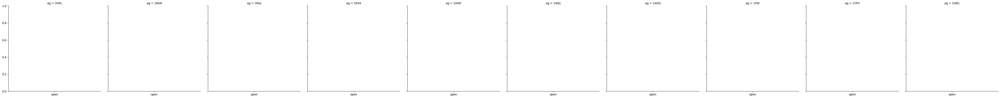

In [288]:
sns.catplot(data=performance_df, x='test type', y ='acc', col='ag', color=".9")
sns.swarmplot(data=performance_df, x='test type', y ='acc', col='ag', size=3)

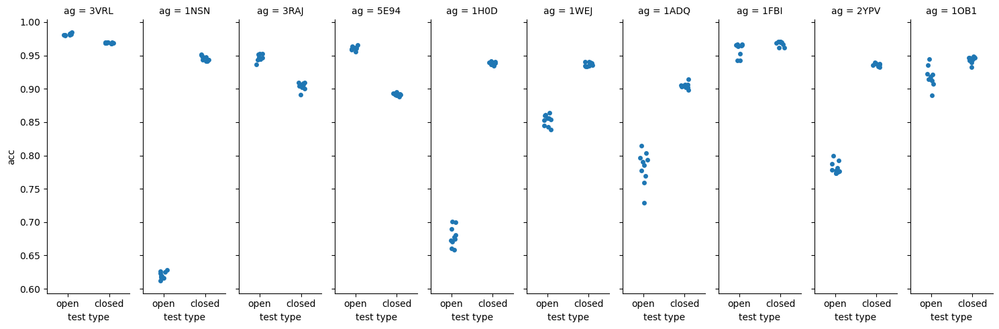

In [276]:
sns.catplot(performance_df, x ='test type', y ='acc', col='ag', aspect=0.3)
        

In [ ]:
## Closed 1 vs all, open high low for 1 antigen

In [ ]:
# TODO: scatter plor acc-energy hue open closed (percentiles of affinity)

In [ ]:
#joy plot (can sort by average and median)

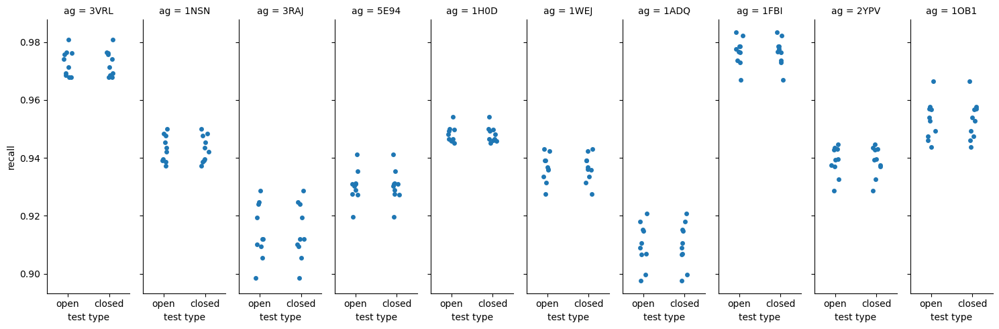

In [279]:
sns.catplot(performance_df, x ='test type', y ='recall', col='ag', aspect=0.3) #chech, looks the same for open and closed

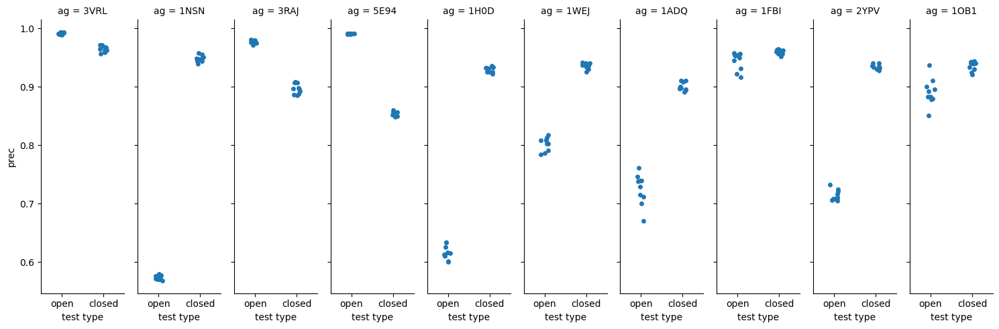

In [280]:
sns.catplot(performance_df, x ='test type', y ='prec', col='ag', aspect=0.3)

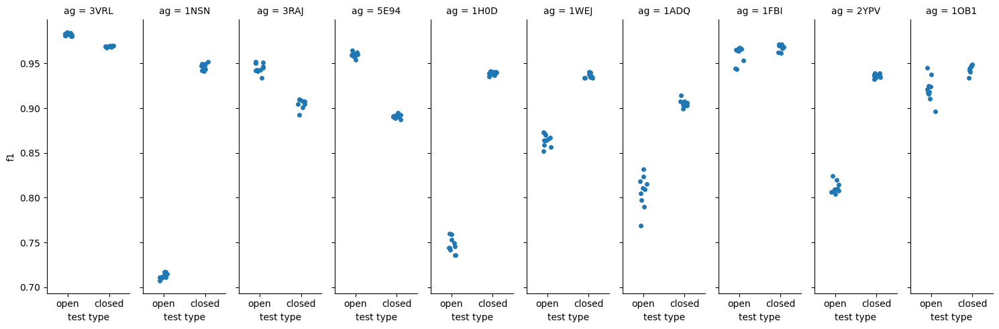

In [281]:
sns.catplot(performance_df, x ='test type', y ='f1', col='ag', aspect=0.3)

In [283]:
pairwise_high_paths = glob.glob(str(Path(PAIRWISE_HIGH_PATH)) + "/[0-9A-Z]*")

In [ ]:
replicates = 10
for dataset in pairwise_high_paths:
    file = dataset.split('/')[-1].strip('.tsv')
    df = pd.read_csv(dataset, sep='\t')
    train_pw, val_pw,  test_pw = train_val_test_prep(df, scale = False)
    train_loader = DataLoader(train_pw, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_pw, batch_size=batch_size, shuffle=True)
    test_loader = DataLoader(test_pw, batch_size=batch_size, shuffle=True)
    for i in range(1, replicates+1):
        train_SN10(train_loader, f'{file}_repl_{str(i)}')

Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.35826289653778076, Validation loss: 0.23217156529426575


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.20583966374397278, Validation loss: 0.19470921158790588


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.17502909898757935, Validation loss: 0.1730029284954071


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.15535932779312134, Validation loss: 0.1543700397014618


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.139511376619339, Validation loss: 0.14215265214443207


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.12782126665115356, Validation loss: 0.1366940587759018


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.11898814886808395, Validation loss: 0.12682965397834778


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.11067872494459152, Validation loss: 0.1227894127368927


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.10446827858686447, Validation loss: 0.11809346079826355


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.09876476228237152, Validation loss: 0.11484464257955551


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.09390980005264282, Validation loss: 0.1121131032705307


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.08919525146484375, Validation loss: 0.11066413670778275


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08497659862041473, Validation loss: 0.10775135457515717


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08079977333545685, Validation loss: 0.10449784249067307


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07732438296079636, Validation loss: 0.10174088180065155


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07400327175855637, Validation loss: 0.09931090474128723


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07115811854600906, Validation loss: 0.10049242526292801


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06879841536283493, Validation loss: 0.0975472629070282


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06656746566295624, Validation loss: 0.09858311712741852


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06465831398963928, Validation loss: 0.09613899886608124


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06247333809733391, Validation loss: 0.09511040151119232


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.06084253638982773, Validation loss: 0.09547455608844757


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.05892802029848099, Validation loss: 0.09591922909021378


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.05736352503299713, Validation loss: 0.09527955204248428


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05630837008357048, Validation loss: 0.09704481810331345


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.054654184728860855, Validation loss: 0.0971486046910286


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.05337390676140785, Validation loss: 0.09512444585561752
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.36261308193206787, Validation loss: 0.24404790997505188


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.21465566754341125, Validation loss: 0.20173658430576324


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.18350660800933838, Validation loss: 0.17992347478866577


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.16350197792053223, Validation loss: 0.1639038473367691


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.1478109508752823, Validation loss: 0.15208931267261505


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.13455703854560852, Validation loss: 0.14086484909057617


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.12344007939100266, Validation loss: 0.12989424169063568


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.11321987211704254, Validation loss: 0.12064159661531448


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.10345897823572159, Validation loss: 0.11459849774837494


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.09643188118934631, Validation loss: 0.10737648606300354


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.08947815746068954, Validation loss: 0.10231023281812668


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.08363775163888931, Validation loss: 0.09858151525259018


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.07931768149137497, Validation loss: 0.09618239104747772


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07478894293308258, Validation loss: 0.09323382377624512


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07128556072711945, Validation loss: 0.09278931468725204


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.06836356967687607, Validation loss: 0.09136073291301727


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.0656486377120018, Validation loss: 0.08925014734268188


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.0633828192949295, Validation loss: 0.08890824019908905


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06137501075863838, Validation loss: 0.0881606861948967


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.05894407257437706, Validation loss: 0.08630527555942535


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.05730360373854637, Validation loss: 0.0868513211607933


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.05845560133457184, Validation loss: 0.0852603018283844


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.05727097764611244, Validation loss: 0.08668974041938782


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.05546858534216881, Validation loss: 0.086194708943367


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05401165410876274, Validation loss: 0.08524779230356216


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.052879154682159424, Validation loss: 0.08740963786840439
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3608900308609009, Validation loss: 0.24212048947811127


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.21506859362125397, Validation loss: 0.201930969953537


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.18255314230918884, Validation loss: 0.17877444624900818


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.16200418770313263, Validation loss: 0.16195708513259888


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.1459933966398239, Validation loss: 0.1497926265001297


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.13309884071350098, Validation loss: 0.1390928328037262


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.12188604474067688, Validation loss: 0.12898696959018707


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.11215945333242416, Validation loss: 0.12256232649087906


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.1038307175040245, Validation loss: 0.11498014628887177


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.09718241542577744, Validation loss: 0.11145924031734467


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.09147857874631882, Validation loss: 0.10673609375953674


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.08590579777956009, Validation loss: 0.10370419174432755


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.0812559723854065, Validation loss: 0.10043219476938248


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07671554386615753, Validation loss: 0.0988638699054718


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.0734858363866806, Validation loss: 0.09593461453914642


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07009443640708923, Validation loss: 0.09459509700536728


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.06807784736156464, Validation loss: 0.09235876053571701


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06503408402204514, Validation loss: 0.09265413135290146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06235147640109062, Validation loss: 0.0922447144985199


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06074555218219757, Validation loss: 0.09272956103086472


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.058822132647037506, Validation loss: 0.09207948297262192


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.05686395987868309, Validation loss: 0.09368724375963211


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.055398765951395035, Validation loss: 0.09170949459075928


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.054003652185201645, Validation loss: 0.09016595035791397


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.052764128893613815, Validation loss: 0.09018801152706146
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3589114248752594, Validation loss: 0.23363009095191956


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.20666742324829102, Validation loss: 0.19357529282569885


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.17490434646606445, Validation loss: 0.16961845755577087


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.15448306500911713, Validation loss: 0.15685921907424927


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.138572558760643, Validation loss: 0.1391371637582779


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.1254991739988327, Validation loss: 0.12921737134456635


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.11446280032396317, Validation loss: 0.1240573301911354


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.10633626580238342, Validation loss: 0.11442730575799942


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.09817889332771301, Validation loss: 0.10952993482351303


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.09222234785556793, Validation loss: 0.10576402395963669


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.08664635568857193, Validation loss: 0.10270179063081741


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.08232252299785614, Validation loss: 0.09916241466999054


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.07801032811403275, Validation loss: 0.0969669371843338


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07585234194993973, Validation loss: 0.09565174579620361


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07162494212388992, Validation loss: 0.09419234097003937


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.06929314136505127, Validation loss: 0.09505289793014526


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.06745322793722153, Validation loss: 0.09429630637168884


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06490734219551086, Validation loss: 0.09306813031435013


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06358551234006882, Validation loss: 0.09202341735363007


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.061409372836351395, Validation loss: 0.09252451360225677


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06036246567964554, Validation loss: 0.09096543490886688


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.058814432471990585, Validation loss: 0.09051628410816193


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.05750763416290283, Validation loss: 0.09079954773187637


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.05621851608157158, Validation loss: 0.09038664400577545
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3762776851654053, Validation loss: 0.249134361743927


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.22133775055408478, Validation loss: 0.20972153544425964


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.18875305354595184, Validation loss: 0.1860743910074234


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.16849040985107422, Validation loss: 0.16850630939006805


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.15252412855625153, Validation loss: 0.1557939648628235


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.13979195058345795, Validation loss: 0.1445937603712082


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.12904754281044006, Validation loss: 0.1367853581905365


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.11987017840147018, Validation loss: 0.12863977253437042


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.11177559942007065, Validation loss: 0.12232615798711777


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.1044781357049942, Validation loss: 0.11619696766138077


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.09761589765548706, Validation loss: 0.11145976930856705


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09136486053466797, Validation loss: 0.10702791810035706


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.0864863321185112, Validation loss: 0.10326340049505234


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08205895125865936, Validation loss: 0.1009787917137146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07772254943847656, Validation loss: 0.09723687916994095


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07414231449365616, Validation loss: 0.09600719809532166


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.0711197629570961, Validation loss: 0.09394410252571106


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06774444878101349, Validation loss: 0.09237394481897354


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06503184884786606, Validation loss: 0.0907072052359581


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06239955499768257, Validation loss: 0.0900634378194809


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06020653620362282, Validation loss: 0.08958142250776291


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.0582609549164772, Validation loss: 0.08936646580696106


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.0559869110584259, Validation loss: 0.08841506391763687


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.054176803678274155, Validation loss: 0.08813522756099701


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.052705369889736176, Validation loss: 0.08853210508823395


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.050935473293066025, Validation loss: 0.08785226196050644


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.0501708947122097, Validation loss: 0.08709415793418884


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.048123329877853394, Validation loss: 0.08904373645782471
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3632931709289551, Validation loss: 0.2353803664445877


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.20563474297523499, Validation loss: 0.19241133332252502


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1742224395275116, Validation loss: 0.17417751252651215


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.15475806593894958, Validation loss: 0.15386447310447693


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.13960522413253784, Validation loss: 0.14175720512866974


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.12799030542373657, Validation loss: 0.13227508962154388


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.11837047338485718, Validation loss: 0.12633199989795685


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.11118178069591522, Validation loss: 0.12187721580266953


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.10542456060647964, Validation loss: 0.11754178255796432


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.09939046204090118, Validation loss: 0.11344737559556961


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.09447042644023895, Validation loss: 0.11094094067811966


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09061791002750397, Validation loss: 0.11072944104671478


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08754698932170868, Validation loss: 0.10923033952713013


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08398537337779999, Validation loss: 0.10634040087461472


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.08074846863746643, Validation loss: 0.10430289804935455


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07814657688140869, Validation loss: 0.10318759828805923


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07589764147996902, Validation loss: 0.10330069065093994


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.07396139949560165, Validation loss: 0.10128076374530792


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.07197078317403793, Validation loss: 0.10425281524658203


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.07006409764289856, Validation loss: 0.10174789279699326


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06792408972978592, Validation loss: 0.1002935916185379


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.0663122907280922, Validation loss: 0.10054795444011688


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.06480787694454193, Validation loss: 0.10006894916296005


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.06353799998760223, Validation loss: 0.09999892115592957
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.36088863015174866, Validation loss: 0.23749932646751404


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.21054129302501678, Validation loss: 0.1976480484008789


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.17994573712348938, Validation loss: 0.17559407651424408


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.1614983230829239, Validation loss: 0.16161134839057922


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.1468285769224167, Validation loss: 0.14866647124290466


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.13421611487865448, Validation loss: 0.1370248943567276


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.1233295202255249, Validation loss: 0.12861472368240356


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.11434036493301392, Validation loss: 0.12299110740423203


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.10617411881685257, Validation loss: 0.1169688031077385


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.09968291968107224, Validation loss: 0.11262468993663788


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.09376148879528046, Validation loss: 0.10838036984205246


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.08845928311347961, Validation loss: 0.10529027134180069


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08419127017259598, Validation loss: 0.10165535658597946


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07969749718904495, Validation loss: 0.0987241119146347


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07535423338413239, Validation loss: 0.09719284623861313


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07203270494937897, Validation loss: 0.09403485059738159


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.06864169239997864, Validation loss: 0.09276820719242096


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06629129499197006, Validation loss: 0.09181974828243256


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06316889077425003, Validation loss: 0.08890867233276367


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06142377108335495, Validation loss: 0.08858738094568253


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.05933002755045891, Validation loss: 0.08737645298242569


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.05725996941328049, Validation loss: 0.08700171113014221


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.05618653446435928, Validation loss: 0.08704877644777298


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.053816620260477066, Validation loss: 0.08739250153303146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05240707844495773, Validation loss: 0.08524732291698456


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.05116858705878258, Validation loss: 0.08538258075714111


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.049878962337970734, Validation loss: 0.08674246817827225


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.04866497963666916, Validation loss: 0.08539094775915146
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3529052138328552, Validation loss: 0.2435554563999176


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.21673110127449036, Validation loss: 0.2048281580209732


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1860596090555191, Validation loss: 0.18233728408813477


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.16543440520763397, Validation loss: 0.1648494005203247


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.14941874146461487, Validation loss: 0.1571630835533142


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.13605037331581116, Validation loss: 0.14280609786510468


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.12595953047275543, Validation loss: 0.13369035720825195


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.11707697063684464, Validation loss: 0.12650375068187714


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.1086353212594986, Validation loss: 0.1195097491145134


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.1012369766831398, Validation loss: 0.1171647235751152


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.09478104114532471, Validation loss: 0.11219543218612671


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.08926986902952194, Validation loss: 0.10523591190576553


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08432027697563171, Validation loss: 0.10374037176370621


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07970532029867172, Validation loss: 0.10323406010866165


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.0758051946759224, Validation loss: 0.09729473292827606


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.0726587325334549, Validation loss: 0.09545973688364029


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.0694853886961937, Validation loss: 0.09415524452924728


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06695383787155151, Validation loss: 0.09230456501245499


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06448428332805634, Validation loss: 0.0931348130106926


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06223982200026512, Validation loss: 0.09152915328741074


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06019195541739464, Validation loss: 0.08941744267940521


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.05847246199846268, Validation loss: 0.08896016329526901


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.05717889219522476, Validation loss: 0.08850935846567154


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.05572286993265152, Validation loss: 0.08905091136693954


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05407020449638367, Validation loss: 0.0881473645567894


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.05269720032811165, Validation loss: 0.0890970453619957


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.05142904072999954, Validation loss: 0.08791162818670273


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.050303976982831955, Validation loss: 0.08839686214923859


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.049462366849184036, Validation loss: 0.08780185878276825
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.34651678800582886, Validation loss: 0.2446661740541458


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.2159675806760788, Validation loss: 0.20489925146102905


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.18478435277938843, Validation loss: 0.1826285868883133


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.16459032893180847, Validation loss: 0.1673089563846588


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.14853255450725555, Validation loss: 0.15042592585086823


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.13442784547805786, Validation loss: 0.13933008909225464


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.12300459295511246, Validation loss: 0.13217468559741974


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.11307475715875626, Validation loss: 0.12399373203516006


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.10453297197818756, Validation loss: 0.11757329851388931


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.0957670733332634, Validation loss: 0.11064046621322632


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.08961354941129684, Validation loss: 0.10718504339456558


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.08361079543828964, Validation loss: 0.10082925111055374


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.07850632071495056, Validation loss: 0.1015876904129982


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07473922520875931, Validation loss: 0.09445440769195557


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07086428254842758, Validation loss: 0.09339150786399841


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.06741604954004288, Validation loss: 0.09105154126882553


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.06536982208490372, Validation loss: 0.09092401713132858


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06262936443090439, Validation loss: 0.08930297195911407


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.061091698706150055, Validation loss: 0.08897905796766281


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.05838240310549736, Validation loss: 0.0891144722700119


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.057097259908914566, Validation loss: 0.09115791320800781


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.05526810511946678, Validation loss: 0.08907362073659897


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.05326274037361145, Validation loss: 0.08788666129112244


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.0519229918718338, Validation loss: 0.0888616070151329


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.0503992885351181, Validation loss: 0.08974811434745789
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.35740962624549866, Validation loss: 0.23634158074855804


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.20839743316173553, Validation loss: 0.19529680907726288


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.17654260993003845, Validation loss: 0.17283572256565094


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.15603989362716675, Validation loss: 0.15584410727024078


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.13962242007255554, Validation loss: 0.14173610508441925


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.1266757845878601, Validation loss: 0.13218027353286743


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.11595465987920761, Validation loss: 0.12544108927249908


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.1075863242149353, Validation loss: 0.1171421930193901


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.10036402940750122, Validation loss: 0.1131497174501419


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.09457576274871826, Validation loss: 0.10956395417451859


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.08934217691421509, Validation loss: 0.10750338435173035


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.08470456302165985, Validation loss: 0.10412191599607468


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08055280148983002, Validation loss: 0.1007082462310791


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07683387398719788, Validation loss: 0.0984339490532875


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07330413162708282, Validation loss: 0.09941805899143219


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07025458663702011, Validation loss: 0.09854734688997269


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.06712286919355392, Validation loss: 0.09524381905794144


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06524675339460373, Validation loss: 0.09621264040470123


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.062028780579566956, Validation loss: 0.09529440850019455


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06000839173793793, Validation loss: 0.09376773983240128


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.05782013759016991, Validation loss: 0.09281942993402481


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.056188810616731644, Validation loss: 0.09305672347545624


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.054392099380493164, Validation loss: 0.09589307010173798


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.052926961332559586, Validation loss: 0.09274742007255554


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05203362926840782, Validation loss: 0.09273230284452438


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.05031382665038109, Validation loss: 0.09190656989812851
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.28741756081581116, Validation loss: 0.1394166350364685


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.12235427647829056, Validation loss: 0.1142331138253212


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1056477501988411, Validation loss: 0.10417807102203369


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.09696097671985626, Validation loss: 0.09753613919019699


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.09046013653278351, Validation loss: 0.09276390075683594


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.08448866754770279, Validation loss: 0.08746399730443954


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.07889197021722794, Validation loss: 0.08187458664178848


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.0728636160492897, Validation loss: 0.07691222429275513


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.06642566621303558, Validation loss: 0.07144606113433838


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.06076885014772415, Validation loss: 0.06859555095434189


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.05526459217071533, Validation loss: 0.06194784492254257


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.050076924264431, Validation loss: 0.05876187980175018


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.045233190059661865, Validation loss: 0.05496497079730034


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.04176773130893707, Validation loss: 0.05198868736624718


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.038507767021656036, Validation loss: 0.05079690366983414


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.035074323415756226, Validation loss: 0.048503950238227844


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.032369889318943024, Validation loss: 0.04623831436038017


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.030382398515939713, Validation loss: 0.046715520322322845


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.028253408148884773, Validation loss: 0.04500247538089752


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.02652732841670513, Validation loss: 0.04487396404147148


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.024811360985040665, Validation loss: 0.04359577223658562


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.023280151188373566, Validation loss: 0.0434534065425396


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.02181847020983696, Validation loss: 0.04199608042836189


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.020594656467437744, Validation loss: 0.04287169128656387


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.019596092402935028, Validation loss: 0.0424332357943058


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.018684756010770798, Validation loss: 0.042113419622182846
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.281133234500885, Validation loss: 0.13941174745559692


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.12204381823539734, Validation loss: 0.11336331814527512


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.10452014952898026, Validation loss: 0.10146947205066681


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.09484012424945831, Validation loss: 0.09445223957300186


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.08835265040397644, Validation loss: 0.08974512666463852


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.08239998668432236, Validation loss: 0.08519329130649567


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.07706153392791748, Validation loss: 0.08063013851642609


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.07167214155197144, Validation loss: 0.0757332295179367


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.06602536886930466, Validation loss: 0.07120030373334885


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.06099784001708031, Validation loss: 0.06785702705383301


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.05615808069705963, Validation loss: 0.06416784971952438


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.05210786312818527, Validation loss: 0.06150656193494797


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.04799783229827881, Validation loss: 0.05754850059747696


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.04399101436138153, Validation loss: 0.05498384311795235


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.040823932737112045, Validation loss: 0.0521971620619297


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.03767339512705803, Validation loss: 0.049842383712530136


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.034716829657554626, Validation loss: 0.04848651960492134


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.03205388784408569, Validation loss: 0.04745667800307274


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.029994424432516098, Validation loss: 0.045295167714357376


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.028093479573726654, Validation loss: 0.04449594393372536


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.025958871468901634, Validation loss: 0.043929509818553925


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.02405114285647869, Validation loss: 0.04312274605035782


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.02248820848762989, Validation loss: 0.04227284714579582


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.02084014192223549, Validation loss: 0.0425715446472168


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.019829900935292244, Validation loss: 0.04224972426891327


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.01846982352435589, Validation loss: 0.041731879115104675


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.01711544767022133, Validation loss: 0.042369693517684937


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.016087159514427185, Validation loss: 0.041703157126903534
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2811878025531769, Validation loss: 0.1380489468574524


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.12103278189897537, Validation loss: 0.11189170181751251


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.10460847616195679, Validation loss: 0.10365115106105804


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.09558261185884476, Validation loss: 0.09450259059667587


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.08872834593057632, Validation loss: 0.08908987790346146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.08248292654752731, Validation loss: 0.0841747522354126


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.07628101110458374, Validation loss: 0.07919588685035706


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.07006700336933136, Validation loss: 0.07527196407318115


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.06512129306793213, Validation loss: 0.07084552198648453


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.05979199334979057, Validation loss: 0.06840390712022781


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.055204469710588455, Validation loss: 0.0649339035153389


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.05106096714735031, Validation loss: 0.060963839292526245


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.04654420539736748, Validation loss: 0.059791199862957


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.04300922900438309, Validation loss: 0.05718366429209709


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.039563536643981934, Validation loss: 0.05545523017644882


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.0364689826965332, Validation loss: 0.05326107516884804


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.03397975116968155, Validation loss: 0.051941052079200745


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.031215455383062363, Validation loss: 0.05134177207946777


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.029345516115427017, Validation loss: 0.04814625903964043


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.02727467007935047, Validation loss: 0.04990537092089653


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.025865769013762474, Validation loss: 0.04755615442991257


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.0238913856446743, Validation loss: 0.04683387279510498


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.022673433646559715, Validation loss: 0.048505209386348724


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.02104301191866398, Validation loss: 0.045532241463661194


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.019984595477581024, Validation loss: 0.046797774732112885


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.018741965293884277, Validation loss: 0.04535054787993431


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.017891746014356613, Validation loss: 0.045891374349594116


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.016700685024261475, Validation loss: 0.0459740050137043
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3333713710308075, Validation loss: 0.14816178381443024


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.1276237666606903, Validation loss: 0.11840643733739853


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.11105406284332275, Validation loss: 0.10962600260972977


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.10349586606025696, Validation loss: 0.10253776609897614


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.09702858328819275, Validation loss: 0.09820160269737244


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.09016744792461395, Validation loss: 0.09140092879533768


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.08392027765512466, Validation loss: 0.08713960647583008


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.07822606712579727, Validation loss: 0.08142749220132828


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.07283703237771988, Validation loss: 0.07647784054279327


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.06763210147619247, Validation loss: 0.07361465692520142


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.0625484511256218, Validation loss: 0.06931055337190628


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.05729509890079498, Validation loss: 0.06763045489788055


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.05279591679573059, Validation loss: 0.06289444863796234


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.04862440004944801, Validation loss: 0.06050557643175125


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.04520691558718681, Validation loss: 0.06007746607065201


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.042437583208084106, Validation loss: 0.05625995248556137


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.0397961288690567, Validation loss: 0.055588364601135254


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.037291280925273895, Validation loss: 0.05517810583114624


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.035559363663196564, Validation loss: 0.054546236991882324


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.03347641974687576, Validation loss: 0.05216658115386963


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.03211599215865135, Validation loss: 0.051453981548547745


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.030338717624545097, Validation loss: 0.051794927567243576


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.029019486159086227, Validation loss: 0.050719160586595535


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.02754773199558258, Validation loss: 0.05002373456954956


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.02621793933212757, Validation loss: 0.050442829728126526


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.025133872404694557, Validation loss: 0.05000540241599083


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.023942317813634872, Validation loss: 0.04896184056997299


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.02280399389564991, Validation loss: 0.048007577657699585


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.02207760512828827, Validation loss: 0.04845571145415306
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2906492054462433, Validation loss: 0.1410818248987198


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.12295085191726685, Validation loss: 0.11521553248167038


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.10713677108287811, Validation loss: 0.1064942255616188


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.09887295961380005, Validation loss: 0.10041933506727219


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.0926542654633522, Validation loss: 0.09387478977441788


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.08622922003269196, Validation loss: 0.08784617483615875


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.07986807078123093, Validation loss: 0.08264824748039246


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.0738455206155777, Validation loss: 0.07826242595911026


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.06782502681016922, Validation loss: 0.07314307242631912


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.06195588409900665, Validation loss: 0.06831002235412598


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.05685924366116524, Validation loss: 0.0636000856757164


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.05250730365514755, Validation loss: 0.06007342413067818


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.048981551080942154, Validation loss: 0.05787970870733261


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.04565621539950371, Validation loss: 0.05572487413883209


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.0428774319589138, Validation loss: 0.05576082691550255


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.040685612708330154, Validation loss: 0.05302174389362335


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.03847919777035713, Validation loss: 0.05147920548915863


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.03706086426973343, Validation loss: 0.051122263073921204


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.03515813127160072, Validation loss: 0.05024896562099457


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.03371015191078186, Validation loss: 0.04933639243245125


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.03200112283229828, Validation loss: 0.04856152832508087


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.031052295118570328, Validation loss: 0.048592038452625275


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.029883548617362976, Validation loss: 0.04708881303668022


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.02857312001287937, Validation loss: 0.04606807604432106


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.02736605331301689, Validation loss: 0.046178266406059265


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.026124052703380585, Validation loss: 0.04604164510965347


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.02547612600028515, Validation loss: 0.04519254341721535


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.024236537516117096, Validation loss: 0.045894425362348557


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.02336917445063591, Validation loss: 0.04565684124827385
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.29504793882369995, Validation loss: 0.14246214926242828


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.12442956864833832, Validation loss: 0.11635930836200714


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.10732012987136841, Validation loss: 0.10685734450817108


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.09942957013845444, Validation loss: 0.10055439174175262


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.0935683473944664, Validation loss: 0.09661246836185455


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.08882005512714386, Validation loss: 0.09084169566631317


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.08305437862873077, Validation loss: 0.08662499487400055


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.07748755812644958, Validation loss: 0.08095229417085648


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.07171275466680527, Validation loss: 0.0771370381116867


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.0665743350982666, Validation loss: 0.07200387865304947


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.06118898466229439, Validation loss: 0.06778126209974289


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.056384261697530746, Validation loss: 0.06484866887331009


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.05266590043902397, Validation loss: 0.061837658286094666


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.0488366074860096, Validation loss: 0.05889122560620308


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.04521327465772629, Validation loss: 0.05757593736052513


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.04204966500401497, Validation loss: 0.05522076413035393


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.039482101798057556, Validation loss: 0.05363063886761665


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.03689582645893097, Validation loss: 0.05144917592406273


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.034504324197769165, Validation loss: 0.050784848630428314


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.032671038061380386, Validation loss: 0.050073035061359406


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.030333731323480606, Validation loss: 0.0486406646668911


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.02891351841390133, Validation loss: 0.046082306653261185


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.02712324634194374, Validation loss: 0.04578254371881485


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.02577848546206951, Validation loss: 0.046070292592048645


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.024256901815533638, Validation loss: 0.04520951583981514


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.023171836510300636, Validation loss: 0.045515067875385284


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.021913597360253334, Validation loss: 0.04572520777583122


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.020764604210853577, Validation loss: 0.04476325586438179


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.019897956401109695, Validation loss: 0.045146405696868896


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.019068511202931404, Validation loss: 0.04613510146737099
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.281593918800354, Validation loss: 0.1372411996126175


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.12174144387245178, Validation loss: 0.11393045634031296


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.10524187982082367, Validation loss: 0.10430865734815598


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.09709381312131882, Validation loss: 0.09788145869970322


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.09073688834905624, Validation loss: 0.09152773767709732


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.08440564572811127, Validation loss: 0.08879239857196808


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.07824893295764923, Validation loss: 0.0818214863538742


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.07223204523324966, Validation loss: 0.07655205577611923


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.06636319309473038, Validation loss: 0.07261145859956741


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.06226810812950134, Validation loss: 0.06752905994653702


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.05663960427045822, Validation loss: 0.06607963144779205


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.0519958920776844, Validation loss: 0.06200259551405907


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.04781342297792435, Validation loss: 0.05768125131726265


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.043910812586545944, Validation loss: 0.05486634373664856


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.04068266600370407, Validation loss: 0.0531911626458168


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.03738197311758995, Validation loss: 0.05100535601377487


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.034511178731918335, Validation loss: 0.05016036331653595


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.03200393170118332, Validation loss: 0.04889802634716034


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.029698215425014496, Validation loss: 0.04758331552147865


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.02767169289290905, Validation loss: 0.04682714119553566


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.025788720697164536, Validation loss: 0.045995380729436874


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.024060385301709175, Validation loss: 0.044794682413339615


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.022519823163747787, Validation loss: 0.044928375631570816


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.02103460393846035, Validation loss: 0.04418466240167618


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.019950533285737038, Validation loss: 0.04562186077237129


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.01889009214937687, Validation loss: 0.044786762446165085


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.017586905509233475, Validation loss: 0.04470990225672722
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.30007290840148926, Validation loss: 0.1406065970659256


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.12367134541273117, Validation loss: 0.11534556746482849


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.10598505288362503, Validation loss: 0.10394741594791412


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.09661156684160233, Validation loss: 0.09659437835216522


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.09031002223491669, Validation loss: 0.0917486697435379


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.08395590633153915, Validation loss: 0.08603604882955551


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.07817865908145905, Validation loss: 0.08131126314401627


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.07264865934848785, Validation loss: 0.07693756371736526


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.06721498817205429, Validation loss: 0.07256711274385452


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.06235486641526222, Validation loss: 0.06909625977277756


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.05696754902601242, Validation loss: 0.06700540333986282


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.05245455726981163, Validation loss: 0.061685383319854736


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.047943685203790665, Validation loss: 0.05861153081059456


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.04402365908026695, Validation loss: 0.05576886609196663


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.04081433638930321, Validation loss: 0.05374467745423317


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.03765774145722389, Validation loss: 0.05131214112043381


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.0347156748175621, Validation loss: 0.04941773787140846


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.03209376707673073, Validation loss: 0.04899051785469055


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.029970761388540268, Validation loss: 0.04639613628387451


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.027652395889163017, Validation loss: 0.04643441364169121


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.02604624256491661, Validation loss: 0.04489611089229584


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.024316292256116867, Validation loss: 0.044096022844314575


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.023074286058545113, Validation loss: 0.04534711688756943


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.021614661440253258, Validation loss: 0.04317227751016617


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.020779171958565712, Validation loss: 0.04362742602825165


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.019323430955410004, Validation loss: 0.043497707694768906


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.01827753148972988, Validation loss: 0.04268941283226013


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.01720474846661091, Validation loss: 0.04284121096134186
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.28967511653900146, Validation loss: 0.14116635918617249


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.12451478093862534, Validation loss: 0.11548175662755966


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.10758689790964127, Validation loss: 0.10401634871959686


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.09715825319290161, Validation loss: 0.09563519805669785


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.08915361762046814, Validation loss: 0.08982200175523758


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.082181416451931, Validation loss: 0.08425946533679962


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.07630404084920883, Validation loss: 0.08075790107250214


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.07112569361925125, Validation loss: 0.0750582367181778


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.06617248058319092, Validation loss: 0.07251033186912537


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.06129219010472298, Validation loss: 0.0686587393283844


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.05652580037713051, Validation loss: 0.06485418230295181


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.05189908295869827, Validation loss: 0.062666155397892


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.04802990332245827, Validation loss: 0.0597798153758049


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.04437512904405594, Validation loss: 0.05767427757382393


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.04094484820961952, Validation loss: 0.056323014199733734


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.03839435055851936, Validation loss: 0.05441882833838463


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.035370100289583206, Validation loss: 0.054007817059755325


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.0331452377140522, Validation loss: 0.05193374678492546


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.030906572937965393, Validation loss: 0.05175637826323509


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.029297880828380585, Validation loss: 0.05148625746369362


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.027827652171254158, Validation loss: 0.04941224306821823


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.025581032037734985, Validation loss: 0.050035323947668076


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.02422376535832882, Validation loss: 0.04869556799530983


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.02287440188229084, Validation loss: 0.048610806465148926


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.021584298461675644, Validation loss: 0.047247856855392456


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.02025367133319378, Validation loss: 0.048067353665828705


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.01926574297249317, Validation loss: 0.04718773439526558
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2962603271007538, Validation loss: 0.1421106606721878


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.12600073218345642, Validation loss: 0.11631922423839569


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.10910288244485855, Validation loss: 0.10578514635562897


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.09923607856035233, Validation loss: 0.09798635542392731


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.09169378131628036, Validation loss: 0.09178820252418518


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.08564743399620056, Validation loss: 0.08732695877552032


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.0803641602396965, Validation loss: 0.08362235128879547


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.07501017302274704, Validation loss: 0.07985373586416245


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.07011917233467102, Validation loss: 0.07533859461545944


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.06549539417028427, Validation loss: 0.07173354923725128


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.060451339930295944, Validation loss: 0.06849892437458038


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.05582049489021301, Validation loss: 0.06506218761205673


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.05110396072268486, Validation loss: 0.06091655418276787


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.04671143367886543, Validation loss: 0.058002181351184845


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.04308154433965683, Validation loss: 0.0559566430747509


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.03961531072854996, Validation loss: 0.05384364724159241


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.03662820905447006, Validation loss: 0.053142912685871124


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.034282386302948, Validation loss: 0.051357805728912354


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.031859271228313446, Validation loss: 0.050887398421764374


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.03000532276928425, Validation loss: 0.05016142874956131


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.02811676822602749, Validation loss: 0.04937584698200226


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.026575805619359016, Validation loss: 0.04787584766745567


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.025185097008943558, Validation loss: 0.047805868089199066


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.023826880380511284, Validation loss: 0.04708497226238251


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.022452522069215775, Validation loss: 0.04634987935423851


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.02132146805524826, Validation loss: 0.04880436882376671


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.020354360342025757, Validation loss: 0.046874500811100006


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.018869196996092796, Validation loss: 0.04644108936190605
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.364021360874176, Validation loss: 0.2335013747215271


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.20794449746608734, Validation loss: 0.21172960102558136


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.19680602848529816, Validation loss: 0.2083408087491989


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.19333629310131073, Validation loss: 0.2062871903181076


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.18810604512691498, Validation loss: 0.2002703696489334


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.1802975833415985, Validation loss: 0.19324402511119843


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.16839203238487244, Validation loss: 0.17918576300144196


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.1526598334312439, Validation loss: 0.16625149548053741


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.1356685906648636, Validation loss: 0.15012356638908386


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.12091473489999771, Validation loss: 0.13706111907958984


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.10810631513595581, Validation loss: 0.1282104104757309


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.0977591872215271, Validation loss: 0.11815664172172546


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08866724371910095, Validation loss: 0.11129086464643478


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.0809566006064415, Validation loss: 0.10725441575050354


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07449617236852646, Validation loss: 0.1012798473238945


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.06933712959289551, Validation loss: 0.09655221551656723


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.06446940451860428, Validation loss: 0.0925978496670723


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.060602035373449326, Validation loss: 0.09042687714099884


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.05721477046608925, Validation loss: 0.08780112862586975


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.05414074659347534, Validation loss: 0.08601749688386917


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.05131816118955612, Validation loss: 0.08479731529951096


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.04918660223484039, Validation loss: 0.08426087349653244


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.046880897134542465, Validation loss: 0.08369708061218262


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.04476207494735718, Validation loss: 0.08281239867210388


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.04304790124297142, Validation loss: 0.08184970170259476


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.04154342785477638, Validation loss: 0.08064793795347214


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.04026549682021141, Validation loss: 0.08026999235153198


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.03906157612800598, Validation loss: 0.07953144609928131


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.037700992077589035, Validation loss: 0.07947544008493423


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.03635282441973686, Validation loss: 0.07923725247383118


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.03581341728568077, Validation loss: 0.08016638457775116


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.034621309489011765, Validation loss: 0.08071783930063248
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.36930426955223083, Validation loss: 0.2315000742673874


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.20767036080360413, Validation loss: 0.21039046347141266


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.19725589454174042, Validation loss: 0.2079726904630661


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.19403265416622162, Validation loss: 0.20461401343345642


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.1911267191171646, Validation loss: 0.20065099000930786


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.18734389543533325, Validation loss: 0.19722802937030792


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.17925921082496643, Validation loss: 0.18800994753837585


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.16373172402381897, Validation loss: 0.16762717068195343


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.14186367392539978, Validation loss: 0.1470453292131424


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.12024164199829102, Validation loss: 0.12965287268161774


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.10264677554368973, Validation loss: 0.1181124821305275


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.08987201005220413, Validation loss: 0.11078480631113052


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08055537939071655, Validation loss: 0.10289597511291504


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07367520779371262, Validation loss: 0.09919477999210358


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.06794089823961258, Validation loss: 0.09551388025283813


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.06307736784219742, Validation loss: 0.0907168984413147


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.059190209954977036, Validation loss: 0.08976883441209793


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.05556216835975647, Validation loss: 0.08607730269432068


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.05254969745874405, Validation loss: 0.08321303874254227


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.04987229034304619, Validation loss: 0.08183100074529648


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.04782025143504143, Validation loss: 0.08032120764255524


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.0453520193696022, Validation loss: 0.07920220494270325


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.04334729164838791, Validation loss: 0.07806532829999924


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.041788261383771896, Validation loss: 0.07709403336048126


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.040063679218292236, Validation loss: 0.07660464197397232


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.03867071494460106, Validation loss: 0.07466816902160645


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.03741716593503952, Validation loss: 0.0751086100935936


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.03545450046658516, Validation loss: 0.07450760155916214


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.034070637077093124, Validation loss: 0.0734872967004776


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.03307066857814789, Validation loss: 0.07234445214271545


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.032156579196453094, Validation loss: 0.07418826967477798


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.03059590794146061, Validation loss: 0.0723809003829956


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.02975921891629696, Validation loss: 0.07286381721496582
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.36676740646362305, Validation loss: 0.2323714792728424


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.20595647394657135, Validation loss: 0.21030782163143158


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.18835893273353577, Validation loss: 0.19802987575531006


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.17470106482505798, Validation loss: 0.18320156633853912


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.15934917330741882, Validation loss: 0.17163728177547455


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.14472472667694092, Validation loss: 0.15995344519615173


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.13322316110134125, Validation loss: 0.152414008975029


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.12294238060712814, Validation loss: 0.14265069365501404


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.11184509098529816, Validation loss: 0.13354888558387756


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.10150568187236786, Validation loss: 0.12258536368608475


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.0912632942199707, Validation loss: 0.1168375015258789


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.08285673707723618, Validation loss: 0.10830747336149216


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.07567126303911209, Validation loss: 0.10349320620298386


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.06942185014486313, Validation loss: 0.09828068315982819


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.06490021198987961, Validation loss: 0.09445910155773163


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.060911837965250015, Validation loss: 0.0911511555314064


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.05712854862213135, Validation loss: 0.08984220772981644


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.054535795003175735, Validation loss: 0.08800411224365234


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.05157962813973427, Validation loss: 0.08807487785816193


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.04932320490479469, Validation loss: 0.08420529961585999


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.04692264273762703, Validation loss: 0.0850493460893631


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.04502454027533531, Validation loss: 0.08305002003908157


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.04323340579867363, Validation loss: 0.08049363642930984


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.04109688475728035, Validation loss: 0.08109387755393982


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.03940722346305847, Validation loss: 0.09268752485513687


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.038060788065195084, Validation loss: 0.09294051676988602


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.03667740523815155, Validation loss: 0.09117600321769714


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.035370953381061554, Validation loss: 0.09110988676548004


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.034171175211668015, Validation loss: 0.09150169044733047


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.033238038420677185, Validation loss: 0.09069208800792694


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.031935229897499084, Validation loss: 0.09088165313005447


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.031042009592056274, Validation loss: 0.10061554610729218


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.029799707233905792, Validation loss: 0.09056179970502853


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.02944147028028965, Validation loss: 0.0925610214471817


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/100 - Train loss: 0.0282620619982481, Validation loss: 0.09055250883102417


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/100 - Train loss: 0.027535099536180496, Validation loss: 0.0931854322552681


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/100 - Train loss: 0.026593947783112526, Validation loss: 0.09167788922786713


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/100 - Train loss: 0.02602027729153633, Validation loss: 0.0921904519200325


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/100 - Train loss: 0.02520981803536415, Validation loss: 0.09199286997318268


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/100 - Train loss: 0.024635184556245804, Validation loss: 0.0935288667678833


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/100 - Train loss: 0.023520452901721, Validation loss: 0.09360845386981964


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/100 - Train loss: 0.023146750405430794, Validation loss: 0.10676459968090057


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/100 - Train loss: 0.0225912444293499, Validation loss: 0.10731371492147446


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/100 - Train loss: 0.02201702818274498, Validation loss: 0.10832179337739944


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/100 - Train loss: 0.021527471020817757, Validation loss: 0.1082267090678215


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/100 - Train loss: 0.020948220044374466, Validation loss: 0.11374252289533615


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/100 - Train loss: 0.020470164716243744, Validation loss: 0.10699532181024551


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/100 - Train loss: 0.02012796513736248, Validation loss: 0.10967911034822464


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/100 - Train loss: 0.01956581138074398, Validation loss: 0.11132226139307022


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/100 - Train loss: 0.018976222723722458, Validation loss: 0.10966717451810837


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/100 - Train loss: 0.018703794106841087, Validation loss: 0.11116926372051239


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/100 - Train loss: 0.01821313612163067, Validation loss: 0.11178111284971237


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/100 - Train loss: 0.017976058647036552, Validation loss: 0.11570966243743896


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/100 - Train loss: 0.017405128106474876, Validation loss: 0.11350440979003906


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/100 - Train loss: 0.017118236050009727, Validation loss: 0.11375263333320618


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/100 - Train loss: 0.016623755916953087, Validation loss: 0.11490751057863235


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/100 - Train loss: 0.01635611616075039, Validation loss: 0.11620400100946426


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/100 - Train loss: 0.016170112416148186, Validation loss: 0.11778674274682999


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/100 - Train loss: 0.015560029074549675, Validation loss: 0.11904871463775635


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/100 - Train loss: 0.015397276729345322, Validation loss: 0.11834388971328735


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/100 - Train loss: 0.015136566013097763, Validation loss: 0.12030468881130219


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/100 - Train loss: 0.014913283288478851, Validation loss: 0.11759594827890396


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/100 - Train loss: 0.014432971365749836, Validation loss: 0.11774134635925293


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/100 - Train loss: 0.014310188591480255, Validation loss: 0.11935847997665405


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 65/100 - Train loss: 0.014266647398471832, Validation loss: 0.12067041546106339


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 66/100 - Train loss: 0.013445446267724037, Validation loss: 0.12196084856987


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 67/100 - Train loss: 0.01327994279563427, Validation loss: 0.12063970416784286
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3712429106235504, Validation loss: 0.23339591920375824


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.20620325207710266, Validation loss: 0.2103516012430191


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.19296066462993622, Validation loss: 0.20826847851276398


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.1851368397474289, Validation loss: 0.1958896964788437


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.17429067194461823, Validation loss: 0.18541762232780457


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.1602471023797989, Validation loss: 0.17343398928642273


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.14566132426261902, Validation loss: 0.1622237116098404


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.13519737124443054, Validation loss: 0.15349948406219482


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.1273423135280609, Validation loss: 0.14150826632976532


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.11671045422554016, Validation loss: 0.1336050033569336


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.10692694038152695, Validation loss: 0.12696988880634308


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09818834811449051, Validation loss: 0.1190628930926323


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08812319487333298, Validation loss: 0.11274602264165878


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07843822240829468, Validation loss: 0.10794399678707123


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07267723977565765, Validation loss: 0.10303356498479843


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.06838984042406082, Validation loss: 0.09948718547821045


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.06411406397819519, Validation loss: 0.09798820316791534


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06115284189581871, Validation loss: 0.09388764202594757


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.05856147035956383, Validation loss: 0.09042505919933319


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.055818334221839905, Validation loss: 0.09131138026714325


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.05376455560326576, Validation loss: 0.08983587473630905


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.052369125187397, Validation loss: 0.08711964637041092


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.050130996853113174, Validation loss: 0.08576563745737076


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.04866866394877434, Validation loss: 0.08562149852514267


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.04727776348590851, Validation loss: 0.08509717881679535


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.04597705602645874, Validation loss: 0.08275832235813141


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.04456130787730217, Validation loss: 0.08261797577142715


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.04308096319437027, Validation loss: 0.0821705237030983


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.04227576404809952, Validation loss: 0.08097922056913376


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.04101165756583214, Validation loss: 0.08002589643001556


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.040274858474731445, Validation loss: 0.09283988922834396


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.039060551673173904, Validation loss: 0.08039817214012146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.0377507321536541, Validation loss: 0.08039584755897522


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.037115734070539474, Validation loss: 0.09250514954328537


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/100 - Train loss: 0.036091357469558716, Validation loss: 0.08028256148099899


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/100 - Train loss: 0.03535737469792366, Validation loss: 0.09088922291994095


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/100 - Train loss: 0.034247227013111115, Validation loss: 0.09012755006551743


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/100 - Train loss: 0.03369544446468353, Validation loss: 0.09316283464431763


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/100 - Train loss: 0.03266046568751335, Validation loss: 0.09104438126087189


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/100 - Train loss: 0.03224623203277588, Validation loss: 0.09117238223552704


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/100 - Train loss: 0.031394798308610916, Validation loss: 0.09115460515022278


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/100 - Train loss: 0.030995303764939308, Validation loss: 0.09282680600881577


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/100 - Train loss: 0.0303189754486084, Validation loss: 0.09128022193908691


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/100 - Train loss: 0.02979413792490959, Validation loss: 0.09090188890695572


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/100 - Train loss: 0.029304886236786842, Validation loss: 0.09134460985660553
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.36423587799072266, Validation loss: 0.22964118421077728


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.20645099878311157, Validation loss: 0.20857596397399902


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.19556930661201477, Validation loss: 0.20681697130203247


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.1915842443704605, Validation loss: 0.20239239931106567


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.18622969090938568, Validation loss: 0.1925068199634552


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.17404064536094666, Validation loss: 0.1773626059293747


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.1560155749320984, Validation loss: 0.1611405909061432


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.13777360320091248, Validation loss: 0.14514322578907013


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.1223248839378357, Validation loss: 0.13268832862377167


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.11021918058395386, Validation loss: 0.12225595861673355


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.10037685185670853, Validation loss: 0.11611033231019974


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09300462901592255, Validation loss: 0.10931157320737839


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08630929887294769, Validation loss: 0.10478287935256958


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08082880824804306, Validation loss: 0.100886769592762


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07556836307048798, Validation loss: 0.09737622737884521


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07106952369213104, Validation loss: 0.09310828149318695


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.0676799789071083, Validation loss: 0.09065812826156616


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06402163952589035, Validation loss: 0.08753196150064468


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06107049435377121, Validation loss: 0.08595598489046097


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.05828329548239708, Validation loss: 0.08333058655261993


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.05542741343379021, Validation loss: 0.0819036215543747


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.05341171845793724, Validation loss: 0.08225148171186447


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.05127328261733055, Validation loss: 0.0796448141336441


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.049616504460573196, Validation loss: 0.07763899862766266


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.04787734895944595, Validation loss: 0.07990749925374985


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.04581288993358612, Validation loss: 0.07913360744714737


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.0448157824575901, Validation loss: 0.07611346244812012


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.043026283383369446, Validation loss: 0.07568633556365967


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.0418364517390728, Validation loss: 0.07596668601036072


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.040669117122888565, Validation loss: 0.07465487718582153


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.039263300597667694, Validation loss: 0.07427306473255157


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.03803069517016411, Validation loss: 0.07364609092473984


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.036772653460502625, Validation loss: 0.07256223261356354


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.035568419843912125, Validation loss: 0.0738520398736


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/100 - Train loss: 0.03448876738548279, Validation loss: 0.07261544466018677


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/100 - Train loss: 0.03377454727888107, Validation loss: 0.07279957085847855
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.35942378640174866, Validation loss: 0.2318568229675293


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.20666448771953583, Validation loss: 0.21061013638973236


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.19364529848098755, Validation loss: 0.20240911841392517


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.18124905228614807, Validation loss: 0.18921153247356415


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.16509854793548584, Validation loss: 0.17430619895458221


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.1480274796485901, Validation loss: 0.16144481301307678


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.13438816368579865, Validation loss: 0.14963118731975555


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.12222924083471298, Validation loss: 0.14037686586380005


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.11240261048078537, Validation loss: 0.13226376473903656


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.10252335667610168, Validation loss: 0.12276490777730942


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.09334443509578705, Validation loss: 0.11672774702310562


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.08486799895763397, Validation loss: 0.11043131351470947


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.07867026329040527, Validation loss: 0.10321581363677979


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07330013066530228, Validation loss: 0.09842930734157562


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.0672392025589943, Validation loss: 0.09402067959308624


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.06316475570201874, Validation loss: 0.09110941737890244


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.05910537764430046, Validation loss: 0.0885971188545227


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.05585860460996628, Validation loss: 0.08525275439023972


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.053030505776405334, Validation loss: 0.08503527194261551


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.05024430900812149, Validation loss: 0.08442489057779312


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.048218321055173874, Validation loss: 0.08213704824447632


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.04579579457640648, Validation loss: 0.08096665143966675


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.04392169788479805, Validation loss: 0.08280438929796219


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.041926659643650055, Validation loss: 0.08078131824731827


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.04007401317358017, Validation loss: 0.08077774196863174


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.03888310492038727, Validation loss: 0.08141116797924042


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.03702228143811226, Validation loss: 0.080757737159729
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3673838973045349, Validation loss: 0.2320963591337204


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.20313885807991028, Validation loss: 0.20362316071987152


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.18349292874336243, Validation loss: 0.1910444051027298


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.1673370599746704, Validation loss: 0.17831546068191528


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.15118518471717834, Validation loss: 0.16821546852588654


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.13860388100147247, Validation loss: 0.15358130633831024


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.12685999274253845, Validation loss: 0.1445973515510559


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.11720715463161469, Validation loss: 0.13513746857643127


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.1057078167796135, Validation loss: 0.124261274933815


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.09526869654655457, Validation loss: 0.11652068793773651


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.08670569211244583, Validation loss: 0.1097862645983696


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.07940306514501572, Validation loss: 0.10561380535364151


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.07334940135478973, Validation loss: 0.09902995079755783


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.06842163950204849, Validation loss: 0.09426486492156982


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.06417176127433777, Validation loss: 0.09211219102144241


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.06044856086373329, Validation loss: 0.08952601999044418


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.057062096893787384, Validation loss: 0.08780226856470108


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.054213251918554306, Validation loss: 0.08622539788484573


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.05195401608943939, Validation loss: 0.08491978049278259


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.04926702380180359, Validation loss: 0.08226609230041504


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.04742252081632614, Validation loss: 0.08368892222642899


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.046076223254203796, Validation loss: 0.08318471163511276


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.04433377459645271, Validation loss: 0.082535520195961


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.042299870401620865, Validation loss: 0.08281226456165314


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.040922120213508606, Validation loss: 0.08039972186088562


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.03939785063266754, Validation loss: 0.08096196502447128


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.038353197276592255, Validation loss: 0.08021147549152374


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.036984965205192566, Validation loss: 0.0805831253528595
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.34994053840637207, Validation loss: 0.22935432195663452


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.20664569735527039, Validation loss: 0.2109420895576477


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.19721372425556183, Validation loss: 0.20651884377002716


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.19347421824932098, Validation loss: 0.20376208424568176


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.1871071606874466, Validation loss: 0.19564475119113922


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.1725291758775711, Validation loss: 0.17774426937103271


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.1501094400882721, Validation loss: 0.15727190673351288


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.12735503911972046, Validation loss: 0.13737715780735016


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.10828063637018204, Validation loss: 0.12290176749229431


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.09384893625974655, Validation loss: 0.11232855916023254


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.08342427760362625, Validation loss: 0.10537810623645782


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.07506560534238815, Validation loss: 0.10067863017320633


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.06898714601993561, Validation loss: 0.09618230164051056


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.06405089050531387, Validation loss: 0.09369182586669922


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.06003972142934799, Validation loss: 0.0897938534617424


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.0564313605427742, Validation loss: 0.08752166479825974


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.05318060517311096, Validation loss: 0.08641532808542252


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.05039072036743164, Validation loss: 0.08407154679298401


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.04811035096645355, Validation loss: 0.08297378569841385


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.045811399817466736, Validation loss: 0.08409187942743301


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.04384274408221245, Validation loss: 0.08052553981542587


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.041814662516117096, Validation loss: 0.0812884047627449


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.04053675755858421, Validation loss: 0.08043639361858368


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.03877094015479088, Validation loss: 0.08040726184844971


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.037216562777757645, Validation loss: 0.07943286746740341


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.036124087870121, Validation loss: 0.07874006778001785


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.03481521084904671, Validation loss: 0.078441321849823


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.03374273329973221, Validation loss: 0.07843801379203796


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.03258562833070755, Validation loss: 0.07851140946149826


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.031292084604501724, Validation loss: 0.07871552556753159
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.34934258460998535, Validation loss: 0.23169809579849243


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.2072596549987793, Validation loss: 0.2118465155363083


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.19617681205272675, Validation loss: 0.20309652388095856


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.18950164318084717, Validation loss: 0.20156587660312653


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.17843589186668396, Validation loss: 0.1804777979850769


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.15899479389190674, Validation loss: 0.16112343966960907


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.13819672167301178, Validation loss: 0.14352649450302124


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.12175073474645615, Validation loss: 0.1297014206647873


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.10772549360990524, Validation loss: 0.11930172890424728


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.09786742925643921, Validation loss: 0.11241510510444641


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.08969845622777939, Validation loss: 0.10657596588134766


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.08322339504957199, Validation loss: 0.10190625488758087


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.07768238335847855, Validation loss: 0.09802503883838654


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07302107661962509, Validation loss: 0.09524133801460266


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.06871530413627625, Validation loss: 0.09374764561653137


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.06462740898132324, Validation loss: 0.09116830676794052


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.06138483062386513, Validation loss: 0.08762183040380478


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.058181241154670715, Validation loss: 0.08403851091861725


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.055167436599731445, Validation loss: 0.08405260741710663


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.052902109920978546, Validation loss: 0.08339641988277435


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.050429604947566986, Validation loss: 0.08092869818210602


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.04808352515101433, Validation loss: 0.07892931252717972


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.04579693078994751, Validation loss: 0.07965942472219467


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.043814077973365784, Validation loss: 0.07666649669408798


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.04170357808470726, Validation loss: 0.0753568708896637


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.03995511308312416, Validation loss: 0.07434561103582382


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.03829192370176315, Validation loss: 0.07434067875146866


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.037007175385951996, Validation loss: 0.07404758781194687


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.03536655753850937, Validation loss: 0.07269533723592758


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.03423489257693291, Validation loss: 0.07185503095388412


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.03268562629818916, Validation loss: 0.07212939113378525


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.03146946430206299, Validation loss: 0.0713055282831192


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.030298881232738495, Validation loss: 0.07120583206415176


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.029551440849900246, Validation loss: 0.07109342515468597
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.37662339210510254, Validation loss: 0.23372656106948853


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.20853735506534576, Validation loss: 0.20848782360553741


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.19516615569591522, Validation loss: 0.20476046204566956


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.18793341517448425, Validation loss: 0.1966678500175476


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.1760432869195938, Validation loss: 0.18036484718322754


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.1578967422246933, Validation loss: 0.1604575514793396


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.1385246366262436, Validation loss: 0.1482279747724533


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.12344933301210403, Validation loss: 0.1318744271993637


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.11321334540843964, Validation loss: 0.12411990761756897


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.10451271384954453, Validation loss: 0.1239224448800087


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.09776035696268082, Validation loss: 0.11529311537742615


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09222646057605743, Validation loss: 0.1089298203587532


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08658511936664581, Validation loss: 0.10651515424251556


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08128193020820618, Validation loss: 0.10091161727905273


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07695169746875763, Validation loss: 0.09926638752222061


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.073184534907341, Validation loss: 0.09621033817529678


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.0692581981420517, Validation loss: 0.09231328964233398


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06590037792921066, Validation loss: 0.089810311794281


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06305518001317978, Validation loss: 0.08712553977966309


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06006805598735809, Validation loss: 0.08790088444948196


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.05766620486974716, Validation loss: 0.08509740233421326


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.055547554045915604, Validation loss: 0.08269090205430984


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.05320486053824425, Validation loss: 0.0828748494386673


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.051343970000743866, Validation loss: 0.08129431307315826


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.049447521567344666, Validation loss: 0.0790160745382309


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.04794856160879135, Validation loss: 0.07927020639181137


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.045987457036972046, Validation loss: 0.08021283149719238


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.04485710710287094, Validation loss: 0.07956594228744507


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.04377089813351631, Validation loss: 0.07746944576501846


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.04241342470049858, Validation loss: 0.07899639755487442


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.04121727868914604, Validation loss: 0.07612212002277374


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.039895884692668915, Validation loss: 0.07653187215328217


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.0392511747777462, Validation loss: 0.07477860152721405


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.03801087290048599, Validation loss: 0.07752808183431625


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/100 - Train loss: 0.037472859025001526, Validation loss: 0.07588900625705719


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/100 - Train loss: 0.036570776253938675, Validation loss: 0.07491935789585114


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/100 - Train loss: 0.035405099391937256, Validation loss: 0.075882188975811
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.27164411544799805, Validation loss: 0.1149098202586174


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.10123775154352188, Validation loss: 0.08672892302274704


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.08346337080001831, Validation loss: 0.07776699960231781


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.07625138759613037, Validation loss: 0.07459729164838791


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.07197172939777374, Validation loss: 0.07135026156902313


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.06832476705312729, Validation loss: 0.06834045052528381


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.06514101475477219, Validation loss: 0.06539799273014069


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.061647843569517136, Validation loss: 0.06251559406518936


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.057932525873184204, Validation loss: 0.06042613089084625


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.05341455712914467, Validation loss: 0.05504510551691055


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.04890572279691696, Validation loss: 0.0515567921102047


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.04408889263868332, Validation loss: 0.04903838410973549


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.03947392478585243, Validation loss: 0.043712712824344635


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.034376516938209534, Validation loss: 0.039269860833883286


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.02955535799264908, Validation loss: 0.03549404814839363


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.02585114911198616, Validation loss: 0.03229345381259918


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.022787727415561676, Validation loss: 0.030649520456790924


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.020515235140919685, Validation loss: 0.0300910584628582


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.018505992367863655, Validation loss: 0.02925041876733303


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.016882533207535744, Validation loss: 0.027511538937687874


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.015574458986520767, Validation loss: 0.026616770774126053


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.014495909214019775, Validation loss: 0.02653621695935726


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.013549285009503365, Validation loss: 0.027064910158514977


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.012478902004659176, Validation loss: 0.028429003432393074


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.01169638242572546, Validation loss: 0.025843942537903786


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.011167854070663452, Validation loss: 0.024753008037805557


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.010182171128690243, Validation loss: 0.02483692578971386


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.009507942013442516, Validation loss: 0.024592427536845207
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2666798532009125, Validation loss: 0.1123717874288559


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.10016018897294998, Validation loss: 0.08603401482105255


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.08285381644964218, Validation loss: 0.07730687409639359


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.0757315456867218, Validation loss: 0.07387127727270126


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.07123632729053497, Validation loss: 0.06986232101917267


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.06704933941364288, Validation loss: 0.07060074061155319


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.0640668198466301, Validation loss: 0.0639328882098198


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.059308722615242004, Validation loss: 0.05915452539920807


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.05467934533953667, Validation loss: 0.056110166013240814


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.04984577000141144, Validation loss: 0.05307246744632721


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.045365121215581894, Validation loss: 0.04848434031009674


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.041278913617134094, Validation loss: 0.0449228435754776


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.03778352215886116, Validation loss: 0.04192366823554039


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.03452564775943756, Validation loss: 0.03992242366075516


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.032441530376672745, Validation loss: 0.03847741708159447


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.02971087396144867, Validation loss: 0.03725285828113556


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.02815435640513897, Validation loss: 0.03663112595677376


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.026418831199407578, Validation loss: 0.03504763916134834


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.02501712366938591, Validation loss: 0.036008331924676895


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.023568201810121536, Validation loss: 0.034296486526727676


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.022520005702972412, Validation loss: 0.03228629007935524


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.021044554188847542, Validation loss: 0.0330628827214241


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.020386792719364166, Validation loss: 0.033544816076755524


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.019327150657773018, Validation loss: 0.0337015800178051


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.01834144815802574, Validation loss: 0.032107383012771606


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.01762436330318451, Validation loss: 0.031756576150655746
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.28389203548431396, Validation loss: 0.11344176530838013


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.10025472193956375, Validation loss: 0.08552610129117966


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.08314349502325058, Validation loss: 0.07709737867116928


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.07594305276870728, Validation loss: 0.07407242059707642


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.07145193219184875, Validation loss: 0.06988828629255295


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.0671243965625763, Validation loss: 0.06719327718019485


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.06319651752710342, Validation loss: 0.06451855599880219


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.05975717678666115, Validation loss: 0.06103169918060303


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.056978318840265274, Validation loss: 0.059271495789289474


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.05329212173819542, Validation loss: 0.05732831731438637


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.049833595752716064, Validation loss: 0.05331450328230858


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.045803144574165344, Validation loss: 0.04913768544793129


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.04048798233270645, Validation loss: 0.04456208646297455


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.03515584021806717, Validation loss: 0.0400458499789238


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.030839184299111366, Validation loss: 0.03707406669855118


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.027111291885375977, Validation loss: 0.034152571111917496


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.02402525395154953, Validation loss: 0.03244765102863312


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.021636366844177246, Validation loss: 0.02992943488061428


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.01948501728475094, Validation loss: 0.029475657269358635


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.01810855232179165, Validation loss: 0.02871936932206154


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.016719285398721695, Validation loss: 0.027072841301560402


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.015350633300840855, Validation loss: 0.027352536097168922


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.01426792610436678, Validation loss: 0.02648543380200863


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.013525785878300667, Validation loss: 0.02625378593802452


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.012652265839278698, Validation loss: 0.025975998491048813


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.011901851743459702, Validation loss: 0.025770878419280052


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.011215073056519032, Validation loss: 0.026951324194669724
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.26495540142059326, Validation loss: 0.11386130005121231


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.10137788206338882, Validation loss: 0.08604345470666885


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.0834396556019783, Validation loss: 0.07741284370422363


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.0763033777475357, Validation loss: 0.07389815896749496


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.0720481351017952, Validation loss: 0.0715305283665657


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.06776769459247589, Validation loss: 0.06668522953987122


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.06354836374521255, Validation loss: 0.062265023589134216


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.058476630598306656, Validation loss: 0.058778755366802216


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.05368313938379288, Validation loss: 0.05490930750966072


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.04875221848487854, Validation loss: 0.050682712346315384


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.044358864426612854, Validation loss: 0.04737676680088043


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.04028550535440445, Validation loss: 0.044615406543016434


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.036898721009492874, Validation loss: 0.04154660925269127


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.03361068665981293, Validation loss: 0.039484430104494095


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.030920978635549545, Validation loss: 0.03818381577730179


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.02878839150071144, Validation loss: 0.040765561163425446


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.027006814256310463, Validation loss: 0.03565213456749916


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.025061223655939102, Validation loss: 0.03457879275083542


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.023767787963151932, Validation loss: 0.035519782453775406


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.022522270679473877, Validation loss: 0.033609531819820404


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.021175740286707878, Validation loss: 0.03571762144565582


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.02037813887000084, Validation loss: 0.031671978533267975


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.01897287927567959, Validation loss: 0.0324971079826355


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.018434599041938782, Validation loss: 0.03122212551534176


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.017517846077680588, Validation loss: 0.0312404353171587


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.016785331070423126, Validation loss: 0.032181449234485626
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.27177634835243225, Validation loss: 0.11465835571289062


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.1009184867143631, Validation loss: 0.086083322763443


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.08366624265909195, Validation loss: 0.07887967675924301


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.07618674635887146, Validation loss: 0.07231516391038895


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.07153153419494629, Validation loss: 0.07017878443002701


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.06745776534080505, Validation loss: 0.06722383946180344


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.06391920894384384, Validation loss: 0.06419041752815247


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.06035598739981651, Validation loss: 0.06251473724842072


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.055787865072488785, Validation loss: 0.056765370070934296


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.05033518746495247, Validation loss: 0.051613979041576385


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.04554206132888794, Validation loss: 0.04845838248729706


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.04072332754731178, Validation loss: 0.045172907412052155


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.03685953840613365, Validation loss: 0.0424618199467659


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.03362244367599487, Validation loss: 0.04033684358000755


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.03050537034869194, Validation loss: 0.037390731275081635


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.028191890567541122, Validation loss: 0.035193514078855515


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.026161106303334236, Validation loss: 0.03408687189221382


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.024327563121914864, Validation loss: 0.033094435930252075


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.02272491157054901, Validation loss: 0.033868610858917236


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.02142154425382614, Validation loss: 0.03467395156621933


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.02014860510826111, Validation loss: 0.03146045655012131


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.019093496724963188, Validation loss: 0.03051796182990074


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.018111184239387512, Validation loss: 0.030808521434664726


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.017400290817022324, Validation loss: 0.03235752880573273


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.016489917412400246, Validation loss: 0.030785560607910156
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2693980932235718, Validation loss: 0.11588829010725021


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.10200783610343933, Validation loss: 0.08770954608917236


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.08416137844324112, Validation loss: 0.07931718230247498


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.07703692466020584, Validation loss: 0.07622328400611877


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.07219335436820984, Validation loss: 0.07222490012645721


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.06821158528327942, Validation loss: 0.06703828275203705


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.06378164142370224, Validation loss: 0.06403941661119461


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.05975242704153061, Validation loss: 0.06295312941074371


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.05512792989611626, Validation loss: 0.057781755924224854


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.05158261954784393, Validation loss: 0.05492594838142395


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.046777162700891495, Validation loss: 0.05079204961657524


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.04210551083087921, Validation loss: 0.048106953501701355


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.03741949424147606, Validation loss: 0.04307713359594345


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.03323761746287346, Validation loss: 0.039785560220479965


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.02938368357717991, Validation loss: 0.03633834794163704


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.02567296102643013, Validation loss: 0.033744119107723236


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.023267511278390884, Validation loss: 0.032565902918577194


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.02074281871318817, Validation loss: 0.029647350311279297


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.019129609689116478, Validation loss: 0.028178315609693527


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.01737138070166111, Validation loss: 0.028644712641835213


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.01622006855905056, Validation loss: 0.026712534949183464


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.014751635491847992, Validation loss: 0.02614494040608406


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.014066517353057861, Validation loss: 0.026230331510305405


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.013215909712016582, Validation loss: 0.025634074583649635


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.012349598109722137, Validation loss: 0.025149516761302948


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.011680168099701405, Validation loss: 0.025094345211982727


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.01104382798075676, Validation loss: 0.02516782656311989
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2666611671447754, Validation loss: 0.11344365030527115


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.10109362006187439, Validation loss: 0.08524569123983383


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.08320660889148712, Validation loss: 0.07867540419101715


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.0763440653681755, Validation loss: 0.07379082590341568


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.07203975319862366, Validation loss: 0.07038405537605286


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.06764841079711914, Validation loss: 0.06738067418336868


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.06351424008607864, Validation loss: 0.06445624679327011


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.05999302864074707, Validation loss: 0.06105392426252365


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.05512167885899544, Validation loss: 0.05730985477566719


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.05069098621606827, Validation loss: 0.053555719554424286


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.045927904546260834, Validation loss: 0.0510813444852829


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.04073825478553772, Validation loss: 0.04443851485848427


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.035553205758333206, Validation loss: 0.042357154190540314


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.03158531337976456, Validation loss: 0.037330057471990585


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.027519013732671738, Validation loss: 0.03499532490968704


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.024557804688811302, Validation loss: 0.03252418339252472


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.02236264757812023, Validation loss: 0.03016921691596508


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.01998291350901127, Validation loss: 0.02886582538485527


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.018520088866353035, Validation loss: 0.02760131098330021


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.016714761033654213, Validation loss: 0.026921013370156288


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.015371672809123993, Validation loss: 0.027355708181858063


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.014800526201725006, Validation loss: 0.026013078168034554


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.013519469648599625, Validation loss: 0.024711554870009422


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.012493675574660301, Validation loss: 0.02474822662770748


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.011762265115976334, Validation loss: 0.024458063766360283


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.011279168538749218, Validation loss: 0.023995911702513695


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.010553275234997272, Validation loss: 0.02417992800474167
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2817598283290863, Validation loss: 0.11499229073524475


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.10061927884817123, Validation loss: 0.08625563234090805


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.0828874483704567, Validation loss: 0.07645721733570099


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.07494790852069855, Validation loss: 0.07398077100515366


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.06954316794872284, Validation loss: 0.06903576850891113


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.06542172282934189, Validation loss: 0.06497333198785782


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.06144832447171211, Validation loss: 0.06228825822472572


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.057662483304739, Validation loss: 0.06011849641799927


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.05371828377246857, Validation loss: 0.056754715740680695


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.049824126064777374, Validation loss: 0.053372666239738464


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.04499612748622894, Validation loss: 0.04838421195745468


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.039917413145303726, Validation loss: 0.044262684881687164


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.035722073167562485, Validation loss: 0.042872827500104904


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.032482732087373734, Validation loss: 0.038632217794656754


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.029332878068089485, Validation loss: 0.036906685680150986


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.026840580627322197, Validation loss: 0.03568098694086075


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.024870900437235832, Validation loss: 0.033601485192775726


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.023219222202897072, Validation loss: 0.03339381143450737


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.02181035652756691, Validation loss: 0.032396573573350906


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.02037518098950386, Validation loss: 0.03107362985610962


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.019247110933065414, Validation loss: 0.031204259023070335


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.018160957843065262, Validation loss: 0.0313153974711895


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.017312094569206238, Validation loss: 0.03129270672798157


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.016326695680618286, Validation loss: 0.030774803832173347


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.015484103932976723, Validation loss: 0.031160585582256317
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2717839777469635, Validation loss: 0.11316755414009094


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.10069671273231506, Validation loss: 0.08575982600450516


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.08362816274166107, Validation loss: 0.07757938653230667


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.07549354434013367, Validation loss: 0.0726952850818634


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.07081962376832962, Validation loss: 0.06835362315177917


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.06686162948608398, Validation loss: 0.06714989244937897


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.06302952021360397, Validation loss: 0.06422129273414612


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.059770841151475906, Validation loss: 0.06230529770255089


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.05661663040518761, Validation loss: 0.05917467549443245


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.053152576088905334, Validation loss: 0.055735986679792404


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.04942813888192177, Validation loss: 0.053067486733198166


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.045401111245155334, Validation loss: 0.0482858307659626


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.040014009922742844, Validation loss: 0.043628353625535965


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.035663675516843796, Validation loss: 0.0408184677362442


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.031747203320264816, Validation loss: 0.03794395178556442


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.028694989159703255, Validation loss: 0.03578176349401474


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.0262492336332798, Validation loss: 0.03490171208977699


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.024342242628335953, Validation loss: 0.03248993679881096


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.022420218214392662, Validation loss: 0.03268039971590042


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.020745253190398216, Validation loss: 0.03116343729197979


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.01948472112417221, Validation loss: 0.030867528170347214


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.018465818837285042, Validation loss: 0.030972691252827644


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.017289502546191216, Validation loss: 0.029644716531038284


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.01652337983250618, Validation loss: 0.029767174273729324


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.015498585999011993, Validation loss: 0.03018193319439888


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.014795794151723385, Validation loss: 0.030427420511841774


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.013916446827352047, Validation loss: 0.029859518632292747
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2681160271167755, Validation loss: 0.11483074724674225


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.10105200856924057, Validation loss: 0.08530201762914658


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.08360482007265091, Validation loss: 0.0783231258392334


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.07600581645965576, Validation loss: 0.07539763301610947


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.07101717591285706, Validation loss: 0.07250943034887314


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.0669466182589531, Validation loss: 0.06604521721601486


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.0618554912507534, Validation loss: 0.06089245155453682


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.05688916891813278, Validation loss: 0.05766095966100693


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.05217422917485237, Validation loss: 0.05329721421003342


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.04721453785896301, Validation loss: 0.04918592423200607


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.04296424984931946, Validation loss: 0.045847661793231964


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.03874470666050911, Validation loss: 0.04253638908267021


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.035230111330747604, Validation loss: 0.040864307433366776


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.03235584497451782, Validation loss: 0.038717061281204224


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.030113834887742996, Validation loss: 0.03820772469043732


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.02805609628558159, Validation loss: 0.035822849720716476


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.026383934542536736, Validation loss: 0.034597039222717285


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.024566983804106712, Validation loss: 0.034181736409664154


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.023292377591133118, Validation loss: 0.03500489890575409


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.021832827478647232, Validation loss: 0.03390931710600853


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.0207816231995821, Validation loss: 0.03264296054840088


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.019656788557767868, Validation loss: 0.03229561075568199


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.018744489178061485, Validation loss: 0.031223373487591743


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.018004152923822403, Validation loss: 0.031837109476327896


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.017515186220407486, Validation loss: 0.03209970146417618
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.25135159492492676, Validation loss: 0.08498716354370117


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.06632065027952194, Validation loss: 0.05654091387987137


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.05127788335084915, Validation loss: 0.04811206832528114


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.045883890241384506, Validation loss: 0.044978853315114975


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.04274510219693184, Validation loss: 0.04349689930677414


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.04066323861479759, Validation loss: 0.0419008806347847


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.03931425139307976, Validation loss: 0.040867093950510025


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.038286104798316956, Validation loss: 0.040665339678525925


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.03745628893375397, Validation loss: 0.03951103240251541


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.03658219426870346, Validation loss: 0.038778167217969894


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.03557063639163971, Validation loss: 0.03843650966882706


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.03489650413393974, Validation loss: 0.03910324349999428


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.03401881456375122, Validation loss: 0.03641108050942421


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.03240342065691948, Validation loss: 0.036970362067222595


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.031082145869731903, Validation loss: 0.033735912293195724


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.028727496042847633, Validation loss: 0.03201941028237343


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.026646316051483154, Validation loss: 0.02991083450615406


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.02451946958899498, Validation loss: 0.027774978429079056


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.021927092224359512, Validation loss: 0.025709224864840508


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.019840441644191742, Validation loss: 0.023805653676390648


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.01775914430618286, Validation loss: 0.022465545684099197


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.01584194041788578, Validation loss: 0.020664578303694725


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.01414575893431902, Validation loss: 0.019417675212025642


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.013086313381791115, Validation loss: 0.01805439032614231


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.012097036466002464, Validation loss: 0.018069732934236526


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.011194730177521706, Validation loss: 0.016942894086241722


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.010184857062995434, Validation loss: 0.016726650297641754


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.009767333045601845, Validation loss: 0.016521453857421875


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.00903107225894928, Validation loss: 0.015932966023683548


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.008554969914257526, Validation loss: 0.015440747141838074


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.008145366795361042, Validation loss: 0.015533511526882648


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.007462590001523495, Validation loss: 0.015338851138949394
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.23757986724376678, Validation loss: 0.0808626040816307


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.06411111354827881, Validation loss: 0.055203862488269806


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.05084647610783577, Validation loss: 0.048972759395837784


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.04575544595718384, Validation loss: 0.04462195187807083


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.04251076281070709, Validation loss: 0.042810406535863876


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.03983001038432121, Validation loss: 0.041016362607479095


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.038148581981658936, Validation loss: 0.040140435099601746


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.03572416305541992, Validation loss: 0.03818006068468094


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.03416184335947037, Validation loss: 0.03750541806221008


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.032221585512161255, Validation loss: 0.03690427169203758


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.030788015574216843, Validation loss: 0.035918351262807846


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.029404720291495323, Validation loss: 0.034290291368961334


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.027661126106977463, Validation loss: 0.03484474867582321


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.026541149243712425, Validation loss: 0.032509274780750275


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.025094062089920044, Validation loss: 0.03131338208913803


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.02374834008514881, Validation loss: 0.029805639758706093


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.021676164120435715, Validation loss: 0.027955185621976852


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.020193280652165413, Validation loss: 0.026838432997465134


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.018956216052174568, Validation loss: 0.024695048108696938


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.01725604385137558, Validation loss: 0.02437332272529602


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.015954043716192245, Validation loss: 0.022917119786143303


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.014497221447527409, Validation loss: 0.021976657211780548


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.013515100814402103, Validation loss: 0.021163122728466988


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.012335405685007572, Validation loss: 0.020334964618086815


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.011359591968357563, Validation loss: 0.019254034385085106


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.010511347092688084, Validation loss: 0.01887621358036995


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.009868604131042957, Validation loss: 0.01925238035619259


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.009352062828838825, Validation loss: 0.018549133092164993


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.00868919026106596, Validation loss: 0.017968973144888878


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.008219336159527302, Validation loss: 0.01766069605946541


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.007625274825841188, Validation loss: 0.017612731084227562
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.23642756044864655, Validation loss: 0.08200141787528992


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.06557370722293854, Validation loss: 0.05605881288647652


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.05132710188627243, Validation loss: 0.048408448696136475


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.045401424169540405, Validation loss: 0.04452747851610184


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.0416998490691185, Validation loss: 0.042407043278217316


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.038628507405519485, Validation loss: 0.040333233773708344


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.03636275604367256, Validation loss: 0.03912333399057388


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.03421851247549057, Validation loss: 0.042954400181770325


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.032785240560770035, Validation loss: 0.03689524158835411


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.03127369284629822, Validation loss: 0.03657936677336693


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.030456092208623886, Validation loss: 0.035472553223371506


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.02904631569981575, Validation loss: 0.0350230373442173


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.028128115460276604, Validation loss: 0.0336991548538208


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.027519628405570984, Validation loss: 0.03372950479388237


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.026511291041970253, Validation loss: 0.03330223262310028


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.025585656985640526, Validation loss: 0.03275872394442558


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.02507583610713482, Validation loss: 0.03141310065984726


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.024344926699995995, Validation loss: 0.03139672055840492


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.023675471544265747, Validation loss: 0.03373677656054497


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.023069066926836967, Validation loss: 0.03169848397374153
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2193969339132309, Validation loss: 0.08072815835475922


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.06468240916728973, Validation loss: 0.05419458821415901


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.050801120698451996, Validation loss: 0.047455232590436935


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.04584565758705139, Validation loss: 0.04455810412764549


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.04236232489347458, Validation loss: 0.04283163696527481


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.04080754518508911, Validation loss: 0.04120476171374321


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.038762595504522324, Validation loss: 0.040192313492298126


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.03727647289633751, Validation loss: 0.03819706290960312


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.03580380603671074, Validation loss: 0.03852268308401108


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.03406091779470444, Validation loss: 0.03677498549222946


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.03260350227355957, Validation loss: 0.036196522414684296


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.03150494396686554, Validation loss: 0.03472365066409111


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.030227355659008026, Validation loss: 0.03393198549747467


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.029111120849847794, Validation loss: 0.03331061452627182


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.02767692692577839, Validation loss: 0.03214724361896515


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.02657133713364601, Validation loss: 0.031231658533215523


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.024863973259925842, Validation loss: 0.029100216925144196


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.023102324455976486, Validation loss: 0.028706299141049385


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.02104572206735611, Validation loss: 0.02598136104643345


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.018719689920544624, Validation loss: 0.024548931047320366


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.016974061727523804, Validation loss: 0.023385528475046158


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.015399783849716187, Validation loss: 0.021896114572882652


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.013695340603590012, Validation loss: 0.02013683319091797


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.012321573682129383, Validation loss: 0.019531359896063805


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.011404749006032944, Validation loss: 0.018737291917204857


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.010298534296452999, Validation loss: 0.018053065985441208


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.009686286561191082, Validation loss: 0.01768052577972412


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.00881478376686573, Validation loss: 0.016819044947624207


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.008303404785692692, Validation loss: 0.016531798988580704


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.00779101112857461, Validation loss: 0.016294190660119057


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.0073737879283726215, Validation loss: 0.016438132151961327


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.006735892500728369, Validation loss: 0.01576114445924759
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2370787411928177, Validation loss: 0.083095982670784


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.06674033403396606, Validation loss: 0.056777626276016235


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.051970358937978745, Validation loss: 0.04912823066115379


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.04586687311530113, Validation loss: 0.04511965438723564


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.04196464642882347, Validation loss: 0.04248243570327759


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.039167117327451706, Validation loss: 0.040316108614206314


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.03667459636926651, Validation loss: 0.038899488747119904


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.0346546396613121, Validation loss: 0.03789812698960304


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.03294787555932999, Validation loss: 0.03728821128606796


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.03178473189473152, Validation loss: 0.035985082387924194


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.030337288975715637, Validation loss: 0.03529476001858711


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.02935958094894886, Validation loss: 0.035469699651002884


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.0287204347550869, Validation loss: 0.03540005907416344


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.0277252197265625, Validation loss: 0.03486951068043709


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.027332015335559845, Validation loss: 0.03349895402789116


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.026456201449036598, Validation loss: 0.033336419612169266


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.02575766108930111, Validation loss: 0.03319361060857773
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.22857066988945007, Validation loss: 0.08074411004781723


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.0648200735449791, Validation loss: 0.05501542612910271


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.050758495926856995, Validation loss: 0.047727324068546295


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.04486384242773056, Validation loss: 0.04432359337806702


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.04112230986356735, Validation loss: 0.04229655861854553


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.038595959544181824, Validation loss: 0.03961107134819031


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.03573496639728546, Validation loss: 0.038399070501327515


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.03365219384431839, Validation loss: 0.039095036685466766


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.03233712911605835, Validation loss: 0.036444079130887985


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.031030280515551567, Validation loss: 0.03586357459425926


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.030026869848370552, Validation loss: 0.0366843119263649


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.028919709846377373, Validation loss: 0.03747519105672836


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.028048479929566383, Validation loss: 0.03434906154870987


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.02730155922472477, Validation loss: 0.03561905026435852


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.026500577107071877, Validation loss: 0.03353017196059227


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.02544369176030159, Validation loss: 0.03235309198498726


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.024665700271725655, Validation loss: 0.032074179500341415


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.023765141144394875, Validation loss: 0.03140263631939888


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.023406604304909706, Validation loss: 0.03131284564733505


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.022245243191719055, Validation loss: 0.03117714822292328


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.021322190761566162, Validation loss: 0.03001633659005165


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.02094094641506672, Validation loss: 0.02914409711956978


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.019870463758707047, Validation loss: 0.02809012494981289


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.019336583092808723, Validation loss: 0.028284871950745583


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.018453208729624748, Validation loss: 0.026753215119242668


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.017957475036382675, Validation loss: 0.026437174528837204


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.017124677076935768, Validation loss: 0.025384284555912018


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.016523750498890877, Validation loss: 0.024955781176686287


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.015628794208168983, Validation loss: 0.025554582476615906


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.01520554255694151, Validation loss: 0.02406836673617363


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.014594889245927334, Validation loss: 0.024524729698896408


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.013888652436435223, Validation loss: 0.023192672058939934


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.013395179063081741, Validation loss: 0.023514823988080025


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.012849992141127586, Validation loss: 0.022677520290017128
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.238670215010643, Validation loss: 0.08217821270227432


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.06507956236600876, Validation loss: 0.05492153763771057


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.05045096576213837, Validation loss: 0.048002008348703384


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.04484764114022255, Validation loss: 0.04448923096060753


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.041252490133047104, Validation loss: 0.04246551916003227


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.03860875219106674, Validation loss: 0.0408392958343029


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.0362679660320282, Validation loss: 0.03981855511665344


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.03455684334039688, Validation loss: 0.0385858528316021


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.03271901234984398, Validation loss: 0.03636262193322182


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.031117716804146767, Validation loss: 0.03775952383875847


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.03015120141208172, Validation loss: 0.0349171906709671


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.02881571650505066, Validation loss: 0.03483722358942032


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.02730409801006317, Validation loss: 0.03401177003979683


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.026481227949261665, Validation loss: 0.032397519797086716


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.025524212047457695, Validation loss: 0.03220374509692192


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.02403390035033226, Validation loss: 0.03194192051887512


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.023222541436553, Validation loss: 0.03240349143743515


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.022519687190651894, Validation loss: 0.030320240184664726


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.021354099735617638, Validation loss: 0.029267407953739166


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.02064264379441738, Validation loss: 0.0301261804997921


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.01989777572453022, Validation loss: 0.02830604650080204


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.018930373713374138, Validation loss: 0.02859058976173401


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.018043404445052147, Validation loss: 0.027168281376361847


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.01700110360980034, Validation loss: 0.027098091319203377


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.016109507530927658, Validation loss: 0.025829510763287544


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.015081970952451229, Validation loss: 0.025314461439847946


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.0143660893663764, Validation loss: 0.025087567046284676


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.01355665735900402, Validation loss: 0.025071708485484123


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.012818326242268085, Validation loss: 0.024195898324251175


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.012254290282726288, Validation loss: 0.02415620908141136
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2204795628786087, Validation loss: 0.080961674451828


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.06445039063692093, Validation loss: 0.055549152195453644


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.05012141540646553, Validation loss: 0.0477134995162487


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.044484693557024, Validation loss: 0.04493942856788635


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.04069800674915314, Validation loss: 0.041256051510572433


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.03773477301001549, Validation loss: 0.04037192091345787


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.03519119322299957, Validation loss: 0.038262441754341125


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.03351203352212906, Validation loss: 0.03682126849889755


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.031425975263118744, Validation loss: 0.03561992198228836


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.030065175145864487, Validation loss: 0.03566787391901016


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.02881889045238495, Validation loss: 0.03416004031896591


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.02759465202689171, Validation loss: 0.03451180085539818


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.026589633896946907, Validation loss: 0.03321249410510063


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.025398215278983116, Validation loss: 0.032336823642253876


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.024620193988084793, Validation loss: 0.031674522906541824


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.02343064360320568, Validation loss: 0.03025391884148121


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.022349940612912178, Validation loss: 0.029843945056200027


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.021214021369814873, Validation loss: 0.029383154585957527


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.020547065883874893, Validation loss: 0.0282153207808733


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.019617294892668724, Validation loss: 0.02710231952369213


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.019048549234867096, Validation loss: 0.026575377210974693


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.017733126878738403, Validation loss: 0.026019969955086708


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.016778193414211273, Validation loss: 0.025184741243720055


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.01597503386437893, Validation loss: 0.024962101131677628


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.015036286786198616, Validation loss: 0.023565499112010002


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.014286696910858154, Validation loss: 0.02275911159813404


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.013726361095905304, Validation loss: 0.023979129269719124


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.013041646219789982, Validation loss: 0.02218814752995968


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.012428408488631248, Validation loss: 0.023175327107310295
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.22108711302280426, Validation loss: 0.07986588776111603


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.06419000774621964, Validation loss: 0.05513154715299606


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.05035756900906563, Validation loss: 0.04769773408770561


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.044614776968955994, Validation loss: 0.04361148551106453


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.04080074653029442, Validation loss: 0.041314467787742615


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.03776982054114342, Validation loss: 0.040310025215148926


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.03564348816871643, Validation loss: 0.03803011402487755


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.03367314487695694, Validation loss: 0.037858132272958755


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.032319750636816025, Validation loss: 0.03675471991300583


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.030910130590200424, Validation loss: 0.035183291882276535


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.02947114408016205, Validation loss: 0.03516232967376709


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.028556516394019127, Validation loss: 0.03452150896191597


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.027709420770406723, Validation loss: 0.03417140617966652


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.026651406660676003, Validation loss: 0.03334881365299225


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.02559317834675312, Validation loss: 0.03274016082286835


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.0249476358294487, Validation loss: 0.03292369097471237


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.02416151948273182, Validation loss: 0.03183002397418022


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.02307717874646187, Validation loss: 0.03101937286555767


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.02229508012533188, Validation loss: 0.032280921936035156
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.22899045050144196, Validation loss: 0.08249678462743759


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.06562981009483337, Validation loss: 0.05536171793937683


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.051526568830013275, Validation loss: 0.047801364213228226


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.04554656147956848, Validation loss: 0.04428776726126671


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.04139462485909462, Validation loss: 0.041687704622745514


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.03863197937607765, Validation loss: 0.04144063964486122


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.03611363470554352, Validation loss: 0.03819911554455757


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.03419790044426918, Validation loss: 0.037085868418216705


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.03253772482275963, Validation loss: 0.03623759746551514


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.03128074109554291, Validation loss: 0.03653441742062569


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.030097849667072296, Validation loss: 0.0360548198223114


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.029347676783800125, Validation loss: 0.03470850735902786


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.028450574725866318, Validation loss: 0.034835152328014374


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.027739981189370155, Validation loss: 0.03383110463619232


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.026645595207810402, Validation loss: 0.03410651162266731


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.02631538361310959, Validation loss: 0.033152323216199875


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.025538664311170578, Validation loss: 0.03278164193034172
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2703682780265808, Validation loss: 0.11524738371372223


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.10084803402423859, Validation loss: 0.08589083701372147


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.08377408236265182, Validation loss: 0.07820123434066772


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.07667604833841324, Validation loss: 0.0741010457277298


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.07209256291389465, Validation loss: 0.070320725440979


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.06894015520811081, Validation loss: 0.06890477985143661


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.06582626700401306, Validation loss: 0.06416121125221252


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.06141981482505798, Validation loss: 0.06266826391220093


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.057188235223293304, Validation loss: 0.0583452433347702


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.05293291434645653, Validation loss: 0.05704567953944206


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.048834457993507385, Validation loss: 0.05483236163854599


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.044361792504787445, Validation loss: 0.0487428642809391


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.03959009423851967, Validation loss: 0.045944809913635254


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.03545994684100151, Validation loss: 0.0413539782166481


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.031290534883737564, Validation loss: 0.0387486070394516


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.027803216129541397, Validation loss: 0.03595656901597977


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.02466389909386635, Validation loss: 0.034493423998355865


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.022339677438139915, Validation loss: 0.03224961832165718


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.02005331963300705, Validation loss: 0.030858827754855156


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.018365932628512383, Validation loss: 0.028842559084296227


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.01643628254532814, Validation loss: 0.02840145118534565


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.015572982840240002, Validation loss: 0.026887383311986923


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.014348402619361877, Validation loss: 0.026478515937924385


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.013163513503968716, Validation loss: 0.026007549837231636


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.012227141298353672, Validation loss: 0.025462782010436058


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.011465475894510746, Validation loss: 0.02493998594582081


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.01098472811281681, Validation loss: 0.02763090841472149


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.010363785549998283, Validation loss: 0.024563848972320557


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.009406334720551968, Validation loss: 0.02628607675433159
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2771410644054413, Validation loss: 0.11404494941234589


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.10080797225236893, Validation loss: 0.08662740141153336


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.08376973122358322, Validation loss: 0.07745108753442764


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.07655170559883118, Validation loss: 0.07446843385696411


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.0713764950633049, Validation loss: 0.07038680464029312


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.06717061251401901, Validation loss: 0.06681168079376221


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.0629403293132782, Validation loss: 0.06346622854471207


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.058966271579265594, Validation loss: 0.06025665998458862


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.05488981679081917, Validation loss: 0.05611289665102959


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.04973725602030754, Validation loss: 0.051768261939287186


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.04454677179455757, Validation loss: 0.04900806024670601


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.039654456079006195, Validation loss: 0.0449201874434948


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.03499395027756691, Validation loss: 0.04209941625595093


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.03090345300734043, Validation loss: 0.03748965263366699


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.027588000521063805, Validation loss: 0.03447342664003372


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.02492283470928669, Validation loss: 0.03287893533706665


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.02244466170668602, Validation loss: 0.03155118599534035


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.0205120500177145, Validation loss: 0.03179144114255905


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.019047122448682785, Validation loss: 0.028567548841238022


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.01784105785191059, Validation loss: 0.028049752116203308


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.016538657248020172, Validation loss: 0.027400339022278786


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.015516540966928005, Validation loss: 0.02751324139535427


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.014645498245954514, Validation loss: 0.028767939656972885


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.013962101191282272, Validation loss: 0.025937573984265327


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.013099176809191704, Validation loss: 0.02635478414595127


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.012584663927555084, Validation loss: 0.026262324303388596


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.012044488452374935, Validation loss: 0.027801943942904472


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.01147238165140152, Validation loss: 0.024582935497164726
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.271048903465271, Validation loss: 0.11320508271455765


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.10090150684118271, Validation loss: 0.08710867911577225


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.08373653143644333, Validation loss: 0.07871256023645401


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.07638853043317795, Validation loss: 0.0734834372997284


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.07048650830984116, Validation loss: 0.06937921792268753


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.06645917147397995, Validation loss: 0.06631071120500565


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.06237735226750374, Validation loss: 0.06481150537729263


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.05887686461210251, Validation loss: 0.0619962103664875


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.05571555346250534, Validation loss: 0.058459021151065826


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.05125108361244202, Validation loss: 0.05353567376732826


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.046561628580093384, Validation loss: 0.04927690327167511


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.04155789315700531, Validation loss: 0.045733191072940826


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.036190882325172424, Validation loss: 0.04105394706130028


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.03167183697223663, Validation loss: 0.03676614910364151


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.027907447889447212, Validation loss: 0.03455730155110359


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.024513496086001396, Validation loss: 0.032793764024972916


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.022437656298279762, Validation loss: 0.030519219115376472


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.020205777138471603, Validation loss: 0.029510149732232094


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.018625721335411072, Validation loss: 0.027492105960845947


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.016910186037421227, Validation loss: 0.027575252577662468


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.015911957249045372, Validation loss: 0.026157496497035027


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.01509023830294609, Validation loss: 0.025543875992298126


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.014099697582423687, Validation loss: 0.025437405332922935


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.013037550263106823, Validation loss: 0.025758951902389526


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.012263454496860504, Validation loss: 0.024612564593553543


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.011592610739171505, Validation loss: 0.024508599191904068


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.011250658892095089, Validation loss: 0.025577131658792496


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.010631422512233257, Validation loss: 0.02471485547721386
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2684779465198517, Validation loss: 0.11312892287969589


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.10104212164878845, Validation loss: 0.08892562240362167


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.08386466652154922, Validation loss: 0.07754696160554886


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.07603651285171509, Validation loss: 0.07300809770822525


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.0708514079451561, Validation loss: 0.07002600282430649


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.0664234533905983, Validation loss: 0.06725678592920303


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.06225370243191719, Validation loss: 0.06299450993537903


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.05867370590567589, Validation loss: 0.06190324202179909


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.05519042909145355, Validation loss: 0.059427276253700256


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.051574502140283585, Validation loss: 0.05534118041396141


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.047643858939409256, Validation loss: 0.05087842419743538


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.04273230955004692, Validation loss: 0.04611411690711975


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.037339285016059875, Validation loss: 0.04311047121882439


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.03264029696583748, Validation loss: 0.038674816489219666


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.028671812266111374, Validation loss: 0.03500022366642952


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.02520550601184368, Validation loss: 0.03245189040899277


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.022613896057009697, Validation loss: 0.03135643154382706


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.02044503390789032, Validation loss: 0.02918277680873871


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.018556155264377594, Validation loss: 0.02828303538262844


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.017023073509335518, Validation loss: 0.028084438294172287


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.01583416387438774, Validation loss: 0.026650581508874893


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.01465876866132021, Validation loss: 0.027612244710326195


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.013789271004498005, Validation loss: 0.026097018271684647


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.012684610672295094, Validation loss: 0.026056524366140366


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.01206920389086008, Validation loss: 0.025460701435804367


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.011248973198235035, Validation loss: 0.025443121790885925


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.010442397557199001, Validation loss: 0.02526499703526497
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.25749868154525757, Validation loss: 0.11171156913042068


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.10037067532539368, Validation loss: 0.08504282683134079


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.08358951658010483, Validation loss: 0.07714047282934189


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.07588477432727814, Validation loss: 0.07381052523851395


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.0710681602358818, Validation loss: 0.06921229511499405


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.066366046667099, Validation loss: 0.06607559323310852


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.06253842264413834, Validation loss: 0.06418835371732712


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.058069147169589996, Validation loss: 0.05820010229945183


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.05279558524489403, Validation loss: 0.05397215113043785


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.04756549745798111, Validation loss: 0.050374675542116165


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.04293772578239441, Validation loss: 0.04631035402417183


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.0378589890897274, Validation loss: 0.043096426874399185


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.03372165188193321, Validation loss: 0.04043978452682495


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.029653163626790047, Validation loss: 0.036497168242931366


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.02616533823311329, Validation loss: 0.03445481136441231


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.023622721433639526, Validation loss: 0.03181116655468941


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.021434176713228226, Validation loss: 0.03084505721926689


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.01935194805264473, Validation loss: 0.028996067121624947


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.01786135882139206, Validation loss: 0.02754843793809414


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.01622268743813038, Validation loss: 0.02796674147248268


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.015080791898071766, Validation loss: 0.02676311507821083


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.014206227846443653, Validation loss: 0.02645774371922016


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.013217966072261333, Validation loss: 0.026252103969454765


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.012363428249955177, Validation loss: 0.024565313011407852


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.011631980538368225, Validation loss: 0.025089610368013382


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.010874851606786251, Validation loss: 0.024693436920642853


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.010351009666919708, Validation loss: 0.024072138592600822
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.27415600419044495, Validation loss: 0.11428438127040863


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.10121949762105942, Validation loss: 0.0860036239027977


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.0835016593337059, Validation loss: 0.07833313941955566


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.07622573524713516, Validation loss: 0.073857381939888


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.07097480446100235, Validation loss: 0.0698460042476654


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.06692156940698624, Validation loss: 0.06690625846385956


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.06261878460645676, Validation loss: 0.06337828934192657


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.05903198942542076, Validation loss: 0.06208919361233711


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.05541100353002548, Validation loss: 0.058833736926317215


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.05197988823056221, Validation loss: 0.054245561361312866


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.04726942256093025, Validation loss: 0.049530621618032455


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.04204164817929268, Validation loss: 0.04778418317437172


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.03763974830508232, Validation loss: 0.04256400465965271


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.0329720638692379, Validation loss: 0.03823171555995941


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.0290973037481308, Validation loss: 0.03641754016280174


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.025871071964502335, Validation loss: 0.03324121981859207


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.023377446457743645, Validation loss: 0.03268430009484291


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.021052591502666473, Validation loss: 0.031087854877114296


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.019367076456546783, Validation loss: 0.03100055828690529


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.0180183295160532, Validation loss: 0.029597556218504906


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.01659383997321129, Validation loss: 0.028398532420396805


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.015526490285992622, Validation loss: 0.028537515550851822


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.014393948949873447, Validation loss: 0.027536319568753242


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.013615393079817295, Validation loss: 0.027278173714876175


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.01265107560902834, Validation loss: 0.02650364674627781


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.01206324715167284, Validation loss: 0.02799145132303238


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.011364083737134933, Validation loss: 0.026517940685153008
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.26798465847969055, Validation loss: 0.1147242933511734


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.10154324769973755, Validation loss: 0.0863390788435936


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.0837281346321106, Validation loss: 0.07849996536970139


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.0766080990433693, Validation loss: 0.07471583038568497


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.07243119925260544, Validation loss: 0.07052522152662277


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.06923560053110123, Validation loss: 0.06951352953910828


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.06557181477546692, Validation loss: 0.06534818559885025


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.06136024370789528, Validation loss: 0.06181332841515541


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.05658106878399849, Validation loss: 0.058180347084999084


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.05141201987862587, Validation loss: 0.053982511162757874


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.046737805008888245, Validation loss: 0.04991694912314415


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.0419108122587204, Validation loss: 0.045871928334236145


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.03757628798484802, Validation loss: 0.04383416101336479


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.033587176352739334, Validation loss: 0.040739577263593674


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.03007371351122856, Validation loss: 0.03743789717555046


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.026958007365465164, Validation loss: 0.03568516671657562


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.024365564808249474, Validation loss: 0.03418787941336632


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.022115321829915047, Validation loss: 0.03328686207532883


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.02056645043194294, Validation loss: 0.030544769018888474


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.018840676173567772, Validation loss: 0.029536254703998566


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.017621304839849472, Validation loss: 0.0287821926176548


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.01627945341169834, Validation loss: 0.029449446126818657


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.01506826188415289, Validation loss: 0.028238894417881966


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.014348188415169716, Validation loss: 0.028811592608690262


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.013680395670235157, Validation loss: 0.029373617842793465


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.012650372460484505, Validation loss: 0.02841617539525032


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.011841924861073494, Validation loss: 0.027408402413129807


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.011277963407337666, Validation loss: 0.02822820656001568
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2738943099975586, Validation loss: 0.11206240206956863


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.09888727217912674, Validation loss: 0.0840282216668129


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.0814373642206192, Validation loss: 0.07636544108390808


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.07191979140043259, Validation loss: 0.06856298446655273


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.06585849076509476, Validation loss: 0.06460179388523102


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.060856953263282776, Validation loss: 0.06511444598436356


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.05658206343650818, Validation loss: 0.05856665223836899


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.05234513059258461, Validation loss: 0.05564063414931297


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.04719121754169464, Validation loss: 0.0494791604578495


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.04135432839393616, Validation loss: 0.04483964294195175


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.036549024283885956, Validation loss: 0.0406985841691494


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.03259098529815674, Validation loss: 0.03823716565966606


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.02908395230770111, Validation loss: 0.0368751659989357


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.02677754871547222, Validation loss: 0.03442106023430824


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.024601908400654793, Validation loss: 0.0337948240339756


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.02267928421497345, Validation loss: 0.03304612264037132


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.02133903279900551, Validation loss: 0.03157452866435051


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.020010504871606827, Validation loss: 0.03159036859869957


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.01894238218665123, Validation loss: 0.031077343970537186


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.017785362899303436, Validation loss: 0.030432427302002907


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.01697263866662979, Validation loss: 0.031029528006911278


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.016637738794088364, Validation loss: 0.030146444216370583


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.015666507184505463, Validation loss: 0.02980203554034233
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2770537734031677, Validation loss: 0.1143018826842308


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.10140065103769302, Validation loss: 0.08654102683067322


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.08384188264608383, Validation loss: 0.0787505954504013


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.07619395852088928, Validation loss: 0.07394628971815109


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.07172291725873947, Validation loss: 0.07068844884634018


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.0679648369550705, Validation loss: 0.06733015179634094


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.0647631287574768, Validation loss: 0.06419138610363007


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.06098150089383125, Validation loss: 0.06292238086462021


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.05757063627243042, Validation loss: 0.059134580194950104


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.05394044145941734, Validation loss: 0.058107271790504456


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.05067269131541252, Validation loss: 0.05521451681852341


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.046897392719984055, Validation loss: 0.05057376250624657


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.042055509984493256, Validation loss: 0.045732226222753525


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.037308961153030396, Validation loss: 0.042244452983140945


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.032860513776540756, Validation loss: 0.03901916369795799


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.029439780861139297, Validation loss: 0.036222197115421295


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.026401076465845108, Validation loss: 0.03486575931310654


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.02419695071876049, Validation loss: 0.03409835696220398


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.0224512480199337, Validation loss: 0.03281578794121742


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.021121185272932053, Validation loss: 0.032240867614746094


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.019986892119050026, Validation loss: 0.03152590990066528


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.018639029935002327, Validation loss: 0.03157719969749451


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.017766106873750687, Validation loss: 0.03032994270324707


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.016791706904768944, Validation loss: 0.030560743063688278


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.016294201835989952, Validation loss: 0.029691755771636963


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.015341314487159252, Validation loss: 0.03175768628716469


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.014813718385994434, Validation loss: 0.03066493198275566
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.27082154154777527, Validation loss: 0.11356360465288162


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.10098101198673248, Validation loss: 0.08692163228988647


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.08358593285083771, Validation loss: 0.07860450446605682


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.07580481469631195, Validation loss: 0.07366442680358887


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.07070590555667877, Validation loss: 0.06896118819713593


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.06682679802179337, Validation loss: 0.06628517806529999


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.0630313977599144, Validation loss: 0.062738798558712


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.059454962611198425, Validation loss: 0.06143253296613693


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.055986132472753525, Validation loss: 0.05813763663172722


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.052222106605768204, Validation loss: 0.056072086095809937


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.0477755144238472, Validation loss: 0.051040347665548325


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.04256097972393036, Validation loss: 0.04586592689156532


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.036903876811265945, Validation loss: 0.04133857414126396


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.03219827637076378, Validation loss: 0.0373757928609848


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.028242269530892372, Validation loss: 0.03451584279537201


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.025026047602295876, Validation loss: 0.0324910432100296


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.022476930171251297, Validation loss: 0.03218846395611763


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.02046321891248226, Validation loss: 0.028689298778772354


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.018505064770579338, Validation loss: 0.028411662206053734


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.017049511894583702, Validation loss: 0.02774374932050705


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.015785563737154007, Validation loss: 0.026794306933879852


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.014687292277812958, Validation loss: 0.026425635442137718


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.01377775426954031, Validation loss: 0.026772666722536087


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.012701300904154778, Validation loss: 0.025970423594117165


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.01207055151462555, Validation loss: 0.025885596871376038


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.011165209114551544, Validation loss: 0.024878952652215958


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.010624184273183346, Validation loss: 0.027572663500905037
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3478454649448395, Validation loss: 0.20429491996765137


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.17802447080612183, Validation loss: 0.1616048365831375


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.14778009057044983, Validation loss: 0.14089751243591309


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.12870895862579346, Validation loss: 0.12862959504127502


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.11664313822984695, Validation loss: 0.11845530569553375


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.10669568181037903, Validation loss: 0.10977988690137863


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.09798606485128403, Validation loss: 0.1025257259607315


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.08982441574335098, Validation loss: 0.09528069943189621


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.08260199427604675, Validation loss: 0.09027119725942612


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.07656089216470718, Validation loss: 0.08629720658063889


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.07018058001995087, Validation loss: 0.08130540698766708


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.06528744846582413, Validation loss: 0.0775030180811882


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.060047052800655365, Validation loss: 0.07612498104572296


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.05572859197854996, Validation loss: 0.07182632386684418


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.051703210920095444, Validation loss: 0.06951279193162918


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.04851403087377548, Validation loss: 0.06787844747304916


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.045648686587810516, Validation loss: 0.06575064361095428


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.043438684195280075, Validation loss: 0.06452399492263794


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.04121705889701843, Validation loss: 0.062220387160778046


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.03916655108332634, Validation loss: 0.06063208356499672


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.03709940239787102, Validation loss: 0.06157293915748596


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.035558417439460754, Validation loss: 0.05945766717195511


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.03383112698793411, Validation loss: 0.06107788532972336


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.03229604661464691, Validation loss: 0.060245804488658905


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.031357940286397934, Validation loss: 0.05919189751148224


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.030325351282954216, Validation loss: 0.05977014824748039


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.029152998700737953, Validation loss: 0.05986481159925461


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.0276693906635046, Validation loss: 0.05947956070303917
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.34508830308914185, Validation loss: 0.2090885192155838


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.18786510825157166, Validation loss: 0.16902117431163788


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.15437699854373932, Validation loss: 0.14511650800704956


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.13204742968082428, Validation loss: 0.12805399298667908


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.11454731971025467, Validation loss: 0.11387758702039719


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.10024658590555191, Validation loss: 0.10105465352535248


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.08834514021873474, Validation loss: 0.0916987881064415


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.07821697741746902, Validation loss: 0.08298025280237198


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.0709243044257164, Validation loss: 0.07698656618595123


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.06479863822460175, Validation loss: 0.07247281819581985


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.05984276533126831, Validation loss: 0.06992509216070175


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.05608610808849335, Validation loss: 0.0670492872595787


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.052625566720962524, Validation loss: 0.06406401842832565


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.05021930858492851, Validation loss: 0.06385400146245956


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.04761578142642975, Validation loss: 0.06290043145418167


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.045244261622428894, Validation loss: 0.061904795467853546


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.043039772659540176, Validation loss: 0.06033316254615784


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.0415131039917469, Validation loss: 0.059607625007629395


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.039625901728868484, Validation loss: 0.059560470283031464


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.038226429373025894, Validation loss: 0.058777663856744766


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.03707898035645485, Validation loss: 0.05665985867381096


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.03532644733786583, Validation loss: 0.05672793090343475


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.03398139402270317, Validation loss: 0.055367160588502884


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.03306359797716141, Validation loss: 0.054018307477235794


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.03196873888373375, Validation loss: 0.054192230105400085


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.03076832927763462, Validation loss: 0.05486534908413887


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.02994072623550892, Validation loss: 0.05309849977493286


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.02925960160791874, Validation loss: 0.053067512810230255


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.028087900951504707, Validation loss: 0.05615494027733803


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.027194587513804436, Validation loss: 0.052407156676054
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3488156497478485, Validation loss: 0.2114616334438324


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.1900603026151657, Validation loss: 0.17173884809017181


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.15745940804481506, Validation loss: 0.14745843410491943


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.13489598035812378, Validation loss: 0.1305970400571823


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.11845357716083527, Validation loss: 0.11707711219787598


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.10361579805612564, Validation loss: 0.10421701520681381


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.09145709872245789, Validation loss: 0.09244442731142044


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.08096481114625931, Validation loss: 0.08415894210338593


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.07274997979402542, Validation loss: 0.07956712692975998


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.06639332324266434, Validation loss: 0.0750306099653244


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.061243098229169846, Validation loss: 0.07001795619726181


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.057138439267873764, Validation loss: 0.06745653599500656


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.05317560210824013, Validation loss: 0.06499367207288742


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.050046324729919434, Validation loss: 0.06277908384799957


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.04724973812699318, Validation loss: 0.06064658984541893


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.04472791776061058, Validation loss: 0.060079898685216904


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.04239657148718834, Validation loss: 0.05870097503066063


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.04072566702961922, Validation loss: 0.057311851531267166


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.038817375898361206, Validation loss: 0.0570036806166172


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.03715883567929268, Validation loss: 0.06133647635579109


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.03589939326047897, Validation loss: 0.05511922016739845


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.03458781912922859, Validation loss: 0.057157985866069794


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.03313525393605232, Validation loss: 0.054733097553253174


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.03187466040253639, Validation loss: 0.05623314529657364


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.03074168786406517, Validation loss: 0.05499721318483353


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.029690351337194443, Validation loss: 0.053855203092098236


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.028971796855330467, Validation loss: 0.05344540998339653


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.02728612720966339, Validation loss: 0.05467921867966652


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.027113230898976326, Validation loss: 0.052210960537195206


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.026090940460562706, Validation loss: 0.052365344017744064
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.34597721695899963, Validation loss: 0.21175436675548553


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.1898954063653946, Validation loss: 0.17108474671840668


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.15719038248062134, Validation loss: 0.14768007397651672


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.13356857001781464, Validation loss: 0.12956342101097107


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.11595436930656433, Validation loss: 0.11358259618282318


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.10109145939350128, Validation loss: 0.10046687722206116


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.08896239101886749, Validation loss: 0.09097225964069366


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.07874836772680283, Validation loss: 0.08637130260467529


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.07142822444438934, Validation loss: 0.0760088637471199


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.06544587761163712, Validation loss: 0.07178714871406555


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.06026829034090042, Validation loss: 0.06978730857372284


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.056497540324926376, Validation loss: 0.06651375442743301


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.05293140932917595, Validation loss: 0.06492740660905838


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.05013924837112427, Validation loss: 0.06294053792953491


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.047448839992284775, Validation loss: 0.06138211488723755


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.04527678340673447, Validation loss: 0.06116382032632828


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.04313774034380913, Validation loss: 0.058568324893713


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.04167238622903824, Validation loss: 0.05686540901660919


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.03956048563122749, Validation loss: 0.05803052335977554


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.037998296320438385, Validation loss: 0.05596355348825455


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.03661118820309639, Validation loss: 0.05767575651407242


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.034702565521001816, Validation loss: 0.05510197952389717


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.03375852853059769, Validation loss: 0.05706392601132393


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.032432690262794495, Validation loss: 0.055462051182985306


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.0314493328332901, Validation loss: 0.053111590445041656


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.030461005866527557, Validation loss: 0.053622860461473465


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.029949091374874115, Validation loss: 0.053832706063985825
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.36237815022468567, Validation loss: 0.2182730734348297


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.1974036991596222, Validation loss: 0.18030765652656555


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1644313633441925, Validation loss: 0.14933188259601593


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.13434068858623505, Validation loss: 0.12906406819820404


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.11368972808122635, Validation loss: 0.11075612902641296


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.0991065725684166, Validation loss: 0.09954824298620224


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.08822626620531082, Validation loss: 0.09128797054290771


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.07982898503541946, Validation loss: 0.08430555462837219


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.0727507621049881, Validation loss: 0.0807410478591919


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.06684840470552444, Validation loss: 0.07551436871290207


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.062429603189229965, Validation loss: 0.07197556644678116


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.05772903189063072, Validation loss: 0.06855028867721558


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.05499591305851936, Validation loss: 0.06735051423311234


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.05132090672850609, Validation loss: 0.06487345695495605


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.048954688012599945, Validation loss: 0.06391345709562302


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.04651122912764549, Validation loss: 0.06075868010520935


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.043808531016111374, Validation loss: 0.06325359642505646


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.04244200512766838, Validation loss: 0.05812513828277588


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.04105633869767189, Validation loss: 0.05832850933074951


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.039276041090488434, Validation loss: 0.0577734000980854


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.03759639337658882, Validation loss: 0.059202540665864944


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.03655725717544556, Validation loss: 0.057363130152225494


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.03528044372797012, Validation loss: 0.056724388152360916


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.03425157070159912, Validation loss: 0.05680979788303375


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.03316273167729378, Validation loss: 0.05632540583610535


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.03194250538945198, Validation loss: 0.056218914687633514


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.0320727713406086, Validation loss: 0.05771305412054062
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.34900137782096863, Validation loss: 0.20912550389766693


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.18777097761631012, Validation loss: 0.16856887936592102


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1540011614561081, Validation loss: 0.14521504938602448


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.13236171007156372, Validation loss: 0.12893928587436676


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.11520187556743622, Validation loss: 0.11655610054731369


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.10148686915636063, Validation loss: 0.10390959680080414


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.0898427963256836, Validation loss: 0.0918620377779007


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.0798053964972496, Validation loss: 0.08433549851179123


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.07178706675767899, Validation loss: 0.07633180171251297


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.0656667947769165, Validation loss: 0.07146631181240082


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.06011223420500755, Validation loss: 0.06896673887968063


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.05626204237341881, Validation loss: 0.06673926115036011


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.05297846719622612, Validation loss: 0.06408336013555527


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.0499609112739563, Validation loss: 0.06258074194192886


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.04718596860766411, Validation loss: 0.06174793094396591


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.0447741337120533, Validation loss: 0.05952412262558937


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.04317036643624306, Validation loss: 0.05825771018862724


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.040926896035671234, Validation loss: 0.0575626976788044


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.039358966052532196, Validation loss: 0.0578450970351696


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.03775915503501892, Validation loss: 0.05700819939374924


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.036137714982032776, Validation loss: 0.05681489035487175


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.03452892601490021, Validation loss: 0.05549284815788269


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.033468641340732574, Validation loss: 0.05471191927790642


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.032350003719329834, Validation loss: 0.05457780510187149


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.030788691714406013, Validation loss: 0.053808342665433884


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.029970908537507057, Validation loss: 0.05288248881697655


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.028762774541974068, Validation loss: 0.056085240095853806
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.35152846574783325, Validation loss: 0.21125826239585876


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.18718858063220978, Validation loss: 0.16844768822193146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.15398818254470825, Validation loss: 0.14446650445461273


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.1324172019958496, Validation loss: 0.12775248289108276


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.11665656417608261, Validation loss: 0.12000509351491928


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.10383474081754684, Validation loss: 0.10587909817695618


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.09204860031604767, Validation loss: 0.0961923748254776


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.08217409998178482, Validation loss: 0.08685390651226044


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.07381521910429001, Validation loss: 0.08007407188415527


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.06698746234178543, Validation loss: 0.07564419507980347


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.0615265853703022, Validation loss: 0.07104112207889557


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.05708152800798416, Validation loss: 0.06975722312927246


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.053733520209789276, Validation loss: 0.06428766250610352


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.050062794238328934, Validation loss: 0.06275911629199982


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.047554850578308105, Validation loss: 0.061728835105895996


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.04509441554546356, Validation loss: 0.05962375923991203


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.042907826602458954, Validation loss: 0.059551142156124115


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.04074649140238762, Validation loss: 0.05897491052746773


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.039031386375427246, Validation loss: 0.06014638766646385


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.037271611392498016, Validation loss: 0.056885503232479095


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.035954322665929794, Validation loss: 0.0559653639793396


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.03459108993411064, Validation loss: 0.05805549770593643


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.03318304568529129, Validation loss: 0.05565039813518524


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.032223891466856, Validation loss: 0.05616748332977295


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.030826963484287262, Validation loss: 0.05520358309149742
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.35032352805137634, Validation loss: 0.21052266657352448


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.1891874521970749, Validation loss: 0.17104491591453552


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.15647979080677032, Validation loss: 0.14683568477630615


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.1347527801990509, Validation loss: 0.1310255229473114


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.11844327300786972, Validation loss: 0.11790933459997177


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.10443396866321564, Validation loss: 0.10604173690080643


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.09327195584774017, Validation loss: 0.0951288715004921


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.08304581791162491, Validation loss: 0.08751452714204788


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.07490041851997375, Validation loss: 0.08165334165096283


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.06822936236858368, Validation loss: 0.07611365616321564


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.06277810037136078, Validation loss: 0.07463143765926361


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.05825399234890938, Validation loss: 0.06926511973142624


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.05490007624030113, Validation loss: 0.0659727230668068


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.05148129537701607, Validation loss: 0.06733419746160507


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.04912697896361351, Validation loss: 0.06440611928701401


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.04620242491364479, Validation loss: 0.06277120113372803


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.04407929629087448, Validation loss: 0.0630696713924408


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.041830990463495255, Validation loss: 0.05938253551721573


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.04008772596716881, Validation loss: 0.061787910759449005


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.038915861397981644, Validation loss: 0.061452362686395645


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.03686906397342682, Validation loss: 0.0594499334692955


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.03586367145180702, Validation loss: 0.05795767903327942


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.03416014090180397, Validation loss: 0.058146629482507706


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.03316335380077362, Validation loss: 0.05711165443062782


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.03222446143627167, Validation loss: 0.0641707107424736


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.03121808171272278, Validation loss: 0.05701984837651253


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.03011922724545002, Validation loss: 0.056937702000141144


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.029544629156589508, Validation loss: 0.05868092179298401


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.028530029579997063, Validation loss: 0.057539742439985275


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.028002319857478142, Validation loss: 0.06003652885556221


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.027019087225198746, Validation loss: 0.05771010369062424


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.0267319492995739, Validation loss: 0.05798345431685448


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.025806359946727753, Validation loss: 0.06217864528298378


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.02480720728635788, Validation loss: 0.058895595371723175


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/100 - Train loss: 0.02444944903254509, Validation loss: 0.05869350582361221


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/100 - Train loss: 0.023678768426179886, Validation loss: 0.059482671320438385


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/100 - Train loss: 0.02302716299891472, Validation loss: 0.05979913845658302
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3515900671482086, Validation loss: 0.2100062072277069


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.1862611621618271, Validation loss: 0.16685990989208221


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.15202726423740387, Validation loss: 0.14260585606098175


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.13128761947155, Validation loss: 0.12902560830116272


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.11660497635602951, Validation loss: 0.1169673427939415


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.10349529981613159, Validation loss: 0.10625247657299042


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.09173830598592758, Validation loss: 0.09466405212879181


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.08173757046461105, Validation loss: 0.0868692696094513


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.07342662662267685, Validation loss: 0.07942820340394974


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.06692229956388474, Validation loss: 0.07462947070598602


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.06166062131524086, Validation loss: 0.07134277373552322


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.05769164487719536, Validation loss: 0.07018433511257172


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.053712327033281326, Validation loss: 0.06657187640666962


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.05070984363555908, Validation loss: 0.06624863296747208


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.04815622791647911, Validation loss: 0.06233889237046242


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.04546203091740608, Validation loss: 0.060829680413007736


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.043098051100969315, Validation loss: 0.059375934302806854


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.04116654396057129, Validation loss: 0.058712199330329895


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.03927140682935715, Validation loss: 0.058660637587308884


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.037836331874132156, Validation loss: 0.05765662342309952


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.036214135587215424, Validation loss: 0.0561504140496254


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.034664805978536606, Validation loss: 0.05596757307648659


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.03287997841835022, Validation loss: 0.05514530465006828


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.032014694064855576, Validation loss: 0.05421493202447891


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.030734505504369736, Validation loss: 0.054627273231744766


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.029626181349158287, Validation loss: 0.05603835731744766


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.028308015316724777, Validation loss: 0.05323152616620064


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.027662260457873344, Validation loss: 0.054069701582193375


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.026531849056482315, Validation loss: 0.05449264124035835
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.35312512516975403, Validation loss: 0.208197683095932


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.18313930928707123, Validation loss: 0.16538630425930023


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.15056638419628143, Validation loss: 0.14209266006946564


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.13050806522369385, Validation loss: 0.12629812955856323


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.11511196941137314, Validation loss: 0.1144610270857811


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.10279485583305359, Validation loss: 0.10450346767902374


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.0921132043004036, Validation loss: 0.09405307471752167


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.08333093672990799, Validation loss: 0.08835151791572571


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.07562343031167984, Validation loss: 0.08221446722745895


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.06897350400686264, Validation loss: 0.07927654683589935


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.06349685043096542, Validation loss: 0.07296668738126755


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.05934848263859749, Validation loss: 0.0700681284070015


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.055162981152534485, Validation loss: 0.06939572095870972


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.05215175077319145, Validation loss: 0.06736870855093002


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.049005333334207535, Validation loss: 0.06401525437831879


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.04659734293818474, Validation loss: 0.062377411872148514


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.04361550509929657, Validation loss: 0.06142798811197281


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.04168647900223732, Validation loss: 0.059024643152952194


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.0396774485707283, Validation loss: 0.058320458978414536


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.03810194507241249, Validation loss: 0.05688706040382385


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.036034341901540756, Validation loss: 0.057028546929359436


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.03455610200762749, Validation loss: 0.05615511164069176


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.03299329802393913, Validation loss: 0.05597039684653282


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.031978774815797806, Validation loss: 0.054450489580631256


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.030408291146159172, Validation loss: 0.05549495667219162


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.029433242976665497, Validation loss: 0.05948198586702347


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.02864808775484562, Validation loss: 0.05432164669036865


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.027552230283617973, Validation loss: 0.054651618003845215


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.026666507124900818, Validation loss: 0.05420124530792236


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.025802573189139366, Validation loss: 0.05527179315686226


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.02473471127450466, Validation loss: 0.05526481568813324


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.02398431859910488, Validation loss: 0.05426608398556709


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.02304297685623169, Validation loss: 0.05658366531133652


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.02245347760617733, Validation loss: 0.05589184910058975


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/100 - Train loss: 0.021630678325891495, Validation loss: 0.05438675358891487


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/100 - Train loss: 0.02089001052081585, Validation loss: 0.05827930569648743
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3691069781780243, Validation loss: 0.2351135015487671


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.2158992737531662, Validation loss: 0.21749837696552277


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.20712663233280182, Validation loss: 0.2159164398908615


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.20505033433437347, Validation loss: 0.21590465307235718


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.203999325633049, Validation loss: 0.21576014161109924


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.20296411216259003, Validation loss: 0.2148866504430771


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.20295806229114532, Validation loss: 0.2141989767551422


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.2022177129983902, Validation loss: 0.21516093611717224


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.20003746449947357, Validation loss: 0.20939110219478607


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.19245769083499908, Validation loss: 0.19795721769332886


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.178984597325325, Validation loss: 0.18012495338916779


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.16153967380523682, Validation loss: 0.16349327564239502


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.1458345353603363, Validation loss: 0.15076938271522522


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.13327595591545105, Validation loss: 0.13933813571929932


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.12348097562789917, Validation loss: 0.1320509910583496


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.11635960638523102, Validation loss: 0.12543471157550812


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.1099504679441452, Validation loss: 0.1207183450460434


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.10511184483766556, Validation loss: 0.11484760791063309


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.09991500526666641, Validation loss: 0.11337603628635406


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.09549762308597565, Validation loss: 0.10942616313695908


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.09189462661743164, Validation loss: 0.10421764105558395


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.08866137266159058, Validation loss: 0.10093935579061508


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.08590175211429596, Validation loss: 0.09886354953050613


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.0835483968257904, Validation loss: 0.0971924290060997


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.08138761669397354, Validation loss: 0.09466308355331421


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.07890436798334122, Validation loss: 0.09415027499198914


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.07816647738218307, Validation loss: 0.09344887733459473


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.07580537348985672, Validation loss: 0.09148934483528137


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.07409074157476425, Validation loss: 0.09283899515867233


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.07307115197181702, Validation loss: 0.09054058790206909


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.07162866741418839, Validation loss: 0.08922217041254044


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.06989620625972748, Validation loss: 0.0898568406701088


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.0690053179860115, Validation loss: 0.08925198763608932


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.06747211515903473, Validation loss: 0.08940047025680542


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/100 - Train loss: 0.06715785712003708, Validation loss: 0.08786031603813171


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/100 - Train loss: 0.06577470153570175, Validation loss: 0.09118591994047165


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/100 - Train loss: 0.06458909809589386, Validation loss: 0.08919606357812881
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.35429292917251587, Validation loss: 0.22896724939346313


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.215486541390419, Validation loss: 0.2155805081129074


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.20538479089736938, Validation loss: 0.21224847435951233


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.20108412206172943, Validation loss: 0.206751748919487


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.19105105102062225, Validation loss: 0.19341666996479034


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.17426159977912903, Validation loss: 0.17422594130039215


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.15610091388225555, Validation loss: 0.15661531686782837


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.14172391593456268, Validation loss: 0.14868873357772827


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.13256818056106567, Validation loss: 0.14265374839305878


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.12566204369068146, Validation loss: 0.13694487512111664


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.12116482853889465, Validation loss: 0.13592363893985748


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.11607147008180618, Validation loss: 0.13294298946857452


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.11224513500928879, Validation loss: 0.12871970236301422


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.10880666226148605, Validation loss: 0.12705978751182556


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.10551409423351288, Validation loss: 0.12395323812961578


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.10277771204710007, Validation loss: 0.12264063954353333


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.09961903095245361, Validation loss: 0.12038300186395645


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.0964876338839531, Validation loss: 0.11817879974842072


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.09358804672956467, Validation loss: 0.1164010539650917


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.09061681479215622, Validation loss: 0.11434770375490189


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.08788611739873886, Validation loss: 0.11275511234998703


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.08545860648155212, Validation loss: 0.11377301812171936


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.08305679261684418, Validation loss: 0.11048166453838348


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.08112189918756485, Validation loss: 0.10918227583169937


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.07926782965660095, Validation loss: 0.10910886526107788


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.0767524465918541, Validation loss: 0.1085740402340889


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.07523145526647568, Validation loss: 0.10586624592542648


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.07320830225944519, Validation loss: 0.10762207210063934


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.07145305722951889, Validation loss: 0.10452146828174591


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.06958532333374023, Validation loss: 0.10475479066371918


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.0684099793434143, Validation loss: 0.10466231405735016


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.06641088426113129, Validation loss: 0.10239563137292862


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.06508972495794296, Validation loss: 0.1017814576625824


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.06422390043735504, Validation loss: 0.09975256025791168


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/100 - Train loss: 0.06269640475511551, Validation loss: 0.10087694972753525


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/100 - Train loss: 0.06147599592804909, Validation loss: 0.10078016668558121


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/100 - Train loss: 0.059985026717185974, Validation loss: 0.10140500217676163


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/100 - Train loss: 0.05928225442767143, Validation loss: 0.10028588771820068


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/100 - Train loss: 0.05825527012348175, Validation loss: 0.10132663697004318


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/100 - Train loss: 0.05716981366276741, Validation loss: 0.09904660284519196


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/100 - Train loss: 0.0567595437169075, Validation loss: 0.10042669624090195
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.35301673412323, Validation loss: 0.23013915121555328


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.2147030234336853, Validation loss: 0.21471258997917175


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.20673219859600067, Validation loss: 0.21391241252422333


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.2023724913597107, Validation loss: 0.2070966362953186


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.19359993934631348, Validation loss: 0.19804544746875763


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.17906053364276886, Validation loss: 0.17800301313400269


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.16068752110004425, Validation loss: 0.1617138385772705


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.1452852487564087, Validation loss: 0.15132860839366913


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.13578692078590393, Validation loss: 0.1443769633769989


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.1280820220708847, Validation loss: 0.13868123292922974


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.1230732873082161, Validation loss: 0.13604530692100525


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.11819301545619965, Validation loss: 0.13343223929405212


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.11412028968334198, Validation loss: 0.13081426918506622


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.11010205000638962, Validation loss: 0.12666290998458862


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.10575267672538757, Validation loss: 0.12299530953168869


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.10064391791820526, Validation loss: 0.12162299454212189


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.0969676598906517, Validation loss: 0.11566604673862457


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.09207140654325485, Validation loss: 0.11332182586193085


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.08807104080915451, Validation loss: 0.11019687354564667


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.08427754044532776, Validation loss: 0.10820017009973526


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.08121060580015182, Validation loss: 0.10520876944065094


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.07796825468540192, Validation loss: 0.10515891015529633


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.07622168958187103, Validation loss: 0.10248502343893051


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.07369408011436462, Validation loss: 0.1010030135512352


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.07181413471698761, Validation loss: 0.10120797902345657


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.0697074681520462, Validation loss: 0.09876575320959091


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.0685233622789383, Validation loss: 0.10070938616991043


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.06672436743974686, Validation loss: 0.09971176087856293


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.06535492092370987, Validation loss: 0.09699182212352753


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.06386328488588333, Validation loss: 0.09779966622591019


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.0631679892539978, Validation loss: 0.09812728315591812


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.06174561381340027, Validation loss: 0.09675866365432739


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.06091722100973129, Validation loss: 0.09750309586524963
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3588891625404358, Validation loss: 0.23018991947174072


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.2135968655347824, Validation loss: 0.21200288832187653


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1981893926858902, Validation loss: 0.19998207688331604


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.18106169998645782, Validation loss: 0.1785864233970642


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.15984588861465454, Validation loss: 0.16063912212848663


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.14445184171199799, Validation loss: 0.1496770679950714


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.13354772329330444, Validation loss: 0.14050690829753876


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.1263142228126526, Validation loss: 0.13702037930488586


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.1202661395072937, Validation loss: 0.13626736402511597


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.11515884101390839, Validation loss: 0.1297803670167923


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.11055512726306915, Validation loss: 0.1276254504919052


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.10608221590518951, Validation loss: 0.12432046979665756


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.10232048481702805, Validation loss: 0.12254191190004349


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.0987909734249115, Validation loss: 0.11737672984600067


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.09436850994825363, Validation loss: 0.11672723293304443


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.09086817502975464, Validation loss: 0.11191345751285553


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.08731531351804733, Validation loss: 0.11146572232246399


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.08418534696102142, Validation loss: 0.10673679411411285


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.08059380948543549, Validation loss: 0.1060134544968605


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.07801975309848785, Validation loss: 0.10557198524475098


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.07521990686655045, Validation loss: 0.1032574474811554


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.07275939732789993, Validation loss: 0.10297073423862457


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.07052075117826462, Validation loss: 0.10256128013134003


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.06842578947544098, Validation loss: 0.10077224671840668


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.06662693619728088, Validation loss: 0.098610520362854


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.06471097469329834, Validation loss: 0.09908619523048401


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.06311333179473877, Validation loss: 0.09855814278125763


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.06173091381788254, Validation loss: 0.09956412762403488


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.06054316461086273, Validation loss: 0.09847736358642578


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.05884166434407234, Validation loss: 0.09690424054861069


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.05823283642530441, Validation loss: 0.09856397658586502


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.05678507685661316, Validation loss: 0.09777478873729706


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.05518479272723198, Validation loss: 0.09936651587486267
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.35622066259384155, Validation loss: 0.229699969291687


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.21295569837093353, Validation loss: 0.21374687552452087


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.20203635096549988, Validation loss: 0.20719537138938904


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.19218546152114868, Validation loss: 0.19592076539993286


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.17834706604480743, Validation loss: 0.17853084206581116


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.1610865294933319, Validation loss: 0.16472040116786957


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.14762595295906067, Validation loss: 0.15431763231754303


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.13831989467144012, Validation loss: 0.1479596346616745


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.13202162086963654, Validation loss: 0.1429130882024765


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.12777528166770935, Validation loss: 0.1399678885936737


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.12286296486854553, Validation loss: 0.1376175582408905


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.11852851510047913, Validation loss: 0.13483047485351562


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.11393259465694427, Validation loss: 0.13005971908569336


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.109288290143013, Validation loss: 0.12755616009235382


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.10508178919553757, Validation loss: 0.12395332008600235


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.10181295871734619, Validation loss: 0.12475337088108063


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.09816579520702362, Validation loss: 0.1195654422044754


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.09541304409503937, Validation loss: 0.11607753485441208


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.09281323850154877, Validation loss: 0.11531204730272293


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.09036774933338165, Validation loss: 0.11442596465349197


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.08788169175386429, Validation loss: 0.11305166780948639


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.08598311990499496, Validation loss: 0.11124595999717712


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.08347387611865997, Validation loss: 0.10921958833932877


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.08219611644744873, Validation loss: 0.10865180194377899


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.08061178028583527, Validation loss: 0.10736117511987686


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.07823716104030609, Validation loss: 0.10483720153570175


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.07670716941356659, Validation loss: 0.10703308880329132


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.07510916888713837, Validation loss: 0.10601869225502014


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.07425656169652939, Validation loss: 0.10555537790060043


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.07282610982656479, Validation loss: 0.10413500666618347


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.07133318483829498, Validation loss: 0.10436611622571945


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.0699341893196106, Validation loss: 0.10819185525178909


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.06877277046442032, Validation loss: 0.10501246154308319
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3547520339488983, Validation loss: 0.22756323218345642


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.21390946209430695, Validation loss: 0.2159627079963684


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.20618918538093567, Validation loss: 0.21153491735458374


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.20028936862945557, Validation loss: 0.20663094520568848


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.1909843534231186, Validation loss: 0.1967962682247162


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.17807124555110931, Validation loss: 0.18376292288303375


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.16358937323093414, Validation loss: 0.16463805735111237


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.14846205711364746, Validation loss: 0.15365220606327057


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.1376018524169922, Validation loss: 0.14306935667991638


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.13013149797916412, Validation loss: 0.1404334008693695


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.12414917349815369, Validation loss: 0.13655196130275726


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.11940557509660721, Validation loss: 0.13280905783176422


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.11435644328594208, Validation loss: 0.12927968800067902


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.10844971984624863, Validation loss: 0.12502939999103546


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.10295802354812622, Validation loss: 0.1209527999162674


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.0968160331249237, Validation loss: 0.1137760654091835


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.09185613691806793, Validation loss: 0.11055459827184677


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.08669300377368927, Validation loss: 0.10682634264230728


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.08227001875638962, Validation loss: 0.10344106703996658


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.07838492840528488, Validation loss: 0.099527508020401


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.07476102560758591, Validation loss: 0.09801570326089859


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.07187351584434509, Validation loss: 0.09368012100458145


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.0696321353316307, Validation loss: 0.09312272071838379


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.06799829006195068, Validation loss: 0.09058289229869843


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.06555233895778656, Validation loss: 0.08849366754293442


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.06345555931329727, Validation loss: 0.08765525370836258


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.06169060617685318, Validation loss: 0.08739981800317764


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.06085006892681122, Validation loss: 0.08578507602214813


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.05867157131433487, Validation loss: 0.08621823042631149


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.05754946544766426, Validation loss: 0.08360917866230011


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.056243229657411575, Validation loss: 0.08362391591072083


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.05503903701901436, Validation loss: 0.0830877348780632


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.05399111658334732, Validation loss: 0.08269640803337097


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.052967969328165054, Validation loss: 0.08252280950546265


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/100 - Train loss: 0.051383763551712036, Validation loss: 0.08227500319480896


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/100 - Train loss: 0.05005211383104324, Validation loss: 0.08145824074745178


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/100 - Train loss: 0.049120496958494186, Validation loss: 0.08302979171276093
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.35536128282546997, Validation loss: 0.23070672154426575


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.2138005793094635, Validation loss: 0.21483398973941803


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.20392994582653046, Validation loss: 0.20885597169399261


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.19342723488807678, Validation loss: 0.1961238980293274


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.17791086435317993, Validation loss: 0.17928697168827057


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.15742044150829315, Validation loss: 0.15721635520458221


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.13858814537525177, Validation loss: 0.1405216008424759


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.12566223740577698, Validation loss: 0.1305251270532608


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.11781366169452667, Validation loss: 0.12191064655780792


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.11164604872465134, Validation loss: 0.1184382364153862


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.10742124915122986, Validation loss: 0.11561406403779984


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.10424830764532089, Validation loss: 0.11396385729312897


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.10163494199514389, Validation loss: 0.1108521893620491


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.0988224521279335, Validation loss: 0.10820332914590836


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.09574755281209946, Validation loss: 0.10664132237434387


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.0927596166729927, Validation loss: 0.10361567884683609


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.08964496105909348, Validation loss: 0.10156555473804474


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.0865805447101593, Validation loss: 0.09950756281614304


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.08398041874170303, Validation loss: 0.09666687250137329


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.08150122314691544, Validation loss: 0.0956239253282547


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.07909268140792847, Validation loss: 0.09357436001300812


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.07691524177789688, Validation loss: 0.09375713020563126


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.07490481436252594, Validation loss: 0.09317005425691605


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.07304642349481583, Validation loss: 0.0905187577009201


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.07135552167892456, Validation loss: 0.09050936996936798


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.06979694217443466, Validation loss: 0.09098658710718155


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.06863192468881607, Validation loss: 0.08943518251180649


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.06697164475917816, Validation loss: 0.08959591388702393


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.06616181880235672, Validation loss: 0.08889006823301315


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.06492497026920319, Validation loss: 0.08830305933952332


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.06403396278619766, Validation loss: 0.08832783997058868


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.06287899613380432, Validation loss: 0.08746420592069626


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.06180773675441742, Validation loss: 0.0909486934542656
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3582760691642761, Validation loss: 0.23156900703907013


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.21492312848567963, Validation loss: 0.2152092009782791


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.20545198023319244, Validation loss: 0.21271388232707977


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.19925473630428314, Validation loss: 0.20488673448562622


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.18963225185871124, Validation loss: 0.19229760766029358


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.1759585291147232, Validation loss: 0.17872686684131622


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.15888279676437378, Validation loss: 0.1618620604276657


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.1451035588979721, Validation loss: 0.14982451498508453


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.13529282808303833, Validation loss: 0.1453412026166916


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.1291676163673401, Validation loss: 0.14154843986034393


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.12419328093528748, Validation loss: 0.1375318467617035


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.11966531723737717, Validation loss: 0.13399934768676758


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.11533812433481216, Validation loss: 0.13225382566452026


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.11171067506074905, Validation loss: 0.1282631754875183


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.10794347524642944, Validation loss: 0.12445923686027527


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.1036088839173317, Validation loss: 0.12169288098812103


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.09949996322393417, Validation loss: 0.1189003512263298


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.09569644927978516, Validation loss: 0.11646419763565063


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.09198640286922455, Validation loss: 0.11269174516201019


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.08877208083868027, Validation loss: 0.10973628610372543


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.08515766263008118, Validation loss: 0.10955635458230972


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.08226512372493744, Validation loss: 0.10699847340583801


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.07985380291938782, Validation loss: 0.10683026909828186


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.07746093720197678, Validation loss: 0.1052851602435112


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.07512558251619339, Validation loss: 0.10382325947284698


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.07348892092704773, Validation loss: 0.10400999337434769


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.07152948528528214, Validation loss: 0.10333342105150223


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.07028193026781082, Validation loss: 0.1024138480424881


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.06867047399282455, Validation loss: 0.10306219011545181


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.06669099628925323, Validation loss: 0.10303626954555511


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.06556759774684906, Validation loss: 0.10183895379304886


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.06449643522500992, Validation loss: 0.10202176123857498
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3651438355445862, Validation loss: 0.23244008421897888


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.21520587801933289, Validation loss: 0.21547336876392365


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.20646928250789642, Validation loss: 0.21679377555847168


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.20454496145248413, Validation loss: 0.2151210606098175


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.20305639505386353, Validation loss: 0.2135230004787445


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.20309357345104218, Validation loss: 0.21308743953704834


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.2026100754737854, Validation loss: 0.21296271681785583


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.20232175290584564, Validation loss: 0.21474462747573853


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.20125186443328857, Validation loss: 0.2146802693605423


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.20005524158477783, Validation loss: 0.2109702080488205


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.19468899071216583, Validation loss: 0.20064181089401245


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.18162018060684204, Validation loss: 0.18195387721061707


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.16095930337905884, Validation loss: 0.16039904952049255


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.14012590050697327, Validation loss: 0.14243751764297485


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.1229076012969017, Validation loss: 0.12777699530124664


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.1100173145532608, Validation loss: 0.1173967570066452


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.09974121302366257, Validation loss: 0.10891387611627579


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.09118208289146423, Validation loss: 0.10195526480674744


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.08441191911697388, Validation loss: 0.09661611169576645


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.07883890718221664, Validation loss: 0.09128671884536743


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.07427588850259781, Validation loss: 0.08848324418067932


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.07111806422472, Validation loss: 0.08558598160743713


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.067659892141819, Validation loss: 0.08285567164421082


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.0649711936712265, Validation loss: 0.08304381370544434


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.06244619935750961, Validation loss: 0.08275678008794785


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.06068409979343414, Validation loss: 0.07999811321496964


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.05901627242565155, Validation loss: 0.07826432585716248


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.05699775367975235, Validation loss: 0.07834536582231522


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.05561011657118797, Validation loss: 0.07805223017930984


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.05446181446313858, Validation loss: 0.07696401327848434


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.05269894748926163, Validation loss: 0.07614161819219589


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.05147760733962059, Validation loss: 0.07671085745096207


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.05028168857097626, Validation loss: 0.0788375735282898


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.049381643533706665, Validation loss: 0.07616068422794342


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/100 - Train loss: 0.04794280603528023, Validation loss: 0.07579139620065689
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.35185617208480835, Validation loss: 0.22837579250335693


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.21366727352142334, Validation loss: 0.21493759751319885


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.20635032653808594, Validation loss: 0.21198800206184387


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.20334695279598236, Validation loss: 0.20913837850093842


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.1971888542175293, Validation loss: 0.20210902392864227


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.18537233769893646, Validation loss: 0.1847800612449646


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.1637430489063263, Validation loss: 0.16263048350811005


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.14314347505569458, Validation loss: 0.1441202461719513


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.12628428637981415, Validation loss: 0.12920600175857544


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.11307313293218613, Validation loss: 0.11972267180681229


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.10251624882221222, Validation loss: 0.11187618970870972


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09468111395835876, Validation loss: 0.1053045317530632


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08785916119813919, Validation loss: 0.10140379518270493


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08271631598472595, Validation loss: 0.09578224271535873


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07815410196781158, Validation loss: 0.09214707463979721


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.0743018165230751, Validation loss: 0.09054599702358246


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07112016528844833, Validation loss: 0.08641047030687332


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06856395304203033, Validation loss: 0.085855633020401


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06581050157546997, Validation loss: 0.08312015980482101


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06386538594961166, Validation loss: 0.08124981820583344


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06154016777873039, Validation loss: 0.08185940980911255


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.05960504710674286, Validation loss: 0.08061870187520981


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.05782240629196167, Validation loss: 0.07890742272138596


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.05625898763537407, Validation loss: 0.07805024087429047


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05490740016102791, Validation loss: 0.07777206599712372


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.053725771605968475, Validation loss: 0.07725244015455246


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.05253755673766136, Validation loss: 0.07722952216863632


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.051042623817920685, Validation loss: 0.07672329992055893


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.05017897114157677, Validation loss: 0.07596186548471451


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.04922071844339371, Validation loss: 0.0756193995475769


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.04780706390738487, Validation loss: 0.07640139758586884
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3397131860256195, Validation loss: 0.20348365604877472


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.17814002931118011, Validation loss: 0.1618434637784958


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.14670540392398834, Validation loss: 0.1405845284461975


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.127395361661911, Validation loss: 0.12751610577106476


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.11378971487283707, Validation loss: 0.11464143544435501


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.10249806940555573, Validation loss: 0.10574907809495926


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.09223728626966476, Validation loss: 0.0983034074306488


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.08396083116531372, Validation loss: 0.0889091044664383


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.07644681632518768, Validation loss: 0.08304894715547562


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.06990959495306015, Validation loss: 0.07770455628633499


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.06431666761636734, Validation loss: 0.07519479095935822


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.05980764329433441, Validation loss: 0.07102221995592117


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.05550679191946983, Validation loss: 0.06914515048265457


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.05194097012281418, Validation loss: 0.06743072718381882


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.04903637617826462, Validation loss: 0.06816842406988144


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.04618418589234352, Validation loss: 0.0633874461054802


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.04332425072789192, Validation loss: 0.06259173899888992


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.04138188436627388, Validation loss: 0.06025880202651024


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.039191681891679764, Validation loss: 0.059543635696172714


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.03735201060771942, Validation loss: 0.05986427143216133


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.03612912818789482, Validation loss: 0.059017229825258255


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.034589968621730804, Validation loss: 0.05795993655920029


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.03302411735057831, Validation loss: 0.05840256065130234


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.03197154030203819, Validation loss: 0.056858498603105545


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.03090522065758705, Validation loss: 0.057479940354824066


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.030051754787564278, Validation loss: 0.05716856196522713


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.028862813487648964, Validation loss: 0.06114242225885391
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3364715874195099, Validation loss: 0.206922248005867


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.18237987160682678, Validation loss: 0.16294622421264648


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1484743356704712, Validation loss: 0.14036282896995544


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.1274852156639099, Validation loss: 0.12462468445301056


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.1118515133857727, Validation loss: 0.1107688695192337


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.09807173162698746, Validation loss: 0.09981071203947067


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.08638743311166763, Validation loss: 0.08980681002140045


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.07758665829896927, Validation loss: 0.08227834850549698


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.06953119486570358, Validation loss: 0.07798066735267639


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.06389747560024261, Validation loss: 0.07381061464548111


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.05882301926612854, Validation loss: 0.07006290555000305


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.05498537793755531, Validation loss: 0.06865834444761276


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.05135304480791092, Validation loss: 0.06451457738876343


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.04857602342963219, Validation loss: 0.0624774768948555


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.0465400330722332, Validation loss: 0.0615985170006752


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.04416988044977188, Validation loss: 0.060466352850198746


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.04213668033480644, Validation loss: 0.059802934527397156


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.04005242511630058, Validation loss: 0.05723271891474724


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.0381217859685421, Validation loss: 0.05620890483260155


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.03628126531839371, Validation loss: 0.05761805549263954


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.03479817137122154, Validation loss: 0.06036265566945076


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.03406190499663353, Validation loss: 0.05683814734220505


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.03227481618523598, Validation loss: 0.054739467799663544


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.030665626749396324, Validation loss: 0.055717967450618744


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.02981877326965332, Validation loss: 0.05423051118850708


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.02867533452808857, Validation loss: 0.05431455373764038


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.027733828872442245, Validation loss: 0.057172346860170364


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.027124963700771332, Validation loss: 0.05401982367038727


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.02598756179213524, Validation loss: 0.05675000697374344


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.025171881541609764, Validation loss: 0.05485253781080246


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.024388957768678665, Validation loss: 0.0543355718255043
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3746790289878845, Validation loss: 0.21401357650756836


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.1912211775779724, Validation loss: 0.173073872923851


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1580205261707306, Validation loss: 0.14679604768753052


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.1310613602399826, Validation loss: 0.1269131302833557


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.11109854280948639, Validation loss: 0.10903694480657578


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.09697159379720688, Validation loss: 0.09702938050031662


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.08727269619703293, Validation loss: 0.09140997380018234


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.07970059663057327, Validation loss: 0.08660271763801575


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.07518793642520905, Validation loss: 0.08199481666088104


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.0708010345697403, Validation loss: 0.0781521201133728


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.0673314779996872, Validation loss: 0.0765763446688652


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.06406760215759277, Validation loss: 0.07619815319776535


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.0610409677028656, Validation loss: 0.0744607076048851


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.05848638340830803, Validation loss: 0.0713384598493576


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.05589556321501732, Validation loss: 0.07163606584072113


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.053698278963565826, Validation loss: 0.06911693513393402


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.051864609122276306, Validation loss: 0.06794581562280655


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.04960337653756142, Validation loss: 0.06742069125175476


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.047944847494363785, Validation loss: 0.06857214123010635


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.0462510921061039, Validation loss: 0.06728717684745789


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.044687457382678986, Validation loss: 0.06658345460891724


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.04324958845973015, Validation loss: 0.06537587195634842


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.041909359395504, Validation loss: 0.06361014395952225


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.043531883507966995, Validation loss: 0.06629068404436111


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.039411164820194244, Validation loss: 0.06429434567689896


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.03847770765423775, Validation loss: 0.06429960578680038
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3525990843772888, Validation loss: 0.20915810763835907


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.1853550523519516, Validation loss: 0.17113879323005676


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1525096744298935, Validation loss: 0.14320684969425201


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.13250543177127838, Validation loss: 0.12922266125679016


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.11738558858633041, Validation loss: 0.11765298992395401


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.10482312738895416, Validation loss: 0.10787447541952133


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.09406135231256485, Validation loss: 0.09750130772590637


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.08399734646081924, Validation loss: 0.08774422109127045


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.07547802478075027, Validation loss: 0.08191605657339096


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.06889566034078598, Validation loss: 0.07676223665475845


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.06335898488759995, Validation loss: 0.07148841768503189


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.05851617828011513, Validation loss: 0.06861565262079239


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.054806724190711975, Validation loss: 0.06520436704158783


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.05128868669271469, Validation loss: 0.06343631446361542


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.04831087216734886, Validation loss: 0.06330009549856186


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.04634181782603264, Validation loss: 0.06017567962408066


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.043625667691230774, Validation loss: 0.0589078813791275


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.041636187583208084, Validation loss: 0.05997750908136368


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.04002619534730911, Validation loss: 0.05805065855383873


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.03813016414642334, Validation loss: 0.0571402944624424


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.03689917176961899, Validation loss: 0.05683596432209015


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.03513973578810692, Validation loss: 0.05622370168566704


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.033993761986494064, Validation loss: 0.0572490431368351


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.03259262815117836, Validation loss: 0.0580286830663681


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.03151937946677208, Validation loss: 0.05604999139904976
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3568679988384247, Validation loss: 0.20137237012386322


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.1748458445072174, Validation loss: 0.1615440994501114


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.146860733628273, Validation loss: 0.14171135425567627


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.12972208857536316, Validation loss: 0.12685534358024597


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.11646085977554321, Validation loss: 0.11653874069452286


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.10631760954856873, Validation loss: 0.10743563622236252


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.09760436415672302, Validation loss: 0.1005002111196518


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.08974798023700714, Validation loss: 0.09589125216007233


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.08310071378946304, Validation loss: 0.09183280915021896


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.07803438603878021, Validation loss: 0.08923487365245819


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.07245339453220367, Validation loss: 0.08549710363149643


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.06802690774202347, Validation loss: 0.08263763785362244


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.0644870325922966, Validation loss: 0.08072514832019806


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.06026380509138107, Validation loss: 0.07724890857934952


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.05711081624031067, Validation loss: 0.07633482664823532


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.05433753877878189, Validation loss: 0.07380799204111099


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.051432061940431595, Validation loss: 0.0718124508857727


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.0490705743432045, Validation loss: 0.07066302001476288


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.0466507226228714, Validation loss: 0.07235805690288544


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.04468689486384392, Validation loss: 0.06829021126031876


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.04286345839500427, Validation loss: 0.07024454325437546


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.04112004488706589, Validation loss: 0.06797417253255844


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.03950441628694534, Validation loss: 0.0696161761879921


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.038298528641462326, Validation loss: 0.06783626228570938


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.03683674335479736, Validation loss: 0.06731132417917252


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.03539460524916649, Validation loss: 0.06942787766456604


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.034489355981349945, Validation loss: 0.06685978919267654


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.032949693500995636, Validation loss: 0.06674208492040634


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.032188013195991516, Validation loss: 0.06924371421337128
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.34983083605766296, Validation loss: 0.20815971493721008


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.1835106462240219, Validation loss: 0.16647553443908691


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.15059278905391693, Validation loss: 0.14500321447849274


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.13123337924480438, Validation loss: 0.1296013742685318


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.11687398701906204, Validation loss: 0.11836770921945572


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.10490363091230392, Validation loss: 0.10764965415000916


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.09445623308420181, Validation loss: 0.09764313697814941


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.08533342182636261, Validation loss: 0.0913521945476532


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.07803259044885635, Validation loss: 0.0850401371717453


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.07161762565374374, Validation loss: 0.07979132235050201


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.06604541838169098, Validation loss: 0.0756121277809143


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.06166701018810272, Validation loss: 0.07283280044794083


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.058025434613227844, Validation loss: 0.06922260671854019


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.05466549098491669, Validation loss: 0.06719882786273956


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.051869720220565796, Validation loss: 0.06606461107730865


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.04909851402044296, Validation loss: 0.06365956366062164


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.0466703362762928, Validation loss: 0.06262578070163727


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.04479993134737015, Validation loss: 0.0630691796541214


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.042693864554166794, Validation loss: 0.06184379756450653


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.041047096252441406, Validation loss: 0.059829309582710266


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.03951886296272278, Validation loss: 0.061815205961465836


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.03821228817105293, Validation loss: 0.06004030257463455


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.03667367994785309, Validation loss: 0.059286683797836304


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.035932429134845734, Validation loss: 0.05836481228470802


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.03411991149187088, Validation loss: 0.05762412026524544


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.03331698477268219, Validation loss: 0.05869903415441513


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.03224698081612587, Validation loss: 0.05609801784157753


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.03137660771608353, Validation loss: 0.05756254866719246


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.030424783006310463, Validation loss: 0.05859243869781494


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.029656337574124336, Validation loss: 0.05582863837480545


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.028566349297761917, Validation loss: 0.056244757026433945
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3521559238433838, Validation loss: 0.2074974626302719


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.18181632459163666, Validation loss: 0.1647137701511383


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.15016058087348938, Validation loss: 0.14439372718334198


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.13089612126350403, Validation loss: 0.12852315604686737


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.11603029072284698, Validation loss: 0.11663711816072464


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.10406418889760971, Validation loss: 0.10644412785768509


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.09321679919958115, Validation loss: 0.09664881974458694


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.08390788733959198, Validation loss: 0.08967705070972443


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.07626307755708694, Validation loss: 0.08404172956943512


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.06960301101207733, Validation loss: 0.07788163423538208


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.06425954401493073, Validation loss: 0.0735723152756691


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.05903115123510361, Validation loss: 0.0712752640247345


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.05528468266129494, Validation loss: 0.06963801383972168


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.05162161961197853, Validation loss: 0.06527958065271378


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.04853874072432518, Validation loss: 0.06471294164657593


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.04553842172026634, Validation loss: 0.06391759216785431


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.04333891347050667, Validation loss: 0.06408324092626572


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.041388485580682755, Validation loss: 0.062428489327430725


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.039002858102321625, Validation loss: 0.0615524984896183


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.03762368485331535, Validation loss: 0.060316301882267


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.03555790334939957, Validation loss: 0.05864495784044266


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.03382500261068344, Validation loss: 0.060364723205566406


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.032628316432237625, Validation loss: 0.059815697371959686


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.031227324157953262, Validation loss: 0.059078969061374664


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.030344951897859573, Validation loss: 0.05920679494738579


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.028866726905107498, Validation loss: 0.05867660790681839


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.028135918080806732, Validation loss: 0.056476570665836334


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.027102330699563026, Validation loss: 0.05754399672150612


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.026086416095495224, Validation loss: 0.05750464275479317
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.45856577157974243, Validation loss: 0.3321210741996765


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.27852678298950195, Validation loss: 0.2425866574048996


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.21393044292926788, Validation loss: 0.19590702652931213


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.17594875395298004, Validation loss: 0.16540789604187012


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.15066657960414886, Validation loss: 0.14473681151866913


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.13147969543933868, Validation loss: 0.1310812085866928


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.1175532117486, Validation loss: 0.11890636384487152


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.1061495840549469, Validation loss: 0.10935985296964645


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.09559620171785355, Validation loss: 0.10189423710107803


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.08676161617040634, Validation loss: 0.09431636333465576


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.07940691709518433, Validation loss: 0.08900104463100433


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.07225823402404785, Validation loss: 0.08455632627010345


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.06653926521539688, Validation loss: 0.08016537129878998


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.06115574389696121, Validation loss: 0.07625854760408401


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.05677825212478638, Validation loss: 0.0738028734922409


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.05276982858777046, Validation loss: 0.07155337184667587


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.04931413754820824, Validation loss: 0.06881413608789444


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.04656750708818436, Validation loss: 0.06741181761026382


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.043593715876340866, Validation loss: 0.0664399117231369


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.041216086596250534, Validation loss: 0.06492819637060165


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.039168089628219604, Validation loss: 0.06319618970155716


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.037269022315740585, Validation loss: 0.06268007308244705


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.03574555739760399, Validation loss: 0.062308892607688904


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.03416254743933678, Validation loss: 0.06180497258901596


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.03258270397782326, Validation loss: 0.06175687909126282


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.03154030442237854, Validation loss: 0.06132589653134346


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.030167555436491966, Validation loss: 0.06167108938097954


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.029196755960583687, Validation loss: 0.061367351561784744


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.028139231726527214, Validation loss: 0.059755776077508926


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.027210522443056107, Validation loss: 0.060895420610904694
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3526468873023987, Validation loss: 0.20734669268131256


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.17882992327213287, Validation loss: 0.15396131575107574


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.13961763679981232, Validation loss: 0.13013893365859985


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.11797318607568741, Validation loss: 0.11350622028112411


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.10197415202856064, Validation loss: 0.10227280110120773


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.09020154178142548, Validation loss: 0.09539486467838287


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.08022674173116684, Validation loss: 0.08490341901779175


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.0721934363245964, Validation loss: 0.08064073324203491


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.06528270244598389, Validation loss: 0.07522235810756683


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.060237884521484375, Validation loss: 0.06937350332736969


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.055954333394765854, Validation loss: 0.06716271489858627


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.0523592047393322, Validation loss: 0.06429776549339294


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.049343083053827286, Validation loss: 0.0634550228714943


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.04680178314447403, Validation loss: 0.06272492557764053


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.04436793178319931, Validation loss: 0.05859418585896492


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.0419401079416275, Validation loss: 0.059958335012197495


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.04017098620533943, Validation loss: 0.05731808394193649


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.03851611912250519, Validation loss: 0.05630669742822647


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.03736908733844757, Validation loss: 0.056021712720394135


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.03578115999698639, Validation loss: 0.05630410835146904


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.034454673528671265, Validation loss: 0.05620232969522476


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.03360014408826828, Validation loss: 0.05505116656422615


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.03220587596297264, Validation loss: 0.05522085726261139


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.0316602922976017, Validation loss: 0.05494377017021179


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.030558565631508827, Validation loss: 0.055083680897951126


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.029436225071549416, Validation loss: 0.05510242283344269
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3659266233444214, Validation loss: 0.21742239594459534


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.1935567706823349, Validation loss: 0.17501619458198547


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.16412478685379028, Validation loss: 0.15343905985355377


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.14202752709388733, Validation loss: 0.13502149283885956


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.1239565759897232, Validation loss: 0.119223952293396


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.10873999446630478, Validation loss: 0.10871649533510208


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.09687783569097519, Validation loss: 0.09789368510246277


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.08835170418024063, Validation loss: 0.0894613116979599


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.08183780312538147, Validation loss: 0.08693893998861313


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.0763416737318039, Validation loss: 0.08170334994792938


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.07177576422691345, Validation loss: 0.07904025912284851


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.0675705224275589, Validation loss: 0.07552306354045868


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.06388649344444275, Validation loss: 0.07344722002744675


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.06079867109656334, Validation loss: 0.07017263770103455


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.057945337146520615, Validation loss: 0.06950929015874863


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.055349141359329224, Validation loss: 0.06939065456390381


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.052358340471982956, Validation loss: 0.06707168370485306


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.05138222873210907, Validation loss: 0.06569009274244308


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.048484835773706436, Validation loss: 0.06480599194765091


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.046796027570962906, Validation loss: 0.06336981058120728


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.04527001827955246, Validation loss: 0.06516049802303314


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.0435616672039032, Validation loss: 0.06362265348434448


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.042620886117219925, Validation loss: 0.06334960460662842


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.04113881289958954, Validation loss: 0.06263699382543564


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.040074463933706284, Validation loss: 0.061703503131866455


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.039113305509090424, Validation loss: 0.06368083506822586


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.03763210028409958, Validation loss: 0.06176137924194336
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.24776719510555267, Validation loss: 0.08970465511083603


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.06534171104431152, Validation loss: 0.06686852127313614


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.05206448957324028, Validation loss: 0.06225581094622612


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.04770330339670181, Validation loss: 0.06069294735789299


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.04590563103556633, Validation loss: 0.05990507826209068


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.04472114518284798, Validation loss: 0.061158180236816406


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.04382175952196121, Validation loss: 0.05968999117612839


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.043551668524742126, Validation loss: 0.05874159559607506


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.042947351932525635, Validation loss: 0.05998171865940094


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.042764171957969666, Validation loss: 0.05884169787168503


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.041891906410455704, Validation loss: 0.06070508062839508


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.041712332516908646, Validation loss: 0.05793999135494232
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2331634759902954, Validation loss: 0.09181302785873413


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.06596647948026657, Validation loss: 0.07052789628505707


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.052857909351587296, Validation loss: 0.06705835461616516


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.04980349540710449, Validation loss: 0.06569813191890717


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.04786432534456253, Validation loss: 0.0663226768374443


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.046970613300800323, Validation loss: 0.0653027892112732


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.04691828042268753, Validation loss: 0.07806872576475143


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.04578205570578575, Validation loss: 0.07832419127225876


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.04512796178460121, Validation loss: 0.06511371582746506


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.044836968183517456, Validation loss: 0.07628531754016876


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.04356374591588974, Validation loss: 0.07564122974872589


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.042371734976768494, Validation loss: 0.07430771738290787


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.04121531918644905, Validation loss: 0.059417642652988434


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.039811260998249054, Validation loss: 0.05702654644846916


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.03829287365078926, Validation loss: 0.057166848331689835


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.0359252505004406, Validation loss: 0.05376094579696655


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.033833522349596024, Validation loss: 0.04978359863162041


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.031027596443891525, Validation loss: 0.04587867856025696


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.0287968497723341, Validation loss: 0.0441669225692749


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.02676507830619812, Validation loss: 0.0416441336274147


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.025156334042549133, Validation loss: 0.0387086421251297


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.02374999225139618, Validation loss: 0.037249818444252014


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.022897563874721527, Validation loss: 0.03677075728774071


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.021610409021377563, Validation loss: 0.03665526956319809


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.020699089393019676, Validation loss: 0.03518426790833473


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.01973365806043148, Validation loss: 0.0347379706799984


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.019266916438937187, Validation loss: 0.0345960296690464


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.018513023853302002, Validation loss: 0.03452274948358536


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.01783394068479538, Validation loss: 0.033731818199157715


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.016884107142686844, Validation loss: 0.03264009952545166


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.016439978033304214, Validation loss: 0.03244032338261604
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.23770666122436523, Validation loss: 0.09134136885404587


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.06573006510734558, Validation loss: 0.06894592940807343


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.05316760018467903, Validation loss: 0.06746286898851395


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.04965486004948616, Validation loss: 0.06595233827829361


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.047690220177173615, Validation loss: 0.06548549979925156


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.046668484807014465, Validation loss: 0.06489984691143036


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.04610715061426163, Validation loss: 0.06586116552352905


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.04557782784104347, Validation loss: 0.06567341834306717


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.04462225362658501, Validation loss: 0.06309543550014496


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.04348425939679146, Validation loss: 0.06342120468616486


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.04280639812350273, Validation loss: 0.061658747494220734


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.04191943258047104, Validation loss: 0.06026650220155716


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.04056220501661301, Validation loss: 0.05921056121587753


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.039361510425806046, Validation loss: 0.056318867951631546


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.0375019796192646, Validation loss: 0.05472357198596001


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.03565558046102524, Validation loss: 0.055152881890535355


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.034003566950559616, Validation loss: 0.05104004219174385


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.03200970217585564, Validation loss: 0.049913566559553146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.030233299359679222, Validation loss: 0.04624750465154648


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.0282604843378067, Validation loss: 0.04452328756451607


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.02625367045402527, Validation loss: 0.04329073056578636


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.024854455143213272, Validation loss: 0.04031909257173538


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.023634202778339386, Validation loss: 0.04010189697146416


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.02214675210416317, Validation loss: 0.040185097604990005


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.02114778384566307, Validation loss: 0.03811442852020264


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.02013682946562767, Validation loss: 0.03658747673034668


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.01903357170522213, Validation loss: 0.036097005009651184


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.018310891464352608, Validation loss: 0.03667020425200462


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.017593959346413612, Validation loss: 0.03472006693482399


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.016543827950954437, Validation loss: 0.0356992706656456


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.01576053351163864, Validation loss: 0.03485548123717308


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.015152721665799618, Validation loss: 0.03265867754817009


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.014568871818482876, Validation loss: 0.0339493528008461


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.013790072873234749, Validation loss: 0.03309674188494682


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/100 - Train loss: 0.013256242498755455, Validation loss: 0.03300794959068298
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2313879430294037, Validation loss: 0.08632069826126099


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.06369250267744064, Validation loss: 0.06500466167926788


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.05110203102231026, Validation loss: 0.06212889775633812


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.04731302335858345, Validation loss: 0.06062225624918938


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.04535292834043503, Validation loss: 0.05976365879178047


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.044226352125406265, Validation loss: 0.06047915667295456


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.0441376157104969, Validation loss: 0.060137175023555756


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.04310377687215805, Validation loss: 0.05921800434589386


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.042839907109737396, Validation loss: 0.05954531580209732


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.04248402640223503, Validation loss: 0.05791988596320152


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.040939975529909134, Validation loss: 0.05659186840057373


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.039143890142440796, Validation loss: 0.054503556340932846


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.03693588078022003, Validation loss: 0.052599504590034485


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.03498523309826851, Validation loss: 0.050187308341264725


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.033014312386512756, Validation loss: 0.04876124858856201


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.03145758435130119, Validation loss: 0.047062184661626816


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.029363898560404778, Validation loss: 0.044306423515081406


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.027558371424674988, Validation loss: 0.043881405144929886


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.026409722864627838, Validation loss: 0.042802561074495316


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.025290358811616898, Validation loss: 0.04148586466908455


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.023895924910902977, Validation loss: 0.04132722318172455


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.022761482745409012, Validation loss: 0.040065571665763855


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.021784154698252678, Validation loss: 0.042259689420461655


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.02085423469543457, Validation loss: 0.03930417075753212


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.019784867763519287, Validation loss: 0.03870513290166855


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.018956448882818222, Validation loss: 0.03796931728720665


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.01829354092478752, Validation loss: 0.03782283887267113


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.01759237051010132, Validation loss: 0.03776676580309868


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.016394848003983498, Validation loss: 0.037992168217897415
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.23051339387893677, Validation loss: 0.08708908408880234


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.06428461521863937, Validation loss: 0.06665918976068497


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.05165431648492813, Validation loss: 0.06217116862535477


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.047680146992206573, Validation loss: 0.06034301593899727


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.045464590191841125, Validation loss: 0.06073317304253578


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.04462730884552002, Validation loss: 0.0599205307662487


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.04410357400774956, Validation loss: 0.05995093286037445


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.04338986054062843, Validation loss: 0.05879876762628555


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.042539164423942566, Validation loss: 0.06089808791875839


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.04199903830885887, Validation loss: 0.05819976329803467


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.04066942259669304, Validation loss: 0.05619022995233536


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.03931082412600517, Validation loss: 0.05647779628634453


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.03814086318016052, Validation loss: 0.05427854135632515


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.03639516606926918, Validation loss: 0.05187210068106651


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.0344993881881237, Validation loss: 0.049747172743082047


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.03276405110955238, Validation loss: 0.047717709094285965


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.03104703687131405, Validation loss: 0.04626748338341713


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.029282566159963608, Validation loss: 0.04509411007165909


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.0274501983076334, Validation loss: 0.044200725853443146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.026214610785245895, Validation loss: 0.043306756764650345


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.025183046236634254, Validation loss: 0.04155157133936882


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.023831795901060104, Validation loss: 0.04139600321650505


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.022755540907382965, Validation loss: 0.04029357433319092


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.021948952227830887, Validation loss: 0.041577618569135666


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.020878832787275314, Validation loss: 0.03975493088364601


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.020088421180844307, Validation loss: 0.03939656913280487


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.01900487393140793, Validation loss: 0.03933638706803322


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.018292786553502083, Validation loss: 0.03944990783929825
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2313944697380066, Validation loss: 0.08723555505275726


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.06457756459712982, Validation loss: 0.06721190363168716


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.051685407757759094, Validation loss: 0.06251996755599976


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.04753145948052406, Validation loss: 0.06026162952184677


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.04548623412847519, Validation loss: 0.0597955659031868


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.04443908855319023, Validation loss: 0.06062372028827667


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.04359513893723488, Validation loss: 0.06066461279988289


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.043362829834222794, Validation loss: 0.060332443565130234


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.042772531509399414, Validation loss: 0.060715481638908386


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.042667340487241745, Validation loss: 0.05973578244447708


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.042104337364435196, Validation loss: 0.05968402698636055


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.04198334366083145, Validation loss: 0.058975737541913986
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.24664650857448578, Validation loss: 0.08914732933044434


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.06508795917034149, Validation loss: 0.06550086289644241


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.0515989251434803, Validation loss: 0.06167564541101456


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.04746118187904358, Validation loss: 0.05978256091475487


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.045449398458004, Validation loss: 0.06009985879063606


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.044334668666124344, Validation loss: 0.06052558496594429


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.04325553774833679, Validation loss: 0.058598726987838745


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.04228724539279938, Validation loss: 0.05793604254722595


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.04058028385043144, Validation loss: 0.05653533712029457


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.03880106657743454, Validation loss: 0.05470594763755798


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.036818429827690125, Validation loss: 0.05188853666186333


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.034813590347766876, Validation loss: 0.049900636076927185


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.032797832041978836, Validation loss: 0.04801233485341072


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.03112867847084999, Validation loss: 0.047590043395757675


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.02941618487238884, Validation loss: 0.04655671492218971


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.02797841466963291, Validation loss: 0.044393740594387054


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.026557009667158127, Validation loss: 0.04350307211279869


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.025740304961800575, Validation loss: 0.04270229861140251


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.024554278701543808, Validation loss: 0.04175200313329697


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.02367592230439186, Validation loss: 0.04138648137450218


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.02248753234744072, Validation loss: 0.0409187413752079


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.02178587205708027, Validation loss: 0.03981883451342583


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.020957238972187042, Validation loss: 0.03964553400874138


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.02007182501256466, Validation loss: 0.03929677978157997


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.019337346777319908, Validation loss: 0.038969382643699646


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.018442008644342422, Validation loss: 0.03920571878552437
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.23145133256912231, Validation loss: 0.08786854147911072


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.06446029990911484, Validation loss: 0.06672447174787521


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.05187735706567764, Validation loss: 0.062491416931152344


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.0479874461889267, Validation loss: 0.06209329888224602


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.0459042564034462, Validation loss: 0.06052982062101364


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.044742003083229065, Validation loss: 0.060844000428915024


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.044035010039806366, Validation loss: 0.05951487645506859


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.043346066027879715, Validation loss: 0.061032336205244064


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.04269583150744438, Validation loss: 0.05877171456813812


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.04247888922691345, Validation loss: 0.05819007754325867


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.04118793457746506, Validation loss: 0.05907595530152321


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.04002444073557854, Validation loss: 0.05622732266783714


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.03892357647418976, Validation loss: 0.05514485761523247


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.03693821653723717, Validation loss: 0.053234297782182693


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.035497624427080154, Validation loss: 0.05097637325525284


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.03366981819272041, Validation loss: 0.04913577809929848


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.03198163956403732, Validation loss: 0.046814851462841034


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.029728073626756668, Validation loss: 0.044010668992996216


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.027825945988297462, Validation loss: 0.04210834950208664


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.02643587253987789, Validation loss: 0.04020531103014946


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.024462854489684105, Validation loss: 0.039528440684080124


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.023048102855682373, Validation loss: 0.03841973841190338


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.022086165845394135, Validation loss: 0.03661905229091644


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.020786406472325325, Validation loss: 0.035277076065540314


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.019846642389893532, Validation loss: 0.03472927212715149


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.019040672108530998, Validation loss: 0.03442928567528725


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.01836148276925087, Validation loss: 0.03339165821671486


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.017960434779524803, Validation loss: 0.03378615528345108


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.017364228144288063, Validation loss: 0.03253892436623573


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.01681824028491974, Validation loss: 0.03310133144259453


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.01608709990978241, Validation loss: 0.032839126884937286


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.015803292393684387, Validation loss: 0.03216623142361641
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.23584866523742676, Validation loss: 0.08955088257789612


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.06485949456691742, Validation loss: 0.06930632889270782


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.052845291793346405, Validation loss: 0.06470583379268646


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.04907245934009552, Validation loss: 0.06367799639701843


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.0472307913005352, Validation loss: 0.06408695876598358


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.04639173299074173, Validation loss: 0.06441785395145416


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.045433372259140015, Validation loss: 0.06414288282394409


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.04461909085512161, Validation loss: 0.06417538225650787


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.044763676822185516, Validation loss: 0.0620940737426281


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.04349171370267868, Validation loss: 0.06157034635543823


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.04332011193037033, Validation loss: 0.0613979734480381


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.042621005326509476, Validation loss: 0.06161142513155937
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.243781179189682, Validation loss: 0.08854997158050537


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.06437288969755173, Validation loss: 0.06505881994962692


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.05143888667225838, Validation loss: 0.06119011342525482


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.04716852307319641, Validation loss: 0.06080583855509758


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.045444224029779434, Validation loss: 0.05966790392994881


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.04447561129927635, Validation loss: 0.06043197214603424


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.04426485300064087, Validation loss: 0.059916794300079346


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.043577276170253754, Validation loss: 0.06074123829603195


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.04254768788814545, Validation loss: 0.059064410626888275


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.041713107377290726, Validation loss: 0.0570613257586956


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.04028629884123802, Validation loss: 0.05581203103065491


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.038585688918828964, Validation loss: 0.05416647717356682


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.03639685735106468, Validation loss: 0.053114719688892365


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.03456632420420647, Validation loss: 0.049392033368349075


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.032454460859298706, Validation loss: 0.04887712001800537


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.030843030661344528, Validation loss: 0.045962247997522354


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.02903629280626774, Validation loss: 0.044222984462976456


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.02753841131925583, Validation loss: 0.04397747665643692


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.026040052995085716, Validation loss: 0.04446766525506973


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.024637673050165176, Validation loss: 0.04170965030789375


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.0235458891838789, Validation loss: 0.0405140146613121


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.02266334928572178, Validation loss: 0.04039434716105461


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.021375002339482307, Validation loss: 0.039775460958480835


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.0204594898968935, Validation loss: 0.039677370339632034


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.019424183294177055, Validation loss: 0.03953021019697189


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.018730923533439636, Validation loss: 0.03853289410471916


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.017850525677204132, Validation loss: 0.038276102393865585


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.017212605103850365, Validation loss: 0.037446312606334686


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.016600625589489937, Validation loss: 0.037640802562236786
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.38527196645736694, Validation loss: 0.2735957205295563


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.2246946394443512, Validation loss: 0.21679742634296417


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1785692423582077, Validation loss: 0.18683601915836334


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.15260842442512512, Validation loss: 0.1689538061618805


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.1367245316505432, Validation loss: 0.15795964002609253


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.12617602944374084, Validation loss: 0.14868097007274628


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.11554199457168579, Validation loss: 0.137568399310112


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.10640182346105576, Validation loss: 0.12825822830200195


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.0983748584985733, Validation loss: 0.11992136389017105


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.09064510464668274, Validation loss: 0.11292842775583267


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.08416896313428879, Validation loss: 0.10718544572591782


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.07889045029878616, Validation loss: 0.10425525903701782


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.07466628402471542, Validation loss: 0.09918854385614395


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07093759626150131, Validation loss: 0.09625454246997833


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.06752008944749832, Validation loss: 0.09406037628650665


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.06473264843225479, Validation loss: 0.09197693318128586


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.062657929956913, Validation loss: 0.09066226333379745


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.060110583901405334, Validation loss: 0.0879477933049202


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.05854646861553192, Validation loss: 0.08716006577014923


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.05657802149653435, Validation loss: 0.08717408776283264


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.05530645325779915, Validation loss: 0.0854756087064743


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.05403381213545799, Validation loss: 0.08586485683917999


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.05262831225991249, Validation loss: 0.08398705720901489


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.051276277750730515, Validation loss: 0.08408942073583603


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05052618682384491, Validation loss: 0.08844093233346939


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.049164067953825, Validation loss: 0.08487720042467117


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.0483933687210083, Validation loss: 0.08164867013692856


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.0471210703253746, Validation loss: 0.08213873207569122


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.04620586708188057, Validation loss: 0.08275723457336426


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.0448756217956543, Validation loss: 0.08325599133968353


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.044400040060281754, Validation loss: 0.08170454949140549


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.04339543357491493, Validation loss: 0.08227661997079849


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.04282434657216072, Validation loss: 0.0833275094628334


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.041932687163352966, Validation loss: 0.08151781558990479


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/100 - Train loss: 0.04146723076701164, Validation loss: 0.0802084431052208
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.379080593585968, Validation loss: 0.283067524433136


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.23866680264472961, Validation loss: 0.2351369708776474


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.19633996486663818, Validation loss: 0.201938658952713


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.1654837280511856, Validation loss: 0.17710568010807037


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.14535784721374512, Validation loss: 0.16033288836479187


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.13033391535282135, Validation loss: 0.14916177093982697


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.11996673792600632, Validation loss: 0.1385091245174408


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.11074528843164444, Validation loss: 0.13054686784744263


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.10277365148067474, Validation loss: 0.1210983395576477


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.09572865068912506, Validation loss: 0.11556058377027512


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.08977384120225906, Validation loss: 0.11023525893688202


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.08418148756027222, Validation loss: 0.105815589427948


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.07956504076719284, Validation loss: 0.10156434774398804


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07523024827241898, Validation loss: 0.09878545999526978


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07201823592185974, Validation loss: 0.09318817406892776


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.06828610599040985, Validation loss: 0.091431625187397


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.06544721871614456, Validation loss: 0.08785814046859741


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.0624498687684536, Validation loss: 0.08552898466587067


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06005214527249336, Validation loss: 0.08368094265460968


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.0576402023434639, Validation loss: 0.0815768763422966


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.05529138445854187, Validation loss: 0.07882863283157349


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.05313340574502945, Validation loss: 0.07932846993207932


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.05135205388069153, Validation loss: 0.07697609812021255


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.049036093056201935, Validation loss: 0.0761556550860405


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.0476251021027565, Validation loss: 0.07691220194101334


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.04590886831283569, Validation loss: 0.07585122436285019


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.04416520148515701, Validation loss: 0.07311035692691803


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.042987190186977386, Validation loss: 0.07568323612213135


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.04169187322258949, Validation loss: 0.07321348786354065


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.04079936444759369, Validation loss: 0.07246249169111252


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.03924941271543503, Validation loss: 0.07212821394205093


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.038279350847005844, Validation loss: 0.0723261833190918
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.38600918650627136, Validation loss: 0.3030568063259125


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.2678661644458771, Validation loss: 0.2661382555961609


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.21389912068843842, Validation loss: 0.20576496422290802


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.1610591560602188, Validation loss: 0.16401174664497375


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.131790891289711, Validation loss: 0.14403171837329865


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.11536605656147003, Validation loss: 0.13365736603736877


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.10524268448352814, Validation loss: 0.1236138567328453


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.09773530811071396, Validation loss: 0.1175248771905899


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.09178664535284042, Validation loss: 0.11097826808691025


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.08662297576665878, Validation loss: 0.10828089714050293


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.08164704591035843, Validation loss: 0.10548537224531174


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.07740535587072372, Validation loss: 0.09788874536752701


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.07248695939779282, Validation loss: 0.09415695816278458


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.06824060529470444, Validation loss: 0.08995741605758667


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.06432320177555084, Validation loss: 0.08726620674133301


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.0605291873216629, Validation loss: 0.08498458564281464


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.057359352707862854, Validation loss: 0.08071529120206833


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.053778596222400665, Validation loss: 0.07910290360450745


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.05104704946279526, Validation loss: 0.07534357905387878


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.04849664121866226, Validation loss: 0.07289397716522217


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.04587382450699806, Validation loss: 0.0713578462600708


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.043501418083906174, Validation loss: 0.07040952891111374


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.04125136509537697, Validation loss: 0.06950061023235321


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.039851512759923935, Validation loss: 0.06817318499088287


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.03807965666055679, Validation loss: 0.06791102141141891


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.03678647801280022, Validation loss: 0.06601272523403168


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.03543047979474068, Validation loss: 0.0658046156167984


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.03438302502036095, Validation loss: 0.06617022305727005


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.033651988953351974, Validation loss: 0.06582508236169815


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.03201029822230339, Validation loss: 0.06549821048974991


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.0312560498714447, Validation loss: 0.06661423295736313
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3854143023490906, Validation loss: 0.28807660937309265


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.2355206310749054, Validation loss: 0.22121889889240265


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1753702163696289, Validation loss: 0.17571209371089935


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.14104679226875305, Validation loss: 0.15328043699264526


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.1223478689789772, Validation loss: 0.1379508674144745


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.10950444638729095, Validation loss: 0.1264978051185608


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.10051659494638443, Validation loss: 0.12004932761192322


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.09253928810358047, Validation loss: 0.11211352050304413


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.08594630658626556, Validation loss: 0.10574372112751007


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.08002806454896927, Validation loss: 0.10035127401351929


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.07427804917097092, Validation loss: 0.09502992033958435


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.06932259351015091, Validation loss: 0.09214748442173004


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.0649852529168129, Validation loss: 0.08797375112771988


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.06112179905176163, Validation loss: 0.0838128998875618


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.058073945343494415, Validation loss: 0.08014664053916931


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.0548834390938282, Validation loss: 0.07724127173423767


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.05193880945444107, Validation loss: 0.07503163069486618


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.049266714602708817, Validation loss: 0.0740479901432991


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.04692155495285988, Validation loss: 0.0705440416932106


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.04441850632429123, Validation loss: 0.07294833660125732


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.04229526221752167, Validation loss: 0.06903284788131714


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.040420595556497574, Validation loss: 0.06792095303535461


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.03881709650158882, Validation loss: 0.06632145494222641


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.03717326372861862, Validation loss: 0.06612534821033478


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.03550846502184868, Validation loss: 0.06596090644598007


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.03454311564564705, Validation loss: 0.06460721790790558


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.03285510092973709, Validation loss: 0.06454445421695709


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.03159158676862717, Validation loss: 0.06564648449420929


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.03057236410677433, Validation loss: 0.06381715089082718


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.02960491180419922, Validation loss: 0.06403489410877228


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.028654979541897774, Validation loss: 0.06541015952825546
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.37998828291893005, Validation loss: 0.2929653227329254


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.24801400303840637, Validation loss: 0.2373005896806717


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.19250176846981049, Validation loss: 0.1920202225446701


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.15305639803409576, Validation loss: 0.16010870039463043


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.12932273745536804, Validation loss: 0.14224544167518616


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.11446069926023483, Validation loss: 0.1314636915922165


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.10358892381191254, Validation loss: 0.12258332222700119


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.09486926347017288, Validation loss: 0.11319463700056076


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.08796530961990356, Validation loss: 0.10718049854040146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.08257052302360535, Validation loss: 0.10147340595722198


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.07734359800815582, Validation loss: 0.09564442932605743


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.0728827491402626, Validation loss: 0.09325534850358963


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.06818393617868423, Validation loss: 0.08871611952781677


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.06477133184671402, Validation loss: 0.08704601973295212


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.06133292615413666, Validation loss: 0.0838446319103241


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.058528732508420944, Validation loss: 0.0802842304110527


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.05552972853183746, Validation loss: 0.0789475217461586


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.052799828350543976, Validation loss: 0.07751105725765228


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.05060715973377228, Validation loss: 0.07607248425483704


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.048349905759096146, Validation loss: 0.07507041096687317


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.046149201691150665, Validation loss: 0.07249932736158371


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.044011492282152176, Validation loss: 0.0735018253326416


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.04268580302596092, Validation loss: 0.07302505522966385


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.0410272441804409, Validation loss: 0.06797470897436142


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.03933567926287651, Validation loss: 0.07086240500211716


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.03796568512916565, Validation loss: 0.06876985728740692


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.03672584518790245, Validation loss: 0.06656090170145035


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.03507232293486595, Validation loss: 0.06671150028705597


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.03432253375649452, Validation loss: 0.06620412319898605


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.032905660569667816, Validation loss: 0.06555020809173584


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.03161878511309624, Validation loss: 0.06496307253837585


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.030899567529559135, Validation loss: 0.06397081166505814


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.02953385002911091, Validation loss: 0.06409560889005661


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.028791338205337524, Validation loss: 0.06386960297822952


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/100 - Train loss: 0.02807585708796978, Validation loss: 0.06560928374528885
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.39464473724365234, Validation loss: 0.30221328139305115


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.26264309883117676, Validation loss: 0.264065682888031


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.21971796452999115, Validation loss: 0.22216281294822693


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.17995253205299377, Validation loss: 0.18440790474414825


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.14865678548812866, Validation loss: 0.15899769961833954


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.12732622027397156, Validation loss: 0.14253690838813782


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.11285286396741867, Validation loss: 0.1293291449546814


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.1025642529129982, Validation loss: 0.12139266729354858


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.09474818408489227, Validation loss: 0.11450915038585663


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.08820047229528427, Validation loss: 0.10880107432603836


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.08316285163164139, Validation loss: 0.10420714318752289


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.07866962999105453, Validation loss: 0.10078437626361847


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.07462658733129501, Validation loss: 0.09610971063375473


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07082308828830719, Validation loss: 0.09668612480163574


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.06760631501674652, Validation loss: 0.09137824177742004


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.06444082409143448, Validation loss: 0.0887090414762497


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.061885762959718704, Validation loss: 0.08824533224105835


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.05984588712453842, Validation loss: 0.08564215898513794


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.05677492171525955, Validation loss: 0.08290451765060425


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.05464601144194603, Validation loss: 0.08274079114198685


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.05235320329666138, Validation loss: 0.0804358571767807


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.05035656318068504, Validation loss: 0.07924843579530716


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.0486849881708622, Validation loss: 0.07798254489898682


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.047015510499477386, Validation loss: 0.07832951843738556


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.04576684534549713, Validation loss: 0.07560345530509949


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.04349709302186966, Validation loss: 0.07477370649576187


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.04227273538708687, Validation loss: 0.0739271491765976


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.04068513214588165, Validation loss: 0.07458172738552094


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.03911390155553818, Validation loss: 0.07183282822370529


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.037484221160411835, Validation loss: 0.07036276906728745


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.03649842366576195, Validation loss: 0.07022696733474731


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.03587167337536812, Validation loss: 0.07055453211069107


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.03406040370464325, Validation loss: 0.06999808549880981


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.03272576630115509, Validation loss: 0.06897083669900894


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/100 - Train loss: 0.032107606530189514, Validation loss: 0.06907165050506592


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/100 - Train loss: 0.03107476606965065, Validation loss: 0.06884113699197769


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/100 - Train loss: 0.029988083988428116, Validation loss: 0.06848545372486115


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/100 - Train loss: 0.029218660667538643, Validation loss: 0.06914319843053818
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.37881091237068176, Validation loss: 0.28227290511131287


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.23921936750411987, Validation loss: 0.23666605353355408


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.19728168845176697, Validation loss: 0.20561933517456055


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.16962522268295288, Validation loss: 0.18565969169139862


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.1525389552116394, Validation loss: 0.1747741550207138


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.1426834911108017, Validation loss: 0.16479630768299103


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.13612249493598938, Validation loss: 0.15927903354167938


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.13065823912620544, Validation loss: 0.1542319506406784


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.1263774037361145, Validation loss: 0.1498587280511856


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.12214330583810806, Validation loss: 0.14791010320186615


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.11713570356369019, Validation loss: 0.14158529043197632


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.11161106824874878, Validation loss: 0.13499793410301208


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.10474251955747604, Validation loss: 0.1260921210050583


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.0973653644323349, Validation loss: 0.11787644028663635


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.09054982662200928, Validation loss: 0.11117817461490631


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.08432786166667938, Validation loss: 0.10671184957027435


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07809881120920181, Validation loss: 0.09900641441345215


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.07331722974777222, Validation loss: 0.09442813694477081


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06921425461769104, Validation loss: 0.09091832488775253


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.0653236135840416, Validation loss: 0.08716470748186111


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06203879788517952, Validation loss: 0.08459947258234024


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.05924653634428978, Validation loss: 0.08351806551218033


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.057188089936971664, Validation loss: 0.0808282271027565


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.05493827164173126, Validation loss: 0.07916535437107086


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.052879638969898224, Validation loss: 0.07647977769374847


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.05125163123011589, Validation loss: 0.07691439241170883


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.04992711544036865, Validation loss: 0.07589332014322281


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.04795597493648529, Validation loss: 0.07550294697284698


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.04686553776264191, Validation loss: 0.07402437180280685


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.045277126133441925, Validation loss: 0.07452500611543655


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.04444186016917229, Validation loss: 0.0737859383225441


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.04380981996655464, Validation loss: 0.07216639816761017


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.04265933111310005, Validation loss: 0.07278918474912643


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.04129306599497795, Validation loss: 0.07424621284008026
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.37061968445777893, Validation loss: 0.28856024146080017


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.24648110568523407, Validation loss: 0.24500462412834167


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.20575983822345734, Validation loss: 0.21607978641986847


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.17728354036808014, Validation loss: 0.1907983124256134


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.15734176337718964, Validation loss: 0.17667098343372345


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.14475253224372864, Validation loss: 0.16459983587265015


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.1348155289888382, Validation loss: 0.15401554107666016


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.12664727866649628, Validation loss: 0.14455188810825348


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.11706475168466568, Validation loss: 0.1372164785861969


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.1077820286154747, Validation loss: 0.12479373067617416


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.09809078276157379, Validation loss: 0.11601926386356354


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.08908939361572266, Validation loss: 0.10663990676403046


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08070209622383118, Validation loss: 0.09879124164581299


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07361166924238205, Validation loss: 0.09345831722021103


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.06779076159000397, Validation loss: 0.08893740177154541


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.06369642168283463, Validation loss: 0.08442264050245285


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.05927731469273567, Validation loss: 0.08041928708553314


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.05600643530488014, Validation loss: 0.07737192511558533


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.053410302847623825, Validation loss: 0.0754508525133133


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.05109423026442528, Validation loss: 0.07361048460006714


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.04876979812979698, Validation loss: 0.07254321128129959


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.046984151005744934, Validation loss: 0.07251980900764465


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.04512166604399681, Validation loss: 0.06980898976325989


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.04392212629318237, Validation loss: 0.06861569732427597


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.042238034307956696, Validation loss: 0.06886886805295944


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.04099518060684204, Validation loss: 0.06987263262271881


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.040334731340408325, Validation loss: 0.06710512191057205


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.038894057273864746, Validation loss: 0.06654104590415955


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.03868111968040466, Validation loss: 0.0677671954035759


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.03701392561197281, Validation loss: 0.06624569743871689


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.036327213048934937, Validation loss: 0.06521548330783844


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.035404328256845474, Validation loss: 0.06421809643507004


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.03481126204133034, Validation loss: 0.06506180763244629


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.03362782672047615, Validation loss: 0.06466031074523926


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/100 - Train loss: 0.033578768372535706, Validation loss: 0.06475599855184555


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/100 - Train loss: 0.03271204233169556, Validation loss: 0.06483165919780731
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3888508975505829, Validation loss: 0.28145766258239746


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.22808048129081726, Validation loss: 0.21502189338207245


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.17232723534107208, Validation loss: 0.17452126741409302


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.14030049741268158, Validation loss: 0.15215672552585602


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.1221545934677124, Validation loss: 0.13938018679618835


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.11085238307714462, Validation loss: 0.12888434529304504


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.10224217176437378, Validation loss: 0.12095723301172256


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.09554580599069595, Validation loss: 0.11468686908483505


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.0904863253235817, Validation loss: 0.10994765162467957


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.08520915359258652, Validation loss: 0.10644125938415527


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.08118323236703873, Validation loss: 0.10179992020130157


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.07715395838022232, Validation loss: 0.09787622094154358


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.07348229736089706, Validation loss: 0.09557335823774338


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07020255923271179, Validation loss: 0.09274101257324219


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.06682182848453522, Validation loss: 0.09009446203708649


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.06386208534240723, Validation loss: 0.08725634962320328


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.06105216220021248, Validation loss: 0.08615715056657791


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.058774739503860474, Validation loss: 0.08367806673049927


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.05644078180193901, Validation loss: 0.08095725625753403


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.054144661873579025, Validation loss: 0.08179821074008942


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.052367571741342545, Validation loss: 0.08004896342754364


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.05040575936436653, Validation loss: 0.07671400159597397


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.048554450273513794, Validation loss: 0.07423844188451767


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.0467449314892292, Validation loss: 0.0740874633193016


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.04497409611940384, Validation loss: 0.07238347828388214


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.04337851330637932, Validation loss: 0.07234501838684082


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.041706521064043045, Validation loss: 0.07042498886585236


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.04019849747419357, Validation loss: 0.07069823890924454


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.0390494130551815, Validation loss: 0.06936803460121155


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.03749009594321251, Validation loss: 0.0695331022143364


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.03631150722503662, Validation loss: 0.069088876247406


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.03542657196521759, Validation loss: 0.06934439390897751


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.034152306616306305, Validation loss: 0.06817523390054703


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.03279203549027443, Validation loss: 0.06781512498855591
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3819178342819214, Validation loss: 0.29278600215911865


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.2515204846858978, Validation loss: 0.2519533932209015


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.2106863260269165, Validation loss: 0.21508817374706268


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.17618520557880402, Validation loss: 0.18417100608348846


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.14997290074825287, Validation loss: 0.161533385515213


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.13065685331821442, Validation loss: 0.14564387500286102


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.1164989247918129, Validation loss: 0.13571609556674957


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.10588002949953079, Validation loss: 0.12476012855768204


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.09709867835044861, Validation loss: 0.1189737617969513


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.09004266560077667, Validation loss: 0.11047843098640442


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.08405113965272903, Validation loss: 0.10482601076364517


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.07859237492084503, Validation loss: 0.10125041753053665


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.07497835159301758, Validation loss: 0.09703195095062256


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07058744877576828, Validation loss: 0.09345123171806335


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.06713627278804779, Validation loss: 0.0927819013595581


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.06426047533750534, Validation loss: 0.08977028727531433


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.06156143173575401, Validation loss: 0.09005168825387955


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.05942579731345177, Validation loss: 0.08476448059082031


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.056356195360422134, Validation loss: 0.0816735327243805


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.053053706884384155, Validation loss: 0.07952094823122025


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.05056643486022949, Validation loss: 0.07615838944911957


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.04843233898282051, Validation loss: 0.07439789921045303


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.0462501235306263, Validation loss: 0.074905164539814


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.04440055042505264, Validation loss: 0.07109245657920837


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.04243597015738487, Validation loss: 0.07383015006780624


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.04064366593956947, Validation loss: 0.07120557129383087


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.03959107771515846, Validation loss: 0.06840202957391739


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.037913430482149124, Validation loss: 0.06582995504140854


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.03618336841464043, Validation loss: 0.06669583171606064


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.03521217033267021, Validation loss: 0.06627756357192993


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.03391827270388603, Validation loss: 0.0651262030005455


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.03294827416539192, Validation loss: 0.06618981063365936


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.03174131363630295, Validation loss: 0.06562352925539017


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.03090551123023033, Validation loss: 0.06463150680065155


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/100 - Train loss: 0.029891835525631905, Validation loss: 0.06518229097127914


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/100 - Train loss: 0.028898127377033234, Validation loss: 0.06429099291563034
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3818148076534271, Validation loss: 0.26826196908950806


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.24908936023712158, Validation loss: 0.2294401377439499


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.21683776378631592, Validation loss: 0.20725956559181213


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.19428250193595886, Validation loss: 0.18859170377254486


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.17456583678722382, Validation loss: 0.17153450846672058


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.1571367084980011, Validation loss: 0.15752460062503815


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.1412285566329956, Validation loss: 0.1448836773633957


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.12813237309455872, Validation loss: 0.13321003317832947


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.11611488461494446, Validation loss: 0.12505783140659332


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.10669521242380142, Validation loss: 0.1179242730140686


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.09853590279817581, Validation loss: 0.11280331760644913


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09187426418066025, Validation loss: 0.10876455157995224


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08598842471837997, Validation loss: 0.10482462495565414


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08136831223964691, Validation loss: 0.1028209999203682


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07643990218639374, Validation loss: 0.10088983923196793


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07359478622674942, Validation loss: 0.09756235033273697


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07072972506284714, Validation loss: 0.09535446763038635


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06643018871545792, Validation loss: 0.0940973311662674


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06434714794158936, Validation loss: 0.0944078341126442


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06198074296116829, Validation loss: 0.09146039187908173


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06001242995262146, Validation loss: 0.09102718532085419


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.058231353759765625, Validation loss: 0.09075871855020523


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.05549485608935356, Validation loss: 0.09053806960582733


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.05402235686779022, Validation loss: 0.08945178985595703


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05254412442445755, Validation loss: 0.08918718993663788


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.05145838484168053, Validation loss: 0.08930223435163498


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.0501287616789341, Validation loss: 0.08977317810058594


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.04854387044906616, Validation loss: 0.09131953120231628


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.04728462174534798, Validation loss: 0.09037691354751587
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.37936678528785706, Validation loss: 0.26924461126327515


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.25380751490592957, Validation loss: 0.23544538021087646


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.22387787699699402, Validation loss: 0.21490205824375153


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.2024804949760437, Validation loss: 0.19655843079090118


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.18251749873161316, Validation loss: 0.17830272018909454


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.16339288651943207, Validation loss: 0.16086053848266602


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.145502507686615, Validation loss: 0.14467577636241913


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.12993039190769196, Validation loss: 0.13153290748596191


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.11798623949289322, Validation loss: 0.12331221997737885


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.10793329775333405, Validation loss: 0.11599446833133698


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.09949999302625656, Validation loss: 0.10969358682632446


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.0925535187125206, Validation loss: 0.10440490394830704


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08597506582736969, Validation loss: 0.10138323903083801


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08071263879537582, Validation loss: 0.0974799394607544


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07571805268526077, Validation loss: 0.09283137321472168


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.0720846876502037, Validation loss: 0.09057047218084335


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.068075031042099, Validation loss: 0.0875038281083107


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06536121666431427, Validation loss: 0.0864809975028038


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06188018620014191, Validation loss: 0.08447802066802979


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.05926830694079399, Validation loss: 0.08339367061853409


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.056848376989364624, Validation loss: 0.08284099400043488


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.055098745971918106, Validation loss: 0.08212592452764511


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.05302195996046066, Validation loss: 0.0798773393034935


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.050659969449043274, Validation loss: 0.07882808893918991


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.04873114079236984, Validation loss: 0.07838208228349686


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.047786638140678406, Validation loss: 0.07734179496765137


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.04587196186184883, Validation loss: 0.07940702885389328


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.044334180653095245, Validation loss: 0.07717591524124146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.04351057857275009, Validation loss: 0.07697834819555283


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.041932784020900726, Validation loss: 0.0774061381816864


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.040882207453250885, Validation loss: 0.08057963103055954


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.04009855166077614, Validation loss: 0.07849803566932678
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.379905641078949, Validation loss: 0.2687309980392456


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.2502628266811371, Validation loss: 0.2320222407579422


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.2187538594007492, Validation loss: 0.2102811336517334


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.1978585124015808, Validation loss: 0.19364461302757263


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.1802661418914795, Validation loss: 0.17967846989631653


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.16511337459087372, Validation loss: 0.16958092153072357


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.1520530730485916, Validation loss: 0.1578797549009323


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.13993461430072784, Validation loss: 0.14750255644321442


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.1298980414867401, Validation loss: 0.1391778588294983


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.12181973457336426, Validation loss: 0.13282759487628937


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.11399293690919876, Validation loss: 0.12737829983234406


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.10694505274295807, Validation loss: 0.12138381600379944


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.10104665905237198, Validation loss: 0.1167788878083229


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.09544600546360016, Validation loss: 0.11217822134494781


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.0909252017736435, Validation loss: 0.1103680208325386


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.08605404943227768, Validation loss: 0.10719231516122818


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.082187220454216, Validation loss: 0.10430649667978287


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.07894786447286606, Validation loss: 0.10295766592025757


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.07494250684976578, Validation loss: 0.10270775109529495


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.07214874029159546, Validation loss: 0.09760823845863342


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06980886310338974, Validation loss: 0.09786916524171829


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.06708831340074539, Validation loss: 0.09622257947921753


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.06442275643348694, Validation loss: 0.0945262461900711


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.0616268590092659, Validation loss: 0.0952465683221817


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.06004226580262184, Validation loss: 0.09314636141061783


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.058316636830568314, Validation loss: 0.09253998100757599


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.05620304495096207, Validation loss: 0.09378637373447418


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.05496969819068909, Validation loss: 0.0912158414721489


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.05318637192249298, Validation loss: 0.09334634989500046


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.051222216337919235, Validation loss: 0.09088348597288132


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.05012347921729088, Validation loss: 0.0928976833820343


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.049200501292943954, Validation loss: 0.0914677157998085
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3783053457736969, Validation loss: 0.2683115005493164


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.2535204589366913, Validation loss: 0.23797239363193512


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.22437086701393127, Validation loss: 0.21481448411941528


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.20284609496593475, Validation loss: 0.1968057006597519


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.1850118786096573, Validation loss: 0.18441589176654816


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.1684861034154892, Validation loss: 0.16912800073623657


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.15345361828804016, Validation loss: 0.15482810139656067


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.14027518033981323, Validation loss: 0.14440912008285522


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.12779416143894196, Validation loss: 0.13331082463264465


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.11703108251094818, Validation loss: 0.12405109405517578


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.10738060623407364, Validation loss: 0.11933495104312897


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09950766712427139, Validation loss: 0.11086943745613098


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.09272128343582153, Validation loss: 0.10475333780050278


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08712108433246613, Validation loss: 0.10122276097536087


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.08140243589878082, Validation loss: 0.09800000488758087


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07727755606174469, Validation loss: 0.09486851841211319


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07312490046024323, Validation loss: 0.09403540194034576


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06973904371261597, Validation loss: 0.0925523191690445


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06690239906311035, Validation loss: 0.08897194266319275


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06411796808242798, Validation loss: 0.08916756510734558


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.0613170824944973, Validation loss: 0.08592525869607925


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.05917607247829437, Validation loss: 0.08447519689798355


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.056884557008743286, Validation loss: 0.08592325448989868


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.05502095818519592, Validation loss: 0.08606749027967453


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.053326595574617386, Validation loss: 0.08385242521762848


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.05196287855505943, Validation loss: 0.08455236256122589


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.05005166307091713, Validation loss: 0.08420705050230026


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.048536621034145355, Validation loss: 0.08465240895748138


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.04730306193232536, Validation loss: 0.08309391885995865


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.0461866557598114, Validation loss: 0.08327779918909073
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.38704174757003784, Validation loss: 0.2710445523262024


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.2549111545085907, Validation loss: 0.23768939077854156


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.22657959163188934, Validation loss: 0.2175193428993225


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.20466482639312744, Validation loss: 0.19831642508506775


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.18416284024715424, Validation loss: 0.18071356415748596


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.1651410013437271, Validation loss: 0.1648091822862625


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.14764073491096497, Validation loss: 0.14893755316734314


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.13294261693954468, Validation loss: 0.1367017775774002


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.11999489367008209, Validation loss: 0.12718461453914642


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.10919459909200668, Validation loss: 0.11719479411840439


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.10070345550775528, Validation loss: 0.11130986362695694


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09301496297121048, Validation loss: 0.1040615364909172


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08663512021303177, Validation loss: 0.10017038136720657


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08107921481132507, Validation loss: 0.09592164307832718


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07580079883337021, Validation loss: 0.09372313320636749


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07120896875858307, Validation loss: 0.09007716923952103


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.06774354726076126, Validation loss: 0.08635392040014267


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06396108865737915, Validation loss: 0.08517184108495712


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06076287105679512, Validation loss: 0.08450226485729218


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.057641178369522095, Validation loss: 0.08245013654232025


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.054825395345687866, Validation loss: 0.08212459832429886


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.052275802940130234, Validation loss: 0.08152759820222855


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.05021248385310173, Validation loss: 0.07880593836307526


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.04822472482919693, Validation loss: 0.07861971855163574


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.04607713967561722, Validation loss: 0.0809246227145195


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.04441842436790466, Validation loss: 0.07947388291358948


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.04275953397154808, Validation loss: 0.07855848968029022


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.04103657603263855, Validation loss: 0.07868099957704544


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.0394822359085083, Validation loss: 0.07717887312173843


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.038229189813137054, Validation loss: 0.07723064720630646
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3991799056529999, Validation loss: 0.2622462511062622


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.2380051463842392, Validation loss: 0.21844813227653503


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.20185969769954681, Validation loss: 0.19465474784374237


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.1780252605676651, Validation loss: 0.17640246450901031


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.15943290293216705, Validation loss: 0.16050967574119568


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.14287470281124115, Validation loss: 0.14747856557369232


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.12919491529464722, Validation loss: 0.13672257959842682


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.11782550811767578, Validation loss: 0.1301138997077942


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.10857731103897095, Validation loss: 0.12103502452373505


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.10092971473932266, Validation loss: 0.11554289609193802


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.0943472757935524, Validation loss: 0.11367114633321762


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.08893923461437225, Validation loss: 0.10853136330842972


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08463522791862488, Validation loss: 0.10641191154718399


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08003648370504379, Validation loss: 0.1011853963136673


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07609835267066956, Validation loss: 0.09934914112091064


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07279520481824875, Validation loss: 0.09668166935443878


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.06977059692144394, Validation loss: 0.09604953974485397


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06719523668289185, Validation loss: 0.09288651496171951


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06458739936351776, Validation loss: 0.09466628730297089


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06201415881514549, Validation loss: 0.09063755720853806


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.060089584439992905, Validation loss: 0.08873104304075241


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.05756569281220436, Validation loss: 0.09038430452346802


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.056075114756822586, Validation loss: 0.0864732638001442


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.05420369654893875, Validation loss: 0.0880914106965065


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05252491310238838, Validation loss: 0.08781112730503082


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.050717372447252274, Validation loss: 0.0872170552611351


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.04997437819838524, Validation loss: 0.08640517294406891


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.04778085649013519, Validation loss: 0.08671752363443375


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.04690474644303322, Validation loss: 0.08374752849340439


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.04587346687912941, Validation loss: 0.08426015824079514


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.04453572630882263, Validation loss: 0.08557215332984924


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.04341292753815651, Validation loss: 0.08537133783102036
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3744470775127411, Validation loss: 0.26854878664016724


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.2540859580039978, Validation loss: 0.2394573986530304


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.23183898627758026, Validation loss: 0.22612227499485016


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.21499623358249664, Validation loss: 0.20870396494865417


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.19620075821876526, Validation loss: 0.18932566046714783


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.17323251068592072, Validation loss: 0.16644054651260376


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.15260201692581177, Validation loss: 0.15089663863182068


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.13674302399158478, Validation loss: 0.1374441534280777


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.12543338537216187, Validation loss: 0.12859773635864258


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.11522198468446732, Validation loss: 0.1208660826086998


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.10669589787721634, Validation loss: 0.11565540730953217


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09929720312356949, Validation loss: 0.1101713627576828


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.09321810305118561, Validation loss: 0.10387082397937775


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08685953170061111, Validation loss: 0.09860487282276154


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.0816538855433464, Validation loss: 0.09539353847503662


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07598833739757538, Validation loss: 0.09127376228570938


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07151827961206436, Validation loss: 0.08788064122200012


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06757687032222748, Validation loss: 0.08554097265005112


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06443274021148682, Validation loss: 0.08404337614774704


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06117699295282364, Validation loss: 0.08193507045507431


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.0588579922914505, Validation loss: 0.07962827384471893


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.05561239644885063, Validation loss: 0.07870879024267197


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.05397704616189003, Validation loss: 0.07750941812992096


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.05168864130973816, Validation loss: 0.07771578431129456


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.04976644366979599, Validation loss: 0.07594651728868484


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.047922179102897644, Validation loss: 0.0764722153544426


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.046186212450265884, Validation loss: 0.07621312886476517


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.04469543695449829, Validation loss: 0.07475850731134415


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.043492451310157776, Validation loss: 0.07478984445333481


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.04158459231257439, Validation loss: 0.07542340457439423
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.41223347187042236, Validation loss: 0.26955607533454895


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.24226446449756622, Validation loss: 0.22333960235118866


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.20587264001369476, Validation loss: 0.1993086040019989


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.17862078547477722, Validation loss: 0.1787392795085907


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.1572626829147339, Validation loss: 0.15891683101654053


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.14002980291843414, Validation loss: 0.14484617114067078


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.12564028799533844, Validation loss: 0.13540410995483398


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.11433418840169907, Validation loss: 0.12675873935222626


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.10564351081848145, Validation loss: 0.1192990317940712


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.09804348647594452, Validation loss: 0.11541196703910828


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.09238187968730927, Validation loss: 0.11110662668943405


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.08730128407478333, Validation loss: 0.10939043015241623


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08275488018989563, Validation loss: 0.10611673444509506


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07873432338237762, Validation loss: 0.1042633205652237


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07514224201440811, Validation loss: 0.10039877146482468


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07177561521530151, Validation loss: 0.09766232967376709


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.06917823851108551, Validation loss: 0.09606000036001205


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06649381667375565, Validation loss: 0.09542373567819595


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06399652361869812, Validation loss: 0.09543831646442413


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06185419112443924, Validation loss: 0.09343884140253067


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.05979768931865692, Validation loss: 0.09228720515966415


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.05772598832845688, Validation loss: 0.09559459239244461


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.05615699663758278, Validation loss: 0.09119801968336105


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.054579801857471466, Validation loss: 0.09060130268335342


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05290104076266289, Validation loss: 0.09050444513559341


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.0514201857149601, Validation loss: 0.0913044735789299


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.04980212077498436, Validation loss: 0.09162406623363495


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.0493239089846611, Validation loss: 0.09015166014432907


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.04784989729523659, Validation loss: 0.09044359624385834


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.04598052799701691, Validation loss: 0.09195210039615631


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.04507500305771828, Validation loss: 0.09046311676502228


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.04389629885554314, Validation loss: 0.09056686609983444
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.39661386609077454, Validation loss: 0.2745843529701233


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.25824907422065735, Validation loss: 0.23829227685928345


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.21844372153282166, Validation loss: 0.2040378451347351


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.1881636530160904, Validation loss: 0.1829325258731842


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.16751733422279358, Validation loss: 0.16787824034690857


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.1548607349395752, Validation loss: 0.15930813550949097


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.14611144363880157, Validation loss: 0.152817964553833


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.13950969278812408, Validation loss: 0.14821287989616394


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.1332763284444809, Validation loss: 0.14302226901054382


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.12748876214027405, Validation loss: 0.13571257889270782


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.12110967189073563, Validation loss: 0.13061411678791046


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.11517483741044998, Validation loss: 0.12485505640506744


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.10929082334041595, Validation loss: 0.12121099978685379


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.10340651869773865, Validation loss: 0.11511184275150299


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.09876728057861328, Validation loss: 0.11232344806194305


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.09399470686912537, Validation loss: 0.10849978774785995


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.09034217894077301, Validation loss: 0.10789115726947784


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.08704952150583267, Validation loss: 0.10352147370576859


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.08406807482242584, Validation loss: 0.10153181105852127


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.08049413561820984, Validation loss: 0.09966004639863968


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.07832321524620056, Validation loss: 0.09736061096191406


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.07523099333047867, Validation loss: 0.09714288264513016


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.07287824898958206, Validation loss: 0.09544511884450912


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.07041821628808975, Validation loss: 0.0930754616856575


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.0680394098162651, Validation loss: 0.09300977736711502


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.06649623811244965, Validation loss: 0.09089376032352448


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.06451872736215591, Validation loss: 0.09111510962247849


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.06315582245588303, Validation loss: 0.08920994400978088


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.06117815896868706, Validation loss: 0.08733157068490982


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.05955573171377182, Validation loss: 0.08894834667444229


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.05798567086458206, Validation loss: 0.08695005625486374


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.05696890503168106, Validation loss: 0.08785128593444824


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.05511550232768059, Validation loss: 0.08636658638715744


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.05452480539679527, Validation loss: 0.08681151270866394


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/100 - Train loss: 0.0529731884598732, Validation loss: 0.08625844120979309
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.37862628698349, Validation loss: 0.2611028254032135


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.23832763731479645, Validation loss: 0.21962614357471466


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.2033347636461258, Validation loss: 0.1944923847913742


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.1806022673845291, Validation loss: 0.17755599319934845


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.16184264421463013, Validation loss: 0.16277483105659485


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.14503826200962067, Validation loss: 0.1475357860326767


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.1311817616224289, Validation loss: 0.13582609593868256


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.11908920109272003, Validation loss: 0.1270614117383957


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.10975702106952667, Validation loss: 0.12129844725131989


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.10207492858171463, Validation loss: 0.11644820868968964


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.0960673987865448, Validation loss: 0.1113898754119873


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09043008834123611, Validation loss: 0.10850516706705093


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08612145483493805, Validation loss: 0.10415694117546082


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08189661800861359, Validation loss: 0.1036863774061203


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07836180180311203, Validation loss: 0.10252644866704941


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07562621682882309, Validation loss: 0.10038118064403534


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07281869649887085, Validation loss: 0.10118153691291809


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.07038041949272156, Validation loss: 0.09872294962406158


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.0683552548289299, Validation loss: 0.09894895553588867


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06627512723207474, Validation loss: 0.09639851748943329


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06441697478294373, Validation loss: 0.09578491747379303


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.06277050077915192, Validation loss: 0.0959516316652298


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.06053590774536133, Validation loss: 0.09611497074365616


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.059019315987825394, Validation loss: 0.0926709771156311


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05794772878289223, Validation loss: 0.09381752461194992


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.05659430846571922, Validation loss: 0.0938618928194046


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.0554388165473938, Validation loss: 0.0936661958694458


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.05439409613609314, Validation loss: 0.09320149570703506


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.052926063537597656, Validation loss: 0.0928228497505188
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.414124459028244, Validation loss: 0.3062625825405121


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.28681275248527527, Validation loss: 0.2766806185245514


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.2617291808128357, Validation loss: 0.25748324394226074


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.23971305787563324, Validation loss: 0.2391660064458847


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.2206612378358841, Validation loss: 0.2252373844385147


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.2066880315542221, Validation loss: 0.21363459527492523


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.1962805837392807, Validation loss: 0.20711486041545868


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.18884825706481934, Validation loss: 0.2032894790172577


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.18241369724273682, Validation loss: 0.197617769241333


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.17787422239780426, Validation loss: 0.19393764436244965


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.17334596812725067, Validation loss: 0.19076132774353027


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.17062461376190186, Validation loss: 0.18938037753105164


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.16739584505558014, Validation loss: 0.1894700527191162


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.1653384417295456, Validation loss: 0.1898840367794037


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.16214832663536072, Validation loss: 0.18705715239048004


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.1600002497434616, Validation loss: 0.18169981241226196


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.15822185575962067, Validation loss: 0.18242432177066803


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.1560211479663849, Validation loss: 0.17914803326129913


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.15356023609638214, Validation loss: 0.17610907554626465


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.15114519000053406, Validation loss: 0.17457225918769836


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.14910797774791718, Validation loss: 0.174758642911911


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.14640401303768158, Validation loss: 0.17303438484668732


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.14460770785808563, Validation loss: 0.1731957197189331


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.14224061369895935, Validation loss: 0.1695077121257782


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.13928213715553284, Validation loss: 0.16676943004131317


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.13742899894714355, Validation loss: 0.166934534907341


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.1346583366394043, Validation loss: 0.1651594042778015


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.13200072944164276, Validation loss: 0.16155403852462769


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.1291905641555786, Validation loss: 0.15890797972679138


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.12700128555297852, Validation loss: 0.15791979432106018


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.12411973625421524, Validation loss: 0.1574353277683258


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.12250477075576782, Validation loss: 0.15401174128055573


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.11935482919216156, Validation loss: 0.15142479538917542


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.1162167340517044, Validation loss: 0.15030476450920105


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/100 - Train loss: 0.11405148357152939, Validation loss: 0.14967593550682068


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/100 - Train loss: 0.11152230203151703, Validation loss: 0.1504368931055069


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/100 - Train loss: 0.10924871265888214, Validation loss: 0.14508850872516632


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/100 - Train loss: 0.10701683908700943, Validation loss: 0.14500673115253448


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/100 - Train loss: 0.1047447919845581, Validation loss: 0.1515427529811859


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/100 - Train loss: 0.10340871661901474, Validation loss: 0.14053183794021606


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/100 - Train loss: 0.1007869765162468, Validation loss: 0.14116109907627106


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/100 - Train loss: 0.09933312237262726, Validation loss: 0.13843899965286255


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/100 - Train loss: 0.09806226938962936, Validation loss: 0.13718461990356445


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/100 - Train loss: 0.09659847617149353, Validation loss: 0.13791336119174957


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/100 - Train loss: 0.0952560156583786, Validation loss: 0.1371568888425827


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/100 - Train loss: 0.09357693791389465, Validation loss: 0.13612151145935059


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/100 - Train loss: 0.09349065274000168, Validation loss: 0.13630260527133942


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/100 - Train loss: 0.09199979901313782, Validation loss: 0.14128871262073517


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/100 - Train loss: 0.09081345796585083, Validation loss: 0.13453176617622375


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/100 - Train loss: 0.09002291411161423, Validation loss: 0.13553990423679352


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/100 - Train loss: 0.08884062618017197, Validation loss: 0.13451653718948364


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/100 - Train loss: 0.0878676176071167, Validation loss: 0.13570334017276764


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/100 - Train loss: 0.08720793575048447, Validation loss: 0.13551653921604156


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/100 - Train loss: 0.08665966242551804, Validation loss: 0.1360102742910385


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/100 - Train loss: 0.08582601696252823, Validation loss: 0.13393636047840118


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/100 - Train loss: 0.08490496873855591, Validation loss: 0.13509896397590637


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/100 - Train loss: 0.08343520760536194, Validation loss: 0.1385039985179901


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/100 - Train loss: 0.08391035348176956, Validation loss: 0.1356675922870636
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.4046437442302704, Validation loss: 0.2979077994823456


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.2787061035633087, Validation loss: 0.2665961682796478


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.2502067983150482, Validation loss: 0.24581831693649292


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.22882410883903503, Validation loss: 0.2291550487279892


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.21239854395389557, Validation loss: 0.2180991768836975


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.20119823515415192, Validation loss: 0.21042466163635254


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.19182772934436798, Validation loss: 0.20332705974578857


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.18560940027236938, Validation loss: 0.19992360472679138


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.18058210611343384, Validation loss: 0.19355429708957672


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.175082266330719, Validation loss: 0.1900290697813034


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.171237513422966, Validation loss: 0.18948394060134888


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.16852015256881714, Validation loss: 0.18421553075313568


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.1636744737625122, Validation loss: 0.18056827783584595


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.16006004810333252, Validation loss: 0.17773085832595825


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.15561220049858093, Validation loss: 0.175008162856102


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.1504872590303421, Validation loss: 0.17413412034511566


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.14623960852622986, Validation loss: 0.1636682152748108


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.13972875475883484, Validation loss: 0.16225145757198334


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.135173037648201, Validation loss: 0.15897627174854279


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.1307382434606552, Validation loss: 0.15570947527885437


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.12674853205680847, Validation loss: 0.1486603021621704


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.12305866926908493, Validation loss: 0.14668597280979156


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.11908197402954102, Validation loss: 0.14524412155151367


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.11584504693746567, Validation loss: 0.14171139895915985


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.11290290951728821, Validation loss: 0.1418498456478119


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.11093554645776749, Validation loss: 0.13935214281082153


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.10809250921010971, Validation loss: 0.1379612237215042


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.10606364905834198, Validation loss: 0.13647863268852234


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.10346788913011551, Validation loss: 0.13386273384094238


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.10160305351018906, Validation loss: 0.13845571875572205


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.09977096319198608, Validation loss: 0.13340875506401062


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.09914558380842209, Validation loss: 0.13227763772010803


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.09710539132356644, Validation loss: 0.1331045925617218


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.09597362577915192, Validation loss: 0.133372500538826


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/100 - Train loss: 0.0946008563041687, Validation loss: 0.13529837131500244


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/100 - Train loss: 0.09337159246206284, Validation loss: 0.12915971875190735


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/100 - Train loss: 0.09253139793872833, Validation loss: 0.1358419954776764


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/100 - Train loss: 0.09188739210367203, Validation loss: 0.1288980394601822


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/100 - Train loss: 0.08961854130029678, Validation loss: 0.1333264410495758


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/100 - Train loss: 0.0891842320561409, Validation loss: 0.13196471333503723


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/100 - Train loss: 0.08763217180967331, Validation loss: 0.12967529892921448


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/100 - Train loss: 0.08683042973279953, Validation loss: 0.1292155683040619


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/100 - Train loss: 0.08605613559484482, Validation loss: 0.1322128027677536


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/100 - Train loss: 0.08544672280550003, Validation loss: 0.1302945911884308


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/100 - Train loss: 0.08492116630077362, Validation loss: 0.1286989450454712


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/100 - Train loss: 0.0833778977394104, Validation loss: 0.13069024682044983


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/100 - Train loss: 0.08244545757770538, Validation loss: 0.1306309700012207
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.407581090927124, Validation loss: 0.3034663498401642


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.28275442123413086, Validation loss: 0.2730909287929535


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.256394624710083, Validation loss: 0.2567732334136963


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.23393593728542328, Validation loss: 0.23621255159378052


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.21512344479560852, Validation loss: 0.2215631604194641


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.20189717411994934, Validation loss: 0.2115979641675949


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.19163571298122406, Validation loss: 0.20119358599185944


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.18252088129520416, Validation loss: 0.19257132709026337


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.17543868720531464, Validation loss: 0.18761110305786133


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.1679886430501938, Validation loss: 0.18367254734039307


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.1609557569026947, Validation loss: 0.17570523917675018


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.15397366881370544, Validation loss: 0.17039495706558228


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.1478685736656189, Validation loss: 0.16496461629867554


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.14220643043518066, Validation loss: 0.16179800033569336


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.13688547909259796, Validation loss: 0.15668056905269623


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.13232791423797607, Validation loss: 0.15491598844528198


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.12874631583690643, Validation loss: 0.15242953598499298


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.1250780075788498, Validation loss: 0.14794795215129852


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.12159683555364609, Validation loss: 0.14598074555397034


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.1187441498041153, Validation loss: 0.14482355117797852


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.11621806770563126, Validation loss: 0.14361542463302612


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.11376603692770004, Validation loss: 0.14170771837234497


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.11136950552463531, Validation loss: 0.1387479603290558


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.1088000237941742, Validation loss: 0.13861151039600372


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.1071871742606163, Validation loss: 0.14091740548610687


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.10528486967086792, Validation loss: 0.1368413269519806


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.10357580333948135, Validation loss: 0.13744410872459412


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.10136951506137848, Validation loss: 0.13909567892551422


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.10019811242818832, Validation loss: 0.13614745438098907


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.09931223094463348, Validation loss: 0.13693714141845703


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.0976572036743164, Validation loss: 0.13310928642749786


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.09640687704086304, Validation loss: 0.13198143243789673


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.09453227370977402, Validation loss: 0.13383817672729492


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.09347463399171829, Validation loss: 0.13391806185245514


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/100 - Train loss: 0.09243547171354294, Validation loss: 0.13604944944381714


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/100 - Train loss: 0.09170480817556381, Validation loss: 0.13464917242527008


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/100 - Train loss: 0.09086936712265015, Validation loss: 0.1333329677581787


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/100 - Train loss: 0.08921165019273758, Validation loss: 0.13100817799568176


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/100 - Train loss: 0.08784135431051254, Validation loss: 0.13007651269435883


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/100 - Train loss: 0.08735314756631851, Validation loss: 0.1319497674703598


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/100 - Train loss: 0.08686432242393494, Validation loss: 0.1341988891363144


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/100 - Train loss: 0.08634930849075317, Validation loss: 0.1325896680355072


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/100 - Train loss: 0.08591325581073761, Validation loss: 0.13168352842330933


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/100 - Train loss: 0.0844988152384758, Validation loss: 0.13085907697677612


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/100 - Train loss: 0.08410599827766418, Validation loss: 0.1330193728208542
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.42288708686828613, Validation loss: 0.312299907207489


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.29882869124412537, Validation loss: 0.29770195484161377


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.28709352016448975, Validation loss: 0.2874431312084198


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.27338841557502747, Validation loss: 0.27039238810539246


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.2540079653263092, Validation loss: 0.25321367383003235


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.23353831470012665, Validation loss: 0.23210923373699188


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.2140229046344757, Validation loss: 0.2174847573041916


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.19785238802433014, Validation loss: 0.2039123773574829


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.18523214757442474, Validation loss: 0.19626152515411377


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.17435702681541443, Validation loss: 0.18632249534130096


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.16529837250709534, Validation loss: 0.17822009325027466


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.15748369693756104, Validation loss: 0.17343400418758392


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.1504812389612198, Validation loss: 0.16647829115390778


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.14407020807266235, Validation loss: 0.1616295874118805


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.13823050260543823, Validation loss: 0.15819081664085388


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.1329440027475357, Validation loss: 0.15332138538360596


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.12816178798675537, Validation loss: 0.15231676399707794


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.12334375828504562, Validation loss: 0.14624637365341187


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.11899637430906296, Validation loss: 0.14655084908008575


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.11519000679254532, Validation loss: 0.14564019441604614


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.11211216449737549, Validation loss: 0.14225101470947266


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.10912606120109558, Validation loss: 0.14040996134281158


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.10565036535263062, Validation loss: 0.1393284797668457


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.103190578520298, Validation loss: 0.13771021366119385


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.10042054206132889, Validation loss: 0.13782434165477753


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.097881980240345, Validation loss: 0.13853371143341064


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.09614056348800659, Validation loss: 0.13719820976257324


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.09419572353363037, Validation loss: 0.1378222107887268


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.0926247164607048, Validation loss: 0.13931849598884583


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.09031091630458832, Validation loss: 0.13594312965869904


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.08916182070970535, Validation loss: 0.13554558157920837
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.4307679235935211, Validation loss: 0.3093225061893463


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.27952852845191956, Validation loss: 0.2680914103984833


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.2460961937904358, Validation loss: 0.24385769665241241


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.2214084416627884, Validation loss: 0.2239101082086563


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.20592951774597168, Validation loss: 0.21392473578453064


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.1951257437467575, Validation loss: 0.20634345710277557


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.1865111142396927, Validation loss: 0.1993640810251236


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.18000943958759308, Validation loss: 0.19533982872962952


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.1750519871711731, Validation loss: 0.19169004261493683


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.17112010717391968, Validation loss: 0.18760371208190918


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.1670149266719818, Validation loss: 0.18804217875003815


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.16350822150707245, Validation loss: 0.18441744148731232


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.16018816828727722, Validation loss: 0.17886026203632355


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.15624015033245087, Validation loss: 0.1765490621328354


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.15244947373867035, Validation loss: 0.1726716011762619


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.1497601866722107, Validation loss: 0.1701464056968689


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.14681465923786163, Validation loss: 0.1698383092880249


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.1439075917005539, Validation loss: 0.1653377264738083


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.14091871678829193, Validation loss: 0.16456018388271332


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.1383264809846878, Validation loss: 0.16155441105365753


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.13595649600028992, Validation loss: 0.16079072654247284


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.13404624164104462, Validation loss: 0.16032451391220093


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.13170842826366425, Validation loss: 0.15901495516300201


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.12931692600250244, Validation loss: 0.15714778006076813


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.1268811821937561, Validation loss: 0.15776129066944122


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.12636421620845795, Validation loss: 0.1590867042541504


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.1235491931438446, Validation loss: 0.15651042759418488


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.12184664607048035, Validation loss: 0.1567470133304596


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.12050631642341614, Validation loss: 0.1555144339799881


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.11948161572217941, Validation loss: 0.157952219247818


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.11736677587032318, Validation loss: 0.15297739207744598


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.11566604673862457, Validation loss: 0.15288010239601135


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.11544770747423172, Validation loss: 0.15143278241157532


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.11358244717121124, Validation loss: 0.1522790789604187


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/100 - Train loss: 0.11226128041744232, Validation loss: 0.14991140365600586


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/100 - Train loss: 0.11108428239822388, Validation loss: 0.1517261117696762


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/100 - Train loss: 0.11020376533269882, Validation loss: 0.15540200471878052


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/100 - Train loss: 0.10884124785661697, Validation loss: 0.1523931473493576


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/100 - Train loss: 0.10806415975093842, Validation loss: 0.14952048659324646


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/100 - Train loss: 0.10715148597955704, Validation loss: 0.1552157998085022


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/100 - Train loss: 0.10580800473690033, Validation loss: 0.15050473809242249


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/100 - Train loss: 0.10526606440544128, Validation loss: 0.15085649490356445


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/100 - Train loss: 0.10392411798238754, Validation loss: 0.1529642939567566


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/100 - Train loss: 0.10381145030260086, Validation loss: 0.14975310862064362


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/100 - Train loss: 0.10197234898805618, Validation loss: 0.15094314515590668


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/100 - Train loss: 0.10167139023542404, Validation loss: 0.149060919880867


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/100 - Train loss: 0.10067380219697952, Validation loss: 0.15103603899478912


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/100 - Train loss: 0.10010744631290436, Validation loss: 0.15115191042423248


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/100 - Train loss: 0.09906710684299469, Validation loss: 0.14966587722301483


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/100 - Train loss: 0.09834980964660645, Validation loss: 0.15274646878242493
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.40896400809288025, Validation loss: 0.30565017461776733


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.28491565585136414, Validation loss: 0.2746279835700989


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.2582513391971588, Validation loss: 0.2551652789115906


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.2350604236125946, Validation loss: 0.23983319103717804


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.21637935936450958, Validation loss: 0.22095729410648346


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.20246446132659912, Validation loss: 0.21119455993175507


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.19249221682548523, Validation loss: 0.20457953214645386


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.1850486695766449, Validation loss: 0.20239020884037018


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.17915382981300354, Validation loss: 0.19516170024871826


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.17412960529327393, Validation loss: 0.1934506595134735


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.1700555682182312, Validation loss: 0.18814557790756226


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.16596649587154388, Validation loss: 0.1881805658340454


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.16355285048484802, Validation loss: 0.1849575638771057


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.16032026708126068, Validation loss: 0.18216080963611603


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.15782101452350616, Validation loss: 0.18111756443977356


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.1553661823272705, Validation loss: 0.1781940460205078


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.15249623358249664, Validation loss: 0.18015281856060028


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.15053513646125793, Validation loss: 0.17733623087406158


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.14846757054328918, Validation loss: 0.1756468266248703


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.1449400633573532, Validation loss: 0.1753401905298233


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.1427222043275833, Validation loss: 0.17936868965625763


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.14157913625240326, Validation loss: 0.1725601851940155


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.13881570100784302, Validation loss: 0.17189711332321167


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.1374257206916809, Validation loss: 0.17092165350914001


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.13645024597644806, Validation loss: 0.17192639410495758


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.13387922942638397, Validation loss: 0.17135073244571686


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.13301117718219757, Validation loss: 0.16979603469371796


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.1309901773929596, Validation loss: 0.17109766602516174


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.12991178035736084, Validation loss: 0.17074942588806152


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.12858419120311737, Validation loss: 0.16780336201190948


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.12728077173233032, Validation loss: 0.1674024611711502


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.1260501891374588, Validation loss: 0.16822075843811035
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.39983487129211426, Validation loss: 0.3014858663082123


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.2828866243362427, Validation loss: 0.27173882722854614


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.2567124366760254, Validation loss: 0.2520673871040344


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.23448508977890015, Validation loss: 0.23514927923679352


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.21660640835762024, Validation loss: 0.22082339227199554


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.20349526405334473, Validation loss: 0.211314395070076


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.1929859220981598, Validation loss: 0.2075224071741104


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.18566545844078064, Validation loss: 0.19892404973506927


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.17874212563037872, Validation loss: 0.19335433840751648


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.17356447875499725, Validation loss: 0.19063638150691986


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.1681402623653412, Validation loss: 0.18628162145614624


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.16427196562290192, Validation loss: 0.1853085458278656


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.16027143597602844, Validation loss: 0.18614508211612701


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.15681171417236328, Validation loss: 0.17956289649009705


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.15352340042591095, Validation loss: 0.17843051254749298


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.14991751313209534, Validation loss: 0.17805716395378113


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.14728756248950958, Validation loss: 0.17366795241832733


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.14351287484169006, Validation loss: 0.17410406470298767


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.14110256731510162, Validation loss: 0.17287953197956085


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.13795579969882965, Validation loss: 0.17194078862667084


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.13549959659576416, Validation loss: 0.1679552048444748


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.13341528177261353, Validation loss: 0.1692294478416443


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.13070620596408844, Validation loss: 0.1682492345571518


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.12913638353347778, Validation loss: 0.16527365148067474


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.12699222564697266, Validation loss: 0.1642499566078186


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.12510928511619568, Validation loss: 0.16329263150691986


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.1231348067522049, Validation loss: 0.16327665746212006


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.12149892747402191, Validation loss: 0.1623474359512329


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.11926821619272232, Validation loss: 0.1618824303150177


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.11767692118883133, Validation loss: 0.16321086883544922


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.11653032153844833, Validation loss: 0.16125215590000153


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.11464481055736542, Validation loss: 0.16019964218139648


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.11387412995100021, Validation loss: 0.16093622148036957


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.11200942099094391, Validation loss: 0.16068577766418457
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.4126564562320709, Validation loss: 0.31128254532814026


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.29619839787483215, Validation loss: 0.29327741265296936


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.2808639109134674, Validation loss: 0.27902883291244507


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.26613184809684753, Validation loss: 0.2651490569114685


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.2487468421459198, Validation loss: 0.24600963294506073


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.22952070832252502, Validation loss: 0.22909677028656006


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.21065211296081543, Validation loss: 0.21372975409030914


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.193708136677742, Validation loss: 0.1985793262720108


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.1786385029554367, Validation loss: 0.1850569248199463


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.1670009195804596, Validation loss: 0.17750144004821777


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.1573439985513687, Validation loss: 0.16968372464179993


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.14888834953308105, Validation loss: 0.16539685428142548


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.1423984318971634, Validation loss: 0.16681316494941711


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.13565294444561005, Validation loss: 0.15553978085517883


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.13089151680469513, Validation loss: 0.15086260437965393


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.1261061280965805, Validation loss: 0.15658940374851227


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.12222589552402496, Validation loss: 0.14691250026226044


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.11852375417947769, Validation loss: 0.1453263908624649


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.11510194092988968, Validation loss: 0.14615054428577423


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.1120717003941536, Validation loss: 0.1454705148935318


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.11025062203407288, Validation loss: 0.1406666785478592


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.10725172609090805, Validation loss: 0.14065326750278473


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.10517622530460358, Validation loss: 0.1421964168548584


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.10271613299846649, Validation loss: 0.13864976167678833


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.1004764512181282, Validation loss: 0.14071646332740784


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.0995950996875763, Validation loss: 0.13545207679271698


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.09749038517475128, Validation loss: 0.1350003182888031


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.09509739279747009, Validation loss: 0.13412503898143768


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.0937095656991005, Validation loss: 0.13523150980472565


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.09189660847187042, Validation loss: 0.13436943292617798


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.09041786938905716, Validation loss: 0.1348256766796112


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.08907400071620941, Validation loss: 0.13502195477485657


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.08811171352863312, Validation loss: 0.13465191423892975


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.08638975769281387, Validation loss: 0.13310588896274567


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/100 - Train loss: 0.0852523222565651, Validation loss: 0.13073426485061646
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.41959279775619507, Validation loss: 0.3118952810764313


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.2990606129169464, Validation loss: 0.29635411500930786


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.28778815269470215, Validation loss: 0.28845879435539246


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.27555757761001587, Validation loss: 0.2740562856197357


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.2596973776817322, Validation loss: 0.25791865587234497


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.2404857575893402, Validation loss: 0.23875200748443604


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.22077159583568573, Validation loss: 0.2199646383523941


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.20257136225700378, Validation loss: 0.20595690608024597


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.18574631214141846, Validation loss: 0.18989154696464539


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.17236846685409546, Validation loss: 0.17940913140773773


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.16013933718204498, Validation loss: 0.16982410848140717


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.1513291746377945, Validation loss: 0.16289952397346497


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.14371174573898315, Validation loss: 0.15717732906341553


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.1367027312517166, Validation loss: 0.1530008614063263


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.1312692016363144, Validation loss: 0.14929868280887604


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.12643900513648987, Validation loss: 0.14745329320430756


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.12256504595279694, Validation loss: 0.14343221485614777


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.11853019148111343, Validation loss: 0.13986513018608093


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.11543668806552887, Validation loss: 0.14243969321250916


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.1119937002658844, Validation loss: 0.1379440724849701


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.10954424738883972, Validation loss: 0.13813792169094086


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.1070418581366539, Validation loss: 0.13658572733402252


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.10475990176200867, Validation loss: 0.13466235995292664


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.10269718617200851, Validation loss: 0.13538827002048492


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.10023307800292969, Validation loss: 0.13306953012943268


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.09832242876291275, Validation loss: 0.13135528564453125


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.09666634351015091, Validation loss: 0.13285022974014282


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.09498518705368042, Validation loss: 0.1307726949453354


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.0936679095029831, Validation loss: 0.1313418596982956


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.09229554980993271, Validation loss: 0.12984240055084229


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.09027238190174103, Validation loss: 0.12831449508666992


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.08879092335700989, Validation loss: 0.13049669563770294


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.08802569657564163, Validation loss: 0.13022351264953613


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.0875934511423111, Validation loss: 0.13186688721179962
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.4121365249156952, Validation loss: 0.31031152606010437


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.29077568650245667, Validation loss: 0.2859511971473694


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.27086150646209717, Validation loss: 0.2667711675167084


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.25125205516815186, Validation loss: 0.2505190074443817


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.2316870391368866, Validation loss: 0.2314772754907608


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.21267081797122955, Validation loss: 0.21799562871456146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.19536155462265015, Validation loss: 0.198970228433609


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.18055996298789978, Validation loss: 0.188531756401062


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.16865606606006622, Validation loss: 0.17854861915111542


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.1586838811635971, Validation loss: 0.17207548022270203


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.15095999836921692, Validation loss: 0.16300658881664276


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.14403097331523895, Validation loss: 0.1595190316438675


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.13819094002246857, Validation loss: 0.1548951119184494


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.13319678604602814, Validation loss: 0.15256856381893158


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.12866391241550446, Validation loss: 0.1486172378063202


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.12475577741861343, Validation loss: 0.14632542431354523


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.12075258791446686, Validation loss: 0.14444805681705475


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.11726544797420502, Validation loss: 0.1432616412639618


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.11393532156944275, Validation loss: 0.14082306623458862


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.11147695034742355, Validation loss: 0.13980886340141296


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.1087813600897789, Validation loss: 0.1372794657945633


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.1066761389374733, Validation loss: 0.13564005494117737


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.10417091846466064, Validation loss: 0.1380440890789032


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.10208137333393097, Validation loss: 0.13742950558662415


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.09995542466640472, Validation loss: 0.1353137344121933


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.09784460812807083, Validation loss: 0.13538160920143127


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.09614387899637222, Validation loss: 0.13415245711803436


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.09472157061100006, Validation loss: 0.13543425500392914


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.09353480488061905, Validation loss: 0.13421577215194702


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.09148381650447845, Validation loss: 0.13337677717208862
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.25001469254493713, Validation loss: 0.08035311847925186


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.05578405782580376, Validation loss: 0.059074435383081436


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.04285798966884613, Validation loss: 0.05377161130309105


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.038700707256793976, Validation loss: 0.05249563232064247


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.03664953634142876, Validation loss: 0.05189066380262375


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.03537534922361374, Validation loss: 0.05036506801843643


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.03430631384253502, Validation loss: 0.05175025016069412


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.0334632582962513, Validation loss: 0.04906629025936127


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.03273309767246246, Validation loss: 0.048442620784044266


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.031818654388189316, Validation loss: 0.049036070704460144


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.031137632206082344, Validation loss: 0.04710327461361885


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.0305534228682518, Validation loss: 0.047086939215660095


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.030193893238902092, Validation loss: 0.046748895198106766


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.029313070699572563, Validation loss: 0.04692358151078224


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.02854665368795395, Validation loss: 0.04590465873479843


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.027696114033460617, Validation loss: 0.043995775282382965


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.026760617271065712, Validation loss: 0.04487813264131546


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.026096437126398087, Validation loss: 0.044368814677000046


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.02505483292043209, Validation loss: 0.041248150169849396


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.02465074323117733, Validation loss: 0.04236108437180519


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.02319520153105259, Validation loss: 0.04049915820360184


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.02237560972571373, Validation loss: 0.03996645286679268


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.021314101293683052, Validation loss: 0.04009755700826645


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.020528016611933708, Validation loss: 0.03858450427651405


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.019131975248456, Validation loss: 0.03854316100478172


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.018102770671248436, Validation loss: 0.036244072020053864


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.017175238579511642, Validation loss: 0.035755060613155365


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.016099663451313972, Validation loss: 0.0344737209379673


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.015174945816397667, Validation loss: 0.03471703082323074


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.014534872025251389, Validation loss: 0.03377090021967888


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.013704877346754074, Validation loss: 0.03426046296954155


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.012920686975121498, Validation loss: 0.033190879970788956


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.012107474729418755, Validation loss: 0.03338329866528511


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.011528696864843369, Validation loss: 0.0322098471224308


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/100 - Train loss: 0.010965703055262566, Validation loss: 0.03181682899594307
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.22645190358161926, Validation loss: 0.07768163830041885


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.054677996784448624, Validation loss: 0.05479777231812477


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.04222531244158745, Validation loss: 0.05011764168739319


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.038101885467767715, Validation loss: 0.04794397950172424


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.03599271550774574, Validation loss: 0.0477655790746212


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.03481930121779442, Validation loss: 0.04704296588897705


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.03381159156560898, Validation loss: 0.04608604311943054


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.03332403674721718, Validation loss: 0.04600640758872032


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.03312186524271965, Validation loss: 0.0447675958275795


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.03213942423462868, Validation loss: 0.04461919143795967


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.03176795318722725, Validation loss: 0.045443639159202576


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.03102908656001091, Validation loss: 0.045607663691043854


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.030752845108509064, Validation loss: 0.044321559369564056
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2297680377960205, Validation loss: 0.07945793122053146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.05536513403058052, Validation loss: 0.059278059750795364


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.043109338730573654, Validation loss: 0.0548841655254364


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.03846794366836548, Validation loss: 0.05362267047166824


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.036768097430467606, Validation loss: 0.05343741178512573


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.040888041257858276, Validation loss: 0.07662991434335709


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.03997384384274483, Validation loss: 0.07420165091753006


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.038749635219573975, Validation loss: 0.07466849684715271


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.038007695227861404, Validation loss: 0.07354281842708588


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.036917366087436676, Validation loss: 0.07347643375396729


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.03597663715481758, Validation loss: 0.07158184796571732


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.03504307568073273, Validation loss: 0.07086839526891708


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.03430285304784775, Validation loss: 0.07075788080692291


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.03306175768375397, Validation loss: 0.07076814770698547


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.032070327550172806, Validation loss: 0.06802400946617126


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.03086968883872032, Validation loss: 0.05530873313546181


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.0295075923204422, Validation loss: 0.05385541915893555


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.02807367779314518, Validation loss: 0.06407833844423294


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.02645852230489254, Validation loss: 0.051236335188150406


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.025486690923571587, Validation loss: 0.04871927201747894


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.024140695109963417, Validation loss: 0.048198722302913666


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.02299881912767887, Validation loss: 0.04797779768705368


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.022061552852392197, Validation loss: 0.046500422060489655


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.020963959395885468, Validation loss: 0.04658764973282814


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.02028520405292511, Validation loss: 0.04606376960873604


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.019328871741890907, Validation loss: 0.04411064833402634


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.018547799438238144, Validation loss: 0.04515952244400978


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.017921283841133118, Validation loss: 0.03107094019651413


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.017233654856681824, Validation loss: 0.04438508301973343


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.016948441043496132, Validation loss: 0.030940823256969452


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.01632177084684372, Validation loss: 0.030624227598309517


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.015693867579102516, Validation loss: 0.043346013873815536


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.015246807597577572, Validation loss: 0.0440630242228508


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.015061002224683762, Validation loss: 0.042440496385097504


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/100 - Train loss: 0.01446208730340004, Validation loss: 0.06678112596273422


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/100 - Train loss: 0.014081346802413464, Validation loss: 0.065887950360775


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/100 - Train loss: 0.01370968110859394, Validation loss: 0.05361388251185417


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/100 - Train loss: 0.013343377970159054, Validation loss: 0.06661701947450638


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/100 - Train loss: 0.013027454726397991, Validation loss: 0.06711793690919876


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/100 - Train loss: 0.012707884423434734, Validation loss: 0.06663613766431808


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/100 - Train loss: 0.01234908401966095, Validation loss: 0.06730502098798752


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/100 - Train loss: 0.01208526361733675, Validation loss: 0.06916095316410065


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/100 - Train loss: 0.011814075522124767, Validation loss: 0.0666419118642807


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/100 - Train loss: 0.011615493334829807, Validation loss: 0.06735270470380783


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/100 - Train loss: 0.011279942467808723, Validation loss: 0.06680300086736679


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/100 - Train loss: 0.011094502173364162, Validation loss: 0.06675684452056885


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/100 - Train loss: 0.011024815030395985, Validation loss: 0.06732393056154251
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.233900785446167, Validation loss: 0.08029875159263611


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.056019604206085205, Validation loss: 0.058068081736564636


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.042999252676963806, Validation loss: 0.0525810569524765


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.03847874701023102, Validation loss: 0.050468381494283676


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.03610039874911308, Validation loss: 0.04927399009466171


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.03466513752937317, Validation loss: 0.04848017916083336


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.03363608196377754, Validation loss: 0.04882341995835304


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.03270062431693077, Validation loss: 0.04686405137181282


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.032174643129110336, Validation loss: 0.04660883918404579


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.03144043684005737, Validation loss: 0.0464339479804039


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.030985744670033455, Validation loss: 0.04611867293715477


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.030177036300301552, Validation loss: 0.045555613934993744


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.029639819636940956, Validation loss: 0.044641923159360886


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.029177336022257805, Validation loss: 0.04511047899723053
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2292989194393158, Validation loss: 0.08050394803285599


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.0555865652859211, Validation loss: 0.060140110552310944


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.04296866059303284, Validation loss: 0.055736806243658066


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.03904205933213234, Validation loss: 0.06562379747629166


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.039799414575099945, Validation loss: 0.07806278020143509


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.04124826565384865, Validation loss: 0.07663717120885849


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.0403168611228466, Validation loss: 0.07565969973802567


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.039582110941410065, Validation loss: 0.07449210435152054


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.038307517766952515, Validation loss: 0.0748126432299614


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.037536557763814926, Validation loss: 0.074154332280159


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.03675590455532074, Validation loss: 0.0732194185256958


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.035824600607156754, Validation loss: 0.07181407511234283


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.03450978919863701, Validation loss: 0.07159492373466492


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.033418264240026474, Validation loss: 0.07074103504419327


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.03224897384643555, Validation loss: 0.06766968220472336


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.030690249055624008, Validation loss: 0.06684864312410355


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.02937503159046173, Validation loss: 0.06485557556152344


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.027926122769713402, Validation loss: 0.06443329900503159


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.026405733078718185, Validation loss: 0.06444738805294037


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.02529112994670868, Validation loss: 0.06250669062137604


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.024051694199442863, Validation loss: 0.06268319487571716


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.023320376873016357, Validation loss: 0.04900752007961273


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.022177506238222122, Validation loss: 0.06068161875009537


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.021337931975722313, Validation loss: 0.046417515724897385


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.02043016254901886, Validation loss: 0.058329567313194275


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.01953214779496193, Validation loss: 0.04623442143201828


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.018903406336903572, Validation loss: 0.0332583487033844


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.01841626688838005, Validation loss: 0.04501138627529144


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.017643138766288757, Validation loss: 0.044055547565221786


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.017016204074025154, Validation loss: 0.04543580859899521


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.016367845237255096, Validation loss: 0.04430001601576805


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.015808414667844772, Validation loss: 0.03151434659957886


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.015394166111946106, Validation loss: 0.030535802245140076


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.01475877221673727, Validation loss: 0.043278250843286514


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/100 - Train loss: 0.014435828663408756, Validation loss: 0.03116616979241371


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/100 - Train loss: 0.013944050297141075, Validation loss: 0.04469897598028183


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/100 - Train loss: 0.01371538732200861, Validation loss: 0.031014300882816315


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/100 - Train loss: 0.012982923537492752, Validation loss: 0.04410674422979355


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/100 - Train loss: 0.012779957614839077, Validation loss: 0.055707041174173355


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/100 - Train loss: 0.012495044618844986, Validation loss: 0.05727702006697655


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/100 - Train loss: 0.012157310731709003, Validation loss: 0.031123682856559753


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/100 - Train loss: 0.011963294818997383, Validation loss: 0.056023478507995605


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/100 - Train loss: 0.011551533825695515, Validation loss: 0.04341456666588783


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/100 - Train loss: 0.01129506342113018, Validation loss: 0.06787554919719696


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/100 - Train loss: 0.011095505207777023, Validation loss: 0.05563679337501526


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 46/100 - Train loss: 0.010782843455672264, Validation loss: 0.06845984607934952


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 47/100 - Train loss: 0.010728687979280949, Validation loss: 0.04654723405838013


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 48/100 - Train loss: 0.010506651364266872, Validation loss: 0.08099109679460526


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 49/100 - Train loss: 0.010187541134655476, Validation loss: 0.08169916272163391


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 50/100 - Train loss: 0.010047180578112602, Validation loss: 0.08106615394353867


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 51/100 - Train loss: 0.00985292810946703, Validation loss: 0.08207637071609497


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 52/100 - Train loss: 0.009801757521927357, Validation loss: 0.0819530114531517


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 53/100 - Train loss: 0.00961429812014103, Validation loss: 0.0694655030965805


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 54/100 - Train loss: 0.009422596544027328, Validation loss: 0.06984128057956696


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 55/100 - Train loss: 0.009304258041083813, Validation loss: 0.08222198486328125


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 56/100 - Train loss: 0.009243239648640156, Validation loss: 0.08310838043689728


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 57/100 - Train loss: 0.009185758419334888, Validation loss: 0.0836448222398758


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 58/100 - Train loss: 0.008906468749046326, Validation loss: 0.08530877530574799


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 59/100 - Train loss: 0.008862250484526157, Validation loss: 0.08443832397460938


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 60/100 - Train loss: 0.008757879957556725, Validation loss: 0.08491082489490509


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 61/100 - Train loss: 0.008616340346634388, Validation loss: 0.08502078801393509


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 62/100 - Train loss: 0.008570414036512375, Validation loss: 0.08497326821088791


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 63/100 - Train loss: 0.00848387274891138, Validation loss: 0.08553901314735413


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 64/100 - Train loss: 0.008542968891561031, Validation loss: 0.08548881858587265
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.22951588034629822, Validation loss: 0.08032102137804031


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.055472299456596375, Validation loss: 0.05848090723156929


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.04281342402100563, Validation loss: 0.054043881595134735


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.038441479206085205, Validation loss: 0.05203549563884735


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.035976000130176544, Validation loss: 0.05048544332385063


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.03464927151799202, Validation loss: 0.0487871877849102


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.03336462378501892, Validation loss: 0.04956768825650215


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.03241957351565361, Validation loss: 0.04757329076528549


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.03137750178575516, Validation loss: 0.04750152677297592


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.03055901639163494, Validation loss: 0.045845068991184235


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.029917310923337936, Validation loss: 0.046264659613370895


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.028947269544005394, Validation loss: 0.044527746737003326


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.0279409047216177, Validation loss: 0.04397096112370491


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.02680005319416523, Validation loss: 0.043026041239500046


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.02572387084364891, Validation loss: 0.04152047261595726


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.024489307776093483, Validation loss: 0.040404487401247025


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.02301882579922676, Validation loss: 0.03999652713537216


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.0220294538885355, Validation loss: 0.04009053856134415


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.020717555657029152, Validation loss: 0.036997295916080475


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.019313963130116463, Validation loss: 0.03545553609728813


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.018294524401426315, Validation loss: 0.03447670489549637


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.017295990139245987, Validation loss: 0.03366657346487045


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.01647276245057583, Validation loss: 0.03279148042201996


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.015474135987460613, Validation loss: 0.033154964447021484


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.014574602246284485, Validation loss: 0.031288888305425644


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.013800387270748615, Validation loss: 0.031603068113327026


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.013054827228188515, Validation loss: 0.032162658870220184


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.012400740757584572, Validation loss: 0.03074730932712555


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.011829828843474388, Validation loss: 0.04344753921031952


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.01124708540737629, Validation loss: 0.04283136874437332


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.01069647166877985, Validation loss: 0.043401457369327545


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.010118246078491211, Validation loss: 0.029922084882855415


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.009704533964395523, Validation loss: 0.04205702617764473


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.009201670996844769, Validation loss: 0.04239235445857048


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/100 - Train loss: 0.008748628199100494, Validation loss: 0.04406997561454773


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/100 - Train loss: 0.00852259062230587, Validation loss: 0.04215003550052643


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/100 - Train loss: 0.00809891615062952, Validation loss: 0.042727891355752945


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/100 - Train loss: 0.0076697347685694695, Validation loss: 0.04199720174074173


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/100 - Train loss: 0.00743270805105567, Validation loss: 0.04135808348655701


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/100 - Train loss: 0.0069466400891542435, Validation loss: 0.04128874093294144


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/100 - Train loss: 0.006601789500564337, Validation loss: 0.04184861108660698


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/100 - Train loss: 0.006453984882682562, Validation loss: 0.041510697454214096
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.21998535096645355, Validation loss: 0.07742100954055786


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.0543411560356617, Validation loss: 0.058016203343868256


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.042642418295145035, Validation loss: 0.05371591076254845


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.03853907808661461, Validation loss: 0.05248246714472771


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.036537475883960724, Validation loss: 0.05113263428211212


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.03531159833073616, Validation loss: 0.05012648552656174


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.03401853144168854, Validation loss: 0.049744583666324615


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.03288036584854126, Validation loss: 0.048652708530426025


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.03223066031932831, Validation loss: 0.04836950823664665


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.03144499287009239, Validation loss: 0.047978583723306656


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.030819330364465714, Validation loss: 0.04708454757928848


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.02999868243932724, Validation loss: 0.04687725380063057


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.02964111976325512, Validation loss: 0.04586765915155411


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.028897197917103767, Validation loss: 0.046032488346099854


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.028392627835273743, Validation loss: 0.04645887389779091
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.21961306035518646, Validation loss: 0.07754268497228622


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.055020276457071304, Validation loss: 0.056128695607185364


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.042457401752471924, Validation loss: 0.0517585314810276


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.0381552018225193, Validation loss: 0.0491948164999485


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.03578954562544823, Validation loss: 0.04881961643695831


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.03466495871543884, Validation loss: 0.04808745160698891


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.033746372908353806, Validation loss: 0.047739483416080475


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.03238688036799431, Validation loss: 0.047145623713731766


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.0321330800652504, Validation loss: 0.04535828158259392


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.031470537185668945, Validation loss: 0.04525204747915268


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.030858546495437622, Validation loss: 0.04584465175867081


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.030350467190146446, Validation loss: 0.04536021500825882


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.029609128832817078, Validation loss: 0.04653656855225563
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2279314547777176, Validation loss: 0.07790320366621017


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.05535157769918442, Validation loss: 0.0563514418900013


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.042556408792734146, Validation loss: 0.051373936235904694


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.03862122818827629, Validation loss: 0.05027878284454346


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.036182474344968796, Validation loss: 0.04829218238592148


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.03471742942929268, Validation loss: 0.04863946512341499


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.033698953688144684, Validation loss: 0.04636785760521889


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.03290678933262825, Validation loss: 0.04702528193593025


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.032205622643232346, Validation loss: 0.04575710371136665


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.03184511139988899, Validation loss: 0.04579659923911095


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.031220130622386932, Validation loss: 0.045680295675992966


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.030691053718328476, Validation loss: 0.04462119936943054


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.030221564695239067, Validation loss: 0.04459255188703537


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.029887618497014046, Validation loss: 0.04600803926587105
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2292095124721527, Validation loss: 0.079202800989151


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.0556093230843544, Validation loss: 0.05688449740409851


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.042694587260484695, Validation loss: 0.05385909229516983


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.038446102291345596, Validation loss: 0.049883607774972916


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.03621058538556099, Validation loss: 0.049585361033678055


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.034825585782527924, Validation loss: 0.0480412058532238


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.033921316266059875, Validation loss: 0.04741614684462547


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.03305278345942497, Validation loss: 0.04642697796225548


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.03198922425508499, Validation loss: 0.04783277213573456


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.03143124654889107, Validation loss: 0.04686646908521652


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.030763786286115646, Validation loss: 0.04570724815130234


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.030375074595212936, Validation loss: 0.04543595016002655


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.029696399345993996, Validation loss: 0.04464630410075188


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.028962798416614532, Validation loss: 0.04406697675585747


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.028417810797691345, Validation loss: 0.04445219039916992
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.33784219622612, Validation loss: 0.20109091699123383


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.18097245693206787, Validation loss: 0.16654251515865326


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1534639149904251, Validation loss: 0.14486849308013916


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.13532911241054535, Validation loss: 0.13206179440021515


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.12180536240339279, Validation loss: 0.12263129651546478


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.11214657872915268, Validation loss: 0.11592032760381699


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.10340407490730286, Validation loss: 0.10771799832582474


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.09522204101085663, Validation loss: 0.10418947786092758


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.08898992836475372, Validation loss: 0.09710564464330673


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.08286178112030029, Validation loss: 0.09475985169410706


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.07808095961809158, Validation loss: 0.09027600288391113


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.0736134871840477, Validation loss: 0.0860724076628685


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.06952637434005737, Validation loss: 0.08399435132741928


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.06659917533397675, Validation loss: 0.08307300508022308


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.06364978104829788, Validation loss: 0.08032682538032532


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.06138444319367409, Validation loss: 0.07987678796052933


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.058449409902095795, Validation loss: 0.07685238867998123


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.056328702718019485, Validation loss: 0.07667228579521179


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.054314836859703064, Validation loss: 0.08096517622470856


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.05243103206157684, Validation loss: 0.07513304799795151


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.0506596565246582, Validation loss: 0.0761883556842804


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.04950486123561859, Validation loss: 0.07412540912628174


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.047784216701984406, Validation loss: 0.07368367910385132


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.046437788754701614, Validation loss: 0.07204852253198624


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.04535043239593506, Validation loss: 0.07544279843568802


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.04394169896841049, Validation loss: 0.07346367835998535


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.04316648840904236, Validation loss: 0.07367827743291855


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.041762612760066986, Validation loss: 0.0737551897764206


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.040719423443078995, Validation loss: 0.07266035676002502
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.34906715154647827, Validation loss: 0.2001221477985382


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.18827612698078156, Validation loss: 0.17617392539978027


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1685817390680313, Validation loss: 0.1598798781633377


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.14945299923419952, Validation loss: 0.142369344830513


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.13282886147499084, Validation loss: 0.13005462288856506


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.11968187987804413, Validation loss: 0.11924782395362854


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.10830692201852798, Validation loss: 0.11060147732496262


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.09929303079843521, Validation loss: 0.10437725484371185


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.09181563556194305, Validation loss: 0.09954625368118286


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.08594807237386703, Validation loss: 0.09589941054582596


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.08081914484500885, Validation loss: 0.09265225380659103


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.07650138437747955, Validation loss: 0.08991914242506027


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.07213890552520752, Validation loss: 0.09068053960800171


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.06848276406526566, Validation loss: 0.08433718979358673


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.0652453601360321, Validation loss: 0.08317029476165771


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.062053583562374115, Validation loss: 0.08332010358572006


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.060026057064533234, Validation loss: 0.07951796054840088


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.05688687413930893, Validation loss: 0.07913722842931747


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.054729435592889786, Validation loss: 0.08020491898059845


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.05279349908232689, Validation loss: 0.08012787252664566


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.050755005329847336, Validation loss: 0.07741862535476685


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.04925980418920517, Validation loss: 0.07710622996091843


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.047653861343860626, Validation loss: 0.07908955961465836


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.04606238007545471, Validation loss: 0.07678388059139252


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.04480861872434616, Validation loss: 0.0772104263305664


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.0430213026702404, Validation loss: 0.07630745321512222
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.32423222064971924, Validation loss: 0.20432671904563904


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.18919894099235535, Validation loss: 0.17678764462471008


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.17029310762882233, Validation loss: 0.16159303486347198


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.15128792822360992, Validation loss: 0.14419130980968475


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.13457030057907104, Validation loss: 0.13390608131885529


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.12157046049833298, Validation loss: 0.1213313415646553


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.10994028300046921, Validation loss: 0.11294816434383392


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.10023518651723862, Validation loss: 0.10646424442529678


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.09192954748868942, Validation loss: 0.10044965893030167


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.0847523882985115, Validation loss: 0.09603196382522583


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.07896775007247925, Validation loss: 0.09065637737512589


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.07379071414470673, Validation loss: 0.08817871659994125


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.06957260519266129, Validation loss: 0.08519285917282104


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.06600753962993622, Validation loss: 0.0834641084074974


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.06280460208654404, Validation loss: 0.0795060470700264


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.05998003110289574, Validation loss: 0.08054469525814056


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.05731213837862015, Validation loss: 0.07788905501365662


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.05472070723772049, Validation loss: 0.07792596518993378


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.05257011950016022, Validation loss: 0.07814435660839081


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.050418224185705185, Validation loss: 0.07573472708463669


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.048954181373119354, Validation loss: 0.07440999150276184


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.04730413854122162, Validation loss: 0.07566389441490173


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.045788101851940155, Validation loss: 0.07497790455818176


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.04420690983533859, Validation loss: 0.07417091727256775


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.04262789711356163, Validation loss: 0.07694582641124725


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.041538551449775696, Validation loss: 0.0757187083363533
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3281216621398926, Validation loss: 0.20199844241142273


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.1868785172700882, Validation loss: 0.17324469983577728


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1672263741493225, Validation loss: 0.16150769591331482


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.15550290048122406, Validation loss: 0.15197673439979553


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.14345964789390564, Validation loss: 0.142562597990036


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.12962238490581512, Validation loss: 0.12977838516235352


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.11592824012041092, Validation loss: 0.11812302470207214


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.10442312061786652, Validation loss: 0.11045114696025848


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.09544660896062851, Validation loss: 0.10309518873691559


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.08757360279560089, Validation loss: 0.09789188951253891


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.0818273052573204, Validation loss: 0.09305105358362198


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.0771419033408165, Validation loss: 0.08986563980579376


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.07291888445615768, Validation loss: 0.08761016279459


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.06925927847623825, Validation loss: 0.08437500894069672


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.06612933427095413, Validation loss: 0.08207933604717255


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.06342204660177231, Validation loss: 0.07905331254005432


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.06069578602910042, Validation loss: 0.07969556003808975


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.058538950979709625, Validation loss: 0.07917991280555725


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.05645433068275452, Validation loss: 0.07798907160758972


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.05451546236872673, Validation loss: 0.07713667303323746


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.05240389332175255, Validation loss: 0.0781969428062439


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.05083794891834259, Validation loss: 0.07494691014289856


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.04905237257480621, Validation loss: 0.07487955689430237


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.047623518854379654, Validation loss: 0.07594724744558334


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.04662974178791046, Validation loss: 0.07597235590219498
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3354356288909912, Validation loss: 0.20296908915042877


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.1913897693157196, Validation loss: 0.1784098595380783


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.17134180665016174, Validation loss: 0.16274213790893555


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.15340659022331238, Validation loss: 0.14707787334918976


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.1360040307044983, Validation loss: 0.13278330862522125


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.12143754214048386, Validation loss: 0.12230221927165985


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.10992774367332458, Validation loss: 0.11431983858346939


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.10172295570373535, Validation loss: 0.1069493517279625


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.09439667314291, Validation loss: 0.10225234925746918


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.08832129836082458, Validation loss: 0.09945036470890045


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.08307365328073502, Validation loss: 0.09554744511842728


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.07820189744234085, Validation loss: 0.09185616672039032


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.0743519738316536, Validation loss: 0.09094960987567902


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07049445062875748, Validation loss: 0.08790223300457001


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.06731829792261124, Validation loss: 0.08597315102815628


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.06400097161531448, Validation loss: 0.08556140214204788


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.0611574612557888, Validation loss: 0.08427413552999496


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.05876057595014572, Validation loss: 0.08351744711399078


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.05628012865781784, Validation loss: 0.0820147842168808


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.05392824858427048, Validation loss: 0.08063969016075134


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.05199623107910156, Validation loss: 0.08129837363958359


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.050284385681152344, Validation loss: 0.08010569214820862


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.04824210703372955, Validation loss: 0.0789509266614914


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.046618372201919556, Validation loss: 0.07889313995838165


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.045472417026758194, Validation loss: 0.07843539863824844


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.04417611286044121, Validation loss: 0.0799841657280922


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.04250428080558777, Validation loss: 0.07837818562984467


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.04157550632953644, Validation loss: 0.07978931069374084
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3334982693195343, Validation loss: 0.20440445840358734


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.18991072475910187, Validation loss: 0.17897231876850128


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.17208321392536163, Validation loss: 0.16546398401260376


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.15594138205051422, Validation loss: 0.1498079150915146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.13850827515125275, Validation loss: 0.13651147484779358


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.12373152375221252, Validation loss: 0.12314571440219879


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.11100386083126068, Validation loss: 0.11410679668188095


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.10164172947406769, Validation loss: 0.1065906211733818


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.09439805150032043, Validation loss: 0.10167243331670761


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.08788464963436127, Validation loss: 0.09795389324426651


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.08269763737916946, Validation loss: 0.09589141607284546


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.07785803824663162, Validation loss: 0.09123100340366364


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.07397881895303726, Validation loss: 0.09063579887151718


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07045883685350418, Validation loss: 0.0875372663140297


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.06682166457176208, Validation loss: 0.0863291546702385


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.0638924092054367, Validation loss: 0.08354553580284119


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.060727525502443314, Validation loss: 0.08165311068296432


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.05801663175225258, Validation loss: 0.08078449219465256


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.0557795874774456, Validation loss: 0.07951481640338898


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.05333094671368599, Validation loss: 0.07883743941783905


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.05169263482093811, Validation loss: 0.07707250863313675


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.0499054417014122, Validation loss: 0.07694356143474579


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.048188887536525726, Validation loss: 0.0776863545179367


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.046575456857681274, Validation loss: 0.07751120626926422


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.044972486793994904, Validation loss: 0.07456564903259277


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.043560322374105453, Validation loss: 0.0753113254904747


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.04202177748084068, Validation loss: 0.07474515587091446


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.040714602917432785, Validation loss: 0.07421024143695831


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.039218969643116, Validation loss: 0.07459988445043564
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.324155330657959, Validation loss: 0.20093300938606262


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.18650798499584198, Validation loss: 0.17528384923934937


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1669401377439499, Validation loss: 0.16051587462425232


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.1505315750837326, Validation loss: 0.14547611773014069


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.13491840660572052, Validation loss: 0.13301043212413788


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.12004279345273972, Validation loss: 0.12157826870679855


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.10726390033960342, Validation loss: 0.11236367374658585


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.09694761782884598, Validation loss: 0.10493965446949005


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.08890874683856964, Validation loss: 0.09691868722438812


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.08207079768180847, Validation loss: 0.09223975241184235


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.07683949917554855, Validation loss: 0.08805061131715775


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.07244130969047546, Validation loss: 0.08510121703147888


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.06864393502473831, Validation loss: 0.08212868124246597


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.06515469402074814, Validation loss: 0.08049921691417694


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.0630192682147026, Validation loss: 0.07893872261047363


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.05954361706972122, Validation loss: 0.08051782846450806


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.05776546150445938, Validation loss: 0.07731936872005463


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.05542735755443573, Validation loss: 0.07888475060462952


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.05326250568032265, Validation loss: 0.07709246873855591


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.05162897706031799, Validation loss: 0.07519342750310898


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.049874939024448395, Validation loss: 0.07484755665063858


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.04871116578578949, Validation loss: 0.07558276504278183


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.046461161226034164, Validation loss: 0.0755227580666542


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.04561847075819969, Validation loss: 0.0757879987359047


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.044040653854608536, Validation loss: 0.07438738644123077


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.04293067380785942, Validation loss: 0.07403267920017242
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3300400972366333, Validation loss: 0.20477311313152313


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.18902699649333954, Validation loss: 0.18012739717960358


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.17087630927562714, Validation loss: 0.1645904928445816


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.1556381732225418, Validation loss: 0.1485721915960312


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.13931766152381897, Validation loss: 0.13700531423091888


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.1260286420583725, Validation loss: 0.12690284848213196


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.11346472799777985, Validation loss: 0.11670611798763275


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.10212253034114838, Validation loss: 0.10918547958135605


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.09292929619550705, Validation loss: 0.1016845703125


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.0855877548456192, Validation loss: 0.09512275457382202


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.0793723315000534, Validation loss: 0.08973149210214615


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.07426057010889053, Validation loss: 0.088079534471035


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.0699368268251419, Validation loss: 0.08446364849805832


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.06623455137014389, Validation loss: 0.08304976671934128


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.06310531497001648, Validation loss: 0.07972146570682526


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.060467418283224106, Validation loss: 0.07859688997268677


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.058008112013339996, Validation loss: 0.07839278876781464


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.05553945153951645, Validation loss: 0.07695431262254715


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.05380777642130852, Validation loss: 0.07687867432832718


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.0517861507833004, Validation loss: 0.07660934329032898


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.05006271228194237, Validation loss: 0.07658074796199799


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.04858097434043884, Validation loss: 0.0761006698012352


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.04686789587140083, Validation loss: 0.07545404136180878


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.04581673443317413, Validation loss: 0.07475689053535461
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.32442066073417664, Validation loss: 0.20152440667152405


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.18832917511463165, Validation loss: 0.17598675191402435


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.16823439300060272, Validation loss: 0.15938043594360352


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.15043820440769196, Validation loss: 0.14468659460544586


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.1336730718612671, Validation loss: 0.1311759203672409


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.12051676213741302, Validation loss: 0.1210324689745903


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.10956548154354095, Validation loss: 0.1164810061454773


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.10046913474798203, Validation loss: 0.10681188851594925


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.09247363358736038, Validation loss: 0.10111185908317566


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.08510441333055496, Validation loss: 0.09559641033411026


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.07887495309114456, Validation loss: 0.09009776264429092


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.07361356168985367, Validation loss: 0.08699586987495422


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.06923933327198029, Validation loss: 0.08401431143283844


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.0655905231833458, Validation loss: 0.0819876417517662


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.06180319935083389, Validation loss: 0.07960881292819977


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.05897926911711693, Validation loss: 0.07837630808353424


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.05618683248758316, Validation loss: 0.0773005411028862


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.05360323563218117, Validation loss: 0.07551325112581253


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.05166855826973915, Validation loss: 0.0754021406173706


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.04960598796606064, Validation loss: 0.07509426027536392


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.04779599979519844, Validation loss: 0.07401444017887115


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.045882925391197205, Validation loss: 0.07442479580640793


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.044799868017435074, Validation loss: 0.07521381974220276


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.04339387267827988, Validation loss: 0.07601252943277359


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.0416930727660656, Validation loss: 0.07489298284053802
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3235151469707489, Validation loss: 0.20070062577724457


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.1873556524515152, Validation loss: 0.17727112770080566


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1683022528886795, Validation loss: 0.16104687750339508


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.15131932497024536, Validation loss: 0.14624735713005066


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.13546854257583618, Validation loss: 0.13203588128089905


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.12243018299341202, Validation loss: 0.12315423786640167


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.11062464863061905, Validation loss: 0.11395812034606934


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.10076461732387543, Validation loss: 0.10783248394727707


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.09265529364347458, Validation loss: 0.10226868093013763


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.08545034378767014, Validation loss: 0.09618822485208511


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.0796939805150032, Validation loss: 0.09042699635028839


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.07441393285989761, Validation loss: 0.08836152404546738


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.0700405091047287, Validation loss: 0.08520069718360901


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.06646458059549332, Validation loss: 0.08338742703199387


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.06302597373723984, Validation loss: 0.081932932138443


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.06045663356781006, Validation loss: 0.07954826951026917


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.05798211693763733, Validation loss: 0.0790044367313385


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.05624670162796974, Validation loss: 0.07798534631729126


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.05367978662252426, Validation loss: 0.07795628160238266


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.05173839256167412, Validation loss: 0.07908037304878235


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.04974515736103058, Validation loss: 0.07705848664045334


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.048202887177467346, Validation loss: 0.07654649019241333


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.046656906604766846, Validation loss: 0.07617556303739548


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.04507867619395256, Validation loss: 0.07771501690149307


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.04369717463850975, Validation loss: 0.07896150648593903
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3021320700645447, Validation loss: 0.15831057727336884


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.14731165766716003, Validation loss: 0.11860593408346176


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.11648260056972504, Validation loss: 0.0987645760178566


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.09844796359539032, Validation loss: 0.08803258091211319


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.08648636192083359, Validation loss: 0.07771434634923935


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.07701970636844635, Validation loss: 0.07277040928602219


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.06964943557977676, Validation loss: 0.06849141418933868


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.064073346555233, Validation loss: 0.06258594989776611


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.058551717549562454, Validation loss: 0.059070464223623276


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.053926609456539154, Validation loss: 0.056562334299087524


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.050099898129701614, Validation loss: 0.0538162961602211


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.04628368094563484, Validation loss: 0.05239631608128548


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.04365183040499687, Validation loss: 0.049825143069028854


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.04079148918390274, Validation loss: 0.04896168038249016


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.038085829466581345, Validation loss: 0.047437526285648346


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.03564446046948433, Validation loss: 0.04611662030220032


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.033786218613386154, Validation loss: 0.04445954039692879


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.03161972016096115, Validation loss: 0.044377267360687256


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.029829617589712143, Validation loss: 0.041903771460056305


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.028504788875579834, Validation loss: 0.0430697426199913


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.02707708813250065, Validation loss: 0.0414612777531147


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.025614550337195396, Validation loss: 0.04235776141285896


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.024210624396800995, Validation loss: 0.04105713218450546


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.023179130628705025, Validation loss: 0.0415918231010437


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.02172100730240345, Validation loss: 0.040046483278274536


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.020807543769478798, Validation loss: 0.04105113074183464
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.30099427700042725, Validation loss: 0.15863801538944244


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.14631645381450653, Validation loss: 0.11764508485794067


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.11545167118310928, Validation loss: 0.09749994426965714


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.09847518801689148, Validation loss: 0.08606696128845215


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.08634201437234879, Validation loss: 0.07693518698215485


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.07718969136476517, Validation loss: 0.07090578228235245


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.06982813775539398, Validation loss: 0.0655912309885025


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.0636228695511818, Validation loss: 0.061465490609407425


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.05842575803399086, Validation loss: 0.05798929184675217


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.05429551377892494, Validation loss: 0.05649835243821144


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.05041452497243881, Validation loss: 0.053764212876558304


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.046660251915454865, Validation loss: 0.051658838987350464


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.043951258063316345, Validation loss: 0.05073997378349304


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.04134947061538696, Validation loss: 0.050730932503938675


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.03909669816493988, Validation loss: 0.04850141704082489


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.036533985286951065, Validation loss: 0.04789171740412712


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.034641530364751816, Validation loss: 0.04732019454240799


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.032809946686029434, Validation loss: 0.04826902225613594


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.031040774658322334, Validation loss: 0.04540131613612175


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.029314540326595306, Validation loss: 0.04754027724266052


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.028137557208538055, Validation loss: 0.04499933496117592


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.026685988530516624, Validation loss: 0.04541158676147461


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.025628935545682907, Validation loss: 0.04600721597671509


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.02458740770816803, Validation loss: 0.044523194432258606
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2966107726097107, Validation loss: 0.1586393564939499


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.14722581207752228, Validation loss: 0.11863835901021957


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.11704157292842865, Validation loss: 0.09814444184303284


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.0991567000746727, Validation loss: 0.0857824832201004


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.08627969026565552, Validation loss: 0.0763608068227768


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.07645804435014725, Validation loss: 0.0685015544295311


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.06861437857151031, Validation loss: 0.06467919051647186


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.06230958551168442, Validation loss: 0.05997145548462868


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.05692179128527641, Validation loss: 0.05589474365115166


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.052675727754831314, Validation loss: 0.05428897216916084


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.049134667962789536, Validation loss: 0.05187447369098663


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.04575864598155022, Validation loss: 0.04998696222901344


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.04315727949142456, Validation loss: 0.04852951690554619


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.04013866186141968, Validation loss: 0.046626217663288116


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.03767232596874237, Validation loss: 0.047375306487083435


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.03596091642975807, Validation loss: 0.04523637145757675


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.033661361783742905, Validation loss: 0.044515348970890045


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.03188639506697655, Validation loss: 0.04296021908521652


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.03051481768488884, Validation loss: 0.04287675395607948


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.028746094554662704, Validation loss: 0.044255759567022324


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.02768854983150959, Validation loss: 0.04362976923584938


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.02615959942340851, Validation loss: 0.04228566214442253


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.024844061583280563, Validation loss: 0.04284844920039177


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.023908229544758797, Validation loss: 0.041778165847063065


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.022964708507061005, Validation loss: 0.040480297058820724
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.31248989701271057, Validation loss: 0.15703557431697845


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.14535324275493622, Validation loss: 0.11824393272399902


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.11355899274349213, Validation loss: 0.0969746857881546


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.09606460481882095, Validation loss: 0.08563704788684845


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.08446274697780609, Validation loss: 0.07826733589172363


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.07593972235918045, Validation loss: 0.07060405611991882


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.0686618983745575, Validation loss: 0.06562256067991257


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.062286168336868286, Validation loss: 0.06231856718659401


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.05712001398205757, Validation loss: 0.05847737938165665


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.05309200659394264, Validation loss: 0.056573376059532166


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.049096718430519104, Validation loss: 0.0544491708278656


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.045949537307024, Validation loss: 0.0531558096408844


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.0430387407541275, Validation loss: 0.05073922872543335


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.040387727320194244, Validation loss: 0.04950929060578346


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.0380246601998806, Validation loss: 0.04872381314635277


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.03581305593252182, Validation loss: 0.047434236854314804


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.03395170345902443, Validation loss: 0.04649251699447632


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.03204517439007759, Validation loss: 0.046025898307561874


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.030474450439214706, Validation loss: 0.04612713307142258


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.02916080132126808, Validation loss: 0.04473775997757912


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.02757645770907402, Validation loss: 0.04481305181980133


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.02650683932006359, Validation loss: 0.04389764741063118


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.025243764743208885, Validation loss: 0.043510258197784424


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.024257555603981018, Validation loss: 0.04462435096502304


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.023192767053842545, Validation loss: 0.04436600208282471
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.31772178411483765, Validation loss: 0.16149897873401642


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.15180571377277374, Validation loss: 0.12667103111743927


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1289704293012619, Validation loss: 0.11172996461391449


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.1156788244843483, Validation loss: 0.10311704874038696


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.1066661924123764, Validation loss: 0.0945373997092247


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.09837384521961212, Validation loss: 0.08944288641214371


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.09065758436918259, Validation loss: 0.08293458074331284


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.08409275114536285, Validation loss: 0.0757189393043518


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.07719060778617859, Validation loss: 0.07253577560186386


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.07165652513504028, Validation loss: 0.06589142233133316


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.06602136790752411, Validation loss: 0.062474574893713


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.06128840520977974, Validation loss: 0.06034618988633156


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.057697247713804245, Validation loss: 0.05777647718787193


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.0533270537853241, Validation loss: 0.05622255802154541


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.05034370347857475, Validation loss: 0.05318870767951012


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.04677664861083031, Validation loss: 0.05219816416501999


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.044355593621730804, Validation loss: 0.05023912340402603


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.04153246805071831, Validation loss: 0.04875185713171959


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.03929630666971207, Validation loss: 0.04837029054760933


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.03735719248652458, Validation loss: 0.048166241496801376


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.03540727123618126, Validation loss: 0.04609639570116997


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.03362838178873062, Validation loss: 0.047714341431856155


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.032057758420705795, Validation loss: 0.0455685630440712


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.030996399000287056, Validation loss: 0.046876683831214905


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.029437270015478134, Validation loss: 0.0451657734811306


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.02828451618552208, Validation loss: 0.04482263699173927


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.027275610715150833, Validation loss: 0.04490234702825546
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.31880050897598267, Validation loss: 0.15809647738933563


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.14393624663352966, Validation loss: 0.11606371402740479


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.11125803738832474, Validation loss: 0.09413246810436249


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.09386978298425674, Validation loss: 0.08331356942653656


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.08311054855585098, Validation loss: 0.0747050940990448


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.07509971410036087, Validation loss: 0.07030908763408661


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.06847848743200302, Validation loss: 0.06541073322296143


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.06408730149269104, Validation loss: 0.06318405270576477


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.06034313514828682, Validation loss: 0.05988585948944092


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.057624369859695435, Validation loss: 0.059815164655447006


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.05492378771305084, Validation loss: 0.05748530477285385


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.05225197970867157, Validation loss: 0.05721502751111984


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.04989584535360336, Validation loss: 0.05565233528614044


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.04817793518304825, Validation loss: 0.05595386400818825


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.04635452479124069, Validation loss: 0.05397999659180641


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.0445743091404438, Validation loss: 0.053884357213974


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.04291244223713875, Validation loss: 0.05289444699883461


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.04152774065732956, Validation loss: 0.05306055769324303


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.03959311917424202, Validation loss: 0.05166827514767647


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.038307394832372665, Validation loss: 0.05121202394366264


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.036837004125118256, Validation loss: 0.05067563056945801


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.035256605595350266, Validation loss: 0.04949665069580078


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.03435962647199631, Validation loss: 0.04957518354058266


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.032765619456768036, Validation loss: 0.05007917061448097
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.29540950059890747, Validation loss: 0.15476830303668976


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.14186784625053406, Validation loss: 0.11358153074979782


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1100630909204483, Validation loss: 0.09363627433776855


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.09284313023090363, Validation loss: 0.08195119351148605


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.08149699866771698, Validation loss: 0.07509074360132217


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.0732397586107254, Validation loss: 0.06922610849142075


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.06716566532850266, Validation loss: 0.06518794596195221


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.0616145059466362, Validation loss: 0.06185285747051239


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.05723102390766144, Validation loss: 0.058951448649168015


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.05332828685641289, Validation loss: 0.058102477341890335


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.04997511953115463, Validation loss: 0.05550636351108551


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.04663719981908798, Validation loss: 0.054167840629816055


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.044124942272901535, Validation loss: 0.05344656482338905


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.04214204102754593, Validation loss: 0.050834838300943375


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.039879072457551956, Validation loss: 0.04992983862757683


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.03874680772423744, Validation loss: 0.05032084509730339


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.036272257566452026, Validation loss: 0.04879819229245186


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.035065654665231705, Validation loss: 0.04767537862062454


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.03362362086772919, Validation loss: 0.047472964972257614


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.03214753046631813, Validation loss: 0.0473124198615551


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.03065645322203636, Validation loss: 0.04759286344051361


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.0297799501568079, Validation loss: 0.04742218926548958


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.028510065749287605, Validation loss: 0.04687785357236862
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.31298261880874634, Validation loss: 0.15874280035495758


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.1534416228532791, Validation loss: 0.12928208708763123


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1314820796251297, Validation loss: 0.11357666552066803


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.11732244491577148, Validation loss: 0.10488094389438629


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.10595379769802094, Validation loss: 0.09228184074163437


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.09441293030977249, Validation loss: 0.08302932977676392


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.08392904698848724, Validation loss: 0.07629872858524323


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.07593823969364166, Validation loss: 0.06869328022003174


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.06844346970319748, Validation loss: 0.06371815502643585


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.06245489791035652, Validation loss: 0.0602882020175457


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.0574035607278347, Validation loss: 0.0565323643386364


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.053137775510549545, Validation loss: 0.054731469601392746


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.049600109457969666, Validation loss: 0.05215494707226753


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.0460737906396389, Validation loss: 0.05121877044439316


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.04317809268832207, Validation loss: 0.04966459795832634


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.040649428963661194, Validation loss: 0.04777427762746811


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.038538627326488495, Validation loss: 0.047496434301137924


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.036044199019670486, Validation loss: 0.046239256858825684


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.03445625677704811, Validation loss: 0.04668279364705086


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.032444216310977936, Validation loss: 0.045836661010980606


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.03070857562124729, Validation loss: 0.046456608921289444


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.029200803488492966, Validation loss: 0.045310717076063156


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.027768731117248535, Validation loss: 0.04529217630624771


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.026518115773797035, Validation loss: 0.04584813863039017
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.30586758255958557, Validation loss: 0.15988747775554657


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.14513477683067322, Validation loss: 0.11736152321100235


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.11239136010408401, Validation loss: 0.09573294967412949


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.09374213218688965, Validation loss: 0.08287937939167023


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.08191446959972382, Validation loss: 0.07483572512865067


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.07328382879495621, Validation loss: 0.06979923695325851


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.0666748657822609, Validation loss: 0.064421147108078


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.061057303100824356, Validation loss: 0.06248932331800461


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.05633653700351715, Validation loss: 0.06012432277202606


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.05284541845321655, Validation loss: 0.05622607842087746


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.04905477911233902, Validation loss: 0.05425995960831642


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.046038731932640076, Validation loss: 0.053156740963459015


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.043150532990694046, Validation loss: 0.05214801803231239


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.040771059691905975, Validation loss: 0.050643183290958405


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.03859580680727959, Validation loss: 0.04820225387811661


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.03662026673555374, Validation loss: 0.04832019284367561


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.03447758033871651, Validation loss: 0.0465199239552021


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.03266710788011551, Validation loss: 0.04587115719914436


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.030978718772530556, Validation loss: 0.04535951092839241


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.029557710513472557, Validation loss: 0.0446389876306057


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.028374064713716507, Validation loss: 0.04385349899530411


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.026638025417923927, Validation loss: 0.04426362365484238


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.02540292590856552, Validation loss: 0.04435395076870918


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.024400744587183, Validation loss: 0.04367459937930107
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3025253713130951, Validation loss: 0.1560949981212616


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.14184322953224182, Validation loss: 0.11343419551849365


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.10986996442079544, Validation loss: 0.09579253196716309


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.0934331864118576, Validation loss: 0.0837424248456955


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.0828174501657486, Validation loss: 0.07583016157150269


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.0749192088842392, Validation loss: 0.07104846835136414


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.06868510693311691, Validation loss: 0.06760595738887787


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.06390025466680527, Validation loss: 0.06345611065626144


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.059538643807172775, Validation loss: 0.06112407520413399


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.05567413941025734, Validation loss: 0.05886128172278404


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.052069541066884995, Validation loss: 0.0566738024353981


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.04870167374610901, Validation loss: 0.05396827310323715


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.045402999967336655, Validation loss: 0.05329151824116707


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.04285315051674843, Validation loss: 0.05126597732305527


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.04033682495355606, Validation loss: 0.049689099192619324


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.03817072883248329, Validation loss: 0.04851478338241577


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.03610292822122574, Validation loss: 0.04812151938676834


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.03428569808602333, Validation loss: 0.046218063682317734


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.03249233588576317, Validation loss: 0.04631073400378227


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.031246241182088852, Validation loss: 0.04485742375254631


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.02993648499250412, Validation loss: 0.0443727932870388


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.02844741754233837, Validation loss: 0.04438465088605881


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.027042588219046593, Validation loss: 0.04294414818286896


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.025621192529797554, Validation loss: 0.04247822239995003


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.02446688897907734, Validation loss: 0.04436388984322548


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.023632368072867393, Validation loss: 0.042910657823085785


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.02283724769949913, Validation loss: 0.04321508854627609
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.38319095969200134, Validation loss: 0.27736982703208923


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.25158020853996277, Validation loss: 0.23422923684120178


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.22060877084732056, Validation loss: 0.20972566306591034


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.19928611814975739, Validation loss: 0.19057241082191467


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.1820731908082962, Validation loss: 0.17344152927398682


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.1649058610200882, Validation loss: 0.15996207296848297


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.14972783625125885, Validation loss: 0.14565572142601013


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.13599541783332825, Validation loss: 0.1340896487236023


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.12466506659984589, Validation loss: 0.12452421337366104


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.11434125155210495, Validation loss: 0.1172977089881897


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.10611651092767715, Validation loss: 0.1098998561501503


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09900334477424622, Validation loss: 0.10403448343276978


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.0925431028008461, Validation loss: 0.09985428303480148


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.0872069001197815, Validation loss: 0.09712456911802292


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.0822489783167839, Validation loss: 0.09335185587406158


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07802081108093262, Validation loss: 0.09147946536540985


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.0745374783873558, Validation loss: 0.08850675076246262


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.07139638811349869, Validation loss: 0.0875590592622757


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06828293949365616, Validation loss: 0.08591647446155548


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06587639451026917, Validation loss: 0.08521796762943268


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06369670480489731, Validation loss: 0.08405429869890213


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.0615534782409668, Validation loss: 0.08381008356809616


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.05962815880775452, Validation loss: 0.08242136240005493


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.057524338364601135, Validation loss: 0.08134563267230988


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05615289881825447, Validation loss: 0.08245949447154999


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.05421947315335274, Validation loss: 0.0823812410235405


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.05282670632004738, Validation loss: 0.0814509317278862


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.05128176137804985, Validation loss: 0.08128193020820618
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.40271812677383423, Validation loss: 0.2937171757221222


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.2673547863960266, Validation loss: 0.24603760242462158


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.22940640151500702, Validation loss: 0.21623238921165466


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.202785462141037, Validation loss: 0.19303569197654724


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.18058814108371735, Validation loss: 0.17195865511894226


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.160905122756958, Validation loss: 0.1555054783821106


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.14359453320503235, Validation loss: 0.14100255072116852


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.12848588824272156, Validation loss: 0.12912507355213165


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.11609338223934174, Validation loss: 0.1199183389544487


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.10655198246240616, Validation loss: 0.11206062138080597


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.0976482629776001, Validation loss: 0.10882008820772171


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09109040349721909, Validation loss: 0.10169278830289841


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08519706130027771, Validation loss: 0.09755969047546387


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07959248125553131, Validation loss: 0.09516589343547821


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07511547952890396, Validation loss: 0.09265828132629395


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07054153084754944, Validation loss: 0.08967238664627075


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.06677473336458206, Validation loss: 0.08880555629730225


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06371602416038513, Validation loss: 0.08682922273874283


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.0609864741563797, Validation loss: 0.08544227480888367


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.0578029602766037, Validation loss: 0.08545060455799103


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.05563994124531746, Validation loss: 0.08453764766454697


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.0534871481359005, Validation loss: 0.08293800801038742


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.05127864331007004, Validation loss: 0.08422106504440308


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.04959369823336601, Validation loss: 0.08380091935396194


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.047860290855169296, Validation loss: 0.08233857154846191


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.046045929193496704, Validation loss: 0.08199738711118698


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.04467573016881943, Validation loss: 0.08131668716669083


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.043130818754434586, Validation loss: 0.08223864436149597
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.39556702971458435, Validation loss: 0.27739423513412476


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.25146785378456116, Validation loss: 0.23378778994083405


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.21818523108959198, Validation loss: 0.20704896748065948


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.19443050026893616, Validation loss: 0.18576854467391968


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.17492184042930603, Validation loss: 0.16830405592918396


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.15771964192390442, Validation loss: 0.15395253896713257


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.1435675323009491, Validation loss: 0.14377914369106293


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.13113150000572205, Validation loss: 0.13320262730121613


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.12091241776943207, Validation loss: 0.12575088441371918


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.11234786361455917, Validation loss: 0.1182340532541275


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.10525833070278168, Validation loss: 0.11387033760547638


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09883268922567368, Validation loss: 0.10814885795116425


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.09352809935808182, Validation loss: 0.10405252873897552


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08870924264192581, Validation loss: 0.1020439937710762


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.08455058932304382, Validation loss: 0.09980644285678864


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.08078763633966446, Validation loss: 0.09798632562160492


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07753536105155945, Validation loss: 0.09462348371744156


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.07455999404191971, Validation loss: 0.09433717280626297


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.07158678770065308, Validation loss: 0.09228508919477463


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06916272640228271, Validation loss: 0.09118949621915817


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06698455661535263, Validation loss: 0.08983159810304642


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.06472171097993851, Validation loss: 0.08923961222171783


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.06297428160905838, Validation loss: 0.08857153356075287


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.06126904487609863, Validation loss: 0.08965814113616943


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05920924246311188, Validation loss: 0.09078297764062881


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.05776769295334816, Validation loss: 0.08911167085170746


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.05609273537993431, Validation loss: 0.08906834572553635


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.054605741053819656, Validation loss: 0.0898476243019104
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.39009034633636475, Validation loss: 0.27863985300064087


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.2528056800365448, Validation loss: 0.23358231782913208


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.2195652574300766, Validation loss: 0.20854425430297852


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.19626012444496155, Validation loss: 0.1866346001625061


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.17668429017066956, Validation loss: 0.16996344923973083


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.15951068699359894, Validation loss: 0.15322397649288177


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.14449329674243927, Validation loss: 0.1404506266117096


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.13076813519001007, Validation loss: 0.12950384616851807


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.11990581452846527, Validation loss: 0.12045488506555557


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.11038674414157867, Validation loss: 0.11375956237316132


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.10260135680437088, Validation loss: 0.10687695443630219


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09560452401638031, Validation loss: 0.10363151133060455


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.09021635353565216, Validation loss: 0.09930343925952911


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08512598276138306, Validation loss: 0.09574685245752335


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.08124528080224991, Validation loss: 0.09298506379127502


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07726546376943588, Validation loss: 0.09154143184423447


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.0740320235490799, Validation loss: 0.09018129855394363


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.07109584659337997, Validation loss: 0.0877930149435997


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06849552690982819, Validation loss: 0.08717725425958633


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06574437022209167, Validation loss: 0.08666253089904785


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06340562552213669, Validation loss: 0.08513567596673965


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.061398010700941086, Validation loss: 0.08575282990932465


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.05914861336350441, Validation loss: 0.08445589989423752


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.05697707459330559, Validation loss: 0.08294606953859329


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05554462596774101, Validation loss: 0.08289641886949539


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.053771279752254486, Validation loss: 0.08231191337108612


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.05262628197669983, Validation loss: 0.08091020584106445


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.05068830028176308, Validation loss: 0.08045658469200134


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.04953521117568016, Validation loss: 0.08081027120351791


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.04818795621395111, Validation loss: 0.07932565361261368


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.04680149257183075, Validation loss: 0.07972010970115662


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.04540904983878136, Validation loss: 0.07846496999263763


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.04437689483165741, Validation loss: 0.08090271800756454
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3965194523334503, Validation loss: 0.2808290123939514


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.25551867485046387, Validation loss: 0.2381788045167923


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.22383645176887512, Validation loss: 0.21207588911056519


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.20128099620342255, Validation loss: 0.1919012814760208


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.18123593926429749, Validation loss: 0.17638182640075684


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.16334636509418488, Validation loss: 0.15886613726615906


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.14779219031333923, Validation loss: 0.14439056813716888


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.1340872347354889, Validation loss: 0.13373765349388123


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.1224861592054367, Validation loss: 0.123467817902565


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.11235252767801285, Validation loss: 0.11875119060277939


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.10501708835363388, Validation loss: 0.10926259309053421


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09805060178041458, Validation loss: 0.1049073114991188


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.0923287495970726, Validation loss: 0.10159945487976074


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08765847980976105, Validation loss: 0.09805328398942947


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.08363134413957596, Validation loss: 0.09655643254518509


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.0795951783657074, Validation loss: 0.09410008043050766


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07639303803443909, Validation loss: 0.09183577448129654


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.073215551674366, Validation loss: 0.09045442193746567


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.07061725109815598, Validation loss: 0.09001785516738892


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06805150210857391, Validation loss: 0.08978275954723358


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.0658373311161995, Validation loss: 0.08864013105630875


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.06357331573963165, Validation loss: 0.08733426779508591


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.062388915568590164, Validation loss: 0.08702217042446136


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.05993613600730896, Validation loss: 0.08772995322942734


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05885312706232071, Validation loss: 0.08739250898361206


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.056749504059553146, Validation loss: 0.08714243024587631
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3893153667449951, Validation loss: 0.27185577154159546


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.24658189713954926, Validation loss: 0.22750155627727509


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.21394573152065277, Validation loss: 0.20397105813026428


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.19278116524219513, Validation loss: 0.18406105041503906


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.17423447966575623, Validation loss: 0.1679840385913849


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.15781521797180176, Validation loss: 0.15259093046188354


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.1416245549917221, Validation loss: 0.1402406394481659


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.12850385904312134, Validation loss: 0.12921591103076935


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.11786596477031708, Validation loss: 0.1229814887046814


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.10904569923877716, Validation loss: 0.11465920507907867


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.1024230346083641, Validation loss: 0.10922875255346298


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09595904499292374, Validation loss: 0.10594857484102249


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.090505450963974, Validation loss: 0.10289844125509262


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08619411289691925, Validation loss: 0.10095931589603424


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.08203227072954178, Validation loss: 0.09889820963144302


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07868671417236328, Validation loss: 0.09556259959936142


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.0750863179564476, Validation loss: 0.09575484693050385


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.07228585332632065, Validation loss: 0.09395398944616318


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06947146356105804, Validation loss: 0.09196683019399643


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06702445447444916, Validation loss: 0.0914420410990715


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06475406140089035, Validation loss: 0.09015285223722458


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.0629010945558548, Validation loss: 0.0910307839512825


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.06067991256713867, Validation loss: 0.08909408003091812


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.059106841683387756, Validation loss: 0.08966515213251114


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05730369687080383, Validation loss: 0.08954678475856781


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.055984482169151306, Validation loss: 0.08894919604063034


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.05460061505436897, Validation loss: 0.089363232254982


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.052862748503685, Validation loss: 0.08801691234111786
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.38768911361694336, Validation loss: 0.27901893854141235


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.25277769565582275, Validation loss: 0.23393692076206207


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.21890251338481903, Validation loss: 0.2078642100095749


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.19571363925933838, Validation loss: 0.18499654531478882


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.1758013814687729, Validation loss: 0.1678164303302765


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.15890447795391083, Validation loss: 0.15271909534931183


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.14436376094818115, Validation loss: 0.1412692815065384


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.1327553689479828, Validation loss: 0.13092654943466187


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.1226799264550209, Validation loss: 0.12380868196487427


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.11475668102502823, Validation loss: 0.11866173148155212


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.10765748471021652, Validation loss: 0.1116490587592125


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.10179580003023148, Validation loss: 0.10859675705432892


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.096457339823246, Validation loss: 0.10360465198755264


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.09159806370735168, Validation loss: 0.09873362630605698


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.08777740597724915, Validation loss: 0.09601757675409317


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.08417163044214249, Validation loss: 0.09463708102703094


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.08063863962888718, Validation loss: 0.0915224552154541


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.07788077741861343, Validation loss: 0.09018616378307343


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.07488858699798584, Validation loss: 0.08858644962310791


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.07203008234500885, Validation loss: 0.08567199856042862


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06938417255878448, Validation loss: 0.08670083433389664


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.0672832652926445, Validation loss: 0.0837617889046669


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.06518767029047012, Validation loss: 0.08266998082399368


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.06272882968187332, Validation loss: 0.08352015167474747


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.06092200428247452, Validation loss: 0.0804818719625473


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.05899478495121002, Validation loss: 0.08062024414539337


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.057016290724277496, Validation loss: 0.08056934922933578


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.055238496512174606, Validation loss: 0.08206769824028015


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.054111234843730927, Validation loss: 0.08074555546045303


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.052514612674713135, Validation loss: 0.07964827865362167


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.05098997801542282, Validation loss: 0.079198457300663
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3934883177280426, Validation loss: 0.27531668543815613


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.24882423877716064, Validation loss: 0.23050729930400848


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.2181820422410965, Validation loss: 0.2101311832666397


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.19788049161434174, Validation loss: 0.19232264161109924


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.18188169598579407, Validation loss: 0.17518000304698944


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.16666972637176514, Validation loss: 0.15942154824733734


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.1518685221672058, Validation loss: 0.14777013659477234


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.13940167427062988, Validation loss: 0.13922157883644104


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.1284359246492386, Validation loss: 0.13067780435085297


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.11937084048986435, Validation loss: 0.12367326021194458


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.1117272675037384, Validation loss: 0.11751306056976318


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.10566262155771255, Validation loss: 0.1140950620174408


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.09974158555269241, Validation loss: 0.11056133359670639


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.09484245628118515, Validation loss: 0.10683638602495193


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.09038630872964859, Validation loss: 0.10544653981924057


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.08711110800504684, Validation loss: 0.10114743560552597


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.0834176242351532, Validation loss: 0.10068807005882263


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.0803687646985054, Validation loss: 0.09895891696214676


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.07745005190372467, Validation loss: 0.09673462808132172


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.07499492168426514, Validation loss: 0.09544118493795395


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.07264845073223114, Validation loss: 0.09595727920532227


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.0705316960811615, Validation loss: 0.09391254931688309


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.0688496008515358, Validation loss: 0.09422960132360458


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.06653136014938354, Validation loss: 0.09269480407238007


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.0650014877319336, Validation loss: 0.09238326549530029


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.06307900696992874, Validation loss: 0.09297861903905869


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.06196269765496254, Validation loss: 0.09209346771240234


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.06005304679274559, Validation loss: 0.09450865536928177
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.41496556997299194, Validation loss: 0.2996514141559601


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.2711041569709778, Validation loss: 0.24927130341529846


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.23084905743598938, Validation loss: 0.21896515786647797


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.20346318185329437, Validation loss: 0.1939326673746109


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.1818278431892395, Validation loss: 0.17376495897769928


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.16399292647838593, Validation loss: 0.15860162675380707


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.14879536628723145, Validation loss: 0.14541170001029968


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.13549746572971344, Validation loss: 0.13527482748031616


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.12451929599046707, Validation loss: 0.1258813440799713


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.11549151688814163, Validation loss: 0.11890041083097458


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.10727021098136902, Validation loss: 0.11445014923810959


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.10038747638463974, Validation loss: 0.1091044545173645


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.09451787918806076, Validation loss: 0.10399892926216125


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08904551714658737, Validation loss: 0.10147847980260849


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.08445685356855392, Validation loss: 0.09835167229175568


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.08021845668554306, Validation loss: 0.095096156001091


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07670067250728607, Validation loss: 0.09511665999889374


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.07317420095205307, Validation loss: 0.09146055579185486


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.07077465951442719, Validation loss: 0.09130622446537018


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06809039413928986, Validation loss: 0.09006791561841965


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06549571454524994, Validation loss: 0.0892038643360138


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.06307417899370193, Validation loss: 0.0896349772810936


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.06130059063434601, Validation loss: 0.08722855150699615


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.05935825780034065, Validation loss: 0.08646919578313828


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05729786679148674, Validation loss: 0.08683573454618454


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.055656321346759796, Validation loss: 0.08629224449396133


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.05402522161602974, Validation loss: 0.08521978557109833


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.052580609917640686, Validation loss: 0.08360640704631805


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.0510830394923687, Validation loss: 0.08431557565927505


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.05009167641401291, Validation loss: 0.08393442630767822


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.04829786345362663, Validation loss: 0.08232925832271576


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.04722011461853981, Validation loss: 0.08521484583616257
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.39396530389785767, Validation loss: 0.27614912390708923


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.25097522139549255, Validation loss: 0.23216350376605988


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.21810635924339294, Validation loss: 0.20576974749565125


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.19553834199905396, Validation loss: 0.18587826192378998


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.17727380990982056, Validation loss: 0.16897910833358765


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.1601228266954422, Validation loss: 0.1542159914970398


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.14530634880065918, Validation loss: 0.14353877305984497


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.1337784230709076, Validation loss: 0.13255327939987183


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.12338300049304962, Validation loss: 0.12424835562705994


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.11453168839216232, Validation loss: 0.11715435981750488


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.10774313658475876, Validation loss: 0.11162734776735306


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.10140129923820496, Validation loss: 0.10659720748662949


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.09581676870584488, Validation loss: 0.10526420921087265


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.09070170670747757, Validation loss: 0.10218081623315811


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.08605153858661652, Validation loss: 0.09669525176286697


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.08227623999118805, Validation loss: 0.09502392262220383


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.0785684585571289, Validation loss: 0.09258273988962173


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.07483674585819244, Validation loss: 0.09043257683515549


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.07142335176467896, Validation loss: 0.08845522254705429


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.0683448538184166, Validation loss: 0.08845232427120209


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06562282145023346, Validation loss: 0.08832094073295593


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.06328155100345612, Validation loss: 0.0858079046010971


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.06041077896952629, Validation loss: 0.08516925573348999


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.058402951806783676, Validation loss: 0.08602675050497055


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05612596869468689, Validation loss: 0.08429979532957077


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.05428573489189148, Validation loss: 0.08276747167110443


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.052699729800224304, Validation loss: 0.08352580666542053


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.0509125255048275, Validation loss: 0.08437911421060562


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.04957815632224083, Validation loss: 0.08480171114206314


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.04811842367053032, Validation loss: 0.08412450551986694


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.046951502561569214, Validation loss: 0.0836004763841629
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.30015042424201965, Validation loss: 0.16221439838409424


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.13308598101139069, Validation loss: 0.1258280724287033


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.11084388941526413, Validation loss: 0.11557637155056


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.10139574110507965, Validation loss: 0.10896965116262436


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.09500331431627274, Validation loss: 0.10346388816833496


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.08969821780920029, Validation loss: 0.09810016304254532


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.08364025503396988, Validation loss: 0.09063833951950073


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.07664906233549118, Validation loss: 0.08366424590349197


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.06945890188217163, Validation loss: 0.07524745166301727


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.06257182359695435, Validation loss: 0.06832881271839142


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.05623410642147064, Validation loss: 0.06248680129647255


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.05050436034798622, Validation loss: 0.05670950561761856


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.04567514732480049, Validation loss: 0.05307798832654953


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.041522711515426636, Validation loss: 0.048075415194034576


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.038530170917510986, Validation loss: 0.04633982107043266


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.03562941774725914, Validation loss: 0.04207325726747513


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.0332324244081974, Validation loss: 0.041244421154260635


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.03117254003882408, Validation loss: 0.039068859070539474


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.029328100383281708, Validation loss: 0.03801758214831352


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.02764597162604332, Validation loss: 0.037191241979599


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.026350267231464386, Validation loss: 0.03601386770606041


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.024566538631916046, Validation loss: 0.03571096062660217


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.023409403860569, Validation loss: 0.033976681530475616


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.022031966596841812, Validation loss: 0.03388642519712448


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.020909834653139114, Validation loss: 0.035410284996032715


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.020079726353287697, Validation loss: 0.03347308933734894


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.019536275416612625, Validation loss: 0.033145368099212646


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.018072061240673065, Validation loss: 0.030373040586709976


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.01732533611357212, Validation loss: 0.030637793242931366


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.016002347692847252, Validation loss: 0.030795210972428322


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.015316162258386612, Validation loss: 0.029880627989768982


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.014577608555555344, Validation loss: 0.029713768512010574


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.013713408261537552, Validation loss: 0.029853399842977524


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.012907933443784714, Validation loss: 0.029732147231698036


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/100 - Train loss: 0.012229342944920063, Validation loss: 0.02950599603354931
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.29511186480522156, Validation loss: 0.15788480639457703


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.12953613698482513, Validation loss: 0.12391413748264313


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.10845299810171127, Validation loss: 0.11283601075410843


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.09928577393293381, Validation loss: 0.10741156339645386


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.09423024952411652, Validation loss: 0.10242508351802826


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.08990386873483658, Validation loss: 0.09756384044885635


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.08494310081005096, Validation loss: 0.0910211056470871


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.07900974899530411, Validation loss: 0.08471202850341797


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.0721118152141571, Validation loss: 0.07765361666679382


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.06522248685359955, Validation loss: 0.06954260915517807


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.059063900262117386, Validation loss: 0.06404830515384674


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.05342807620763779, Validation loss: 0.059405166655778885


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.04895627126097679, Validation loss: 0.05652105063199997


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.04503718391060829, Validation loss: 0.05350415036082268


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.04130370914936066, Validation loss: 0.05150669068098068


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.038331445306539536, Validation loss: 0.0479169636964798


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.035377975553274155, Validation loss: 0.04598651081323624


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.033183835446834564, Validation loss: 0.0433727502822876


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.030592234805226326, Validation loss: 0.04303654283285141


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.028864940628409386, Validation loss: 0.04173627868294716


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.02712618187069893, Validation loss: 0.042673394083976746


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.025608818978071213, Validation loss: 0.04026259854435921


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.024251598864793777, Validation loss: 0.041137177497148514


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.022869322448968887, Validation loss: 0.038587071001529694


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.021618429571390152, Validation loss: 0.03929847851395607


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.02056230418384075, Validation loss: 0.037617772817611694


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.01908895932137966, Validation loss: 0.038062211126089096


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.01842118427157402, Validation loss: 0.03766769915819168


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.017844652757048607, Validation loss: 0.03612858057022095


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.016880756244063377, Validation loss: 0.036451369524002075


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.015915168449282646, Validation loss: 0.03629610314965248


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.015229516662657261, Validation loss: 0.036047711968421936


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.0147066256031394, Validation loss: 0.03674786537885666
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.29310452938079834, Validation loss: 0.15866029262542725


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.1303108036518097, Validation loss: 0.12494012713432312


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.11007829010486603, Validation loss: 0.11384568363428116


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.10022576153278351, Validation loss: 0.10824298858642578


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.09427735954523087, Validation loss: 0.10314998775720596


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.0887090340256691, Validation loss: 0.09669846296310425


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.08254589885473251, Validation loss: 0.09050650894641876


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.0766095370054245, Validation loss: 0.08395416289567947


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.0700814425945282, Validation loss: 0.07627099007368088


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.06354012340307236, Validation loss: 0.0688071995973587


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.057229816913604736, Validation loss: 0.06313599646091461


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.05171090364456177, Validation loss: 0.05616530776023865


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.04657652974128723, Validation loss: 0.05327702313661575


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.04225043207406998, Validation loss: 0.04777391254901886


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.03850281611084938, Validation loss: 0.04557930305600166


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.03587290644645691, Validation loss: 0.04168741777539253


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.032614968717098236, Validation loss: 0.04119287058711052


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.030602041631937027, Validation loss: 0.03804783523082733


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.02830042690038681, Validation loss: 0.0369732566177845


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.026433035731315613, Validation loss: 0.03529150411486626


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.024958401918411255, Validation loss: 0.034861791878938675


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.023218803107738495, Validation loss: 0.034179165959358215


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.02190210297703743, Validation loss: 0.032173704355955124


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.020862020552158356, Validation loss: 0.03190867602825165


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.019500678405165672, Validation loss: 0.03143759444355965


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.018566595390439034, Validation loss: 0.030470022931694984


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.01777484454214573, Validation loss: 0.02939562499523163


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.01669340394437313, Validation loss: 0.029315520077943802


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.015851346775889397, Validation loss: 0.029956510290503502


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.015195484273135662, Validation loss: 0.029501210898160934


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.014409004710614681, Validation loss: 0.028913352638483047


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.013531000353395939, Validation loss: 0.028136292472481728
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.30218085646629333, Validation loss: 0.16244655847549438


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.1320873349905014, Validation loss: 0.12748980522155762


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.11004065722227097, Validation loss: 0.1174142137169838


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.10130227357149124, Validation loss: 0.11009614169597626


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.09579867124557495, Validation loss: 0.10700511187314987


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.0924399346113205, Validation loss: 0.10212445259094238


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.0894765555858612, Validation loss: 0.099675752222538


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.08637452125549316, Validation loss: 0.09536448866128922


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.08230485767126083, Validation loss: 0.08888814598321915


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.07545056939125061, Validation loss: 0.0815456286072731


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.06804699450731277, Validation loss: 0.07298226654529572


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.061021119356155396, Validation loss: 0.0659303069114685


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.053523823618888855, Validation loss: 0.060703251510858536


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.04777764156460762, Validation loss: 0.05509526655077934


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.04236762225627899, Validation loss: 0.050262242555618286


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.03804708644747734, Validation loss: 0.04697604849934578


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.0345798023045063, Validation loss: 0.043186429888010025


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.03154774010181427, Validation loss: 0.04143723472952843


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.029359987005591393, Validation loss: 0.03975794464349747


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.026952357962727547, Validation loss: 0.03838291019201279


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.0252646766602993, Validation loss: 0.03769666329026222


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.023258021101355553, Validation loss: 0.03629584237933159


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.022028133273124695, Validation loss: 0.03539197891950607


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.020695146173238754, Validation loss: 0.03363611549139023


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.01934356987476349, Validation loss: 0.033286202698946


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.018450584262609482, Validation loss: 0.03370398283004761


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.017722394317388535, Validation loss: 0.031913191080093384


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.016304612159729004, Validation loss: 0.032100610435009


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.015642791986465454, Validation loss: 0.032648876309394836


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.014907398261129856, Validation loss: 0.03164243698120117


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.014055430889129639, Validation loss: 0.032221533358097076
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.324800968170166, Validation loss: 0.16664332151412964


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.13367219269275665, Validation loss: 0.12642568349838257


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.10832642018795013, Validation loss: 0.11127200722694397


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.09494127333164215, Validation loss: 0.10025066137313843


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.08542022109031677, Validation loss: 0.0927480086684227


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.0768880546092987, Validation loss: 0.08345288783311844


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.06973245739936829, Validation loss: 0.07651933282613754


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.0640164464712143, Validation loss: 0.07168030738830566


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.05897810682654381, Validation loss: 0.06445588171482086


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.05425122752785683, Validation loss: 0.059035059064626694


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.05033893138170242, Validation loss: 0.05580700933933258


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.04662693291902542, Validation loss: 0.052031438797712326


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.043802306056022644, Validation loss: 0.048801060765981674


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.04122046381235123, Validation loss: 0.0472104474902153


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.039279110729694366, Validation loss: 0.045404620468616486


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.0369439572095871, Validation loss: 0.042829737067222595


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.035309161990880966, Validation loss: 0.04203058034181595


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.0337320975959301, Validation loss: 0.0404229499399662


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.03203688934445381, Validation loss: 0.039014074951410294


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.030266813933849335, Validation loss: 0.03790074586868286


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.02869313396513462, Validation loss: 0.037107862532138824


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.027330225333571434, Validation loss: 0.03588712215423584


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.025682618841528893, Validation loss: 0.03410796448588371


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.02475820668041706, Validation loss: 0.0334501676261425


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.023205125704407692, Validation loss: 0.03348264843225479


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.02211848460137844, Validation loss: 0.03286774083971977


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.021083731204271317, Validation loss: 0.032506585121154785


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.0200759619474411, Validation loss: 0.031530026346445084


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.019045725464820862, Validation loss: 0.03157718852162361


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.01805892027914524, Validation loss: 0.03090369887650013


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.017151586711406708, Validation loss: 0.030501486733555794


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.016571545973420143, Validation loss: 0.03319060802459717
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2993248999118805, Validation loss: 0.1618618667125702


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.13236363232135773, Validation loss: 0.12819825112819672


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.11091510951519012, Validation loss: 0.11728055775165558


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.10185769200325012, Validation loss: 0.11380663514137268


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.09697265923023224, Validation loss: 0.10626403987407684


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.09355142712593079, Validation loss: 0.10490689426660538


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.08994817733764648, Validation loss: 0.09904876351356506


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.08655142784118652, Validation loss: 0.09512529522180557


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.08167804777622223, Validation loss: 0.08922848850488663


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.07647432386875153, Validation loss: 0.08480184525251389


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.06978988647460938, Validation loss: 0.07546277344226837


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.06199902668595314, Validation loss: 0.06743482500314713


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.05519593879580498, Validation loss: 0.06068076938390732


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.04903659224510193, Validation loss: 0.05458665266633034


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.04337095469236374, Validation loss: 0.048886898905038834


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.03903665766119957, Validation loss: 0.04691331833600998


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.03527297452092171, Validation loss: 0.04218913987278938


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.03218083828687668, Validation loss: 0.03950053080916405


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.029719408601522446, Validation loss: 0.03754960745573044


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.02756660059094429, Validation loss: 0.0358104482293129


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.025704672560095787, Validation loss: 0.03389957919716835


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.023987358435988426, Validation loss: 0.03375514596700668


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.02268098294734955, Validation loss: 0.03183699771761894


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.021114828065037727, Validation loss: 0.03151990473270416


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.019945936277508736, Validation loss: 0.03010348603129387


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.01886489801108837, Validation loss: 0.03021947853267193


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.018007785081863403, Validation loss: 0.029324203729629517


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.016845189034938812, Validation loss: 0.029668942093849182


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.016012459993362427, Validation loss: 0.03026767075061798


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.015124979428946972, Validation loss: 0.028948510065674782
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3031160533428192, Validation loss: 0.1627259999513626


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.1327686905860901, Validation loss: 0.1281580924987793


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.11106240749359131, Validation loss: 0.11719939857721329


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.10227496922016144, Validation loss: 0.11202342808246613


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.09690698981285095, Validation loss: 0.1081802099943161


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.0933791846036911, Validation loss: 0.10454171895980835


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.08934725821018219, Validation loss: 0.10019168257713318


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.08428052067756653, Validation loss: 0.0933537557721138


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.07856320589780807, Validation loss: 0.08649060875177383


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.07235360145568848, Validation loss: 0.07979054749011993


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.0654267817735672, Validation loss: 0.07285390794277191


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.059862732887268066, Validation loss: 0.066321462392807


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.054591104388237, Validation loss: 0.061548586934804916


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.05038468912243843, Validation loss: 0.05632831156253815


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.0463302843272686, Validation loss: 0.05324168503284454


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.04354305565357208, Validation loss: 0.05025077238678932


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.04087011143565178, Validation loss: 0.047237444669008255


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.03852841258049011, Validation loss: 0.046176932752132416


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.036622002720832825, Validation loss: 0.043939899653196335


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.03455457463860512, Validation loss: 0.04225967079401016


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.03302673622965813, Validation loss: 0.041898153722286224


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.03138672560453415, Validation loss: 0.0388544499874115


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.029896676540374756, Validation loss: 0.03886011242866516


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.028398582711815834, Validation loss: 0.03809268772602081


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.027237648144364357, Validation loss: 0.03745651990175247


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.02642098255455494, Validation loss: 0.03498425334692001


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.02462179958820343, Validation loss: 0.03601420670747757


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.02382107824087143, Validation loss: 0.034667372703552246


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.022291135042905807, Validation loss: 0.03457729145884514


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.02155694179236889, Validation loss: 0.034496501088142395


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.02042730152606964, Validation loss: 0.0341222770512104
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.29790788888931274, Validation loss: 0.160070538520813


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.13123862445354462, Validation loss: 0.12484707683324814


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.10964088886976242, Validation loss: 0.11378055065870285


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.10022163391113281, Validation loss: 0.10772421956062317


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.09451520442962646, Validation loss: 0.10314249247312546


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.08970583975315094, Validation loss: 0.09610430896282196


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.0844007059931755, Validation loss: 0.0927857905626297


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.07850268483161926, Validation loss: 0.08489688485860825


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.0724005252122879, Validation loss: 0.0779712125658989


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.06613948196172714, Validation loss: 0.07175389677286148


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.05967067554593086, Validation loss: 0.06562165170907974


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.053800445050001144, Validation loss: 0.06033955514431


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.049269188195466995, Validation loss: 0.05910930782556534


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.04529387131333351, Validation loss: 0.051647160202264786


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.04107639193534851, Validation loss: 0.04990650340914726


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.03757792338728905, Validation loss: 0.04732770472764969


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.0347723625600338, Validation loss: 0.04506589099764824


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.03235607594251633, Validation loss: 0.042201895266771317


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.03005365841090679, Validation loss: 0.04214901104569435


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.027958471328020096, Validation loss: 0.040726207196712494


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.0262773334980011, Validation loss: 0.03983801230788231


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.02463967725634575, Validation loss: 0.038810282945632935


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.02356838248670101, Validation loss: 0.03773206099867821


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.022059675306081772, Validation loss: 0.03798496723175049


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.02080267108976841, Validation loss: 0.03698139637708664


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.0194432083517313, Validation loss: 0.03727901354432106


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.018662264570593834, Validation loss: 0.036581851541996


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.01770896650850773, Validation loss: 0.03611961752176285


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.017101600766181946, Validation loss: 0.036333709955215454
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.30199363827705383, Validation loss: 0.16130955517292023


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.13148997724056244, Validation loss: 0.12455177307128906


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.10990551859140396, Validation loss: 0.11439287662506104


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.10031638294458389, Validation loss: 0.10831771045923233


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.09539994597434998, Validation loss: 0.10615888983011246


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.09108604490756989, Validation loss: 0.09823030978441238


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.08644179999828339, Validation loss: 0.09479731321334839


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.08067141473293304, Validation loss: 0.08696726709604263


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.07463014125823975, Validation loss: 0.08247426897287369


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.06925583630800247, Validation loss: 0.07676930725574493


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.0643220841884613, Validation loss: 0.07170101255178452


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.059964343905448914, Validation loss: 0.06787209957838058


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.056214358657598495, Validation loss: 0.0641629621386528


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.05262758582830429, Validation loss: 0.061299633234739304


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.04949047416448593, Validation loss: 0.059491850435733795


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.04598946496844292, Validation loss: 0.05680610239505768


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.04312692955136299, Validation loss: 0.05459653213620186


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.04020345211029053, Validation loss: 0.054626256227493286


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.03769978880882263, Validation loss: 0.05249107629060745


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.03519142046570778, Validation loss: 0.05099058523774147


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.03293609246611595, Validation loss: 0.048410139977931976


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.03076445870101452, Validation loss: 0.04630330950021744


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.029043329879641533, Validation loss: 0.04685413837432861


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.027483021840453148, Validation loss: 0.044746775180101395


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.025377074256539345, Validation loss: 0.043489959090948105


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.024175072088837624, Validation loss: 0.04376021772623062


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.022822003811597824, Validation loss: 0.04239220172166824


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.021482430398464203, Validation loss: 0.04310350865125656


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.020296134054660797, Validation loss: 0.04132555052638054


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.019677110016345978, Validation loss: 0.04196762293577194


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.01870514638721943, Validation loss: 0.04072128236293793


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.01772909425199032, Validation loss: 0.04160727933049202


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.01676901988685131, Validation loss: 0.04121362045407295
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.30187439918518066, Validation loss: 0.16234564781188965


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.13308431208133698, Validation loss: 0.12756021320819855


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.11067446321249008, Validation loss: 0.11627698689699173


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.100932277739048, Validation loss: 0.10930559784173965


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.09443363547325134, Validation loss: 0.10258779674768448


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.0876568853855133, Validation loss: 0.09566511958837509


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.08128064125776291, Validation loss: 0.08905253559350967


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.07484585791826248, Validation loss: 0.0827035903930664


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.06868710368871689, Validation loss: 0.07403979450464249


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.06244775280356407, Validation loss: 0.06830773502588272


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.05635928362607956, Validation loss: 0.061313506215810776


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.050824910402297974, Validation loss: 0.05608383193612099


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.04560992121696472, Validation loss: 0.05147816613316536


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.041325706988573074, Validation loss: 0.04810786619782448


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.03771005943417549, Validation loss: 0.04475023224949837


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.034726519137620926, Validation loss: 0.04215614125132561


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.032152462750673294, Validation loss: 0.04107116907835007


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.02968093939125538, Validation loss: 0.03888530284166336


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.02764780819416046, Validation loss: 0.0357961542904377


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.02577231265604496, Validation loss: 0.03571731969714165


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.02427651546895504, Validation loss: 0.034256208688020706


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.022752873599529266, Validation loss: 0.03291458263993263


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.02147829905152321, Validation loss: 0.0332852341234684


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.019998637959361076, Validation loss: 0.03165872395038605


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.019186682999134064, Validation loss: 0.03170672431588173


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.01793626882135868, Validation loss: 0.03169405087828636


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.01706283912062645, Validation loss: 0.03164580836892128


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.016378745436668396, Validation loss: 0.03013285994529724


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.015272421762347221, Validation loss: 0.031281813979148865


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.014618927612900734, Validation loss: 0.03170054033398628
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.34940847754478455, Validation loss: 0.20166243612766266


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.1805606633424759, Validation loss: 0.15187884867191315


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.14738747477531433, Validation loss: 0.13022686541080475


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.13042254745960236, Validation loss: 0.12023022025823593


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.11899877339601517, Validation loss: 0.11058997362852097


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.11052358150482178, Validation loss: 0.10468189418315887


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.10268962383270264, Validation loss: 0.09897811710834503


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.09616295993328094, Validation loss: 0.0930565670132637


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.08981262147426605, Validation loss: 0.08882003277540207


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.08361262828111649, Validation loss: 0.08325378596782684


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.07798388600349426, Validation loss: 0.07905461639165878


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.07278410345315933, Validation loss: 0.07557037472724915


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.06869930028915405, Validation loss: 0.0726829320192337


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.06423497200012207, Validation loss: 0.06982404738664627


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.06049342826008797, Validation loss: 0.06795070320367813


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.057158343493938446, Validation loss: 0.06561348587274551


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.0540703721344471, Validation loss: 0.06390316784381866


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.05099611356854439, Validation loss: 0.06092342361807823


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.04872770980000496, Validation loss: 0.05909312888979912


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.0462738536298275, Validation loss: 0.0584280863404274


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.04381948709487915, Validation loss: 0.05652696266770363


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.04157023876905441, Validation loss: 0.055396538227796555


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.039704084396362305, Validation loss: 0.054712679237127304


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.037859559059143066, Validation loss: 0.05378701537847519


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.03612919896841049, Validation loss: 0.05592912435531616


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.035257529467344284, Validation loss: 0.05208038166165352


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.03335339576005936, Validation loss: 0.050834279507398605


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.03196157142519951, Validation loss: 0.050253357738256454


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.030677316710352898, Validation loss: 0.0495443157851696


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.029224801808595657, Validation loss: 0.05032302811741829


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.028496650978922844, Validation loss: 0.05039038509130478


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.02754673920571804, Validation loss: 0.05026491358876228


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.026347147300839424, Validation loss: 0.0490606464445591


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.025200601667165756, Validation loss: 0.04860539734363556


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/100 - Train loss: 0.024396056309342384, Validation loss: 0.04886195808649063
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.34757572412490845, Validation loss: 0.2042619287967682


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.18289236724376678, Validation loss: 0.15385468304157257


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1491229236125946, Validation loss: 0.13227540254592896


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.13161203265190125, Validation loss: 0.12009161710739136


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.11934713274240494, Validation loss: 0.11133136600255966


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.11021315306425095, Validation loss: 0.1044478490948677


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.10255159437656403, Validation loss: 0.09850922971963882


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.09554015845060349, Validation loss: 0.09340857714414597


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.08947546035051346, Validation loss: 0.08852583169937134


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.08320003002882004, Validation loss: 0.08381351828575134


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.07793537527322769, Validation loss: 0.08080001175403595


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.07261648029088974, Validation loss: 0.07652056962251663


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.06802820414304733, Validation loss: 0.0727321207523346


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.06347387284040451, Validation loss: 0.07166281342506409


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.05945920944213867, Validation loss: 0.06672657281160355


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.055164460092782974, Validation loss: 0.06290782243013382


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.051928240805864334, Validation loss: 0.06263373047113419


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.048242658376693726, Validation loss: 0.05908002704381943


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.04561572149395943, Validation loss: 0.05757976323366165


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.042900703847408295, Validation loss: 0.05690383538603783


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.04052788391709328, Validation loss: 0.05428490787744522


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.038211628794670105, Validation loss: 0.05339667946100235


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.03632861748337746, Validation loss: 0.05400938540697098


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.03495544567704201, Validation loss: 0.0550408810377121


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.03305370360612869, Validation loss: 0.051291584968566895


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.0316571369767189, Validation loss: 0.051058895885944366


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.03058597259223461, Validation loss: 0.049441128969192505


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.029381772503256798, Validation loss: 0.04997628927230835


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.027691729366779327, Validation loss: 0.049420200288295746


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.026416568085551262, Validation loss: 0.051144249737262726


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.025762058794498444, Validation loss: 0.04934736713767052


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.024790095165371895, Validation loss: 0.04976313188672066


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.023886213079094887, Validation loss: 0.04829120635986328


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.02280266396701336, Validation loss: 0.050092972815036774
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.34350547194480896, Validation loss: 0.20681902766227722


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.19048760831356049, Validation loss: 0.16125106811523438


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.15696944296360016, Validation loss: 0.13886499404907227


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.13818536698818207, Validation loss: 0.1248292401432991


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.12383400648832321, Validation loss: 0.11502311378717422


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.11094953864812851, Validation loss: 0.10339970886707306


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.09944126754999161, Validation loss: 0.09626463800668716


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.08942797034978867, Validation loss: 0.08713428676128387


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.08092054724693298, Validation loss: 0.08118036389350891


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.07307783514261246, Validation loss: 0.07461696118116379


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.06676912307739258, Validation loss: 0.07094508409500122


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.06116439029574394, Validation loss: 0.06648789346218109


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.05673134699463844, Validation loss: 0.06349693238735199


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.05268888175487518, Validation loss: 0.06093830242753029


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.048896804451942444, Validation loss: 0.06040598079562187


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.04585735872387886, Validation loss: 0.05776898190379143


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.04319405555725098, Validation loss: 0.05566105246543884


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.040418416261672974, Validation loss: 0.05454808473587036


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.038207925856113434, Validation loss: 0.05366846174001694


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.03603142499923706, Validation loss: 0.05263711139559746


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.03418569266796112, Validation loss: 0.05209789052605629


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.03296150267124176, Validation loss: 0.052340008318424225


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.0310334675014019, Validation loss: 0.050279926508665085


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.02974647842347622, Validation loss: 0.05122032016515732


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.028530074283480644, Validation loss: 0.050032392144203186


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.027451330795884132, Validation loss: 0.04979202151298523


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.0261372197419405, Validation loss: 0.048356104642152786


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.025064658373594284, Validation loss: 0.049262624233961105


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.02404547668993473, Validation loss: 0.04942265525460243
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.36003679037094116, Validation loss: 0.21203522384166718


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.20172671973705292, Validation loss: 0.1747436821460724


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.16953666508197784, Validation loss: 0.14919671416282654


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.14685209095478058, Validation loss: 0.12967915832996368


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.12898750603199005, Validation loss: 0.11669989675283432


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.11542423814535141, Validation loss: 0.10637343674898148


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.10411525517702103, Validation loss: 0.09746020287275314


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.09358388930559158, Validation loss: 0.08994590491056442


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.08462347090244293, Validation loss: 0.08303608745336533


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.0758478045463562, Validation loss: 0.0760052427649498


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.0689992904663086, Validation loss: 0.07279526442289352


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.06290701776742935, Validation loss: 0.06871635466814041


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.05772130936384201, Validation loss: 0.06585583835840225


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.05354152247309685, Validation loss: 0.06312089413404465


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.049973879009485245, Validation loss: 0.059270866215229034


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.04650617763400078, Validation loss: 0.06117554008960724


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.044006869196891785, Validation loss: 0.05752790719270706


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.04099252074956894, Validation loss: 0.05593342334032059


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.039198342710733414, Validation loss: 0.05518197640776634


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.03705737739801407, Validation loss: 0.05427940562367439


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.03508007526397705, Validation loss: 0.054705459624528885


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.03337158262729645, Validation loss: 0.05461431294679642


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.03182980790734291, Validation loss: 0.053067415952682495


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.03071640059351921, Validation loss: 0.05209880322217941


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.029172241687774658, Validation loss: 0.0531633235514164


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.027914023026823997, Validation loss: 0.052435774356126785


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.02672148309648037, Validation loss: 0.05248822271823883
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.34681236743927, Validation loss: 0.20342572033405304


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.18318350613117218, Validation loss: 0.15323786437511444


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.14989037811756134, Validation loss: 0.1338208168745041


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.13308468461036682, Validation loss: 0.12420285493135452


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.12148232012987137, Validation loss: 0.11309947818517685


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.11166183650493622, Validation loss: 0.10664642602205276


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.10304329544305801, Validation loss: 0.09851641952991486


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.09545884281396866, Validation loss: 0.09317244589328766


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.08800099790096283, Validation loss: 0.08654720336198807


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.08166932314634323, Validation loss: 0.08187121897935867


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.07524716109037399, Validation loss: 0.07723111659288406


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.07018686830997467, Validation loss: 0.07390923798084259


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.0648510754108429, Validation loss: 0.07036938518285751


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.06074127182364464, Validation loss: 0.06767450273036957


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.05635766312479973, Validation loss: 0.06471409648656845


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.052815910428762436, Validation loss: 0.06288184970617294


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.049338944256305695, Validation loss: 0.059638507664203644


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.04639087989926338, Validation loss: 0.05876739323139191


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.043894942849874496, Validation loss: 0.05676744133234024


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.041001684963703156, Validation loss: 0.05436676740646362


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.03863878548145294, Validation loss: 0.05238032713532448


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.03604167699813843, Validation loss: 0.052174344658851624


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.03456021845340729, Validation loss: 0.05023875832557678


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.03205857053399086, Validation loss: 0.04883452132344246


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.03041847236454487, Validation loss: 0.04891156032681465


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.02906782552599907, Validation loss: 0.0482497364282608


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.027225622907280922, Validation loss: 0.047652676701545715


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.025726711377501488, Validation loss: 0.047203272581100464


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.02486327849328518, Validation loss: 0.046670179814100266


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.023791152983903885, Validation loss: 0.04577290639281273


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.022648055106401443, Validation loss: 0.04577215388417244


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.021371163427829742, Validation loss: 0.0465625524520874
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.35291191935539246, Validation loss: 0.19976645708084106


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.1778155267238617, Validation loss: 0.14809167385101318


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.143424391746521, Validation loss: 0.12815256416797638


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.12655043601989746, Validation loss: 0.11661076545715332


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.11512584239244461, Validation loss: 0.10828844457864761


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.10546334087848663, Validation loss: 0.10091235488653183


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.09721865504980087, Validation loss: 0.09518314898014069


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.09071893244981766, Validation loss: 0.09161318093538284


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.08476269245147705, Validation loss: 0.08600607514381409


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.07976105809211731, Validation loss: 0.08362632989883423


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.07478681206703186, Validation loss: 0.07779733091592789


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.07033772021532059, Validation loss: 0.07479742169380188


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.06638729572296143, Validation loss: 0.07284922152757645


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.06255068629980087, Validation loss: 0.07000383734703064


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.059100475162267685, Validation loss: 0.06839669495820999


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.056290339678525925, Validation loss: 0.06599704921245575


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.053124405443668365, Validation loss: 0.06533332914113998


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.050450775772333145, Validation loss: 0.06359793245792389


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.04828479513525963, Validation loss: 0.062204401940107346


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.04591970145702362, Validation loss: 0.0603763610124588


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.04358464106917381, Validation loss: 0.06094987690448761


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.04182501509785652, Validation loss: 0.05829806998372078


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.040350787341594696, Validation loss: 0.057618897408246994


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.0380929671227932, Validation loss: 0.05556805804371834


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.036573342978954315, Validation loss: 0.05574534833431244


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.03515889123082161, Validation loss: 0.054816633462905884


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.03370219096541405, Validation loss: 0.05472205579280853


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.0324716679751873, Validation loss: 0.05336647108197212


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.03111194260418415, Validation loss: 0.053496476262807846


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.03019983507692814, Validation loss: 0.05309821665287018


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.028755102306604385, Validation loss: 0.051430970430374146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.02779632993042469, Validation loss: 0.05074818804860115


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.026740925386548042, Validation loss: 0.05348394438624382
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3534534275531769, Validation loss: 0.2110588401556015


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.19945435225963593, Validation loss: 0.17076416313648224


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.16625061631202698, Validation loss: 0.14480407536029816


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.14384347200393677, Validation loss: 0.1272335648536682


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.12767411768436432, Validation loss: 0.11507980525493622


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.11546273529529572, Validation loss: 0.10641039162874222


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.10502109676599503, Validation loss: 0.09871168434619904


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.09611115604639053, Validation loss: 0.09150374680757523


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.08707717806100845, Validation loss: 0.08434052020311356


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.07894689589738846, Validation loss: 0.07890576869249344


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.07223448902368546, Validation loss: 0.07425796240568161


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.06585104018449783, Validation loss: 0.07024432718753815


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.06051376461982727, Validation loss: 0.06833114475011826


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.05615532025694847, Validation loss: 0.06506460160017014


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.05227185785770416, Validation loss: 0.06301898509263992


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.049185819923877716, Validation loss: 0.06035027280449867


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.04600323364138603, Validation loss: 0.060204822570085526


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.0434751957654953, Validation loss: 0.05786324664950371


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.0406559593975544, Validation loss: 0.05868980288505554


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.038729459047317505, Validation loss: 0.05751059204339981


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.03675762936472893, Validation loss: 0.055741723626852036


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.035206153988838196, Validation loss: 0.055074542760849


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.03363269567489624, Validation loss: 0.054664719849824905


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.032060083001852036, Validation loss: 0.0557776615023613


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.03066866099834442, Validation loss: 0.05555712431669235


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.029680591076612473, Validation loss: 0.05406146124005318


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.028238581493496895, Validation loss: 0.05514106526970863
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3500842750072479, Validation loss: 0.19658911228179932


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.17472699284553528, Validation loss: 0.14513953030109406


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.14139872789382935, Validation loss: 0.12515054643154144


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.12449711561203003, Validation loss: 0.11368031799793243


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.11314766108989716, Validation loss: 0.10546565055847168


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.10401958227157593, Validation loss: 0.10058923810720444


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.09679136425256729, Validation loss: 0.09386766701936722


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.0902281254529953, Validation loss: 0.08926264196634293


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.08533592522144318, Validation loss: 0.08517885208129883


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.07976803183555603, Validation loss: 0.08261585980653763


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.07557544112205505, Validation loss: 0.07827949523925781


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.07193388044834137, Validation loss: 0.07553035020828247


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.06792586296796799, Validation loss: 0.0731726810336113


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.06479401886463165, Validation loss: 0.07116133719682693


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.06108631566166878, Validation loss: 0.06895649433135986


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.058359917253255844, Validation loss: 0.06673484295606613


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.05538596957921982, Validation loss: 0.06570414453744888


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.0524262860417366, Validation loss: 0.0641884058713913


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.04984041303396225, Validation loss: 0.06234296038746834


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.047468412667512894, Validation loss: 0.05941956862807274


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.045083530247211456, Validation loss: 0.05768949165940285


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.042972154915332794, Validation loss: 0.05767408758401871


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.04107990860939026, Validation loss: 0.05476256459951401


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.03913479670882225, Validation loss: 0.055308058857917786


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.03693978488445282, Validation loss: 0.05335599556565285


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.0355856791138649, Validation loss: 0.05210272595286369


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.03412321209907532, Validation loss: 0.051775090396404266


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.03256240114569664, Validation loss: 0.05029745399951935


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.031322430819272995, Validation loss: 0.05005689710378647


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.030504539608955383, Validation loss: 0.048861995339393616


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.028850965201854706, Validation loss: 0.04834819212555885


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.02767004445195198, Validation loss: 0.04745741933584213


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.02675524540245533, Validation loss: 0.04810996726155281


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.025843258947134018, Validation loss: 0.04765976220369339


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/100 - Train loss: 0.024894103407859802, Validation loss: 0.04900825768709183
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.35969671607017517, Validation loss: 0.20391075313091278


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.17705263197422028, Validation loss: 0.14540764689445496


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.13812929391860962, Validation loss: 0.1227361410856247


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.12054610997438431, Validation loss: 0.11151199042797089


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.11016418039798737, Validation loss: 0.10463623702526093


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.10187330842018127, Validation loss: 0.09808128327131271


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.09577937424182892, Validation loss: 0.0943780243396759


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.09035498648881912, Validation loss: 0.09135878086090088


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.08533275127410889, Validation loss: 0.08787176012992859


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.0817100778222084, Validation loss: 0.08441662043333054


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.077707439661026, Validation loss: 0.0827944353222847


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.07422884553670883, Validation loss: 0.07985471934080124


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.07123846560716629, Validation loss: 0.07724175602197647


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.06839919835329056, Validation loss: 0.07568041235208511


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.06565167754888535, Validation loss: 0.07386278361082077


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.06314171850681305, Validation loss: 0.07461271435022354


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.06085379794239998, Validation loss: 0.07218869030475616


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.05864395946264267, Validation loss: 0.0714256539940834


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.05680006369948387, Validation loss: 0.07134909182786942


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.05384083837270737, Validation loss: 0.06663976609706879


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.05153900384902954, Validation loss: 0.06586501002311707


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.04990876838564873, Validation loss: 0.06575007736682892


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.04760882258415222, Validation loss: 0.06403882801532745


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.046267393976449966, Validation loss: 0.0630599856376648


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.04457826912403107, Validation loss: 0.06229911372065544


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.04300772398710251, Validation loss: 0.06036079674959183


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.04163208603858948, Validation loss: 0.06144146993756294


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.0402555987238884, Validation loss: 0.06104392558336258


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.03949863091111183, Validation loss: 0.05978542938828468


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.038216520100831985, Validation loss: 0.058096423745155334


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.03711758181452751, Validation loss: 0.05787951126694679


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.035524383187294006, Validation loss: 0.05862480774521828


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.03486371040344238, Validation loss: 0.05697273090481758


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.033993370831012726, Validation loss: 0.057001370936632156


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/100 - Train loss: 0.033206433057785034, Validation loss: 0.05846947431564331
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3612140417098999, Validation loss: 0.21219193935394287


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.19891862571239471, Validation loss: 0.16980095207691193


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1652032434940338, Validation loss: 0.14449705183506012


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.14416903257369995, Validation loss: 0.12939172983169556


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.12891104817390442, Validation loss: 0.11567389219999313


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.11613047122955322, Validation loss: 0.10717157274484634


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.10520986467599869, Validation loss: 0.09743648767471313


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.09495679289102554, Validation loss: 0.0890844389796257


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.0855087861418724, Validation loss: 0.08186328411102295


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.07735104113817215, Validation loss: 0.07600674033164978


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.06995425373315811, Validation loss: 0.07170870900154114


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.06418182700872421, Validation loss: 0.06732046604156494


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.059280410408973694, Validation loss: 0.06299150735139847


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.054309409111738205, Validation loss: 0.06052962690591812


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.050449028611183167, Validation loss: 0.058102767914533615


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.04702160134911537, Validation loss: 0.05629695579409599


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.044201310724020004, Validation loss: 0.05473654717206955


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.04187760502099991, Validation loss: 0.05331087112426758


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.03937472403049469, Validation loss: 0.051481135189533234


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.036657098680734634, Validation loss: 0.0510057769715786


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.034720875322818756, Validation loss: 0.04986818879842758


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.0333368219435215, Validation loss: 0.04790385067462921


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.031482767313718796, Validation loss: 0.04733327776193619


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.02987644262611866, Validation loss: 0.04702351242303848


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.0284079872071743, Validation loss: 0.04656980559229851


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.02737349085509777, Validation loss: 0.04688559100031853


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.026095807552337646, Validation loss: 0.04709286615252495


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.0253161508589983, Validation loss: 0.04584702476859093


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.024028632789850235, Validation loss: 0.04699772596359253


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.023314693942666054, Validation loss: 0.0457109659910202
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2958908677101135, Validation loss: 0.16354022920131683


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.1403358429670334, Validation loss: 0.12382034957408905


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.109116330742836, Validation loss: 0.10132944583892822


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.09102217108011246, Validation loss: 0.08860998600721359


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.07894531637430191, Validation loss: 0.0790291279554367


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.0695967823266983, Validation loss: 0.07135926932096481


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.06231983006000519, Validation loss: 0.0657125785946846


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.056569118052721024, Validation loss: 0.061674222350120544


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.051335904747247696, Validation loss: 0.056993115693330765


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.04737832397222519, Validation loss: 0.0542164072394371


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.04355504363775253, Validation loss: 0.050353698432445526


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.04052223637700081, Validation loss: 0.04878609627485275


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.037185922265052795, Validation loss: 0.04586410894989967


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.034496162086725235, Validation loss: 0.04473061487078667


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.031881969422101974, Validation loss: 0.04244586080312729


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.029632331803441048, Validation loss: 0.04120762646198273


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.02755274623632431, Validation loss: 0.03878867253661156


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.02565770223736763, Validation loss: 0.038238607347011566


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.023760413751006126, Validation loss: 0.03668005391955376


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.022005509585142136, Validation loss: 0.036186106503009796


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.020481495186686516, Validation loss: 0.03585205227136612


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.019032251089811325, Validation loss: 0.03506026044487953


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.01780344545841217, Validation loss: 0.03423535078763962


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.016472643241286278, Validation loss: 0.03437544405460358


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.01563028059899807, Validation loss: 0.03336188569664955


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.014414399862289429, Validation loss: 0.03415535017848015


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.013847408816218376, Validation loss: 0.03301165997982025


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.012994281016290188, Validation loss: 0.032586470246315
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3016543984413147, Validation loss: 0.16571390628814697


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.14504435658454895, Validation loss: 0.1294255256652832


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.11508654803037643, Validation loss: 0.10585431754589081


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.09481003880500793, Validation loss: 0.09139639884233475


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.08041113615036011, Validation loss: 0.07995513826608658


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.06930765509605408, Validation loss: 0.0720573365688324


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.060846295207738876, Validation loss: 0.06509245187044144


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.054258208721876144, Validation loss: 0.0594678558409214


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.04896979033946991, Validation loss: 0.05468907579779625


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.044968683272600174, Validation loss: 0.050538070499897


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.041385360062122345, Validation loss: 0.048287827521562576


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.03789366036653519, Validation loss: 0.04548376798629761


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.03499609977006912, Validation loss: 0.04321439936757088


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.03237471729516983, Validation loss: 0.042008157819509506


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.029953481629490852, Validation loss: 0.039962030947208405


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.027923734858632088, Validation loss: 0.037692539393901825


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.02605755254626274, Validation loss: 0.03602219745516777


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.024006715044379234, Validation loss: 0.036147572100162506


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.022582976147532463, Validation loss: 0.03440577909350395


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.021049173548817635, Validation loss: 0.03469868004322052


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.020127063617110252, Validation loss: 0.0336422361433506


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.01848304085433483, Validation loss: 0.03400571271777153


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.01760973408818245, Validation loss: 0.03244227543473244


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.016522854566574097, Validation loss: 0.03296799957752228


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.01565713994204998, Validation loss: 0.030839264392852783


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.014715975150465965, Validation loss: 0.03138422220945358


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.013735578395426273, Validation loss: 0.03255636245012283


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.013169347308576107, Validation loss: 0.03139837831258774
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2917453348636627, Validation loss: 0.16081419587135315


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.13670803606510162, Validation loss: 0.12015020847320557


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.10626299679279327, Validation loss: 0.09956249594688416


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.08850926160812378, Validation loss: 0.08600567281246185


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.07581525295972824, Validation loss: 0.07623152434825897


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.06592303514480591, Validation loss: 0.06819582730531693


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.05831481143832207, Validation loss: 0.06168225780129433


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.05224505811929703, Validation loss: 0.057695530354976654


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.04712938517332077, Validation loss: 0.05356341600418091


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.043168146163225174, Validation loss: 0.05044141411781311


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.039918202906847, Validation loss: 0.04730813950300217


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.03674374148249626, Validation loss: 0.044161442667245865


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.034081969410181046, Validation loss: 0.042802825570106506


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.03159856051206589, Validation loss: 0.04135718569159508


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.029256273061037064, Validation loss: 0.04036322236061096


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.027101898565888405, Validation loss: 0.039797279983758926


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.02553597465157509, Validation loss: 0.03606751933693886


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.023751473054289818, Validation loss: 0.03523635491728783


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.0222929660230875, Validation loss: 0.0341278538107872


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.0210935790091753, Validation loss: 0.03336352854967117


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.019705360755324364, Validation loss: 0.033254075795412064


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.01853557676076889, Validation loss: 0.032216448336839676


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.017413167282938957, Validation loss: 0.031925857067108154


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.016480401158332825, Validation loss: 0.031220808625221252


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.015436217188835144, Validation loss: 0.03237936273217201


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.014646447263658047, Validation loss: 0.03119073063135147
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2932390570640564, Validation loss: 0.1635286509990692


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.14056584239006042, Validation loss: 0.12211918830871582


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.10882218927145004, Validation loss: 0.10044305771589279


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.08986397832632065, Validation loss: 0.08662334829568863


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.07723534107208252, Validation loss: 0.07641931623220444


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.06783463805913925, Validation loss: 0.0692606195807457


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.06079155579209328, Validation loss: 0.06403294205665588


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.054837945848703384, Validation loss: 0.05902783200144768


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.05005304515361786, Validation loss: 0.05611777678132057


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.046050701290369034, Validation loss: 0.0529019869863987


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.042382050305604935, Validation loss: 0.04994639754295349


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.03885854408144951, Validation loss: 0.04596497491002083


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.035880398005247116, Validation loss: 0.04360229894518852


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.03305650129914284, Validation loss: 0.04209410399198532


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.03068063221871853, Validation loss: 0.040423713624477386


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.02823922410607338, Validation loss: 0.03915274143218994


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.025973917916417122, Validation loss: 0.03734571859240532


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.023986101150512695, Validation loss: 0.03614276275038719


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.022359175607562065, Validation loss: 0.03464709222316742


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.020655618980526924, Validation loss: 0.03492192178964615


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.01964043267071247, Validation loss: 0.034329697489738464


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.01787811703979969, Validation loss: 0.033856865018606186


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.01692088693380356, Validation loss: 0.03285123407840729


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.0159619078040123, Validation loss: 0.03220202028751373


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.01504309382289648, Validation loss: 0.0320608913898468


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.014089169912040234, Validation loss: 0.03136484697461128


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.013440761715173721, Validation loss: 0.031271930783987045
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3006821870803833, Validation loss: 0.16829249262809753


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.14673872292041779, Validation loss: 0.131026953458786


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1182192713022232, Validation loss: 0.10880925506353378


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.09544777870178223, Validation loss: 0.08807191997766495


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.07751085609197617, Validation loss: 0.07628854364156723


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.0655636265873909, Validation loss: 0.06835035979747772


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.05736556649208069, Validation loss: 0.062262050807476044


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.0510663203895092, Validation loss: 0.0580669566988945


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.04617174342274666, Validation loss: 0.05506523326039314


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.04258287698030472, Validation loss: 0.05255139246582985


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.039107196033000946, Validation loss: 0.048507560044527054


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.03630799427628517, Validation loss: 0.04870519042015076


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.03371170908212662, Validation loss: 0.04573835805058479


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.03143782913684845, Validation loss: 0.044213153421878815


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.02928362414240837, Validation loss: 0.04359899461269379


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.02759520523250103, Validation loss: 0.04186905547976494


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.025753194466233253, Validation loss: 0.0414244681596756


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.024097876623272896, Validation loss: 0.04086848348379135


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.022523878142237663, Validation loss: 0.03966484218835831


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.021434351801872253, Validation loss: 0.039025261998176575


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.01997918263077736, Validation loss: 0.03871895745396614


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.018780222162604332, Validation loss: 0.0383252277970314


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.017983319237828255, Validation loss: 0.03824244812130928


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.016959894448518753, Validation loss: 0.03754093497991562


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.016062498092651367, Validation loss: 0.0380505807697773
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2976692318916321, Validation loss: 0.16763024032115936


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.14993441104888916, Validation loss: 0.13788850605487823


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.12526988983154297, Validation loss: 0.11837839335203171


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.10888530313968658, Validation loss: 0.10632362216711044


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.09658452868461609, Validation loss: 0.09593729674816132


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.08650363236665726, Validation loss: 0.087058424949646


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.0770278200507164, Validation loss: 0.07881581783294678


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.06881694495677948, Validation loss: 0.07296759635210037


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.06220604106783867, Validation loss: 0.0669863149523735


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.05682891979813576, Validation loss: 0.06224249303340912


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.05170746147632599, Validation loss: 0.058546751737594604


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.047558266669511795, Validation loss: 0.05479239299893379


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.043975088745355606, Validation loss: 0.05167730897665024


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.04028269648551941, Validation loss: 0.04912764951586723


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.03725007548928261, Validation loss: 0.04643157869577408


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.034399040043354034, Validation loss: 0.044945359230041504


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.03169608116149902, Validation loss: 0.042690832167863846


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.03003990836441517, Validation loss: 0.041731979697942734


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.0278629120439291, Validation loss: 0.04047465696930885


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.026067595928907394, Validation loss: 0.039022281765937805


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.024387024343013763, Validation loss: 0.03798183053731918


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.022702980786561966, Validation loss: 0.038898907601833344


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.021334728226065636, Validation loss: 0.03618166595697403


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.020309526473283768, Validation loss: 0.03633596748113632


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.019316038116812706, Validation loss: 0.03460385650396347


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.018041690811514854, Validation loss: 0.03460012376308441


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.01699547842144966, Validation loss: 0.03341563791036606


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.016158470883965492, Validation loss: 0.03369466960430145


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.015046586282551289, Validation loss: 0.033185508102178574


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.014336650259792805, Validation loss: 0.0336473248898983


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.013737407512962818, Validation loss: 0.03240860626101494


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.013025765307247639, Validation loss: 0.033605631440877914
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.29294246435165405, Validation loss: 0.1623639166355133


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.13946282863616943, Validation loss: 0.12105794996023178


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.10929477214813232, Validation loss: 0.10119463503360748


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.09181912243366241, Validation loss: 0.0885564312338829


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.07950042188167572, Validation loss: 0.07984007149934769


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.0700347051024437, Validation loss: 0.07182879000902176


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.06307317316532135, Validation loss: 0.06693828105926514


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.057081226259469986, Validation loss: 0.06281837075948715


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.05223473161458969, Validation loss: 0.05841510742902756


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.047932565212249756, Validation loss: 0.05581875890493393


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.044379714876413345, Validation loss: 0.05193689838051796


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.04074284806847572, Validation loss: 0.04919378086924553


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.037891726940870285, Validation loss: 0.047312796115875244


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.03540373966097832, Validation loss: 0.04525526612997055


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.03305837884545326, Validation loss: 0.04365969076752663


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.0305814016610384, Validation loss: 0.041844528168439865


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.028542231768369675, Validation loss: 0.04209509864449501


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.026940181851387024, Validation loss: 0.039589833468198776


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.025301167741417885, Validation loss: 0.03797278553247452


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.023620029911398888, Validation loss: 0.03801766410470009


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.02223943918943405, Validation loss: 0.038472943007946014


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.021044407039880753, Validation loss: 0.03552524745464325


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.019622594118118286, Validation loss: 0.03548330441117287


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.01877203956246376, Validation loss: 0.03587501123547554


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.01769557222723961, Validation loss: 0.03536062315106392


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.017014233395457268, Validation loss: 0.03503158316016197


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.015911852940917015, Validation loss: 0.03436698019504547


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.015153538435697556, Validation loss: 0.03432966396212578
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3044622838497162, Validation loss: 0.1657361537218094


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.1474570780992508, Validation loss: 0.13210542500019073


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.11908695846796036, Validation loss: 0.11087127029895782


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.09931632876396179, Validation loss: 0.09490027278661728


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.08469817042350769, Validation loss: 0.08449182659387589


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.07313044369220734, Validation loss: 0.07647358626127243


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.06469512730836868, Validation loss: 0.06977729499340057


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.05735371634364128, Validation loss: 0.06434188038110733


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.051418304443359375, Validation loss: 0.05854625999927521


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.04660261049866676, Validation loss: 0.05547323822975159


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.04241848364472389, Validation loss: 0.053329095244407654


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.03892578184604645, Validation loss: 0.04975419491529465


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.035760026425123215, Validation loss: 0.047648344188928604


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.032999515533447266, Validation loss: 0.04585990309715271


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.03079860284924507, Validation loss: 0.04495615139603615


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.028825460001826286, Validation loss: 0.042956769466400146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.027177471667528152, Validation loss: 0.04335067421197891


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.02515866979956627, Validation loss: 0.04150424152612686


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.023513739928603172, Validation loss: 0.040946148335933685


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.022344626486301422, Validation loss: 0.038537874817848206


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.02086709626019001, Validation loss: 0.03914640471339226


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.01938622258603573, Validation loss: 0.040295980870723724


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.01835932396352291, Validation loss: 0.03775831684470177


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.017469074577093124, Validation loss: 0.03755434229969978


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.016302185133099556, Validation loss: 0.03728773444890976


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.0154745914041996, Validation loss: 0.03798791766166687


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.01460663229227066, Validation loss: 0.03769095614552498
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.29316139221191406, Validation loss: 0.15903405845165253


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.13696260750293732, Validation loss: 0.11929277330636978


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1066897064447403, Validation loss: 0.10066501796245575


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.08992625772953033, Validation loss: 0.08710923045873642


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.07753457129001617, Validation loss: 0.077494777739048


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.06877918541431427, Validation loss: 0.07042193412780762


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.06172601878643036, Validation loss: 0.06581994146108627


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.056309930980205536, Validation loss: 0.06096609681844711


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.051564645022153854, Validation loss: 0.056733958423137665


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.04793574661016464, Validation loss: 0.05440722778439522


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.04434278979897499, Validation loss: 0.05277624726295471


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.04094993323087692, Validation loss: 0.050138190388679504


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.03795364499092102, Validation loss: 0.04791315272450447


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.03547659516334534, Validation loss: 0.04590410739183426


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.033240705728530884, Validation loss: 0.0443151630461216


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.03056173585355282, Validation loss: 0.04256567358970642


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.028635628521442413, Validation loss: 0.04101726785302162


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.026506880298256874, Validation loss: 0.04073619842529297


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.024685079231858253, Validation loss: 0.03860348463058472


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.023222999647259712, Validation loss: 0.037324391305446625


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.021951798349618912, Validation loss: 0.03645733371376991


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.020587604492902756, Validation loss: 0.03723593428730965


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.01937788352370262, Validation loss: 0.03550209477543831


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.018290070816874504, Validation loss: 0.03526778891682625


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.017534028738737106, Validation loss: 0.03511757403612137


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.016215210780501366, Validation loss: 0.034735895693302155


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.015285980887711048, Validation loss: 0.0340886153280735


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.01440275926142931, Validation loss: 0.0353463813662529
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.29386118054389954, Validation loss: 0.16434639692306519


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.1413516253232956, Validation loss: 0.1257546842098236


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.11063221096992493, Validation loss: 0.1030503660440445


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.09207168221473694, Validation loss: 0.08928269892930984


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.07939332723617554, Validation loss: 0.08003594726324081


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.06999515742063522, Validation loss: 0.07166850566864014


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.062271978706121445, Validation loss: 0.06641589105129242


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.056239884346723557, Validation loss: 0.060259874910116196


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.051513466984033585, Validation loss: 0.05684999004006386


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.04739891737699509, Validation loss: 0.05369287356734276


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.04395249858498573, Validation loss: 0.051062002778053284


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.04100058972835541, Validation loss: 0.04916093498468399


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.03804812580347061, Validation loss: 0.04655935987830162


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.03571450710296631, Validation loss: 0.04530307278037071


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.03331810235977173, Validation loss: 0.04320608451962471


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.031058331951498985, Validation loss: 0.04286465793848038


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.029226982966065407, Validation loss: 0.0405588373541832


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.026765940710902214, Validation loss: 0.04081613942980766


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.025224629789590836, Validation loss: 0.038699518889188766


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.023386873304843903, Validation loss: 0.03745652362704277


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.021945664659142494, Validation loss: 0.03635481745004654


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.02039209008216858, Validation loss: 0.03677310049533844


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.0193945299834013, Validation loss: 0.03605298325419426


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.018315261229872704, Validation loss: 0.03518078848719597


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.017078546807169914, Validation loss: 0.03422822058200836


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.015941442921757698, Validation loss: 0.03432597219944


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.015018660575151443, Validation loss: 0.03373904153704643


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.014217551797628403, Validation loss: 0.03247622400522232


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.013331118039786816, Validation loss: 0.033840831369161606
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.5062721967697144, Validation loss: 0.391489177942276


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.3504067361354828, Validation loss: 0.31378698348999023


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.28755804896354675, Validation loss: 0.26883506774902344


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.24693292379379272, Validation loss: 0.23403219878673553


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.21758469939231873, Validation loss: 0.21032090485095978


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.19666481018066406, Validation loss: 0.19448617100715637


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.18118588626384735, Validation loss: 0.17961595952510834


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.16931290924549103, Validation loss: 0.17223665118217468


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.15971000492572784, Validation loss: 0.16566692292690277


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.15258464217185974, Validation loss: 0.1623682975769043


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.14583216607570648, Validation loss: 0.1548367142677307


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.14079207181930542, Validation loss: 0.1523117572069168


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.1352376788854599, Validation loss: 0.14958643913269043


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.13149768114089966, Validation loss: 0.14737139642238617


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.12809596955776215, Validation loss: 0.14360690116882324


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.12455139309167862, Validation loss: 0.14247633516788483


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.12127529084682465, Validation loss: 0.13849210739135742


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.11843118816614151, Validation loss: 0.1405985951423645


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.1160876601934433, Validation loss: 0.1396390199661255


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.114113450050354, Validation loss: 0.13677959144115448


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.11156076937913895, Validation loss: 0.13834522664546967


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.10925976932048798, Validation loss: 0.13719667494297028


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.10772816091775894, Validation loss: 0.13597197830677032


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.10584700107574463, Validation loss: 0.13919198513031006


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.10467161983251572, Validation loss: 0.13591347634792328


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.10320568084716797, Validation loss: 0.13602901995182037
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.49761563539505005, Validation loss: 0.3861030042171478


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.34303849935531616, Validation loss: 0.3057633936405182


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.27713513374328613, Validation loss: 0.25591564178466797


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.23504649102687836, Validation loss: 0.22468166053295135


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.2068987786769867, Validation loss: 0.2032090127468109


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.1868983656167984, Validation loss: 0.18771518766880035


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.1718997210264206, Validation loss: 0.17590533196926117


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.16147874295711517, Validation loss: 0.17221936583518982


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.1522628515958786, Validation loss: 0.16342712938785553


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.14527468383312225, Validation loss: 0.1561865508556366


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.13915804028511047, Validation loss: 0.15230068564414978


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.13390766084194183, Validation loss: 0.1483788788318634


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.12893474102020264, Validation loss: 0.14597272872924805


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.12510176002979279, Validation loss: 0.14679212868213654


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.12138448655605316, Validation loss: 0.14368954300880432


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.118500255048275, Validation loss: 0.14216801524162292


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.11550835520029068, Validation loss: 0.1440468728542328


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.11285185068845749, Validation loss: 0.140438973903656


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.11061547696590424, Validation loss: 0.14153245091438293


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.1080833151936531, Validation loss: 0.1388697773218155


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.10621726512908936, Validation loss: 0.1386779248714447


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.10413746535778046, Validation loss: 0.13786745071411133


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.1027371734380722, Validation loss: 0.13716180622577667


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.1010521799325943, Validation loss: 0.13768434524536133


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.09936021268367767, Validation loss: 0.13709025084972382


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.09787338227033615, Validation loss: 0.13754233717918396


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.09654339402914047, Validation loss: 0.1362612247467041


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.0951642245054245, Validation loss: 0.13978171348571777


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.09384069591760635, Validation loss: 0.13937033712863922
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.49922052025794983, Validation loss: 0.3941095471382141


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.35430198907852173, Validation loss: 0.3182424306869507


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.29166939854621887, Validation loss: 0.2682114541530609


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.2539125680923462, Validation loss: 0.24006147682666779


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.22759269177913666, Validation loss: 0.21853205561637878


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.20850564539432526, Validation loss: 0.204165980219841


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.1934295892715454, Validation loss: 0.19277775287628174


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.1811765432357788, Validation loss: 0.18432117998600006


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.17233826220035553, Validation loss: 0.1779097318649292


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.16348926723003387, Validation loss: 0.17204727232456207


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.15647077560424805, Validation loss: 0.166940838098526


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.1503044217824936, Validation loss: 0.16434620320796967


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.14457738399505615, Validation loss: 0.15818212926387787


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.13942407071590424, Validation loss: 0.15778568387031555


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.13558174669742584, Validation loss: 0.15980978310108185


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.13163357973098755, Validation loss: 0.15280751883983612


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.1280251443386078, Validation loss: 0.15291254222393036


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.1252719610929489, Validation loss: 0.15175077319145203


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.12313895672559738, Validation loss: 0.15065565705299377


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.12046921998262405, Validation loss: 0.15010009706020355


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.11770584434270859, Validation loss: 0.14638598263263702


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.115541972219944, Validation loss: 0.1480247974395752


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.1134960800409317, Validation loss: 0.14775429666042328


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.11127232015132904, Validation loss: 0.14536337554454803


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.10948025435209274, Validation loss: 0.14458076655864716


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.10823184996843338, Validation loss: 0.14671525359153748


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.10669257491827011, Validation loss: 0.14906705915927887


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.10550256818532944, Validation loss: 0.14566372334957123


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.10397863388061523, Validation loss: 0.14515569806098938


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.10269714146852493, Validation loss: 0.14477361738681793
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.5072638988494873, Validation loss: 0.4090615212917328


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.3711220324039459, Validation loss: 0.338555246591568


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.30549922585487366, Validation loss: 0.28069743514060974


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.2548926770687103, Validation loss: 0.2400084286928177


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.21834155917167664, Validation loss: 0.209892138838768


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.19383352994918823, Validation loss: 0.19135884940624237


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.17584766447544098, Validation loss: 0.17870980501174927


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.16271176934242249, Validation loss: 0.16925129294395447


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.15265324711799622, Validation loss: 0.1629175990819931


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.14431388676166534, Validation loss: 0.15769349038600922


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.1375032663345337, Validation loss: 0.15188242495059967


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.13144810497760773, Validation loss: 0.15117523074150085


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.1266331970691681, Validation loss: 0.14522580802440643


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.12213002890348434, Validation loss: 0.1444820612668991


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.1185758113861084, Validation loss: 0.13973145186901093


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.11500908434391022, Validation loss: 0.14241790771484375


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.1119244396686554, Validation loss: 0.13929258286952972


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.10954251140356064, Validation loss: 0.1386936455965042


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.10642719268798828, Validation loss: 0.1369677633047104


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.10344348102807999, Validation loss: 0.13528761267662048


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.10176408290863037, Validation loss: 0.13796010613441467


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.09952931106090546, Validation loss: 0.13623525202274323


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.09739609807729721, Validation loss: 0.13596221804618835


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.09575249254703522, Validation loss: 0.13554708659648895


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.09387929737567902, Validation loss: 0.134953573346138


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.09275489300489426, Validation loss: 0.1340014785528183


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.09099771827459335, Validation loss: 0.1348886489868164
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.5071272253990173, Validation loss: 0.4011799991130829


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.36708489060401917, Validation loss: 0.33441880345344543


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.3045628070831299, Validation loss: 0.2768922746181488


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.2552870810031891, Validation loss: 0.2385028898715973


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.22291873395442963, Validation loss: 0.21331189572811127


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.20243339240550995, Validation loss: 0.19806651771068573


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.18732060492038727, Validation loss: 0.18520371615886688


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.17537514865398407, Validation loss: 0.17716024816036224


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.16535012423992157, Validation loss: 0.1696004569530487


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.15580058097839355, Validation loss: 0.1624152511358261


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.14823627471923828, Validation loss: 0.15654590725898743


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.14143943786621094, Validation loss: 0.15484638512134552


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.13501228392124176, Validation loss: 0.14854483306407928


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.12951771914958954, Validation loss: 0.14531049132347107


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.12479805946350098, Validation loss: 0.14056628942489624


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.12060294300317764, Validation loss: 0.1411585509777069


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.11643940210342407, Validation loss: 0.13858824968338013


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.11269129812717438, Validation loss: 0.1375938206911087


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.10990379005670547, Validation loss: 0.13439735770225525


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.10696369409561157, Validation loss: 0.13202543556690216


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.10399423539638519, Validation loss: 0.13142704963684082


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.10207697004079819, Validation loss: 0.13399916887283325


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.09985183924436569, Validation loss: 0.13862963020801544


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.09762021899223328, Validation loss: 0.13178326189517975


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.0957213044166565, Validation loss: 0.13204191625118256


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.0940685048699379, Validation loss: 0.13358287513256073


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.0926070287823677, Validation loss: 0.13183465600013733


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.09054688364267349, Validation loss: 0.1311914324760437


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.0891391709446907, Validation loss: 0.13197818398475647


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.08833266794681549, Validation loss: 0.13399067521095276


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.0862433984875679, Validation loss: 0.13257472217082977


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.08513980358839035, Validation loss: 0.13215675950050354


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.08435266464948654, Validation loss: 0.13322946429252625
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.5056185126304626, Validation loss: 0.3889016807079315


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.3373194932937622, Validation loss: 0.29629650712013245


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.27100300788879395, Validation loss: 0.25298720598220825


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.23694980144500732, Validation loss: 0.22616147994995117


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.21543700993061066, Validation loss: 0.21082574129104614


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.20175856351852417, Validation loss: 0.1983872801065445


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.18811054527759552, Validation loss: 0.18797644972801208


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.17871232330799103, Validation loss: 0.18004228174686432


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.16960057616233826, Validation loss: 0.17502447962760925


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.16138599812984467, Validation loss: 0.16823896765708923


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.15379831194877625, Validation loss: 0.16375455260276794


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.14770707488059998, Validation loss: 0.15856029093265533


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.14116638898849487, Validation loss: 0.1574546992778778


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.13627316057682037, Validation loss: 0.15378008782863617


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.13140031695365906, Validation loss: 0.15476244688034058


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.1270820051431656, Validation loss: 0.14872078597545624


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.12359344214200974, Validation loss: 0.15018336474895477


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.12054254859685898, Validation loss: 0.14725635945796967


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.11771317571401596, Validation loss: 0.14573150873184204


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.1142563670873642, Validation loss: 0.14648687839508057


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.11188188195228577, Validation loss: 0.14457811415195465


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.10932912677526474, Validation loss: 0.14322517812252045


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.10724993795156479, Validation loss: 0.144785538315773


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.10553375631570816, Validation loss: 0.14506107568740845


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.10325784981250763, Validation loss: 0.1460455358028412


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.10153558850288391, Validation loss: 0.14281846582889557


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.09928126633167267, Validation loss: 0.14368271827697754
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.5039214491844177, Validation loss: 0.3907477855682373


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.34508639574050903, Validation loss: 0.30704209208488464


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.2836001217365265, Validation loss: 0.2643590569496155


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.2514461576938629, Validation loss: 0.2387128323316574


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.22909153997898102, Validation loss: 0.2243996113538742


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.21234197914600372, Validation loss: 0.20917090773582458


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.19864778220653534, Validation loss: 0.19922524690628052


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.1875295639038086, Validation loss: 0.19127964973449707


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.17850574851036072, Validation loss: 0.1846223771572113


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.1699705421924591, Validation loss: 0.17853283882141113


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.1632666289806366, Validation loss: 0.17318753898143768


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.15658783912658691, Validation loss: 0.16943903267383575


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.15071794390678406, Validation loss: 0.16653233766555786


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.14612841606140137, Validation loss: 0.1636432409286499


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.14096590876579285, Validation loss: 0.16193723678588867


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.1364057958126068, Validation loss: 0.15841946005821228


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.13234569132328033, Validation loss: 0.1570955514907837


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.1288900375366211, Validation loss: 0.15622267127037048


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.1254645735025406, Validation loss: 0.1541815847158432


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.1225128173828125, Validation loss: 0.15554918348789215


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.11949916183948517, Validation loss: 0.15387244522571564


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.11679461598396301, Validation loss: 0.15388765931129456


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.11461631953716278, Validation loss: 0.1504555642604828


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.1120787188410759, Validation loss: 0.14917297661304474


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.10988539457321167, Validation loss: 0.15038645267486572


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.107840396463871, Validation loss: 0.14979369938373566


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.10609933733940125, Validation loss: 0.1503349244594574


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.10430561751127243, Validation loss: 0.14972937107086182


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.10214146226644516, Validation loss: 0.14781609177589417


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.1008557379245758, Validation loss: 0.14739079773426056


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.09945374727249146, Validation loss: 0.14804674685001373


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.09780114144086838, Validation loss: 0.15003514289855957
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.5056356191635132, Validation loss: 0.4008244276046753


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.3588579297065735, Validation loss: 0.3228468596935272


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.29511311650276184, Validation loss: 0.2777811586856842


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.2535382807254791, Validation loss: 0.24211052060127258


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.22249242663383484, Validation loss: 0.217337965965271


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.1995781511068344, Validation loss: 0.19805613160133362


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.18215079605579376, Validation loss: 0.18613731861114502


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.168757826089859, Validation loss: 0.17467831075191498


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.15809354186058044, Validation loss: 0.16695913672447205


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.14951510727405548, Validation loss: 0.15944968163967133


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.14224886894226074, Validation loss: 0.15595614910125732


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.13609254360198975, Validation loss: 0.1527402251958847


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.13073833286762238, Validation loss: 0.1495099663734436


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.12604178488254547, Validation loss: 0.1452707201242447


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.12166862934827805, Validation loss: 0.14502549171447754


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.11781885474920273, Validation loss: 0.14365118741989136


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.11464797705411911, Validation loss: 0.14049628376960754


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.11102758347988129, Validation loss: 0.14199624955654144


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.10855289548635483, Validation loss: 0.14017559587955475


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.10597772896289825, Validation loss: 0.13992102444171906


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.10320200771093369, Validation loss: 0.1408788114786148


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.10145952552556992, Validation loss: 0.14345312118530273


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.09949027001857758, Validation loss: 0.1406065970659256


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.09701033681631088, Validation loss: 0.13812355697155


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.09535692632198334, Validation loss: 0.14018987119197845


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.09392397850751877, Validation loss: 0.13851948082447052


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.09264756739139557, Validation loss: 0.14340201020240784


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.09082002192735672, Validation loss: 0.1404356062412262


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.0898621454834938, Validation loss: 0.1414799690246582


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.08829948306083679, Validation loss: 0.14248840510845184


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.08777724951505661, Validation loss: 0.14276285469532013


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.08617927879095078, Validation loss: 0.14206987619400024


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.08528948575258255, Validation loss: 0.14235980808734894


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.08455635607242584, Validation loss: 0.1429024338722229
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.5001412630081177, Validation loss: 0.3974517583847046


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.3601737320423126, Validation loss: 0.3241979479789734


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.2935639023780823, Validation loss: 0.2670401632785797


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.24660517275333405, Validation loss: 0.23010195791721344


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.2168867290019989, Validation loss: 0.20794983208179474


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.19618235528469086, Validation loss: 0.1915065199136734


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.18058471381664276, Validation loss: 0.1807050257921219


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.16839222609996796, Validation loss: 0.1708052009344101


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.15785600244998932, Validation loss: 0.1633867770433426


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.14989139139652252, Validation loss: 0.15597444772720337


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.14245367050170898, Validation loss: 0.15210066735744476


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.13627660274505615, Validation loss: 0.15320852398872375


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.13076533377170563, Validation loss: 0.14764001965522766


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.12629060447216034, Validation loss: 0.14412689208984375


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.12243574857711792, Validation loss: 0.1448492407798767


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.11903997510671616, Validation loss: 0.1414574831724167


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.11597181856632233, Validation loss: 0.14261144399642944


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.1135416328907013, Validation loss: 0.14006304740905762


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.11047258973121643, Validation loss: 0.13971109688282013


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.10793783515691757, Validation loss: 0.13748124241828918


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.1067558154463768, Validation loss: 0.14021272957324982


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.10387194901704788, Validation loss: 0.1390063315629959


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.10193344950675964, Validation loss: 0.13770349323749542


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.10012954473495483, Validation loss: 0.13756440579891205


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.09871304780244827, Validation loss: 0.14010721445083618


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.09735915809869766, Validation loss: 0.13717186450958252


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.0957595556974411, Validation loss: 0.13832169771194458
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.5054035782814026, Validation loss: 0.3955495357513428


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.3559948205947876, Validation loss: 0.3222684860229492


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.2948484718799591, Validation loss: 0.2757291793823242


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.25678449869155884, Validation loss: 0.2475065439939499


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.23101551830768585, Validation loss: 0.227553129196167


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.21194683015346527, Validation loss: 0.212802454829216


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.19630283117294312, Validation loss: 0.2018464207649231


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.1844877451658249, Validation loss: 0.18965192139148712


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.17422977089881897, Validation loss: 0.1810990273952484


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.1655910164117813, Validation loss: 0.1759624034166336


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.15793728828430176, Validation loss: 0.1689070761203766


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.1515439748764038, Validation loss: 0.1678115427494049


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.1453443318605423, Validation loss: 0.1643291562795639


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.14031550288200378, Validation loss: 0.16106674075126648


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.13509877026081085, Validation loss: 0.15974493324756622


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.13048392534255981, Validation loss: 0.15916939079761505


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.12712594866752625, Validation loss: 0.15294362604618073


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.12301716208457947, Validation loss: 0.15086685121059418


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.12007670849561691, Validation loss: 0.15001824498176575


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.11742409318685532, Validation loss: 0.1502719521522522


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.11487232893705368, Validation loss: 0.1493140012025833


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.11253181099891663, Validation loss: 0.14576387405395508


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.11062527447938919, Validation loss: 0.14677251875400543


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.10851670056581497, Validation loss: 0.14661523699760437


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.1066063791513443, Validation loss: 0.14322181046009064


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.10454710572957993, Validation loss: 0.1451449990272522


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.10369018465280533, Validation loss: 0.14339162409305573


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.10167913138866425, Validation loss: 0.1439359337091446


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.1004977896809578, Validation loss: 0.14256316423416138


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.09939517080783844, Validation loss: 0.14375928044319153


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.09796853363513947, Validation loss: 0.14257697761058807
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.23261137306690216, Validation loss: 0.08747752010822296


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.0767836645245552, Validation loss: 0.06966505199670792


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.06490549445152283, Validation loss: 0.06437598913908005


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.05967755988240242, Validation loss: 0.06118534505367279


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.055829986929893494, Validation loss: 0.05917799472808838


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.05261550843715668, Validation loss: 0.056477148085832596


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.049689047038555145, Validation loss: 0.05432417243719101


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.04707382991909981, Validation loss: 0.05229906737804413


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.0442294143140316, Validation loss: 0.050050970166921616


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.0413544587790966, Validation loss: 0.04781639203429222


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.038668807595968246, Validation loss: 0.0463763028383255


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.03646062687039375, Validation loss: 0.044126104563474655


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.0341607965528965, Validation loss: 0.04281856492161751


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.0323500856757164, Validation loss: 0.041296783834695816


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.030598221346735954, Validation loss: 0.040180355310440063


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.02881258726119995, Validation loss: 0.040131885558366776


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.027643710374832153, Validation loss: 0.03833191469311714


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.02632315456867218, Validation loss: 0.03791467845439911


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.02474348247051239, Validation loss: 0.037599675357341766


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.023847343400120735, Validation loss: 0.0370929129421711


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.022705646231770515, Validation loss: 0.03621792048215866


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.02179463393986225, Validation loss: 0.036227259784936905


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.020726539194583893, Validation loss: 0.03560792654752731


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.019913624972105026, Validation loss: 0.035497136414051056
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.24218180775642395, Validation loss: 0.0870802253484726


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.07696395367383957, Validation loss: 0.06918440014123917


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.06410614401102066, Validation loss: 0.06369220465421677


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.05803123489022255, Validation loss: 0.06028655543923378


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.05387432500720024, Validation loss: 0.057071883231401443


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.05036746338009834, Validation loss: 0.05500141158699989


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.04737257584929466, Validation loss: 0.05253828316926956


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.04445024952292442, Validation loss: 0.05005432665348053


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.04159931465983391, Validation loss: 0.04777123034000397


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.03889477252960205, Validation loss: 0.04557754844427109


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.03639115393161774, Validation loss: 0.044195543974637985


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.034052878618240356, Validation loss: 0.042854152619838715


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.03218036890029907, Validation loss: 0.04251795634627342


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.03039466217160225, Validation loss: 0.04122297465801239


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.028778649866580963, Validation loss: 0.040537040680646896


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.02725558914244175, Validation loss: 0.039620332419872284


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.025774190202355385, Validation loss: 0.03846326842904091


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.024638667702674866, Validation loss: 0.03784673660993576


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.023224063217639923, Validation loss: 0.037347711622714996


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.02226143889129162, Validation loss: 0.03671576827764511


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.02114700712263584, Validation loss: 0.03868681937456131


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.02031376026570797, Validation loss: 0.0364808551967144


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.019196348264813423, Validation loss: 0.03708174452185631
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2217448353767395, Validation loss: 0.08757110685110092


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.0780927985906601, Validation loss: 0.0720248743891716


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.06843236833810806, Validation loss: 0.06865973025560379


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.06431550532579422, Validation loss: 0.0650271326303482


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.060603562742471695, Validation loss: 0.06345483660697937


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.057210858911275864, Validation loss: 0.061042092740535736


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.05396193265914917, Validation loss: 0.05871347710490227


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.05080018565058708, Validation loss: 0.05643913894891739


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.04784388095140457, Validation loss: 0.05528716742992401


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.04522748664021492, Validation loss: 0.05293311923742294


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.04201839491724968, Validation loss: 0.05105907842516899


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.0394916757941246, Validation loss: 0.04887911677360535


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.036616597324609756, Validation loss: 0.046424318104982376


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.03338049352169037, Validation loss: 0.04353680834174156


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.030306652188301086, Validation loss: 0.041314054280519485


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.027321606874465942, Validation loss: 0.03807670250535011


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.024605989456176758, Validation loss: 0.03548265993595123


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.022355543449521065, Validation loss: 0.03390822559595108


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.020225798711180687, Validation loss: 0.03180183470249176


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.01837468519806862, Validation loss: 0.030499862506985664


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.01662777177989483, Validation loss: 0.02914028987288475


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.01568511873483658, Validation loss: 0.028208548203110695


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.014304647222161293, Validation loss: 0.028439795598387718


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.013049394823610783, Validation loss: 0.028989775106310844


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.012097562663257122, Validation loss: 0.026847826316952705


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.011302121914923191, Validation loss: 0.026436643674969673


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.010334085673093796, Validation loss: 0.026039188727736473


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.009538705460727215, Validation loss: 0.02597728744149208


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.008932508528232574, Validation loss: 0.025775671005249023
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.23442532122135162, Validation loss: 0.08832476288080215


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.07862728834152222, Validation loss: 0.07333118468523026


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.07037094235420227, Validation loss: 0.07185953855514526


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.06781551241874695, Validation loss: 0.0721881166100502


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.06698216497898102, Validation loss: 0.0716816782951355


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.06659722328186035, Validation loss: 0.07106690853834152


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.06609731167554855, Validation loss: 0.07019266486167908


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.06563583016395569, Validation loss: 0.07026422023773193


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.06470908224582672, Validation loss: 0.06905259191989899


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.06319403648376465, Validation loss: 0.06787823140621185


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.061091598123311996, Validation loss: 0.06471242755651474


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.057768817991018295, Validation loss: 0.06315241008996964


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.05411040037870407, Validation loss: 0.05856812372803688


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.049202270805835724, Validation loss: 0.05375669151544571


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.04397083446383476, Validation loss: 0.049658358097076416


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.03850208595395088, Validation loss: 0.043889354914426804


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.03357749804854393, Validation loss: 0.039841342717409134


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.029704859480261803, Validation loss: 0.03520449250936508


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.026266392320394516, Validation loss: 0.03281460329890251


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.023653991520404816, Validation loss: 0.030784260481595993


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.02163301780819893, Validation loss: 0.029122769832611084


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.019928984344005585, Validation loss: 0.02804982103407383


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.018775559961795807, Validation loss: 0.027272943407297134


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.017583822831511497, Validation loss: 0.02716977149248123


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.016429560258984566, Validation loss: 0.026440570130944252


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.015519069507718086, Validation loss: 0.02657221257686615


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.014590051956474781, Validation loss: 0.025822484865784645


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.013928121887147427, Validation loss: 0.025757620111107826


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.013080328702926636, Validation loss: 0.026205124333500862


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.012406564317643642, Validation loss: 0.025378279387950897
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.24343855679035187, Validation loss: 0.08738626539707184


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.07808129489421844, Validation loss: 0.0723433643579483


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.06929918378591537, Validation loss: 0.0703071802854538


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.06590570509433746, Validation loss: 0.06692399829626083


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.06226971745491028, Validation loss: 0.06403002142906189


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.058637119829654694, Validation loss: 0.061515823006629944


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.055118054151535034, Validation loss: 0.05904233455657959


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.05170847102999687, Validation loss: 0.05643005296587944


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.04840749502182007, Validation loss: 0.05348346382379532


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.045438338071107864, Validation loss: 0.051884762942790985


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.04232080280780792, Validation loss: 0.04771727696061134


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.03952319920063019, Validation loss: 0.04504075646400452


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.036094922572374344, Validation loss: 0.042944733053445816


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.03310680389404297, Validation loss: 0.0396563746035099


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.03028751350939274, Validation loss: 0.03744935616850853


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.027816515415906906, Validation loss: 0.035057902336120605


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.025420604273676872, Validation loss: 0.03301745280623436


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.023182878270745277, Validation loss: 0.031133878976106644


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.021291138604283333, Validation loss: 0.029333684593439102


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.01937923952937126, Validation loss: 0.02853676863014698


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.017729606479406357, Validation loss: 0.02700500376522541


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.016254527494311333, Validation loss: 0.02622745744884014


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.01491477806121111, Validation loss: 0.025643598288297653


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.013758664019405842, Validation loss: 0.024823490530252457


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.01263655535876751, Validation loss: 0.024420583620667458


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.011757979169487953, Validation loss: 0.02446058765053749


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.010956774465739727, Validation loss: 0.023997602984309196


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.010152561590075493, Validation loss: 0.023632975295186043


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.009422726929187775, Validation loss: 0.023256223648786545


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.008908757008612156, Validation loss: 0.023239417001605034
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.22792668640613556, Validation loss: 0.08714993298053741


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.07675863802433014, Validation loss: 0.07012788951396942


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.06526067107915878, Validation loss: 0.06593119353055954


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.059807877987623215, Validation loss: 0.06112086400389671


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.05609400197863579, Validation loss: 0.058532390743494034


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.052799124270677567, Validation loss: 0.05678988993167877


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.04983660578727722, Validation loss: 0.054609864950180054


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.04651947692036629, Validation loss: 0.051609110087156296


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.04365629330277443, Validation loss: 0.04920100420713425


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.04105072841048241, Validation loss: 0.04785076901316643


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.03898898884654045, Validation loss: 0.04586753994226456


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.03657984733581543, Validation loss: 0.04505995288491249


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.03421436622738838, Validation loss: 0.04425609111785889


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.032520316541194916, Validation loss: 0.0423147976398468


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.03066498413681984, Validation loss: 0.04065262898802757


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.029017524793744087, Validation loss: 0.03976278752088547


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.027484359219670296, Validation loss: 0.039418403059244156


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.026246553286910057, Validation loss: 0.038185831159353256


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.024857698008418083, Validation loss: 0.03806156665086746


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.023664554581046104, Validation loss: 0.037151236087083817


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.022469326853752136, Validation loss: 0.037207797169685364


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.021066414192318916, Validation loss: 0.03717617690563202


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.020175330340862274, Validation loss: 0.03571135923266411


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.019121233373880386, Validation loss: 0.035417817533016205


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.018365755677223206, Validation loss: 0.03649115934967995
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.23673096299171448, Validation loss: 0.08809096366167068


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.07736334949731827, Validation loss: 0.07016515731811523


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.06542321294546127, Validation loss: 0.0645877942442894


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.05991889163851738, Validation loss: 0.06148245185613632


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.056160952895879745, Validation loss: 0.05918756499886513


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.05277431011199951, Validation loss: 0.0566718615591526


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.049749404191970825, Validation loss: 0.054538946598768234


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.046400319784879684, Validation loss: 0.051781926304101944


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.04377913847565651, Validation loss: 0.04970792680978775


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.04101603105664253, Validation loss: 0.04851870611310005


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.0385686531662941, Validation loss: 0.04589417204260826


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.03623061999678612, Validation loss: 0.044254425913095474


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.034453365951776505, Validation loss: 0.04277721419930458


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.03228417783975601, Validation loss: 0.04177573323249817


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.03032347932457924, Validation loss: 0.040737275034189224


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.028819667175412178, Validation loss: 0.03979046270251274


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.027177907526493073, Validation loss: 0.038786619901657104


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.02551320195198059, Validation loss: 0.03862574324011803


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.024022206664085388, Validation loss: 0.038336001336574554


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.02280604839324951, Validation loss: 0.037484344094991684


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.021673379465937614, Validation loss: 0.0372922420501709


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.020380491390824318, Validation loss: 0.03663935884833336


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.019257083535194397, Validation loss: 0.03691213205456734


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.018287405371665955, Validation loss: 0.03618767112493515
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.23739469051361084, Validation loss: 0.08749646693468094


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.07868076115846634, Validation loss: 0.07384735345840454


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.07108873873949051, Validation loss: 0.07100421190261841


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.06865003705024719, Validation loss: 0.0709022730588913


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.06749308109283447, Validation loss: 0.07142216712236404


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.06685935705900192, Validation loss: 0.0707477331161499


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.06671776622533798, Validation loss: 0.07108727097511292


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.06669721752405167, Validation loss: 0.07050831615924835


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.06604733318090439, Validation loss: 0.07084957510232925


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.06527747213840485, Validation loss: 0.06999464333057404


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.06464076787233353, Validation loss: 0.06870176643133163


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.062314994633197784, Validation loss: 0.06612294167280197


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.0578509159386158, Validation loss: 0.06161494925618172


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.051604870706796646, Validation loss: 0.053191401064395905


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.04475624859333038, Validation loss: 0.0463612861931324


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.038718849420547485, Validation loss: 0.040970202535390854


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.03400219976902008, Validation loss: 0.036617178469896317


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.03040824458003044, Validation loss: 0.03380042687058449


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.027888916432857513, Validation loss: 0.031455788761377335


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.025762278586626053, Validation loss: 0.03011990711092949


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.023877885192632675, Validation loss: 0.0284821055829525


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.022395391017198563, Validation loss: 0.027619974687695503


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.021044433116912842, Validation loss: 0.026287738233804703


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.019962357357144356, Validation loss: 0.02612290158867836


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.01896403171122074, Validation loss: 0.024984149262309074


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.01799721084535122, Validation loss: 0.025049354881048203


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.016965245828032494, Validation loss: 0.02476292848587036


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.016017761081457138, Validation loss: 0.024153443053364754


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.015308086760342121, Validation loss: 0.025335414335131645


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.014535307884216309, Validation loss: 0.02501463145017624
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2550179660320282, Validation loss: 0.08943410962820053


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.07952055335044861, Validation loss: 0.07321655750274658


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.07048986852169037, Validation loss: 0.07072116434574127


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.06833323836326599, Validation loss: 0.07114621996879578


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.06750966608524323, Validation loss: 0.07080892473459244


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.06704066693782806, Validation loss: 0.07157682627439499


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.0666070505976677, Validation loss: 0.07192173600196838


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.06660417467355728, Validation loss: 0.07108557224273682


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.06638698279857635, Validation loss: 0.07275447249412537


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.06660885363817215, Validation loss: 0.0715646743774414


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.0658997967839241, Validation loss: 0.07096973806619644
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.22518019378185272, Validation loss: 0.08608048409223557


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.07774018496274948, Validation loss: 0.07216492295265198


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.06869419664144516, Validation loss: 0.06796589493751526


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.06396076083183289, Validation loss: 0.06550867855548859


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.060577522963285446, Validation loss: 0.06273511052131653


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.05729939416050911, Validation loss: 0.05955040454864502


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.053684983402490616, Validation loss: 0.05722062289714813


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.05019494891166687, Validation loss: 0.0540139339864254


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.046506118029356, Validation loss: 0.05125518888235092


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.04310374706983566, Validation loss: 0.04858995974063873


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.03964760899543762, Validation loss: 0.045954231172800064


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.036174193024635315, Validation loss: 0.04276822507381439


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.03269176557660103, Validation loss: 0.03934413567185402


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.029298484325408936, Validation loss: 0.03700578957796097


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.026076538488268852, Validation loss: 0.035515785217285156


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.023220647126436234, Validation loss: 0.03193039819598198


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.020877251401543617, Validation loss: 0.030663438141345978


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.018828578293323517, Validation loss: 0.02975143864750862


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.01716717891395092, Validation loss: 0.028078699484467506


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.015682214871048927, Validation loss: 0.026383329182863235


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.014234605245292187, Validation loss: 0.026079652830958366


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.012932805344462395, Validation loss: 0.025667572394013405


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.011816236190497875, Validation loss: 0.02531825751066208


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.010854260064661503, Validation loss: 0.02451053448021412


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.009925146587193012, Validation loss: 0.02442217245697975


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.009125308133661747, Validation loss: 0.02494802512228489


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.00832116138190031, Validation loss: 0.025230538100004196


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.007825108245015144, Validation loss: 0.025067714974284172
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.34703364968299866, Validation loss: 0.210008442401886


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.1958971619606018, Validation loss: 0.19394730031490326


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.18627990782260895, Validation loss: 0.18995043635368347


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.18223482370376587, Validation loss: 0.18699872493743896


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.1794668287038803, Validation loss: 0.1841675490140915


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.1749931424856186, Validation loss: 0.17915141582489014


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.16943152248859406, Validation loss: 0.17403718829154968


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.16048318147659302, Validation loss: 0.16129036247730255


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.1482093334197998, Validation loss: 0.15004850924015045


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.13630197942256927, Validation loss: 0.13887770473957062


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.12489238381385803, Validation loss: 0.1276790201663971


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.11385144293308258, Validation loss: 0.11666339635848999


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.10324633121490479, Validation loss: 0.10724407434463501


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.09392793476581573, Validation loss: 0.10168436169624329


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.08697313070297241, Validation loss: 0.09512437880039215


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.08078408241271973, Validation loss: 0.09233240783214569


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07588405162096024, Validation loss: 0.08702779561281204


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.07128594815731049, Validation loss: 0.0854412391781807


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06771907955408096, Validation loss: 0.08216647058725357


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06427978724241257, Validation loss: 0.08098010718822479


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.061603810638189316, Validation loss: 0.08132141083478928


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.0588228739798069, Validation loss: 0.07891354709863663


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.05663382261991501, Validation loss: 0.0786539614200592


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.05448409169912338, Validation loss: 0.07699304074048996


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05224546045064926, Validation loss: 0.0768476128578186


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.05077905207872391, Validation loss: 0.07690521329641342


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.04906334728002548, Validation loss: 0.07674239575862885


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.04734277352690697, Validation loss: 0.0761483907699585


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.04587099328637123, Validation loss: 0.07523386180400848


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.04486187919974327, Validation loss: 0.07545202970504761


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.04346197843551636, Validation loss: 0.07649815827608109
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3498324751853943, Validation loss: 0.20929457247257233


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.19608864188194275, Validation loss: 0.1942104995250702


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.18528078496456146, Validation loss: 0.18934676051139832


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.18031983077526093, Validation loss: 0.18537358939647675


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.1744479537010193, Validation loss: 0.17732390761375427


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.1659761220216751, Validation loss: 0.16789503395557404


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.15379364788532257, Validation loss: 0.15556642413139343


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.14114171266555786, Validation loss: 0.1424226611852646


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.12947720289230347, Validation loss: 0.13127146661281586


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.11872366815805435, Validation loss: 0.1249198466539383


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.11091301590204239, Validation loss: 0.11744293570518494


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.10400652885437012, Validation loss: 0.11424341052770615


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.09818914532661438, Validation loss: 0.10766440629959106


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.09372919052839279, Validation loss: 0.1061553880572319


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.08945439755916595, Validation loss: 0.10088297724723816


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.0861213430762291, Validation loss: 0.09900246560573578


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.08258262276649475, Validation loss: 0.09766366332769394


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.07932185381650925, Validation loss: 0.09615696966648102


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.07656683027744293, Validation loss: 0.09486737847328186


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.07397124916315079, Validation loss: 0.09688757359981537


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.07155084609985352, Validation loss: 0.09196748584508896


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.06937308609485626, Validation loss: 0.09284329414367676


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.06772806495428085, Validation loss: 0.09162139147520065


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.0658494085073471, Validation loss: 0.09148897975683212


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.06449231505393982, Validation loss: 0.09270459413528442


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.06318061053752899, Validation loss: 0.0909654051065445


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.061892297118902206, Validation loss: 0.09070907533168793


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.060720790177583694, Validation loss: 0.0901670753955841


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.059921834617853165, Validation loss: 0.09244847297668457


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.0583469457924366, Validation loss: 0.09092969447374344
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.34623536467552185, Validation loss: 0.21004554629325867


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.1942903846502304, Validation loss: 0.19255521893501282


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.17817085981369019, Validation loss: 0.17982599139213562


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.16448040306568146, Validation loss: 0.1660231649875641


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.15245512127876282, Validation loss: 0.15521758794784546


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.14058782160282135, Validation loss: 0.1455945074558258


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.1307467371225357, Validation loss: 0.1429600715637207


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.12240578234195709, Validation loss: 0.13192521035671234


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.11354417353868484, Validation loss: 0.12568716704845428


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.10581739991903305, Validation loss: 0.1206018328666687


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.09998025000095367, Validation loss: 0.1150750070810318


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09402701258659363, Validation loss: 0.1133103147149086


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08903563022613525, Validation loss: 0.10963037610054016


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08504641801118851, Validation loss: 0.10732662677764893


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.08113893866539001, Validation loss: 0.10538313537836075


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07729363441467285, Validation loss: 0.1041753739118576


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.0742708370089531, Validation loss: 0.10386408120393753


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.07151529937982559, Validation loss: 0.10191865265369415


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06965095549821854, Validation loss: 0.10017985850572586


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.0673392117023468, Validation loss: 0.10152296721935272


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06516730785369873, Validation loss: 0.10267452895641327


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.0639105886220932, Validation loss: 0.10011938959360123


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.06184930354356766, Validation loss: 0.09946669638156891


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.06055976077914238, Validation loss: 0.10006913542747498


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.059002894908189774, Validation loss: 0.10228986293077469
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.33352410793304443, Validation loss: 0.2095969319343567


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.1939554363489151, Validation loss: 0.1927310675382614


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1819101721048355, Validation loss: 0.1834031045436859


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.17082105576992035, Validation loss: 0.17147395014762878


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.15980756282806396, Validation loss: 0.16173942387104034


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.14897286891937256, Validation loss: 0.1514286994934082


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.13855327665805817, Validation loss: 0.14196816086769104


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.13005980849266052, Validation loss: 0.13633331656455994


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.12132569402456284, Validation loss: 0.12723061442375183


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.11314881592988968, Validation loss: 0.11962509155273438


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.10528595000505447, Validation loss: 0.11545033007860184


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09880232810974121, Validation loss: 0.10923869162797928


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.09175551682710648, Validation loss: 0.10460558533668518


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08570093661546707, Validation loss: 0.09953930228948593


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.0801466703414917, Validation loss: 0.09596418589353561


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07473160326480865, Validation loss: 0.09288758784532547


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07042185217142105, Validation loss: 0.09005756676197052


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06622353196144104, Validation loss: 0.08686195313930511


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06314141303300858, Validation loss: 0.08577104657888412


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.060184117406606674, Validation loss: 0.08370401710271835


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.057447485625743866, Validation loss: 0.0853385329246521


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.05496127903461456, Validation loss: 0.08402460068464279


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.052400849759578705, Validation loss: 0.08210428059101105


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.05050019174814224, Validation loss: 0.08143719285726547


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.04866039752960205, Validation loss: 0.08171425759792328


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.047201260924339294, Validation loss: 0.0828469917178154


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.045921456068754196, Validation loss: 0.08154558390378952


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.04420720785856247, Validation loss: 0.08124035596847534
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.34175509214401245, Validation loss: 0.20909422636032104


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.19438117742538452, Validation loss: 0.19078338146209717


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1791764497756958, Validation loss: 0.18145893514156342


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.16674529016017914, Validation loss: 0.16948233544826508


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.15459729731082916, Validation loss: 0.1581258922815323


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.14395715296268463, Validation loss: 0.14795371890068054


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.13448581099510193, Validation loss: 0.14082889258861542


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.1262044757604599, Validation loss: 0.13326343894004822


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.11799624562263489, Validation loss: 0.12591728568077087


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.1096985936164856, Validation loss: 0.12160763144493103


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.1020403504371643, Validation loss: 0.1155494675040245


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.0943802073597908, Validation loss: 0.10959421843290329


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08855321258306503, Validation loss: 0.10549307614564896


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.0831107422709465, Validation loss: 0.10320861637592316


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07822373509407043, Validation loss: 0.09870461374521255


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07402583211660385, Validation loss: 0.09763940423727036


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07059973478317261, Validation loss: 0.09336016327142715


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06681555509567261, Validation loss: 0.09108079224824905


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06366151571273804, Validation loss: 0.08884473890066147


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.060767047107219696, Validation loss: 0.08926805108785629


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.05850878730416298, Validation loss: 0.08916564285755157


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.056431837379932404, Validation loss: 0.08647271245718002


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.05426357686519623, Validation loss: 0.08527524024248123


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.052332766354084015, Validation loss: 0.08564873784780502


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05059119313955307, Validation loss: 0.08610747009515762


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.04877202957868576, Validation loss: 0.08539547771215439


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.047640394419431686, Validation loss: 0.0834101140499115


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.04614897817373276, Validation loss: 0.08460365235805511


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.044938281178474426, Validation loss: 0.08484763652086258


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.04372742399573326, Validation loss: 0.08573359996080399


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.04307284206151962, Validation loss: 0.08374006301164627
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3474460244178772, Validation loss: 0.20887728035449982


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.19583609700202942, Validation loss: 0.19453872740268707


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.18644963204860687, Validation loss: 0.1887841820716858


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.1808483600616455, Validation loss: 0.18442481756210327


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.17475520074367523, Validation loss: 0.17770834267139435


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.16696450114250183, Validation loss: 0.16823016107082367


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.15658433735370636, Validation loss: 0.1570029854774475


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.14511266350746155, Validation loss: 0.14544717967510223


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.1318470537662506, Validation loss: 0.13354331254959106


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.12024523317813873, Validation loss: 0.12355083227157593


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.11050256341695786, Validation loss: 0.11618811637163162


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.10261835902929306, Validation loss: 0.10878127068281174


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.09627635776996613, Validation loss: 0.10519509017467499


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.09026579558849335, Validation loss: 0.10211406648159027


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.08531241863965988, Validation loss: 0.09775710105895996


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.08088603615760803, Validation loss: 0.09832659363746643


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07723145186901093, Validation loss: 0.09293120354413986


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.07360537350177765, Validation loss: 0.09136135131120682


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.07015779614448547, Validation loss: 0.08945243805646896


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06765022873878479, Validation loss: 0.0889066830277443


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06471788138151169, Validation loss: 0.08705319464206696


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.06235900893807411, Validation loss: 0.08644118160009384


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.06054364889860153, Validation loss: 0.08722775429487228


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.059052374213933945, Validation loss: 0.086282879114151


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05688578635454178, Validation loss: 0.08580635488033295


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.05573602765798569, Validation loss: 0.08447413891553879


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.05383872240781784, Validation loss: 0.0836528018116951


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.05248522758483887, Validation loss: 0.08286348730325699


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.05090963840484619, Validation loss: 0.08419609069824219


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.04956395551562309, Validation loss: 0.08296186476945877
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.34332913160324097, Validation loss: 0.21050117909908295


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.19651956856250763, Validation loss: 0.19455192983150482


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1872633993625641, Validation loss: 0.19056089222431183


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.18270735442638397, Validation loss: 0.18824516236782074


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.17678971588611603, Validation loss: 0.18256095051765442


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.17002175748348236, Validation loss: 0.17354126274585724


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.15945324301719666, Validation loss: 0.1604994386434555


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.14499816298484802, Validation loss: 0.14549139142036438


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.1310563087463379, Validation loss: 0.13333682715892792


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.11938177049160004, Validation loss: 0.12254124879837036


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.10948459804058075, Validation loss: 0.11506267637014389


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.10169301927089691, Validation loss: 0.10821472108364105


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.09454846382141113, Validation loss: 0.10380485653877258


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08883591741323471, Validation loss: 0.09863538295030594


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.08323967456817627, Validation loss: 0.09420320391654968


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07840169966220856, Validation loss: 0.0925532802939415


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07408060133457184, Validation loss: 0.08899471908807755


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.0705999806523323, Validation loss: 0.08728274703025818


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06720120459794998, Validation loss: 0.08393155038356781


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06403970718383789, Validation loss: 0.08277198672294617


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06093776971101761, Validation loss: 0.08256850391626358


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.05837688222527504, Validation loss: 0.08031096309423447


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.05575581640005112, Validation loss: 0.07991030067205429


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.05391944944858551, Validation loss: 0.07875120639801025


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05169825628399849, Validation loss: 0.07881055027246475


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.05008609592914581, Validation loss: 0.07927688211202621


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.04848984256386757, Validation loss: 0.08003806322813034


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.047047898173332214, Validation loss: 0.07760180532932281


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.04579094797372818, Validation loss: 0.0788995772600174


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.04438649117946625, Validation loss: 0.08004416525363922
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.34216755628585815, Validation loss: 0.20878878235816956


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.19439740478992462, Validation loss: 0.19210383296012878


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.18042659759521484, Validation loss: 0.18425370752811432


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.1672593504190445, Validation loss: 0.1699935793876648


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.15624257922172546, Validation loss: 0.15811802446842194


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.1442948877811432, Validation loss: 0.14810138940811157


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.13251525163650513, Validation loss: 0.1381162405014038


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.12273889780044556, Validation loss: 0.12921813130378723


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.11323533207178116, Validation loss: 0.1232428178191185


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.10514133423566818, Validation loss: 0.11605891585350037


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.0979171022772789, Validation loss: 0.11221065372228622


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09081822633743286, Validation loss: 0.10729451477527618


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08589817583560944, Validation loss: 0.10478955507278442


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08074896037578583, Validation loss: 0.10244543850421906


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07695493847131729, Validation loss: 0.09935691952705383


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07306096702814102, Validation loss: 0.09750555455684662


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07005965709686279, Validation loss: 0.09567753970623016


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06690626591444016, Validation loss: 0.09414530545473099


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06463553756475449, Validation loss: 0.09408427774906158


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06261219084262848, Validation loss: 0.09270903468132019


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.060854483395814896, Validation loss: 0.09223809093236923


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.05862057954072952, Validation loss: 0.09128221869468689


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.05714065581560135, Validation loss: 0.09364534914493561


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.055339157581329346, Validation loss: 0.08992408215999603


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05353287607431412, Validation loss: 0.08979714661836624


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.05219732224941254, Validation loss: 0.09011189639568329


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.05028760805726051, Validation loss: 0.08978740870952606
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.35025084018707275, Validation loss: 0.2101297527551651


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.1948620080947876, Validation loss: 0.19186680018901825


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.17904536426067352, Validation loss: 0.18026824295520782


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.16679345071315765, Validation loss: 0.16830120980739594


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.1542041003704071, Validation loss: 0.1581282615661621


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.14226260781288147, Validation loss: 0.14966975152492523


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.13295122981071472, Validation loss: 0.1390906274318695


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.12485526502132416, Validation loss: 0.13347959518432617


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.11775223910808563, Validation loss: 0.12770304083824158


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.11055396497249603, Validation loss: 0.12189695239067078


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.10479499399662018, Validation loss: 0.11769655346870422


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.0980004072189331, Validation loss: 0.11322371661663055


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.09319854527711868, Validation loss: 0.11044320464134216


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08887190371751785, Validation loss: 0.10793495178222656


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.08461408317089081, Validation loss: 0.10914475470781326


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.08164931833744049, Validation loss: 0.1036742776632309


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07826673984527588, Validation loss: 0.103121817111969


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.07575485110282898, Validation loss: 0.10190314054489136


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.07327110320329666, Validation loss: 0.10065340995788574


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.07106629759073257, Validation loss: 0.10163146257400513


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06910804659128189, Validation loss: 0.10304693132638931


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.06730906665325165, Validation loss: 0.10030669718980789


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.06636018306016922, Validation loss: 0.10006003826856613


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.06397321075201035, Validation loss: 0.10121918469667435


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.06305830925703049, Validation loss: 0.10234898328781128
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.34891095757484436, Validation loss: 0.20885148644447327


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.19574850797653198, Validation loss: 0.1932530254125595


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.18537913262844086, Validation loss: 0.18939733505249023


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.17825450003147125, Validation loss: 0.1820107102394104


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.17091608047485352, Validation loss: 0.17395704984664917


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.16014321148395538, Validation loss: 0.16151162981987


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.14884553849697113, Validation loss: 0.15093259513378143


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.13699732720851898, Validation loss: 0.14040452241897583


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.1266394853591919, Validation loss: 0.13122449815273285


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.11668645590543747, Validation loss: 0.12199940532445908


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.10740046203136444, Validation loss: 0.11552398651838303


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09992532432079315, Validation loss: 0.11015857011079788


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.09335222840309143, Validation loss: 0.10383759438991547


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08717956393957138, Validation loss: 0.0996202901005745


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.08204932510852814, Validation loss: 0.09496649354696274


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07687874138355255, Validation loss: 0.09256177395582199


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07304150611162186, Validation loss: 0.08909014612436295


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06925377994775772, Validation loss: 0.08751285076141357


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06610653549432755, Validation loss: 0.08667032420635223


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06288006901741028, Validation loss: 0.08347392827272415


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06037069857120514, Validation loss: 0.08249004930257797


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.05761132389307022, Validation loss: 0.08108439296483994


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.055466897785663605, Validation loss: 0.08056081831455231


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.05352063849568367, Validation loss: 0.0798104926943779


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05139384791254997, Validation loss: 0.07962680608034134


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.04987400025129318, Validation loss: 0.08031203597784042


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.0480596087872982, Validation loss: 0.07834954559803009


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.04654872044920921, Validation loss: 0.07898902893066406


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.04509974271059036, Validation loss: 0.07833375781774521


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.04402174428105354, Validation loss: 0.08076249808073044
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.365531861782074, Validation loss: 0.2482331097126007


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.2203051894903183, Validation loss: 0.20758786797523499


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.18836688995361328, Validation loss: 0.18659427762031555


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.1668234020471573, Validation loss: 0.1691056489944458


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.1503584384918213, Validation loss: 0.15447653830051422


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.13851718604564667, Validation loss: 0.14568962156772614


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.1279376894235611, Validation loss: 0.1370057910680771


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.11895584315061569, Validation loss: 0.1307700127363205


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.11077320575714111, Validation loss: 0.12253668904304504


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.10150296241044998, Validation loss: 0.11653322726488113


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.09418933093547821, Validation loss: 0.11162212491035461


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.08824297785758972, Validation loss: 0.10803540796041489


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08343898504972458, Validation loss: 0.1040283665060997


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07889401167631149, Validation loss: 0.10115470737218857


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.0751144215464592, Validation loss: 0.09999620914459229


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07213852554559708, Validation loss: 0.09783707559108734


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.06885307282209396, Validation loss: 0.09621414542198181


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06630110740661621, Validation loss: 0.095747210085392


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06369372457265854, Validation loss: 0.09599893540143967


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.061731163412332535, Validation loss: 0.09432260692119598


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.05992792174220085, Validation loss: 0.09367640316486359


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.05793053284287453, Validation loss: 0.09450320899486542


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.05601193383336067, Validation loss: 0.0945909395813942


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.05467556416988373, Validation loss: 0.09243229031562805


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05272591859102249, Validation loss: 0.09448812156915665


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.05158638581633568, Validation loss: 0.09302091598510742
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.36286330223083496, Validation loss: 0.24685607850551605


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.21822836995124817, Validation loss: 0.20556604862213135


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1870088279247284, Validation loss: 0.18320246040821075


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.16621334850788116, Validation loss: 0.16801556944847107


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.1501704752445221, Validation loss: 0.15224595367908478


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.13724349439144135, Validation loss: 0.14152632653713226


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.1261080652475357, Validation loss: 0.13273149728775024


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.11644364893436432, Validation loss: 0.12654562294483185


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.10836177319288254, Validation loss: 0.1211061179637909


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.10140204429626465, Validation loss: 0.11517051607370377


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.09496653079986572, Validation loss: 0.11291632801294327


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.08887426555156708, Validation loss: 0.10744902491569519


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08393096923828125, Validation loss: 0.1040145680308342


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07921724021434784, Validation loss: 0.09998328983783722


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07534687221050262, Validation loss: 0.09841486066579819


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07160978764295578, Validation loss: 0.09601110965013504


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.06849996745586395, Validation loss: 0.09469394385814667


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06590770184993744, Validation loss: 0.09303697943687439


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06337850540876389, Validation loss: 0.0934637114405632


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06100824475288391, Validation loss: 0.09263081103563309


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.05904177576303482, Validation loss: 0.09055472165346146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.05733838677406311, Validation loss: 0.08980537205934525


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.05581635236740112, Validation loss: 0.09000786393880844


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.05381455272436142, Validation loss: 0.08941081166267395


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05226105451583862, Validation loss: 0.09022678434848785


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.05093642696738243, Validation loss: 0.09030120074748993


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.049543317407369614, Validation loss: 0.09059213846921921
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.35371842980384827, Validation loss: 0.2442827969789505


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.21493127942085266, Validation loss: 0.20069673657417297


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1812332421541214, Validation loss: 0.17618058621883392


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.15769009292125702, Validation loss: 0.15733596682548523


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.13922925293445587, Validation loss: 0.14310841262340546


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.12444717437028885, Validation loss: 0.13205452263355255


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.11298135668039322, Validation loss: 0.12108083814382553


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.1028919517993927, Validation loss: 0.1131443902850151


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.09503781795501709, Validation loss: 0.10731987655162811


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.0880267322063446, Validation loss: 0.1019027829170227


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.08259869366884232, Validation loss: 0.09850814193487167


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.0778130441904068, Validation loss: 0.09369052201509476


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.07424069195985794, Validation loss: 0.0927874892950058


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07049228996038437, Validation loss: 0.09071074426174164


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.06781024485826492, Validation loss: 0.08890422433614731


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.06512556225061417, Validation loss: 0.0891326442360878


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.0628855749964714, Validation loss: 0.08644525706768036


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06059950217604637, Validation loss: 0.0853394940495491


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.0586402602493763, Validation loss: 0.08642925322055817


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.056743133813142776, Validation loss: 0.08566661924123764


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.05532060191035271, Validation loss: 0.08735758066177368


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.053826965391635895, Validation loss: 0.0862836092710495


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.05212848260998726, Validation loss: 0.08517976105213165


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.0510987713932991, Validation loss: 0.08607406914234161
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.35733458399772644, Validation loss: 0.23885467648506165


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.2109423279762268, Validation loss: 0.19783318042755127


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.17896616458892822, Validation loss: 0.1751590371131897


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.15807296335697174, Validation loss: 0.15796919167041779


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.14265236258506775, Validation loss: 0.14524520933628082


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.12905894219875336, Validation loss: 0.13343116641044617


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.11785970628261566, Validation loss: 0.1251337081193924


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.10819488763809204, Validation loss: 0.11593787372112274


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.09955988079309464, Validation loss: 0.111048623919487


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.09247897565364838, Validation loss: 0.10570954531431198


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.08567029237747192, Validation loss: 0.10199769586324692


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.08050153404474258, Validation loss: 0.09616928547620773


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.07549399137496948, Validation loss: 0.09415368735790253


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07156043499708176, Validation loss: 0.09088184684515


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.06826969236135483, Validation loss: 0.0899331271648407


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.06517434120178223, Validation loss: 0.08691320568323135


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.06239866837859154, Validation loss: 0.08596821129322052


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.060104772448539734, Validation loss: 0.0877775028347969


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.05805469676852226, Validation loss: 0.08530700206756592


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.056396812200546265, Validation loss: 0.08439723402261734


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.054249849170446396, Validation loss: 0.08400283008813858


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.053072068840265274, Validation loss: 0.08355522155761719


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.051585450768470764, Validation loss: 0.08262517303228378


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.05027935281395912, Validation loss: 0.08327257633209229


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.048703473061323166, Validation loss: 0.08279942721128464


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.047785643488168716, Validation loss: 0.08213341236114502


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.046754829585552216, Validation loss: 0.08402321487665176


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.04606056213378906, Validation loss: 0.08331789821386337
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.36764025688171387, Validation loss: 0.23331625759601593


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.20431827008724213, Validation loss: 0.1915181577205658


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.17257940769195557, Validation loss: 0.16819718480110168


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.15299880504608154, Validation loss: 0.15165002644062042


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.13820889592170715, Validation loss: 0.13966935873031616


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.12690280377864838, Validation loss: 0.13070933520793915


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.11710032820701599, Validation loss: 0.1224285364151001


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.1092500314116478, Validation loss: 0.11816655099391937


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.10309594869613647, Validation loss: 0.11457458883523941


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.0975385457277298, Validation loss: 0.11063671112060547


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.09340410679578781, Validation loss: 0.10794053971767426


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.0888906866312027, Validation loss: 0.1045784056186676


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.0852108895778656, Validation loss: 0.10285989195108414


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08158693462610245, Validation loss: 0.10103189200162888


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07842656224966049, Validation loss: 0.09852194041013718


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07582934945821762, Validation loss: 0.09651795029640198


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07238352298736572, Validation loss: 0.09565580636262894


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06999588757753372, Validation loss: 0.093578040599823


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06821367144584656, Validation loss: 0.09189702570438385


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.0659547820687294, Validation loss: 0.0914585143327713


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06375092267990112, Validation loss: 0.08959075808525085


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.062344957143068314, Validation loss: 0.08866795897483826


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.06052175164222717, Validation loss: 0.08754456788301468


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.05887381732463837, Validation loss: 0.08946626633405685


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.057478081434965134, Validation loss: 0.08781720697879791


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.055919695645570755, Validation loss: 0.0879088044166565


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.05474388971924782, Validation loss: 0.08724657446146011


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.05291948467493057, Validation loss: 0.08604118227958679


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.052244603633880615, Validation loss: 0.08554789423942566


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.05124243348836899, Validation loss: 0.0863635465502739
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.35988959670066833, Validation loss: 0.2316654920578003


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.20509138703346252, Validation loss: 0.19115515053272247


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.17341472208499908, Validation loss: 0.1695103794336319


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.15405012667179108, Validation loss: 0.15359604358673096


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.1398029625415802, Validation loss: 0.1424793303012848


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.12819480895996094, Validation loss: 0.13327905535697937


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.11802517622709274, Validation loss: 0.12508364021778107


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.11019597947597504, Validation loss: 0.11908058822154999


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.10282760858535767, Validation loss: 0.11454487591981888


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.09717552363872528, Validation loss: 0.11182556301355362


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.09262657910585403, Validation loss: 0.10637541860342026


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.08794216811656952, Validation loss: 0.10433406382799149


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08421332389116287, Validation loss: 0.10049483925104141


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08021111786365509, Validation loss: 0.09863677620887756


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07711619883775711, Validation loss: 0.09725786000490189


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07447873055934906, Validation loss: 0.09909369796514511


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07238994538784027, Validation loss: 0.09612663090229034


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.0699245035648346, Validation loss: 0.09542514383792877


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06773759424686432, Validation loss: 0.09473846852779388


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06579086184501648, Validation loss: 0.09464262425899506


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06380236893892288, Validation loss: 0.09329301118850708


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.062033746391534805, Validation loss: 0.094146229326725


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.061565786600112915, Validation loss: 0.09312132745981216


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.05942033976316452, Validation loss: 0.09356880933046341


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.058002639561891556, Validation loss: 0.0953303724527359


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.05722445994615555, Validation loss: 0.09277846664190292
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.36007240414619446, Validation loss: 0.24982178211212158


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.2268931120634079, Validation loss: 0.21801772713661194


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.195600226521492, Validation loss: 0.19316373765468597


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.1754179745912552, Validation loss: 0.17591017484664917


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.15931245684623718, Validation loss: 0.16354437172412872


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.146306574344635, Validation loss: 0.15196917951107025


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.1348874270915985, Validation loss: 0.142329141497612


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.124928779900074, Validation loss: 0.13367407023906708


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.1162450760602951, Validation loss: 0.12558592855930328


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.10693919658660889, Validation loss: 0.11897458881139755


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.09883808344602585, Validation loss: 0.11337785422801971


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09152614325284958, Validation loss: 0.1077195256948471


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08586366474628448, Validation loss: 0.10563070327043533


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08047482371330261, Validation loss: 0.10273934155702591


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.0767449364066124, Validation loss: 0.09951053559780121


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07341144233942032, Validation loss: 0.09811566025018692


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07002376019954681, Validation loss: 0.10018925368785858


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06710134446620941, Validation loss: 0.09551089257001877


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06422332674264908, Validation loss: 0.09511575847864151


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06242385879158974, Validation loss: 0.09395146369934082


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06042274460196495, Validation loss: 0.09475217014551163


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.058246541768312454, Validation loss: 0.09476786851882935


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.05700342357158661, Validation loss: 0.09341388195753098


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.055548060685396194, Validation loss: 0.09311944991350174


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05411052331328392, Validation loss: 0.09478476643562317


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.052233777940273285, Validation loss: 0.09307851642370224


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.05111924558877945, Validation loss: 0.09333936125040054
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.371014803647995, Validation loss: 0.23567041754722595


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.20828497409820557, Validation loss: 0.19609467685222626


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1783219277858734, Validation loss: 0.1744137406349182


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.15910223126411438, Validation loss: 0.15712058544158936


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.1403237134218216, Validation loss: 0.14039801061153412


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.1252206265926361, Validation loss: 0.13212351500988007


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.11413045227527618, Validation loss: 0.12146615236997604


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.10562598705291748, Validation loss: 0.1171252653002739


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.09930755198001862, Validation loss: 0.11251137405633926


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.0941019058227539, Validation loss: 0.10928688198328018


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.08939699828624725, Validation loss: 0.10727546364068985


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.08579248934984207, Validation loss: 0.1063617542386055


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08227705955505371, Validation loss: 0.10167854279279709


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07905886322259903, Validation loss: 0.09998947381973267


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07601682841777802, Validation loss: 0.09897749871015549


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.072618268430233, Validation loss: 0.09794876724481583


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07032707333564758, Validation loss: 0.09791114926338196


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06795316934585571, Validation loss: 0.09530206769704819


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06638375669717789, Validation loss: 0.09345386922359467


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06432998925447464, Validation loss: 0.09444613754749298


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06243233382701874, Validation loss: 0.09361385554075241


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.060776352882385254, Validation loss: 0.09346424788236618


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.058920130133628845, Validation loss: 0.09258361160755157


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.05746189504861832, Validation loss: 0.09390340000391006


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05615415796637535, Validation loss: 0.09385931491851807


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.055442117154598236, Validation loss: 0.09528237581253052


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.05417436733841896, Validation loss: 0.09380549937486649
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3596438467502594, Validation loss: 0.24795228242874146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.21857674419879913, Validation loss: 0.2075820416212082


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.18647463619709015, Validation loss: 0.18422193825244904


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.165638729929924, Validation loss: 0.16689662635326385


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.1508633941411972, Validation loss: 0.1537730097770691


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.13917002081871033, Validation loss: 0.1446356326341629


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.13011938333511353, Validation loss: 0.13761962950229645


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.1216220110654831, Validation loss: 0.13231931626796722


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.11477994173765182, Validation loss: 0.12823618948459625


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.10827130824327469, Validation loss: 0.121390201151371


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.10164907574653625, Validation loss: 0.11736863106489182


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09567642211914062, Validation loss: 0.11187174171209335


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.09005746990442276, Validation loss: 0.10611071437597275


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08452343195676804, Validation loss: 0.10233699530363083


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.08033431321382523, Validation loss: 0.09988083690404892


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07624822109937668, Validation loss: 0.09894981235265732


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.0731632187962532, Validation loss: 0.09734091907739639


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.07030691206455231, Validation loss: 0.09609537571668625


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06782079488039017, Validation loss: 0.09446579962968826


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06543174386024475, Validation loss: 0.09361390024423599


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.0636337399482727, Validation loss: 0.09349379688501358


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.061717480421066284, Validation loss: 0.09483210742473602


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.06012570485472679, Validation loss: 0.09464094787836075


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.05880920588970184, Validation loss: 0.09239552915096283


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05754268169403076, Validation loss: 0.0944938212633133


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.056065384298563004, Validation loss: 0.09342985600233078
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.366045743227005, Validation loss: 0.24374373257160187


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.21632283926010132, Validation loss: 0.20473957061767578


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.18647471070289612, Validation loss: 0.1829378306865692


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.16668923199176788, Validation loss: 0.16763703525066376


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.151034876704216, Validation loss: 0.1540106236934662


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.1393398940563202, Validation loss: 0.14357483386993408


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.12906073033809662, Validation loss: 0.1358354538679123


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.12077590823173523, Validation loss: 0.12921398878097534


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.1129453033208847, Validation loss: 0.12373777478933334


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.10650177299976349, Validation loss: 0.1194402426481247


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.09966617822647095, Validation loss: 0.1136481836438179


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.0931670293211937, Validation loss: 0.109002485871315


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08714820444583893, Validation loss: 0.1041547954082489


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08221191167831421, Validation loss: 0.10135480761528015


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.077822245657444, Validation loss: 0.09833374619483948


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07326095551252365, Validation loss: 0.09801281988620758


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.06955514848232269, Validation loss: 0.09597568958997726


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06621541827917099, Validation loss: 0.09125249087810516


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06379619240760803, Validation loss: 0.09123219549655914


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06157892942428589, Validation loss: 0.09117580205202103


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.05955987423658371, Validation loss: 0.09090297669172287


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.057716939598321915, Validation loss: 0.08901048451662064


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.05603576451539993, Validation loss: 0.08778858929872513


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.05429086461663246, Validation loss: 0.08924394100904465


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05297069251537323, Validation loss: 0.08975540846586227


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.051660921424627304, Validation loss: 0.08794961124658585


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.05067865923047066, Validation loss: 0.08799630403518677
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2890021800994873, Validation loss: 0.1402754783630371


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.10231748968362808, Validation loss: 0.09492174535989761


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.07174686342477798, Validation loss: 0.07390748709440231


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.057157933712005615, Validation loss: 0.06288393586874008


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.04819849878549576, Validation loss: 0.05545811355113983


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.04199464991688728, Validation loss: 0.05187831446528435


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.03775474801659584, Validation loss: 0.04670937359333038


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.034511324018239975, Validation loss: 0.04362902417778969


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.0311806071549654, Validation loss: 0.042288847267627716


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.02914123795926571, Validation loss: 0.03987358883023262


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.026849133893847466, Validation loss: 0.037259332835674286


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.0250519011169672, Validation loss: 0.036561645567417145


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.023483868688344955, Validation loss: 0.03496167063713074


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.021832067519426346, Validation loss: 0.03400719165802002


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.02036864496767521, Validation loss: 0.03262174129486084


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.019347500056028366, Validation loss: 0.03312971442937851


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.01780148595571518, Validation loss: 0.03122648596763611


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.016756385564804077, Validation loss: 0.03069383092224598


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.015986736863851547, Validation loss: 0.030894732102751732


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.015020474791526794, Validation loss: 0.0299249067902565


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.014259947463870049, Validation loss: 0.029684118926525116


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.013709396123886108, Validation loss: 0.029940564185380936


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.012764749117195606, Validation loss: 0.030220581218600273
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.31049659848213196, Validation loss: 0.14256258308887482


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.10456904768943787, Validation loss: 0.09902199357748032


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.07581964880228043, Validation loss: 0.08003626018762589


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.060874953866004944, Validation loss: 0.06747551262378693


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.05154211074113846, Validation loss: 0.06012190878391266


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.04485126584768295, Validation loss: 0.05404610559344292


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.040331367403268814, Validation loss: 0.050818875432014465


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.03651714324951172, Validation loss: 0.045802753418684006


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.03338535130023956, Validation loss: 0.04380514845252037


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.030774466693401337, Validation loss: 0.04057750105857849


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.028163235634565353, Validation loss: 0.03912224993109703


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.026213472709059715, Validation loss: 0.037224043160676956


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.024314189329743385, Validation loss: 0.037576768547296524


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.022739393636584282, Validation loss: 0.03631569817662239


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.02121722511947155, Validation loss: 0.03478734567761421


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.01997782103717327, Validation loss: 0.03310850262641907


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.018682507798075676, Validation loss: 0.033095553517341614


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.017778392881155014, Validation loss: 0.0328027717769146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.016666414216160774, Validation loss: 0.032863058149814606


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.015677781775593758, Validation loss: 0.03168368712067604


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.0149348434060812, Validation loss: 0.03136608004570007


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.014300315640866756, Validation loss: 0.03144727274775505


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.013437265530228615, Validation loss: 0.030701374635100365


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.012956991791725159, Validation loss: 0.03046374022960663
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3091486692428589, Validation loss: 0.13674135506153107


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.0988832637667656, Validation loss: 0.09014758467674255


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.06854104995727539, Validation loss: 0.06945622712373734


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.05427422747015953, Validation loss: 0.05963354557752609


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.04591795802116394, Validation loss: 0.05232866480946541


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.04010609909892082, Validation loss: 0.047211628407239914


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.035578202456235886, Validation loss: 0.04408377408981323


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.032209306955337524, Validation loss: 0.041429553180933


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.030072877183556557, Validation loss: 0.03942897915840149


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.027530742809176445, Validation loss: 0.03734515979886055


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.025770248845219612, Validation loss: 0.03587070107460022


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.024251805618405342, Validation loss: 0.035467397421598434


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.02266862988471985, Validation loss: 0.03407882899045944


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.021615400910377502, Validation loss: 0.034588418900966644


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.020466571673750877, Validation loss: 0.033589426428079605


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.019505200907588005, Validation loss: 0.03292528912425041


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.018479714170098305, Validation loss: 0.0326797217130661


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.017708873376250267, Validation loss: 0.03408614173531532


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.01715383119881153, Validation loss: 0.030725467950105667


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.016206249594688416, Validation loss: 0.030918678268790245


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.015403693541884422, Validation loss: 0.03101399354636669
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2972276210784912, Validation loss: 0.13846522569656372


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.09888184070587158, Validation loss: 0.09031745046377182


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.06917323917150497, Validation loss: 0.07264430075883865


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.05571076273918152, Validation loss: 0.06024725362658501


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.047158047556877136, Validation loss: 0.05410466343164444


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.04124964401125908, Validation loss: 0.04943806305527687


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.03678204491734505, Validation loss: 0.04612142592668533


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.03319324925541878, Validation loss: 0.0427345372736454


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.030609019100666046, Validation loss: 0.04020888730883598


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.028429556638002396, Validation loss: 0.03863402083516121


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.026468373835086823, Validation loss: 0.03732210025191307


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.02461589314043522, Validation loss: 0.03593999892473221


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.02302193082869053, Validation loss: 0.035353709012269974


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.021792106330394745, Validation loss: 0.033927932381629944


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.020393775776028633, Validation loss: 0.033241599798202515


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.019411778077483177, Validation loss: 0.03287948668003082


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.018326381221413612, Validation loss: 0.032408591359853745


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.017370453104376793, Validation loss: 0.03261823579668999


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.016714008525013924, Validation loss: 0.03168347105383873


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.01589338481426239, Validation loss: 0.030494244769215584


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.015019248239696026, Validation loss: 0.030437683686614037


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.01448639202862978, Validation loss: 0.029896950349211693


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.013983400538563728, Validation loss: 0.030765274539589882
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.30052587389945984, Validation loss: 0.14088213443756104


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.10181249678134918, Validation loss: 0.09321845322847366


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.07109005004167557, Validation loss: 0.07192835956811905


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.05592659115791321, Validation loss: 0.0609191469848156


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.046982284635305405, Validation loss: 0.05328148603439331


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.041342638432979584, Validation loss: 0.049771904945373535


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.03712991625070572, Validation loss: 0.04632793366909027


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.03371693566441536, Validation loss: 0.04475250467658043


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.03148531913757324, Validation loss: 0.04156306013464928


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.02888486161828041, Validation loss: 0.03995397314429283


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.027123572304844856, Validation loss: 0.03842465206980705


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.025244474411010742, Validation loss: 0.03711165487766266


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.023858459666371346, Validation loss: 0.036638494580984116


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.022549984976649284, Validation loss: 0.03601904213428497


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.021644029766321182, Validation loss: 0.034999240189790726


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.020194431766867638, Validation loss: 0.03358054906129837


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.01935768872499466, Validation loss: 0.03265364095568657


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.018671561032533646, Validation loss: 0.032686542719602585


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.017728101462125778, Validation loss: 0.03198077157139778


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.016797829419374466, Validation loss: 0.03329114615917206


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.01613941602408886, Validation loss: 0.03300638869404793


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.01528631430119276, Validation loss: 0.031131288036704063


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.014635737985372543, Validation loss: 0.032127778977155685
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.29259243607521057, Validation loss: 0.13866344094276428


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.10039510577917099, Validation loss: 0.09134790301322937


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.0698181539773941, Validation loss: 0.07116320729255676


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.05564642325043678, Validation loss: 0.06078534945845604


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.04725300520658493, Validation loss: 0.05416271090507507


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.04135724529623985, Validation loss: 0.04890083149075508


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.0370178185403347, Validation loss: 0.0452224463224411


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.03357169032096863, Validation loss: 0.04264494776725769


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.03054843284189701, Validation loss: 0.0405854731798172


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.028473995625972748, Validation loss: 0.03909769654273987


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.02633906900882721, Validation loss: 0.03668787702918053


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.024518463760614395, Validation loss: 0.03678171709179878


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.023067893460392952, Validation loss: 0.03535545617341995


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.02166755311191082, Validation loss: 0.033572178333997726


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.0205352995544672, Validation loss: 0.03342720493674278


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.019375866279006004, Validation loss: 0.03193823620676994


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.018231291323900223, Validation loss: 0.03165782243013382


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.017154080793261528, Validation loss: 0.03147168457508087


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.01633641868829727, Validation loss: 0.030502941459417343


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.015420748852193356, Validation loss: 0.02980412170290947


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.014901046641170979, Validation loss: 0.03059544414281845


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.014107034541666508, Validation loss: 0.029612334445118904


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.013378694653511047, Validation loss: 0.02947947569191456
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.29773133993148804, Validation loss: 0.13969707489013672


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.1016409695148468, Validation loss: 0.09309781342744827


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.07045093923807144, Validation loss: 0.07360821962356567


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.055772121995687485, Validation loss: 0.06139044836163521


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.04728308320045471, Validation loss: 0.05395757406949997


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.04125466197729111, Validation loss: 0.04880998656153679


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.03731783106923103, Validation loss: 0.04563650116324425


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.03363467752933502, Validation loss: 0.043026264756917953


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.03109895810484886, Validation loss: 0.041299011558294296


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.029093392193317413, Validation loss: 0.03915438428521156


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.027521101757884026, Validation loss: 0.037771862000226974


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.025736236944794655, Validation loss: 0.03780791908502579


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.024195976555347443, Validation loss: 0.036566898226737976


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.023068618029356003, Validation loss: 0.03426171839237213


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.021991945803165436, Validation loss: 0.03375072032213211


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.02082415483891964, Validation loss: 0.03545825555920601


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.020055297762155533, Validation loss: 0.034698326140642166


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.01914883404970169, Validation loss: 0.032518841326236725


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.018159283325076103, Validation loss: 0.03242618590593338


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.01754547841846943, Validation loss: 0.03239373862743378


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.01689576543867588, Validation loss: 0.03223311901092529


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.01618681661784649, Validation loss: 0.03191710263490677
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3054850697517395, Validation loss: 0.13343596458435059


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.09599165618419647, Validation loss: 0.08654710650444031


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.06711374223232269, Validation loss: 0.06939922273159027


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.053450290113687515, Validation loss: 0.057367369532585144


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.04543754458427429, Validation loss: 0.05187859758734703


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.039767276495695114, Validation loss: 0.04699355363845825


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.035617679357528687, Validation loss: 0.04428273066878319


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.03237464278936386, Validation loss: 0.04047566279768944


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.029525216668844223, Validation loss: 0.03872590884566307


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.027294721454381943, Validation loss: 0.03708396852016449


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.025083759799599648, Validation loss: 0.03582318499684334


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.023593632504343987, Validation loss: 0.03500210493803024


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.02193380519747734, Validation loss: 0.03364841639995575


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.02053137496113777, Validation loss: 0.03286638483405113


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.019257519394159317, Validation loss: 0.032178960740566254


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.018199171870946884, Validation loss: 0.030678575858473778


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.01717194728553295, Validation loss: 0.03175962343811989


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.01628163829445839, Validation loss: 0.0315561406314373


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.015302937477827072, Validation loss: 0.029979176819324493


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.014542140066623688, Validation loss: 0.02999124675989151


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.013693942688405514, Validation loss: 0.029889123514294624


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.01310046762228012, Validation loss: 0.028700480237603188
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2977868318557739, Validation loss: 0.13750354945659637


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.09927108883857727, Validation loss: 0.08995098620653152


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.06895886361598969, Validation loss: 0.07069175690412521


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.054881107062101364, Validation loss: 0.059860941022634506


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.04695230722427368, Validation loss: 0.05285804346203804


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.04115697741508484, Validation loss: 0.04837626591324806


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.036694757640361786, Validation loss: 0.04468291997909546


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.033307034522295, Validation loss: 0.04249938204884529


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.030454566702246666, Validation loss: 0.04023287817835808


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.02815602347254753, Validation loss: 0.040559329092502594


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.026202663779258728, Validation loss: 0.03701333701610565


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.02448224648833275, Validation loss: 0.03559060022234917


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.022967210039496422, Validation loss: 0.035343561321496964


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.02147052250802517, Validation loss: 0.034107305109500885


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.02033926546573639, Validation loss: 0.03307313472032547


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.019240600988268852, Validation loss: 0.032587483525276184


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.01804884895682335, Validation loss: 0.0323038324713707


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.017342450097203255, Validation loss: 0.03263086825609207


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.01637551747262478, Validation loss: 0.031708259135484695


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.01573634333908558, Validation loss: 0.0316401906311512


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.015215280465781689, Validation loss: 0.03231903538107872
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2920204997062683, Validation loss: 0.13729476928710938


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.09984616935253143, Validation loss: 0.09151248633861542


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.06915494054555893, Validation loss: 0.07173576951026917


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.05554944649338722, Validation loss: 0.06145701929926872


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.04805943742394447, Validation loss: 0.05487994849681854


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.04243024066090584, Validation loss: 0.05064494535326958


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.03867064043879509, Validation loss: 0.04717714712023735


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.03553595766425133, Validation loss: 0.04436914995312691


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.03327988460659981, Validation loss: 0.0426621250808239


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.030987389385700226, Validation loss: 0.0413074865937233


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.029297690838575363, Validation loss: 0.03957556188106537


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.027639200910925865, Validation loss: 0.03769963979721069


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.02604982629418373, Validation loss: 0.03828542307019234


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.024940360337495804, Validation loss: 0.03603644669055939


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.02354922890663147, Validation loss: 0.035800911486148834


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.022315889596939087, Validation loss: 0.03538878262042999


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.021453050896525383, Validation loss: 0.034415844827890396


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.020527727901935577, Validation loss: 0.03343552350997925


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.019486691802740097, Validation loss: 0.03322695568203926


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.01849694736301899, Validation loss: 0.033815473318099976


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.017489155754446983, Validation loss: 0.03314574435353279


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.016869517043232918, Validation loss: 0.03334953635931015


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.016263343393802643, Validation loss: 0.03302864730358124
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2557171583175659, Validation loss: 0.10401320457458496


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.08465451002120972, Validation loss: 0.0746622234582901


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.0670386552810669, Validation loss: 0.06373565644025803


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.05773857608437538, Validation loss: 0.05669776722788811


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.05215401574969292, Validation loss: 0.05225561931729317


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.0474211610853672, Validation loss: 0.04916759580373764


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.04466120898723602, Validation loss: 0.04690978676080704


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.041096802800893784, Validation loss: 0.04422607645392418


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.038710132241249084, Validation loss: 0.0426861010491848


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.03689943999052048, Validation loss: 0.04303721338510513


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.03488336130976677, Validation loss: 0.0391709990799427


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.03307751193642616, Validation loss: 0.03844244405627251


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.03131381794810295, Validation loss: 0.03711139038205147


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.029697997495532036, Validation loss: 0.03532654047012329


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.02795553207397461, Validation loss: 0.03393738344311714


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.02636636234819889, Validation loss: 0.03260922431945801


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.024832364171743393, Validation loss: 0.03308292105793953


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.023197174072265625, Validation loss: 0.03041885234415531


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.021546822041273117, Validation loss: 0.029291383922100067


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.020401861518621445, Validation loss: 0.028156042098999023


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.019357282668352127, Validation loss: 0.028072644025087357


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.0181417316198349, Validation loss: 0.02704654447734356


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.017207929864525795, Validation loss: 0.0262190829962492


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.01659066416323185, Validation loss: 0.02731688693165779


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.01563924551010132, Validation loss: 0.02655552327632904


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.014890113845467567, Validation loss: 0.024815993383526802


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.014325865544378757, Validation loss: 0.02652430534362793


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.013623163104057312, Validation loss: 0.026191512122750282
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2906303405761719, Validation loss: 0.1094902828335762


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.0861591026186943, Validation loss: 0.07289391756057739


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.06680537760257721, Validation loss: 0.06254260241985321


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.06101640313863754, Validation loss: 0.05550241470336914


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.05565281957387924, Validation loss: 0.052384909242391586


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.051138944923877716, Validation loss: 0.04856240749359131


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.04818323254585266, Validation loss: 0.045418739318847656


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.04549064114689827, Validation loss: 0.04373806715011597


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.04338091239333153, Validation loss: 0.041687168180942535


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.04130471497774124, Validation loss: 0.04042985290288925


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.03923218324780464, Validation loss: 0.03963840380311012


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.037748683243989944, Validation loss: 0.03746401518583298


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.03570989519357681, Validation loss: 0.037477046251297


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.03377217426896095, Validation loss: 0.03437192738056183


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.03222739323973656, Validation loss: 0.033653903752565384


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.030370676890015602, Validation loss: 0.033255401998758316


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.02896708808839321, Validation loss: 0.03188356012105942


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.027610765770077705, Validation loss: 0.029852859675884247


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.026454104110598564, Validation loss: 0.030015282332897186


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.025372415781021118, Validation loss: 0.02875554747879505


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.02449883706867695, Validation loss: 0.027873726561665535


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.023520871996879578, Validation loss: 0.02744939737021923


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.025545811280608177, Validation loss: 0.027193794026970863


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.024964500218629837, Validation loss: 0.026653317734599113


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.02409750409424305, Validation loss: 0.02574225328862667


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.023438911885023117, Validation loss: 0.026756171137094498


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.022929083555936813, Validation loss: 0.02550739422440529
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2573307752609253, Validation loss: 0.10514143854379654


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.0840982049703598, Validation loss: 0.07465171068906784


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.06633887439966202, Validation loss: 0.06430010497570038


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.05752592533826828, Validation loss: 0.05773916468024254


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.0511183999478817, Validation loss: 0.052174896001815796


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.04669966921210289, Validation loss: 0.04839416593313217


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.04276528209447861, Validation loss: 0.04528801143169403


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.03985859081149101, Validation loss: 0.04377948120236397


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.03707778826355934, Validation loss: 0.042778436094522476


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.03479304164648056, Validation loss: 0.03980216383934021


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.032729290425777435, Validation loss: 0.03823740407824516


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.030756568536162376, Validation loss: 0.03764570876955986


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.028896620497107506, Validation loss: 0.03564790263772011


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.02742180787026882, Validation loss: 0.03475283458828926


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.02554437145590782, Validation loss: 0.03343446925282478


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.024826399981975555, Validation loss: 0.03257232531905174


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.023361532017588615, Validation loss: 0.03292663022875786


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.02227385714650154, Validation loss: 0.031742390245199203


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.021013516932725906, Validation loss: 0.030796431005001068


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.019632842391729355, Validation loss: 0.030901800841093063


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.018615620210766792, Validation loss: 0.02992348000407219


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.01803857460618019, Validation loss: 0.028815727680921555


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.01682537980377674, Validation loss: 0.029097678139805794


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.015877623111009598, Validation loss: 0.027648501098155975


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.015008853748440742, Validation loss: 0.027206547558307648


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.014391953125596046, Validation loss: 0.02670016698539257


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.013422481715679169, Validation loss: 0.026891212910413742


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.012856030836701393, Validation loss: 0.027278682217001915
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2584451735019684, Validation loss: 0.1056562140583992


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.08528066426515579, Validation loss: 0.07472866028547287


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.06708341091871262, Validation loss: 0.06439915299415588


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.05767570436000824, Validation loss: 0.05730179697275162


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.05134721100330353, Validation loss: 0.05276339501142502


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.04747661575675011, Validation loss: 0.049886081367731094


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.04336423799395561, Validation loss: 0.04636416584253311


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.04035022482275963, Validation loss: 0.04344604164361954


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.03814011812210083, Validation loss: 0.04138823598623276


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.03536731004714966, Validation loss: 0.040075335651636124


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.03294500708580017, Validation loss: 0.0387638583779335


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.030976062640547752, Validation loss: 0.03720875456929207


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.029178695753216743, Validation loss: 0.0357586070895195


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.026948021724820137, Validation loss: 0.03345291689038277


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.02559223398566246, Validation loss: 0.03264377638697624


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.023496629670262337, Validation loss: 0.030826443806290627


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.02218237705528736, Validation loss: 0.030487626791000366


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.020767517387866974, Validation loss: 0.02952110581099987


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.01960386149585247, Validation loss: 0.028805796056985855


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.01877652294933796, Validation loss: 0.027644701302051544


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.01762305572628975, Validation loss: 0.02725604735314846


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.016577303409576416, Validation loss: 0.027219831943511963


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.015728725120425224, Validation loss: 0.02597147785127163


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.01489272527396679, Validation loss: 0.02561333030462265


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.014146237634122372, Validation loss: 0.024965550750494003


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.013539847917854786, Validation loss: 0.026736820116639137


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.012849660590291023, Validation loss: 0.024804890155792236
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.27278244495391846, Validation loss: 0.10363061726093292


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.08408892154693604, Validation loss: 0.07250796258449554


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.0656760036945343, Validation loss: 0.06162063032388687


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.0573253408074379, Validation loss: 0.05671615153551102


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.05485375225543976, Validation loss: 0.05080920830368996


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.05083385109901428, Validation loss: 0.04776068031787872


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.047729380428791046, Validation loss: 0.044775959104299545


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.04558165743947029, Validation loss: 0.043258585035800934


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.042873989790678024, Validation loss: 0.04299541190266609


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.04110328108072281, Validation loss: 0.03967505693435669


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.038836706429719925, Validation loss: 0.03912607952952385


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.03691947087645531, Validation loss: 0.03692205995321274


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.03506974130868912, Validation loss: 0.0366508848965168


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.03346050903201103, Validation loss: 0.03448553383350372


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.032051652669906616, Validation loss: 0.033912304788827896


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.030576525256037712, Validation loss: 0.03243260085582733


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.02935486100614071, Validation loss: 0.032333023846149445


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.02811749465763569, Validation loss: 0.03126577287912369


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.027088850736618042, Validation loss: 0.030741756781935692


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.026485448703169823, Validation loss: 0.02926163747906685


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.02573278546333313, Validation loss: 0.02954822964966297


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.02461540512740612, Validation loss: 0.0300420094281435


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.023876897990703583, Validation loss: 0.02835725247859955


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.023646341636776924, Validation loss: 0.02927958406507969


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.02571396343410015, Validation loss: 0.027857301756739616
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.26153746247291565, Validation loss: 0.10645037889480591


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.08562410622835159, Validation loss: 0.07582198083400726


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.06677992641925812, Validation loss: 0.064151331782341


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.057832587510347366, Validation loss: 0.05735960975289345


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.0517086535692215, Validation loss: 0.053277794271707535


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.047304581850767136, Validation loss: 0.05018282309174538


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.043798260390758514, Validation loss: 0.04590557515621185


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.04048754647374153, Validation loss: 0.04384586587548256


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.03813323378562927, Validation loss: 0.04169520363211632


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.036013104021549225, Validation loss: 0.04054071754217148


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.03358234837651253, Validation loss: 0.03938467428088188


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.03228989988565445, Validation loss: 0.03752892091870308


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.03003239631652832, Validation loss: 0.03635970503091812


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.028269128873944283, Validation loss: 0.03541436791419983


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.026953496038913727, Validation loss: 0.03417418897151947


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.02562049962580204, Validation loss: 0.03398482874035835


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.024009596556425095, Validation loss: 0.032712098211050034


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.02287471480667591, Validation loss: 0.03137056902050972


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.021478673443198204, Validation loss: 0.03104037046432495


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.02051088958978653, Validation loss: 0.030564796179533005


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.01930803433060646, Validation loss: 0.030091091990470886


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.01841897703707218, Validation loss: 0.02920294553041458


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.017459051683545113, Validation loss: 0.027890345081686974


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.016392510384321213, Validation loss: 0.02838732674717903


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.015359856188297272, Validation loss: 0.027436982840299606


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.014515779912471771, Validation loss: 0.026542384177446365


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.01375587284564972, Validation loss: 0.026591017842292786
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2670404613018036, Validation loss: 0.10666927695274353


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.08444249629974365, Validation loss: 0.07523495703935623


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.06626157462596893, Validation loss: 0.06568340957164764


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.058196160942316055, Validation loss: 0.05971485748887062


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.053148526698350906, Validation loss: 0.05485668405890465


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.04895370453596115, Validation loss: 0.05154409632086754


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.04566599801182747, Validation loss: 0.048433657735586166


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.04278308525681496, Validation loss: 0.046501435339450836


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.04036986082792282, Validation loss: 0.04405766725540161


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.03815949335694313, Validation loss: 0.04341905936598778


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.03597332909703255, Validation loss: 0.041706863790750504


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.034118812531232834, Validation loss: 0.03949781134724617


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.03250852972269058, Validation loss: 0.03850904479622841


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.030718522146344185, Validation loss: 0.037909552454948425


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.029083339497447014, Validation loss: 0.03648298978805542


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.027540793642401695, Validation loss: 0.0358082540333271


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.026246489956974983, Validation loss: 0.03538348153233528


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.024975107982754707, Validation loss: 0.03580138832330704


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.023710494861006737, Validation loss: 0.0337369367480278


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.022300003096461296, Validation loss: 0.033808887004852295


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.0211610309779644, Validation loss: 0.03277074545621872


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.019803345203399658, Validation loss: 0.03459937497973442


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.019063511863350868, Validation loss: 0.03194161131978035


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.01783090829849243, Validation loss: 0.03274448961019516
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2812989354133606, Validation loss: 0.10597182810306549


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.08313734829425812, Validation loss: 0.07408742606639862


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.06550342589616776, Validation loss: 0.06399630010128021


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.05732095241546631, Validation loss: 0.05921906977891922


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.05190131813287735, Validation loss: 0.05406039580702782


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.04784860089421272, Validation loss: 0.05011674761772156


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.044629622250795364, Validation loss: 0.04873673990368843


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.0416661836206913, Validation loss: 0.04747651517391205


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.03971770033240318, Validation loss: 0.04415074363350868


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.03709110990166664, Validation loss: 0.04216118901968002


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.03507848083972931, Validation loss: 0.04291970282793045


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.03317554295063019, Validation loss: 0.0407063253223896


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.03172120451927185, Validation loss: 0.03883964940905571


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.030485520139336586, Validation loss: 0.03678673878312111


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.029113728553056717, Validation loss: 0.0371515192091465


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.027646876871585846, Validation loss: 0.03722174093127251


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.026836704462766647, Validation loss: 0.0356505922973156


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.025471439585089684, Validation loss: 0.03578205406665802


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.024603279307484627, Validation loss: 0.035215284675359726


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.023798247799277306, Validation loss: 0.03456970304250717


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.02264980971813202, Validation loss: 0.03384486213326454


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.02141200378537178, Validation loss: 0.03408899903297424
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.26168155670166016, Validation loss: 0.10495951771736145


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.08388093113899231, Validation loss: 0.07476445287466049


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.06594962626695633, Validation loss: 0.0644541010260582


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.05840916559100151, Validation loss: 0.05925651267170906


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.052809104323387146, Validation loss: 0.054847683757543564


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.04913729056715965, Validation loss: 0.05143728479743004


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.045586373656988144, Validation loss: 0.049035340547561646


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.04317207261919975, Validation loss: 0.04616197571158409


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.04130847007036209, Validation loss: 0.04675237089395523


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.03856925293803215, Validation loss: 0.044215090572834015


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.036866601556539536, Validation loss: 0.04276154190301895


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.035262539982795715, Validation loss: 0.040634796023368835


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.0333036445081234, Validation loss: 0.0389985665678978


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.03156603127717972, Validation loss: 0.038840152323246


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.02968275174498558, Validation loss: 0.037197213619947433


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.02783096395432949, Validation loss: 0.0364847257733345


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.0266242865473032, Validation loss: 0.034822914749383926


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.024839626625180244, Validation loss: 0.03437241539359093


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.023334309458732605, Validation loss: 0.034013986587524414


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.022061264142394066, Validation loss: 0.03420171141624451


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.02085968852043152, Validation loss: 0.03358248621225357


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.01964433118700981, Validation loss: 0.033401258289813995


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.018787384033203125, Validation loss: 0.03265202045440674


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.01757916435599327, Validation loss: 0.03135088458657265


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.016659701243042946, Validation loss: 0.03192019462585449


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.015688525512814522, Validation loss: 0.03160563483834267
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2525264024734497, Validation loss: 0.10318106412887573


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.08444896340370178, Validation loss: 0.07345864921808243


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.06685882806777954, Validation loss: 0.06367377191781998


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.05824102833867073, Validation loss: 0.057087261229753494


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.05197612941265106, Validation loss: 0.054219868034124374


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.047939885407686234, Validation loss: 0.05017469450831413


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.04446132481098175, Validation loss: 0.045780979096889496


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.04227809980511665, Validation loss: 0.043694090098142624


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.039306797087192535, Validation loss: 0.04199938476085663


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.03746551647782326, Validation loss: 0.04096405580639839


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.035853054374456406, Validation loss: 0.0392322801053524


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.03394489735364914, Validation loss: 0.03735911101102829


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.03220020607113838, Validation loss: 0.036649249494075775


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.03003314696252346, Validation loss: 0.03521030396223068


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.028765082359313965, Validation loss: 0.033882204443216324


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.02689460851252079, Validation loss: 0.03226092830300331


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.02532033436000347, Validation loss: 0.030793583020567894


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.02346520684659481, Validation loss: 0.030337758362293243


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.022272199392318726, Validation loss: 0.029377702623605728


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.021136486902832985, Validation loss: 0.0292173121124506


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.019748469814658165, Validation loss: 0.028119433671236038


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.018700633198022842, Validation loss: 0.02650965005159378


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.017854763194918633, Validation loss: 0.026532381772994995


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.01708807609975338, Validation loss: 0.027171486988663673


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.016328364610671997, Validation loss: 0.026733238250017166


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.01522897370159626, Validation loss: 0.025856615975499153
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.22790619730949402, Validation loss: 0.08160096406936646


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.06555961072444916, Validation loss: 0.05589790269732475


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.05131794884800911, Validation loss: 0.04839593172073364


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.045260101556777954, Validation loss: 0.04414716735482216


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.041517022997140884, Validation loss: 0.041645485907793045


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.038576334714889526, Validation loss: 0.039805371314287186


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.03618011996150017, Validation loss: 0.03892091289162636


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.034197255969047546, Validation loss: 0.037483226507902145


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.032599493861198425, Validation loss: 0.03627904877066612


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.03120891936123371, Validation loss: 0.0348871685564518


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.02988164685666561, Validation loss: 0.03519253432750702


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.028843415901064873, Validation loss: 0.035584837198257446


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.027667835354804993, Validation loss: 0.03291305527091026


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.02685191109776497, Validation loss: 0.03271443024277687


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.025763746351003647, Validation loss: 0.032920241355895996


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.024487487971782684, Validation loss: 0.031347427517175674


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.023509971797466278, Validation loss: 0.02905776910483837


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.022160610184073448, Validation loss: 0.028080863878130913


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.020581886172294617, Validation loss: 0.026549940928816795


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.018966853618621826, Validation loss: 0.025609469041228294


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.017218181863427162, Validation loss: 0.023574473336338997


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.0158636923879385, Validation loss: 0.023164797574281693


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.014444604516029358, Validation loss: 0.021678199991583824


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.013435343280434608, Validation loss: 0.02051517926156521


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.012520031072199345, Validation loss: 0.020410677418112755


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.01149111520498991, Validation loss: 0.019555414095520973


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.010623346082866192, Validation loss: 0.019894203171133995


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.00988561287522316, Validation loss: 0.02020212635397911


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.009333417750895023, Validation loss: 0.01906703971326351


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.00897135492414236, Validation loss: 0.01805064268410206


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.00842130184173584, Validation loss: 0.01766091398894787


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.007948193699121475, Validation loss: 0.018187042325735092
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.23044396936893463, Validation loss: 0.08070529997348785


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.06454088538885117, Validation loss: 0.05467061698436737


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.05047452822327614, Validation loss: 0.047603145241737366


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.04498619958758354, Validation loss: 0.04448818787932396


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.04136529564857483, Validation loss: 0.04295102506875992


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.03871111944317818, Validation loss: 0.03992565721273422


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.03617778420448303, Validation loss: 0.0388922244310379


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.03429999202489853, Validation loss: 0.038311414420604706


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.03246932104229927, Validation loss: 0.03661666437983513


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.03129173442721367, Validation loss: 0.03532795235514641


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.029954439029097557, Validation loss: 0.03503303602337837


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.028879810124635696, Validation loss: 0.03456829488277435


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.027860291302204132, Validation loss: 0.03458481654524803


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.026705441996455193, Validation loss: 0.03332306444644928


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.025948598980903625, Validation loss: 0.03245656192302704


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.02498752251267433, Validation loss: 0.03315106779336929


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.02428402379155159, Validation loss: 0.0320950523018837


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.023437289521098137, Validation loss: 0.03093114122748375


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.022460104897618294, Validation loss: 0.03010864183306694


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.021541209891438484, Validation loss: 0.03009737655520439
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.21326406300067902, Validation loss: 0.08119455724954605


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.06435392796993256, Validation loss: 0.05501652881503105


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.05067426338791847, Validation loss: 0.04758209362626076


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.04477735981345177, Validation loss: 0.04491105675697327


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.04095440357923508, Validation loss: 0.04237742722034454


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.038125790655612946, Validation loss: 0.04038773104548454


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.0358164981007576, Validation loss: 0.03860451281070709


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.03372214734554291, Validation loss: 0.03753836825489998


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.03231184557080269, Validation loss: 0.03663790598511696


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.030749546363949776, Validation loss: 0.03603508695960045


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.030000803992152214, Validation loss: 0.0355839766561985


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.02863163873553276, Validation loss: 0.03481912240386009


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.028192929923534393, Validation loss: 0.03354029357433319


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.02720269188284874, Validation loss: 0.033957596868276596


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.026143237948417664, Validation loss: 0.032485827803611755


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.02551240101456642, Validation loss: 0.03216246888041496


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.02449529990553856, Validation loss: 0.03240393102169037


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.02364300936460495, Validation loss: 0.031659819185733795
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.22719049453735352, Validation loss: 0.08063057065010071


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.06472155451774597, Validation loss: 0.054775699973106384


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.050855208188295364, Validation loss: 0.04944732040166855


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.04591921716928482, Validation loss: 0.044470228254795074


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.04302698001265526, Validation loss: 0.043430667370557785


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.040886204689741135, Validation loss: 0.04159277677536011


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.03930096700787544, Validation loss: 0.040904849767684937


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.038152601569890976, Validation loss: 0.039929166436195374


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.0370914451777935, Validation loss: 0.0393734909594059


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.036648981273174286, Validation loss: 0.03943442180752754


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.03542504087090492, Validation loss: 0.03748838230967522


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.03377582132816315, Validation loss: 0.035646598786115646


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.03177335485816002, Validation loss: 0.03424225002527237


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.02976902388036251, Validation loss: 0.03226692974567413


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.02733304537832737, Validation loss: 0.03077460080385208


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.025159873068332672, Validation loss: 0.029152922332286835


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.022990459576249123, Validation loss: 0.026677507907152176


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.020024282857775688, Validation loss: 0.025646107271313667


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.018185989931225777, Validation loss: 0.022828031331300735


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.016243191435933113, Validation loss: 0.02182146906852722


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.01484611164778471, Validation loss: 0.019887041300535202


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.013503936119377613, Validation loss: 0.019252289086580276


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.012349909171462059, Validation loss: 0.01941651478409767


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.011517995968461037, Validation loss: 0.018670329824090004


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.010714967735111713, Validation loss: 0.017644377425312996


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.00993481557816267, Validation loss: 0.01789981685578823


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.009326125495135784, Validation loss: 0.016803177073597908


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.008622235618531704, Validation loss: 0.016774965450167656


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.00853161234408617, Validation loss: 0.01664464920759201


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.007731947582215071, Validation loss: 0.01609090156853199
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.22965700924396515, Validation loss: 0.0801025852560997


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.06429021060466766, Validation loss: 0.05508355051279068


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.05053197592496872, Validation loss: 0.04731902480125427


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.044673893600702286, Validation loss: 0.04365851730108261


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.041146546602249146, Validation loss: 0.04162432625889778


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.038023367524147034, Validation loss: 0.040251173079013824


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.035800907760858536, Validation loss: 0.03863437473773956


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.03384046256542206, Validation loss: 0.03740718215703964


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.03262125328183174, Validation loss: 0.03610203042626381


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.031047683209180832, Validation loss: 0.036153994500637054


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.03005249984562397, Validation loss: 0.03578048199415207


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.028875671327114105, Validation loss: 0.035415079444646835


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.027889886870980263, Validation loss: 0.033046964555978775


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.027593165636062622, Validation loss: 0.033092379570007324


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.026460379362106323, Validation loss: 0.03370486572384834


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.025530893355607986, Validation loss: 0.03137882798910141


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.0249783992767334, Validation loss: 0.03178828954696655


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.023589488118886948, Validation loss: 0.03174746781587601
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.23018456995487213, Validation loss: 0.08190847933292389


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.0651165023446083, Validation loss: 0.057250283658504486


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.050735220313072205, Validation loss: 0.048986732959747314


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.04478870704770088, Validation loss: 0.04447175934910774


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.041324082762002945, Validation loss: 0.04204235598444939


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.038619834929704666, Validation loss: 0.03995789960026741


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.036112476140260696, Validation loss: 0.03905361145734787


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.033929452300071716, Validation loss: 0.03759858012199402


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.03241013363003731, Validation loss: 0.03716714307665825


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.03101455606520176, Validation loss: 0.036416638642549515


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.029944537207484245, Validation loss: 0.035821087658405304


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.028873838484287262, Validation loss: 0.03549804538488388


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.027658646926283836, Validation loss: 0.03423095867037773


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.02699904888868332, Validation loss: 0.03313060477375984


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.0259359460324049, Validation loss: 0.03306793048977852


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.025065820664167404, Validation loss: 0.032461896538734436


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.024439096450805664, Validation loss: 0.032222963869571686


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.023727795109152794, Validation loss: 0.03156886622309685


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.022878624498844147, Validation loss: 0.030858775600790977


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.021872904151678085, Validation loss: 0.031154664233326912
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.22246979176998138, Validation loss: 0.0811188817024231


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.06495670974254608, Validation loss: 0.05571427568793297


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.050842490047216415, Validation loss: 0.04759328067302704


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.04490375891327858, Validation loss: 0.04502086341381073


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.04121124744415283, Validation loss: 0.04197818785905838


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.038518648594617844, Validation loss: 0.04016845300793648


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.03605224937200546, Validation loss: 0.038818955421447754


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.033995237201452255, Validation loss: 0.03826627507805824


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.03243894502520561, Validation loss: 0.03665938973426819


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.03102990612387657, Validation loss: 0.03701983764767647


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.030041774734854698, Validation loss: 0.03485443443059921


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.02879144810140133, Validation loss: 0.03404061496257782


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.02797117829322815, Validation loss: 0.03387051448225975


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.027022482827305794, Validation loss: 0.03524225205183029


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.02606775425374508, Validation loss: 0.03284226357936859


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.024851175025105476, Validation loss: 0.032846029847860336


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.0239822119474411, Validation loss: 0.03230544924736023


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.023129643872380257, Validation loss: 0.03219786658883095
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.22892779111862183, Validation loss: 0.08004916459321976


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.06371217221021652, Validation loss: 0.05449419841170311


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.05003003031015396, Validation loss: 0.04716360569000244


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.044083770364522934, Validation loss: 0.044079747051000595


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.040599528700113297, Validation loss: 0.04118422418832779


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.03753954544663429, Validation loss: 0.040716614574193954


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.035483069717884064, Validation loss: 0.038054272532463074


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.033270347863435745, Validation loss: 0.03740040212869644


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.031989242881536484, Validation loss: 0.036353468894958496


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.03062005527317524, Validation loss: 0.03626363351941109


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.029337935149669647, Validation loss: 0.03623514249920845


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.028487807139754295, Validation loss: 0.0344771109521389


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.027397319674491882, Validation loss: 0.03359510749578476


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.026524636894464493, Validation loss: 0.033142782747745514


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.02579479105770588, Validation loss: 0.03223489224910736


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.024706711992621422, Validation loss: 0.031986963003873825


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.02406374178826809, Validation loss: 0.031208815053105354


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.022938638925552368, Validation loss: 0.03222229704260826


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.022311097010970116, Validation loss: 0.030797602608799934


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.021440017968416214, Validation loss: 0.02998322620987892


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.020763233304023743, Validation loss: 0.029541868716478348
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.23870868980884552, Validation loss: 0.08241010457277298


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.0657254010438919, Validation loss: 0.056516800075769424


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.05140482261776924, Validation loss: 0.048984624445438385


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.045602329075336456, Validation loss: 0.04496065899729729


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.041722621768713, Validation loss: 0.04134129360318184


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.038803793489933014, Validation loss: 0.04027814418077469


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.03617806360125542, Validation loss: 0.03930332511663437


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.03417162969708443, Validation loss: 0.038449257612228394


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.03270892798900604, Validation loss: 0.03670070320367813


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.03107958287000656, Validation loss: 0.035641416907310486


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.030222157016396523, Validation loss: 0.03633878752589226


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.028936587274074554, Validation loss: 0.03403891250491142


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.02834157459437847, Validation loss: 0.03487636148929596


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.027840863913297653, Validation loss: 0.033311571925878525


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.027143975719809532, Validation loss: 0.03381543606519699


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.026171963661909103, Validation loss: 0.03362924978137016


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.02544325776398182, Validation loss: 0.034566767513751984


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.024521062150597572, Validation loss: 0.03312324360013008
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.22920259833335876, Validation loss: 0.08067329227924347


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.06516987085342407, Validation loss: 0.056063417345285416


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.05115143954753876, Validation loss: 0.04848755523562431


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.04561423137784004, Validation loss: 0.04499472677707672


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.041715849190950394, Validation loss: 0.04190193861722946


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.038793422281742096, Validation loss: 0.040556564927101135


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.03656519949436188, Validation loss: 0.03964501991868019


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.03478610888123512, Validation loss: 0.037846796214580536


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.03286663815379143, Validation loss: 0.03613371029496193


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.03154245391488075, Validation loss: 0.03627290949225426


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.030165836215019226, Validation loss: 0.035262566059827805


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.029482893645763397, Validation loss: 0.03346672281622887


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.027879400178790092, Validation loss: 0.03295658528804779


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.026738617569208145, Validation loss: 0.032612111419439316


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.02574111334979534, Validation loss: 0.03230571001768112


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.024836815893650055, Validation loss: 0.030648579820990562


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.023579802364110947, Validation loss: 0.028765536844730377


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.022328434512019157, Validation loss: 0.028333088383078575


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.020906314253807068, Validation loss: 0.026865780353546143


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.01920061931014061, Validation loss: 0.024764200672507286


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.017430473119020462, Validation loss: 0.023203236982226372


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.01580704376101494, Validation loss: 0.02335643209517002


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.014232195913791656, Validation loss: 0.020970584824681282


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.012972526252269745, Validation loss: 0.0202017892152071


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.01180127914994955, Validation loss: 0.01916453428566456


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.010775272734463215, Validation loss: 0.019687237218022346


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.009987706318497658, Validation loss: 0.01769503951072693


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.009076581336557865, Validation loss: 0.017251240089535713


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.008532858453691006, Validation loss: 0.01690765656530857


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.008243857882916927, Validation loss: 0.017032038420438766


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.007657959591597319, Validation loss: 0.017213337123394012


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.007089697290211916, Validation loss: 0.01574244722723961


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.006753156892955303, Validation loss: 0.016014499589800835
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3577491343021393, Validation loss: 0.2107580602169037


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.18494313955307007, Validation loss: 0.16322046518325806


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1532684862613678, Validation loss: 0.1399381309747696


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.13497819006443024, Validation loss: 0.12552563846111298


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.12010633945465088, Validation loss: 0.11292900890111923


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.10682787746191025, Validation loss: 0.10186154395341873


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.09565401077270508, Validation loss: 0.09464112669229507


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.08676694333553314, Validation loss: 0.08674397319555283


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.07949385792016983, Validation loss: 0.082358218729496


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.07390830665826797, Validation loss: 0.07994768023490906


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.06936285644769669, Validation loss: 0.07815766334533691


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.06603070348501205, Validation loss: 0.07494419068098068


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.06222826987504959, Validation loss: 0.07412169128656387


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.059568025171756744, Validation loss: 0.07196391373872757


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.05690120905637741, Validation loss: 0.07084614038467407


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.05462164431810379, Validation loss: 0.06953532993793488


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.05229255557060242, Validation loss: 0.06835810840129852


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.04980859160423279, Validation loss: 0.0682668387889862


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.04810677841305733, Validation loss: 0.06705033034086227


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.04672946035861969, Validation loss: 0.06571396440267563


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.04451635107398033, Validation loss: 0.06564751267433167


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.0434747077524662, Validation loss: 0.06675595045089722


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.04190991446375847, Validation loss: 0.06579273194074631


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.040779948234558105, Validation loss: 0.06556297838687897


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.03982284665107727, Validation loss: 0.06579643487930298
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3489491939544678, Validation loss: 0.21239444613456726


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.18958820402622223, Validation loss: 0.16906799376010895


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.16205501556396484, Validation loss: 0.15267865359783173


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.14984853565692902, Validation loss: 0.14381951093673706


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.14328549802303314, Validation loss: 0.13761426508426666


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.13969551026821136, Validation loss: 0.13716427981853485


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.1367565393447876, Validation loss: 0.13325315713882446


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.13358494639396667, Validation loss: 0.12980486452579498


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.12893545627593994, Validation loss: 0.12559330463409424


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.12271220982074738, Validation loss: 0.12324952334165573


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.11764999479055405, Validation loss: 0.11633407324552536


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.11295422911643982, Validation loss: 0.11246098577976227


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.10833603143692017, Validation loss: 0.10927043110132217


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.10444249212741852, Validation loss: 0.10698297619819641


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.10117380321025848, Validation loss: 0.10348878800868988


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.0992039367556572, Validation loss: 0.10189243406057358


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.09604846686124802, Validation loss: 0.1011534333229065


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.09313859790563583, Validation loss: 0.09894954413175583


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.09072655439376831, Validation loss: 0.09656902402639389


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.088286392390728, Validation loss: 0.09672509878873825


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.08566557615995407, Validation loss: 0.09355150908231735


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.08306221663951874, Validation loss: 0.0907285287976265


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.08022148907184601, Validation loss: 0.08925163000822067


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.0769965872168541, Validation loss: 0.08709016442298889


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.07414021342992783, Validation loss: 0.08261672407388687


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.07049456238746643, Validation loss: 0.08021042495965958


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.06737011671066284, Validation loss: 0.07708709686994553


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.06413643062114716, Validation loss: 0.07406071573495865


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.06131318584084511, Validation loss: 0.07265758514404297


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.059540022164583206, Validation loss: 0.07060715556144714


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.05683799088001251, Validation loss: 0.06913334876298904


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.055192265659570694, Validation loss: 0.06822305917739868


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.052739791572093964, Validation loss: 0.06670468300580978


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.05102336406707764, Validation loss: 0.066717728972435


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/100 - Train loss: 0.05278519541025162, Validation loss: 0.06734872609376907


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/100 - Train loss: 0.05145304277539253, Validation loss: 0.06620132178068161


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/100 - Train loss: 0.04974278435111046, Validation loss: 0.06665235757827759


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/100 - Train loss: 0.04965052008628845, Validation loss: 0.06716557592153549


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/100 - Train loss: 0.047826945781707764, Validation loss: 0.06536243110895157


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/100 - Train loss: 0.04670270159840584, Validation loss: 0.06570067256689072
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3560349643230438, Validation loss: 0.21425916254520416


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.1901068389415741, Validation loss: 0.17057804763317108


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.16278669238090515, Validation loss: 0.15137076377868652


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.1496579945087433, Validation loss: 0.14262451231479645


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.14134100079536438, Validation loss: 0.13572819530963898


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.13571996986865997, Validation loss: 0.13099242746829987


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.1291487216949463, Validation loss: 0.1236817017197609


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.11828868836164474, Validation loss: 0.11298198252916336


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.1077982634305954, Validation loss: 0.1045156717300415


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.09809347242116928, Validation loss: 0.09747210144996643


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.089247927069664, Validation loss: 0.08977190405130386


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.08247765153646469, Validation loss: 0.08278820663690567


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.07553505152463913, Validation loss: 0.08224638551473618


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.0701538622379303, Validation loss: 0.07470300048589706


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.06607239693403244, Validation loss: 0.07224642485380173


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.06269232928752899, Validation loss: 0.0698239728808403


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.05931965261697769, Validation loss: 0.0674356147646904


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.05694970488548279, Validation loss: 0.06671899557113647


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.05502195283770561, Validation loss: 0.06621500849723816


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.05254416540265083, Validation loss: 0.06530655920505524


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.0510331392288208, Validation loss: 0.06534972041845322


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.04958726465702057, Validation loss: 0.06459251046180725


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.04798555374145508, Validation loss: 0.06254304200410843


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.04657026380300522, Validation loss: 0.06308172643184662


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.04541033133864403, Validation loss: 0.06232547014951706


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.044483598321676254, Validation loss: 0.06275366246700287


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.04334816709160805, Validation loss: 0.062329139560461044
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3651122450828552, Validation loss: 0.21254917979240417


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.18982303142547607, Validation loss: 0.1689959019422531


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.16217906773090363, Validation loss: 0.14941777288913727


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.14674608409404755, Validation loss: 0.1373218446969986


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.13592155277729034, Validation loss: 0.12886764109134674


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.1279173642396927, Validation loss: 0.12199418246746063


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.12194377183914185, Validation loss: 0.11714306473731995


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.11727224290370941, Validation loss: 0.11546091735363007


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.11343541741371155, Validation loss: 0.11145546287298203


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.11026712507009506, Validation loss: 0.108769990503788


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.10776855051517487, Validation loss: 0.10723419487476349


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.10591065138578415, Validation loss: 0.10772043466567993


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.10433059930801392, Validation loss: 0.10470829159021378


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.10167551785707474, Validation loss: 0.105153389275074


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.10025446116924286, Validation loss: 0.10272547602653503


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.09865832328796387, Validation loss: 0.10064201056957245


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.09599707275629044, Validation loss: 0.09971652179956436


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.09411865472793579, Validation loss: 0.09923011064529419


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.09211954474449158, Validation loss: 0.09910493344068527


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.08994387835264206, Validation loss: 0.09582668542861938


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.08729176223278046, Validation loss: 0.09335798770189285


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.08455973863601685, Validation loss: 0.09246890246868134


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.08190702646970749, Validation loss: 0.0913664922118187


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.07924755662679672, Validation loss: 0.08721498399972916


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.07696107029914856, Validation loss: 0.08504262566566467


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.07393528521060944, Validation loss: 0.08513705432415009


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.07020976394414902, Validation loss: 0.08080006390810013


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.067060686647892, Validation loss: 0.07897920161485672


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.06415553390979767, Validation loss: 0.07524958997964859


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.06123105064034462, Validation loss: 0.07289741188287735


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.05839401111006737, Validation loss: 0.07045527547597885


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.056461695581674576, Validation loss: 0.06980851292610168


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.05391886457800865, Validation loss: 0.06969638168811798


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.052133265882730484, Validation loss: 0.06822243332862854


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/100 - Train loss: 0.050087280571460724, Validation loss: 0.06872778385877609


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/100 - Train loss: 0.04899357631802559, Validation loss: 0.06637686491012573


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/100 - Train loss: 0.046879321336746216, Validation loss: 0.06715694814920425


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/100 - Train loss: 0.04573984816670418, Validation loss: 0.06568209826946259


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/100 - Train loss: 0.044442471116781235, Validation loss: 0.06376775354146957


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/100 - Train loss: 0.04308798909187317, Validation loss: 0.06366550922393799


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/100 - Train loss: 0.04242786020040512, Validation loss: 0.06285005062818527


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 42/100 - Train loss: 0.04132876917719841, Validation loss: 0.06353773921728134


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 43/100 - Train loss: 0.040521617978811264, Validation loss: 0.06428840011358261


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 44/100 - Train loss: 0.03956037759780884, Validation loss: 0.06314196437597275


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 45/100 - Train loss: 0.03892555832862854, Validation loss: 0.06293054670095444
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.34756630659103394, Validation loss: 0.21407003700733185


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.18996058404445648, Validation loss: 0.16808471083641052


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.16227610409259796, Validation loss: 0.15014460682868958


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.14899921417236328, Validation loss: 0.14160677790641785


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.14036446809768677, Validation loss: 0.13554918766021729


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.13316117227077484, Validation loss: 0.12696146965026855


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.12545406818389893, Validation loss: 0.12205488979816437


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.11817613244056702, Validation loss: 0.11421332508325577


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.11094462871551514, Validation loss: 0.10885395854711533


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.10245633125305176, Validation loss: 0.10087829828262329


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.09507566690444946, Validation loss: 0.09610571712255478


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.08854832500219345, Validation loss: 0.09023195505142212


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08266167342662811, Validation loss: 0.08628302067518234


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07863255590200424, Validation loss: 0.08406727015972137


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07490935921669006, Validation loss: 0.08193765580654144


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07093832641839981, Validation loss: 0.08016342669725418


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.06820234656333923, Validation loss: 0.07714210450649261


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06526999920606613, Validation loss: 0.07521184533834457


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06270488351583481, Validation loss: 0.0740625336766243


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06041717529296875, Validation loss: 0.07352063804864883


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.05846952274441719, Validation loss: 0.0724293664097786


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.05619271099567413, Validation loss: 0.07126487791538239


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.0549478679895401, Validation loss: 0.06944018602371216


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.05347409471869469, Validation loss: 0.06965918093919754


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.051842670887708664, Validation loss: 0.07038970291614532


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.05042555555701256, Validation loss: 0.06965629011392593


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.04884650185704231, Validation loss: 0.06945880502462387


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.04758463054895401, Validation loss: 0.06867055594921112


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.04658358544111252, Validation loss: 0.07078319787979126
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.35574203729629517, Validation loss: 0.2128799706697464


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.18867631256580353, Validation loss: 0.1688247174024582


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1590101271867752, Validation loss: 0.1473098248243332


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.14308464527130127, Validation loss: 0.13519015908241272


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.13153231143951416, Validation loss: 0.12753455340862274


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.12012388557195663, Validation loss: 0.11638922989368439


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.10887542366981506, Validation loss: 0.10504855960607529


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.09768817573785782, Validation loss: 0.09721668064594269


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.08895442634820938, Validation loss: 0.09092575311660767


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.08195719122886658, Validation loss: 0.08482299000024796


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.07568404823541641, Validation loss: 0.08092532306909561


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.07076070457696915, Validation loss: 0.07747329771518707


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.06737420707941055, Validation loss: 0.07586236298084259


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.06404238939285278, Validation loss: 0.0742715522646904


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.06127031520009041, Validation loss: 0.07247728854417801


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.05870354548096657, Validation loss: 0.07122256606817245


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.05677920579910278, Validation loss: 0.07015819102525711


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.05470515042543411, Validation loss: 0.06929513067007065


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.052531518042087555, Validation loss: 0.07047973573207855


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.050971176475286484, Validation loss: 0.06633440405130386


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.04920985549688339, Validation loss: 0.06691235303878784


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.04751252755522728, Validation loss: 0.06522596627473831


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.04632750526070595, Validation loss: 0.06678733974695206


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.04463529586791992, Validation loss: 0.0655902624130249


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.04350415617227554, Validation loss: 0.06393874436616898


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.04291826859116554, Validation loss: 0.0648711621761322


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.041536543518304825, Validation loss: 0.06579582393169403


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.04078955948352814, Validation loss: 0.06576380878686905


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.03925792872905731, Validation loss: 0.06509070098400116
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3515326976776123, Validation loss: 0.2136686146259308


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.1900867074728012, Validation loss: 0.17198538780212402


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1628146916627884, Validation loss: 0.1524987518787384


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.15010207891464233, Validation loss: 0.14279229938983917


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.14364607632160187, Validation loss: 0.13802985846996307


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.1389167606830597, Validation loss: 0.13414287567138672


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.13420499861240387, Validation loss: 0.12964123487472534


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.1289273351430893, Validation loss: 0.12643690407276154


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.12326080352067947, Validation loss: 0.11943553388118744


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.11800820380449295, Validation loss: 0.11479587107896805


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.1127149686217308, Validation loss: 0.11158478260040283


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.10764563828706741, Validation loss: 0.10934203863143921


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.10305168479681015, Validation loss: 0.10368411988019943


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.09874312579631805, Validation loss: 0.10082235932350159


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.09433102607727051, Validation loss: 0.09681200981140137


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.09017936885356903, Validation loss: 0.09320630878210068


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.08630827069282532, Validation loss: 0.09152418375015259


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.08177690953016281, Validation loss: 0.08801503479480743


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.07844063639640808, Validation loss: 0.08548371493816376


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.07513505220413208, Validation loss: 0.08275526016950607


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.07146326452493668, Validation loss: 0.08332590013742447


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.06870796531438828, Validation loss: 0.08075333386659622


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.06587660312652588, Validation loss: 0.07873501628637314


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.06267321854829788, Validation loss: 0.07483162730932236


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.059530243277549744, Validation loss: 0.07253871113061905


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.05743234232068062, Validation loss: 0.07050232589244843


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.05492471903562546, Validation loss: 0.06766970455646515


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.05238994210958481, Validation loss: 0.06815016269683838


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.05039146542549133, Validation loss: 0.06572224199771881


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.048439670354127884, Validation loss: 0.06448918581008911


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.04647060111165047, Validation loss: 0.06335071474313736


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.04492003098130226, Validation loss: 0.061472538858652115


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.0438973531126976, Validation loss: 0.061243630945682526


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.04198065772652626, Validation loss: 0.06090632081031799


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/100 - Train loss: 0.040589358657598495, Validation loss: 0.06096997484564781


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/100 - Train loss: 0.03950393572449684, Validation loss: 0.060694679617881775


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/100 - Train loss: 0.03846287727355957, Validation loss: 0.05924548953771591


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/100 - Train loss: 0.03760840743780136, Validation loss: 0.06005386635661125


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/100 - Train loss: 0.03663573041558266, Validation loss: 0.058234505355358124


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 40/100 - Train loss: 0.03630108758807182, Validation loss: 0.05830647796392441


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 41/100 - Train loss: 0.03502684086561203, Validation loss: 0.058779045939445496
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.36604318022727966, Validation loss: 0.21508705615997314


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.19166356325149536, Validation loss: 0.17061468958854675


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.16339316964149475, Validation loss: 0.15273083746433258


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.14984461665153503, Validation loss: 0.1453525424003601


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.14321959018707275, Validation loss: 0.13874934613704681


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.14160209894180298, Validation loss: 0.1341720074415207


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.13554605841636658, Validation loss: 0.13216765224933624


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.13021281361579895, Validation loss: 0.12468253821134567


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.12526552379131317, Validation loss: 0.12061522901058197


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.119740791618824, Validation loss: 0.11575798690319061


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.11530445516109467, Validation loss: 0.11233300715684891


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.11209169030189514, Validation loss: 0.10928701609373093


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.1075020357966423, Validation loss: 0.10580173134803772


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.1036648377776146, Validation loss: 0.10155598819255829


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.09927777200937271, Validation loss: 0.09885776042938232


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.09539196640253067, Validation loss: 0.09283066540956497


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.09108400344848633, Validation loss: 0.0900634229183197


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.08683089166879654, Validation loss: 0.08705102652311325


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.0834016352891922, Validation loss: 0.08492062240839005


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.08088956773281097, Validation loss: 0.08153917640447617


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.077928826212883, Validation loss: 0.08327889442443848


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.07573013752698898, Validation loss: 0.08013935387134552


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.07368902117013931, Validation loss: 0.07806307822465897


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.0725138708949089, Validation loss: 0.07891654223203659


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.07097113132476807, Validation loss: 0.07600977271795273


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.06911776214838028, Validation loss: 0.07444849610328674


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.06773430109024048, Validation loss: 0.07470517605543137


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.06642642617225647, Validation loss: 0.07505252957344055


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.0651906207203865, Validation loss: 0.07495007663965225


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.06451121717691422, Validation loss: 0.07259822636842728


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.06279648840427399, Validation loss: 0.0722285732626915


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.062247466295957565, Validation loss: 0.07224813848733902


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.06048065051436424, Validation loss: 0.07214750349521637


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.0595332607626915, Validation loss: 0.07126680761575699
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3617215156555176, Validation loss: 0.21399448812007904


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.1895797997713089, Validation loss: 0.16915521025657654


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1626538336277008, Validation loss: 0.15168985724449158


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.14859941601753235, Validation loss: 0.1410752236843109


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.13808917999267578, Validation loss: 0.1330491006374359


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.13104672729969025, Validation loss: 0.12620095908641815


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.12486297637224197, Validation loss: 0.1213565245270729


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.11960624158382416, Validation loss: 0.11776439100503922


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.11564850062131882, Validation loss: 0.11392904818058014


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.11223587393760681, Validation loss: 0.11211229115724564


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.1084849014878273, Validation loss: 0.11079998314380646


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.10629734396934509, Validation loss: 0.10854387283325195


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.10374263674020767, Validation loss: 0.1055411696434021


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.1007675901055336, Validation loss: 0.10473795235157013


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.09709890931844711, Validation loss: 0.1009955182671547


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.09313808381557465, Validation loss: 0.09774543344974518


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.08964622765779495, Validation loss: 0.09543079137802124


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.0860757827758789, Validation loss: 0.08844311535358429


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.08208614587783813, Validation loss: 0.0891411080956459


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.07913815230131149, Validation loss: 0.0861484482884407


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.07679463922977448, Validation loss: 0.08358655124902725


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.0739450678229332, Validation loss: 0.08169891685247421


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.07194577157497406, Validation loss: 0.08054827898740768


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.0707588717341423, Validation loss: 0.0795045718550682


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.06917062401771545, Validation loss: 0.08063694089651108


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.06777554005384445, Validation loss: 0.07852791994810104


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.06656944751739502, Validation loss: 0.07951561361551285


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.06585872173309326, Validation loss: 0.07756976038217545


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.0643383041024208, Validation loss: 0.077860526740551


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.06328076124191284, Validation loss: 0.07752016931772232


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.06219901517033577, Validation loss: 0.07531913369894028


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.061536312103271484, Validation loss: 0.07491554319858551


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.06030277535319328, Validation loss: 0.07505463808774948


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.059312544763088226, Validation loss: 0.07362734526395798


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/100 - Train loss: 0.05858916416764259, Validation loss: 0.07323439419269562


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/100 - Train loss: 0.05722577124834061, Validation loss: 0.07300206273794174


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/100 - Train loss: 0.05617300420999527, Validation loss: 0.0734100490808487
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.35541462898254395, Validation loss: 0.21541588008403778


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.19054289162158966, Validation loss: 0.17081937193870544


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.16324949264526367, Validation loss: 0.15219734609127045


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.1482689082622528, Validation loss: 0.1402292549610138


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.13829892873764038, Validation loss: 0.1319528967142105


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.13095399737358093, Validation loss: 0.1284150630235672


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.12181036919355392, Validation loss: 0.11716674268245697


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.11333926022052765, Validation loss: 0.10977168381214142


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.10385584831237793, Validation loss: 0.10189412534236908


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.09515104442834854, Validation loss: 0.09287703782320023


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.08712837845087051, Validation loss: 0.08878689259290695


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.08074422925710678, Validation loss: 0.08280058950185776


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.074147529900074, Validation loss: 0.07745593786239624


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.0696515142917633, Validation loss: 0.073889821767807


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.06534372270107269, Validation loss: 0.06927189975976944


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.06134077534079552, Validation loss: 0.06839253753423691


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.058368995785713196, Validation loss: 0.06539550423622131


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.05618880316615105, Validation loss: 0.06448664516210556


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.053481072187423706, Validation loss: 0.06306838989257812


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.05157960206270218, Validation loss: 0.06283065676689148


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.04980771988630295, Validation loss: 0.06192042678594589


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.04836610332131386, Validation loss: 0.061003152281045914


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.04650038853287697, Validation loss: 0.06303145736455917


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.04540768265724182, Validation loss: 0.05992787703871727


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.043675146996974945, Validation loss: 0.05868157744407654


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.04287596791982651, Validation loss: 0.060430511832237244


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.04169361665844917, Validation loss: 0.0594845786690712


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.040643371641635895, Validation loss: 0.05936213582754135
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.30251553654670715, Validation loss: 0.1561732143163681


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.14092077314853668, Validation loss: 0.11170591413974762


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.10854688286781311, Validation loss: 0.09304049611091614


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.09189573675394058, Validation loss: 0.08114953339099884


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.08139603585004807, Validation loss: 0.07490304857492447


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.07349192351102829, Validation loss: 0.06904777884483337


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.06711399555206299, Validation loss: 0.06593445688486099


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.06283228099346161, Validation loss: 0.06331198662519455


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.05833655595779419, Validation loss: 0.060397859662771225


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.054912179708480835, Validation loss: 0.058700818568468094


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.05183614045381546, Validation loss: 0.05685553327202797


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.04903070628643036, Validation loss: 0.05562887713313103


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.04638741910457611, Validation loss: 0.05522188916802406


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.04391275346279144, Validation loss: 0.05309514328837395


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.042108383029699326, Validation loss: 0.051819682121276855


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.04015624150633812, Validation loss: 0.05158650130033493


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.03831031173467636, Validation loss: 0.05202009901404381


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.03671771660447121, Validation loss: 0.05112038925290108


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.035303372889757156, Validation loss: 0.0513126477599144


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.0340707004070282, Validation loss: 0.05132259055972099


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.03246869519352913, Validation loss: 0.05147191509604454
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.30718129873275757, Validation loss: 0.15954698622226715


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.14886239171028137, Validation loss: 0.12202493846416473


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.11869153380393982, Validation loss: 0.09979382157325745


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.10014407336711884, Validation loss: 0.08629576116800308


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.08695369213819504, Validation loss: 0.07745303958654404


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.07741197943687439, Validation loss: 0.0711282417178154


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.0699649304151535, Validation loss: 0.0658695325255394


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.06356973946094513, Validation loss: 0.06217709928750992


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.05866367742419243, Validation loss: 0.05790247768163681


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.05452871322631836, Validation loss: 0.05650923028588295


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.0503966398537159, Validation loss: 0.05314002186059952


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.04728221148252487, Validation loss: 0.051602523773908615


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.04468497261404991, Validation loss: 0.05012637749314308


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.042017076164484024, Validation loss: 0.048973821103572845


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.039743974804878235, Validation loss: 0.04885299503803253


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.03773726895451546, Validation loss: 0.047319188714027405


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.036014121025800705, Validation loss: 0.04766997694969177


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.034722089767456055, Validation loss: 0.04662979394197464


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.03283819556236267, Validation loss: 0.045879755169153214


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.031078435480594635, Validation loss: 0.04594942554831505


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.02994740568101406, Validation loss: 0.04665064811706543


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.02838023193180561, Validation loss: 0.047851137816905975
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.31072643399238586, Validation loss: 0.15725012123584747


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.1422976404428482, Validation loss: 0.11458275467157364


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1094081774353981, Validation loss: 0.09242446720600128


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.0915459617972374, Validation loss: 0.08115517348051071


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.08016613870859146, Validation loss: 0.07341127842664719


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.07188670337200165, Validation loss: 0.06884609907865524


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.06575855612754822, Validation loss: 0.06332176923751831


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.06089635565876961, Validation loss: 0.0608079619705677


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.05647057294845581, Validation loss: 0.05811116844415665


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.052861813455820084, Validation loss: 0.05598676577210426


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.04978252574801445, Validation loss: 0.05575753003358841


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.047115299850702286, Validation loss: 0.05343139171600342


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.044315412640571594, Validation loss: 0.05243441089987755


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.04229271039366722, Validation loss: 0.051719553768634796


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.040359608829021454, Validation loss: 0.05015496164560318


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.0386296883225441, Validation loss: 0.049440182745456696


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.03680168837308884, Validation loss: 0.04800466448068619


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.03507499769330025, Validation loss: 0.04759245738387108


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.033504363149404526, Validation loss: 0.04805263131856918


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.032270196825265884, Validation loss: 0.0473773218691349


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.03082951344549656, Validation loss: 0.047652266919612885


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.029347186908125877, Validation loss: 0.04654695838689804


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.028283247724175453, Validation loss: 0.049619633704423904


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.02703927457332611, Validation loss: 0.04621724411845207
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.30531081557273865, Validation loss: 0.15927152335643768


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.14439024031162262, Validation loss: 0.11520185321569443


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.11148667335510254, Validation loss: 0.09489455074071884


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.0939108282327652, Validation loss: 0.0838530957698822


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.0828365683555603, Validation loss: 0.07495497912168503


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.07396472245454788, Validation loss: 0.0693984404206276


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.06741754710674286, Validation loss: 0.06483101844787598


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.061892665922641754, Validation loss: 0.06125732883810997


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.05719035863876343, Validation loss: 0.05874576419591904


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.053238362073898315, Validation loss: 0.056254614144563675


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.050093889236450195, Validation loss: 0.054227303713560104


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.04721763730049133, Validation loss: 0.054366033524274826


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.04460587352514267, Validation loss: 0.051460132002830505


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.042126934975385666, Validation loss: 0.05101529136300087


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.04028495028614998, Validation loss: 0.05036656931042671


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.038194458931684494, Validation loss: 0.048749033361673355


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.036475878208875656, Validation loss: 0.048466019332408905


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.03463355451822281, Validation loss: 0.04815409332513809


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.03337923809885979, Validation loss: 0.04815881326794624


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.03155553713440895, Validation loss: 0.04754038527607918


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.03022734262049198, Validation loss: 0.04749925062060356


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.02889377996325493, Validation loss: 0.04694199934601784
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3024160861968994, Validation loss: 0.15722882747650146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.14911390841007233, Validation loss: 0.12270715832710266


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.12244851887226105, Validation loss: 0.10573642700910568


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.10551130026578903, Validation loss: 0.0928647592663765


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.09333153814077377, Validation loss: 0.08309192210435867


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.0838710144162178, Validation loss: 0.07601761817932129


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.07572141289710999, Validation loss: 0.07093004137277603


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.06940906494855881, Validation loss: 0.0640174075961113


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.06335458904504776, Validation loss: 0.060304462909698486


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.058334726840257645, Validation loss: 0.05824972316622734


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.05406409502029419, Validation loss: 0.05536412075161934


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.05062086880207062, Validation loss: 0.05425844341516495


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.04688701033592224, Validation loss: 0.05238758400082588


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.044488877058029175, Validation loss: 0.050114940851926804


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.041344475001096725, Validation loss: 0.04937578737735748


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.0393589586019516, Validation loss: 0.04821271821856499


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.037144776433706284, Validation loss: 0.048030585050582886


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.03470229357481003, Validation loss: 0.045778729021549225


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.03293565288186073, Validation loss: 0.04578077420592308


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.031364183872938156, Validation loss: 0.044087979942560196


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.029385626316070557, Validation loss: 0.04507746919989586


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.028623167425394058, Validation loss: 0.04399721324443817


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.02677846886217594, Validation loss: 0.0438791885972023


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.025538766756653786, Validation loss: 0.043652646243572235


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.0247499942779541, Validation loss: 0.043091509491205215


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.023244012147188187, Validation loss: 0.04300892353057861


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.022604238241910934, Validation loss: 0.04440905526280403
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.30013027787208557, Validation loss: 0.15684577822685242


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.14500464498996735, Validation loss: 0.11624514311552048


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.11389146745204926, Validation loss: 0.0959143340587616


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.09686989337205887, Validation loss: 0.08543810993432999


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.08551183342933655, Validation loss: 0.07853775471448898


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.07728879153728485, Validation loss: 0.07183012366294861


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.0702705904841423, Validation loss: 0.0677032470703125


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.06417015194892883, Validation loss: 0.06275351345539093


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.05861673504114151, Validation loss: 0.06042696163058281


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.05409850552678108, Validation loss: 0.05699804797768593


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.049936939030885696, Validation loss: 0.05408499017357826


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.04655285179615021, Validation loss: 0.05317094177007675


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.04360991716384888, Validation loss: 0.051081348210573196


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.04077795892953873, Validation loss: 0.04994669929146767


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.03814093396067619, Validation loss: 0.048348166048526764


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.03634491562843323, Validation loss: 0.04784061387181282


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.034073520451784134, Validation loss: 0.04579459875822067


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.031993165612220764, Validation loss: 0.045423053205013275


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.030230389907956123, Validation loss: 0.04477884620428085


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.028823480010032654, Validation loss: 0.04393627494573593


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.026775425300002098, Validation loss: 0.04526391997933388


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.025673963129520416, Validation loss: 0.04498102143406868


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.024221930652856827, Validation loss: 0.04369601979851723


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.02344827726483345, Validation loss: 0.04244944080710411


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.02199402265250683, Validation loss: 0.043201182037591934


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.021011419594287872, Validation loss: 0.041962552815675735
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.300931841135025, Validation loss: 0.1574360579252243


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.14364896714687347, Validation loss: 0.11491164565086365


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.11094798147678375, Validation loss: 0.09440634399652481


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.0941486582159996, Validation loss: 0.08436592668294907


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.0833323746919632, Validation loss: 0.07665210962295532


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.0755399763584137, Validation loss: 0.07152293622493744


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.06902165710926056, Validation loss: 0.06697685271501541


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.06386725604534149, Validation loss: 0.06392405927181244


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.059500399976968765, Validation loss: 0.06073300912976265


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.05517582967877388, Validation loss: 0.05747993290424347


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.051547929644584656, Validation loss: 0.05535268411040306


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.048270147293806076, Validation loss: 0.05372202768921852


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.04554884880781174, Validation loss: 0.05375365540385246


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.04301420599222183, Validation loss: 0.051887255162000656


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.0405445322394371, Validation loss: 0.05142204463481903


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.038246024399995804, Validation loss: 0.04941306635737419


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.036153644323349, Validation loss: 0.04866236448287964


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.03434670716524124, Validation loss: 0.047168198972940445


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.03277354687452316, Validation loss: 0.046157512813806534


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.031038332730531693, Validation loss: 0.04664008691906929


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.02946951799094677, Validation loss: 0.04557959362864494


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.027997322380542755, Validation loss: 0.04564006254076958


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.026859745383262634, Validation loss: 0.044963158667087555


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.02569117397069931, Validation loss: 0.04538799449801445


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.024669455364346504, Validation loss: 0.04424919933080673


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.023306693881750107, Validation loss: 0.04563147947192192
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3091355264186859, Validation loss: 0.15579034388065338


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.1431059092283249, Validation loss: 0.11479980498552322


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.11131605505943298, Validation loss: 0.09397540241479874


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.09339169412851334, Validation loss: 0.08248661458492279


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.08231697231531143, Validation loss: 0.07438600808382034


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.07377851754426956, Validation loss: 0.06950150430202484


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.06729362159967422, Validation loss: 0.06508272141218185


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.0620989166200161, Validation loss: 0.06213732063770294


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.05755968391895294, Validation loss: 0.060086801648139954


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.054047226905822754, Validation loss: 0.057199627161026


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.05069421976804733, Validation loss: 0.05467239394783974


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.04773283004760742, Validation loss: 0.052873920649290085


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.045352160930633545, Validation loss: 0.05364029482007027


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.04269324615597725, Validation loss: 0.05149373039603233


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.040579818189144135, Validation loss: 0.04968024417757988


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.038292013108730316, Validation loss: 0.049235668033361435


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.03671916574239731, Validation loss: 0.04804142937064171


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.03486299142241478, Validation loss: 0.04720005393028259


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.033285222947597504, Validation loss: 0.046240173280239105


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.03183017298579216, Validation loss: 0.045128654688596725


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.03017001785337925, Validation loss: 0.045868124812841415


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.029158029705286026, Validation loss: 0.0444939099252224


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.027811232954263687, Validation loss: 0.04355766996741295


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.02675854228436947, Validation loss: 0.04312548413872719


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.025492146611213684, Validation loss: 0.04349666088819504


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.024631448090076447, Validation loss: 0.04252271726727486


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.02356439270079136, Validation loss: 0.043221041560173035
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3125951886177063, Validation loss: 0.16161012649536133


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.15112116932868958, Validation loss: 0.12291015684604645


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.11886750906705856, Validation loss: 0.10034938156604767


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.10060609877109528, Validation loss: 0.08900990337133408


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.0889071673154831, Validation loss: 0.0820196270942688


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.0809607058763504, Validation loss: 0.07529371231794357


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.07397034764289856, Validation loss: 0.0701875314116478


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.0681338757276535, Validation loss: 0.06593054533004761


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.06277552247047424, Validation loss: 0.0631314143538475


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.05850796028971672, Validation loss: 0.05932962894439697


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.05480555444955826, Validation loss: 0.057191140949726105


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.05086328089237213, Validation loss: 0.05430753529071808


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.047412216663360596, Validation loss: 0.05225645378232002


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.044403232634067535, Validation loss: 0.05025274679064751


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.041067346930503845, Validation loss: 0.049051351845264435


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.0387771800160408, Validation loss: 0.04681868478655815


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.03645412251353264, Validation loss: 0.045549798756837845


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.0345926396548748, Validation loss: 0.0449388213455677


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.03253733366727829, Validation loss: 0.04443839192390442


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.030829135328531265, Validation loss: 0.043653570115566254


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.02921966277062893, Validation loss: 0.042526599019765854


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.027434075251221657, Validation loss: 0.04352087527513504


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.02655724622309208, Validation loss: 0.042711108922958374


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.02505257911980152, Validation loss: 0.041711077094078064


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.023902924731373787, Validation loss: 0.04208071157336235


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.02264799177646637, Validation loss: 0.041077621281147
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.29772666096687317, Validation loss: 0.1584700345993042


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.14671693742275238, Validation loss: 0.11861559003591537


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.11474426090717316, Validation loss: 0.09902830421924591


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.0972292572259903, Validation loss: 0.0867949053645134


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.08575472980737686, Validation loss: 0.07981519401073456


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.07770153880119324, Validation loss: 0.07338162511587143


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.07131896913051605, Validation loss: 0.06973232328891754


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.06550358235836029, Validation loss: 0.06518113613128662


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.060789283365011215, Validation loss: 0.06256837397813797


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.05682922899723053, Validation loss: 0.06069553643465042


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.05333567410707474, Validation loss: 0.05783127620816231


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.05076676234602928, Validation loss: 0.05696257948875427


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.04798058047890663, Validation loss: 0.05455843359231949


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.04494687169790268, Validation loss: 0.05270480737090111


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.04232786223292351, Validation loss: 0.05138733983039856


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.03983553126454353, Validation loss: 0.04937022924423218


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.037271734327077866, Validation loss: 0.04996972158551216


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.03522465378046036, Validation loss: 0.047588348388671875


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.03350158780813217, Validation loss: 0.047331877052783966


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.03169378265738487, Validation loss: 0.046565815806388855


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.030187638476490974, Validation loss: 0.044787462800741196


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.02882678247988224, Validation loss: 0.045206330716609955


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.027310356497764587, Validation loss: 0.04455224797129631


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.0260170828551054, Validation loss: 0.04453125223517418


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.024794595316052437, Validation loss: 0.04525698721408844


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.023444969207048416, Validation loss: 0.04537002742290497


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.022493768483400345, Validation loss: 0.0454227551817894
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.32647258043289185, Validation loss: 0.19067172706127167


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.17376020550727844, Validation loss: 0.17478419840335846


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1623249053955078, Validation loss: 0.16225944459438324


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.15098440647125244, Validation loss: 0.15109816193580627


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.1382296085357666, Validation loss: 0.13922502100467682


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.1263461858034134, Validation loss: 0.12847504019737244


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.11629203706979752, Validation loss: 0.11980739235877991


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.10730704665184021, Validation loss: 0.1131468266248703


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.09963081032037735, Validation loss: 0.10489007830619812


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.09260977804660797, Validation loss: 0.09985043853521347


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.0867757499217987, Validation loss: 0.09631364047527313


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.08158057928085327, Validation loss: 0.09210415929555893


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.0775051862001419, Validation loss: 0.08887536078691483


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07431647926568985, Validation loss: 0.08833517879247665


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07079010456800461, Validation loss: 0.08518032729625702


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.06808637082576752, Validation loss: 0.08388786017894745


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.06560273468494415, Validation loss: 0.08231470733880997


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.0632045790553093, Validation loss: 0.08223438262939453


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06062296777963638, Validation loss: 0.08023995906114578


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.05876661092042923, Validation loss: 0.07782801240682602


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.05667850002646446, Validation loss: 0.07775643467903137


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.05487872660160065, Validation loss: 0.07961303740739822


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.053373511880636215, Validation loss: 0.07586540281772614


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.05137977749109268, Validation loss: 0.07721363753080368


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05009389668703079, Validation loss: 0.07832805812358856


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.0486765019595623, Validation loss: 0.07556943595409393


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.04748218134045601, Validation loss: 0.07445435971021652


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.04585214704275131, Validation loss: 0.07443200051784515


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.044835414737463, Validation loss: 0.07531216740608215


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.043881453573703766, Validation loss: 0.07570041716098785


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.042897455394268036, Validation loss: 0.07680747658014297


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.04196343198418617, Validation loss: 0.07522645592689514
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3203524947166443, Validation loss: 0.19299861788749695


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.17528387904167175, Validation loss: 0.17808079719543457


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.16748976707458496, Validation loss: 0.1716279834508896


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.16069522500038147, Validation loss: 0.16422075033187866


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.15268462896347046, Validation loss: 0.15683026611804962


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.1435932219028473, Validation loss: 0.14749154448509216


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.1347534954547882, Validation loss: 0.13827967643737793


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.12608608603477478, Validation loss: 0.1307634562253952


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.11809209734201431, Validation loss: 0.12227550148963928


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.11055680364370346, Validation loss: 0.11651866883039474


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.1044190526008606, Validation loss: 0.11140746623277664


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.0987950786948204, Validation loss: 0.10661747306585312


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.09359879791736603, Validation loss: 0.10178138315677643


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08897322416305542, Validation loss: 0.09883862733840942


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.08464203029870987, Validation loss: 0.09504811465740204


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.08102241158485413, Validation loss: 0.09135136753320694


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07753058522939682, Validation loss: 0.08938342332839966


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.07390617579221725, Validation loss: 0.08866643905639648


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.07063132524490356, Validation loss: 0.08736076951026917


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06782319396734238, Validation loss: 0.0850696787238121


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06515214592218399, Validation loss: 0.08661331981420517


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.06334099173545837, Validation loss: 0.08407945185899734


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.060882359743118286, Validation loss: 0.0807117372751236


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.05820416659116745, Validation loss: 0.0811343640089035


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05581436678767204, Validation loss: 0.07853858172893524


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.05427536368370056, Validation loss: 0.07786408811807632


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.05222034826874733, Validation loss: 0.07651885598897934


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.05059511214494705, Validation loss: 0.07690824568271637


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.048850029706954956, Validation loss: 0.07702630013227463


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.04760586842894554, Validation loss: 0.07601539045572281


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.045862432569265366, Validation loss: 0.07535097002983093


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.04428330808877945, Validation loss: 0.07701297104358673


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.04367182031273842, Validation loss: 0.07495400309562683


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.0420360192656517, Validation loss: 0.07571881264448166
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.31298667192459106, Validation loss: 0.19250169396400452


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.17369940876960754, Validation loss: 0.17668285965919495


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.16424763202667236, Validation loss: 0.1689845621585846


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.15441356599330902, Validation loss: 0.15492622554302216


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.14368149638175964, Validation loss: 0.14420346915721893


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.13395726680755615, Validation loss: 0.1358572393655777


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.12409337610006332, Validation loss: 0.12618590891361237


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.11448460072278976, Validation loss: 0.1166742593050003


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.10489021986722946, Validation loss: 0.10944657027721405


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.09616462886333466, Validation loss: 0.10147254914045334


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.08877772837877274, Validation loss: 0.0961095467209816


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.08190684765577316, Validation loss: 0.09180416166782379


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.07676846534013748, Validation loss: 0.08754570037126541


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07148033380508423, Validation loss: 0.08482662588357925


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.06724154204130173, Validation loss: 0.0818914920091629


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.06330973654985428, Validation loss: 0.07926449924707413


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.06021016836166382, Validation loss: 0.07776810228824615


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.05746634677052498, Validation loss: 0.07583516091108322


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.05496906489133835, Validation loss: 0.07574338465929031


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.05241311341524124, Validation loss: 0.07401334494352341


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.050352927297353745, Validation loss: 0.07356095314025879


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.04889438673853874, Validation loss: 0.07345197349786758


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.04702948406338692, Validation loss: 0.07348921149969101


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.045524537563323975, Validation loss: 0.07292967289686203


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.04412621632218361, Validation loss: 0.07179727405309677


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.04242284595966339, Validation loss: 0.0723690539598465


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.04110504314303398, Validation loss: 0.07351121306419373
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.32068756222724915, Validation loss: 0.1915617436170578


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.1708541363477707, Validation loss: 0.1705319583415985


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.15797434747219086, Validation loss: 0.1575908064842224


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.1464686095714569, Validation loss: 0.14743123948574066


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.1368996798992157, Validation loss: 0.13822445273399353


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.12733538448810577, Validation loss: 0.12976200878620148


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.11749325692653656, Validation loss: 0.12060267478227615


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.10830852389335632, Validation loss: 0.11412525177001953


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.09981585294008255, Validation loss: 0.105720654129982


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.0923488438129425, Validation loss: 0.10037805140018463


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.08562611043453217, Validation loss: 0.09440930932760239


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.07973889261484146, Validation loss: 0.08928985893726349


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.0749935507774353, Validation loss: 0.08541266620159149


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07072082161903381, Validation loss: 0.08330810815095901


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.06713537871837616, Validation loss: 0.0797811970114708


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.06366359442472458, Validation loss: 0.07901938259601593


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.06082740053534508, Validation loss: 0.0782342329621315


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.05831382796168327, Validation loss: 0.07530967146158218


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.05574948340654373, Validation loss: 0.07450690120458603


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.05382000282406807, Validation loss: 0.07500128448009491


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.05227908492088318, Validation loss: 0.0724024772644043


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.05072814226150513, Validation loss: 0.07210497558116913


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.04911021143198013, Validation loss: 0.07330217212438583


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.04795459285378456, Validation loss: 0.07233021408319473


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.046266499906778336, Validation loss: 0.07278300076723099


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.045028604567050934, Validation loss: 0.07341328263282776


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.04415779933333397, Validation loss: 0.07075180858373642
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3113562762737274, Validation loss: 0.18941010534763336


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.17254239320755005, Validation loss: 0.1755465865135193


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.16155990958213806, Validation loss: 0.1624782681465149


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.15083792805671692, Validation loss: 0.1522635519504547


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.14044198393821716, Validation loss: 0.14083857834339142


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.13030187785625458, Validation loss: 0.13233816623687744


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.11987406015396118, Validation loss: 0.1224079579114914


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.11050258576869965, Validation loss: 0.11364611238241196


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.10136552155017853, Validation loss: 0.10625424236059189


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.09320312738418579, Validation loss: 0.10085321217775345


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.08677764981985092, Validation loss: 0.09445872157812119


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.08126045763492584, Validation loss: 0.0918203815817833


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.07632817327976227, Validation loss: 0.0875973179936409


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07204223424196243, Validation loss: 0.08444074541330338


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.06801863014698029, Validation loss: 0.08044742792844772


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.0646645575761795, Validation loss: 0.07858004420995712


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.061071574687957764, Validation loss: 0.07812678068876266


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.058108437806367874, Validation loss: 0.07340401411056519


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.055561624467372894, Validation loss: 0.07323405146598816


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.052834101021289825, Validation loss: 0.07119689136743546


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.05099358782172203, Validation loss: 0.07053908705711365


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.048943936824798584, Validation loss: 0.07159361243247986


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.04732642322778702, Validation loss: 0.06942389160394669


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.04524918273091316, Validation loss: 0.06811146438121796


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.04352738335728645, Validation loss: 0.06819698959589005


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.04201112315058708, Validation loss: 0.06949706375598907


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.04097280651330948, Validation loss: 0.06779737770557404


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.039738982915878296, Validation loss: 0.06792076677083969


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.03827103599905968, Validation loss: 0.06883540749549866
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.32237300276756287, Validation loss: 0.18961648643016815


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.16865725815296173, Validation loss: 0.16671280562877655


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1548386961221695, Validation loss: 0.15547743439674377


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.1429443359375, Validation loss: 0.14301739633083344


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.13215897977352142, Validation loss: 0.1342698335647583


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.1215585470199585, Validation loss: 0.12288013100624084


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.11240235716104507, Validation loss: 0.11679551005363464


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.10419619828462601, Validation loss: 0.10927785933017731


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.09866633266210556, Validation loss: 0.10437598824501038


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.09385846555233002, Validation loss: 0.10122674703598022


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.08983278274536133, Validation loss: 0.09888619929552078


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.08645759522914886, Validation loss: 0.09642168879508972


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08343596756458282, Validation loss: 0.09544478356838226


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.0806451365351677, Validation loss: 0.09151657670736313


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07822904735803604, Validation loss: 0.09108421206474304


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.0759507492184639, Validation loss: 0.09198451042175293


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07390405237674713, Validation loss: 0.08775976300239563


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.0716506838798523, Validation loss: 0.08437485992908478


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06964309513568878, Validation loss: 0.08466081321239471


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06798262149095535, Validation loss: 0.08369006216526031


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06651182472705841, Validation loss: 0.08264743536710739


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.06491068005561829, Validation loss: 0.08094500005245209


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.06335665285587311, Validation loss: 0.08052203804254532


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.062207307666540146, Validation loss: 0.0798797756433487


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.06056060642004013, Validation loss: 0.0776982307434082


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.05913430079817772, Validation loss: 0.07840836048126221


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.05797702819108963, Validation loss: 0.0790775790810585


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.05707979202270508, Validation loss: 0.0783507227897644


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.056267283856868744, Validation loss: 0.07723169773817062


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.05472799018025398, Validation loss: 0.07751750200986862


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.05392220616340637, Validation loss: 0.07419984042644501


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.052906543016433716, Validation loss: 0.07603099942207336


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.051765721291303635, Validation loss: 0.0746031403541565


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.05087423697113991, Validation loss: 0.07416092604398727
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3280431628227234, Validation loss: 0.19423742592334747


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.17485569417476654, Validation loss: 0.17676115036010742


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.16539119184017181, Validation loss: 0.16881519556045532


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.15599845349788666, Validation loss: 0.1605314463376999


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.1467258632183075, Validation loss: 0.14931075274944305


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.1377103179693222, Validation loss: 0.14007943868637085


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.12895050644874573, Validation loss: 0.13032691180706024


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.11926509439945221, Validation loss: 0.12182777374982834


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.11022545397281647, Validation loss: 0.11372224986553192


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.10153046995401382, Validation loss: 0.10861034691333771


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.0947943925857544, Validation loss: 0.1010151207447052


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.087544746696949, Validation loss: 0.09587515145540237


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08250695466995239, Validation loss: 0.09136705845594406


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07778182625770569, Validation loss: 0.08824104815721512


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07371386885643005, Validation loss: 0.08396601676940918


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.06994718313217163, Validation loss: 0.08101598918437958


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.06702536344528198, Validation loss: 0.07994424551725388


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06399627774953842, Validation loss: 0.07736758887767792


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06122622266411781, Validation loss: 0.07758482545614243


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.05898585915565491, Validation loss: 0.07638992369174957


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.056892357766628265, Validation loss: 0.07590992003679276


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.05499853566288948, Validation loss: 0.07447783648967743


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.053235821425914764, Validation loss: 0.07357281446456909


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.05154759809374809, Validation loss: 0.07306188344955444


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.050110530108213425, Validation loss: 0.07368030399084091


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.048574600368738174, Validation loss: 0.07197248935699463


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.047750700265169144, Validation loss: 0.07139380276203156


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.04580814391374588, Validation loss: 0.07216791063547134


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.04522747918963432, Validation loss: 0.07302773743867874
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3184646964073181, Validation loss: 0.19169004261493683


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.1721489578485489, Validation loss: 0.17414303123950958


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.16018132865428925, Validation loss: 0.16216245293617249


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.14938245713710785, Validation loss: 0.1499316245317459


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.13941647112369537, Validation loss: 0.14121809601783752


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.1301974207162857, Validation loss: 0.13181105256080627


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.12032651156187057, Validation loss: 0.12266511470079422


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.11134740710258484, Validation loss: 0.11523672938346863


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.10228893160820007, Validation loss: 0.10745184123516083


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.09391171485185623, Validation loss: 0.0999494269490242


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.08684190362691879, Validation loss: 0.09472929686307907


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.0809202492237091, Validation loss: 0.08932165056467056


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.07550594210624695, Validation loss: 0.087273009121418


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07134632766246796, Validation loss: 0.08316411823034286


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.06708642095327377, Validation loss: 0.08036118000745773


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.06431416422128677, Validation loss: 0.08018334954977036


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.061094097793102264, Validation loss: 0.07733940333127975


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.058388497680425644, Validation loss: 0.07530554383993149


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.055795397609472275, Validation loss: 0.07458499073982239


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.05405314639210701, Validation loss: 0.07425124198198318


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.05186065658926964, Validation loss: 0.073310986161232


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.050159092992544174, Validation loss: 0.07213867455720901


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.04866434261202812, Validation loss: 0.07268327474594116


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.04678848385810852, Validation loss: 0.07307928055524826


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.045662473887205124, Validation loss: 0.07243534177541733


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.044388338923454285, Validation loss: 0.07165642082691193


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.04336981847882271, Validation loss: 0.07193748652935028
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3233298063278198, Validation loss: 0.1879112869501114


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.16801640391349792, Validation loss: 0.16585476696491241


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.15484358370304108, Validation loss: 0.15409059822559357


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.14452864229679108, Validation loss: 0.14424407482147217


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.13395459949970245, Validation loss: 0.1357361525297165


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.12378892302513123, Validation loss: 0.12441803514957428


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.11358655244112015, Validation loss: 0.11539742350578308


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.10524347424507141, Validation loss: 0.10953263938426971


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.0990016832947731, Validation loss: 0.1050463542342186


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.09342064708471298, Validation loss: 0.10052451491355896


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.08929973095655441, Validation loss: 0.09645821154117584


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.08552905172109604, Validation loss: 0.09427531063556671


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08196005970239639, Validation loss: 0.09231454133987427


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.0797557607293129, Validation loss: 0.08947481215000153


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07679134607315063, Validation loss: 0.08856549113988876


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.0742708370089531, Validation loss: 0.08590120822191238


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07197660207748413, Validation loss: 0.08561843633651733


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06972558051347733, Validation loss: 0.0828457847237587


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06758975982666016, Validation loss: 0.08269792795181274


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06535907834768295, Validation loss: 0.08419313281774521


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06416378170251846, Validation loss: 0.08181499689817429


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.06201518699526787, Validation loss: 0.08215548098087311


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.06052565202116966, Validation loss: 0.08009301871061325


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.05956466495990753, Validation loss: 0.0816841572523117


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.057722460478544235, Validation loss: 0.07836496084928513


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.056697431951761246, Validation loss: 0.08173433691263199


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.05533985048532486, Validation loss: 0.08000766485929489


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.05413954332470894, Validation loss: 0.08054186403751373


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.053429149091243744, Validation loss: 0.07847747206687927


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.052530162036418915, Validation loss: 0.07934513688087463
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3172736167907715, Validation loss: 0.19071675837039948


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.1726519763469696, Validation loss: 0.1741439253091812


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.16040515899658203, Validation loss: 0.16168832778930664


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.1500614881515503, Validation loss: 0.1512753665447235


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.14111298322677612, Validation loss: 0.14173385500907898


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.13143138587474823, Validation loss: 0.13230185210704803


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.12160081416368484, Validation loss: 0.12397132068872452


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.11198784410953522, Validation loss: 0.11344064772129059


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.10216902196407318, Validation loss: 0.10521388053894043


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.09383644908666611, Validation loss: 0.09889589995145798


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.08697842806577682, Validation loss: 0.0953252911567688


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.08101819455623627, Validation loss: 0.08993761986494064


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.07568742334842682, Validation loss: 0.08759857714176178


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07142653316259384, Validation loss: 0.08423794060945511


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.06795606017112732, Validation loss: 0.08352413773536682


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.06426569074392319, Validation loss: 0.07920825481414795


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.061790432780981064, Validation loss: 0.07848433405160904


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.05883418023586273, Validation loss: 0.0792444497346878


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.056332893669605255, Validation loss: 0.07618241757154465


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.05449745059013367, Validation loss: 0.07586871832609177


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.052535559982061386, Validation loss: 0.0745575875043869


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.051404695957899094, Validation loss: 0.07413241267204285


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.04973253980278969, Validation loss: 0.07630336284637451


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.04817759618163109, Validation loss: 0.07475678622722626


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.046485982835292816, Validation loss: 0.07436107844114304


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.04520103335380554, Validation loss: 0.07516215741634369


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.04400542005896568, Validation loss: 0.0738367959856987


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.042726919054985046, Validation loss: 0.07370821386575699
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.4364304542541504, Validation loss: 0.31648290157318115


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.2908230423927307, Validation loss: 0.26488471031188965


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.24896185100078583, Validation loss: 0.23059585690498352


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.22118909657001495, Validation loss: 0.20936574041843414


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.20223945379257202, Validation loss: 0.19459792971611023


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.18936942517757416, Validation loss: 0.18456897139549255


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.17930017411708832, Validation loss: 0.17863211035728455


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.1718047857284546, Validation loss: 0.1731628030538559


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.16498275101184845, Validation loss: 0.17036424577236176


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.15951555967330933, Validation loss: 0.16568410396575928


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.1537504941225052, Validation loss: 0.162414088845253


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.14927564561367035, Validation loss: 0.15937314927577972


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.14504005014896393, Validation loss: 0.15707850456237793


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.14135703444480896, Validation loss: 0.1557430624961853


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.13786663115024567, Validation loss: 0.15266475081443787


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.13428154587745667, Validation loss: 0.15207475423812866


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.13186970353126526, Validation loss: 0.15026751160621643


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.12893767654895782, Validation loss: 0.1491284966468811


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.12600131332874298, Validation loss: 0.14942026138305664


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.12326106429100037, Validation loss: 0.1495165079832077


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.12111528217792511, Validation loss: 0.14762799441814423


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.1183454766869545, Validation loss: 0.1452176421880722


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.11627033352851868, Validation loss: 0.14344345033168793


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.11394685506820679, Validation loss: 0.14333629608154297


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.11132059246301651, Validation loss: 0.14189258217811584


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.1100425273180008, Validation loss: 0.14435288310050964


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.10779867321252823, Validation loss: 0.14035412669181824


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.10583676397800446, Validation loss: 0.14021992683410645


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.10416226834058762, Validation loss: 0.13906961679458618


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.10239581018686295, Validation loss: 0.1400330811738968


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.10075349360704422, Validation loss: 0.13997922837734222


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.0987873300909996, Validation loss: 0.13692787289619446


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.0976317748427391, Validation loss: 0.13790233433246613


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.09634128212928772, Validation loss: 0.14012332260608673


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/100 - Train loss: 0.09440425783395767, Validation loss: 0.13986319303512573


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/100 - Train loss: 0.09316086769104004, Validation loss: 0.13899163901805878
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.4282349944114685, Validation loss: 0.31419363617897034


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.2896037697792053, Validation loss: 0.2645261883735657


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.24960803985595703, Validation loss: 0.2331126630306244


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.22487463057041168, Validation loss: 0.21196910738945007


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.20699384808540344, Validation loss: 0.19952939450740814


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.1951124519109726, Validation loss: 0.191920667886734


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.18691428005695343, Validation loss: 0.18577533960342407


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.1788458675146103, Validation loss: 0.1799577921628952


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.1721474528312683, Validation loss: 0.17739053070545197


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.1660158783197403, Validation loss: 0.17273664474487305


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.1603582203388214, Validation loss: 0.16977956891059875


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.1559695154428482, Validation loss: 0.16613943874835968


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.1505940556526184, Validation loss: 0.16278009116649628


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.1456848680973053, Validation loss: 0.15913452208042145


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.14163462817668915, Validation loss: 0.15658175945281982


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.1377604603767395, Validation loss: 0.15484189987182617


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.13442587852478027, Validation loss: 0.15164177119731903


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.1306639462709427, Validation loss: 0.15169206261634827


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.12766996026039124, Validation loss: 0.14991962909698486


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.12476678937673569, Validation loss: 0.1485682725906372


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.12171691656112671, Validation loss: 0.15044784545898438


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.11933467537164688, Validation loss: 0.14557360112667084


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.11748255044221878, Validation loss: 0.14607323706150055


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.11448618024587631, Validation loss: 0.1436537355184555


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.11208493262529373, Validation loss: 0.14352980256080627


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.10993140190839767, Validation loss: 0.14105981588363647


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.1081843376159668, Validation loss: 0.14220070838928223


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.1060604453086853, Validation loss: 0.14232459664344788


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.10470616072416306, Validation loss: 0.14109115302562714


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.1029045358300209, Validation loss: 0.13888658583164215


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.10162392258644104, Validation loss: 0.14289142191410065


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.10013014078140259, Validation loss: 0.14007319509983063


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.09845701605081558, Validation loss: 0.13982294499874115
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.4378790557384491, Validation loss: 0.32711347937583923


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.3009190261363983, Validation loss: 0.273910254240036


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.25712358951568604, Validation loss: 0.2386256754398346


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.22882016003131866, Validation loss: 0.21488891541957855


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.20869210362434387, Validation loss: 0.20027069747447968


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.19448938965797424, Validation loss: 0.189088836312294


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.18271473050117493, Validation loss: 0.18118290603160858


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.17403094470500946, Validation loss: 0.17379456758499146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.16696299612522125, Validation loss: 0.17000329494476318


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.16090767085552216, Validation loss: 0.16570456326007843


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.154511496424675, Validation loss: 0.16402891278266907


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.1502879410982132, Validation loss: 0.16129688918590546


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.1456257700920105, Validation loss: 0.15708954632282257


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.141800656914711, Validation loss: 0.1553402543067932


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.13776662945747375, Validation loss: 0.15461763739585876


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.13439662754535675, Validation loss: 0.1524786502122879


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.1310373991727829, Validation loss: 0.1496238261461258


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.12758474051952362, Validation loss: 0.14775660634040833


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.12451647967100143, Validation loss: 0.14750058948993683


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.12167466431856155, Validation loss: 0.144761323928833


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.11861979961395264, Validation loss: 0.14374317228794098


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.11608149111270905, Validation loss: 0.14256945252418518


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.11301860213279724, Validation loss: 0.1416986882686615


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.11032597720623016, Validation loss: 0.14054067432880402


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.10831297188997269, Validation loss: 0.13989824056625366


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.10544291138648987, Validation loss: 0.13853596150875092


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.10377943515777588, Validation loss: 0.13663250207901


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.10142425447702408, Validation loss: 0.13704998791217804


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.0999254658818245, Validation loss: 0.1366756707429886


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.09813593327999115, Validation loss: 0.13574562966823578


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.09613511711359024, Validation loss: 0.13708889484405518


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.09426575899124146, Validation loss: 0.13595841825008392


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.09280525892972946, Validation loss: 0.13566258549690247
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.43053555488586426, Validation loss: 0.32987546920776367


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.30350786447525024, Validation loss: 0.2779383361339569


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.26006880402565, Validation loss: 0.2408214807510376


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.2302907258272171, Validation loss: 0.21442152559757233


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.20740479230880737, Validation loss: 0.1985759437084198


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.19165103137493134, Validation loss: 0.1853446513414383


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.17863911390304565, Validation loss: 0.180274099111557


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.1697053760290146, Validation loss: 0.16929428279399872


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.16137473285198212, Validation loss: 0.1674642264842987


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.15518179535865784, Validation loss: 0.1605985164642334


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.1488334983587265, Validation loss: 0.1579170823097229


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.14387020468711853, Validation loss: 0.1553965061903


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.13896457850933075, Validation loss: 0.15242555737495422


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.13413046300411224, Validation loss: 0.1488942950963974


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.1307363063097, Validation loss: 0.1470445841550827


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.12660755217075348, Validation loss: 0.14384205639362335


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.1233188733458519, Validation loss: 0.14319802820682526


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.11971796303987503, Validation loss: 0.1439109593629837


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.11727358400821686, Validation loss: 0.14230357110500336


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.11462870240211487, Validation loss: 0.1385461390018463


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.11178220063447952, Validation loss: 0.13626067340373993


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.10943342745304108, Validation loss: 0.13792550563812256


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.10705491900444031, Validation loss: 0.13772691786289215


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.10524214059114456, Validation loss: 0.13461275398731232


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.1033078134059906, Validation loss: 0.13511770963668823


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.10162622481584549, Validation loss: 0.13394470512866974


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.09987446665763855, Validation loss: 0.13567505776882172


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.09770195931196213, Validation loss: 0.1343085765838623


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.09582981467247009, Validation loss: 0.13294611871242523


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.09447819739580154, Validation loss: 0.1364830583333969
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.4401121139526367, Validation loss: 0.3511785864830017


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.324616014957428, Validation loss: 0.30343079566955566


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.2825721502304077, Validation loss: 0.26431915163993835


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.24966736137866974, Validation loss: 0.23472627997398376


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.22496962547302246, Validation loss: 0.21452708542346954


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.20595254004001617, Validation loss: 0.19980794191360474


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.19098006188869476, Validation loss: 0.18792738020420074


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.17885059118270874, Validation loss: 0.17957563698291779


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.16863517463207245, Validation loss: 0.1723790466785431


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.16016271710395813, Validation loss: 0.16580475866794586


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.15237006545066833, Validation loss: 0.16097864508628845


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.1459672898054123, Validation loss: 0.15711770951747894


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.14027224481105804, Validation loss: 0.15274305641651154


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.13522551953792572, Validation loss: 0.15019139647483826


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.13073164224624634, Validation loss: 0.14810992777347565


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.12741133570671082, Validation loss: 0.14572031795978546


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.12378337234258652, Validation loss: 0.14486512541770935


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.12009727954864502, Validation loss: 0.1430368274450302


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.11735721677541733, Validation loss: 0.140837162733078


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.11444257199764252, Validation loss: 0.13904845714569092


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.11219950765371323, Validation loss: 0.1383131891489029


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.10935638099908829, Validation loss: 0.13524021208286285


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.10711489617824554, Validation loss: 0.1375616490840912


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.10532845556735992, Validation loss: 0.1339244544506073


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.10325565934181213, Validation loss: 0.13395434617996216


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.10105815529823303, Validation loss: 0.13136862218379974


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.09901001304388046, Validation loss: 0.13460972905158997


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.09771104156970978, Validation loss: 0.1303018182516098


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.09548243880271912, Validation loss: 0.13007532060146332


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.09341126680374146, Validation loss: 0.13123361766338348


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.09212557226419449, Validation loss: 0.1336970329284668


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.09126026928424835, Validation loss: 0.1320253312587738


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.08946415036916733, Validation loss: 0.1307353973388672
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.4240855574607849, Validation loss: 0.32090872526168823


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.2946690320968628, Validation loss: 0.26946568489074707


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.2518378794193268, Validation loss: 0.23429402709007263


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.22270798683166504, Validation loss: 0.2095813751220703


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.20235297083854675, Validation loss: 0.1942787617444992


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.18901067972183228, Validation loss: 0.18395942449569702


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.17868883907794952, Validation loss: 0.17773579061031342


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.17161506414413452, Validation loss: 0.1724633276462555


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.16425226628780365, Validation loss: 0.16937455534934998


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.15880584716796875, Validation loss: 0.1674957424402237


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.1546080857515335, Validation loss: 0.16476774215698242


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.14923176169395447, Validation loss: 0.16061532497406006


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.14518225193023682, Validation loss: 0.1623520851135254


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.14049838483333588, Validation loss: 0.1556885540485382


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.13645346462726593, Validation loss: 0.1532163769006729


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.13280534744262695, Validation loss: 0.15424077212810516


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.1290629804134369, Validation loss: 0.1511257439851761


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.12655994296073914, Validation loss: 0.149782195687294


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.12385087460279465, Validation loss: 0.14772939682006836


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.12040585279464722, Validation loss: 0.14769327640533447


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.11730583757162094, Validation loss: 0.14767944812774658


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.1150926873087883, Validation loss: 0.14485318958759308


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.11223466694355011, Validation loss: 0.14439263939857483


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.10994153469800949, Validation loss: 0.14498664438724518


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.10766179859638214, Validation loss: 0.14357323944568634


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.10594762861728668, Validation loss: 0.14395132660865784


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.10399740189313889, Validation loss: 0.14423714578151703


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.10198237001895905, Validation loss: 0.1415652632713318


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.10010448098182678, Validation loss: 0.14238038659095764


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.09884864836931229, Validation loss: 0.1436551809310913


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.09705444425344467, Validation loss: 0.14189091324806213
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.4331275522708893, Validation loss: 0.32840991020202637


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.30065223574638367, Validation loss: 0.271932452917099


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.25686129927635193, Validation loss: 0.2396145910024643


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.2275787591934204, Validation loss: 0.21383313834667206


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.20631229877471924, Validation loss: 0.1993636041879654


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.19100552797317505, Validation loss: 0.1860978752374649


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.17987152934074402, Validation loss: 0.17953172326087952


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.17168094217777252, Validation loss: 0.17348547279834747


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.16462737321853638, Validation loss: 0.16817063093185425


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.159412682056427, Validation loss: 0.16479864716529846


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.15342247486114502, Validation loss: 0.16319842636585236


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.14920097589492798, Validation loss: 0.16136534512043


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.14507365226745605, Validation loss: 0.15762299299240112


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.14157402515411377, Validation loss: 0.15829743444919586


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.13792628049850464, Validation loss: 0.15370847284793854


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.13492298126220703, Validation loss: 0.1527031660079956


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.1318451464176178, Validation loss: 0.15051792562007904


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.1288415491580963, Validation loss: 0.1479300707578659


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.1257546842098236, Validation loss: 0.15269285440444946


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.12330213934183121, Validation loss: 0.14757157862186432


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.12023576349020004, Validation loss: 0.14679332077503204


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.11838211119174957, Validation loss: 0.1459534913301468


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.11559512466192245, Validation loss: 0.14502136409282684


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.11356722563505173, Validation loss: 0.14424744248390198


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.11219079792499542, Validation loss: 0.14395198225975037


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.1094844713807106, Validation loss: 0.14448182284832


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.10759519785642624, Validation loss: 0.14140841364860535


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.10583189129829407, Validation loss: 0.14241129159927368


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.1046564131975174, Validation loss: 0.1405489593744278


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.10218498855829239, Validation loss: 0.1414310783147812


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.10017907619476318, Validation loss: 0.1423456370830536


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.098863884806633, Validation loss: 0.14031079411506653
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.43954020738601685, Validation loss: 0.3337676525115967


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.30754050612449646, Validation loss: 0.2829105257987976


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.26461541652679443, Validation loss: 0.24646998941898346


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.23308421671390533, Validation loss: 0.21836644411087036


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.2104089856147766, Validation loss: 0.2013976126909256


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.19316595792770386, Validation loss: 0.18790437281131744


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.18058732151985168, Validation loss: 0.1763765960931778


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.17019270360469818, Validation loss: 0.17010171711444855


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.16285689175128937, Validation loss: 0.16407081484794617


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.15496940910816193, Validation loss: 0.16232603788375854


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.14945818483829498, Validation loss: 0.15629948675632477


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.14408372342586517, Validation loss: 0.153252512216568


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.13955746591091156, Validation loss: 0.15052320063114166


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.13525310158729553, Validation loss: 0.150359645485878


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.1318109929561615, Validation loss: 0.14726169407367706


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.12803015112876892, Validation loss: 0.14518281817436218


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.12528978288173676, Validation loss: 0.14550286531448364


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.12249048054218292, Validation loss: 0.1429596096277237


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.11920025944709778, Validation loss: 0.14268063008785248


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.11654996126890182, Validation loss: 0.14174015820026398


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.11451433598995209, Validation loss: 0.1412779837846756


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.11315196007490158, Validation loss: 0.13940362632274628


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.11063792556524277, Validation loss: 0.13870377838611603


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.10831617563962936, Validation loss: 0.13697615265846252


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.10619430243968964, Validation loss: 0.1386702060699463


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.10403798520565033, Validation loss: 0.13668885827064514


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.10255122184753418, Validation loss: 0.13463884592056274


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.10097251832485199, Validation loss: 0.135459765791893


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.09850716590881348, Validation loss: 0.13533662259578705


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.0971236377954483, Validation loss: 0.13314899802207947


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.09544187784194946, Validation loss: 0.13521647453308105


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.09405358880758286, Validation loss: 0.13510937988758087


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.09212544560432434, Validation loss: 0.13302290439605713


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.09128686040639877, Validation loss: 0.13331784307956696


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/100 - Train loss: 0.09023512154817581, Validation loss: 0.1332647204399109
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.43389245867729187, Validation loss: 0.319505900144577


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.29377281665802, Validation loss: 0.2680439054965973


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.2536201477050781, Validation loss: 0.23745222389698029


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.22534900903701782, Validation loss: 0.21344022452831268


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.2035372108221054, Validation loss: 0.19683419167995453


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.18858833611011505, Validation loss: 0.18508099019527435


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.17726506292819977, Validation loss: 0.17587830126285553


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.1683664172887802, Validation loss: 0.17239965498447418


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.16103573143482208, Validation loss: 0.16718828678131104


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.1552436202764511, Validation loss: 0.1630411297082901


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.15020428597927094, Validation loss: 0.16119539737701416


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.14543919265270233, Validation loss: 0.15893203020095825


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.1414673924446106, Validation loss: 0.1558786928653717


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.137613445520401, Validation loss: 0.15383493900299072


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.1336197406053543, Validation loss: 0.15174438059329987


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.13036419451236725, Validation loss: 0.1480035036802292


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.1273067593574524, Validation loss: 0.1478802114725113


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.12455100566148758, Validation loss: 0.1470145583152771


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.12183114141225815, Validation loss: 0.1462632417678833


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.11836769431829453, Validation loss: 0.145929217338562


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.11674033105373383, Validation loss: 0.1450624018907547


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.11452894657850266, Validation loss: 0.14389801025390625


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.11244253069162369, Validation loss: 0.14335110783576965


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.10983406752347946, Validation loss: 0.14658699929714203


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.10869631916284561, Validation loss: 0.14274239540100098


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.10633686929941177, Validation loss: 0.14198064804077148


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.10420821607112885, Validation loss: 0.14130645990371704


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.1028655618429184, Validation loss: 0.1413743644952774


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.10071251541376114, Validation loss: 0.1413009762763977


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.09920758008956909, Validation loss: 0.14007286727428436


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.0978199765086174, Validation loss: 0.14086027443408966


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.09698350727558136, Validation loss: 0.14076660573482513


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.09418915957212448, Validation loss: 0.13945820927619934


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.09274265915155411, Validation loss: 0.13972756266593933
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.4316970407962799, Validation loss: 0.32590991258621216


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.29974687099456787, Validation loss: 0.27356064319610596


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.2567490339279175, Validation loss: 0.23978479206562042


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.22781690955162048, Validation loss: 0.21356400847434998


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.20603211224079132, Validation loss: 0.19525350630283356


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.18997153639793396, Validation loss: 0.18444697558879852


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.17846143245697021, Validation loss: 0.17448435723781586


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.16907605528831482, Validation loss: 0.16810283064842224


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.16058699786663055, Validation loss: 0.16383999586105347


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.15387104451656342, Validation loss: 0.1579325795173645


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.14828066527843475, Validation loss: 0.15609027445316315


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.14372293651103973, Validation loss: 0.15310020744800568


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.13932423293590546, Validation loss: 0.14873374998569489


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.13544316589832306, Validation loss: 0.1469763219356537


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.13165466487407684, Validation loss: 0.14708209037780762


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.12816475331783295, Validation loss: 0.1445801705121994


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.12513746321201324, Validation loss: 0.14333419501781464


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.12206421047449112, Validation loss: 0.14339476823806763


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.1204000860452652, Validation loss: 0.14182043075561523


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.11760908365249634, Validation loss: 0.14072680473327637


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.11574867367744446, Validation loss: 0.13993163406848907


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.11335565894842148, Validation loss: 0.13908229768276215


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.11103316396474838, Validation loss: 0.13875997066497803


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.10967572778463364, Validation loss: 0.14159174263477325


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.10759375989437103, Validation loss: 0.13452792167663574


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.10513344407081604, Validation loss: 0.134891539812088


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.1038173958659172, Validation loss: 0.13427868485450745


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.10220056772232056, Validation loss: 0.1336762011051178


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.10090848058462143, Validation loss: 0.1345975697040558


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.09949963539838791, Validation loss: 0.13191209733486176


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.09787189215421677, Validation loss: 0.13308078050613403


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.09656588733196259, Validation loss: 0.13224153220653534


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.09531622380018234, Validation loss: 0.13067349791526794


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.09356889128684998, Validation loss: 0.13112495839595795
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.28959736227989197, Validation loss: 0.13924595713615417


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.1230764091014862, Validation loss: 0.11659927666187286


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.10735315829515457, Validation loss: 0.10850764065980911


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.09758312255144119, Validation loss: 0.10008815675973892


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.0887305960059166, Validation loss: 0.09058871120214462


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.0799696072936058, Validation loss: 0.08296053856611252


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.07265037298202515, Validation loss: 0.07738609611988068


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.06592102348804474, Validation loss: 0.0694696232676506


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.06040900573134422, Validation loss: 0.0629427507519722


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.0558297261595726, Validation loss: 0.06154324486851692


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.05237872898578644, Validation loss: 0.056464388966560364


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.04876260086894035, Validation loss: 0.053298335522413254


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.04567056894302368, Validation loss: 0.051956359297037125


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.043744008988142014, Validation loss: 0.04936634376645088


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.04103010520339012, Validation loss: 0.04723959043622017


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.039219699800014496, Validation loss: 0.04641403630375862


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.03732620179653168, Validation loss: 0.0455973744392395


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.035104475915431976, Validation loss: 0.0456351600587368


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.03374743461608887, Validation loss: 0.04317725822329521


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.03191811963915825, Validation loss: 0.04193875938653946


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.030655184760689735, Validation loss: 0.041599392890930176


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.0294607263058424, Validation loss: 0.04126153141260147


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.028398001566529274, Validation loss: 0.041183821856975555


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.026919372379779816, Validation loss: 0.0398203544318676


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.02594776824116707, Validation loss: 0.039270833134651184


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.025239313021302223, Validation loss: 0.039435625076293945


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.023729199543595314, Validation loss: 0.03965971991419792


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.022788336500525475, Validation loss: 0.038956474512815475
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2837783396244049, Validation loss: 0.1409040242433548


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.12350250035524368, Validation loss: 0.1169295683503151


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.10734215378761292, Validation loss: 0.10877936333417892


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.09907636791467667, Validation loss: 0.10221792012453079


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.09076833724975586, Validation loss: 0.09329076111316681


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.08278629928827286, Validation loss: 0.08419287204742432


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.07450608164072037, Validation loss: 0.07654393464326859


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.06803358346223831, Validation loss: 0.0702119916677475


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.06174766644835472, Validation loss: 0.06456513702869415


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.057215116918087006, Validation loss: 0.06027375906705856


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.05273441597819328, Validation loss: 0.058963898569345474


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.04982851818203926, Validation loss: 0.05422982946038246


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.04708132892847061, Validation loss: 0.05194719880819321


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.04417261481285095, Validation loss: 0.05031055584549904


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.04167604446411133, Validation loss: 0.04883016273379326


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.0394362136721611, Validation loss: 0.04682804271578789


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.0375969223678112, Validation loss: 0.04637904837727547


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.0357455238699913, Validation loss: 0.044123727828264236


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.03392898663878441, Validation loss: 0.04428188502788544


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.032367728650569916, Validation loss: 0.04243279993534088


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.031040940433740616, Validation loss: 0.041328348219394684


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.029402632266283035, Validation loss: 0.04164589196443558


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.02816227450966835, Validation loss: 0.03882545232772827


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.02693920210003853, Validation loss: 0.03956887871026993


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.02586822770535946, Validation loss: 0.04001619666814804


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.02484802156686783, Validation loss: 0.03827543184161186


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.02387166954576969, Validation loss: 0.03825179859995842


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.022756563499569893, Validation loss: 0.03896736353635788


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.022412819787859917, Validation loss: 0.03826538100838661
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.290525883436203, Validation loss: 0.1400546431541443


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.12330915778875351, Validation loss: 0.11631039530038834


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.10771700739860535, Validation loss: 0.10923010855913162


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.09863948822021484, Validation loss: 0.10259158909320831


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.09025593101978302, Validation loss: 0.09610983729362488


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.08229140192270279, Validation loss: 0.08767104148864746


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.07458261400461197, Validation loss: 0.0781775563955307


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.06797651946544647, Validation loss: 0.07064362615346909


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.061730653047561646, Validation loss: 0.06579899042844772


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.05734986066818237, Validation loss: 0.06192266196012497


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.05349307879805565, Validation loss: 0.05848100036382675


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.05035096034407616, Validation loss: 0.05567016825079918


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.047352224588394165, Validation loss: 0.0533420592546463


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.04514072835445404, Validation loss: 0.052237819880247116


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.04245564714074135, Validation loss: 0.04966464638710022


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.04076819121837616, Validation loss: 0.048261791467666626


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.03863626718521118, Validation loss: 0.04587342590093613


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.03740542009472847, Validation loss: 0.0468706376850605


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.03568265214562416, Validation loss: 0.04583169147372246


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.033964671194553375, Validation loss: 0.04384081810712814


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.032679203897714615, Validation loss: 0.044530972838401794


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.03156629949808121, Validation loss: 0.0416906513273716


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.030066458508372307, Validation loss: 0.04260199889540672


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.02912227250635624, Validation loss: 0.04138637334108353


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.0281547661870718, Validation loss: 0.040095265954732895


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.026998531073331833, Validation loss: 0.041468434035778046


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.026164470240473747, Validation loss: 0.03978079557418823


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.025157347321510315, Validation loss: 0.04046829789876938


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.024349913001060486, Validation loss: 0.03816681355237961


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.023526642471551895, Validation loss: 0.038541436195373535


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.02274181693792343, Validation loss: 0.039827145636081696
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2886580526828766, Validation loss: 0.13967742025852203


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.12313759326934814, Validation loss: 0.11890514940023422


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.10820142924785614, Validation loss: 0.1103903278708458


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.09980341047048569, Validation loss: 0.1051877811551094


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.09309330582618713, Validation loss: 0.09678002446889877


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.08512094616889954, Validation loss: 0.08834327012300491


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.07616841793060303, Validation loss: 0.0780550092458725


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.06870191544294357, Validation loss: 0.07132729142904282


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.06261307746171951, Validation loss: 0.0655931904911995


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.05739711597561836, Validation loss: 0.060948800295591354


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.05265595018863678, Validation loss: 0.057142626494169235


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.04977726191282272, Validation loss: 0.053882427513599396


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.04636608064174652, Validation loss: 0.05103502795100212


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.043563827872276306, Validation loss: 0.050091542303562164


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.04118499159812927, Validation loss: 0.04840824007987976


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.038880180567502975, Validation loss: 0.04630596935749054


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.03709883987903595, Validation loss: 0.044282518327236176


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.035377588123083115, Validation loss: 0.04467110335826874


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.033096589148044586, Validation loss: 0.04359898343682289


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.0317862369120121, Validation loss: 0.041575562208890915


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.030305102467536926, Validation loss: 0.040800560265779495


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.028695568442344666, Validation loss: 0.040246687829494476


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.02730044163763523, Validation loss: 0.0400492325425148


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.026139171794056892, Validation loss: 0.03947141394019127


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.024979503825306892, Validation loss: 0.03890341892838478


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.023989109322428703, Validation loss: 0.03908487409353256


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.022973936051130295, Validation loss: 0.03789079561829567


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.022201551124453545, Validation loss: 0.0372362956404686


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.021224139258265495, Validation loss: 0.03718164935708046
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2984020411968231, Validation loss: 0.14208261668682098


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.12541230022907257, Validation loss: 0.11910255998373032


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1109086126089096, Validation loss: 0.11303172260522842


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.10372486710548401, Validation loss: 0.10863637179136276


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.09778768569231033, Validation loss: 0.10387962311506271


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.09231692552566528, Validation loss: 0.09731698036193848


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.08721919357776642, Validation loss: 0.09369828552007675


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.08151116222143173, Validation loss: 0.0861378088593483


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.0755077674984932, Validation loss: 0.07916591316461563


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.06948185712099075, Validation loss: 0.07492789626121521


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.06451213359832764, Validation loss: 0.06882664561271667


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.059870000928640366, Validation loss: 0.06332516670227051


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.05673415586352348, Validation loss: 0.061483852565288544


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.053027719259262085, Validation loss: 0.05875098332762718


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.050198644399642944, Validation loss: 0.05614898353815079


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.047447897493839264, Validation loss: 0.052706364542245865


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.04496510699391365, Validation loss: 0.05188984051346779


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.04306195676326752, Validation loss: 0.04970783367753029


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.040912698954343796, Validation loss: 0.04802550747990608


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.0389641709625721, Validation loss: 0.04694073274731636


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.037138018757104874, Validation loss: 0.04751186817884445


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.03566167131066322, Validation loss: 0.04572630673646927


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.03407949581742287, Validation loss: 0.04462410882115364


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.032765064388513565, Validation loss: 0.04441303387284279


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.03141224384307861, Validation loss: 0.04309060052037239


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.030233044177293777, Validation loss: 0.04211672395467758


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.028809258714318275, Validation loss: 0.04223735257983208


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.02807690016925335, Validation loss: 0.04118769243359566


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.02731717750430107, Validation loss: 0.042060013860464096


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.026300298050045967, Validation loss: 0.04211386665701866


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.025623580440878868, Validation loss: 0.03999744728207588


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.0246423352509737, Validation loss: 0.04170345515012741
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.27847009897232056, Validation loss: 0.13936859369277954


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.12362296134233475, Validation loss: 0.11921585351228714


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.10970940440893173, Validation loss: 0.11163509637117386


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.10164468735456467, Validation loss: 0.10606386512517929


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.09555733948945999, Validation loss: 0.09969973564147949


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.08963610976934433, Validation loss: 0.09424795210361481


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.08389702439308167, Validation loss: 0.08803333342075348


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.0767524316906929, Validation loss: 0.08123242110013962


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.07105591148138046, Validation loss: 0.0733119323849678


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.06481648236513138, Validation loss: 0.06854607164859772


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.059914618730545044, Validation loss: 0.06380713731050491


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.055566683411598206, Validation loss: 0.05982544273138046


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.05210798233747482, Validation loss: 0.05657441169023514


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.04892963171005249, Validation loss: 0.0536913201212883


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.046198055148124695, Validation loss: 0.05240745097398758


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.04419128596782684, Validation loss: 0.04946622997522354


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.041703976690769196, Validation loss: 0.04863208159804344


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.03961963951587677, Validation loss: 0.04602852463722229


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.03765946254134178, Validation loss: 0.04563462734222412


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.03543911501765251, Validation loss: 0.04443477839231491


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.03386862948536873, Validation loss: 0.044326018542051315


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.0323159322142601, Validation loss: 0.04189031943678856


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.03083297796547413, Validation loss: 0.04193449020385742


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.02958723157644272, Validation loss: 0.04396401345729828


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.02800343558192253, Validation loss: 0.040179572999477386


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.02713722363114357, Validation loss: 0.03841099143028259


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.026218079030513763, Validation loss: 0.039803896099328995


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.02521885558962822, Validation loss: 0.038637250661849976


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.023941906169056892, Validation loss: 0.03888261318206787


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.023218218237161636, Validation loss: 0.038233548402786255


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.022345075383782387, Validation loss: 0.03895709291100502


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.021574409678578377, Validation loss: 0.038130443543195724


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.021033762022852898, Validation loss: 0.03755514323711395


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.020517047494649887, Validation loss: 0.03721191734075546
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.278071790933609, Validation loss: 0.1394648551940918


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.12314164638519287, Validation loss: 0.11897347122430801


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.10897950828075409, Validation loss: 0.11138731986284256


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.10146176815032959, Validation loss: 0.1060749962925911


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.095421701669693, Validation loss: 0.09901974350214005


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.08965732157230377, Validation loss: 0.09527221322059631


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.08451370149850845, Validation loss: 0.0889061987400055


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.07854367047548294, Validation loss: 0.08428916335105896


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.07186610251665115, Validation loss: 0.07631056755781174


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.06600651144981384, Validation loss: 0.06931192427873611


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.06056274473667145, Validation loss: 0.06484194099903107


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.05620316416025162, Validation loss: 0.060112595558166504


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.05240793898701668, Validation loss: 0.05907107889652252


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.04944262281060219, Validation loss: 0.05259580910205841


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.04631078988313675, Validation loss: 0.051237210631370544


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.04375681281089783, Validation loss: 0.048442695289850235


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.04123929515480995, Validation loss: 0.04746243730187416


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.03932785987854004, Validation loss: 0.04676850512623787


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.03733910992741585, Validation loss: 0.045287542045116425


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.03531885892152786, Validation loss: 0.04365586116909981


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.0336323045194149, Validation loss: 0.042578160762786865


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.032046493142843246, Validation loss: 0.041226696223020554


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.030505744740366936, Validation loss: 0.04018401727080345


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.029393352568149567, Validation loss: 0.03991251811385155


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.02825399860739708, Validation loss: 0.03878393396735191


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.027069656178355217, Validation loss: 0.03954673185944557


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.026254834607243538, Validation loss: 0.039287541061639786


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.024984685704112053, Validation loss: 0.03914744406938553


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.024260858073830605, Validation loss: 0.0382634662091732


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.023462876677513123, Validation loss: 0.038311321288347244
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2736041843891144, Validation loss: 0.13910123705863953


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.12408864498138428, Validation loss: 0.11819291859865189


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.11088581383228302, Validation loss: 0.11536090075969696


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.10537644475698471, Validation loss: 0.11019729822874069


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.09997248649597168, Validation loss: 0.10577359050512314


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.09528486430644989, Validation loss: 0.10086971521377563


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.09025456011295319, Validation loss: 0.09680056571960449


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.08548253774642944, Validation loss: 0.08994363248348236


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.07912442088127136, Validation loss: 0.08557654917240143


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.07268542051315308, Validation loss: 0.07752823084592819


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.06734921783208847, Validation loss: 0.07220952212810516


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.06220574304461479, Validation loss: 0.06748563796281815


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.05835876613855362, Validation loss: 0.06279944628477097


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.054595205932855606, Validation loss: 0.05956176295876503


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.051024846732616425, Validation loss: 0.056798867881298065


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.04850781708955765, Validation loss: 0.05279801785945892


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.04578281193971634, Validation loss: 0.051825739443302155


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.043537672609090805, Validation loss: 0.04843723401427269


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.0409831665456295, Validation loss: 0.047453366219997406


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.03867677226662636, Validation loss: 0.04688804969191551


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.03633629530668259, Validation loss: 0.044584326446056366


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.03451843932271004, Validation loss: 0.043159447610378265


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.032932233065366745, Validation loss: 0.04294014722108841


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.031253084540367126, Validation loss: 0.039407696574926376


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.02995331585407257, Validation loss: 0.039231330156326294


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.028424371033906937, Validation loss: 0.03844783455133438


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.026990016922354698, Validation loss: 0.038544002920389175


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.025663189589977264, Validation loss: 0.0376620776951313


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.024602921679615974, Validation loss: 0.037232380360364914


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.02360435016453266, Validation loss: 0.037018366158008575


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.02287546545267105, Validation loss: 0.035929642617702484


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.02181806042790413, Validation loss: 0.035681888461112976


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.020940089598298073, Validation loss: 0.03422734886407852


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.020209530368447304, Validation loss: 0.03587406873703003


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/100 - Train loss: 0.01942860335111618, Validation loss: 0.033296484500169754


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/100 - Train loss: 0.01862289384007454, Validation loss: 0.036137115210294724


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/100 - Train loss: 0.01824607141315937, Validation loss: 0.033993884921073914
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2844194173812866, Validation loss: 0.14030493795871735


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.1243424043059349, Validation loss: 0.11890249699354172


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.10871457308530807, Validation loss: 0.11163195967674255


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.10122202336788177, Validation loss: 0.10493201017379761


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.09450222551822662, Validation loss: 0.0995495542883873


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.08844050765037537, Validation loss: 0.09353265166282654


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.08126108348369598, Validation loss: 0.08702513575553894


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.07463979721069336, Validation loss: 0.08012502640485764


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.06812785565853119, Validation loss: 0.07287029922008514


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.06285086274147034, Validation loss: 0.06717423349618912


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.05796084553003311, Validation loss: 0.062011878937482834


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.054010745137929916, Validation loss: 0.05862359702587128


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.04995649680495262, Validation loss: 0.056010812520980835


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.04756971821188927, Validation loss: 0.052133940160274506


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.04443850368261337, Validation loss: 0.050190623849630356


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.04202613979578018, Validation loss: 0.049534350633621216


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.039960023015737534, Validation loss: 0.04703289270401001


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.03785679116845131, Validation loss: 0.046189405024051666


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.03577040135860443, Validation loss: 0.04550693556666374


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.03440207988023758, Validation loss: 0.04585311561822891


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.032699763774871826, Validation loss: 0.04437286779284477


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.03135986998677254, Validation loss: 0.044471677392721176


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.02964705042541027, Validation loss: 0.041311174631118774


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.028780996799468994, Validation loss: 0.040765486657619476


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.027489760890603065, Validation loss: 0.041592076420784


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.026442615315318108, Validation loss: 0.04073034226894379


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.025642767548561096, Validation loss: 0.0398092046380043


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.024387335404753685, Validation loss: 0.03869204223155975


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.023571940138936043, Validation loss: 0.03907676786184311


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.022885145619511604, Validation loss: 0.038666363805532455


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.02209385670721531, Validation loss: 0.0389009490609169


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.021260958164930344, Validation loss: 0.03815443068742752
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2791610062122345, Validation loss: 0.14032506942749023


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.12369279563426971, Validation loss: 0.11747148633003235


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.10830102860927582, Validation loss: 0.11049654334783554


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.10004463791847229, Validation loss: 0.10269686579704285


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.09247087687253952, Validation loss: 0.09606008976697922


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.08465912193059921, Validation loss: 0.08849815279245377


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.07750216126441956, Validation loss: 0.08074543625116348


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.07083936035633087, Validation loss: 0.07338285446166992


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.06471846997737885, Validation loss: 0.06816761195659637


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.05921635031700134, Validation loss: 0.06454338878393173


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.05505865067243576, Validation loss: 0.06102608144283295


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.05191895738244057, Validation loss: 0.05818957835435867


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.04888065904378891, Validation loss: 0.05496935918927193


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.04635121673345566, Validation loss: 0.054333820939064026


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.04378149285912514, Validation loss: 0.05128613859415054


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.04191647469997406, Validation loss: 0.0486672967672348


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.040205225348472595, Validation loss: 0.047565605491399765


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.0380614772439003, Validation loss: 0.04738471657037735


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.03626765310764313, Validation loss: 0.045656681060791016


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.03479768708348274, Validation loss: 0.04513223469257355


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.03322087228298187, Validation loss: 0.04479595646262169


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.031941674649715424, Validation loss: 0.04335717856884003


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.030308054760098457, Validation loss: 0.042915116995573044


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.029696481302380562, Validation loss: 0.0419979952275753


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.028088567778468132, Validation loss: 0.04095467925071716


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.02722177654504776, Validation loss: 0.04263520985841751


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.026333067566156387, Validation loss: 0.03997211903333664


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.025901468470692635, Validation loss: 0.04146476089954376


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.024588268250226974, Validation loss: 0.04004426300525665


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.023862814530730247, Validation loss: 0.041131552308797836
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3919336199760437, Validation loss: 0.26261022686958313


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.24067571759223938, Validation loss: 0.2221658080816269


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.20619118213653564, Validation loss: 0.19634172320365906


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.18335695564746857, Validation loss: 0.18062856793403625


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.16483059525489807, Validation loss: 0.16387031972408295


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.14958085119724274, Validation loss: 0.15082968771457672


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.13507148623466492, Validation loss: 0.13973072171211243


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.12364693731069565, Validation loss: 0.12932854890823364


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.11357547342777252, Validation loss: 0.12423565238714218


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.10602114349603653, Validation loss: 0.11847780644893646


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.09900547564029694, Validation loss: 0.1132056713104248


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09355034679174423, Validation loss: 0.10947847366333008


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08824684470891953, Validation loss: 0.10896679759025574


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08466732501983643, Validation loss: 0.10667147487401962


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.08085079491138458, Validation loss: 0.10258044302463531


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07709863781929016, Validation loss: 0.1005699560046196


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.0740952119231224, Validation loss: 0.09930746257305145


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.07162322103977203, Validation loss: 0.09968431293964386


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06909044831991196, Validation loss: 0.09772820770740509


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06666424125432968, Validation loss: 0.09689924120903015


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.0643511414527893, Validation loss: 0.0957852154970169


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.0626748651266098, Validation loss: 0.09266984462738037


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.060724031180143356, Validation loss: 0.09315596520900726


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.058630939573049545, Validation loss: 0.0922880619764328


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.057230353355407715, Validation loss: 0.0948825478553772


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.05574178323149681, Validation loss: 0.09090699255466461


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.05367342755198479, Validation loss: 0.08894426375627518


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.053218431770801544, Validation loss: 0.09192248433828354


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.051591403782367706, Validation loss: 0.0914355218410492


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.050532273948192596, Validation loss: 0.0895434096455574


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.049149975180625916, Validation loss: 0.09040118008852005


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.04853254184126854, Validation loss: 0.08894696086645126


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.04716123640537262, Validation loss: 0.08969726413488388


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.046652864664793015, Validation loss: 0.09082291275262833


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/100 - Train loss: 0.045270539820194244, Validation loss: 0.08957354724407196
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.37531426548957825, Validation loss: 0.26424965262413025


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.2450362592935562, Validation loss: 0.22608336806297302


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.2128150314092636, Validation loss: 0.20344598591327667


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.19084432721138, Validation loss: 0.18712948262691498


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.17291320860385895, Validation loss: 0.17197854816913605


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.15717343986034393, Validation loss: 0.16026610136032104


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.1426665186882019, Validation loss: 0.14693893492221832


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.12999899685382843, Validation loss: 0.13528911769390106


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.11838053166866302, Validation loss: 0.12659195065498352


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.10846910625696182, Validation loss: 0.1189119815826416


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.10065095871686935, Validation loss: 0.11321035027503967


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09385330229997635, Validation loss: 0.10883147269487381


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08837705105543137, Validation loss: 0.1046454906463623


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08385469019412994, Validation loss: 0.10256285965442657


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07936888933181763, Validation loss: 0.0989830270409584


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07551450282335281, Validation loss: 0.09719561040401459


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07199646532535553, Validation loss: 0.09537509828805923


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.0686841607093811, Validation loss: 0.09332333505153656


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06590752303600311, Validation loss: 0.09154495596885681


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.063345767557621, Validation loss: 0.09093952178955078


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.060471732169389725, Validation loss: 0.08932065218687057


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.058986179530620575, Validation loss: 0.08870705962181091


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.05702827498316765, Validation loss: 0.08852090686559677


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.05488504096865654, Validation loss: 0.08767842501401901


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.052939172834157944, Validation loss: 0.08747796714305878


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.05164339393377304, Validation loss: 0.08815629780292511


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.049858760088682175, Validation loss: 0.0860743373632431


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.04877793416380882, Validation loss: 0.08656210452318192


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.04770517349243164, Validation loss: 0.08817808330059052
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3836929500102997, Validation loss: 0.27163204550743103


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.25548768043518066, Validation loss: 0.24000196158885956


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.22942432761192322, Validation loss: 0.2200779914855957


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.20869478583335876, Validation loss: 0.20228007435798645


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.18953926861286163, Validation loss: 0.18689259886741638


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.17123380303382874, Validation loss: 0.1698218584060669


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.1541515290737152, Validation loss: 0.15350161492824554


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.13733762502670288, Validation loss: 0.14049823582172394


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.1237875372171402, Validation loss: 0.1306239515542984


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.11288844794034958, Validation loss: 0.12170290946960449


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.10415700823068619, Validation loss: 0.11486989259719849


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09624414145946503, Validation loss: 0.10853750258684158


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.09039486199617386, Validation loss: 0.1043061837553978


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08531872928142548, Validation loss: 0.10105134546756744


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.0808921605348587, Validation loss: 0.09990429878234863


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07643912732601166, Validation loss: 0.09664451330900192


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07264865934848785, Validation loss: 0.09469938278198242


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06974626332521439, Validation loss: 0.09114722907543182


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06697219610214233, Validation loss: 0.09039367735385895


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06426180899143219, Validation loss: 0.08970021456480026


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.061731111258268356, Validation loss: 0.08891825377941132


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.060122616589069366, Validation loss: 0.08745341002941132


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.057539112865924835, Validation loss: 0.08718381822109222


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.05533637851476669, Validation loss: 0.08398490399122238


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05346905067563057, Validation loss: 0.08202110975980759


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.051744867116212845, Validation loss: 0.08245959132909775


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.05032297968864441, Validation loss: 0.08381761610507965


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.04870085418224335, Validation loss: 0.08170399069786072


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.04691622778773308, Validation loss: 0.08218302577733994


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.045894816517829895, Validation loss: 0.07953043282032013


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.04444985091686249, Validation loss: 0.08084736764431


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.043568436056375504, Validation loss: 0.08221738785505295


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.04263245686888695, Validation loss: 0.08173616230487823
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.38113024830818176, Validation loss: 0.2653067409992218


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.24488839507102966, Validation loss: 0.22610101103782654


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.2125326246023178, Validation loss: 0.20335878431797028


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.18949182331562042, Validation loss: 0.18373048305511475


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.17115631699562073, Validation loss: 0.1713981181383133


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.15591034293174744, Validation loss: 0.1567884385585785


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.14173077046871185, Validation loss: 0.14545562863349915


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.12947794795036316, Validation loss: 0.13509786128997803


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.11822443455457687, Validation loss: 0.12663328647613525


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.1091042160987854, Validation loss: 0.11995116621255875


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.10139021277427673, Validation loss: 0.11551232635974884


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09517383575439453, Validation loss: 0.1101064682006836


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.0897807627916336, Validation loss: 0.10651472210884094


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08469513058662415, Validation loss: 0.10328175872564316


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.08043321967124939, Validation loss: 0.10183043777942657


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07681199163198471, Validation loss: 0.09932404011487961


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07420387864112854, Validation loss: 0.0976160541176796


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.0714801549911499, Validation loss: 0.09656396508216858


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06861110031604767, Validation loss: 0.09585768729448318


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06679942458868027, Validation loss: 0.09464554488658905


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06414169073104858, Validation loss: 0.09426236152648926


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.06258704513311386, Validation loss: 0.09250754117965698


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.0605006143450737, Validation loss: 0.09227198362350464


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.05922450125217438, Validation loss: 0.09157862514257431


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05818837881088257, Validation loss: 0.09186676889657974


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.056141745299100876, Validation loss: 0.09336565434932709


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.05485428497195244, Validation loss: 0.09316906332969666
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3931494653224945, Validation loss: 0.27005550265312195


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.2514594495296478, Validation loss: 0.2314308136701584


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.21916189789772034, Validation loss: 0.20946848392486572


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.19761668145656586, Validation loss: 0.1922547072172165


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.18078427016735077, Validation loss: 0.1781713366508484


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.1656157672405243, Validation loss: 0.1664092093706131


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.15223103761672974, Validation loss: 0.15606887638568878


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.13976970314979553, Validation loss: 0.1465509980916977


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.12850511074066162, Validation loss: 0.1383877992630005


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.11839893460273743, Validation loss: 0.12813235819339752


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.10944833606481552, Validation loss: 0.12177250534296036


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.10296167433261871, Validation loss: 0.11530228704214096


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.09640832990407944, Validation loss: 0.11289431154727936


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.09098225086927414, Validation loss: 0.10791375488042831


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.08632806688547134, Validation loss: 0.10694660991430283


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.08246462792158127, Validation loss: 0.1040780320763588


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07875455170869827, Validation loss: 0.09982099384069443


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.07541371881961823, Validation loss: 0.09839235246181488


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.07263161242008209, Validation loss: 0.09692592918872833


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06993666291236877, Validation loss: 0.09530787169933319


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06747812032699585, Validation loss: 0.09523021429777145


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.06525266915559769, Validation loss: 0.094473697245121


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.06298991292715073, Validation loss: 0.09225544333457947


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.06075149402022362, Validation loss: 0.09136147797107697


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05858180671930313, Validation loss: 0.09234444797039032


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.05693652853369713, Validation loss: 0.08981333673000336


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.05535786598920822, Validation loss: 0.09208974987268448


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.05369942635297775, Validation loss: 0.09020552039146423


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.05196196958422661, Validation loss: 0.09032104164361954


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.0505949966609478, Validation loss: 0.09192397445440292


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.049378056079149246, Validation loss: 0.08909042924642563


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.04853532835841179, Validation loss: 0.08981736749410629
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.39479702711105347, Validation loss: 0.27230843901634216


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.2567422091960907, Validation loss: 0.24272263050079346


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.2325207144021988, Validation loss: 0.223501518368721


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.21349969506263733, Validation loss: 0.20992742478847504


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.1991696059703827, Validation loss: 0.1962822526693344


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.18225014209747314, Validation loss: 0.1799062341451645


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.16464591026306152, Validation loss: 0.16378729045391083


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.1515747308731079, Validation loss: 0.15522202849388123


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.1397121399641037, Validation loss: 0.14874273538589478


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.13083091378211975, Validation loss: 0.14037789404392242


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.12370100617408752, Validation loss: 0.13397660851478577


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.11662234365940094, Validation loss: 0.1287621557712555


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.11053494364023209, Validation loss: 0.12357142567634583


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.1048562079668045, Validation loss: 0.11849115788936615


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.09970726817846298, Validation loss: 0.1155882254242897


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.09445417672395706, Validation loss: 0.11038842052221298


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.09005677700042725, Validation loss: 0.1098291426897049


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.08543574810028076, Validation loss: 0.1040254458785057


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.08167373389005661, Validation loss: 0.09968216717243195


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.07786471396684647, Validation loss: 0.09787102788686752


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.07477941364049911, Validation loss: 0.09955748915672302


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.07189232856035233, Validation loss: 0.09370378404855728


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.06984561681747437, Validation loss: 0.09246854484081268


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.06679506599903107, Validation loss: 0.09267325699329376


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.06532924622297287, Validation loss: 0.09079132229089737


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.06263928860425949, Validation loss: 0.08956939727067947


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.06113245338201523, Validation loss: 0.08931464701890945


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.05929495394229889, Validation loss: 0.0892488956451416


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.057828377932310104, Validation loss: 0.08961127698421478


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.05687033757567406, Validation loss: 0.08751585334539413


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.05473337695002556, Validation loss: 0.08758001029491425


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.05358105152845383, Validation loss: 0.0872080996632576


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.05263947322964668, Validation loss: 0.08509650826454163


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.05123961716890335, Validation loss: 0.08565044403076172


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/100 - Train loss: 0.050208572298288345, Validation loss: 0.08470132946968079
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.39174503087997437, Validation loss: 0.27300944924354553


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.25710466504096985, Validation loss: 0.2399383783340454


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.2280888855457306, Validation loss: 0.21754303574562073


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.20677609741687775, Validation loss: 0.20142246782779694


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.1894904524087906, Validation loss: 0.18667200207710266


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.17391736805438995, Validation loss: 0.17105260491371155


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.15730801224708557, Validation loss: 0.15655401349067688


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.14204733073711395, Validation loss: 0.1434689611196518


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.12856784462928772, Validation loss: 0.13125379383563995


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.11666680127382278, Validation loss: 0.12317366898059845


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.10644178092479706, Validation loss: 0.11417628079652786


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09816011786460876, Validation loss: 0.1083306223154068


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.09103449434041977, Validation loss: 0.10349174588918686


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08543959259986877, Validation loss: 0.09902425110340118


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.08047427982091904, Validation loss: 0.09495797753334045


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07598283886909485, Validation loss: 0.09327833354473114


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.0723484680056572, Validation loss: 0.09139485657215118


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06842774897813797, Validation loss: 0.08910946547985077


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.065627321600914, Validation loss: 0.08730703592300415


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06310524791479111, Validation loss: 0.08513353019952774


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06041348725557327, Validation loss: 0.08522699773311615


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.0583917498588562, Validation loss: 0.08644281327724457


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.055746499449014664, Validation loss: 0.08441569656133652


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.05407847464084625, Validation loss: 0.08379659801721573


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05248604714870453, Validation loss: 0.08366421610116959


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.05112557113170624, Validation loss: 0.0833553746342659


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.048937760293483734, Validation loss: 0.08324544876813889


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.04763685166835785, Validation loss: 0.08396925777196884
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.38672617077827454, Validation loss: 0.26498547196388245


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.24681171774864197, Validation loss: 0.22696129977703094


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.21570993959903717, Validation loss: 0.2049800604581833


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.19492372870445251, Validation loss: 0.1906958520412445


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.17829939723014832, Validation loss: 0.17606431245803833


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.16186176240444183, Validation loss: 0.1624658852815628


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.14720262587070465, Validation loss: 0.14985014498233795


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.13514576852321625, Validation loss: 0.13952414691448212


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.12303294986486435, Validation loss: 0.1297389417886734


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.11321626603603363, Validation loss: 0.12144184112548828


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.10479184240102768, Validation loss: 0.11412284523248672


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09775855392217636, Validation loss: 0.10928789526224136


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.09132666885852814, Validation loss: 0.10433319211006165


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.0861486867070198, Validation loss: 0.10148117691278458


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.08179932087659836, Validation loss: 0.09851431846618652


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07758486270904541, Validation loss: 0.09786559641361237


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07418941706418991, Validation loss: 0.09518367052078247


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.0713217705488205, Validation loss: 0.0932558923959732


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06799828261137009, Validation loss: 0.09288062155246735


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06548653542995453, Validation loss: 0.09122872352600098


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06312184780836105, Validation loss: 0.08913739770650864


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.060515496879816055, Validation loss: 0.08838529139757156


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.05883435159921646, Validation loss: 0.08829023689031601


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.056903306394815445, Validation loss: 0.08685913681983948


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.0551772303879261, Validation loss: 0.08634785562753677


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.05309337377548218, Validation loss: 0.08773259818553925


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.051793329417705536, Validation loss: 0.08519052714109421


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.05086694285273552, Validation loss: 0.08607557415962219


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.04927973076701164, Validation loss: 0.08617347478866577


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.047743815928697586, Validation loss: 0.0867675244808197
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3827039897441864, Validation loss: 0.26913538575172424


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.25235769152641296, Validation loss: 0.2343944013118744


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.22196245193481445, Validation loss: 0.21116621792316437


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.1991991400718689, Validation loss: 0.19341051578521729


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.18042147159576416, Validation loss: 0.17900685966014862


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.16478972136974335, Validation loss: 0.1633303165435791


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.14759418368339539, Validation loss: 0.14926964044570923


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.13308586180210114, Validation loss: 0.13580499589443207


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.1191876232624054, Validation loss: 0.12636108696460724


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.10858386009931564, Validation loss: 0.11720216274261475


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.09966372698545456, Validation loss: 0.1127624437212944


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.0924886018037796, Validation loss: 0.10714562237262726


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08639851212501526, Validation loss: 0.10412511229515076


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08069552481174469, Validation loss: 0.10487351566553116


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07625545561313629, Validation loss: 0.0977737233042717


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07247540354728699, Validation loss: 0.09407660365104675


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.06872165948152542, Validation loss: 0.09203600883483887


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.0654803067445755, Validation loss: 0.09075171500444412


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06271650642156601, Validation loss: 0.08917522430419922


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06051969900727272, Validation loss: 0.08990785479545593


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.0579950287938118, Validation loss: 0.08815082162618637


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.05601968988776207, Validation loss: 0.08702284842729568


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.053894832730293274, Validation loss: 0.08665858954191208


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.05232803896069527, Validation loss: 0.08554759621620178


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05028487369418144, Validation loss: 0.08623825758695602


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.04896365851163864, Validation loss: 0.08418810367584229


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.04739779233932495, Validation loss: 0.08368641138076782


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.04621022567152977, Validation loss: 0.08713628351688385


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.045080408453941345, Validation loss: 0.08269530534744263


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.04435032233595848, Validation loss: 0.08333409577608109


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.04263745993375778, Validation loss: 0.08358244597911835
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.38989734649658203, Validation loss: 0.26861581206321716


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.24050253629684448, Validation loss: 0.21297991275787354


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.19368374347686768, Validation loss: 0.18020667135715485


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.16533026099205017, Validation loss: 0.16100992262363434


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.14692874252796173, Validation loss: 0.1480904519557953


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.13364757597446442, Validation loss: 0.13905784487724304


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.12376975268125534, Validation loss: 0.13007530570030212


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.11543630808591843, Validation loss: 0.12506559491157532


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.10832463949918747, Validation loss: 0.11796104162931442


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.10194674134254456, Validation loss: 0.11282512545585632


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.09671036899089813, Validation loss: 0.10949961841106415


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09122253209352493, Validation loss: 0.10537134110927582


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08680067211389542, Validation loss: 0.1024356335401535


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08280942589044571, Validation loss: 0.1003032848238945


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07923367619514465, Validation loss: 0.09916038066148758


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07556231319904327, Validation loss: 0.09646931290626526


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07245642691850662, Validation loss: 0.09452725946903229


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06916503608226776, Validation loss: 0.09315171092748642


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06698963791131973, Validation loss: 0.08987417072057724


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06439834833145142, Validation loss: 0.08882740885019302


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.062054283916950226, Validation loss: 0.08872395008802414


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.060115549713373184, Validation loss: 0.08908579498529434


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.05847650021314621, Validation loss: 0.08817772567272186


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.056352805346250534, Validation loss: 0.08747877180576324


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.054802849888801575, Validation loss: 0.08797936141490936


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.05333339422941208, Validation loss: 0.08763822168111801


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.05191488191485405, Validation loss: 0.08745251595973969


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.05048307403922081, Validation loss: 0.0875072255730629
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.31668445467948914, Validation loss: 0.1866554468870163


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.17567482590675354, Validation loss: 0.15841075778007507


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.15380890667438507, Validation loss: 0.13985991477966309


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.13634330034255981, Validation loss: 0.12374247610569


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.12185907363891602, Validation loss: 0.11426127701997757


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.11061502248048782, Validation loss: 0.10503479838371277


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.10177014768123627, Validation loss: 0.09916014969348907


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.09484925121068954, Validation loss: 0.09295164048671722


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.08870339393615723, Validation loss: 0.08896873891353607


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.08346308022737503, Validation loss: 0.08666830509901047


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.07918105274438858, Validation loss: 0.0841909870505333


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.0750880241394043, Validation loss: 0.08334661275148392


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.07153882086277008, Validation loss: 0.08146405220031738


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.06888734549283981, Validation loss: 0.07997163385152817


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.06625661998987198, Validation loss: 0.0787682980298996


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.06409130245447159, Validation loss: 0.07848454266786575


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.061793502420186996, Validation loss: 0.07825448364019394


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06002859026193619, Validation loss: 0.07812795788049698


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.05861632525920868, Validation loss: 0.07877127826213837


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.056615088135004044, Validation loss: 0.0789792388677597


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.05514995753765106, Validation loss: 0.07796014100313187


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.05400640890002251, Validation loss: 0.07769715040922165
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.32572394609451294, Validation loss: 0.18623480200767517


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.17962020635604858, Validation loss: 0.16884362697601318


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.16633859276771545, Validation loss: 0.1562950611114502


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.15504036843776703, Validation loss: 0.14667457342147827


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.142876535654068, Validation loss: 0.13486406207084656


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.13168185949325562, Validation loss: 0.1234198734164238


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.1222158819437027, Validation loss: 0.11587882041931152


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.11340433359146118, Validation loss: 0.10802917182445526


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.1062498539686203, Validation loss: 0.10439722239971161


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.09992984682321548, Validation loss: 0.1003420352935791


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.09463031589984894, Validation loss: 0.09659656882286072


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.08988019078969955, Validation loss: 0.0945720225572586


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08628536015748978, Validation loss: 0.09238623827695847


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08299736678600311, Validation loss: 0.091488316655159


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07986266911029816, Validation loss: 0.08985107392072678


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07736670225858688, Validation loss: 0.08790087699890137


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07527969032526016, Validation loss: 0.0882183164358139


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.0731392428278923, Validation loss: 0.08728890120983124


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.07093290984630585, Validation loss: 0.0857725664973259


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06893579661846161, Validation loss: 0.08490083366632462


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06722284853458405, Validation loss: 0.08370867371559143


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.06588490307331085, Validation loss: 0.0837545245885849


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.06382764130830765, Validation loss: 0.08495460450649261


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.06262630969285965, Validation loss: 0.0835643857717514


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.060773175209760666, Validation loss: 0.08424818515777588
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3233555555343628, Validation loss: 0.18045179545879364


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.17077167332172394, Validation loss: 0.1533118188381195


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.15148980915546417, Validation loss: 0.13981617987155914


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.13829977810382843, Validation loss: 0.13115127384662628


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.1278575211763382, Validation loss: 0.12386089563369751


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.11952684074640274, Validation loss: 0.11629432439804077


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.11241351068019867, Validation loss: 0.11053046584129333


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.10632394999265671, Validation loss: 0.10588254779577255


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.1002986952662468, Validation loss: 0.10247144848108292


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.09553968906402588, Validation loss: 0.1010398343205452


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.09127963334321976, Validation loss: 0.09822186827659607


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.08713700622320175, Validation loss: 0.09375191479921341


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08336656540632248, Validation loss: 0.09086362272500992


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07920624315738678, Validation loss: 0.08883271366357803


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07614243775606155, Validation loss: 0.08732147514820099


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.0732957273721695, Validation loss: 0.08597102016210556


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07085085660219193, Validation loss: 0.08497131615877151


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06807608902454376, Validation loss: 0.08471962809562683


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.0656372681260109, Validation loss: 0.08703497052192688


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.0635637566447258, Validation loss: 0.08255558460950851


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06180677190423012, Validation loss: 0.08281412720680237


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.059971291571855545, Validation loss: 0.08326724916696548


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.05811576545238495, Validation loss: 0.08194641768932343


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.05644957721233368, Validation loss: 0.08247824013233185


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.054754480719566345, Validation loss: 0.08105737715959549


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.05349019542336464, Validation loss: 0.08118820190429688


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.05157192051410675, Validation loss: 0.0821581557393074


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.05070355907082558, Validation loss: 0.08178718388080597


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.049307409673929214, Validation loss: 0.08313552290201187
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3163229525089264, Validation loss: 0.18262752890586853


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.17677459120750427, Validation loss: 0.16045890748500824


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.16128067672252655, Validation loss: 0.14992253482341766


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.14659591019153595, Validation loss: 0.13632763922214508


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.13368305563926697, Validation loss: 0.1294824182987213


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.12377261370420456, Validation loss: 0.12086120247840881


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.11454562842845917, Validation loss: 0.11367562413215637


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.10739177465438843, Validation loss: 0.1066717877984047


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.1002228632569313, Validation loss: 0.10240113735198975


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.09398184716701508, Validation loss: 0.09965819865465164


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.08860912919044495, Validation loss: 0.09583676606416702


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.08482608944177628, Validation loss: 0.09250184148550034


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08085285127162933, Validation loss: 0.08975222706794739


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07677487283945084, Validation loss: 0.08719859272241592


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07369235903024673, Validation loss: 0.08612017333507538


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07080080360174179, Validation loss: 0.08385686576366425


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.06796979159116745, Validation loss: 0.0838996097445488


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06574203819036484, Validation loss: 0.08224964886903763


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06293953955173492, Validation loss: 0.08103086799383163


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06048910692334175, Validation loss: 0.08097859472036362


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.05873924866318703, Validation loss: 0.08007587492465973


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.05655761808156967, Validation loss: 0.07910282164812088


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.05504775419831276, Validation loss: 0.08032768964767456


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.053001005202531815, Validation loss: 0.0798351839184761


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05152449756860733, Validation loss: 0.07828187942504883


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.04984072968363762, Validation loss: 0.07918132096529007


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.04840778559446335, Validation loss: 0.0783834308385849
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3616724908351898, Validation loss: 0.19269882142543793


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.18037164211273193, Validation loss: 0.16695213317871094


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1635880023241043, Validation loss: 0.15196341276168823


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.1486661285161972, Validation loss: 0.13959942758083344


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.1353517770767212, Validation loss: 0.1275705099105835


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.1227048709988594, Validation loss: 0.11655744165182114


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.11262918263673782, Validation loss: 0.1092219352722168


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.10448557138442993, Validation loss: 0.10271140187978745


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.09778572618961334, Validation loss: 0.09992773830890656


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.09239532798528671, Validation loss: 0.09515299648046494


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.08731115609407425, Validation loss: 0.09197577834129333


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.08351069688796997, Validation loss: 0.09033077955245972


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.0792992040514946, Validation loss: 0.0882137194275856


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.0761105865240097, Validation loss: 0.08960136026144028


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07308083027601242, Validation loss: 0.08385157585144043


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07028066366910934, Validation loss: 0.08315723389387131


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.0674469843506813, Validation loss: 0.08268797397613525


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06529637426137924, Validation loss: 0.08144030719995499


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06322329491376877, Validation loss: 0.08007939904928207


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06110064312815666, Validation loss: 0.07881913334131241


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.058810509741306305, Validation loss: 0.07936487346887589


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.05727125331759453, Validation loss: 0.07827649265527725


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.05574076622724533, Validation loss: 0.07812397927045822


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.0539206936955452, Validation loss: 0.07761359214782715


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05238858237862587, Validation loss: 0.07853160798549652


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.05094892531633377, Validation loss: 0.07806864380836487


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.04943877458572388, Validation loss: 0.07892169803380966
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3156532347202301, Validation loss: 0.18578773736953735


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.18019650876522064, Validation loss: 0.1671440452337265


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1657601147890091, Validation loss: 0.15919004380702972


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.1537082940340042, Validation loss: 0.14336621761322021


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.14261506497859955, Validation loss: 0.13216687738895416


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.13103307783603668, Validation loss: 0.12069974094629288


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.11884353309869766, Validation loss: 0.11136481165885925


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.10811968892812729, Validation loss: 0.10323929786682129


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.09899479150772095, Validation loss: 0.09745178371667862


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.0917809009552002, Validation loss: 0.09248636662960052


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.08484773337841034, Validation loss: 0.08962202817201614


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.07968057692050934, Validation loss: 0.08608904480934143


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.07545318454504013, Validation loss: 0.08321072906255722


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.0718136578798294, Validation loss: 0.08213631063699722


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.0683547630906105, Validation loss: 0.08193362504243851


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.0654422715306282, Validation loss: 0.08083472400903702


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.06289610266685486, Validation loss: 0.08089404553174973


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06077484041452408, Validation loss: 0.08006159961223602


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.05855957791209221, Validation loss: 0.08020801097154617


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.05701290816068649, Validation loss: 0.07966071367263794


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.05506569892168045, Validation loss: 0.07845299690961838


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.05336366221308708, Validation loss: 0.07935682684183121
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.32220640778541565, Validation loss: 0.1835244596004486


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.17595605552196503, Validation loss: 0.15950065851211548


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.15608425438404083, Validation loss: 0.141960009932518


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.13986855745315552, Validation loss: 0.1309438794851303


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.12712012231349945, Validation loss: 0.1197933554649353


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.11640580743551254, Validation loss: 0.11134891957044601


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.10711626708507538, Validation loss: 0.10520268976688385


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.09964335709810257, Validation loss: 0.09921006858348846


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.09348003566265106, Validation loss: 0.09505169093608856


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.0879637822508812, Validation loss: 0.09086048603057861


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.08336523175239563, Validation loss: 0.08882889896631241


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.07893898338079453, Validation loss: 0.08809677511453629


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.07509126514196396, Validation loss: 0.08604195713996887


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07162902504205704, Validation loss: 0.081892229616642


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.06844465434551239, Validation loss: 0.08042272180318832


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.06518715620040894, Validation loss: 0.07903922349214554


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.06256125122308731, Validation loss: 0.07866714149713516


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.05987362936139107, Validation loss: 0.07744411379098892


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.057522330433130264, Validation loss: 0.0759303867816925


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.0553010068833828, Validation loss: 0.07563365995883942


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.05317123234272003, Validation loss: 0.07519526034593582


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.0511908121407032, Validation loss: 0.07538904249668121


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.04924912378191948, Validation loss: 0.0755719542503357


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.047451719641685486, Validation loss: 0.07524354755878448


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.04572104662656784, Validation loss: 0.07578279078006744
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.31490498781204224, Validation loss: 0.182147815823555


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.17352566123008728, Validation loss: 0.15573783218860626


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.15321899950504303, Validation loss: 0.13967221975326538


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.13798639178276062, Validation loss: 0.1283513605594635


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.12496162950992584, Validation loss: 0.11857173591852188


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.1146695539355278, Validation loss: 0.11108724027872086


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.10543527454137802, Validation loss: 0.10347512364387512


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.09795334935188293, Validation loss: 0.09857872873544693


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.09205139428377151, Validation loss: 0.09575177729129791


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.08619018644094467, Validation loss: 0.09065259248018265


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.08172671496868134, Validation loss: 0.0896088108420372


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.07757693529129028, Validation loss: 0.08507782220840454


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.0741584375500679, Validation loss: 0.0832677036523819


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07090962678194046, Validation loss: 0.08294878900051117


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.06781277805566788, Validation loss: 0.08176565170288086


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.06517145037651062, Validation loss: 0.07996110618114471


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.06242399662733078, Validation loss: 0.07833033800125122


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.05980560928583145, Validation loss: 0.07891005277633667


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.057458847761154175, Validation loss: 0.07828804105520248


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.05557175725698471, Validation loss: 0.07718566805124283


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.05352616682648659, Validation loss: 0.0790109932422638


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.05199837312102318, Validation loss: 0.07760387659072876


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.05027060583233833, Validation loss: 0.07842407375574112


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.04859776422381401, Validation loss: 0.07885237038135529
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.31519612669944763, Validation loss: 0.18558210134506226


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.17617985606193542, Validation loss: 0.15940329432487488


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1544230729341507, Validation loss: 0.13930486142635345


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.1368357390165329, Validation loss: 0.12561337649822235


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.12284918874502182, Validation loss: 0.11658874154090881


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.11165814101696014, Validation loss: 0.10828333348035812


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.10282089561223984, Validation loss: 0.09980025887489319


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.09546846896409988, Validation loss: 0.09571470320224762


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.08945003151893616, Validation loss: 0.09181452542543411


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.083916075527668, Validation loss: 0.08803397417068481


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.07917072623968124, Validation loss: 0.08564814180135727


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.07521335780620575, Validation loss: 0.08352120220661163


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.07153262197971344, Validation loss: 0.08298338204622269


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.0681903064250946, Validation loss: 0.08088646084070206


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.06527125090360641, Validation loss: 0.08083482086658478


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.06263677775859833, Validation loss: 0.07930973172187805


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.05987761169672012, Validation loss: 0.07810206711292267


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.057008735835552216, Validation loss: 0.0772392600774765


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.054883070290088654, Validation loss: 0.0774228423833847


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.05270712822675705, Validation loss: 0.07592330127954483


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.05083910748362541, Validation loss: 0.07679738849401474


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.048704952001571655, Validation loss: 0.07660529762506485


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.047170866280794144, Validation loss: 0.07846981287002563
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3105619251728058, Validation loss: 0.18261180818080902


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.1764962524175644, Validation loss: 0.160264253616333


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.15733785927295685, Validation loss: 0.14336127042770386


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.14128676056861877, Validation loss: 0.13155469298362732


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.12803137302398682, Validation loss: 0.12083378434181213


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.11798492074012756, Validation loss: 0.1126386821269989


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.10911958664655685, Validation loss: 0.1062430664896965


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.10094421356916428, Validation loss: 0.10103364288806915


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.09443814307451248, Validation loss: 0.09658215194940567


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.08839710056781769, Validation loss: 0.09207550436258316


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.08371776342391968, Validation loss: 0.08995383977890015


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.07922772318124771, Validation loss: 0.08616627007722855


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.07574532181024551, Validation loss: 0.08538500219583511


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07209547609090805, Validation loss: 0.08255588263273239


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.06891490519046783, Validation loss: 0.08177259564399719


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.06619691103696823, Validation loss: 0.08020901679992676


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.06378024071455002, Validation loss: 0.07897531241178513


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06160514056682587, Validation loss: 0.07877424359321594


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.05893440917134285, Validation loss: 0.07789473980665207


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.056900862604379654, Validation loss: 0.07860741764307022


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.05491567775607109, Validation loss: 0.07688482850790024


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.05283067002892494, Validation loss: 0.07753760367631912


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.051258232444524765, Validation loss: 0.07697957009077072


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.04938439279794693, Validation loss: 0.07773710787296295
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.28217753767967224, Validation loss: 0.12667597830295563


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.10585837811231613, Validation loss: 0.093253493309021


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.08563677221536636, Validation loss: 0.08009731769561768


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.07487798482179642, Validation loss: 0.0733787938952446


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.06785333901643753, Validation loss: 0.06610547006130219


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.06138366833329201, Validation loss: 0.059992630034685135


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.05614101141691208, Validation loss: 0.05633224546909332


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.051547568291425705, Validation loss: 0.05243055522441864


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.04762021824717522, Validation loss: 0.04933350160717964


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.04452039301395416, Validation loss: 0.04745341092348099


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.04193728417158127, Validation loss: 0.04666994512081146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.04001569375395775, Validation loss: 0.04380608722567558


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.03832455724477768, Validation loss: 0.04293465614318848


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.036945074796676636, Validation loss: 0.04165827855467796


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.03529595956206322, Validation loss: 0.04174159839749336


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.03430648893117905, Validation loss: 0.04237055033445358


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.032895613461732864, Validation loss: 0.04112064838409424


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.03182142600417137, Validation loss: 0.04014258831739426


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.030926451086997986, Validation loss: 0.04023478180170059


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.02992326207458973, Validation loss: 0.03996055945754051


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.029234789311885834, Validation loss: 0.04014783725142479
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2771168649196625, Validation loss: 0.12337267398834229


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.10497566312551498, Validation loss: 0.09456656873226166


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.08885128796100616, Validation loss: 0.08731842786073685


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.08385711908340454, Validation loss: 0.08520589023828506


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.08097533881664276, Validation loss: 0.08341700583696365


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.080082967877388, Validation loss: 0.08208732306957245


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.0785648450255394, Validation loss: 0.08248748630285263


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.07790365070104599, Validation loss: 0.08244950324296951


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.07757554203271866, Validation loss: 0.08144667744636536


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.07649166882038116, Validation loss: 0.08020727336406708


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.07664192467927933, Validation loss: 0.08035407215356827


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.075945183634758, Validation loss: 0.08032185584306717


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.07597627490758896, Validation loss: 0.07890388369560242


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07504212111234665, Validation loss: 0.07826913148164749


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.0747450441122055, Validation loss: 0.07797687500715256
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.26796647906303406, Validation loss: 0.12478647381067276


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.10617106407880783, Validation loss: 0.09569384157657623


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.08994922041893005, Validation loss: 0.0876445323228836


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.08377093076705933, Validation loss: 0.08387342095375061


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.08001303672790527, Validation loss: 0.0805937796831131


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.07642208784818649, Validation loss: 0.0782807394862175


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.07226455211639404, Validation loss: 0.07315274327993393


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.0679503008723259, Validation loss: 0.06821940839290619


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.06309812515974045, Validation loss: 0.06401870399713516


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.05863005295395851, Validation loss: 0.06169573590159416


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.05435137823224068, Validation loss: 0.055502522736787796


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.050258174538612366, Validation loss: 0.0523945689201355


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.04683031141757965, Validation loss: 0.050964731723070145


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.04396279156208038, Validation loss: 0.0481342151761055


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.041569679975509644, Validation loss: 0.045533742755651474


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.0397086963057518, Validation loss: 0.04409771040081978


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.03778502717614174, Validation loss: 0.04310543090105057


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.03645605593919754, Validation loss: 0.04196944832801819


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.035202477127313614, Validation loss: 0.040713027119636536


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.03368481621146202, Validation loss: 0.04094203561544418


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.03238701447844505, Validation loss: 0.040573954582214355


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.031248588114976883, Validation loss: 0.039584871381521225


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.029755258932709694, Validation loss: 0.039541300386190414


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.0285201333463192, Validation loss: 0.03899386525154114


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.02768087200820446, Validation loss: 0.037552688270807266


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.026322493329644203, Validation loss: 0.03769492730498314


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.02519804984331131, Validation loss: 0.037027452141046524
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2795783579349518, Validation loss: 0.12432059645652771


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.10591623187065125, Validation loss: 0.09223873168230057


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.08639249950647354, Validation loss: 0.08232235908508301


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.07777617126703262, Validation loss: 0.0757209062576294


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.0718543604016304, Validation loss: 0.07085871696472168


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.06648065894842148, Validation loss: 0.066136933863163


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.061267297714948654, Validation loss: 0.0625043734908104


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.05670267343521118, Validation loss: 0.05757582560181618


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.05267680808901787, Validation loss: 0.05386355146765709


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.04942057654261589, Validation loss: 0.050990376621484756


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.046341922134160995, Validation loss: 0.048165298998355865


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.04392077401280403, Validation loss: 0.046983085572719574


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.04147414118051529, Validation loss: 0.04587243124842644


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.03955618292093277, Validation loss: 0.045139312744140625


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.03840398043394089, Validation loss: 0.043168723583221436


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.036620449274778366, Validation loss: 0.0445428267121315


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.034881070256233215, Validation loss: 0.042685456573963165


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.03380761668086052, Validation loss: 0.04222754389047623


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.03285682573914528, Validation loss: 0.041283369064331055


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.03156427666544914, Validation loss: 0.040990233421325684


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.03049221821129322, Validation loss: 0.04050976783037186


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.029559075832366943, Validation loss: 0.040727268904447556


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.028383618220686913, Validation loss: 0.039357658475637436


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.027563510462641716, Validation loss: 0.039366982877254486


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.026590388268232346, Validation loss: 0.039653945714235306


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.025666410103440285, Validation loss: 0.039327941834926605
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.30495554208755493, Validation loss: 0.14050106704235077


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.11194972693920135, Validation loss: 0.09322868287563324


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.08494392782449722, Validation loss: 0.07878348231315613


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.07231112569570541, Validation loss: 0.06932658702135086


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.06313660740852356, Validation loss: 0.06257461756467819


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.0562254898250103, Validation loss: 0.055433377623558044


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.05076344311237335, Validation loss: 0.051830727607011795


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.04615151882171631, Validation loss: 0.04915894940495491


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.043294090777635574, Validation loss: 0.04701792448759079


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.040440768003463745, Validation loss: 0.045280952006578445


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.038224417716264725, Validation loss: 0.04408958554267883


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.036364149302244186, Validation loss: 0.041398271918296814


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.03484718129038811, Validation loss: 0.04035508632659912


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.032519835978746414, Validation loss: 0.039535168558359146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.030930085107684135, Validation loss: 0.03890544921159744


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.029859112575650215, Validation loss: 0.038367390632629395


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.027961140498518944, Validation loss: 0.03819046542048454


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.026914672926068306, Validation loss: 0.03869125247001648


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.025425735861063004, Validation loss: 0.037938591092824936


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.024532195180654526, Validation loss: 0.036833856254816055


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.023459719493985176, Validation loss: 0.03623344004154205


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.022430606186389923, Validation loss: 0.03596322610974312
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.27562910318374634, Validation loss: 0.12579689919948578


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.10546182096004486, Validation loss: 0.09203340113162994


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.08623295277357101, Validation loss: 0.08261124789714813


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.07755469530820847, Validation loss: 0.07588785141706467


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.0715411901473999, Validation loss: 0.0710265263915062


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.06617189943790436, Validation loss: 0.06503577530384064


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.0611482597887516, Validation loss: 0.06149337440729141


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.05682381987571716, Validation loss: 0.05703574791550636


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.0525536835193634, Validation loss: 0.05423693358898163


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.049456220120191574, Validation loss: 0.05080568790435791


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.04672176018357277, Validation loss: 0.04925372451543808


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.04403440281748772, Validation loss: 0.04638068750500679


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.04192851111292839, Validation loss: 0.044910188764333725


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.04022521153092384, Validation loss: 0.04372876137495041


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.038471534848213196, Validation loss: 0.04303183779120445


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.03749244660139084, Validation loss: 0.041730932891368866


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.0360092855989933, Validation loss: 0.04145435243844986


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.03500017896294594, Validation loss: 0.041419122368097305


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.033892448991537094, Validation loss: 0.040252018719911575


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.032955288887023926, Validation loss: 0.04028427600860596


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.032039571553468704, Validation loss: 0.040952760726213455


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.03138554096221924, Validation loss: 0.03925562649965286


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.030717412009835243, Validation loss: 0.038215089589357376


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.029694058001041412, Validation loss: 0.04000917449593544
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.27309268712997437, Validation loss: 0.12278682738542557


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.10503864288330078, Validation loss: 0.09433705359697342


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.08963189274072647, Validation loss: 0.08625080436468124


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.08365009725093842, Validation loss: 0.08442747592926025


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.08117023855447769, Validation loss: 0.08334334194660187


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.07831186801195145, Validation loss: 0.081409752368927


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.07670889049768448, Validation loss: 0.07984240353107452


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.07519304007291794, Validation loss: 0.0789453461766243


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.07399685680866241, Validation loss: 0.0792403370141983


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.07287927716970444, Validation loss: 0.07782100886106491


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.07136628031730652, Validation loss: 0.07707922160625458


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.06898481398820877, Validation loss: 0.07411015778779984


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.06540270894765854, Validation loss: 0.0702032595872879


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.061588551849126816, Validation loss: 0.06572825461626053


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.05691152811050415, Validation loss: 0.06101222708821297


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.05273890122771263, Validation loss: 0.056315019726753235


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.04832867532968521, Validation loss: 0.05198047310113907


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.044451940804719925, Validation loss: 0.048546455800533295


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.04116176441311836, Validation loss: 0.044573210179805756


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.038614433258771896, Validation loss: 0.042773276567459106


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.03551797941327095, Validation loss: 0.04157107695937157


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.03343049809336662, Validation loss: 0.039457909762859344


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.030865520238876343, Validation loss: 0.037193458527326584


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.028801830485463142, Validation loss: 0.03639931604266167


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.02680126577615738, Validation loss: 0.03496833145618439


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.025030752643942833, Validation loss: 0.03324424847960472


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.02344265766441822, Validation loss: 0.03292210027575493


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.021854843944311142, Validation loss: 0.0325627401471138


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.020064115524291992, Validation loss: 0.030898554250597954


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.01891728863120079, Validation loss: 0.031097332015633583


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.017583534121513367, Validation loss: 0.030156636610627174


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.01658444106578827, Validation loss: 0.029520995914936066


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.015745697543025017, Validation loss: 0.029928535223007202


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.014736758545041084, Validation loss: 0.028684718534350395


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/100 - Train loss: 0.014097080565989017, Validation loss: 0.028723863884806633
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.28538721799850464, Validation loss: 0.12595221400260925


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.10674230754375458, Validation loss: 0.09591154754161835


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.08938532322645187, Validation loss: 0.08791003376245499


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.08371669799089432, Validation loss: 0.08431898802518845


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.08156862109899521, Validation loss: 0.08399888873100281


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.08037242293357849, Validation loss: 0.08108862489461899


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.07935523986816406, Validation loss: 0.0817694440484047


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.07799509167671204, Validation loss: 0.08158814907073975


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.07786929607391357, Validation loss: 0.07995157688856125


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.07710324972867966, Validation loss: 0.08097238838672638


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.07671830803155899, Validation loss: 0.08079328387975693


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.07581265270709991, Validation loss: 0.08084997534751892


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.0757582038640976, Validation loss: 0.081903837621212
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.26902997493743896, Validation loss: 0.12252264469861984


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.10540685802698135, Validation loss: 0.09349484741687775


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.08944109082221985, Validation loss: 0.08781743794679642


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.08369991928339005, Validation loss: 0.08322452008724213


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.08089373260736465, Validation loss: 0.08177889883518219


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.0781363919377327, Validation loss: 0.08200165629386902


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.0766245424747467, Validation loss: 0.0794011801481247


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.07496805489063263, Validation loss: 0.07878783345222473


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.07267194241285324, Validation loss: 0.074920155107975


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.06972090899944305, Validation loss: 0.0726442039012909


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.06563844531774521, Validation loss: 0.06822948902845383


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.060912635177373886, Validation loss: 0.06263699382543564


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.05562679469585419, Validation loss: 0.05906585976481438


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.05040386691689491, Validation loss: 0.0525798574090004


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.04577706381678581, Validation loss: 0.04873772710561752


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.04187197610735893, Validation loss: 0.04463311284780502


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.03836192190647125, Validation loss: 0.04250309616327286


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.03546817600727081, Validation loss: 0.039762530475854874


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.0327557735145092, Validation loss: 0.03838426247239113


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.030481141060590744, Validation loss: 0.035487838089466095


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.028536047786474228, Validation loss: 0.03391462191939354


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.027072742581367493, Validation loss: 0.03344309702515602


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.025479871779680252, Validation loss: 0.032268691807985306


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.023875072598457336, Validation loss: 0.03211287036538124


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.022579466924071312, Validation loss: 0.031062958762049675


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.02133541740477085, Validation loss: 0.03133879974484444


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.020334584638476372, Validation loss: 0.030114788562059402


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.01929296925663948, Validation loss: 0.02957894466817379


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.01841862127184868, Validation loss: 0.02930334024131298


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.017523853108286858, Validation loss: 0.0290549173951149
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.27897363901138306, Validation loss: 0.1255834549665451


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.1052756980061531, Validation loss: 0.09019291400909424


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.08385828882455826, Validation loss: 0.07838568091392517


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.07420320063829422, Validation loss: 0.07129205763339996


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.06676459312438965, Validation loss: 0.0651216134428978


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.060795675963163376, Validation loss: 0.060754429548978806


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.055794935673475266, Validation loss: 0.05574002489447594


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.05065963789820671, Validation loss: 0.05191511660814285


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.047218844294548035, Validation loss: 0.04918619245290756


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.044123630970716476, Validation loss: 0.04707714915275574


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.04167195037007332, Validation loss: 0.04504095017910004


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.03950789198279381, Validation loss: 0.044062383472919464


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.03793516010046005, Validation loss: 0.04300185665488243


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.03604497015476227, Validation loss: 0.04188673943281174


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.034944407641887665, Validation loss: 0.041045837104320526


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.03343379497528076, Validation loss: 0.04011579975485802


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.03202680125832558, Validation loss: 0.04082374647259712


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.03090481460094452, Validation loss: 0.03953997418284416


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.029852721840143204, Validation loss: 0.038884371519088745


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.02902820147573948, Validation loss: 0.03810413181781769


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.027782082557678223, Validation loss: 0.03911778703331947


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.02699439600110054, Validation loss: 0.038446228951215744
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2531559467315674, Validation loss: 0.11568670719861984


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.11420714110136032, Validation loss: 0.1001989021897316


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.10421936959028244, Validation loss: 0.09509195387363434


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.0969381034374237, Validation loss: 0.09158959239721298


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.08985820412635803, Validation loss: 0.0863761380314827


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.08363152295351028, Validation loss: 0.08122238516807556


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.07814893871545792, Validation loss: 0.07769636809825897


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.07251570373773575, Validation loss: 0.07427077740430832


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.06676237285137177, Validation loss: 0.06949082762002945


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.06149713695049286, Validation loss: 0.06689492613077164


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.056300293654203415, Validation loss: 0.06371846795082092


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.05224725231528282, Validation loss: 0.0605420246720314


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.04838147759437561, Validation loss: 0.05895630642771721


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.045268986374139786, Validation loss: 0.056830838322639465


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.042557381093502045, Validation loss: 0.05526837706565857


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.040175579488277435, Validation loss: 0.05390043929219246


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.03789544478058815, Validation loss: 0.053912270814180374


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.036115046590566635, Validation loss: 0.05353040620684624


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.03470737859606743, Validation loss: 0.05310796573758125


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.03305597975850105, Validation loss: 0.05360478162765503


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.03143247216939926, Validation loss: 0.051804665476083755


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.030056901276111603, Validation loss: 0.05074514076113701


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.02872215211391449, Validation loss: 0.05154671147465706


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.027308925986289978, Validation loss: 0.05131537839770317
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2605927884578705, Validation loss: 0.1161041110754013


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.11337517946958542, Validation loss: 0.10082869231700897


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.10584266483783722, Validation loss: 0.09914013743400574


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.10272260010242462, Validation loss: 0.09809773415327072


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.10000932216644287, Validation loss: 0.09381744265556335


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.09560690820217133, Validation loss: 0.09111984819173813


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.0917830690741539, Validation loss: 0.0863034725189209


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.08695356547832489, Validation loss: 0.08245360851287842


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.08067846298217773, Validation loss: 0.07760292291641235


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.0740029513835907, Validation loss: 0.07255005091428757


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.06685740500688553, Validation loss: 0.06739333271980286


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.061092957854270935, Validation loss: 0.0656871423125267


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.05545779690146446, Validation loss: 0.05926091596484184


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.050956275314092636, Validation loss: 0.05742182955145836


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.04731228947639465, Validation loss: 0.05686228349804878


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.04431584104895592, Validation loss: 0.05512993410229683


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.04171152412891388, Validation loss: 0.053163494914770126


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.03991531953215599, Validation loss: 0.05237894132733345


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.037973593920469284, Validation loss: 0.05226266384124756


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.03624466061592102, Validation loss: 0.05268681049346924


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.0347599983215332, Validation loss: 0.051383789628744125


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.03323707729578018, Validation loss: 0.05166738107800484


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.03194127231836319, Validation loss: 0.05142137035727501


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.030877595767378807, Validation loss: 0.05206652358174324


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.02949831262230873, Validation loss: 0.051395758986473083
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2638896405696869, Validation loss: 0.11684058606624603


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.11447997391223907, Validation loss: 0.10139531642198563


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.10373470932245255, Validation loss: 0.09513156861066818


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.09587066620588303, Validation loss: 0.08875944465398788


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.0884295105934143, Validation loss: 0.08377480506896973


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.08307351917028427, Validation loss: 0.08042465150356293


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.07736147940158844, Validation loss: 0.07739102840423584


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.07239186018705368, Validation loss: 0.07304220646619797


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.06766735762357712, Validation loss: 0.07183127850294113


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.063272625207901, Validation loss: 0.06899097561836243


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.05878496915102005, Validation loss: 0.0672726258635521


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.05524206534028053, Validation loss: 0.06290927529335022


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.05182066559791565, Validation loss: 0.06168394535779953


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.04815245419740677, Validation loss: 0.05837371200323105


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.04495101794600487, Validation loss: 0.05714882165193558


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.04239121079444885, Validation loss: 0.05482945218682289


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.03960750997066498, Validation loss: 0.054853711277246475


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.03712979704141617, Validation loss: 0.05314437299966812


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.03504138067364693, Validation loss: 0.05189402773976326


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.03297906368970871, Validation loss: 0.05227721482515335


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.03135429322719574, Validation loss: 0.05176087096333504


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.029790552332997322, Validation loss: 0.0510270856320858


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.028436290100216866, Validation loss: 0.05240434780716896


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.02715257741510868, Validation loss: 0.05057210102677345


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.025916824117302895, Validation loss: 0.05059187859296799
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.26657283306121826, Validation loss: 0.11637980490922928


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.11435908824205399, Validation loss: 0.10118714720010757


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.10289177298545837, Validation loss: 0.09441304951906204


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.09441392123699188, Validation loss: 0.08899413794279099


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.08763737231492996, Validation loss: 0.08244773000478745


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.08127381652593613, Validation loss: 0.07885897159576416


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.07600947469472885, Validation loss: 0.07610369473695755


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.07146202772855759, Validation loss: 0.07385353744029999


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.0675499215722084, Validation loss: 0.07133343070745468


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.06371104717254639, Validation loss: 0.06908554583787918


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.05967017263174057, Validation loss: 0.06689474731683731


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.05610975623130798, Validation loss: 0.06411847472190857


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.052708838135004044, Validation loss: 0.06195785850286484


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.0492141917347908, Validation loss: 0.0600874200463295


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.046096328645944595, Validation loss: 0.058930616825819016


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.042901165783405304, Validation loss: 0.05708868429064751


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.040826864540576935, Validation loss: 0.05447778105735779


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.038383860141038895, Validation loss: 0.053987737745046616


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.03615147992968559, Validation loss: 0.053783200681209564


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.03423788398504257, Validation loss: 0.05349992960691452


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.03284014016389847, Validation loss: 0.05233549699187279


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.030980147421360016, Validation loss: 0.05198236182332039


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.02993033267557621, Validation loss: 0.05144227296113968


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.028309276327490807, Validation loss: 0.05073599889874458


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.027082987129688263, Validation loss: 0.05160291865468025


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.02580867148935795, Validation loss: 0.05060047283768654
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2556896507740021, Validation loss: 0.11594222486019135


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.11299978196620941, Validation loss: 0.1012117862701416


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1043756976723671, Validation loss: 0.09678463637828827


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.09730882197618484, Validation loss: 0.09028991311788559


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.09059807658195496, Validation loss: 0.08617591112852097


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.08368869870901108, Validation loss: 0.0803140178322792


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.076979860663414, Validation loss: 0.0762573704123497


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.0706498995423317, Validation loss: 0.07142411917448044


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.0647081658244133, Validation loss: 0.06726894527673721


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.05914400890469551, Validation loss: 0.06329651176929474


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.05474311113357544, Validation loss: 0.060869622975587845


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.05060691758990288, Validation loss: 0.05865732952952385


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.04747215285897255, Validation loss: 0.0570354238152504


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.04458177834749222, Validation loss: 0.055577848106622696


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.042095884680747986, Validation loss: 0.05566581338644028


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.04009785130620003, Validation loss: 0.05407583713531494


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.03830995038151741, Validation loss: 0.053925152868032455


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.036623112857341766, Validation loss: 0.05371696874499321


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.035231344401836395, Validation loss: 0.05314233899116516


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.033559270203113556, Validation loss: 0.05565374717116356


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.03240996226668358, Validation loss: 0.05301661044359207


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.031416021287441254, Validation loss: 0.05174659937620163


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.030287226662039757, Validation loss: 0.052740875631570816
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2724376618862152, Validation loss: 0.11735054850578308


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.11525779217481613, Validation loss: 0.10185941308736801


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.10609989613294601, Validation loss: 0.09789001941680908


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.1008509024977684, Validation loss: 0.09534581750631332


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.09443482756614685, Validation loss: 0.0887330025434494


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.08881603926420212, Validation loss: 0.08471201360225677


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.08341287821531296, Validation loss: 0.08141397684812546


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.07840972393751144, Validation loss: 0.07750306278467178


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.07371478527784348, Validation loss: 0.0749623253941536


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.06909330934286118, Validation loss: 0.07193928956985474


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.0646083652973175, Validation loss: 0.07088205963373184


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.06109677255153656, Validation loss: 0.06754293292760849


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.0571991465985775, Validation loss: 0.06552968174219131


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.05344518646597862, Validation loss: 0.06258365511894226


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.050009291619062424, Validation loss: 0.06073439121246338


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.04666071757674217, Validation loss: 0.05937137454748154


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.043925363570451736, Validation loss: 0.05766995623707771


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.041303541511297226, Validation loss: 0.056826528161764145


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.03884560242295265, Validation loss: 0.055172353982925415


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.03667943924665451, Validation loss: 0.05515608191490173


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.25081053376197815, Validation loss: 0.11485560238361359


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.11278599500656128, Validation loss: 0.0991307720541954


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.10115517675876617, Validation loss: 0.09267280995845795


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.09333194047212601, Validation loss: 0.08761651068925858


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.0863237977027893, Validation loss: 0.0827324390411377


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.08051832765340805, Validation loss: 0.07887699455022812


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.07560934126377106, Validation loss: 0.07599111646413803


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.07098019123077393, Validation loss: 0.07526516169309616


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.06684552133083344, Validation loss: 0.07191810756921768


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.06350820511579514, Validation loss: 0.06921668350696564


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.05961111560463905, Validation loss: 0.06736405193805695


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.05653354153037071, Validation loss: 0.06631109118461609


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.05368218943476677, Validation loss: 0.06534193456172943


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.050513774156570435, Validation loss: 0.06360280513763428


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.04792825132608414, Validation loss: 0.061213038861751556


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.04513571411371231, Validation loss: 0.06003113090991974


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.042931295931339264, Validation loss: 0.05934545397758484


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.04049667343497276, Validation loss: 0.05779388174414635


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.038589201867580414, Validation loss: 0.0573904849588871


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.0364435575902462, Validation loss: 0.055073510855436325


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.03444764018058777, Validation loss: 0.054053083062171936


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.03281266614794731, Validation loss: 0.05390495806932449


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.03132396936416626, Validation loss: 0.052714504301548004


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.029626701027154922, Validation loss: 0.05229346081614494


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.0284666046500206, Validation loss: 0.05237995833158493


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.02740829810500145, Validation loss: 0.052696049213409424


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.02628590166568756, Validation loss: 0.05285854637622833


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.025246262550354004, Validation loss: 0.05277362838387489


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.024430816993117332, Validation loss: 0.051775652915239334
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2556884288787842, Validation loss: 0.11550948768854141


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.11341996490955353, Validation loss: 0.10015098750591278


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1026705801486969, Validation loss: 0.09386512637138367


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.09472201019525528, Validation loss: 0.08867967128753662


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.08800920099020004, Validation loss: 0.08260340988636017


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.0818295031785965, Validation loss: 0.08052287995815277


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.07672735303640366, Validation loss: 0.07645120471715927


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.07224338501691818, Validation loss: 0.07390707731246948


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.06865066289901733, Validation loss: 0.07211798429489136


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.06504783779382706, Validation loss: 0.07077159732580185


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.06206423044204712, Validation loss: 0.07029282301664352


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.05941673368215561, Validation loss: 0.06904956698417664


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.05673471465706825, Validation loss: 0.06854433566331863


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.05434378981590271, Validation loss: 0.06797239929437637


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.05201249569654465, Validation loss: 0.06687197834253311


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.049965064972639084, Validation loss: 0.06652025133371353


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.0478077307343483, Validation loss: 0.06392423063516617


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.045668549835681915, Validation loss: 0.06312549114227295


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.04324717074632645, Validation loss: 0.06395695358514786


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.04167964681982994, Validation loss: 0.062054019421339035


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.039887577295303345, Validation loss: 0.06081239879131317


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.037966515868902206, Validation loss: 0.06052328273653984


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.036507949233055115, Validation loss: 0.060737352818250656


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.03468192741274834, Validation loss: 0.060404423624277115


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.03329455107450485, Validation loss: 0.05882972106337547


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.03205189108848572, Validation loss: 0.05858026072382927


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.0303301140666008, Validation loss: 0.06060798466205597


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.02957800403237343, Validation loss: 0.06008215248584747


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.02801777608692646, Validation loss: 0.05862320959568024
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.25455132126808167, Validation loss: 0.11655395478010178


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.11414303630590439, Validation loss: 0.10157139599323273


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.10460837185382843, Validation loss: 0.09601195156574249


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.09705428779125214, Validation loss: 0.09026262164115906


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.0905756875872612, Validation loss: 0.08626501262187958


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.084415502846241, Validation loss: 0.08041268587112427


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.07884085178375244, Validation loss: 0.077557273209095


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.07320795208215714, Validation loss: 0.07400087267160416


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.06878067553043365, Validation loss: 0.07038941979408264


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.06464891135692596, Validation loss: 0.06899966299533844


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.060360703617334366, Validation loss: 0.06640021502971649


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.056614749133586884, Validation loss: 0.0633375495672226


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.05310608074069023, Validation loss: 0.06289304792881012


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.049602869898080826, Validation loss: 0.05961887910962105


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.046636998653411865, Validation loss: 0.05764002352952957


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.04377241060137749, Validation loss: 0.05605333298444748


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.04124454781413078, Validation loss: 0.05629156529903412


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.038875795900821686, Validation loss: 0.05487852916121483


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.036935415118932724, Validation loss: 0.0532132163643837


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.03511820733547211, Validation loss: 0.05218439921736717


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.03320129215717316, Validation loss: 0.05176983401179314


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.031487759202718735, Validation loss: 0.05115335062146187


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.030202362686395645, Validation loss: 0.05027417093515396


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.02875755913555622, Validation loss: 0.05018351972103119


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.02765323407948017, Validation loss: 0.05070030316710472


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.026666788384318352, Validation loss: 0.04993493854999542


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.0256123598664999, Validation loss: 0.05100777745246887
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.2743905782699585, Validation loss: 0.1157199963927269


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.11479149758815765, Validation loss: 0.10197842866182327


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1062590479850769, Validation loss: 0.10104663670063019


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.10312468558549881, Validation loss: 0.10008740425109863


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.09994938969612122, Validation loss: 0.09385082870721817


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.0952778086066246, Validation loss: 0.08981633186340332


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.09056641161441803, Validation loss: 0.08624859899282455


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.08466394245624542, Validation loss: 0.08224081248044968


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.07894907146692276, Validation loss: 0.07735196501016617


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.0732722207903862, Validation loss: 0.07275290042161942


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.06716115772724152, Validation loss: 0.0692695751786232


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.06171979010105133, Validation loss: 0.06528143584728241


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.05691594257950783, Validation loss: 0.061828210949897766


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.05249788239598274, Validation loss: 0.06131714582443237


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.04922236129641533, Validation loss: 0.05776437371969223


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.04590287804603577, Validation loss: 0.057362936437129974


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.043449729681015015, Validation loss: 0.05608190596103668


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.04116756469011307, Validation loss: 0.054943010210990906


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.03971448540687561, Validation loss: 0.05518732964992523


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.03771889582276344, Validation loss: 0.05458952859044075


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.036440957337617874, Validation loss: 0.0529518760740757


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.035076677799224854, Validation loss: 0.05337544530630112


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.03395115211606026, Validation loss: 0.05353770777583122


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.03262542560696602, Validation loss: 0.05335310474038124
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.35336560010910034, Validation loss: 0.20066773891448975


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.17451593279838562, Validation loss: 0.15209980309009552


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.14283280074596405, Validation loss: 0.12895913422107697


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.12708041071891785, Validation loss: 0.1198752298951149


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.11824493110179901, Validation loss: 0.11291797459125519


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.11273933947086334, Validation loss: 0.1077340841293335


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.10804276913404465, Validation loss: 0.1035691648721695


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.10508094727993011, Validation loss: 0.10076181590557098


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.09992561489343643, Validation loss: 0.0991738811135292


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.09636306017637253, Validation loss: 0.09443316608667374


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.09120990335941315, Validation loss: 0.09152638912200928


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.08720890432596207, Validation loss: 0.08946240693330765


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08387318253517151, Validation loss: 0.08777914196252823


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07965809106826782, Validation loss: 0.0843464583158493


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.0761556625366211, Validation loss: 0.07962308079004288


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07233919203281403, Validation loss: 0.07780275493860245


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.06884139031171799, Validation loss: 0.0752415806055069


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06589461117982864, Validation loss: 0.07417012751102448


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06297407299280167, Validation loss: 0.07094284147024155


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.060521449893713, Validation loss: 0.07257537543773651


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.05800817161798477, Validation loss: 0.07123475521802902


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.055885668843984604, Validation loss: 0.06939832121133804


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.05336074158549309, Validation loss: 0.06690353900194168


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.051950301975011826, Validation loss: 0.06965425610542297


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05033225938677788, Validation loss: 0.06611111760139465


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.04879038408398628, Validation loss: 0.06579159945249557


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.0471457839012146, Validation loss: 0.06506023555994034


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.0455760732293129, Validation loss: 0.06510398536920547


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.04431720823049545, Validation loss: 0.06408952921628952


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.04263783246278763, Validation loss: 0.06322025507688522


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.04169658198952675, Validation loss: 0.06265673786401749


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.04101770371198654, Validation loss: 0.06426472216844559


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.03977810963988304, Validation loss: 0.06339680403470993


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.03855569288134575, Validation loss: 0.06333766132593155
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.35997578501701355, Validation loss: 0.19983984529972076


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.1749490350484848, Validation loss: 0.15184567868709564


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.14365154504776, Validation loss: 0.1316969394683838


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.1277797967195511, Validation loss: 0.1203925609588623


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.11913901567459106, Validation loss: 0.11272911727428436


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.11318866163492203, Validation loss: 0.10905100405216217


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.10925590246915817, Validation loss: 0.10441455245018005


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.10482987761497498, Validation loss: 0.10342258214950562


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.10169719159603119, Validation loss: 0.09939534217119217


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.09830007702112198, Validation loss: 0.096622996032238


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.09498047083616257, Validation loss: 0.09537753462791443


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09182322770357132, Validation loss: 0.09130396693944931


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08896411210298538, Validation loss: 0.08891221880912781


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08611135184764862, Validation loss: 0.0893731564283371


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.08351906388998032, Validation loss: 0.08504478633403778


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.08047854155302048, Validation loss: 0.08481141924858093


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.0787883773446083, Validation loss: 0.08379817754030228


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.07654065638780594, Validation loss: 0.08344727009534836


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.07557729631662369, Validation loss: 0.08326180279254913


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.07316897064447403, Validation loss: 0.08053204417228699


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.0718187689781189, Validation loss: 0.0857551246881485


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.06989594548940659, Validation loss: 0.07833606004714966


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.06818423420190811, Validation loss: 0.0791437029838562


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.0669378787279129, Validation loss: 0.07967905700206757


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.06540002673864365, Validation loss: 0.07858788967132568


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.06408284604549408, Validation loss: 0.08105777949094772


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.06273598223924637, Validation loss: 0.07900664210319519


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.06133975088596344, Validation loss: 0.07850662618875504


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.060114629566669464, Validation loss: 0.07687608152627945


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.058984722942113876, Validation loss: 0.077314093708992


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.057280778884887695, Validation loss: 0.0767822265625
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.34435757994651794, Validation loss: 0.1974223107099533


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.17352935671806335, Validation loss: 0.14981712400913239


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.14199964702129364, Validation loss: 0.1286635547876358


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.12717732787132263, Validation loss: 0.12193243205547333


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.11834892630577087, Validation loss: 0.11030027270317078


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.11193873733282089, Validation loss: 0.10874076187610626


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.10641344636678696, Validation loss: 0.10492172092199326


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.10084407776594162, Validation loss: 0.100034698843956


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.09563588351011276, Validation loss: 0.09264836460351944


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.09021512418985367, Validation loss: 0.08920378237962723


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.08508144319057465, Validation loss: 0.08506443351507187


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.08067350834608078, Validation loss: 0.08149442076683044


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.07629092037677765, Validation loss: 0.07814104855060577


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07243498414754868, Validation loss: 0.07595784962177277


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.06806524097919464, Validation loss: 0.07254898548126221


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.06489696353673935, Validation loss: 0.07217088341712952


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.06232510507106781, Validation loss: 0.0681459978222847


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.05917549878358841, Validation loss: 0.066568523645401


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.05694446340203285, Validation loss: 0.06534461677074432


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.054866090416908264, Validation loss: 0.06563448905944824


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.0527949184179306, Validation loss: 0.06403060257434845


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.05050705000758171, Validation loss: 0.061973266303539276


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.04871305823326111, Validation loss: 0.06295169144868851


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.04681113362312317, Validation loss: 0.061045266687870026


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.04532981291413307, Validation loss: 0.06042549014091492


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.043651603162288666, Validation loss: 0.059603456407785416


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.04185949265956879, Validation loss: 0.0601469948887825


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.04065866395831108, Validation loss: 0.05913999676704407


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.03922447934746742, Validation loss: 0.059987545013427734


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.03814931586384773, Validation loss: 0.0614420510828495
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.34423211216926575, Validation loss: 0.20121458172798157


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.1740478277206421, Validation loss: 0.15156371891498566


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.14188013970851898, Validation loss: 0.1298489272594452


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.12633377313613892, Validation loss: 0.11873552203178406


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.11799930781126022, Validation loss: 0.11157205700874329


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.11173009127378464, Validation loss: 0.10897117108106613


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.1082533746957779, Validation loss: 0.10355041921138763


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.1037534549832344, Validation loss: 0.10219406336545944


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.0980219915509224, Validation loss: 0.09578321129083633


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.0925661250948906, Validation loss: 0.08984117954969406


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.08784665912389755, Validation loss: 0.08659625053405762


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.08264974504709244, Validation loss: 0.08535993844270706


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.07839363813400269, Validation loss: 0.08172722160816193


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07450523972511292, Validation loss: 0.07615108788013458


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.06988575309515, Validation loss: 0.07544507086277008


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.06653556227684021, Validation loss: 0.07329486310482025


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.06309253722429276, Validation loss: 0.06893536448478699


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.060401078313589096, Validation loss: 0.06943851709365845


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.05775021016597748, Validation loss: 0.0667089968919754


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.05597478523850441, Validation loss: 0.0659983679652214


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.053979095071554184, Validation loss: 0.06727734208106995


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.051781266927719116, Validation loss: 0.06407882273197174


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.049990464001894, Validation loss: 0.06317609548568726


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.04850649833679199, Validation loss: 0.06331521272659302


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.0468001626431942, Validation loss: 0.06300880759954453


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.04554848372936249, Validation loss: 0.06226842850446701


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.04428251460194588, Validation loss: 0.061307236552238464


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.04267248883843422, Validation loss: 0.06058996915817261


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.04157719761133194, Validation loss: 0.061068519949913025


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.040139589458703995, Validation loss: 0.06050970405340195


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.039586082100868225, Validation loss: 0.06140201538801193
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3471323549747467, Validation loss: 0.1980811208486557


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.17309889197349548, Validation loss: 0.14969386160373688


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.14147762954235077, Validation loss: 0.12766139209270477


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.1256130188703537, Validation loss: 0.11771048605442047


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.11754056066274643, Validation loss: 0.11273031681776047


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.11133942008018494, Validation loss: 0.10865727066993713


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.10672082751989365, Validation loss: 0.10417652875185013


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.10202240198850632, Validation loss: 0.10067728161811829


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.09724777936935425, Validation loss: 0.09729953855276108


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.0934411808848381, Validation loss: 0.09318117797374725


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.08894272893667221, Validation loss: 0.08919573575258255


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.08384545892477036, Validation loss: 0.08632107824087143


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.07958989590406418, Validation loss: 0.08287755399942398


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07526661455631256, Validation loss: 0.0808505117893219


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.071342833340168, Validation loss: 0.07859591394662857


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.06741893291473389, Validation loss: 0.07483649253845215


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.0635509341955185, Validation loss: 0.07535504549741745


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06073838844895363, Validation loss: 0.07151778042316437


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.057674240320920944, Validation loss: 0.07019342482089996


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.05529893934726715, Validation loss: 0.06838785856962204


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.05332477018237114, Validation loss: 0.06852691620588303


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.050601232796907425, Validation loss: 0.06742250919342041


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.04896869137883186, Validation loss: 0.06813477724790573


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.047030963003635406, Validation loss: 0.06676828861236572


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.04544840753078461, Validation loss: 0.0662788674235344


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.04391489550471306, Validation loss: 0.06871835142374039


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.04270291328430176, Validation loss: 0.06747031211853027


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.04107628017663956, Validation loss: 0.06717601418495178
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3507058024406433, Validation loss: 0.19857831299304962


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.17246730625629425, Validation loss: 0.14768916368484497


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1399383693933487, Validation loss: 0.12755104899406433


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.1250630021095276, Validation loss: 0.11612546443939209


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.11484376341104507, Validation loss: 0.10992925614118576


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.10757261514663696, Validation loss: 0.1035454124212265


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.10204274952411652, Validation loss: 0.0980074405670166


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.09617824107408524, Validation loss: 0.0942496508359909


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.09183525294065475, Validation loss: 0.09100627899169922


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.0871349349617958, Validation loss: 0.08738290518522263


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.08311301469802856, Validation loss: 0.08519692718982697


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.07909657061100006, Validation loss: 0.0812966451048851


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.07601828873157501, Validation loss: 0.07958332449197769


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07255452871322632, Validation loss: 0.07848982512950897


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.06961743533611298, Validation loss: 0.07912552356719971


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.06657548993825912, Validation loss: 0.07488714158535004


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.06398137658834457, Validation loss: 0.07260541617870331


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06097320467233658, Validation loss: 0.07088086009025574


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.05871079862117767, Validation loss: 0.07204034179449081


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.056698672473430634, Validation loss: 0.06810814887285233


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.054517537355422974, Validation loss: 0.06697829067707062


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.05239828675985336, Validation loss: 0.0662708729505539


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.050450049340724945, Validation loss: 0.06425640732049942


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.049083635210990906, Validation loss: 0.06514181196689606


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.04642123728990555, Validation loss: 0.06382554769515991


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.045846521854400635, Validation loss: 0.06395944207906723


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.04375942423939705, Validation loss: 0.06044963374733925


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.04224718362092972, Validation loss: 0.06073422357439995


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.04069913551211357, Validation loss: 0.06261342763900757


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.03957902267575264, Validation loss: 0.06072027608752251


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.03816990181803703, Validation loss: 0.05958389863371849


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.03705137223005295, Validation loss: 0.06074479594826698


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.03614864498376846, Validation loss: 0.058259267359972


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.03454701602458954, Validation loss: 0.05876527354121208


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 35/100 - Train loss: 0.03381950408220291, Validation loss: 0.060089241713285446


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 36/100 - Train loss: 0.03307298198342323, Validation loss: 0.0574236698448658


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 37/100 - Train loss: 0.032195284962654114, Validation loss: 0.05979938060045242


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 38/100 - Train loss: 0.03195248171687126, Validation loss: 0.05840042233467102


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 39/100 - Train loss: 0.03021039441227913, Validation loss: 0.059821583330631256
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.34642699360847473, Validation loss: 0.20116156339645386


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.17458634078502655, Validation loss: 0.15209533274173737


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.14358824491500854, Validation loss: 0.1309228390455246


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.12777648866176605, Validation loss: 0.11949272453784943


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.11974377930164337, Validation loss: 0.11525075882673264


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.11449965089559555, Validation loss: 0.10940743237733841


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.11131641268730164, Validation loss: 0.10858842730522156


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.10899411141872406, Validation loss: 0.1050599068403244


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.10558011382818222, Validation loss: 0.10302192717790604


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.10314833372831345, Validation loss: 0.0994119793176651


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.10000614821910858, Validation loss: 0.09739510715007782


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09714195132255554, Validation loss: 0.0948626771569252


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.09363365173339844, Validation loss: 0.09109386801719666


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.09037715196609497, Validation loss: 0.08907060325145721


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.08699759095907211, Validation loss: 0.08693493902683258


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.08351234346628189, Validation loss: 0.08586660027503967


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.08040158450603485, Validation loss: 0.0828855037689209


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.07742774486541748, Validation loss: 0.08416073024272919


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.07439728826284409, Validation loss: 0.08128470182418823


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.07222926616668701, Validation loss: 0.07740292698144913


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06907294690608978, Validation loss: 0.07652110606431961


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.06694938987493515, Validation loss: 0.07598689943552017


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.06458140909671783, Validation loss: 0.07471180707216263


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.0618632435798645, Validation loss: 0.07350335270166397


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05990301072597504, Validation loss: 0.07139143347740173


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.058000143617391586, Validation loss: 0.07051993161439896


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.05644405260682106, Validation loss: 0.07126074284315109


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.05466077849268913, Validation loss: 0.07077999413013458


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.05275414139032364, Validation loss: 0.06997419148683548


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.0514867790043354, Validation loss: 0.06988696753978729


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.050203897058963776, Validation loss: 0.06935085356235504


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.04885606840252876, Validation loss: 0.06975121796131134


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.04798350855708122, Validation loss: 0.07034734636545181
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3389713764190674, Validation loss: 0.19874274730682373


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.17303752899169922, Validation loss: 0.14882798492908478


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.14207367599010468, Validation loss: 0.13048449158668518


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.1273278295993805, Validation loss: 0.11812948435544968


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.11863221973180771, Validation loss: 0.1144726425409317


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.11284307390451431, Validation loss: 0.10630877315998077


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.10838410258293152, Validation loss: 0.10591809451580048


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.10386250913143158, Validation loss: 0.1013234332203865


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.10016223043203354, Validation loss: 0.1000521183013916


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.09648571908473969, Validation loss: 0.09763351827859879


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.09193115681409836, Validation loss: 0.09251833707094193


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.08782254159450531, Validation loss: 0.08780230581760406


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08317676931619644, Validation loss: 0.0866026058793068


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07966741174459457, Validation loss: 0.08152914047241211


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07494714856147766, Validation loss: 0.08194015920162201


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07143305242061615, Validation loss: 0.07450497150421143


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.06744199991226196, Validation loss: 0.07179901003837585


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06428322196006775, Validation loss: 0.0700293555855751


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.061511244624853134, Validation loss: 0.06672851741313934


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.05874495208263397, Validation loss: 0.06713073700666428


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.056317634880542755, Validation loss: 0.06494306027889252


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.05426720529794693, Validation loss: 0.06422653049230576


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.05231667309999466, Validation loss: 0.06364823877811432


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.05052695423364639, Validation loss: 0.06503399461507797


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.04935437813401222, Validation loss: 0.0637357234954834


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.0473867729306221, Validation loss: 0.06192667409777641


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.04597736895084381, Validation loss: 0.062700554728508


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.0445803701877594, Validation loss: 0.06122661009430885


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.04347783327102661, Validation loss: 0.060633983463048935


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.04244814068078995, Validation loss: 0.060895662754774094
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3454428017139435, Validation loss: 0.19891750812530518


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.17466507852077484, Validation loss: 0.1531265527009964


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.14272867143154144, Validation loss: 0.1325303465127945


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.12742763757705688, Validation loss: 0.11893508583307266


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.11935868859291077, Validation loss: 0.1151496097445488


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.11484696716070175, Validation loss: 0.11086196452379227


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.11201813071966171, Validation loss: 0.10818254202604294


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.10916189104318619, Validation loss: 0.10503760725259781


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.10649967193603516, Validation loss: 0.10534137487411499


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.1045985221862793, Validation loss: 0.10152111202478409


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.1009116843342781, Validation loss: 0.09870846569538116


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09793318808078766, Validation loss: 0.09567001461982727


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.0937158614397049, Validation loss: 0.09186982363462448


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08946849405765533, Validation loss: 0.09151170402765274


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.08605393767356873, Validation loss: 0.08814449608325958


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.08281496912240982, Validation loss: 0.0846116691827774


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.0790729969739914, Validation loss: 0.08242553472518921


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.07565539330244064, Validation loss: 0.08034157007932663


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.07272516191005707, Validation loss: 0.07835205644369125


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.07027322798967361, Validation loss: 0.07592351734638214


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06758622080087662, Validation loss: 0.07631000876426697


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.06609897315502167, Validation loss: 0.07717213034629822


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.06476866453886032, Validation loss: 0.07664164155721664


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.0623803436756134, Validation loss: 0.07591919600963593


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.061084844172000885, Validation loss: 0.0764063224196434


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.059784822165966034, Validation loss: 0.07549214363098145


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.05802289769053459, Validation loss: 0.07316724210977554


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.05699687451124191, Validation loss: 0.07464005053043365


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.055930640548467636, Validation loss: 0.0747234970331192
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.34633028507232666, Validation loss: 0.19859883189201355


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.17477445304393768, Validation loss: 0.15062010288238525


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.14265692234039307, Validation loss: 0.130149245262146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.1274930089712143, Validation loss: 0.12017961591482162


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.11873729526996613, Validation loss: 0.11205129325389862


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.11354663223028183, Validation loss: 0.1092136949300766


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.10933230817317963, Validation loss: 0.10610069334506989


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.10592041909694672, Validation loss: 0.10408175736665726


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.10299724340438843, Validation loss: 0.10217279940843582


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.09874776005744934, Validation loss: 0.10020368546247482


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.0945865586400032, Validation loss: 0.0961109846830368


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09021127223968506, Validation loss: 0.09040877968072891


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08576046675443649, Validation loss: 0.08886045962572098


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08115993440151215, Validation loss: 0.08274602144956589


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07610134035348892, Validation loss: 0.08065827935934067


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.0721399337053299, Validation loss: 0.07968846708536148


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.06808678805828094, Validation loss: 0.0754116103053093


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06451524794101715, Validation loss: 0.07444580644369125


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06182370334863663, Validation loss: 0.07071296125650406


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.05927155911922455, Validation loss: 0.07033541053533554


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.05636444315314293, Validation loss: 0.06971240043640137


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.05484402924776077, Validation loss: 0.06770147383213043


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.052618540823459625, Validation loss: 0.0670381411910057


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.051386989653110504, Validation loss: 0.0680963546037674


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.049436748027801514, Validation loss: 0.06650169938802719


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.048000749200582504, Validation loss: 0.06660044193267822


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.04650861769914627, Validation loss: 0.06509339809417725


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.044862642884254456, Validation loss: 0.065536268055439


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.043967876583337784, Validation loss: 0.06504978239536285


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.04286927357316017, Validation loss: 0.06706923246383667
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.40996646881103516, Validation loss: 0.2905019223690033


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.26257848739624023, Validation loss: 0.24586667120456696


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.22481968998908997, Validation loss: 0.21127170324325562


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.1945076435804367, Validation loss: 0.18728652596473694


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.17076951265335083, Validation loss: 0.16583754122257233


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.1526220440864563, Validation loss: 0.15323998034000397


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.13730424642562866, Validation loss: 0.1388942450284958


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.1257544755935669, Validation loss: 0.1304890364408493


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.11465127021074295, Validation loss: 0.12216837704181671


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.10660477727651596, Validation loss: 0.11808070540428162


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.09931919723749161, Validation loss: 0.11247646063566208


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09347561746835709, Validation loss: 0.11101077497005463


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08805491030216217, Validation loss: 0.10595041513442993


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08355870842933655, Validation loss: 0.10407966375350952


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07912563532590866, Validation loss: 0.10226824134588242


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07549598067998886, Validation loss: 0.09998153150081635


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07224468886852264, Validation loss: 0.09928213804960251


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06913266330957413, Validation loss: 0.0970795601606369


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06650849431753159, Validation loss: 0.09729178249835968


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06463094055652618, Validation loss: 0.09691625088453293


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06212075054645538, Validation loss: 0.09835047274827957


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.060763828456401825, Validation loss: 0.09613081812858582


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.059140972793102264, Validation loss: 0.09688781201839447


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.057122860103845596, Validation loss: 0.09735023975372314


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05541345477104187, Validation loss: 0.09684041142463684
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.39507168531417847, Validation loss: 0.2738346457481384


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.24003250896930695, Validation loss: 0.21965919435024261


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.20166847109794617, Validation loss: 0.19288940727710724


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.17637905478477478, Validation loss: 0.17288357019424438


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.15651583671569824, Validation loss: 0.1562734991312027


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.14010295271873474, Validation loss: 0.1433635950088501


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.12662343680858612, Validation loss: 0.13335934281349182


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.1160723865032196, Validation loss: 0.12522587180137634


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.10757006704807281, Validation loss: 0.1232268437743187


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.10108673572540283, Validation loss: 0.11635288596153259


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.09563837945461273, Validation loss: 0.11169958114624023


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09083186835050583, Validation loss: 0.11100473999977112


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08701517432928085, Validation loss: 0.10621731728315353


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08333452045917511, Validation loss: 0.10467177629470825


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.08009374886751175, Validation loss: 0.10354563593864441


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07684725522994995, Validation loss: 0.10172175616025925


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07423896342515945, Validation loss: 0.10103859752416611


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.0720783993601799, Validation loss: 0.0995754674077034


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06990757584571838, Validation loss: 0.10298402607440948


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06781291961669922, Validation loss: 0.09790754318237305


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06665315479040146, Validation loss: 0.09708044677972794


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.06469696015119553, Validation loss: 0.09686801582574844


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.06297929584980011, Validation loss: 0.09576379507780075


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.0620243065059185, Validation loss: 0.09475116431713104


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.06025099381804466, Validation loss: 0.09746070206165314


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.05917622521519661, Validation loss: 0.09599006175994873


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.057740937918424606, Validation loss: 0.09476038068532944


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.05676904693245888, Validation loss: 0.09538473933935165


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.05560249835252762, Validation loss: 0.09796904772520065
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.396245539188385, Validation loss: 0.2683503031730652


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.23757299780845642, Validation loss: 0.21732598543167114


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.20041801035404205, Validation loss: 0.19158406555652618


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.17616185545921326, Validation loss: 0.17275843024253845


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.15841569006443024, Validation loss: 0.16054204106330872


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.1427433043718338, Validation loss: 0.1480562388896942


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.12968070805072784, Validation loss: 0.13739155232906342


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.11784013360738754, Validation loss: 0.12928876280784607


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.10844827443361282, Validation loss: 0.121913842856884


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.10027163475751877, Validation loss: 0.11476638168096542


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.09442195296287537, Validation loss: 0.1101519763469696


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.0883898213505745, Validation loss: 0.10596488416194916


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08367570489645004, Validation loss: 0.1042778491973877


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07996746897697449, Validation loss: 0.10074987262487411


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07593727856874466, Validation loss: 0.09891722351312637


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.0729043111205101, Validation loss: 0.09867347776889801


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07030738145112991, Validation loss: 0.09767092764377594


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06769874691963196, Validation loss: 0.09428102523088455


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06570631265640259, Validation loss: 0.0948757603764534


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06321237981319427, Validation loss: 0.09667697548866272


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.061555780470371246, Validation loss: 0.09273398667573929


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.059599511325359344, Validation loss: 0.0921376496553421


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.0577932670712471, Validation loss: 0.09336784482002258


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.056340381503105164, Validation loss: 0.09341143816709518


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05502380430698395, Validation loss: 0.09440159052610397


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.05386682599782944, Validation loss: 0.094071164727211


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.052349768579006195, Validation loss: 0.09349221736192703
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.40725407004356384, Validation loss: 0.25096336007118225


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.2175346463918686, Validation loss: 0.19754350185394287


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.18022699654102325, Validation loss: 0.17404988408088684


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.15783336758613586, Validation loss: 0.15817226469516754


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.14278544485569, Validation loss: 0.1532791405916214


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.13015808165073395, Validation loss: 0.14217856526374817


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.1199859082698822, Validation loss: 0.1334458291530609


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.11193538457155228, Validation loss: 0.12742839753627777


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.1041688472032547, Validation loss: 0.1214204877614975


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.09778593480587006, Validation loss: 0.11755669862031937


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.09262225031852722, Validation loss: 0.11283774673938751


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.08813763409852982, Validation loss: 0.11135325580835342


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08403976261615753, Validation loss: 0.10728476196527481


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08010704070329666, Validation loss: 0.10594124346971512


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07733292877674103, Validation loss: 0.10421104729175568


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07487860321998596, Validation loss: 0.10308496654033661


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07192135602235794, Validation loss: 0.10081379115581512


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.07006552070379257, Validation loss: 0.09952590614557266


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06732245534658432, Validation loss: 0.10013528168201447


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06588242948055267, Validation loss: 0.0987507626414299


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.0645095705986023, Validation loss: 0.09888384491205215


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.0623096264898777, Validation loss: 0.09846295416355133


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.06142919510602951, Validation loss: 0.09697381407022476


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.06026997044682503, Validation loss: 0.09966202080249786


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05843281000852585, Validation loss: 0.09723372757434845


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.057759661227464676, Validation loss: 0.09724746644496918
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.4198712408542633, Validation loss: 0.29433321952819824


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.2694664001464844, Validation loss: 0.25395312905311584


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.23806701600551605, Validation loss: 0.2275807410478592


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.20979447662830353, Validation loss: 0.20105929672718048


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.18562564253807068, Validation loss: 0.18165835738182068


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.16680841147899628, Validation loss: 0.16326124966144562


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.15007369220256805, Validation loss: 0.15035513043403625


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.13560113310813904, Validation loss: 0.1386696994304657


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.12373105436563492, Validation loss: 0.12969225645065308


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.11353747546672821, Validation loss: 0.12112423777580261


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.10515249520540237, Validation loss: 0.11627896875143051


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09801778942346573, Validation loss: 0.11052196472883224


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.0917743444442749, Validation loss: 0.10812752693891525


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.0867687463760376, Validation loss: 0.10363058745861053


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.08184622973203659, Validation loss: 0.1016119122505188


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07786791771650314, Validation loss: 0.1004546657204628


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07496912032365799, Validation loss: 0.09816121309995651


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.07198137789964676, Validation loss: 0.09709364175796509


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.0687950924038887, Validation loss: 0.09538529068231583


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.0665336474776268, Validation loss: 0.09429049491882324


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06430591642856598, Validation loss: 0.09372831135988235


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.06218256056308746, Validation loss: 0.09272754937410355


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.059938423335552216, Validation loss: 0.0907885879278183


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.058002669364213943, Validation loss: 0.09434740245342255


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05643613263964653, Validation loss: 0.09084511548280716


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.05501479282975197, Validation loss: 0.09242773801088333


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.05326952412724495, Validation loss: 0.09170632064342499


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.051924217492341995, Validation loss: 0.09098196029663086
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.40871259570121765, Validation loss: 0.28909599781036377


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.2579743266105652, Validation loss: 0.2387906163930893


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.22008611261844635, Validation loss: 0.20806746184825897


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.19285090267658234, Validation loss: 0.18534068763256073


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.17117612063884735, Validation loss: 0.1662130355834961


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.15215104818344116, Validation loss: 0.15120379626750946


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.1361246556043625, Validation loss: 0.13786648213863373


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.12281747907400131, Validation loss: 0.12778310477733612


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.11229917407035828, Validation loss: 0.121297687292099


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.10388445109128952, Validation loss: 0.11438269913196564


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.0968707948923111, Validation loss: 0.10982055217027664


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09143306314945221, Validation loss: 0.10728415101766586


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08575685322284698, Validation loss: 0.10254049301147461


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08113304525613785, Validation loss: 0.10002992302179337


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07686910778284073, Validation loss: 0.09876285493373871


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.0737314224243164, Validation loss: 0.09750525653362274


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.06962420046329498, Validation loss: 0.09474329650402069


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06679989397525787, Validation loss: 0.09464456886053085


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06439268589019775, Validation loss: 0.09179754555225372


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06167147681117058, Validation loss: 0.09408155083656311


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.05960673838853836, Validation loss: 0.09184739738702774


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.05742562562227249, Validation loss: 0.09258884936571121


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.05602171644568443, Validation loss: 0.0912284329533577


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.05335024744272232, Validation loss: 0.08948155492544174


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05209570378065109, Validation loss: 0.09039711952209473


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.050647687166929245, Validation loss: 0.09122548997402191


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.04954810440540314, Validation loss: 0.09115422517061234


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.0479501336812973, Validation loss: 0.09126187115907669
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3989773690700531, Validation loss: 0.27807116508483887


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.24636557698249817, Validation loss: 0.2256290316581726


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.20746123790740967, Validation loss: 0.1966235488653183


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.18095771968364716, Validation loss: 0.17815375328063965


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.16064710915088654, Validation loss: 0.16212043166160583


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.14378634095191956, Validation loss: 0.14780059456825256


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.1296781748533249, Validation loss: 0.1366627961397171


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.11919386684894562, Validation loss: 0.12704716622829437


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.10995067656040192, Validation loss: 0.121356301009655


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.10316403210163116, Validation loss: 0.11647361516952515


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.0965670645236969, Validation loss: 0.11199560016393661


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09147273749113083, Validation loss: 0.11094953119754791


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08765404671430588, Validation loss: 0.10567114502191544


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08352415263652802, Validation loss: 0.1049678847193718


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.08006040751934052, Validation loss: 0.10212749987840652


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07669826596975327, Validation loss: 0.1001715213060379


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07365715503692627, Validation loss: 0.09856858849525452


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.07071460038423538, Validation loss: 0.09776277840137482


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06878124922513962, Validation loss: 0.09517990052700043


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.0663645938038826, Validation loss: 0.09567894786596298


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06484722346067429, Validation loss: 0.09511071443557739


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.06341583281755447, Validation loss: 0.09514635056257248


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.06132397800683975, Validation loss: 0.09457562863826752


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.05925202742218971, Validation loss: 0.09429900348186493


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05783458426594734, Validation loss: 0.09347476810216904


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.05638885498046875, Validation loss: 0.09401579946279526


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.05541081354022026, Validation loss: 0.09525716304779053
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3919190764427185, Validation loss: 0.2676519453525543


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.23566997051239014, Validation loss: 0.21683244407176971


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1988356113433838, Validation loss: 0.19041289389133453


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.1747429072856903, Validation loss: 0.17041173577308655


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.15533946454524994, Validation loss: 0.15368978679180145


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.1391909271478653, Validation loss: 0.1444391906261444


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.12642185389995575, Validation loss: 0.13374251127243042


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.11560676246881485, Validation loss: 0.12600620090961456


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.10763822495937347, Validation loss: 0.12218981236219406


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.09984968602657318, Validation loss: 0.11592638492584229


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.09371286630630493, Validation loss: 0.11078976094722748


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.0881950631737709, Validation loss: 0.10685300827026367


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08346148580312729, Validation loss: 0.10360877215862274


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.0791110247373581, Validation loss: 0.10192577540874481


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07593219727277756, Validation loss: 0.09913773089647293


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.0727517306804657, Validation loss: 0.09740202873945236


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07012221962213516, Validation loss: 0.09728596359491348


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06747426837682724, Validation loss: 0.09482771158218384


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06519719958305359, Validation loss: 0.09380984306335449


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06262913346290588, Validation loss: 0.09410389512777328


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.061128269881010056, Validation loss: 0.09452930837869644


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.059898246079683304, Validation loss: 0.09247671812772751


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.057829804718494415, Validation loss: 0.0935698002576828


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.05622478574514389, Validation loss: 0.09340690821409225


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05493031442165375, Validation loss: 0.09478595107793808
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3974763751029968, Validation loss: 0.253031849861145


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.21231356263160706, Validation loss: 0.18519437313079834


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.16651076078414917, Validation loss: 0.15808236598968506


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.14399991929531097, Validation loss: 0.14590077102184296


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.12936276197433472, Validation loss: 0.1372145712375641


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.11945058405399323, Validation loss: 0.1314745545387268


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.11125433444976807, Validation loss: 0.12362940609455109


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.10384706407785416, Validation loss: 0.12140043079853058


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.09913187474012375, Validation loss: 0.11470982432365417


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.09394998103380203, Validation loss: 0.1122492328286171


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.089394211769104, Validation loss: 0.10822384804487228


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.08515563607215881, Validation loss: 0.10848509520292282


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08182474225759506, Validation loss: 0.10245303809642792


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07810467481613159, Validation loss: 0.10072352737188339


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07499267160892487, Validation loss: 0.09793415665626526


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.071843221783638, Validation loss: 0.0988098606467247


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.06918302178382874, Validation loss: 0.09714297950267792


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06600786000490189, Validation loss: 0.09427249431610107


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.0638255700469017, Validation loss: 0.09412295371294022


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06162884831428528, Validation loss: 0.09374566376209259


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.05995502695441246, Validation loss: 0.09491913765668869


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.0582306943833828, Validation loss: 0.09226420521736145


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.056549154222011566, Validation loss: 0.09262286126613617


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.05527177453041077, Validation loss: 0.09264086186885834


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05358760058879852, Validation loss: 0.09202077984809875


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.05242533981800079, Validation loss: 0.09341471642255783


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.05167623981833458, Validation loss: 0.0928676575422287
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.40736478567123413, Validation loss: 0.2806438207626343


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.24809104204177856, Validation loss: 0.22708624601364136


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.20655576884746552, Validation loss: 0.19694432616233826


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.17979370057582855, Validation loss: 0.17446181178092957


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.15931423008441925, Validation loss: 0.158054381608963


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.14288009703159332, Validation loss: 0.14656387269496918


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.1291525512933731, Validation loss: 0.13641175627708435


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.11756982654333115, Validation loss: 0.12698999047279358


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.10926920175552368, Validation loss: 0.12017474323511124


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.10227636247873306, Validation loss: 0.11324398964643478


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.09594549983739853, Validation loss: 0.11284694075584412


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09139569103717804, Validation loss: 0.10655438899993896


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08688579499721527, Validation loss: 0.10516875237226486


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08355426788330078, Validation loss: 0.10287530720233917


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.08004513382911682, Validation loss: 0.1023288443684578


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07655369490385056, Validation loss: 0.09865468740463257


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07352767884731293, Validation loss: 0.09832368046045303


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.0709429532289505, Validation loss: 0.09664425998926163


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06851020455360413, Validation loss: 0.09563056379556656


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06627911329269409, Validation loss: 0.09500131011009216


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.0641394630074501, Validation loss: 0.09572979062795639


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.06275667995214462, Validation loss: 0.09357526153326035


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.061103079468011856, Validation loss: 0.09493785351514816


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.059226177632808685, Validation loss: 0.09226913750171661


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05777173489332199, Validation loss: 0.09328185766935349


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.05659368261694908, Validation loss: 0.09355340898036957


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.05559532344341278, Validation loss: 0.09267475455999374
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.377507746219635, Validation loss: 0.24515517055988312


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.22185641527175903, Validation loss: 0.20705261826515198


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1914806365966797, Validation loss: 0.18311592936515808


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.16833584010601044, Validation loss: 0.1612749695777893


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.15016092360019684, Validation loss: 0.14746153354644775


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.136589914560318, Validation loss: 0.1357470601797104


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.12624730169773102, Validation loss: 0.12751461565494537


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.11646942049264908, Validation loss: 0.12004918605089188


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.10941179096698761, Validation loss: 0.11607928574085236


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.10337335616350174, Validation loss: 0.11136571317911148


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.09720854461193085, Validation loss: 0.10731887817382812


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09253069758415222, Validation loss: 0.10458674281835556


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08755955845117569, Validation loss: 0.10065887123346329


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08345814049243927, Validation loss: 0.09903287887573242


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07934108376502991, Validation loss: 0.0964294970035553


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07580474764108658, Validation loss: 0.09509062767028809


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.072872094810009, Validation loss: 0.09173011034727097


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.07021403312683105, Validation loss: 0.09072679281234741


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06716731190681458, Validation loss: 0.08883147686719894


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06447941064834595, Validation loss: 0.08849690109491348


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.062354542315006256, Validation loss: 0.08650484681129456


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.060352712869644165, Validation loss: 0.08788647502660751


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.05832114443182945, Validation loss: 0.08928105980157852


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.056897006928920746, Validation loss: 0.08614449948072433


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.055250778794288635, Validation loss: 0.08678451180458069


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.0534205287694931, Validation loss: 0.08650613576173782


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.051870305091142654, Validation loss: 0.08552475273609161


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.050731219351291656, Validation loss: 0.08717246353626251
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.36443307995796204, Validation loss: 0.23812235891819


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.2153330296278, Validation loss: 0.20006325840950012


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1840217262506485, Validation loss: 0.1763121634721756


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.1628102958202362, Validation loss: 0.1590089350938797


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.14715434610843658, Validation loss: 0.1468876600265503


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.1356848180294037, Validation loss: 0.13509488105773926


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.12486983090639114, Validation loss: 0.12762121856212616


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.11675771325826645, Validation loss: 0.12181102484464645


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.1095157116651535, Validation loss: 0.11690524220466614


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.10343587398529053, Validation loss: 0.11080297082662582


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.09749598801136017, Validation loss: 0.10769437998533249


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09242631494998932, Validation loss: 0.1049201563000679


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08789126574993134, Validation loss: 0.10110543668270111


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08359799534082413, Validation loss: 0.09932421892881393


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07997950911521912, Validation loss: 0.0974934920668602


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07688281685113907, Validation loss: 0.09578149765729904


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07360784709453583, Validation loss: 0.09551198035478592


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.07101978361606598, Validation loss: 0.09438510984182358


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06837787479162216, Validation loss: 0.0929800495505333


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06565259397029877, Validation loss: 0.09276756644248962


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06335637718439102, Validation loss: 0.09238509088754654


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.06058148294687271, Validation loss: 0.09119396656751633


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.05932002514600754, Validation loss: 0.09065064787864685


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.056302230805158615, Validation loss: 0.09187120199203491


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.054655808955430984, Validation loss: 0.08992856740951538


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.053169071674346924, Validation loss: 0.09028445929288864


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.05150221288204193, Validation loss: 0.09014539420604706
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3797093331813812, Validation loss: 0.2509225010871887


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.22951263189315796, Validation loss: 0.21628612279891968


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.20323112607002258, Validation loss: 0.19531185925006866


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.18275654315948486, Validation loss: 0.17499198019504547


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.1630505621433258, Validation loss: 0.15656957030296326


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.1444472223520279, Validation loss: 0.1427144557237625


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.13029950857162476, Validation loss: 0.13107815384864807


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.11823280900716782, Validation loss: 0.12350256741046906


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.11051684617996216, Validation loss: 0.11638101190328598


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.10253077745437622, Validation loss: 0.11148541420698166


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.09613591432571411, Validation loss: 0.11014404147863388


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09119106829166412, Validation loss: 0.10477731376886368


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08639677613973618, Validation loss: 0.10047730803489685


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08184202015399933, Validation loss: 0.09886705130338669


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07793371379375458, Validation loss: 0.09770932048559189


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07417522370815277, Validation loss: 0.09611091762781143


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07119828462600708, Validation loss: 0.09331638365983963


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06783833354711533, Validation loss: 0.09282173961400986


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.0653812512755394, Validation loss: 0.09282927960157394


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06275943666696548, Validation loss: 0.09163323044776917


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06041119620203972, Validation loss: 0.08971080929040909


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.058249663561582565, Validation loss: 0.08966064453125


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.05620552599430084, Validation loss: 0.08841550350189209


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.0545896552503109, Validation loss: 0.08953072130680084


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05295559763908386, Validation loss: 0.08879690617322922


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.05162949860095978, Validation loss: 0.08998431265354156
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.37616509199142456, Validation loss: 0.24002395570278168


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.21610093116760254, Validation loss: 0.20463524758815765


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.18792875111103058, Validation loss: 0.18162107467651367


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.16897110641002655, Validation loss: 0.16634154319763184


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.1537046581506729, Validation loss: 0.15449471771717072


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.1423180103302002, Validation loss: 0.14332088828086853


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.13283608853816986, Validation loss: 0.13699662685394287


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.12473244220018387, Validation loss: 0.12937936186790466


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.11780327558517456, Validation loss: 0.12328039854764938


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.11162678897380829, Validation loss: 0.1210906133055687


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.10605447739362717, Validation loss: 0.11487115919589996


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.10088053345680237, Validation loss: 0.11365853250026703


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.09578806161880493, Validation loss: 0.10919653624296188


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.09194464236497879, Validation loss: 0.10566157847642899


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.08851710706949234, Validation loss: 0.10260297358036041


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.08418673276901245, Validation loss: 0.10058603435754776


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.08139622211456299, Validation loss: 0.09917572140693665


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.0785946398973465, Validation loss: 0.09714431315660477


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.07637637108564377, Validation loss: 0.09687326848506927


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.0736863911151886, Validation loss: 0.09516202658414841


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.07115328311920166, Validation loss: 0.09509448707103729


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.06874668598175049, Validation loss: 0.0943496972322464


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.0666080117225647, Validation loss: 0.09761950373649597


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.06521546840667725, Validation loss: 0.09207025915384293


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.06273173540830612, Validation loss: 0.09216036647558212


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.061426371335983276, Validation loss: 0.09116722643375397


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.0598689541220665, Validation loss: 0.09282264113426208


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.05840073898434639, Validation loss: 0.0908704325556755


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.05718056857585907, Validation loss: 0.09328822791576385


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.05569418519735336, Validation loss: 0.09199029207229614


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.05426429584622383, Validation loss: 0.09100635349750519


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.05244419351220131, Validation loss: 0.09179773926734924


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.05192887783050537, Validation loss: 0.09239046275615692
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.37892279028892517, Validation loss: 0.24586829543113708


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.22067873179912567, Validation loss: 0.2046905905008316


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.19122838973999023, Validation loss: 0.1842985451221466


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.17009587585926056, Validation loss: 0.16389749944210052


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.1513029783964157, Validation loss: 0.14979779720306396


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.1382652074098587, Validation loss: 0.13955853879451752


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.12745550274848938, Validation loss: 0.13157804310321808


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.11891196668148041, Validation loss: 0.12410756945610046


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.11144166439771652, Validation loss: 0.11878915876150131


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.10507036745548248, Validation loss: 0.11355645209550858


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.09960398077964783, Validation loss: 0.10911490023136139


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09491682797670364, Validation loss: 0.10522179305553436


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08993244171142578, Validation loss: 0.10303274542093277


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08572815358638763, Validation loss: 0.09992343932390213


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.0814099833369255, Validation loss: 0.09795387834310532


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.0777793601155281, Validation loss: 0.09613626450300217


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07490511983633041, Validation loss: 0.09510721266269684


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.07139964401721954, Validation loss: 0.0953618735074997


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06909681111574173, Validation loss: 0.09253939986228943


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06582818925380707, Validation loss: 0.09218616783618927


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06337489932775497, Validation loss: 0.09246489405632019


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.061420828104019165, Validation loss: 0.09046045690774918


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.05909641459584236, Validation loss: 0.08998073637485504


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.056993886828422546, Validation loss: 0.09102277457714081


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.055378083139657974, Validation loss: 0.0920029729604721


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.05386252701282501, Validation loss: 0.09024069458246231


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.05259932205080986, Validation loss: 0.09118761122226715


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.05052723363041878, Validation loss: 0.09342438727617264
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3745022714138031, Validation loss: 0.24010232090950012


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.21699881553649902, Validation loss: 0.20501311123371124


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1889999806880951, Validation loss: 0.1860075145959854


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.17282220721244812, Validation loss: 0.17302221059799194


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.15833845734596252, Validation loss: 0.1594817340373993


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.1475762575864792, Validation loss: 0.15177962183952332


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.13871735334396362, Validation loss: 0.1422678530216217


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.13010530173778534, Validation loss: 0.13519415259361267


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.12232958525419235, Validation loss: 0.12795014679431915


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.11531378328800201, Validation loss: 0.12142886221408844


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.10871650278568268, Validation loss: 0.11771012842655182


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.1037360429763794, Validation loss: 0.11474589258432388


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.09897056221961975, Validation loss: 0.1104622632265091


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.09378554672002792, Validation loss: 0.10975566506385803


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.08991455286741257, Validation loss: 0.10409219563007355


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.08616023510694504, Validation loss: 0.10411407798528671


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.08287106454372406, Validation loss: 0.10071124136447906


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.07989637553691864, Validation loss: 0.09898854047060013


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.07732349634170532, Validation loss: 0.09802035987377167


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.074510358273983, Validation loss: 0.0969165563583374


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.07175398617982864, Validation loss: 0.0960940346121788


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.06944533437490463, Validation loss: 0.09670685976743698


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.06748172640800476, Validation loss: 0.09482497721910477


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.06555207818746567, Validation loss: 0.09492513537406921


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.06324470043182373, Validation loss: 0.09637999534606934


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.06194024533033371, Validation loss: 0.09395968168973923


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.06009991839528084, Validation loss: 0.09468898177146912


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.058735594153404236, Validation loss: 0.09296993911266327


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.05733682960271835, Validation loss: 0.09289902448654175
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.37170693278312683, Validation loss: 0.2445523887872696


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.217362642288208, Validation loss: 0.20203499495983124


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.18737567961215973, Validation loss: 0.1831786185503006


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.1674645096063614, Validation loss: 0.1677122414112091


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.15155696868896484, Validation loss: 0.14936335384845734


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.13879361748695374, Validation loss: 0.13860049843788147


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.12834693491458893, Validation loss: 0.13075703382492065


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.11911831796169281, Validation loss: 0.12287092953920364


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.11073330789804459, Validation loss: 0.11760847270488739


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.10340158641338348, Validation loss: 0.11121948808431625


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.09689957648515701, Validation loss: 0.10862480849027634


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09168405830860138, Validation loss: 0.10386966913938522


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08628448098897934, Validation loss: 0.10052499175071716


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08190902322530746, Validation loss: 0.09718608856201172


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07762830704450607, Validation loss: 0.09456959366798401


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07416339218616486, Validation loss: 0.09351576119661331


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.0709247812628746, Validation loss: 0.09114351123571396


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06788069009780884, Validation loss: 0.08996300399303436


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.0652235820889473, Validation loss: 0.0896567851305008


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06267855316400528, Validation loss: 0.08843299746513367


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06016125902533531, Validation loss: 0.08736859261989594


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.05813821405172348, Validation loss: 0.08786401152610779


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.056921884417533875, Validation loss: 0.08601705729961395


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.05484595522284508, Validation loss: 0.08800835907459259


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05295854061841965, Validation loss: 0.09028193354606628


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.05159749090671539, Validation loss: 0.08774852007627487


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.0506926104426384, Validation loss: 0.0858803540468216
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3754590153694153, Validation loss: 0.24159903824329376


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.21534357964992523, Validation loss: 0.20063315331935883


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1852092146873474, Validation loss: 0.1771976500749588


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.16406844556331635, Validation loss: 0.15982186794281006


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.14634914696216583, Validation loss: 0.14464688301086426


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.13268791139125824, Validation loss: 0.13653181493282318


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.1231926679611206, Validation loss: 0.1272687017917633


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.11463363468647003, Validation loss: 0.12331175804138184


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.1080872118473053, Validation loss: 0.11745621263980865


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.10209120810031891, Validation loss: 0.11278319358825684


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.09718776494264603, Validation loss: 0.10783729702234268


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.0919586718082428, Validation loss: 0.10588037967681885


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08786047250032425, Validation loss: 0.10337334126234055


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08430149406194687, Validation loss: 0.10088137537240982


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.08073922246694565, Validation loss: 0.09967900812625885


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07741865515708923, Validation loss: 0.09814486652612686


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07504484802484512, Validation loss: 0.0967201516032219


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.07197268307209015, Validation loss: 0.09745893627405167


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06943807750940323, Validation loss: 0.09552180022001266


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06716753542423248, Validation loss: 0.09436853229999542


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06518790870904922, Validation loss: 0.09288793057203293


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.06295274943113327, Validation loss: 0.09204144030809402


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.06146311014890671, Validation loss: 0.09269853681325912


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.059724025428295135, Validation loss: 0.09124363213777542


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05810866132378578, Validation loss: 0.09075678884983063


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.05652691796422005, Validation loss: 0.0913700982928276


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.0556773915886879, Validation loss: 0.09154565632343292


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.05439627170562744, Validation loss: 0.09143982827663422
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3812844157218933, Validation loss: 0.24577386677265167


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.2227940559387207, Validation loss: 0.20487989485263824


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1907433569431305, Validation loss: 0.18161585927009583


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.16739945113658905, Validation loss: 0.16254548728466034


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.14888040721416473, Validation loss: 0.1454954892396927


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.13361568748950958, Validation loss: 0.13340961933135986


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.12260943651199341, Validation loss: 0.12293785065412521


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.11270873993635178, Validation loss: 0.11628974974155426


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.10552217066287994, Validation loss: 0.11022049933671951


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.09903138875961304, Validation loss: 0.10778794437646866


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.09430063515901566, Validation loss: 0.10505546629428864


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.08972177654504776, Validation loss: 0.10266152024269104


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08594343066215515, Validation loss: 0.10090126842260361


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08221875876188278, Validation loss: 0.09848079085350037


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07877122610807419, Validation loss: 0.09751620888710022


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07561741769313812, Validation loss: 0.09535529464483261


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07278496026992798, Validation loss: 0.09394335746765137


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.07027754187583923, Validation loss: 0.0930500254034996


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06748955696821213, Validation loss: 0.0922342985868454


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06538914144039154, Validation loss: 0.09050706773996353


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06332054734230042, Validation loss: 0.09151310473680496


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.06128886714577675, Validation loss: 0.08951222896575928


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.05915151536464691, Validation loss: 0.0889524444937706


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.05753763020038605, Validation loss: 0.08944189548492432


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.055858973413705826, Validation loss: 0.0902591422200203


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.05483097955584526, Validation loss: 0.09013310074806213
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3752206265926361, Validation loss: 0.24731644988059998


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.2216389775276184, Validation loss: 0.20560000836849213


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.19076940417289734, Validation loss: 0.18352854251861572


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.16766013205051422, Validation loss: 0.16062086820602417


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.14888206124305725, Validation loss: 0.14655107259750366


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.13501696288585663, Validation loss: 0.13426034152507782


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.12273659557104111, Validation loss: 0.1251142919063568


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.1129411906003952, Validation loss: 0.11791782081127167


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.10551627725362778, Validation loss: 0.11214234679937363


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.09847865998744965, Validation loss: 0.10796349495649338


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.09284210205078125, Validation loss: 0.1040886640548706


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.08751434087753296, Validation loss: 0.10111410170793533


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08309223502874374, Validation loss: 0.09787578135728836


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07900598645210266, Validation loss: 0.09645037353038788


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07536406069993973, Validation loss: 0.09484576433897018


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07225650548934937, Validation loss: 0.09273607283830643


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.06895560771226883, Validation loss: 0.09108462184667587


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.11157825589179993, Validation loss: 0.12033900618553162


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.10397908836603165, Validation loss: 0.11483123153448105


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.0978381335735321, Validation loss: 0.1100538969039917


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.09250402450561523, Validation loss: 0.10623364895582199


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08784662187099457, Validation loss: 0.10305438190698624


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.08317486941814423, Validation loss: 0.10192457586526871


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07995505630970001, Validation loss: 0.09770330041646957


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07650072872638702, Validation loss: 0.09845339506864548


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.07385457307100296, Validation loss: 0.09885944426059723


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.07173865288496017, Validation loss: 0.09532028436660767


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06894803047180176, Validation loss: 0.09468308091163635


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06645753234624863, Validation loss: 0.09389825165271759


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.06496036797761917, Validation loss: 0.09296277165412903


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.06341435015201569, Validation loss: 0.09268766641616821


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.06124786287546158, Validation loss: 0.09172071516513824


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05941382795572281, Validation loss: 0.09347748756408691


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.058039721101522446, Validation loss: 0.09271049499511719


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.056571029126644135, Validation loss: 0.09272775053977966


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.055533647537231445, Validation loss: 0.09158101677894592
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.34747543931007385, Validation loss: 0.21027399599552155


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.19569294154644012, Validation loss: 0.19378432631492615


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.18532545864582062, Validation loss: 0.1883591264486313


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.18000809848308563, Validation loss: 0.18389511108398438


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.17395910620689392, Validation loss: 0.1756781041622162


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.16431276500225067, Validation loss: 0.16451852023601532


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.05439288914203644, Validation loss: 0.08357015252113342


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.05277199670672417, Validation loss: 0.0822819247841835


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.051741015166044235, Validation loss: 0.0827496349811554


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.05016441270709038, Validation loss: 0.08232248574495316


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.04943270608782768, Validation loss: 0.08110739290714264


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.04788045585155487, Validation loss: 0.08147434145212173


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.04692547023296356, Validation loss: 0.0812162533402443


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.045794256031513214, Validation loss: 0.08499526977539062
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.34441977739334106, Validation loss: 0.20969219505786896


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.19481417536735535, Validation loss: 0.19230099022388458


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.179250568151474, Validation loss: 0.1816999763250351


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.16805356740951538, Validation loss: 0.17088912427425385


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.15633663535118103, Validation loss: 0.15938453376293182


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.14531728625297546, Validation loss: 0.1478651911020279


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.13556420803070068, Validation loss: 0.1416146606206894


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.12649476528167725, Validation loss: 0.13287225365638733


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.11839569360017776, Validation loss: 0.1263389140367508


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.11044702678918839, Validation loss: 0.11945582181215286


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.1031884178519249, Validation loss: 0.11500123143196106


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09660783410072327, Validation loss: 0.1105753481388092


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.09026694297790527, Validation loss: 0.10506229102611542


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08435674011707306, Validation loss: 0.10154195874929428


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07961148023605347, Validation loss: 0.09777917712926865


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.0752524733543396, Validation loss: 0.09446490556001663


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07129862159490585, Validation loss: 0.09203651547431946


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06761304289102554, Validation loss: 0.09036724269390106


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06530671566724777, Validation loss: 0.09085146337747574


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06236138194799423, Validation loss: 0.08828837424516678


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.060338497161865234, Validation loss: 0.08648942410945892


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.05791551619768143, Validation loss: 0.0853097215294838


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.055982448160648346, Validation loss: 0.0850246325135231


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.054227739572525024, Validation loss: 0.08561654388904572


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05244387686252594, Validation loss: 0.08347313106060028


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.050489578396081924, Validation loss: 0.08435520529747009


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.048886872828006744, Validation loss: 0.0838499441742897


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.04740637168288231, Validation loss: 0.08367017656564713


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.046313781291246414, Validation loss: 0.08290432393550873


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.0444648340344429, Validation loss: 0.08625027537345886
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.34800487756729126, Validation loss: 0.21040432155132294


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.19293062388896942, Validation loss: 0.19006416201591492


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1738332360982895, Validation loss: 0.17410965263843536


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.15781907737255096, Validation loss: 0.1609192043542862


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.14390721917152405, Validation loss: 0.15030664205551147


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.13401159644126892, Validation loss: 0.1403665840625763


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.12494466453790665, Validation loss: 0.13454972207546234


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.11724697053432465, Validation loss: 0.12956851720809937


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.11075446754693985, Validation loss: 0.12737490236759186


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.1041257232427597, Validation loss: 0.11909882724285126


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.09765351563692093, Validation loss: 0.1161443293094635


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09256105870008469, Validation loss: 0.11136724054813385


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08705609291791916, Validation loss: 0.1102408766746521


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08282410353422165, Validation loss: 0.10680947452783585


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07858876883983612, Validation loss: 0.10491251945495605


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.0751756876707077, Validation loss: 0.10216396301984787


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07202810049057007, Validation loss: 0.10310982167720795


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06938028335571289, Validation loss: 0.09992387145757675


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06649617850780487, Validation loss: 0.10038141906261444


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06473209708929062, Validation loss: 0.09722661972045898


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06219476833939552, Validation loss: 0.09577260166406631


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.060071978718042374, Validation loss: 0.0959836095571518


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.05854057893157005, Validation loss: 0.09617192298173904


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.056631140410900116, Validation loss: 0.09399886429309845


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05476086586713791, Validation loss: 0.09649922698736191


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.05381929501891136, Validation loss: 0.09430231899023056


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.05201805382966995, Validation loss: 0.0972062423825264


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.05074428394436836, Validation loss: 0.094028040766716


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.049469687044620514, Validation loss: 0.09430912137031555
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.33933281898498535, Validation loss: 0.21204771101474762


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.194874107837677, Validation loss: 0.19382905960083008


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1831764429807663, Validation loss: 0.18530941009521484


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.17411084473133087, Validation loss: 0.17649675905704498


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.16422618925571442, Validation loss: 0.16521534323692322


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.15266501903533936, Validation loss: 0.15485505759716034


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.14153218269348145, Validation loss: 0.14635829627513885


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.1330268830060959, Validation loss: 0.1391269862651825


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.12478844076395035, Validation loss: 0.13141965866088867


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.11779044568538666, Validation loss: 0.1246822327375412


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.10958639532327652, Validation loss: 0.11877720803022385


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.10180991142988205, Validation loss: 0.11144949495792389


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.0949387475848198, Validation loss: 0.10730409622192383


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08844932913780212, Validation loss: 0.10220631211996078


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.08288825303316116, Validation loss: 0.09855068475008011


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.0777372494339943, Validation loss: 0.09502647817134857


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07363801449537277, Validation loss: 0.09306012094020844


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06947507709264755, Validation loss: 0.09025254845619202


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.06613749265670776, Validation loss: 0.08964328467845917


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06281831115484238, Validation loss: 0.0863853245973587


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.060105063021183014, Validation loss: 0.08682840317487717


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.057267967611551285, Validation loss: 0.08469738811254501


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.05462499335408211, Validation loss: 0.08423016965389252


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.05225337669253349, Validation loss: 0.08311987668275833


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05038527771830559, Validation loss: 0.08339845389127731


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.04834437370300293, Validation loss: 0.08385970443487167


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.04651656374335289, Validation loss: 0.08181456476449966


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.044649165123701096, Validation loss: 0.08101831376552582


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.043534405529499054, Validation loss: 0.08173136413097382


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.04187973588705063, Validation loss: 0.08065295219421387


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.0408649705350399, Validation loss: 0.0821523442864418
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3583605885505676, Validation loss: 0.212180957198143


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.19560855627059937, Validation loss: 0.19195620715618134


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.17747512459754944, Validation loss: 0.17899706959724426


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.16323986649513245, Validation loss: 0.1669359803199768


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.1509125828742981, Validation loss: 0.15570683777332306


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.14034132659435272, Validation loss: 0.1471693217754364


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.13166187703609467, Validation loss: 0.14148040115833282


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.12401756644248962, Validation loss: 0.13264918327331543


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.11700364202260971, Validation loss: 0.1290110945701599


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.11007262021303177, Validation loss: 0.12344346195459366


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.10478807240724564, Validation loss: 0.11891833692789078


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09942994266748428, Validation loss: 0.117763452231884


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.09441420435905457, Validation loss: 0.11072887480258942


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08974240720272064, Validation loss: 0.1076611652970314


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.08521446585655212, Validation loss: 0.10501532256603241


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.08078086376190186, Validation loss: 0.10346216708421707


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07694299519062042, Validation loss: 0.09906668215990067


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.07379406690597534, Validation loss: 0.09698367118835449


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.07086098194122314, Validation loss: 0.09570096433162689


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06819573044776917, Validation loss: 0.09518375992774963


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06581687182188034, Validation loss: 0.09325934946537018


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.06391655653715134, Validation loss: 0.09253840893507004


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.06240128353238106, Validation loss: 0.09359422326087952


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.060691263526678085, Validation loss: 0.09125594794750214


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.058987732976675034, Validation loss: 0.09000761061906815


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.057049065828323364, Validation loss: 0.08977390825748444


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.0558411069214344, Validation loss: 0.09038198739290237


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.054555825889110565, Validation loss: 0.09038486331701279


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.0538211464881897, Validation loss: 0.08826541155576706


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.052007682621479034, Validation loss: 0.09071358293294907


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.05144796147942543, Validation loss: 0.08934523910284042


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.050365328788757324, Validation loss: 0.08993446826934814


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.04890856146812439, Validation loss: 0.09022889286279678
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3389110863208771, Validation loss: 0.20919618010520935


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.1950037032365799, Validation loss: 0.19516916573047638


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.18165817856788635, Validation loss: 0.1839030236005783


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.17151153087615967, Validation loss: 0.17398297786712646


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.161067396402359, Validation loss: 0.16195815801620483


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.14931030571460724, Validation loss: 0.15149778127670288


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.13784126937389374, Validation loss: 0.1409231424331665


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.12712152302265167, Validation loss: 0.1349172592163086


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.11795418709516525, Validation loss: 0.12435422092676163


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.10812662541866302, Validation loss: 0.11789438128471375


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.09974019974470139, Validation loss: 0.11602212488651276


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09217781573534012, Validation loss: 0.10570649057626724


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.08568571507930756, Validation loss: 0.10274047404527664


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.07968401908874512, Validation loss: 0.09822916984558105


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.07524424046278, Validation loss: 0.09653576463460922


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.07102228701114655, Validation loss: 0.09391043335199356


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.06740404665470123, Validation loss: 0.09178736060857773


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.06425753235816956, Validation loss: 0.09034033119678497


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.0617242157459259, Validation loss: 0.0888901799917221


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.058899447321891785, Validation loss: 0.08887427300214767


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.056947011500597, Validation loss: 0.08779838681221008


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.05455988273024559, Validation loss: 0.08786331117153168


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.052892256528139114, Validation loss: 0.08663734793663025


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.05091266334056854, Validation loss: 0.08921295404434204


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.04933500289916992, Validation loss: 0.08844180405139923


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.04766905680298805, Validation loss: 0.08746584504842758


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.04626348987221718, Validation loss: 0.088128961622715
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3516647517681122, Validation loss: 0.21110722422599792


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.1935504674911499, Validation loss: 0.19186583161354065


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.1781734973192215, Validation loss: 0.18001189827919006


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.16556480526924133, Validation loss: 0.16896332800388336


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.15287870168685913, Validation loss: 0.15802191197872162


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.14218531548976898, Validation loss: 0.14640647172927856


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.13251850008964539, Validation loss: 0.13760288059711456


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.12392625212669373, Validation loss: 0.1314937174320221


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.11650194972753525, Validation loss: 0.1259114295244217


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.10977662354707718, Validation loss: 0.12098346650600433


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.10440941900014877, Validation loss: 0.11767403781414032


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09932563453912735, Validation loss: 0.11474958062171936


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.09481123834848404, Validation loss: 0.1113254651427269


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.08988799899816513, Validation loss: 0.10873143374919891


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.08556027710437775, Validation loss: 0.10832319408655167


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.08202597498893738, Validation loss: 0.10377584397792816


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.07834072411060333, Validation loss: 0.10226660221815109


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.07459238916635513, Validation loss: 0.09956886619329453


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.07198713719844818, Validation loss: 0.0984220802783966


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06883573532104492, Validation loss: 0.09655077010393143


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.0664624348282814, Validation loss: 0.0956256091594696


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.06361934542655945, Validation loss: 0.09482817351818085


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.061477065086364746, Validation loss: 0.09580207616090775


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.05942697823047638, Validation loss: 0.09435906261205673


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05805281549692154, Validation loss: 0.09421858191490173


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.05635332316160202, Validation loss: 0.0940229520201683


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.05509614944458008, Validation loss: 0.09357024729251862


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.0528620108962059, Validation loss: 0.09381882846355438
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3443925380706787, Validation loss: 0.2084001749753952


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.19456668198108673, Validation loss: 0.19355997443199158


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.184239462018013, Validation loss: 0.18817882239818573


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.17977726459503174, Validation loss: 0.18219156563282013


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.1732005476951599, Validation loss: 0.17735280096530914


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.16596218943595886, Validation loss: 0.16838379204273224


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.1573474407196045, Validation loss: 0.1589599847793579


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.14803412556648254, Validation loss: 0.15361416339874268


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.14000141620635986, Validation loss: 0.14505155384540558


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.1316121220588684, Validation loss: 0.13711977005004883


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.12331105768680573, Validation loss: 0.1301059126853943


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.11549295485019684, Validation loss: 0.12316955626010895


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.10740574449300766, Validation loss: 0.11706609278917313


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.10043743997812271, Validation loss: 0.11100101470947266


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.0938747301697731, Validation loss: 0.10666650533676147


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.08871438354253769, Validation loss: 0.10111306607723236


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.08252597600221634, Validation loss: 0.09850665181875229


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.07800444215536118, Validation loss: 0.09274441748857498


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.07368383556604385, Validation loss: 0.08923383057117462


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.06958311796188354, Validation loss: 0.08653825521469116


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.06642358750104904, Validation loss: 0.08499732613563538


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.0626981109380722, Validation loss: 0.08459794521331787


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.06010832265019417, Validation loss: 0.0839230865240097


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.057453736662864685, Validation loss: 0.07974690943956375


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.05523968115448952, Validation loss: 0.07950440049171448


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.05283011496067047, Validation loss: 0.07932539284229279


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.050867900252342224, Validation loss: 0.07804108411073685


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.04886747896671295, Validation loss: 0.07873187214136124


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.047230314463377, Validation loss: 0.07672597467899323


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.045907892286777496, Validation loss: 0.07848376035690308


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.04459278658032417, Validation loss: 0.07694466412067413


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.04281467944383621, Validation loss: 0.07534295320510864


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.041838232427835464, Validation loss: 0.07606488466262817
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.3637508749961853, Validation loss: 0.20529857277870178


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.18677929043769836, Validation loss: 0.17107410728931427


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.16175329685211182, Validation loss: 0.15382042527198792


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.1446119248867035, Validation loss: 0.1421164870262146


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.13165974617004395, Validation loss: 0.13146592676639557


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.12282370775938034, Validation loss: 0.1250140368938446


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.11586563289165497, Validation loss: 0.12140417844057083


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.11020517349243164, Validation loss: 0.11840274184942245


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.10546384006738663, Validation loss: 0.11268015950918198


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.10163260996341705, Validation loss: 0.10800961405038834


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.09770697355270386, Validation loss: 0.10420618206262589


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.09507936239242554, Validation loss: 0.10214440524578094


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.09153179079294205, Validation loss: 0.1000642329454422


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.0891866609454155, Validation loss: 0.10399601608514786


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.08682846277952194, Validation loss: 0.09714619815349579


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.08394645899534225, Validation loss: 0.09639501571655273


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.08126911520957947, Validation loss: 0.09626460075378418


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 18/100 - Train loss: 0.07967539876699448, Validation loss: 0.09436293691396713


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 19/100 - Train loss: 0.07685093581676483, Validation loss: 0.09515371918678284


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 20/100 - Train loss: 0.07517962902784348, Validation loss: 0.09226531535387039


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 21/100 - Train loss: 0.07305233925580978, Validation loss: 0.09229108691215515


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 22/100 - Train loss: 0.07118823379278183, Validation loss: 0.09194839000701904


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 23/100 - Train loss: 0.06910279393196106, Validation loss: 0.09050273150205612


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 24/100 - Train loss: 0.06749744713306427, Validation loss: 0.09135067462921143


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 25/100 - Train loss: 0.06591936945915222, Validation loss: 0.08989615738391876


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 26/100 - Train loss: 0.06437236070632935, Validation loss: 0.0886329934000969


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 27/100 - Train loss: 0.06270834803581238, Validation loss: 0.08856215327978134


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 28/100 - Train loss: 0.061532121151685715, Validation loss: 0.08849166333675385


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 29/100 - Train loss: 0.06005378067493439, Validation loss: 0.08714642375707626


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 30/100 - Train loss: 0.058436453342437744, Validation loss: 0.08832305669784546


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 31/100 - Train loss: 0.05753690376877785, Validation loss: 0.08648618310689926


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 32/100 - Train loss: 0.05631278455257416, Validation loss: 0.08618561178445816


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 33/100 - Train loss: 0.05502806976437569, Validation loss: 0.08706524223089218


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 34/100 - Train loss: 0.05382794514298439, Validation loss: 0.08754726499319077
Early stopping


Epochs:   0%|          | 0/100 [00:00<?, ?it/s]

Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 1/100 - Train loss: 0.32449856400489807, Validation loss: 0.19977231323719025


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 2/100 - Train loss: 0.18754149973392487, Validation loss: 0.17763641476631165


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 3/100 - Train loss: 0.16677632927894592, Validation loss: 0.15798339247703552


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 4/100 - Train loss: 0.14791539311408997, Validation loss: 0.14321863651275635


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 5/100 - Train loss: 0.13153214752674103, Validation loss: 0.1302415132522583


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 6/100 - Train loss: 0.1174834668636322, Validation loss: 0.1201341301202774


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 7/100 - Train loss: 0.10654782503843307, Validation loss: 0.1116650179028511


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 8/100 - Train loss: 0.09695785492658615, Validation loss: 0.10558086633682251


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 9/100 - Train loss: 0.0892992913722992, Validation loss: 0.09774299710988998


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 10/100 - Train loss: 0.08274224400520325, Validation loss: 0.09441571682691574


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 11/100 - Train loss: 0.07717190682888031, Validation loss: 0.08986271917819977


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 12/100 - Train loss: 0.0723937600851059, Validation loss: 0.08860692381858826


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 13/100 - Train loss: 0.06814669817686081, Validation loss: 0.08382806926965714


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 14/100 - Train loss: 0.06473112106323242, Validation loss: 0.08160186558961868


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 15/100 - Train loss: 0.06225734204053879, Validation loss: 0.08107715100049973


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 16/100 - Train loss: 0.05905634164810181, Validation loss: 0.08220839500427246


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]

Epoch: 17/100 - Train loss: 0.056715767830610275, Validation loss: 0.07653006166219711


Training:   0%|          | 0/275 [00:00<?, ?it/s]

Validation:   0%|          | 0/69 [00:00<?, ?it/s]